In [4]:
import numpy as np
import pandas as pd
import Bio
from Bio import PDB
from Bio.PDB import PDBParser
from Bio.PDB import PDBIO
import matplotlib.pylab as plt
import matplotlib
import os
from os import listdir
from os.path import isfile, join, isdir
from matplotlib import rc
rc('font', **{'family': 'serif', 'serif': ['Computer Modern'], 'size' : 12})
rc('text', usetex=True)
import pandas as pd
from sklearn import metrics
from numpy.linalg import norm
from scipy.stats import spearmanr, pearsonr
import pickle
import re
from sklearn import svm
from sklearn.decomposition import PCA
%matplotlib inline

# Read in the target relative interface_surface_areas

In [4]:
os.chdir("/Users/jakesumner/Desktop/PPI Project/supersampling")

target_relative_interface_df = pd.read_csv("all_targets_relative_interface_area.csv")

# Code to process data

In [5]:
def create_ROC_data_struc_single_data(score_df, col_name = "ZRank Z-score", quality = "acceptable", cutoff = 100000):
    '''
    Takes the score_df (DataFrame) and a given 'col_name' which corresponds to one of the columns 
    in the dataframe and some quality metric, which is what treats the data as a true positive. Also, a 
    cutoff is taken which is used to distinguish 'true positives' from 'false positives'. The cutoff
    is designed to be used with Z-score normalized scores, that way it is easy to have a standardized cutoff
    across all scoring metrics. True positives are labeled with a 1 and false positives are labeled with a 0.
    '''
    
    if quality.lower() in "acceptable":
        quality = ["acceptable", "medium", "high"]
    elif quality.lower() in "medium":
        quality = ["medium", "high"]
    elif quality.lower() in "high":
        quality = ["high"]
    else:
        print("Please input a valid quality from 'acceptable', 'medium', or 'high'.")
        return 1
    
    temp_scores = score_df[col_name]
    temp_capri = score_df["CAPRI"]
    
    ## Filter according to the cutoff
    final_scores = temp_scores[temp_scores <= cutoff]
    final_capri = np.array(temp_capri[temp_scores <= cutoff])
    
    ## Get the label array for the capri scores
    capri_mask = np.zeros(final_capri.size)
    for i in range(len(capri_mask)):
        if final_capri[i].lower() in quality:
            capri_mask[i] = 1
    
    return capri_mask, final_scores

def perform_pca(corr_df, cols, n_components = 2):
    '''
    Performs PCA using Scikit-learn on the data
    and with n_components. The output will
    be in the form of the principal components
    array
    '''
    
    ## Save data in dataframe to numpy array
    data = np.zeros((len(corr_df), n_components))
    
    for i in range(n_components):
        temp_data = np.array(corr_df[cols[i]])
        z_normalized = (temp_data - np.mean(temp_data))/np.std(temp_data)
        data[:,i] = z_normalized
    
    print(data.shape)
    ## Perform PCA
    pca = PCA(n_components)
    pca.fit(data)
    ev = pca.explained_variance_ratio_
    for i in range(n_components):
        print(f"Explained variance for PC{i+1}: {ev[i]}")
    return pca.transform(data)

def z_score_normalize_df_column(df, ref_column_name, new_column_name):
    '''
    Normalizes the data in "ref_column_name" and adds the normalized data 
    to 'new_column_name'. No return necessary, since df is an existing object
    which is modified
    '''
    df[new_column_name] = (df[ref_column_name] - np.mean(df[ref_column_name]))/np.std(df[ref_column_name])
    return df

def get_hit_rate_plot_data(data_df_dict, quality="Acceptable"):
    '''
    Takes in a dataframe for all decoys for a given docking program
    and outputs one hit rate plot based on the
    quality, which can be "Acceptable", "Medium" or "High"
    according to CAPRI standards.
    '''
    if quality.lower() in "acceptable":
        quality = ["acceptable", "medium", "high"]
    elif quality.lower() in "medium":
        quality = ["medium", "high"]
    elif quality.lower() in "high":
        quality = ["high"]
    hit_data = []
    for pdb_id, data_df in data_df_dict.items():
        for i in range(500):
            if data_df.iloc[i]["CAPRI"].lower() in quality:
                ## A hit was found, so record the first hit for the PDB ID and which decoy it was on
                hit_data.append((pdb_id, i+1))
                break
    return hit_data

def plot_cdf(fig, ax, data, bins, label = None, color = "black", marker = None, linestyle = "-"):
    '''
    Plots the CDF
    '''
    count, bins_count = np.histogram(data, bins=bins)
    pdf = count / sum(count)
    cdf = np.cumsum(pdf)
    ax.plot(bins_count[:-1], cdf, label=label, color = color, marker = marker, linestyle = linestyle)

def resort_df(given_df_dict, sort_column = "Model"):
    for k,v in list(given_df_dict.items()):
        given_df_dict[k] = v.sort_values(by=sort_column)
    return 0

def create_prob_dist(data, fig, ax, n_bins = 100, color = "black", integrate_to = 1, label = None, alpha = 1.0, marker = "o"):
    '''
    Takes lobf data and creates a probability distribution
    from it and plots it
    '''
    bins = np.linspace(min(data),max(data),n_bins)
    
    n, bins, patches = ax.hist(data, bins=bins, density=True, histtype= "step", alpha = 0)
    bins = np.delete(bins, -1)
    bins += abs(bins[1]-bins[0])/2
    
    ax.plot(bins, n, marker=marker, color=color, markerfacecolor='none', label = label, alpha = alpha)
    
    x = np.array(bins)
    y = np.array(n)
    
    dx = x[2] - x[1]
    area_under_curve = np.trapz(y[x<=integrate_to], dx = dx)
    
    return area_under_curve

def create_prob_dist_identical_bins(data, fig, ax, bins = [], n_bins = 100, color = "black", label = None, alpha = 1.0, marker = "o"):
    '''
    plots a probability distribution from the data provided
    '''
    if bins == []:
        bins = np.linspace(min(data),max(data),n_bins)
        bin_range = abs(bins[1]-bins[0])
        bins = np.array([min(bins)-bin_range] + list(bins) + [max(bins) + bin_range])
    
    n, bins, patches = ax.hist(data, bins=bins, density=True, histtype= "step", alpha = 0)
    bins = np.delete(bins, -1)
    bins += abs(bins[1]-bins[0])/2
    
    
    ax.plot(bins, n, marker=marker, color=color, markerfacecolor='none', label = label, alpha = alpha)
    
    x = np.array(bins)
    y = np.array(n)
    
    return y

def create_minmax_bins(dist1, dist2, nbins):
    '''
    Creates Min Max bins for easy plotting of probability
    distributions
    '''
    
    glob_min = min(min(dist1), min(dist2))
    glob_max = max(max(dist1), max(dist2))
    full_range = glob_max - glob_min
#     bins = np.linspace(glob_min-(full_range/nbins),glob_max+(full_range/nbins),nbins)
    bins = np.linspace(glob_min,glob_max,nbins)
    bin_range = abs(bins[1]-bins[0])
    bins = np.array([min(bins)-bin_range] + list(bins) + [max(bins) + bin_range])
    return bins


def create_minmax_bins_log(dist1, dist2, nbins):
    '''
    Creates Min Max bins for easy plotting of probability
    distributions
    '''
    
    glob_min = min(min(dist1), min(dist2))
    glob_max = max(max(dist1), max(dist2))
    full_range = glob_max - glob_min
#     bins = np.linspace(glob_min-(full_range/nbins),glob_max+(full_range/nbins),nbins)
    bins = np.logspace(np.log10(glob_min),np.log10(glob_max),nbins)
    bin_range = abs(bins[1]-bins[0])
    bins = np.array([min(bins)-bin_range] + list(bins) + [max(bins) + bin_range])
    return bins

def create_dockq_df_relax(dockq_dir, dockq_files=None):
    '''
    Creates a pandas dataframe from the dockq data for each
    decoy.
    It returns a dictionary of dataframes, with the key being the pdb ID
    '''
    os.chdir(dockq_dir)
    all_dataframes = {}
    
    dockq_files = sorted([f for f in listdir(dockq_dir) if isfile(join(dockq_dir, f)) and "dockq_output.txt" in f])
    
    ## Parses through the files, storing the data in a pandas dataframe
    for score_file in dockq_files:
        temp_decoy_dockq = get_dockq_results_from_output(dockq_dir, score_file)
        
        temp_dict = {}
        for decoy, scores in list(temp_decoy_dockq.items()):
            if "Decoy" not in temp_dict:
                temp_dict["Decoy"] = []
            if "Model" not in temp_dict:
                temp_dict["Model"] = []
            if "Fnat" not in temp_dict:
                temp_dict["Fnat"] = []
            if "iRMSD" not in temp_dict:
                temp_dict["iRMSD"] = []
            if "LRMSD" not in temp_dict:
                temp_dict["LRMSD"] = []
            if "CAPRI" not in temp_dict:
                temp_dict["CAPRI"] = []
            if "DockQ" not in temp_dict:
                temp_dict["DockQ"] = []
            temp_dict["Decoy"].append(decoy.split("_complex_H")[0])   # index
            temp_dict["Model"].append(int(decoy.split("_")[3]))
            temp_dict["Fnat"].append(scores[0]) # iAlign score
            temp_dict["iRMSD"].append(scores[1]) # iRMSD
            temp_dict["LRMSD"].append(scores[2]) # norm RMSD
            temp_dict["CAPRI"].append(scores[3]) # ZRank score
            temp_dict["DockQ"].append(scores[4]) # HDock score
                    
        ## create data frame
        all_dataframes[score_file[:4]] = pd.DataFrame(temp_dict)
    
    return all_dataframes


def get_dockq_results_from_output(dir_loc, dockq_filename, special = False):
    '''
    take the dir_loc and dockq_filename and pulls all the data for each file
    and puts it in a dictionary, which is returned
    '''
    final_dict = {}
    os.chdir(dir_loc)
    file_obj = open(dockq_filename, "r")
    temp_name = ''
    temp_lst = []
    for line in file_obj:
        if line[0] == " ":
            continue
        elif line[:10] in "DockQ Data" and not special:
            temp_name = line.split()[-1]
        elif line[:5] in "Model" and special:
            temp_name = line.split()[-1]
        elif line[:4] in "Fnat":
            fnat = float(line.split()[1])
            temp_lst.append(fnat)
        elif line[:4] in "iRMS":
            irms = float(line.split()[1])
            temp_lst.append(irms)
        elif line[:4] in "LRMS":
            lrms = float(line.split()[1])
            temp_lst.append(lrms)
        elif line[:5] in "CAPRI":
            capri = line.split()[1]
            temp_lst.append(capri)
        elif line[:5] in "DockQ":
            ## Final entry for the element -> add to dictionary and reset
            dockq = float(line.split()[1])
            temp_lst.append(dockq)
            final_dict[temp_name] = temp_lst
            temp_name = ''
            temp_lst = []
    return final_dict

def create_dockq_df_multi_file(dockq_dir, special = False, file_indicator = "dockq_output.txt", grace = False):
    '''
    Creates a pandas dataframe from the dockq data for each
    decoy.
    It returns a dictionary of dataframes, with the key being the pdb ID
    '''
    os.chdir(dockq_dir)
    temp_dict = {}
    dockq_files = sorted([f for f in listdir(dockq_dir) if isfile(join(dockq_dir, f)) and file_indicator in f])
    
    ## Parses through the files, storing the data in a pandas dataframe
    count = 0
    for score_file in dockq_files:
        temp_decoy_dockq = get_dockq_results_from_output(dockq_dir, score_file, special = special)
        for decoy, scores in list(temp_decoy_dockq.items()):
            if "Decoy" not in temp_dict:
                temp_dict["Decoy"] = []
            if "Model" not in temp_dict:
                temp_dict["Model"] = []
            if "Fnat" not in temp_dict:
                temp_dict["Fnat"] = []
            if "iRMSD" not in temp_dict:
                temp_dict["iRMSD"] = []
            if "LRMSD" not in temp_dict:
                temp_dict["LRMSD"] = []
            if "CAPRI" not in temp_dict and not special:
                temp_dict["CAPRI"] = []
            if "DockQ" not in temp_dict:
                temp_dict["DockQ"] = []
            if special:
                temp_dict["Model"].append(int(decoy.split("_")[3]))
                temp_dict["Decoy"].append(decoy.split(".pdb")[0])
            else:
                if grace: 
                    temp_dict["Decoy"].append(decoy.split(".")[0])   # index
                    temp_dict["Model"].append(-1)
                else:
                    temp_dict["Decoy"].append(decoy.split("_corrected_H")[0])   # index
                    temp_dict["Model"].append(int(decoy.split(".")[1].split("_")[0]))
            if special:
                temp_dict["Fnat"].append(scores[0]) # iAlign score
                temp_dict["iRMSD"].append(scores[1]) # iRMSD
                temp_dict["LRMSD"].append(scores[2]) # norm RMSD
                temp_dict["DockQ"].append(scores[3]) # DockQ score
            else:
                temp_dict["Fnat"].append(scores[0]) # iAlign score
                temp_dict["iRMSD"].append(scores[1]) # iRMSD
                temp_dict["LRMSD"].append(scores[2]) # norm RMSD
                temp_dict["CAPRI"].append(scores[3]) # ZRank score
                temp_dict["DockQ"].append(scores[4]) # DockQ score
            count += 1
    
    return pd.DataFrame(temp_dict)

def create_dockq_df_multi_file_special(dockq_dir, special = False, file_indicator = "dockq_output.txt"):
    '''
    Creates a pandas dataframe from the dockq data for each
    decoy.
    It returns a dictionary of dataframes, with the key being the pdb ID
    '''
    os.chdir(dockq_dir)
    final_df_dict = {}
    dockq_files = sorted([f for f in listdir(dockq_dir) if isfile(join(dockq_dir, f)) and file_indicator in f])
    
    ## Parses through the files, storing the data in a pandas dataframe
    count = 0
    for score_file in dockq_files:
        pdb_name = score_file.split(".")[0].split("_")[-1]
        temp_dict = {}
        temp_decoy_dockq = get_dockq_results_from_output(dockq_dir, score_file, special = special)
        for decoy, scores in list(temp_decoy_dockq.items()):
            if "Decoy" not in temp_dict:
                temp_dict["Decoy"] = []
            if "Model" not in temp_dict:
                temp_dict["Model"] = []
            if "Fnat" not in temp_dict:
                temp_dict["Fnat"] = []
            if "iRMSD" not in temp_dict:
                temp_dict["iRMSD"] = []
            if "LRMSD" not in temp_dict:
                temp_dict["LRMSD"] = []
            if "CAPRI" not in temp_dict and not special:
                temp_dict["CAPRI"] = []
            if "DockQ" not in temp_dict:
                temp_dict["DockQ"] = []
            if special:
                temp_dict["Model"].append(int(decoy.split("_")[3]))
                temp_dict["Decoy"].append(decoy.split(".pdb")[0])
            else:
                temp_dict["Decoy"].append(decoy.split("_corrected_H")[0])   # index
                temp_dict["Model"].append(int(decoy.split(".")[1].split("_")[0]))
            if special:
                temp_dict["Fnat"].append(scores[0]) # iAlign score
                temp_dict["iRMSD"].append(scores[1]) # iRMSD
                temp_dict["LRMSD"].append(scores[2]) # norm RMSD
                temp_dict["DockQ"].append(scores[3]) # DockQ score
            else:
                temp_dict["Fnat"].append(scores[0]) # iAlign score
                temp_dict["iRMSD"].append(scores[1]) # iRMSD
                temp_dict["LRMSD"].append(scores[2]) # norm RMSD
                temp_dict["CAPRI"].append(scores[3]) # ZRank score
                temp_dict["DockQ"].append(scores[4]) # DockQ score
            count += 1
            
        final_df_dict[pdb_name] = pd.DataFrame(temp_dict)
        
    return final_df_dict

def get_zrank_score(zrank_dir, hdock = False, file_indicator = ".zr.out", grace = False):
    os.chdir(zrank_dir)
    
    zrank_files = sorted([f for f in listdir(zrank_dir) if isfile(join(zrank_dir, f)) and file_indicator in f])
    
    zrank_data = {}
    
    count = 0
    for score_file in zrank_files:
        temp_obj = open(score_file, "r")
        for line in temp_obj:
            line = line.split()
            score = float(line[1])
            if grace:
                decoy = line[0].split(".")[0]
            else:
                decoy = line[0].split("_corrected_H")[0]
            if "Decoy" not in zrank_data:
                zrank_data["Decoy"] = []
            if "ZRank" not in zrank_data:
                zrank_data["ZRank"] = []
            
            zrank_data["Decoy"].append(decoy)
            zrank_data["ZRank"].append(score)
            count += 1
    
#     print("ZRANK COUNT:", count)
    return pd.DataFrame(zrank_data)

def get_hdock_score(hdock_dir, hdock = False, file_indicator = "hdock_scores", grace = False):
    os.chdir(hdock_dir)
    
    hdock_files = sorted([f for f in listdir(hdock_dir) if isfile(join(hdock_dir, f)) and file_indicator in f])
    
    hdock_data = {}
    
    count = 0
    for score_file in hdock_files:
        temp_obj = open(score_file, "r")
        for line in temp_obj:
            line = line.split()
            score = float(line[3])
            if grace:
                if "1itb" in hdock_dir or "2d5r" in hdock_dir:
                    decoy = line[0].split(".")[0]
                else:
                    decoy = line[0].split(".")[0][:-4]
            else:
                decoy = line[0].split("_corrected_H")[0]
            if "Decoy" not in hdock_data:
                hdock_data["Decoy"] = []
            if "HDOCK" not in hdock_data:
                hdock_data["HDOCK"] = []
            if decoy not in hdock_data["Decoy"]:
                hdock_data["Decoy"].append(decoy)
                hdock_data["HDOCK"].append(score)
            count += 1
#     print("HDOCK COUNT:", count)
    return pd.DataFrame(hdock_data)

def get_ialign_scores(ialign_dir, file_indicator = "iAlign", ss = False, grace = False):
    os.chdir(ialign_dir)
    
    ialign_files = sorted([f for f in listdir(ialign_dir) if isfile(join(ialign_dir, f)) and file_indicator in f])
    
    ialign_dict = {}
    ialign_dict["Decoy"] = []
    ialign_dict["IS-Score"] = []
    
    for score_file in ialign_files:
        with open(score_file, "r") as f:
            for line in f:
                if line.startswith("Structure 1") and not ss:
                    line = line.split()
                    ialign_dict["Decoy"].append(line[2].strip("AB_").strip("AB_i").strip("A").strip("AB") + ".pdb")
                elif line.startswith("Structure 1") and ss:
                    ## Special case for the decoy
                    line = line.split()
                    if grace:
                        temp_decoy = line[2].split("_")[:-1]
                        temp_decoy[-1] = re.sub("[^0-9]", "", temp_decoy[-1])
                        ialign_dict["Decoy"].append("_".join(temp_decoy))
                    else:
                        ialign_dict["Decoy"].append(line[2].strip("_H").strip("_").split("_corrected")[0])
                elif line.startswith("IS-score") and "P-value" in line:
                    line = line.split()
                    ialign_dict["IS-Score"].append(float(line[2]))
    
#     print("IALIGN COUNT", len(ialign_dict["Decoy"]))
#     print(len(ialign_dict["IS-Score"]))
    return pd.DataFrame(ialign_dict)

def get_rosetta_score(rosetta_dir, file_indicator, grace = False):
    os.chdir(rosetta_dir)
    
    rosetta_score_files = sorted([f for f in listdir(rosetta_dir) if isfile(join(rosetta_dir, f)) and file_indicator in f])
    
    rosetta_dict = {}
    rosetta_dict["Decoy"] = []
    rosetta_dict["Rosetta"] = []
    
    for score_file in rosetta_score_files:
        with open(score_file, "r") as f:
            temp_num = 0
            for line in f:
                if temp_num < 2:
                    temp_num += 1
                    continue
                line = line.split()
                
                if grace:
                    temp_decoy = line[-1].split("_")
                    temp_decoy = "relaxed_" + "_".join(temp_decoy[:3])
                    if temp_decoy not in rosetta_dict["Decoy"]:
                        rosetta_dict["Decoy"].append(temp_decoy)
                    else:
                        continue
                else:
                    rosetta_dict["Decoy"].append(line[-1].split("_corrected_H_0001")[0])
                    
                rosetta_dict["Rosetta"].append(float(line[1]))
                
                
    return pd.DataFrame(rosetta_dict)

def get_pydock_score(pydock_dir, file_indicator = "pydock", grace = False):
    os.chdir(pydock_dir)
    
    pydock_files = sorted([f for f in listdir(pydock_dir) if isfile(join(pydock_dir, f)) and file_indicator in f])
    
    pydock_data = {}
    
    count = 0
    for score_file in pydock_files:
        temp_obj = open(score_file, "r")
        for line in temp_obj:
            line = line.split()
            score = float(line[5])
            if grace:
                decoy = line[0].split(".")[0]
            else:
                decoy = line[0].split("_corrected_H")[0]
            
            if "Decoy" not in pydock_data:
                pydock_data["Decoy"] = []
            if "PyDock" not in pydock_data:
                pydock_data["PyDock"] = []
            if decoy not in pydock_data["Decoy"]:
                pydock_data["Decoy"].append(decoy)
                pydock_data["PyDock"].append(score)
            count += 1
#     print("PYDOCK COUNT:", count)
    return pd.DataFrame(pydock_data)

def get_voromqa_score(voromqa_dir, file_indicator = "voromqa", grace = False):
    os.chdir(voromqa_dir)
    
    voromqa_files = sorted([f for f in listdir(voromqa_dir) if isfile(join(voromqa_dir, f)) and file_indicator in f])
    
    voromqa_data = {}
    
    count = 0
    for score_file in voromqa_files:
        temp_obj = open(score_file, "r")
        for line in temp_obj:
            line = line.split()
            score = float(line[4])
            if grace:
                decoy = line[0].split(".")[0]
            else:
                decoy = line[0].split("_corrected_H")[0]
            
            if "Decoy" not in voromqa_data:
                voromqa_data["Decoy"] = []
            if "VoroMQA" not in voromqa_data:
                voromqa_data["VoroMQA"] = []
            if decoy not in voromqa_data["Decoy"]:
                voromqa_data["Decoy"].append(decoy)
                voromqa_data["VoroMQA"].append(score)
            count += 1
#     print("VoroMQA COUNT:", count)
    return pd.DataFrame(voromqa_data)

## Function that loops through each folder and automatically creates a balanced dataframe set up for analysis

def get_num_quality_diff_supersampling(sampled_df):
    '''
    Gets the difference in the number of true positives
    and true positives 
    '''
    quality = ["acceptable", "medium", "high"]
    count_good = 0
    count_bad = 0
    for capri in list(sampled_df["CAPRI"]):
        if capri.lower() in quality:
            count_good += 1
        else: 
            count_bad += 1

    diff = abs(count_good - count_bad)
    return diff

def z_score_normalize_df_column(df, ref_column_name, new_column_name):
    '''
    Normalizes the data in "ref_column_name" and adds the normalized data 
    to 'new_column_name'. No return necessary, since df is an existing object
    which is modified
    '''
    df[new_column_name] = (df[ref_column_name] - np.mean(df[ref_column_name]))/np.std(df[ref_column_name])
    return df

## Columns for new VoroMQA data
voro_cols = ['Decoy', 'voro_glob_chains', 'voro_glob_unique_chains', 'voro_glob_residues',
             'voro_glob_atoms', 'voro_glob_light_score', 'voro_glob_dark_score', 'voro_glob_area',
             'voro_glob_area_per_atom', 'voro_glob_nonprotein_area', 'voro_glob_volume', 'voro_glob_volume_per_atom',
             'voro_glob_energy', 'voro_glob_energy_norm', 'voro_glob_energy_per_atom', 'voro_glob_sas_area',
             'voro_glob_sas_area_per_atom', 'voro_glob_sas_energy', 'voro_glob_sas_energy_norm',
             'voro_glob_sas_energy_per_atom', 'voro_glob_nonsas_area', 'voro_glob_nonsas_area_per_atom',
             'voro_glob_nonsas_energy', 'voro_glob_nonsas_energy_norm', 'voro_glob_nonsas_energy_per_atom',
             'voro_iface_atoms', 'voro_iface_atoms_light_score', 'voro_iface_area', 'voro_iface_energy',
             'voro_iface_energy_norm', 'voro_iface_energy_per_atom', 'voro_iface_shelled_energy',
             'voro_iface_shelled_energy_norm', 'voro_iface_shelled_energy_per_atom', 'voro_iface_expanded_area',
             'voro_iface_expanded_energy', 'voro_iface_expanded_energy_norm', 'voro_iface_expanded_energy_per_atom',
             'voro_iface_expanded_shelled_energy', 'voro_iface_expanded_shelled_energy_norm',
             'voro_iface_expanded_shelled_energy_per_atom', 'voro_split_light_score', 'voro_split_dark_score',
             'voro_split_area', 'voro_split_area_per_atom', 'voro_split_volume', 'voro_split_volume_per_atom',
             'voro_split_energy', 'voro_split_energy_norm', 'voro_split_energy_per_atom', 'voro_split_sas_area',
             'voro_split_sas_area_per_atom', 'voro_split_sas_energy', 'voro_split_sas_energy_norm',
             'voro_split_sas_energy_per_atom', 'voro_split_nonsas_area', 'voro_split_nonsas_area_per_atom',
             'voro_split_nonsas_energy', 'voro_split_nonsas_energy_norm', 'voro_split_nonsas_energy_per_atom',
             'voro_diff_glob_light_score', 'voro_diff_glob_dark_score', 'voro_diff_glob_area',
             'voro_diff_glob_area_per_atom', 'voro_diff_glob_energy', 'voro_diff_glob_energy_norm',
             'voro_diff_glob_energy_per_atom', 'voro_diff_glob_volume', 'voro_diff_glob_volume_per_atom',
             'voro_diff_sas_area', 'voro_diff_sas_area_per_atom', 'voro_diff_sas_energy', 'voro_diff_sas_energy_norm',
             'voro_diff_sas_energy_per_atom', 'voro_diff_nonsas_area', 'voro_diff_nonsas_area_per_atom',
             'voro_diff_nonsas_energy', 'voro_diff_nonsas_energy_norm', 'voro_diff_nonsas_energy_per_atom']

def get_voromqa_js_score(voromqa_dir, file_indicator = "voromqa", grace = False):
    '''
    Gets the Global Dark Score for the PPI from the VoroMQA-JS extension
    '''
    global voro_cols
    os.chdir(voromqa_dir)
    
    voromqa_files = sorted([f for f in listdir(voromqa_dir) if isfile(join(voromqa_dir, f)) and file_indicator in f])
    
    temp_cols = ["Decoy", "VoroMQA_js"]
    voromqa_data = {col : [] for col in temp_cols}
    
    count = 0
    score_ind = voro_cols.index("voro_diff_glob_dark_score")
    for score_file in voromqa_files:
        temp_obj = open(score_file, "r")
        for line in temp_obj:
            line = line.split()
            score = float(line[4])
            if grace:
                decoy = line[0].split(".")[0]
            else:
                decoy = line[0].split("_corrected_H")[0]
            
            if decoy not in voromqa_data:
                voromqa_data[temp_cols[0]].append(decoy)
                voromqa_data[temp_cols[1]].append(float(line[score_ind]))
            
            count += 1
    return pd.DataFrame(voromqa_data)

def get_contacts_values(contacts_dir, file_indicator = "contacts", grace = False):
    '''
    Get the contact values for each decoy at the following distances:
    4.2, 4.3, 4.4, and 4.5 Å
    '''
    os.chdir(contacts_dir)
    
    contact_files = sorted([f for f in listdir(contacts_dir) if isfile(join(contacts_dir, f)) and file_indicator in f])
    
    cols_to_add = ["Decoy", "Contact_42", "Contact_43", "Contact_44", "Contact_45"]
    
    contact_data = {col : [] for col in cols_to_add} ## init dict
    
    count = 0
    for score_file in contact_files:
        temp_df = pd.read_csv(score_file)
        for i in range(len(temp_df)):
            curr_row = temp_df.iloc[i,:]
            if grace:
                decoy = curr_row["decoy"].split(".")[0]
            else:
                decoy = curr_row["decoy"].split("_corrected_H")[0]
            
            if decoy not in contact_data["Decoy"]:
                contact_data["Decoy"].append(decoy)
                contact_data["Contact_42"].append(curr_row["ha_4.2"])
                contact_data["Contact_43"].append(curr_row["ha_4.300000000000001"])
                contact_data["Contact_44"].append(curr_row["ha_4.4"])
                contact_data["Contact_45"].append(curr_row["ha_4.5"])
            count += 1
    return pd.DataFrame(contact_data)

def get_interface_area_values(interface_dir, file_indicator = "interface_area", grace = False):
    '''
    Gets the interface area values for each decoy. The interface area is a 
    relative value, where the interface surface area is divided by the total surface
    area of the two monomers separate in solution. 
    '''
    os.chdir(interface_dir)
    
    interface_files = sorted([f for f in listdir(interface_dir) if isfile(join(interface_dir, f)) and file_indicator in f])
    
    cols_to_add = ["Decoy", "Interface_rsa"]
    
    interface_data = {col : [] for col in cols_to_add} ## init dict
    
    count = 0
    for score_file in interface_files:
        temp_obj = open(score_file, "r")
        for line in temp_obj:
            line = line.split(",")
            
            ## Calculate the relative interface surface area
            complex_sa = float(line[1])
            monomer_sa = float(line[2])
            
            interface_sa = monomer_sa - complex_sa
            interface_rsa = interface_sa/monomer_sa
            
            if grace:
                decoy = line[0].split(".")[0]
            else:
                decoy = line[0].split("_corrected_H")[0]
            
            if decoy not in interface_data["Decoy"]:
                interface_data["Decoy"].append(decoy)
                interface_data["Interface_rsa"].append(interface_rsa)
            count += 1
    return pd.DataFrame(interface_data)

def get_itscorepp_scores(itscorepp_dir, file_indicator = "itscorepp", grace = False):
    '''
    Gets the ITScorePP scores from the score files
    '''
    
    os.chdir(itscorepp_dir)
    
    itscore_files = sorted([f for f in listdir(itscorepp_dir) if isfile(join(itscorepp_dir, f)) and file_indicator in f])
    
    cols_to_add = ["Decoy", "itscorepp"]
    
    itscore_data = {col : [] for col in cols_to_add} ## init dict
    
    count = 0
    for score_file in itscore_files:
        with open(score_file, "r") as temp_obj:
            for line in temp_obj:
                line = line.split()
                score = float(line[1])
                if grace:
                    decoy = line[0].split(".")[0]
                else:
                    decoy = line[0].split("_corrected_H")[0]

                if decoy not in itscore_data[cols_to_add[0]]:
                    itscore_data[cols_to_add[0]].append(decoy)
                    itscore_data[cols_to_add[1]].append(float(score))

                count += 1
    return pd.DataFrame(itscore_data)
    
    

def create_balanced_dataset_all_supersampling(score_dir):
    '''
    Loops through all of the folders in the score_dir and
    collects the score data. Outputs a dictionary where
    each key is the PDB ID and each value is a pandas
    DataFrame with all of the score data for that particular
    supersampled target
    '''
    
    score_dirs = sorted([f for f in listdir(score_dir) if isdir(join(score_dir, f)) and "scores_sampled" in f])
    
    final_dict = {}
    
    low_res_pdbs = ["1mbv", "1ry7", "3hw2", "3u82", "4u1c", "6yxj", "8enf"]
    
    grace_pdbs = ['1spp', '3qc8', '2d5r', '1ka9', '3ona', '2wmp', '1itb', '2hth', '2hsm', '1kfu', '1ggp', '1pdk', '2hla', '2pe6', '1c3a', '2dvw', '3gfk', '2oul', '1tfo', '2nts', '1brb', '3k9p']
    
    inter_list = ['1acb', '1acb', '1ay7', '1ay7', '1euv', '1euv', '1f60', '1f60', '1j7d', '1j7d', '1n1j', '1n1j', '1qav', '1qav', '1r8o', '1r8o', '1ugh', '1ugh', '1ugq', '1ugq', '1vet', '1vet', '1wmh', '1wmh', '1wqj', '1wqj', '1wrd', '1wrd', '1xg2', '1xg2', '2bkr', '2bkr', '2fhz', '2fhz', '2g2u', '2g2u', '2grn', '2grn', '2h7z', '2h7z', '3dgp', '3dgp', '3fpn', '3fpn', '3qhy', '3qhy', '3rcz', '3rcz', '3sgb', '3sgb', '3vz9', '3vz9', '3wdg', '3wdg', '3whq', '3whq', '3ygs', '3ygs', '4bi8', '4bi8', '4ct6', '4ct6', '4dbg', '4dbg', '4dhi', '4dhi', '4g6t', '4g6t', '4gi3', '4gi3', '4h5s', '4h5s', '4hwi', '4hwi', '4je3', '4je3', '4k12', '4k12', '4qjf', '4qjf', '4qlp', '4qlp', '4uzz', '4uzz', '4yii', '4yii', '5by8', '5by8', '5dmb', '5dmb', '5k7m', '5k7m', '5maw', '5maw', '5mu7', '5mu7', '5uq2', '5uq2', '5zrz', '5zrz', '6fud', '6fud', '6kp3', '6kp3', '6wg4', '6wg4', '6xod', '6zbk', '6zbk', '7bxh', '7bxh', '7joe', '7joe', '7jxv', '7jxv']
    
    for target_score_dir in score_dirs:
        
        pdb_name = target_score_dir.split("_")[-1].strip("/")
            
            
        print(pdb_name)
        
        
        comb_dir = join(score_dir, target_score_dir)
        
        ## Sampled Decoy Scores
        dockq_fileind_s = f"dockq_scores_{pdb_name}_sampled"
        ialign_fileind_s = f"sampled_iAlign"
        zrank_fileind_s = f"zrank_files_sampled"
        hdock_fileind_s = f"hdock_scores_sampled"
        rosetta_fileind_s = "rosetta_scores_sampled"
        pydock_fileind_s = f"pydock_scores_{pdb_name}_sampled"
        voromqa_fileind_s = f"voromqa_scores_{pdb_name}_sampled"
        dove_fileind_s = f"dove_sampled_{pdb_name}"
        dove_5_fileind_s = f"dove_5_sampled_{pdb_name}"
        intertwined_fileind_s = f"intertwined_{pdb_name}_sampled"
        deeprank_fileind_s = "deeprank_sampled_new"
        new_voromqa_fileind_s = f"voromqa_new_scores_{pdb_name}_sampled"
        contacts_fileind_s = f"contacts_{pdb_name}_sampled"
        interface_fileind_s = "interface_areas_sampled"
        itscorepp_fileind_s = "itscorepp_sampled"
        
        if pdb_name in grace_pdbs:
            dockq_temp_df_s = create_dockq_df_multi_file(comb_dir, file_indicator = dockq_fileind_s, grace = True)
            ialign_temp_df_s = get_ialign_scores(comb_dir, file_indicator = ialign_fileind_s, ss = True, grace = True)
            zrank_temp_df_s = get_zrank_score(comb_dir, file_indicator = zrank_fileind_s, grace = True)
            hdock_temp_df_s = get_hdock_score(comb_dir, file_indicator = hdock_fileind_s, grace = True)
            rosetta_temp_df_s = get_rosetta_score(comb_dir, rosetta_fileind_s, grace = True)
            pydock_temp_df_s = get_pydock_score(comb_dir, pydock_fileind_s, grace = True)
            voromqa_temp_df_s = get_voromqa_score(comb_dir, voromqa_fileind_s, grace = True)
#             dove_temp_df_s = get_dove_score(comb_dir, dove_fileind_s, grace = True)
            dove_5_temp_df_s = get_dove_score(comb_dir, dove_5_fileind_s, grace = True, fold_5 = True)
            intertwined_temp_df_s = get_intertwined_score(comb_dir, intertwined_fileind_s, grace = True)
            deeprank_temp_df_s = get_deeprank_score(comb_dir, file_indicator = deeprank_fileind_s, grace = True)
            voromqa_js_temp_df_s = get_voromqa_js_score(comb_dir, file_indicator = new_voromqa_fileind_s, grace = True)
            contacts_temp_df_s = get_contacts_values(comb_dir, file_indicator = contacts_fileind_s, grace = True)
            interface_temp_df_s = get_interface_area_values(comb_dir, file_indicator = interface_fileind_s, grace = True)
            itscorepp_temp_df_s = get_itscorepp_scores(comb_dir, file_indicator = itscorepp_fileind_s, grace = True)
        else:
            dockq_temp_df_s = create_dockq_df_multi_file(comb_dir, file_indicator = dockq_fileind_s)
            ialign_temp_df_s = get_ialign_scores(comb_dir, file_indicator = ialign_fileind_s, ss = True)
            zrank_temp_df_s = get_zrank_score(comb_dir, file_indicator = zrank_fileind_s)
            hdock_temp_df_s = get_hdock_score(comb_dir, file_indicator = hdock_fileind_s)
            rosetta_temp_df_s = get_rosetta_score(comb_dir, rosetta_fileind_s)
            pydock_temp_df_s = get_pydock_score(comb_dir, pydock_fileind_s)
            voromqa_temp_df_s = get_voromqa_score(comb_dir, voromqa_fileind_s)
#             dove_temp_df_s = get_dove_score(comb_dir, dove_fileind_s)
            dove_5_temp_df_s = get_dove_score(comb_dir, dove_5_fileind_s, fold_5 = True)
            intertwined_temp_df_s = get_intertwined_score(comb_dir, intertwined_fileind_s)
            deeprank_temp_df_s = get_deeprank_score(comb_dir, file_indicator = deeprank_fileind_s)
            voromqa_js_temp_df_s = get_voromqa_js_score(comb_dir, file_indicator = new_voromqa_fileind_s)
            contacts_temp_df_s = get_contacts_values(comb_dir, file_indicator = contacts_fileind_s)
            interface_temp_df_s = get_interface_area_values(comb_dir, file_indicator = interface_fileind_s)
            itscorepp_temp_df_s = get_itscorepp_scores(comb_dir, file_indicator = itscorepp_fileind_s)
        
        ## Random Negative Decoy Scores
        dockq_fileind_r = f"dockq_scores_{pdb_name}_random"
        ialign_fileind_r = f"random_iAlign"
        zrank_fileind_r = f"zrank_files_random"
        hdock_fileind_r = f"hdock_scores_random"
        rosetta_fileind_r = "rosetta_scores_random"
        pydock_fileind_r = f"pydock_scores_{pdb_name}_random"
        voromqa_fileind_r = f"voromqa_scores_{pdb_name}_random"
        dove_fileind_r = f"dove_random_{pdb_name}"
        dove_5_fileind_r = f"dove_5_random_{pdb_name}"
        intertwined_fileind_r = f"intertwined_{pdb_name}_random"
        deeprank_fileind_r = "deeprank_random_new"
        new_voromqa_fileind_r = f"voromqa_new_scores_{pdb_name}_random"
        contacts_fileind_r = f"contacts_{pdb_name}_random"
        interface_fileind_r = "interface_areas_random"
        itscorepp_fileind_r = "itscorepp_random"
        
        if pdb_name in grace_pdbs:
            dockq_temp_df_r = create_dockq_df_multi_file(comb_dir, file_indicator = dockq_fileind_r, grace = True)
            ialign_temp_df_r = get_ialign_scores(comb_dir, file_indicator = ialign_fileind_r, ss = True, grace = True)
            zrank_temp_df_r = get_zrank_score(comb_dir, file_indicator = zrank_fileind_r, grace = True)
            hdock_temp_df_r = get_hdock_score(comb_dir, file_indicator = hdock_fileind_r, grace = True)
            rosetta_temp_df_r = get_rosetta_score(comb_dir, rosetta_fileind_r, grace = True)
            pydock_temp_df_r = get_pydock_score(comb_dir, pydock_fileind_r, grace = True)
            voromqa_temp_df_r = get_voromqa_score(comb_dir, voromqa_fileind_r, grace = True)
#             dove_temp_df_r = get_dove_score(comb_dir, dove_fileind_r, grace = True)
            dove_5_temp_df_r = get_dove_score(comb_dir, dove_5_fileind_r, grace = True, fold_5 = True)
            intertwined_temp_df_r = get_intertwined_score(comb_dir, intertwined_fileind_r, grace = True)
            deeprank_temp_df_r = get_deeprank_score(comb_dir, file_indicator = deeprank_fileind_r, grace = True)
            voromqa_js_temp_df_r = get_voromqa_js_score(comb_dir, file_indicator = new_voromqa_fileind_r, grace = True)
            contacts_temp_df_r = get_contacts_values(comb_dir, file_indicator = contacts_fileind_r, grace = True)
            interface_temp_df_r = get_interface_area_values(comb_dir, file_indicator = interface_fileind_r, grace = True)
            itscorepp_temp_df_r = get_itscorepp_scores(comb_dir, file_indicator = itscorepp_fileind_r, grace = True)
        else:
            dockq_temp_df_r = create_dockq_df_multi_file(comb_dir, file_indicator = dockq_fileind_r)
            ialign_temp_df_r = get_ialign_scores(comb_dir, file_indicator = ialign_fileind_r, ss = True)
            zrank_temp_df_r = get_zrank_score(comb_dir, file_indicator = zrank_fileind_r)
            hdock_temp_df_r = get_hdock_score(comb_dir, file_indicator = hdock_fileind_r)
            rosetta_temp_df_r = get_rosetta_score(comb_dir, rosetta_fileind_r)
            pydock_temp_df_r = get_pydock_score(comb_dir, pydock_fileind_r)
            voromqa_temp_df_r = get_voromqa_score(comb_dir, voromqa_fileind_r)
#             dove_temp_df_r = get_dove_score(comb_dir, dove_fileind_r)
            dove_5_temp_df_r = get_dove_score(comb_dir, dove_5_fileind_r, fold_5 = True)
            intertwined_temp_df_r = get_intertwined_score(comb_dir, intertwined_fileind_r)
            deeprank_temp_df_r = get_deeprank_score(comb_dir, file_indicator = deeprank_fileind_r)
            voromqa_js_temp_df_r = get_voromqa_js_score(comb_dir, file_indicator = new_voromqa_fileind_r)
            contacts_temp_df_r = get_contacts_values(comb_dir, file_indicator = contacts_fileind_r)
            interface_temp_df_r = get_interface_area_values(comb_dir, file_indicator = interface_fileind_r)
            itscorepp_temp_df_r = get_itscorepp_scores(comb_dir, file_indicator = itscorepp_fileind_r)
        
        ## Combine datasets within groups
#         print("iAlign", len(ialign_temp_df_s))
#         print("DockQ", len(dockq_temp_df_s))
#         print("ZRank", len(zrank_temp_df_s))
#         print("HDOCK", len(hdock_temp_df_s))
#         print("Rosetta", len(rosetta_temp_df_s))
#         print("PyDock", len(pydock_temp_df_s))
#         print("VoroMQA", len(voromqa_temp_df_s))
#         print("Dove_5", len(dove_5_temp_df_s))
#         print("Intertwined", len(intertwined_temp_df_s))
#         print("Deeprank", len(deeprank_temp_df_s))
#         print("VoroMQA_JS", len(voromqa_js_temp_df_s))
#         print("Contacts", len(contacts_temp_df_s))
#         print("Interface", len(interface_js_temp_df_s))

#         print(deeprank_temp_df_s)
#         print(dockq_temp_df_s)

        comb_df_s = dockq_temp_df_s.merge(ialign_temp_df_s, on='Decoy')
        comb_df_s = comb_df_s.merge(zrank_temp_df_s, on='Decoy')
        comb_df_s = comb_df_s.merge(hdock_temp_df_s, on='Decoy')
        comb_df_s = comb_df_s.merge(rosetta_temp_df_s, on='Decoy')
        comb_df_s = comb_df_s.merge(pydock_temp_df_s, on='Decoy')
        comb_df_s = comb_df_s.merge(voromqa_temp_df_s, on='Decoy')
        comb_df_s = comb_df_s.merge(voromqa_js_temp_df_s, on='Decoy')
#         comb_df_s = comb_df_s.merge(dove_temp_df_s, on='Decoy')
        comb_df_s = comb_df_s.merge(dove_5_temp_df_s, on='Decoy')
        comb_df_s = comb_df_s.merge(intertwined_temp_df_s, on='Decoy')
        comb_df_s = comb_df_s.merge(deeprank_temp_df_s, on='Decoy')
        comb_df_s = comb_df_s.merge(contacts_temp_df_s, on='Decoy')
        comb_df_s = comb_df_s.merge(interface_temp_df_s, on='Decoy')
        comb_df_s = comb_df_s.merge(itscorepp_temp_df_s, on='Decoy')
        
        
        comb_df_r = dockq_temp_df_r.merge(ialign_temp_df_r, on='Decoy')
        comb_df_r = comb_df_r.merge(zrank_temp_df_r, on='Decoy')
        comb_df_r = comb_df_r.merge(hdock_temp_df_r, on='Decoy')
        comb_df_r = comb_df_r.merge(rosetta_temp_df_r, on='Decoy')
        comb_df_r = comb_df_r.merge(pydock_temp_df_r, on='Decoy')
        comb_df_r = comb_df_r.merge(voromqa_temp_df_r, on='Decoy')
        comb_df_r = comb_df_r.merge(voromqa_js_temp_df_r, on='Decoy')
#         comb_df_r = comb_df_r.merge(dove_temp_df_r, on='Decoy')
        comb_df_r = comb_df_r.merge(dove_5_temp_df_r, on='Decoy')
        comb_df_r = comb_df_r.merge(intertwined_temp_df_r, on='Decoy')
        comb_df_r = comb_df_r.merge(deeprank_temp_df_r, on='Decoy')
        comb_df_r = comb_df_r.merge(contacts_temp_df_r, on='Decoy')
        comb_df_r = comb_df_r.merge(interface_temp_df_r, on='Decoy')
        comb_df_r = comb_df_r.merge(itscorepp_temp_df_r, on='Decoy')
        
        ## Save Those Datasets for later use
        
        os.chdir(score_dir)
        
        comb_df_s.to_csv(f"{pdb_name}_sampled_scores.csv")
        comb_df_r.to_csv(f"{pdb_name}_random_scores.csv")
        
        ## Balancing the dataset
        
        balancing_ind = get_num_quality_diff_supersampling(comb_df_s)
        
        temp_balanced_df = pd.concat([comb_df_s, comb_df_r.iloc[:balancing_ind]])
        
#         print(comb_df_s)

        temp_balanced_df = z_score_normalize_df_column(temp_balanced_df, "ZRank", "ZRank Z-score")
        temp_balanced_df = z_score_normalize_df_column(temp_balanced_df, "HDOCK", "HDOCK Z-score")
        temp_balanced_df = z_score_normalize_df_column(temp_balanced_df, "Rosetta", "Rosetta Z-score")
        temp_balanced_df = z_score_normalize_df_column(temp_balanced_df, "PyDock", "PyDock Z-score")
        temp_balanced_df = z_score_normalize_df_column(temp_balanced_df, "VoroMQA", "VoroMQA Z-score")
        temp_balanced_df = z_score_normalize_df_column(temp_balanced_df, "VoroMQA_js", "VoroMQA_js Z-score")
#         temp_balanced_df = z_score_normalize_df_column(temp_balanced_df, "Dove", "Dove Z-score")
        temp_balanced_df = z_score_normalize_df_column(temp_balanced_df, "Dove_5", "Dove_5 Z-score")
        temp_balanced_df = z_score_normalize_df_column(temp_balanced_df, "Deeprank_gnn_esm", "Deeprank_gnn_esm Z-score")
        temp_balanced_df = z_score_normalize_df_column(temp_balanced_df, "itscorepp", "itscorepp Z-score")
        
        final_dict[pdb_name] = temp_balanced_df
        
    return final_dict

def get_indiv_ROC_curve(df_dict, col_name = "ZRank Z-score", quality = "acceptable", cutoff = -1.0):
    '''
    Simply aggregates all the score and label data across all targets in a dataframe and 
    then turns them into ROC curve data
    '''
    temp_keys = list(df_dict.keys())
    agg_mask = []
    agg_scores = []
    all_roc_curves = []
    all_roc_aucs = []
    for key in temp_keys:
        temp_mask, temp_scores = create_ROC_data_struc_single_data(df_dict[key], col_name = col_name, quality = quality, cutoff = cutoff)
        all_roc_curves.append(metrics.roc_curve(temp_mask, -1*np.array(temp_scores), pos_label=1))
        all_roc_aucs.append(metrics.roc_auc_score(temp_mask, -1*np.array(temp_scores)))
    
    return all_roc_curves, all_roc_aucs, temp_keys

def get_spearman_corr(combined_df, gt_score = "IS-Score", original_data = False):
    '''
    Gets the spearman correlation for all targets in the
    dictionary df
    '''
    zscore_column = ["ZRank", "HDOCK", "Rosetta", "PyDock", "VoroMQA", "Dove", "Dove_5"]
    if original_data:
        zscore_column = ["ZRank", "HDOCK", "Rosetta", "PyDock", "VoroMQA"]
    all_correlations = []
    for j in range(len(zscore_column)):
        temp_target_corr = []
        for pdb, value in combined_df.items():
            score_temp = combined_df[pdb][zscore_column[j]]
            ialign_temp = combined_df[pdb][gt_score]
            temp_target_corr.append(spearmanr(score_temp, ialign_temp)[0])
        all_correlations.append(temp_target_corr)
    return all_correlations

## Correlation Function

def get_pearson_corr(combined_df, gt_score = "IS-Score", original_data = False):
    '''
    Gets the pearson correlation for all targets in the
    dictionary df
    '''
    zscore_column = ["ZRank", "HDOCK", "Rosetta", "PyDock", "VoroMQA", "Dove", "Dove_5"]
    if original_data:
        zscore_column = ["ZRank", "HDOCK", "Rosetta", "PyDock", "VoroMQA"]
    all_correlations = []
    for j in range(len(zscore_column)):
        temp_target_corr = []
        for pdb, value in combined_df.items():
            print(pdb)
            score_temp = combined_df[pdb][zscore_column[j]]
            ialign_temp = combined_df[pdb][gt_score]
            temp_target_corr.append(pearsonr(score_temp, ialign_temp)[0])
        all_correlations.append(temp_target_corr)
    return all_correlations

## Function that creates the ROC curve from the given data

def create_ROC_curve_single_data(score_df, col_name = "ZRank Z-score", quality = "acceptable", cutoff = 100000):
    '''
    Takes the score_df (DataFrame) and a given 'col_name' which corresponds to one of the columns 
    in the dataframe and some quality metric, which is what treats the data as a true positive. Also, a 
    cutoff is taken which is used to distinguish 'true positives' from 'false positives'. The cutoff
    is designed to be used with Z-score normalized scores, that way it is easy to have a standardized cutoff
    across all scoring metrics. True positives are labeled with a 1 and false positives are labeled with a 0.
    '''
    
    if quality.lower() in "acceptable":
        quality = ["acceptable", "medium", "high"]
    elif quality.lower() in "medium":
        quality = ["medium", "high"]
    elif quality.lower() in "high":
        quality = ["high"]
    else:
        print("Please input a valid quality from 'acceptable', 'medium', or 'high'.")
        return 1
    
    temp_scores = score_df[col_name]
    temp_capri = score_df["CAPRI"]
    
    ## Filter according to the cutoff
    final_scores = temp_scores[temp_scores <= cutoff]
    final_capri = np.array(temp_capri[temp_scores <= cutoff])
    
    ## Get the label array for the capri scores
    capri_mask = np.zeros(final_capri.size)
    for i in range(len(capri_mask)):
        if final_capri[i].lower() in quality:
            capri_mask[i] = 1
    
    ## Get the ROC curve data using sklearn
    false_pos, true_pos, thresholds = metrics.roc_curve(capri_mask, final_scores, pos_label=1)
    
    return false_pos, true_pos, thresholds
    

def create_ROC_data_struc_single_data(score_df, col_name = "ZRank Z-score", quality = "acceptable", cutoff = 100000):
    '''
    Takes the score_df (DataFrame) and a given 'col_name' which corresponds to one of the columns 
    in the dataframe and some quality metric, which is what treats the data as a true positive. Also, a 
    cutoff is taken which is used to distinguish 'true positives' from 'false positives'. The cutoff
    is designed to be used with Z-score normalized scores, that way it is easy to have a standardized cutoff
    across all scoring metrics. True positives are labeled with a 1 and false positives are labeled with a 0.
    '''
    
    if quality.lower() in "acceptable":
        quality = ["acceptable", "medium", "high"]
    elif quality.lower() in "medium":
        quality = ["medium", "high"]
    elif quality.lower() in "high":
        quality = ["high"]
    else:
        print("Please input a valid quality from 'acceptable', 'medium', or 'high'.")
        return 1
    
    temp_scores = score_df[col_name]
    temp_capri = score_df["CAPRI"]
    
    ## Filter according to the cutoff
    final_scores = temp_scores[temp_scores <= cutoff]
    final_capri = np.array(temp_capri[temp_scores <= cutoff])
    
    ## Get the label array for the capri scores
    capri_mask = np.zeros(final_capri.size)
    for i in range(len(capri_mask)):
        if final_capri[i].lower() in quality:
            capri_mask[i] = 1
    
    return capri_mask, final_scores

def read_in_score_data_to_dict(file_dir):
    '''
    Reads in the score format that Grace created for the models
    The output list (a list of pandas dataframes) should be a 
    parallel list to other model directories, since all of the 
    input filenames are identical. 
    '''
    os.chdir(file_dir)
    all_dataframes = {}
    
    ## Gets all the files in the directory
    all_files = sorted([f for f in listdir(file_dir) if isfile(join(file_dir, f)) and ".txt" in f])
    
    ## Parses through the files, storing the data in a pandas dataframe
    for score_file in all_files[:]:
        first = True
        file_obj = open(score_file, "r")
        temp_dict = {}
        pdb_id = score_file.split(".")[0][-4:]
        for line in file_obj:
            if first:
                columns = line.strip().split()
                del columns[1]
                first = False
                ## initialize dictionary
                for col in columns:
                    temp_dict[col] = []
                continue
            line = line.strip().split()
            temp_dict["Model"].append(int(line[1]))   # index
            temp_dict["IS-Score"].append(float(line[2])) # iAlign score
            temp_dict["iRMSD"].append(float(line[3])) # iRMSD
            temp_dict["NormRMSD"].append(float(line[4])) # norm RMSD
            temp_dict["ZRank"].append(float(line[5])) # ZRank score
            temp_dict["HDOCK"].append(float(line[6])) # HDock score
            temp_dict["Rosetta"].append(float(line[7])) # Rosetta score
            temp_dict["VoroMQA"].append(float(line[8])) ## VoroMQA score
            temp_dict["PyDock"].append(float(line[9])) ## VoroMQA score
            temp_dict["CAPRI"].append(line[10]) ## VoroMQA score
                    
        ## create data frame
        all_dataframes[pdb_id] = pd.DataFrame(temp_dict)
    
    return all_dataframes

def get_dove_score(dove_dir, file_indicator = "Predict", grace = False, fold_5 = False):
    os.chdir(dove_dir)
    
    dove_files = sorted([f for f in listdir(dove_dir) if isfile(join(dove_dir, f)) and file_indicator in f])
    
    dove_data = {}
    
    colname = "Dove"
    if fold_5:
        colname = "Dove_5"
    
    count = 0
    first = True
    for score_file in dove_files:
        temp_obj = open(score_file, "r")
        for line in temp_obj:
            if first:
                first = False
                continue
            line = line.split()
            score = float(line[1])
            if grace:
                decoy = line[0].split(".")[0].strip("NoH_")
            else:
                decoy = line[0].split("_corrected_H")[0].strip("NoH_")
            
            if "Decoy" not in dove_data:
                dove_data["Decoy"] = []
            if colname not in dove_data:
                dove_data[colname] = []
            if decoy not in dove_data["Decoy"]:
                dove_data["Decoy"].append(decoy)
                dove_data[colname].append(score)
            count += 1
#     print("PYDOCK COUNT:", count)
    return pd.DataFrame(dove_data)

def get_intertwined_score(inter_dir, file_indicator = "intertwined", grace = False):
    os.chdir(inter_dir)
    
    inter_files = sorted([f for f in listdir(inter_dir) if isfile(join(inter_dir, f)) and file_indicator in f])
    
    inter_data = {}
    
    colname = "Intertwined"
    
    count = 0
    first = True
    for score_file in inter_files:
        temp_obj = open(score_file, "r")
        for line in temp_obj:
            if first:
                first = False
                continue
            line = line.split(",")
            score = float(line[2])
            if grace:
                decoy = line[1].split(".")[0].strip("NoH_")
            else:
                decoy = line[1].split("_corrected_H")[0].strip("NoH_")
            
            if "Decoy" not in inter_data:
                inter_data["Decoy"] = []
            if colname not in inter_data:
                inter_data[colname] = []
            if decoy not in inter_data["Decoy"]:
                inter_data["Decoy"].append(decoy)
                inter_data[colname].append(score)
            count += 1
#     print("PYDOCK COUNT:", count)
    return pd.DataFrame(inter_data)

def get_deeprank_score(deeprank_dir, file_indicator = "intertwined", grace = False):
    
    deep_files = sorted([f for f in listdir(deeprank_dir) if isfile(join(deeprank_dir, f)) and file_indicator in f])
    
    deep_data = {}
    
    colname = "Deeprank_gnn_esm"
    
    for score_file in deep_files:
        temp_df = pd.read_csv(score_file)
        for i in range(len(temp_df)):
            
            score = float(temp_df.iloc[i,:]["predicted_fnat"])
            decoy = temp_df.iloc[i,:]["pdb_id"]
            if grace:
                decoy = decoy.split("_")
                decoy = "_".join(decoy[2:5])
                decoy = "relaxed_" + decoy
            else:
                decoy = decoy.split("_corrected_H")[0][4:]
            
            if "Decoy" not in deep_data:
                deep_data["Decoy"] = []
            if colname not in deep_data:
                deep_data[colname] = []
            if decoy not in deep_data["Decoy"]:
                deep_data["Decoy"].append(decoy)
                deep_data[colname].append(score)
    return pd.DataFrame(deep_data)

def read_in_non_ss_low_res_data(low_res_dir):
    '''
    Reads in the low resolution non-supersampled
    score files prepared. Includes the 5 initial scoring
    functions we looked at in the paper as well
    as a DockQ and iAlign.
    '''
    
    all_score_files = sorted([f for f in listdir(low_res_dir) if isfile(join(low_res_dir, f))])
    
    os.chdir(low_res_dir)
    
    final_score_dict = {}
    for score_file in all_score_files:
        pdb_name = score_file.split("_")[-1].split(".")[0]
        final_score_dict[pdb_name] = pd.read_csv(score_file)
        
    return final_score_dict

In [7]:
## New Flatness Code

def split_pdb_chains(decoy, decoy_dir = "./"):
    '''
    Splits the PDB up into its individual substituent chains.
    labels them currently as temp_chain_1.pdb and temp_chain_2.pdb
    for simplicity. Will save these structures in the 
    directory where the decoys are located so there aren't any 
    complications with file accesses when running in parallel. 
    '''
    parser = PDBParser()
    io = PDBIO()

    os.chdir(decoy_dir)

    structure = parser.get_structure(decoy[:-4], decoy)
    pdb_chains = structure.get_chains()
    num = 1
    for chain in pdb_chains:
        io.set_structure(chain)
        io.save(f"temp_chain_{num}.pdb")
        num += 1
        
    return 0

p = PDBParser()

decoy_dir = "/Users/jakesumner/Desktop/PPI Project/supersampling/pdb_targets"
file_indicator = "complex_H.pdb"
os.chdir(decoy_dir)


print("BEGINNING Flatness Score")
all_decoys = sorted([f for f in listdir(decoy_dir) if isfile(join(decoy_dir, f)) and file_indicator in f and "ligand" not in f and "receptor" not in f])

decoy_names = []

acc_list = []
for decoy in all_decoys:

    ## Save name

    decoy_names.append(decoy[:4])

    ## Load pdb into parser obj

    coords = []
    label_list = []

    ## Split up decoy into two chains

    split_pdb_chains(decoy, decoy_dir = decoy_dir)

    ## Collect coordinates for each

    structure = p.get_structure("temp1", "temp_chain_1.pdb") 
    for chains in structure:
        for chain in chains:
            for residue in chain:  
                for atom in residue:
                    coords.append(list(atom.get_coord()))
                    label_list.append(0)

    structure = p.get_structure("temp2", "temp_chain_2.pdb") 
    for chains in structure:
        for chain in chains:
            for residue in chain:  
                for atom in residue:
                    coords.append(list(atom.get_coord()))
                    label_list.append(1)

    clf = svm.SVC(kernel='poly',degree=3,max_iter=1000000,verbose=0)
    clf.fit(coords, label_list)

    acc = clf.score(coords, label_list)
    acc_list.append(acc)

    params = clf.get_params(deep=True)

#%%

with open('poly3_SVM_acc_targets.txt','w') as f:

    for i in range(0,len(decoy_names)):

        f.write(decoy_names[i]+'\t '+str(acc_list[i]))
        f.write('\n')

temp_dict = {"pdb" : decoy_names,
             "flatness_p3" : acc_list}

## put into dataframe

flat_df_p3 = pd.DataFrame(temp_dict)



BEGINNING Flatness Score


/opt/anaconda3/envs/general_env/lib/python3.9/site-packages/Bio/PDB/StructureBuilder.py:127: PDBConstructionWarning: WARNING: Residue (' ', 164, ' ') redefined at line 2485.
  warnings.warn(
/opt/anaconda3/envs/general_env/lib/python3.9/site-packages/Bio/PDB/PDBParser.py:416: PDBConstructionWarning: PDBConstructionException: Blank altlocs in duplicate residue PHE (' ', 164, ' ') at line 2485.
Exception ignored.
Some atoms or residues may be missing in the data structure.
  warnings.warn(
/opt/anaconda3/envs/general_env/lib/python3.9/site-packages/Bio/PDB/StructureBuilder.py:127: PDBConstructionWarning: WARNING: Residue (' ', 168, ' ') redefined at line 2553.
  warnings.warn(
/opt/anaconda3/envs/general_env/lib/python3.9/site-packages/Bio/PDB/PDBParser.py:416: PDBConstructionWarning: PDBConstructionException: Blank altlocs in duplicate residue LYS (' ', 168, ' ') at line 2553.
Exception ignored.
Some atoms or residues may be missing in the data structure.
  warnings.warn(
/opt/anaconda3

/opt/anaconda3/envs/general_env/lib/python3.9/site-packages/Bio/PDB/StructureBuilder.py:127: PDBConstructionWarning: WARNING: Residue (' ', 57, ' ') redefined at line 940.
  warnings.warn(
/opt/anaconda3/envs/general_env/lib/python3.9/site-packages/Bio/PDB/PDBParser.py:416: PDBConstructionWarning: PDBConstructionException: Blank altlocs in duplicate residue ALA (' ', 57, ' ') at line 940.
Exception ignored.
Some atoms or residues may be missing in the data structure.
  warnings.warn(
/opt/anaconda3/envs/general_env/lib/python3.9/site-packages/Bio/PDB/StructureBuilder.py:127: PDBConstructionWarning: WARNING: Residue (' ', 165, ' ') redefined at line 2535.
  warnings.warn(
/opt/anaconda3/envs/general_env/lib/python3.9/site-packages/Bio/PDB/PDBParser.py:416: PDBConstructionWarning: PDBConstructionException: Blank altlocs in duplicate residue GLN (' ', 165, ' ') at line 2535.
Exception ignored.
Some atoms or residues may be missing in the data structure.
  warnings.warn(
/opt/anaconda3/env

In [8]:
flat_df_p3

,pdb,flatness_p3
0,1acb,0.975254
1,1ay7,0.986755
2,1bpl,0.918381
3,1brb,0.971784
4,1c3a,0.928116
...,...,...
93,6zbk,0.988550
94,7bxh,0.977949
95,7joe,0.972420
96,7jxv,0.994932


In [3]:
## OLD Interface Flatness

# import os
# import glob

# from sklearn import svm

# os.chdir("/Users/jakesumner/Desktop/PPI Project/supersampling/pdb_targets")

# target_list = []
# targets = glob.glob('*_[ABCDEFGHIJKLMNOPQRSTUVWXYZ]_H.pdb')
# for target in targets:
    
#     if target.split('_')[0] not in target_list:
#         target_list.append(target.split('_')[0])

# count = 0
# acc_list = []
# for target in target_list:
#     print(str(count)+'/'+str(len(target_list)))
#     count += 1
    
#     coords = []
#     label_list = []
    
#     quick_filelist = [potato for potato in targets if target in potato]
    
#     file = quick_filelist[0]
#     with open(file,'r') as f:
#         info = f.read()
#     sourcelines = info.splitlines()
#     for line in sourcelines:
#         splits = line.split()
#         if len(splits) > 1:
#             if splits[0] == 'ATOM':
#                 if ("-" in splits[7] and splits[7].count(".") == 2):
#                     if splits[7].count("-") == 2:
#                         temp = splits[7].split("-")
#                         temp[0] = "-" + temp[1]
#                         temp[1] = "-" + temp[2]
#                     else:
#                         temp = splits[7].split("-")
#                         temp[1] = "-" + temp[1]
#                     x = float(splits[6])
#                     y = float(temp[0])
#                     z = float(temp[1])
#                 elif ("-" in splits[6] and splits[6].count(".") == 2):
#                     if splits[6].count("-") == 2:
#                         temp = splits[6].split("-")
#                         temp[0] = "-" + temp[1]
#                         temp[1] = "-" + temp[2]
#                     else:
#                         temp = splits[6].split("-")
#                         temp[1] = "-" + temp[1]
#                     x = float(temp[0])
#                     y = float(temp[1])
#                     z = float(splits[7])
#                 else:
#                     x = float(splits[6])
#                     y = float(splits[7])
#                     z = float(splits[8])
#                 coords.append([x,y,z])
#                 label_list.append(0)
    
#     file = quick_filelist[1]
#     with open(file,'r') as f:
#         info = f.read()
#     sourcelines = info.splitlines()
#     for line in sourcelines:
#         splits = line.split()
#         if len(splits) > 1:
#             if splits[0] == 'ATOM':
#                 if ("-" in splits[7] and splits[7].count(".") == 2):
#                     if splits[7].count("-") == 2:
#                         temp = splits[7].split("-")
#                         temp[0] = "-" + temp[1]
#                         temp[1] = "-" + temp[2]
#                     else:
#                         temp = splits[7].split("-")
#                         temp[1] = "-" + temp[1]
#                     x = float(splits[6])
#                     y = float(temp[0])
#                     z = float(temp[1])
#                 elif ("-" in splits[6] and splits[6].count(".") == 2):
#                     if splits[6].count("-") == 2:
#                         temp = splits[6].split("-")
#                         temp[0] = "-" + temp[1]
#                         temp[1] = "-" + temp[2]
#                     else:
#                         temp = splits[6].split("-")
#                         temp[1] = "-" + temp[1]
#                     x = float(temp[0])
#                     y = float(temp[1])
#                     z = float(splits[7])
#                 else:
#                     x = float(splits[6])
#                     y = float(splits[7])
#                     z = float(splits[8])
#                 coords.append([x,y,z])
#                 label_list.append(1)
                
#     clf = svm.SVC(kernel='poly',degree=3,max_iter=1000000,verbose=0)
#     clf.fit(coords, label_list)
    
#     acc = clf.score(coords, label_list)
#     acc_list.append(acc)
    
#     params = clf.get_params(deep=True)
    
#     print(target+': '+str(acc))

# #%%

# with open('poly3_SVM_acc_targets.txt','w') as f:
    
#     for i in range(0,len(target_list)):
        
#         f.write(target_list[i]+'\t '+str(acc_list[i]))
#         f.write('\n')

# temp_dict = {"pdb" : target_list,
#              "flatness_p3" : acc_list}

# flat_df_p3 = pd.DataFrame(temp_dict)

['5k7m_A_H.pdb', '1kfu_S_H.pdb', '3wdg_B_H.pdb', '4uad_E_H.pdb', '1ay7_B_H.pdb', '4je3_A_H.pdb', '2hsm_B_H.pdb', '3ygs_C_H.pdb', '5foy_B_H.pdb', '1tfo_B_H.pdb', '1c3a_B_H.pdb', '2d5r_A_H.pdb', '2fhz_A_H.pdb', '4yii_A_H.pdb', '5maw_E_H.pdb', '4g6t_A_H.pdb', '1f60_B_H.pdb', '1wmh_A_H.pdb', '1euv_B_H.pdb', '1bpl_B_H.pdb', '5ms2_B_H.pdb', '1ugq_B_H.pdb', '2g2u_A_H.pdb', '1r8o_B_H.pdb', '3whq_B_H.pdb', '2bkr_A_H.pdb', '7jxv_B_H.pdb', '3qhy_B_H.pdb', '2wmp_A_H.pdb', '6kp3_A_H.pdb', '2oul_B_H.pdb', '6kmq_A_H.pdb', '4q4h_B_H.pdb', '6fud_B_H.pdb', '1itb_A_H.pdb', '1wqj_I_H.pdb', '2dvw_B_H.pdb', '1qav_A_H.pdb', '4uad_A_H.pdb', '4k12_B_H.pdb', '1kfu_L_H.pdb', '4dbg_B_H.pdb', '5zrz_A_H.pdb', '1ggp_A_H.pdb', '3k9p_A_H.pdb', '5maw_D_H.pdb', '1ay7_A_H.pdb', '2hsm_A_H.pdb', '1ugh_I_H.pdb', '4je3_B_H.pdb', '3wdg_A_H.pdb', '5k7m_B_H.pdb', '1f60_A_H.pdb', '4g6t_B_H.pdb', '1bpl_A_H.pdb', '1wmh_B_H.pdb', '1euv_A_H.pdb', '1brb_E_H.pdb', '2fhz_B_H.pdb', '2d5r_B_H.pdb', '1c3a_A_H.pdb', '1tfo_A_H.pdb', '5foy_A

# Calculating Fraction Core Interface

In [6]:
rsasa_dir = "/Users/jakesumner/Desktop/PPI Project/supersampling/rsasa_new_targets"
os.chdir(rsasa_dir)

## Create dict of dataframes for all rSASA data
## Go through and calculate the fraction surface core interface for each target using a pdblist

rsasa_files = sorted([f for f in listdir(rsasa_dir) if isfile(join(rsasa_dir, f)) and "sasa_data.csv" in f])

rsasa_dict = {}
for filename in rsasa_files:
    temp_name = filename.split("_H_sasa_data.csv")[0]
    rsasa_dict[temp_name] = pd.read_csv(filename, header = None)
    rsasa_dict[temp_name].columns = ["index", "rsasa", "sasa_context", "sasa_dipeptide"]
    
fci_dict = {"pdb" : [], "fci" : []}
for pdb_name in list(ss_score_dict.keys()):
    temp_key_list = []
    for ref_pdb in list(rsasa_dict.keys()):
        if pdb_name in ref_pdb:
            temp_key_list.append(ref_pdb)
            
    pdb_complex = [ele for ele in temp_key_list if "complex" in ele][0]
    chain1, chain2 = [ele for ele in temp_key_list if "complex" not in ele]
    
    ## quickly align and create temp lists
    
    temp_rsasa_list_complex = np.array(rsasa_dict[pdb_complex]["rsasa"])
    compare_complex = rsasa_dict[pdb_complex]["sasa_dipeptide"].iloc[0]
    
    chain_1_list = list(rsasa_dict[chain1]["rsasa"])
    compare_1 = rsasa_dict[chain1]["sasa_dipeptide"].iloc[0]
    chain_2_list = list(rsasa_dict[chain2]["rsasa"])
    compare_2 = rsasa_dict[chain2]["sasa_dipeptide"].iloc[0]
    
    if compare_complex - compare_1 < 1:
        temp_comb_chains = chain_1_list + chain_2_list ## Chain 1 first
    elif compare_complex - compare_2 < 1:
        temp_comb_chains = chain_2_list + chain_1_list ## Chain 2 first
    
    temp_comb_chains = np.array(temp_comb_chains)
    
    ## Count up for the Fsci
    
    temp_deltas = temp_rsasa_list_complex - temp_comb_chains ## elementwise deltas
    
    core_cutoff = 0.01
    total_core = len(temp_deltas[(temp_deltas<0) & (temp_rsasa_list_complex<=core_cutoff)])
    
    total_interface = len(temp_deltas[temp_deltas<0])
    
    
    fci_dict["pdb"].append(pdb_name)
    if total_interface > 0:
        fci_dict["fci"].append(total_core/total_interface)
    else: 
        fci_dict["fci"].append(0.0)
        
        
fci_df = pd.DataFrame(fci_dict)

## Calculating fraction surface core interface

In [7]:
rsasa_dir = "/Users/jakesumner/Desktop/PPI Project/supersampling/rsasa_new_targets"
os.chdir(rsasa_dir)

## Create dict of dataframes for all rSASA data
## Go through and calculate the fraction surface core interface for each target using a pdblist

rsasa_files = sorted([f for f in listdir(rsasa_dir) if isfile(join(rsasa_dir, f)) and "sasa_data.csv" in f])

rsasa_dict = {}
for filename in rsasa_files:
    temp_name = filename.split("_H_sasa_data.csv")[0]
    rsasa_dict[temp_name] = pd.read_csv(filename, header = None)
    rsasa_dict[temp_name].columns = ["index", "rsasa", "sasa_context", "sasa_dipeptide"]
    
fsci_dict = {"pdb" : [], "fsci" : []}
for pdb_name in list(ss_score_dict.keys()):
    temp_key_list = []
    for ref_pdb in list(rsasa_dict.keys()):
        if pdb_name in ref_pdb:
            temp_key_list.append(ref_pdb)
            
    pdb_complex = [ele for ele in temp_key_list if "complex" in ele][0]
    chain1, chain2 = [ele for ele in temp_key_list if "complex" not in ele]
    
    ## quickly align and create temp lists
    
    temp_rsasa_list_complex = np.array(rsasa_dict[pdb_complex]["rsasa"])
    compare_complex = rsasa_dict[pdb_complex]["sasa_dipeptide"].iloc[0]
    
    chain_1_list = list(rsasa_dict[chain1]["rsasa"])
    compare_1 = rsasa_dict[chain1]["sasa_dipeptide"].iloc[0]
    chain_2_list = list(rsasa_dict[chain2]["rsasa"])
    compare_2 = rsasa_dict[chain2]["sasa_dipeptide"].iloc[0]
    
    if compare_complex - compare_1 < 1:
        temp_comb_chains = chain_1_list + chain_2_list ## Chain 1 first
    elif compare_complex - compare_2 < 1:
        temp_comb_chains = chain_2_list + chain_1_list ## Chain 2 first
    
    temp_comb_chains = np.array(temp_comb_chains)
    
    ## Count up for the Fsci
    
    temp_deltas = temp_rsasa_list_complex - temp_comb_chains ## elementwise deltas
    
    core_cutoff = 0.01
    total_core = len(temp_deltas[(temp_deltas<0) & (temp_rsasa_list_complex<=core_cutoff)])
    
    surface_cutoff = 0.1
    total_surface = len(temp_rsasa_list_complex[temp_rsasa_list_complex>=surface_cutoff])
    
    
    fsci_dict["pdb"].append(pdb_name)
    if total_surface > 0:
        fsci_dict["fsci"].append(total_core/total_surface)
    else: 
        fsci_dict["fsci"].append(0.0)
        
        
fsci_df = pd.DataFrame(fsci_dict)

In [8]:
fsci_df

,pdb,fsci
0,1acb,0.037037
1,1ay7,0.038168
2,1c3a,0.089888
3,1euv,0.069892
4,1f60,0.048485
...,...,...
72,6xod,0.043478
73,6zbk,0.033557
74,7bxh,0.018750
75,7joe,0.045045


In [9]:
## Calculating Fraction of Surface Area of Core vs total interface SA

rsasa_dir = "/Users/jakesumner/Desktop/PPI Project/supersampling/rsasa_new_targets"
os.chdir(rsasa_dir)

## Create dict of dataframes for all rSASA data
## Go through and calculate the fraction surface core interface for each target using a pdblist

rsasa_files = sorted([f for f in listdir(rsasa_dir) if isfile(join(rsasa_dir, f)) and "sasa_data.csv" in f])

rsasa_dict = {}
for filename in rsasa_files:
    temp_name = filename.split("_H_sasa_data.csv")[0]
    rsasa_dict[temp_name] = pd.read_csv(filename, header = None)
    rsasa_dict[temp_name].columns = ["index", "rsasa", "sasa_context", "sasa_dipeptide"]
    
fcore_sa_interface_dict = {"pdb" : [], "fcore_sa_interface" : []}
for pdb_name in list(ss_score_dict.keys()):
    temp_key_list = []
    for ref_pdb in list(rsasa_dict.keys()):
        if pdb_name in ref_pdb:
            temp_key_list.append(ref_pdb)
            
    pdb_complex = [ele for ele in temp_key_list if "complex" in ele][0]
    chain1, chain2 = [ele for ele in temp_key_list if "complex" not in ele]
    
    ## quickly align and create temp lists
    
    temp_rsasa_list_complex = np.array(rsasa_dict[pdb_complex]["rsasa"])
    compare_complex = rsasa_dict[pdb_complex]["sasa_dipeptide"].iloc[0]
    
    chain_1_list = list(rsasa_dict[chain1]["rsasa"])
    compare_1 = rsasa_dict[chain1]["sasa_dipeptide"].iloc[0]
    chain_2_list = list(rsasa_dict[chain2]["rsasa"])
    compare_2 = rsasa_dict[chain2]["sasa_dipeptide"].iloc[0]
    
    context_1 = list(rsasa_dict[chain1]["sasa_context"])
    context_2 = list(rsasa_dict[chain2]["sasa_context"])
    
    if compare_complex - compare_1 < 1:
        temp_comb_chains = chain_1_list + chain_2_list ## Chain 1 first
        temp_comb_context = context_1 + context_2
    elif compare_complex - compare_2 < 1:
        temp_comb_chains = chain_2_list + chain_1_list ## Chain 2 first
        temp_comb_context = context_2 + context_1
    
    temp_comb_chains = np.array(temp_comb_chains)
    temp_comb_context = np.array(temp_comb_context)
    
    ## Count up for the Fraction of Core Surface Area compared to the interface surface area
    
    temp_deltas = temp_rsasa_list_complex - temp_comb_chains ## elementwise deltas
    
    core_cutoff = 0.01
    total_core_sasa = sum(temp_comb_context[(temp_deltas<0) & (temp_rsasa_list_complex<=core_cutoff)])
    
    total_interface_sasa = sum(temp_comb_context[(temp_deltas<0)])
    
    
    fcore_sa_interface_dict["pdb"].append(pdb_name)
    if total_interface_sasa > 0:
        fcore_sa_interface_dict["fcore_sa_interface"].append(total_core_sasa/total_interface_sasa)
    else: 
        fcore_sa_interface_dict["fcore_sa_interface"].append(0.0)
        
        
fcore_sa_interface_df = pd.DataFrame(fcore_sa_interface_dict)

In [10]:
fcore_sa_interface_df

,pdb,fcore_sa_interface
0,1acb,0.026245
1,1ay7,0.074360
2,1c3a,0.078395
3,1euv,0.088008
4,1f60,0.066743
...,...,...
72,6xod,0.109283
73,6zbk,0.072018
74,7bxh,0.049676
75,7joe,0.080101


In [11]:
## Calculating Fraction of Surface Area of Core vs total complex SA

rsasa_dir = "/Users/jakesumner/Desktop/PPI Project/supersampling/rsasa_new_targets"
os.chdir(rsasa_dir)

## Create dict of dataframes for all rSASA data
## Go through and calculate the fraction surface core interface for each target using a pdblist

rsasa_files = sorted([f for f in listdir(rsasa_dir) if isfile(join(rsasa_dir, f)) and "sasa_data.csv" in f])

rsasa_dict = {}
for filename in rsasa_files:
    temp_name = filename.split("_H_sasa_data.csv")[0]
    rsasa_dict[temp_name] = pd.read_csv(filename, header = None)
    rsasa_dict[temp_name].columns = ["index", "rsasa", "sasa_context", "sasa_dipeptide"]
    
fcore_sa_complex_dict = {"pdb" : [], "fcore_sa_complex" : []}
for pdb_name in list(ss_score_dict.keys()):
    temp_key_list = []
    for ref_pdb in list(rsasa_dict.keys()):
        if pdb_name in ref_pdb:
            temp_key_list.append(ref_pdb)
            
    pdb_complex = [ele for ele in temp_key_list if "complex" in ele][0]
    chain1, chain2 = [ele for ele in temp_key_list if "complex" not in ele]
    
    ## quickly align and create temp lists
    
    temp_rsasa_list_complex = np.array(rsasa_dict[pdb_complex]["rsasa"])
    compare_complex = rsasa_dict[pdb_complex]["sasa_dipeptide"].iloc[0]
    
    chain_1_list = list(rsasa_dict[chain1]["rsasa"])
    compare_1 = rsasa_dict[chain1]["sasa_dipeptide"].iloc[0]
    chain_2_list = list(rsasa_dict[chain2]["rsasa"])
    compare_2 = rsasa_dict[chain2]["sasa_dipeptide"].iloc[0]
    
    context_1 = list(rsasa_dict[chain1]["sasa_context"])
    context_2 = list(rsasa_dict[chain2]["sasa_context"])
    
    if compare_complex - compare_1 < 1:
        temp_comb_chains = chain_1_list + chain_2_list ## Chain 1 first
        temp_comb_context = context_1 + context_2
    elif compare_complex - compare_2 < 1:
        temp_comb_chains = chain_2_list + chain_1_list ## Chain 2 first
        temp_comb_context = context_2 + context_1
    
    temp_comb_chains = np.array(temp_comb_chains)
    temp_comb_context = np.array(temp_comb_context)
    
    ## Count up for the Fraction of Core Surface Area compared to the interface surface area
    
    temp_deltas = temp_rsasa_list_complex - temp_comb_chains ## elementwise deltas
    
    core_cutoff = 0.01
    total_core_sasa = sum(temp_comb_context[(temp_deltas<0) & (temp_rsasa_list_complex<=core_cutoff)])
    
    total_complex_sasa = sum(rsasa_dict[pdb_complex]["sasa_context"])
    
    
    fcore_sa_complex_dict["pdb"].append(pdb_name)
    if total_complex_sasa > 0:
        fcore_sa_complex_dict["fcore_sa_complex"].append(total_core_sasa/total_complex_sasa)
    else: 
        fcore_sa_complex_dict["fcore_sa_complex"].append(0.0)
        
        
fcore_sa_complex_df = pd.DataFrame(fcore_sa_complex_dict)

In [12]:
fcore_sa_complex_df

,pdb,fcore_sa_complex
0,1acb,0.006017
1,1ay7,0.019710
2,1c3a,0.042160
3,1euv,0.027668
4,1f60,0.021093
...,...,...
72,6xod,0.021902
73,6zbk,0.024011
74,7bxh,0.010752
75,7joe,0.016788


In [13]:
## Calculating Fraction of Surface Area of Core vs total monomer SA

rsasa_dir = "/Users/jakesumner/Desktop/PPI Project/supersampling/rsasa_new_targets"
os.chdir(rsasa_dir)

## Create dict of dataframes for all rSASA data
## Go through and calculate the fraction surface core interface for each target using a pdblist

rsasa_files = sorted([f for f in listdir(rsasa_dir) if isfile(join(rsasa_dir, f)) and "sasa_data.csv" in f])

rsasa_dict = {}
for filename in rsasa_files:
    temp_name = filename.split("_H_sasa_data.csv")[0]
    rsasa_dict[temp_name] = pd.read_csv(filename, header = None)
    rsasa_dict[temp_name].columns = ["index", "rsasa", "sasa_context", "sasa_dipeptide"]
    
fcore_sa_monomer_dict = {"pdb" : [], "fcore_sa_monomer" : []}
for pdb_name in list(ss_score_dict.keys()):
    temp_key_list = []
    for ref_pdb in list(rsasa_dict.keys()):
        if pdb_name in ref_pdb:
            temp_key_list.append(ref_pdb)
            
    pdb_complex = [ele for ele in temp_key_list if "complex" in ele][0]
    chain1, chain2 = [ele for ele in temp_key_list if "complex" not in ele]
    
    ## quickly align and create temp lists
    
    temp_rsasa_list_complex = np.array(rsasa_dict[pdb_complex]["rsasa"])
    compare_complex = rsasa_dict[pdb_complex]["sasa_dipeptide"].iloc[0]
    
    chain_1_list = list(rsasa_dict[chain1]["rsasa"])
    compare_1 = rsasa_dict[chain1]["sasa_dipeptide"].iloc[0]
    chain_2_list = list(rsasa_dict[chain2]["rsasa"])
    compare_2 = rsasa_dict[chain2]["sasa_dipeptide"].iloc[0]
    
    context_1 = list(rsasa_dict[chain1]["sasa_context"])
    context_2 = list(rsasa_dict[chain2]["sasa_context"])
    
    if compare_complex - compare_1 < 1:
        temp_comb_chains = chain_1_list + chain_2_list ## Chain 1 first
        temp_comb_context = context_1 + context_2
    elif compare_complex - compare_2 < 1:
        temp_comb_chains = chain_2_list + chain_1_list ## Chain 2 first
        temp_comb_context = context_2 + context_1
    
    temp_comb_chains = np.array(temp_comb_chains)
    temp_comb_context = np.array(temp_comb_context)
    
    ## Count up for the Fraction of Core Surface Area compared to the interface surface area
    
    temp_deltas = temp_rsasa_list_complex - temp_comb_chains ## elementwise deltas
    
    core_cutoff = 0.01
    total_core_sasa = sum(temp_comb_context[(temp_deltas<0) & (temp_rsasa_list_complex<=core_cutoff)])
    
    total_monomer_sasa = sum(temp_comb_context)
    
    
    fcore_sa_monomer_dict["pdb"].append(pdb_name)
    if total_monomer_sasa > 0:
        fcore_sa_monomer_dict["fcore_sa_monomer"].append(total_core_sasa/total_monomer_sasa)
    else: 
        fcore_sa_monomer_dict["fcore_sa_monomer"].append(0.0)
        
        
fcore_sa_monomer_df = pd.DataFrame(fcore_sa_monomer_dict)

In [14]:
fcore_sa_monomer_df

,pdb,fcore_sa_monomer
0,1acb,0.005393
1,1ay7,0.017454
2,1c3a,0.033149
3,1euv,0.023885
4,1f60,0.018353
...,...,...
72,6xod,0.020025
73,6zbk,0.020454
74,7bxh,0.009783
75,7joe,0.015031


In [15]:
## Calculating Fraction of Surface Area of Core vs total interface SA

rsasa_dir = "/Users/jakesumner/Desktop/PPI Project/supersampling/rsasa_new_targets"
os.chdir(rsasa_dir)

## Create dict of dataframes for all rSASA data
## Go through and calculate the fraction surface core interface for each target using a pdblist

rsasa_files = sorted([f for f in listdir(rsasa_dir) if isfile(join(rsasa_dir, f)) and "sasa_data.csv" in f])

rsasa_dict = {}
for filename in rsasa_files:
    temp_name = filename.split("_H_sasa_data.csv")[0]
    rsasa_dict[temp_name] = pd.read_csv(filename, header = None)
    rsasa_dict[temp_name].columns = ["index", "rsasa", "sasa_context", "sasa_dipeptide"]
    
finterface_complex_dict = {"pdb" : [], "finterface_complex" : []}
for pdb_name in list(ss_score_dict.keys()):
    temp_key_list = []
    for ref_pdb in list(rsasa_dict.keys()):
        if pdb_name in ref_pdb:
            temp_key_list.append(ref_pdb)
            
    pdb_complex = [ele for ele in temp_key_list if "complex" in ele][0]
    chain1, chain2 = [ele for ele in temp_key_list if "complex" not in ele]
    
    ## quickly align and create temp lists
    
    temp_rsasa_list_complex = np.array(rsasa_dict[pdb_complex]["rsasa"])
    compare_complex = rsasa_dict[pdb_complex]["sasa_dipeptide"].iloc[0]
    
    chain_1_list = list(rsasa_dict[chain1]["rsasa"])
    compare_1 = rsasa_dict[chain1]["sasa_dipeptide"].iloc[0]
    chain_2_list = list(rsasa_dict[chain2]["rsasa"])
    compare_2 = rsasa_dict[chain2]["sasa_dipeptide"].iloc[0]
    
    context_1 = list(rsasa_dict[chain1]["sasa_context"])
    context_2 = list(rsasa_dict[chain2]["sasa_context"])
    
    if compare_complex - compare_1 < 1:
        temp_comb_chains = chain_1_list + chain_2_list ## Chain 1 first
        temp_comb_context = context_1 + context_2
    elif compare_complex - compare_2 < 1:
        temp_comb_chains = chain_2_list + chain_1_list ## Chain 2 first
        temp_comb_context = context_2 + context_1
    
    temp_comb_chains = np.array(temp_comb_chains)
    temp_comb_context = np.array(temp_comb_context)
    
    ## Count up for the Fraction of Core Surface Area compared to the interface surface area
    
    temp_deltas = temp_rsasa_list_complex - temp_comb_chains ## elementwise deltas
    
    core_cutoff = 0.01
    total_core_sasa = sum(temp_comb_context[(temp_deltas<0) & (temp_rsasa_list_complex<=core_cutoff)])
    
    total_interface_sasa = sum(temp_comb_context[(temp_deltas<0)])
    
    total_complex_sasa = sum(rsasa_dict[pdb_complex]["sasa_context"])
    
    
    finterface_complex_dict["pdb"].append(pdb_name)
    if total_interface_sasa > 0:
        finterface_complex_dict["finterface_complex"].append(total_interface_sasa/total_complex_sasa)
    else: 
        finterface_complex_dict["finterface_complex"].append(0.0)
        
        
finterface_complex_df = pd.DataFrame(finterface_complex_dict)

In [16]:
## Calculating Fraction of Surface Area of Core vs total interface SA

rsasa_dir = "/Users/jakesumner/Desktop/PPI Project/supersampling/rsasa_new_targets"
os.chdir(rsasa_dir)

## Create dict of dataframes for all rSASA data
## Go through and calculate the fraction surface core interface for each target using a pdblist

rsasa_files = sorted([f for f in listdir(rsasa_dir) if isfile(join(rsasa_dir, f)) and "sasa_data.csv" in f])

rsasa_dict = {}
for filename in rsasa_files:
    temp_name = filename.split("_H_sasa_data.csv")[0]
    rsasa_dict[temp_name] = pd.read_csv(filename, header = None)
    rsasa_dict[temp_name].columns = ["index", "rsasa", "sasa_context", "sasa_dipeptide"]
    
finterface_monomer_dict = {"pdb" : [], "finterface_monomer" : []}
for pdb_name in list(ss_score_dict.keys()):
    temp_key_list = []
    for ref_pdb in list(rsasa_dict.keys()):
        if pdb_name in ref_pdb:
            temp_key_list.append(ref_pdb)
            
    pdb_complex = [ele for ele in temp_key_list if "complex" in ele][0]
    chain1, chain2 = [ele for ele in temp_key_list if "complex" not in ele]
    
    ## quickly align and create temp lists
    
    temp_rsasa_list_complex = np.array(rsasa_dict[pdb_complex]["rsasa"])
    compare_complex = rsasa_dict[pdb_complex]["sasa_dipeptide"].iloc[0]
    
    chain_1_list = list(rsasa_dict[chain1]["rsasa"])
    compare_1 = rsasa_dict[chain1]["sasa_dipeptide"].iloc[0]
    chain_2_list = list(rsasa_dict[chain2]["rsasa"])
    compare_2 = rsasa_dict[chain2]["sasa_dipeptide"].iloc[0]
    
    context_1 = list(rsasa_dict[chain1]["sasa_context"])
    context_2 = list(rsasa_dict[chain2]["sasa_context"])
    
    if compare_complex - compare_1 < 1:
        temp_comb_chains = chain_1_list + chain_2_list ## Chain 1 first
        temp_comb_context = context_1 + context_2
    elif compare_complex - compare_2 < 1:
        temp_comb_chains = chain_2_list + chain_1_list ## Chain 2 first
        temp_comb_context = context_2 + context_1
    
    temp_comb_chains = np.array(temp_comb_chains)
    temp_comb_context = np.array(temp_comb_context)
    
    ## Count up for the Fraction of Core Surface Area compared to the interface surface area
    
    temp_deltas = temp_rsasa_list_complex - temp_comb_chains ## elementwise deltas
    
    core_cutoff = 0.01
    total_core_sasa = sum(temp_comb_context[(temp_deltas<0) & (temp_rsasa_list_complex<=core_cutoff)])
    
    total_interface_sasa = sum(temp_comb_context[(temp_deltas<0)])
    
    total_monomer_sasa = sum(temp_comb_context)
    
    
    finterface_monomer_dict["pdb"].append(pdb_name)
    if total_interface_sasa > 0:
        finterface_monomer_dict["finterface_monomer"].append(total_interface_sasa/total_monomer_sasa)
    else: 
        finterface_monomer_dict["finterface_monomer"].append(0.0)
        
        
finterface_monomer_df = pd.DataFrame(finterface_monomer_dict)

## Reading in the Resolution Data

In [9]:
os.chdir("/Users/jakesumner/Desktop/PPI Project/supersampling/")
resolution_df = pd.read_excel("grace_expandedset_resolutions.xlsx")
resolution_df.columns = ["pdb", "resolution"]

In [10]:
resolution_df

,pdb,resolution
0,3vz9,1.03
1,4k12,1.08
2,4qlp,1.10
3,2fhz,1.15
4,6fud,1.30
...,...,...
92,3hw2,3.30
93,3u82,3.16
94,4u1c,3.50
95,6yxj,3.50


# Getting the Supersampled Data

In [49]:
score_dir = "/Users/jakesumner/Desktop/PPI Project/supersampling/final_manuscript_supersample_scores"
ss_score_dict = create_balanced_dataset_all_supersampling(score_dir)

1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1mbv
1n1j
1pdk
1qav
1r8o
1ry7
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3hw2
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3u82
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4u1c
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6yxj
6zbk
7bxh
7joe
7jxv
8enf


In [50]:
ss_score_dict["1c3a"]

,Decoy,Model,Fnat,iRMSD,LRMSD,CAPRI,DockQ,IS-Score,ZRank,HDOCK,...,itscorepp,ZRank Z-score,HDOCK Z-score,Rosetta Z-score,PyDock Z-score,VoroMQA Z-score,VoroMQA_js Z-score,Dove_5 Z-score,Deeprank_gnn_esm Z-score,itscorepp Z-score
0,relaxed_1c3a_model_1,-1,0.000,14.587,44.483,Incorrect,0.015,0.0801,-45.6718,-11915.17,...,-148.077,1.352819,1.540943,1.213574,1.218367,-2.896579,-1.322337,-0.059094,-1.039651,1.346914
1,relaxed_1c3a_model_10,-1,0.016,17.073,41.739,Incorrect,0.021,0.0950,-88.6814,-12407.81,...,-297.654,0.811752,0.514212,0.291751,0.902709,0.422884,-0.693654,1.298584,-0.825351,0.726509
2,relaxed_1c3a_model_100,-1,0.094,10.747,22.316,Incorrect,0.080,0.1210,-69.8619,-12148.79,...,-223.886,1.048504,1.054046,0.347028,0.761460,-0.563666,-0.759344,1.018063,-1.166643,1.032479
3,relaxed_1c3a_model_101,-1,0.102,6.821,17.235,Incorrect,0.115,0.1503,-68.5353,-12281.38,...,-267.548,1.065193,0.777710,1.173961,1.169117,-0.179726,-0.690416,1.141339,-0.796248,0.851381
4,relaxed_1c3a_model_102,-1,0.102,5.327,12.626,Incorrect,0.163,0.1304,-154.3100,-12599.56,...,-470.469,-0.013866,0.114578,0.743279,0.425566,-0.767337,-0.864819,-0.308385,-0.391460,0.009720
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
408,relaxed_1c3a_model_467,-1,0.039,13.585,32.146,Incorrect,0.039,0.1023,-98.7871,-12366.69,...,-354.954,0.684621,0.599912,0.919926,0.234226,-1.363853,-0.840763,1.436653,-0.481413,0.488845
409,relaxed_1c3a_model_468,-1,0.000,15.236,26.549,Incorrect,0.034,0.0801,-61.3359,-12241.98,...,-248.313,1.155763,0.859825,1.069883,1.267238,-1.099368,-1.291342,1.287078,-1.126958,0.931163
410,relaxed_1c3a_model_469,-1,0.016,17.900,28.405,Incorrect,0.035,0.0890,-100.9140,-12337.98,...,-285.414,0.657864,0.659748,0.531056,1.088306,-0.105021,-0.852328,1.344607,-0.499933,0.777278
411,relaxed_1c3a_model_47,-1,0.000,16.412,31.450,Incorrect,0.025,0.0801,-64.9817,-12000.60,...,-156.292,1.109898,1.362895,0.723006,1.245864,-1.343847,-1.190494,0.195676,-1.658738,1.312841


In [51]:
temp_df = ss_score_dict["4u1c"]

In [52]:
## Fix 4u1c issue with duplication

new_df = pd.DataFrame()
prev_decoy = ''
count = 0
for i in range(len(temp_df)):
    curr_row = temp_df.iloc[i:i+1,:]
    if curr_row["Decoy"].iloc[0] != prev_decoy:
        count +=1
        new_df = pd.concat([new_df, curr_row])
    
    prev_decoy = curr_row["Decoy"].iloc[0]

In [53]:
print(count)

1106


In [54]:
new_df

,Decoy,Model,Fnat,iRMSD,LRMSD,CAPRI,DockQ,IS-Score,ZRank,HDOCK,...,itscorepp,ZRank Z-score,HDOCK Z-score,Rosetta Z-score,PyDock Z-score,VoroMQA Z-score,VoroMQA_js Z-score,Dove_5 Z-score,Deeprank_gnn_esm Z-score,itscorepp Z-score
0,complex.0_0_14,0,0.000,54.236,122.240,Incorrect,0.002,0.0722,-94.1470,-42226.71,...,-211.267,0.685558,2.602155,1.661064,1.767819,-2.068918,-1.540128,0.782267,-0.675062,1.365015
2,complex.0_0_26,0,0.029,16.191,36.309,Incorrect,0.030,0.0934,-131.5690,-42770.56,...,-387.091,-0.406581,0.395487,1.076364,0.469053,-2.136717,-1.095408,0.317630,-1.563999,-0.409107
3,complex.0_0_29,0,0.000,19.042,46.224,Incorrect,0.013,0.0722,-69.5466,-42513.47,...,-224.259,1.403506,1.438628,0.338578,1.796145,-0.230849,-0.927533,0.136486,-1.510928,1.233921
4,complex.0_0_31,0,0.015,15.331,47.468,Incorrect,0.018,0.0893,-87.6151,-42631.31,...,-246.266,0.876187,0.960493,-1.132305,1.722915,-0.020715,-0.700755,0.912235,-1.568422,1.011863
6,complex.0_0_9,0,0.000,26.787,41.076,Incorrect,0.015,0.0722,-94.4178,-42417.51,...,-245.397,0.677655,1.827985,0.539581,1.351295,-2.464049,-1.607867,0.955288,-0.082436,1.020632
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
413,complex.22093_4,22093,0.059,19.166,68.061,Incorrect,0.027,0.0925,-143.7160,-42843.05,...,-304.055,-0.761083,0.101360,1.342790,1.411327,-0.751926,0.244644,0.899239,0.514611,0.428753
415,complex.22118_1,22118,0.000,13.914,38.186,Incorrect,0.020,0.0722,-117.6560,-42703.69,...,-355.275,-0.000538,0.666812,-0.181235,1.173988,0.249154,0.527380,0.113742,-0.250494,-0.088073
416,complex.22177_9,22177,0.044,23.527,44.072,Incorrect,0.028,0.1012,-69.5021,-42526.04,...,-213.071,1.404804,1.387626,0.451695,1.213581,0.776825,-0.942259,0.346060,0.076776,1.346812
418,complex.22204_8,22204,0.000,45.963,120.427,Incorrect,0.002,0.0722,-142.0020,-42605.36,...,-321.079,-0.711061,1.065785,0.680073,0.189546,-1.137534,-0.438635,1.081194,0.373089,0.256976


In [55]:
ss_score_dict["4u1c"] = new_df

In [56]:
## Save all of the supersampled and balanced data into CSVs

os.chdir("/Users/jakesumner/Desktop/PPI Project/supersampling/all_supersampled_balanced_datasets")

for pdb in list(ss_score_dict.keys()):
    temp_filename = f"{pdb}_supersampled_balanced_scores.csv"
    ss_score_dict[pdb].to_csv(temp_filename, index = False)

In [58]:
## Simplified Correlation Code

def get_spearman_corr(combined_df, gt_score = "IS-Score", original_data = False):
    '''
    Gets the spearman correlation for all targets in the
    dictionary df
    '''
    zscore_column = ["ZRank", "HDOCK", "Rosetta", "PyDock", "VoroMQA", "VoroMQA_js", "Dove_5", "Intertwined",
                     "Deeprank_gnn_esm", "Contact_42", "Contact_43", "Contact_44", "Contact_45", "Interface_rsa",
                    "itscorepp"]
    if original_data:
        zscore_column = ["ZRank", "HDOCK", "Rosetta", "PyDock", "VoroMQA"]
    all_correlations = []
    for j in range(len(zscore_column)):
        temp_target_corr = []
        for pdb, value in combined_df.items():
            score_temp = combined_df[pdb][zscore_column[j]]
            ialign_temp = combined_df[pdb][gt_score]
            temp_target_corr.append(spearmanr(score_temp, ialign_temp)[0])
        all_correlations.append(temp_target_corr)
    return all_correlations

## Correlation Function

def get_pearson_corr(combined_df, gt_score = "IS-Score", original_data = False):
    '''
    Gets the pearson correlation for all targets in the
    dictionary df
    '''
    zscore_column = ["ZRank", "HDOCK", "Rosetta", "PyDock", "VoroMQA", "VoroMQA_js", "Dove_5", "Intertwined",
                     "Deeprank_gnn_esm", "Contact_42", "Contact_43", "Contact_44", "Contact_45", "Interface_rsa",
                    "itscorepp"]
    if original_data:
        zscore_column = ["ZRank", "HDOCK", "Rosetta", "PyDock", "VoroMQA"]
    all_correlations = []
    for j in range(len(zscore_column)):
        temp_target_corr = []
        for pdb, value in combined_df.items():
            score_temp = combined_df[pdb][zscore_column[j]]
            ialign_temp = combined_df[pdb][gt_score]
            temp_target_corr.append(pearsonr(score_temp, ialign_temp)[0])
        all_correlations.append(temp_target_corr)
    return all_correlations

temp_spearman_corrs = get_spearman_corr(ss_score_dict)
temp_pearson_corrs = get_pearson_corr(ss_score_dict)

temp_spearman_corrs_dq = get_spearman_corr(ss_score_dict, gt_score = "DockQ")
temp_pearson_corrs_dq = get_pearson_corr(ss_score_dict, gt_score = "DockQ")

corr_master_list = [[temp_pearson_corrs, temp_pearson_corrs_dq], [temp_spearman_corrs, temp_spearman_corrs_dq]]


## Rewriting the correlation dictionary code so that it is more extensible

score_fxns = ["ZRank", "HDOCK", "Rosetta", "PyDock", "VoroMQA", "VoroMQA_js", "Dove_5", "Intertwined",
                     "Deeprank_gnn_esm", "Contact_42", "Contact_43", "Contact_44", "Contact_45", "Interface_rsa",
                     "itscorepp"]
gt_scores = ["iAlign", "DockQ"]
correlations = ["pearson", "spearman"]

ss_corr_dict = {}
ss_corr_dict["pdb"] = list(ss_score_dict.keys())

for i,corr in enumerate(correlations):
    for j,gt_score in enumerate(gt_scores):
        for k,score_fxn in enumerate(score_fxns):
            col_name = f"{corr}_{gt_score.lower()}_{score_fxn.lower()}"
            ss_corr_dict[col_name] = []
            for l,pdb in enumerate(list(ss_score_dict.keys())):
                ss_corr_dict[col_name].append(corr_master_list[i][j][k][l])

cutoff = 1000000

## AUC for all supersampled data using different scores
curves, auc_ss_z, temp_keys = get_indiv_ROC_curve(ss_score_dict, cutoff = cutoff, col_name = "ZRank")
curves, auc_ss_h, temp_keys = get_indiv_ROC_curve(ss_score_dict, cutoff = cutoff, col_name = "HDOCK")
curves, auc_ss_r, temp_keys = get_indiv_ROC_curve(ss_score_dict, cutoff = cutoff, col_name = "Rosetta")
curves, auc_ss_p, temp_keys = get_indiv_ROC_curve(ss_score_dict, cutoff = cutoff, col_name = "PyDock")
curves, auc_ss_v, temp_keys = get_indiv_ROC_curve(ss_score_dict, cutoff = cutoff, col_name = "VoroMQA")
curves, auc_ss_v_js, temp_keys = get_indiv_ROC_curve(ss_score_dict, cutoff = cutoff, col_name = "VoroMQA_js")
curves, auc_ss_d_5, temp_keys = get_indiv_ROC_curve(ss_score_dict, cutoff = cutoff, col_name = "Dove_5")
curves, auc_ss_i, temp_keys = get_indiv_ROC_curve(ss_score_dict, cutoff = cutoff, col_name = "Intertwined")
curves, auc_ss_dr, temp_keys = get_indiv_ROC_curve(ss_score_dict, cutoff = cutoff, col_name = "Deeprank_gnn_esm")
curves, auc_ss_c42, temp_keys = get_indiv_ROC_curve(ss_score_dict, cutoff = cutoff, col_name = "Contact_42")
curves, auc_ss_c43, temp_keys = get_indiv_ROC_curve(ss_score_dict, cutoff = cutoff, col_name = "Contact_43")
curves, auc_ss_c44, temp_keys = get_indiv_ROC_curve(ss_score_dict, cutoff = cutoff, col_name = "Contact_44")
curves, auc_ss_c45, temp_keys = get_indiv_ROC_curve(ss_score_dict, cutoff = cutoff, col_name = "Contact_45")
curves, auc_ss_irsa, temp_keys = get_indiv_ROC_curve(ss_score_dict, cutoff = cutoff, col_name = "Interface_rsa")
curves, auc_ss_ipp, temp_keys = get_indiv_ROC_curve(ss_score_dict, cutoff = cutoff, col_name = "itscorepp")

auc_master = [auc_ss_z, auc_ss_h, auc_ss_r, auc_ss_p, auc_ss_v, auc_ss_v_js, auc_ss_d_5, auc_ss_i, auc_ss_dr,
             auc_ss_c42, auc_ss_c43, auc_ss_c44, auc_ss_c45, auc_ss_irsa, auc_ss_ipp]

for i in range(len(auc_master)):
    col_name = f"{score_fxns[i].lower()}_auc"
    ss_corr_dict[col_name] = []
    for j, pdb in enumerate(list(ss_score_dict.keys())):
        if "voromqa" in col_name or "deeprank" in col_name or "contact" in col_name or "interface" in col_name:
            ss_corr_dict[col_name].append(1 - auc_master[i][j])
        else:
            ss_corr_dict[col_name].append(auc_master[i][j])
            
            
ss_corr_df = pd.DataFrame(ss_corr_dict)

## Add interface flatness

ss_corr_df = ss_corr_df.merge(flat_df_p3, on='pdb')

## Add resolution

ss_corr_df = ss_corr_df.merge(resolution_df, on='pdb')

## Add interface surface area for targets

ss_corr_df = ss_corr_df.merge(target_relative_interface_df, on='pdb')

In [61]:
## Save the supersampled dataset

ss_data_dir = "/Users/jakesumner/Desktop/PPI Project/supersampling/final_manuscript_datasets"
os.chdir(ss_data_dir)

ss_corr_df.to_csv("supersampled_correlation_dataset_final_manuscript.csv")

In [59]:
ss_corr_df

,pdb,pearson_ialign_zrank,pearson_ialign_hdock,pearson_ialign_rosetta,pearson_ialign_pydock,pearson_ialign_voromqa,pearson_ialign_voromqa_js,pearson_ialign_dove_5,pearson_ialign_intertwined,pearson_ialign_deeprank_gnn_esm,...,contact_43_auc,contact_44_auc,contact_45_auc,interface_rsa_auc,itscorepp_auc,flatness_p3,resolution,complex_sasa,monomer_sasa,relative_interface_sasa
0,1acb,-0.717506,-0.572495,-0.818415,-0.742908,0.774556,0.848402,0.564269,-0.550571,0.800509,...,0.762547,0.764547,0.764325,0.644104,0.772073,0.975254,2.00,13210.040041,14768.793567,0.105544
1,1ay7,-0.804331,-0.644121,-0.720965,-0.518193,0.524763,0.730545,0.788741,-0.439244,0.761355,...,0.856978,0.855582,0.855477,0.866396,0.852197,0.986755,1.70,9183.406105,10429.633791,0.119489
2,1c3a,-0.965753,-0.961120,-0.938805,-0.954437,0.768060,0.969857,-0.877749,-0.791142,0.904128,...,0.984526,0.984476,0.985112,0.987780,0.991357,0.928116,2.50,13225.609142,16856.480544,0.215399
3,1euv,-0.903749,-0.810849,-0.561124,-0.861152,0.159493,0.793307,0.497068,-0.812000,0.836966,...,0.964044,0.962955,0.962283,0.955443,0.966066,0.977500,1.60,14257.751994,16597.227354,0.140956
4,1f60,-0.934282,-0.954465,-0.874791,-0.824968,0.788822,0.839942,-0.579722,-0.814475,0.904467,...,0.961521,0.961780,0.961856,0.964506,0.971226,0.968571,1.67,22759.106785,26255.747109,0.133176
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
79,6zbk,-0.781797,-0.774058,-0.835361,-0.678408,0.624669,0.850289,0.749478,-0.432070,0.716363,...,0.870750,0.869815,0.870923,0.903562,0.925137,0.988550,1.49,10502.811829,12380.058724,0.151635
80,7bxh,-0.804953,-0.820440,-0.814243,-0.720781,0.732772,0.929094,-0.467024,-0.319278,0.565387,...,0.934254,0.934713,0.933303,0.882509,0.937586,0.977949,2.70,24004.295239,26437.741182,0.092044
81,7joe,-0.777183,-0.849470,-0.664958,-0.580647,0.694228,0.888198,0.623389,-0.771127,0.869399,...,0.867603,0.869121,0.872491,0.871404,0.915791,0.972420,2.60,16411.454745,18374.501339,0.106835
82,7jxv,-0.619194,-0.622669,-0.477439,-0.504229,0.413785,0.575321,0.558159,0.088424,0.730172,...,0.685357,0.688350,0.691165,0.722158,0.829122,0.994932,2.35,16126.311027,17441.072942,0.075383


In [60]:
print(np.mean(ss_corr_df["pearson_dockq_deeprank_gnn_esm"]))

0.6519131772431866


In [240]:
## Getting Correlations and AUCs - Supersampled decoys - Original Code

def get_spearman_corr(combined_df, gt_score = "IS-Score", original_data = False):
    '''
    Gets the spearman correlation for all targets in the
    dictionary df
    '''
    zscore_column = ["ZRank", "HDOCK", "Rosetta", "PyDock", "VoroMQA", "Dove", "Dove_5", "Intertwined", "Deeprank_gnn_esm"]
    if original_data:
        zscore_column = ["ZRank", "HDOCK", "Rosetta", "PyDock", "VoroMQA"]
    all_correlations = []
    for j in range(len(zscore_column)):
        temp_target_corr = []
        for pdb, value in combined_df.items():
            score_temp = combined_df[pdb][zscore_column[j]]
            ialign_temp = combined_df[pdb][gt_score]
            temp_target_corr.append(spearmanr(score_temp, ialign_temp)[0])
        all_correlations.append(temp_target_corr)
    return all_correlations

## Correlation Function

def get_pearson_corr(combined_df, gt_score = "IS-Score", original_data = False):
    '''
    Gets the pearson correlation for all targets in the
    dictionary df
    '''
    zscore_column = ["ZRank", "HDOCK", "Rosetta", "PyDock", "VoroMQA", "Dove", "Dove_5", "Intertwined", "Deeprank_gnn_esm"]
    if original_data:
        zscore_column = ["ZRank", "HDOCK", "Rosetta", "PyDock", "VoroMQA"]
    all_correlations = []
    for j in range(len(zscore_column)):
        temp_target_corr = []
        for pdb, value in combined_df.items():
            score_temp = combined_df[pdb][zscore_column[j]]
            ialign_temp = combined_df[pdb][gt_score]
            temp_target_corr.append(pearsonr(score_temp, ialign_temp)[0])
        all_correlations.append(temp_target_corr)
    return all_correlations

## Correlations

ss_spearman_corrs = get_spearman_corr(ss_score_dict)
ss_pearson_corrs = get_pearson_corr(ss_score_dict)

ss_spearman_corrs_dq = get_spearman_corr(ss_score_dict, gt_score = "DockQ")
ss_pearson_corrs_dq = get_pearson_corr(ss_score_dict, gt_score = "DockQ")

cutoff = 1000000

## AUC for all supersampled data using different scores
curves, auc_ss_z, temp_keys = get_indiv_ROC_curve(ss_score_dict, cutoff = cutoff, col_name = "ZRank")
curves, auc_ss_h, temp_keys = get_indiv_ROC_curve(ss_score_dict, cutoff = cutoff, col_name = "HDOCK")
curves, auc_ss_r, temp_keys = get_indiv_ROC_curve(ss_score_dict, cutoff = cutoff, col_name = "Rosetta")
curves, auc_ss_p, temp_keys = get_indiv_ROC_curve(ss_score_dict, cutoff = cutoff, col_name = "PyDock")
curves, auc_ss_v, temp_keys = get_indiv_ROC_curve(ss_score_dict, cutoff = cutoff, col_name = "VoroMQA")
curves, auc_ss_d, temp_keys = get_indiv_ROC_curve(ss_score_dict, cutoff = cutoff, col_name = "Dove")
curves, auc_ss_d_5, temp_keys = get_indiv_ROC_curve(ss_score_dict, cutoff = cutoff, col_name = "Dove_5")
curves, auc_ss_i, temp_keys = get_indiv_ROC_curve(ss_score_dict, cutoff = cutoff, col_name = "Intertwined")
curves, auc_ss_dr, temp_keys = get_indiv_ROC_curve(ss_score_dict, cutoff = cutoff, col_name = "Deeprank_gnn_esm")

temp_dict = {}

temp_dict["pdb"] = []
    
## Pearson
temp_dict["pearson_ialign_zrank"] = []
temp_dict["pearson_ialign_hdock"] = [] 
temp_dict["pearson_ialign_rosetta"] = [] 
temp_dict["pearson_ialign_pydock"] = [] 
temp_dict["pearson_ialign_voromqa"] = [] 
temp_dict["pearson_ialign_dove"] = [] 
temp_dict["pearson_ialign_dove_5"] = [] 
temp_dict["pearson_ialign_intertwined"] = [] 
temp_dict["pearson_ialign_deeprank"] = [] 

temp_dict["pearson_dockq_zrank"] = []
temp_dict["pearson_dockq_hdock"] = [] 
temp_dict["pearson_dockq_rosetta"] = [] 
temp_dict["pearson_dockq_pydock"] = [] 
temp_dict["pearson_dockq_voromqa"] = [] 
temp_dict["pearson_dockq_dove"] = []
temp_dict["pearson_dockq_dove_5"] = []
temp_dict["pearson_dockq_intertwined"] = []
temp_dict["pearson_dockq_deeprank"] = []

## Spearman
temp_dict["spearman_ialign_zrank"] = []
temp_dict["spearman_ialign_hdock"] = []
temp_dict["spearman_ialign_rosetta"] = []
temp_dict["spearman_ialign_pydock"] = [] 
temp_dict["spearman_ialign_voromqa"] = [] 
temp_dict["spearman_ialign_dove"] = []
temp_dict["spearman_ialign_dove_5"] = []
temp_dict["spearman_ialign_intertwined"] = []
temp_dict["spearman_ialign_deeprank"] = []

temp_dict["spearman_dockq_zrank"] = []
temp_dict["spearman_dockq_hdock"] = []
temp_dict["spearman_dockq_rosetta"] = []
temp_dict["spearman_dockq_pydock"] = [] 
temp_dict["spearman_dockq_voromqa"] = [] 
temp_dict["spearman_dockq_dove"] = []
temp_dict["spearman_dockq_dove_5"] = []
temp_dict["spearman_dockq_intertwined"] = []
temp_dict["spearman_dockq_deeprank"] = []

## AUCs
temp_dict["zrank_auc"] = []
temp_dict["hdock_auc"] = []
temp_dict["rosetta_auc"] = []
temp_dict["pydock_auc"] = []
temp_dict["voromqa_auc"] = []
temp_dict["dove_auc"] = []
temp_dict["dove_5_auc"] = []
temp_dict["intertwined_auc"] = []
temp_dict["deeprank_auc"] = []

for i in range(len(temp_keys)):
    ## Dict we are going to fill in with all of the score
    
    temp_dict["pdb"].append(temp_keys[i])
    
    ## Pearson
    temp_dict["pearson_ialign_zrank"].append(ss_pearson_corrs[0][i])
    temp_dict["pearson_ialign_hdock"].append(ss_pearson_corrs[1][i] )
    temp_dict["pearson_ialign_rosetta"].append(ss_pearson_corrs[2][i])
    temp_dict["pearson_ialign_pydock"].append(ss_pearson_corrs[3][i])
    temp_dict["pearson_ialign_voromqa"].append(ss_pearson_corrs[4][i]) 
    temp_dict["pearson_ialign_dove"].append(ss_pearson_corrs[5][i]) 
    temp_dict["pearson_ialign_dove_5"].append(ss_pearson_corrs[6][i])
    temp_dict["pearson_ialign_intertwined"].append(ss_pearson_corrs[7][i])
    temp_dict["pearson_ialign_deeprank"].append(ss_pearson_corrs[8][i])
    
    temp_dict["pearson_dockq_zrank"].append(ss_pearson_corrs_dq[0][i])
    temp_dict["pearson_dockq_hdock"].append(ss_pearson_corrs_dq[1][i]) 
    temp_dict["pearson_dockq_rosetta"].append(ss_pearson_corrs_dq[2][i])
    temp_dict["pearson_dockq_pydock"].append(ss_pearson_corrs_dq[3][i])
    temp_dict["pearson_dockq_voromqa"].append(ss_pearson_corrs_dq[4][i])
    temp_dict["pearson_dockq_dove"].append(ss_pearson_corrs_dq[5][i])
    temp_dict["pearson_dockq_dove_5"].append(ss_pearson_corrs_dq[6][i])
    temp_dict["pearson_dockq_intertwined"].append(ss_pearson_corrs_dq[7][i])
    temp_dict["pearson_dockq_deeprank"].append(ss_pearson_corrs_dq[8][i])
    
    ## Spearman
    temp_dict["spearman_ialign_zrank"].append(ss_spearman_corrs[0][i])
    temp_dict["spearman_ialign_hdock"].append(ss_spearman_corrs[1][i]) 
    temp_dict["spearman_ialign_rosetta"].append(ss_spearman_corrs[2][i]) 
    temp_dict["spearman_ialign_pydock"].append(ss_spearman_corrs[3][i]) 
    temp_dict["spearman_ialign_voromqa"].append(ss_spearman_corrs[4][i])
    temp_dict["spearman_ialign_dove"].append(ss_spearman_corrs[5][i])
    temp_dict["spearman_ialign_dove_5"].append(ss_spearman_corrs[6][i])
    temp_dict["spearman_ialign_intertwined"].append(ss_spearman_corrs[7][i])
    temp_dict["spearman_ialign_deeprank"].append(ss_spearman_corrs[8][i])
    
    temp_dict["spearman_dockq_zrank"].append(ss_spearman_corrs_dq[0][i])
    temp_dict["spearman_dockq_hdock"].append(ss_spearman_corrs_dq[1][i]) 
    temp_dict["spearman_dockq_rosetta"].append(ss_spearman_corrs_dq[2][i]) 
    temp_dict["spearman_dockq_pydock"].append(ss_spearman_corrs_dq[3][i]) 
    temp_dict["spearman_dockq_voromqa"].append(ss_spearman_corrs_dq[4][i]) 
    temp_dict["spearman_dockq_dove"].append(ss_spearman_corrs_dq[5][i]) 
    temp_dict["spearman_dockq_dove_5"].append(ss_spearman_corrs_dq[6][i])
    temp_dict["spearman_dockq_intertwined"].append(ss_spearman_corrs_dq[7][i])
    temp_dict["spearman_dockq_deeprank"].append(ss_spearman_corrs_dq[8][i])
    
    ## AUCs
    temp_dict["zrank_auc"].append(auc_ss_z[i])
    temp_dict["hdock_auc"].append(auc_ss_h[i])
    temp_dict["rosetta_auc"].append(auc_ss_r[i])
    temp_dict["pydock_auc"].append(auc_ss_p[i])
    temp_dict["voromqa_auc"].append(1 - auc_ss_v[i]) ## Code is set up for negative scores being better - flip
    temp_dict["dove_auc"].append(auc_ss_d[i])
    temp_dict["dove_5_auc"].append(auc_ss_d_5[i])
    temp_dict["intertwined_auc"].append(auc_ss_i[i])
    temp_dict["deeprank_auc"].append(1 - auc_ss_dr[i])

ss_corr_df = pd.DataFrame(temp_dict)

## Add interface flatness

ss_corr_df = ss_corr_df.merge(flat_df_p3, on='pdb')

## Add resolution

ss_corr_df = ss_corr_df.merge(resolution_df, on='pdb')

## Add fraction core interface

ss_corr_df = ss_corr_df.merge(fci_df, on='pdb')

## Add fraction surface core interface

ss_corr_df = ss_corr_df.merge(fsci_df, on='pdb')

## Add fraction core vs interface sa

ss_corr_df = ss_corr_df.merge(fcore_sa_interface_df, on='pdb')

## Add fraction core vs complex sa

ss_corr_df = ss_corr_df.merge(fcore_sa_complex_df, on='pdb')

## Add fraction core vs monomer sa

ss_corr_df = ss_corr_df.merge(fcore_sa_monomer_df, on='pdb')

## Add fraction interface vs complex sa

ss_corr_df = ss_corr_df.merge(finterface_complex_df, on='pdb')

## Add fraction interface vs total monomer sa

ss_corr_df = ss_corr_df.merge(finterface_monomer_df, on='pdb')

1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg


In [389]:
## Temporary for analyzing data in progress - Low Resolution Scores

def get_spearman_corr(combined_df, gt_score = "IS-Score", original_data = False):
    '''
    Gets the spearman correlation for all targets in the
    dictionary df
    '''
    zscore_column = ["ZRank", "HDOCK", "Rosetta", "PyDock", "VoroMQA", "Dove", "Dove_5", "Intertwined", "Deeprank_gnn_esm"]
    if original_data:
        zscore_column = ["ZRank", "HDOCK", "Rosetta", "PyDock", "VoroMQA"]
    all_correlations = []
    for j in range(len(zscore_column)):
        temp_target_corr = []
        for pdb, value in combined_df.items():
            score_temp = combined_df[pdb][zscore_column[j]]
            ialign_temp = combined_df[pdb][gt_score]
            temp_target_corr.append(spearmanr(score_temp, ialign_temp)[0])
        all_correlations.append(temp_target_corr)
    return all_correlations

## Correlation Function

def get_pearson_corr(combined_df, gt_score = "IS-Score", original_data = False):
    '''
    Gets the pearson correlation for all targets in the
    dictionary df
    '''
    zscore_column = ["ZRank", "HDOCK", "Rosetta", "PyDock", "VoroMQA", "Dove", "Dove_5", "Intertwined", "Deeprank_gnn_esm"]
    if original_data:
        zscore_column = ["ZRank", "HDOCK", "Rosetta", "PyDock", "VoroMQA"]
    all_correlations = []
    for j in range(len(zscore_column)):
        temp_target_corr = []
        for pdb, value in combined_df.items():
            score_temp = combined_df[pdb][zscore_column[j]]
            ialign_temp = combined_df[pdb][gt_score]
            temp_target_corr.append(pearsonr(score_temp, ialign_temp)[0])
        all_correlations.append(temp_target_corr)
    return all_correlations

def get_indiv_ROC_curve(df_dict, col_name = "ZRank Z-score", quality = "acceptable", cutoff = -1.0):
    '''
    Simply aggregates all the score and label data across all targets in a dataframe and 
    then turns them into ROC curve data
    '''
    temp_keys = list(df_dict.keys())
    agg_mask = []
    agg_scores = []
    all_roc_curves = []
    all_roc_aucs = []
    for key in temp_keys:
        temp_mask, temp_scores = create_ROC_data_struc_single_data(df_dict[key], col_name = col_name, quality = quality, cutoff = cutoff)
        all_roc_curves.append(metrics.roc_curve(temp_mask, -1*np.array(temp_scores), pos_label=1))
        all_roc_aucs.append(metrics.roc_auc_score(temp_mask, -1*np.array(temp_scores)))
    
    return all_roc_curves, all_roc_aucs, temp_keys

## Correlations

ss_spearman_corrs = get_spearman_corr(ss_score_dict, original_data = True)
ss_pearson_corrs = get_pearson_corr(ss_score_dict, original_data = True)

ss_spearman_corrs_dq = get_spearman_corr(ss_score_dict, gt_score = "DockQ", original_data = True)
ss_pearson_corrs_dq = get_pearson_corr(ss_score_dict, gt_score = "DockQ", original_data = True)

cutoff = 1000000

## AUC for all supersampled data using different scores
curves, auc_ss_z, temp_keys = get_indiv_ROC_curve(ss_score_dict, cutoff = cutoff, col_name = "ZRank")
curves, auc_ss_h, temp_keys = get_indiv_ROC_curve(ss_score_dict, cutoff = cutoff, col_name = "HDOCK")
curves, auc_ss_r, temp_keys = get_indiv_ROC_curve(ss_score_dict, cutoff = cutoff, col_name = "Rosetta")
curves, auc_ss_p, temp_keys = get_indiv_ROC_curve(ss_score_dict, cutoff = cutoff, col_name = "PyDock")
curves, auc_ss_v, temp_keys = get_indiv_ROC_curve(ss_score_dict, cutoff = cutoff, col_name = "VoroMQA")
# curves, auc_ss_d, temp_keys = get_indiv_ROC_curve(ss_score_dict, cutoff = cutoff, col_name = "Dove")
# curves, auc_ss_d_5, temp_keys = get_indiv_ROC_curve(ss_score_dict, cutoff = cutoff, col_name = "Dove_5")
# curves, auc_ss_i, temp_keys = get_indiv_ROC_curve(ss_score_dict, cutoff = cutoff, col_name = "Intertwined")
# curves, auc_ss_dr, temp_keys = get_indiv_ROC_curve(ss_score_dict, cutoff = cutoff, col_name = "Deeprank_gnn_esm")

temp_dict = {}

temp_dict["pdb"] = []
    
## Pearson
temp_dict["pearson_ialign_zrank"] = []
temp_dict["pearson_ialign_hdock"] = [] 
temp_dict["pearson_ialign_rosetta"] = [] 
temp_dict["pearson_ialign_pydock"] = [] 
temp_dict["pearson_ialign_voromqa"] = [] 
# temp_dict["pearson_ialign_dove"] = [] 
# temp_dict["pearson_ialign_dove_5"] = [] 
# temp_dict["pearson_ialign_intertwined"] = [] 
# temp_dict["pearson_ialign_deeprank"] = [] 

temp_dict["pearson_dockq_zrank"] = []
temp_dict["pearson_dockq_hdock"] = [] 
temp_dict["pearson_dockq_rosetta"] = [] 
temp_dict["pearson_dockq_pydock"] = [] 
temp_dict["pearson_dockq_voromqa"] = [] 
# temp_dict["pearson_dockq_dove"] = []
# temp_dict["pearson_dockq_dove_5"] = []
# temp_dict["pearson_dockq_intertwined"] = []
# temp_dict["pearson_dockq_deeprank"] = []

## Spearman
temp_dict["spearman_ialign_zrank"] = []
temp_dict["spearman_ialign_hdock"] = []
temp_dict["spearman_ialign_rosetta"] = []
temp_dict["spearman_ialign_pydock"] = [] 
temp_dict["spearman_ialign_voromqa"] = [] 
# temp_dict["spearman_ialign_dove"] = []
# temp_dict["spearman_ialign_dove_5"] = []
# temp_dict["spearman_ialign_intertwined"] = []
# temp_dict["spearman_ialign_deeprank"] = []

temp_dict["spearman_dockq_zrank"] = []
temp_dict["spearman_dockq_hdock"] = []
temp_dict["spearman_dockq_rosetta"] = []
temp_dict["spearman_dockq_pydock"] = [] 
temp_dict["spearman_dockq_voromqa"] = [] 
# temp_dict["spearman_dockq_dove"] = []
# temp_dict["spearman_dockq_dove_5"] = []
# temp_dict["spearman_dockq_intertwined"] = []
# temp_dict["spearman_dockq_deeprank"] = []

## AUCs
temp_dict["zrank_auc"] = []
temp_dict["hdock_auc"] = []
temp_dict["rosetta_auc"] = []
temp_dict["pydock_auc"] = []
temp_dict["voromqa_auc"] = []
# temp_dict["dove_auc"] = []
# temp_dict["dove_5_auc"] = []
# temp_dict["intertwined_auc"] = []
# temp_dict["deeprank_auc"] = []

for i in range(len(temp_keys)):
    ## Dict we are going to fill in with all of the score
    
    temp_dict["pdb"].append(temp_keys[i])
    print(temp_keys[i])
    
    ## Pearson
    temp_dict["pearson_ialign_zrank"].append(ss_pearson_corrs[0][i])
    temp_dict["pearson_ialign_hdock"].append(ss_pearson_corrs[1][i] )
    temp_dict["pearson_ialign_rosetta"].append(ss_pearson_corrs[2][i])
    temp_dict["pearson_ialign_pydock"].append(ss_pearson_corrs[3][i])
    temp_dict["pearson_ialign_voromqa"].append(ss_pearson_corrs[4][i]) 
#     temp_dict["pearson_ialign_dove"].append(ss_pearson_corrs[5][i]) 
#     temp_dict["pearson_ialign_dove_5"].append(ss_pearson_corrs[6][i])
#     temp_dict["pearson_ialign_intertwined"].append(ss_pearson_corrs[7][i])
#     temp_dict["pearson_ialign_deeprank"].append(ss_pearson_corrs[8][i])
    
    temp_dict["pearson_dockq_zrank"].append(ss_pearson_corrs_dq[0][i])
    temp_dict["pearson_dockq_hdock"].append(ss_pearson_corrs_dq[1][i]) 
    temp_dict["pearson_dockq_rosetta"].append(ss_pearson_corrs_dq[2][i])
    temp_dict["pearson_dockq_pydock"].append(ss_pearson_corrs_dq[3][i])
    temp_dict["pearson_dockq_voromqa"].append(ss_pearson_corrs_dq[4][i])
#     temp_dict["pearson_dockq_dove"].append(ss_pearson_corrs_dq[5][i])
#     temp_dict["pearson_dockq_dove_5"].append(ss_pearson_corrs_dq[6][i])
#     temp_dict["pearson_dockq_intertwined"].append(ss_pearson_corrs_dq[7][i])
#     temp_dict["pearson_dockq_deeprank"].append(ss_pearson_corrs_dq[8][i])
    
    ## Spearman
    temp_dict["spearman_ialign_zrank"].append(ss_spearman_corrs[0][i])
    temp_dict["spearman_ialign_hdock"].append(ss_spearman_corrs[1][i]) 
    temp_dict["spearman_ialign_rosetta"].append(ss_spearman_corrs[2][i]) 
    temp_dict["spearman_ialign_pydock"].append(ss_spearman_corrs[3][i]) 
    temp_dict["spearman_ialign_voromqa"].append(ss_spearman_corrs[4][i])
#     temp_dict["spearman_ialign_dove"].append(ss_spearman_corrs[5][i])
#     temp_dict["spearman_ialign_dove_5"].append(ss_spearman_corrs[6][i])
#     temp_dict["spearman_ialign_intertwined"].append(ss_spearman_corrs[7][i])
#     temp_dict["spearman_ialign_deeprank"].append(ss_spearman_corrs[8][i])
    
    temp_dict["spearman_dockq_zrank"].append(ss_spearman_corrs_dq[0][i])
    temp_dict["spearman_dockq_hdock"].append(ss_spearman_corrs_dq[1][i]) 
    temp_dict["spearman_dockq_rosetta"].append(ss_spearman_corrs_dq[2][i]) 
    temp_dict["spearman_dockq_pydock"].append(ss_spearman_corrs_dq[3][i]) 
    temp_dict["spearman_dockq_voromqa"].append(ss_spearman_corrs_dq[4][i]) 
#     temp_dict["spearman_dockq_dove"].append(ss_spearman_corrs_dq[5][i]) 
#     temp_dict["spearman_dockq_dove_5"].append(ss_spearman_corrs_dq[6][i])
#     temp_dict["spearman_dockq_intertwined"].append(ss_spearman_corrs_dq[7][i])
#     temp_dict["spearman_dockq_deeprank"].append(ss_spearman_corrs_dq[8][i])
    
    ## AUCs
    temp_dict["zrank_auc"].append(auc_ss_z[i])
    temp_dict["hdock_auc"].append(auc_ss_h[i])
    temp_dict["rosetta_auc"].append(auc_ss_r[i])
    temp_dict["pydock_auc"].append(auc_ss_p[i])
    temp_dict["voromqa_auc"].append(1 - auc_ss_v[i]) ## Code is set up for negative scores being better - flip
#     temp_dict["dove_auc"].append(auc_ss_d[i])
#     temp_dict["dove_5_auc"].append(auc_ss_d_5[i])
#     temp_dict["intertwined_auc"].append(auc_ss_i[i])
#     temp_dict["deeprank_auc"].append(1 - auc_ss_dr[i])

ss_corr_df = pd.DataFrame(temp_dict)
print(len(ss_corr_df))

## Add interface flatness

ss_corr_df = ss_corr_df.merge(flat_df_p3, on='pdb')
print(len(ss_corr_df))

## Add resolution

ss_corr_df = ss_corr_df.merge(resolution_df, on='pdb')
print(len(ss_corr_df))

## Add fraction core interface

# ss_corr_df = ss_corr_df.merge(fci_df, on='pdb')

# ## Add fraction surface core interface

# ss_corr_df = ss_corr_df.merge(fsci_df, on='pdb')

# ## Add fraction core vs interface sa

# ss_corr_df = ss_corr_df.merge(fcore_sa_interface_df, on='pdb')

# ## Add fraction core vs complex sa

# ss_corr_df = ss_corr_df.merge(fcore_sa_complex_df, on='pdb')

# ## Add fraction core vs monomer sa

# ss_corr_df = ss_corr_df.merge(fcore_sa_monomer_df, on='pdb')

# ## Add fraction interface vs complex sa

# ss_corr_df = ss_corr_df.merge(finterface_complex_df, on='pdb')

# ## Add fraction interface vs total monomer sa

# ss_corr_df = ss_corr_df.merge(finterface_monomer_df, on='pdb')

1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1mbv
1n1j
1pdk
1qav
1r8o
1ry7
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3hw2
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3u82
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6yxj
6zbk
7bxh
7joe
7jxv
8enf
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1mbv
1n1j
1pdk
1qav
1r8o
1ry7
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3hw2
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3u82
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6yxj
6zbk
7bxh
7joe
7jxv
8enf
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1mbv
1n1j
1pdk
1qav
1r8o
1ry7
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth


In [535]:
## Temporary for analyzing data in progress - New VoroMQA data

def get_spearman_corr(combined_df, gt_score = "IS-Score", original_data = False):
    '''
    Gets the spearman correlation for all targets in the
    dictionary df
    '''
    zscore_column = ["ZRank", "HDOCK", "Rosetta", "PyDock", "VoroMQA", "Dove", "Dove_5", "Intertwined", "Deeprank_gnn_esm"]
    if original_data:
        zscore_column = ["ZRank", "HDOCK", "Rosetta", "PyDock", "VoroMQA", "VoroMQA_js"]
    all_correlations = []
    for j in range(len(zscore_column)):
        temp_target_corr = []
        for pdb, value in combined_df.items():
            score_temp = combined_df[pdb][zscore_column[j]]
            ialign_temp = combined_df[pdb][gt_score]
            temp_target_corr.append(spearmanr(score_temp, ialign_temp)[0])
        all_correlations.append(temp_target_corr)
    return all_correlations

## Correlation Function

def get_pearson_corr(combined_df, gt_score = "IS-Score", original_data = False):
    '''
    Gets the pearson correlation for all targets in the
    dictionary df
    '''
    zscore_column = ["ZRank", "HDOCK", "Rosetta", "PyDock", "VoroMQA", "Dove", "Dove_5", "Intertwined", "Deeprank_gnn_esm"]
    if original_data:
        zscore_column = ["ZRank", "HDOCK", "Rosetta", "PyDock", "VoroMQA", "VoroMQA_js"]
    all_correlations = []
    for j in range(len(zscore_column)):
        temp_target_corr = []
        for pdb, value in combined_df.items():
            score_temp = combined_df[pdb][zscore_column[j]]
            ialign_temp = combined_df[pdb][gt_score]
            temp_target_corr.append(pearsonr(score_temp, ialign_temp)[0])
        all_correlations.append(temp_target_corr)
    return all_correlations

def get_indiv_ROC_curve(df_dict, col_name = "ZRank Z-score", quality = "acceptable", cutoff = -1.0):
    '''
    Simply aggregates all the score and label data across all targets in a dataframe and 
    then turns them into ROC curve data
    '''
    temp_keys = list(df_dict.keys())
    agg_mask = []
    agg_scores = []
    all_roc_curves = []
    all_roc_aucs = []
    for key in temp_keys:
        print(key)
        temp_mask, temp_scores = create_ROC_data_struc_single_data(df_dict[key], col_name = col_name, quality = quality, cutoff = cutoff)
        all_roc_curves.append(metrics.roc_curve(temp_mask, -1*np.array(temp_scores), pos_label=1))
        all_roc_aucs.append(metrics.roc_auc_score(temp_mask, -1*np.array(temp_scores)))
    
    return all_roc_curves, all_roc_aucs, temp_keys

## Correlations

ss_spearman_corrs = get_spearman_corr(ss_score_dict, original_data = True)
ss_pearson_corrs = get_pearson_corr(ss_score_dict, original_data = True)

ss_spearman_corrs_dq = get_spearman_corr(ss_score_dict, gt_score = "DockQ", original_data = True)
ss_pearson_corrs_dq = get_pearson_corr(ss_score_dict, gt_score = "DockQ", original_data = True)

cutoff = 1000000

## AUC for all supersampled data using different scores
curves, auc_ss_z, temp_keys = get_indiv_ROC_curve(ss_score_dict, cutoff = cutoff, col_name = "ZRank")
curves, auc_ss_h, temp_keys = get_indiv_ROC_curve(ss_score_dict, cutoff = cutoff, col_name = "HDOCK")
curves, auc_ss_r, temp_keys = get_indiv_ROC_curve(ss_score_dict, cutoff = cutoff, col_name = "Rosetta")
curves, auc_ss_p, temp_keys = get_indiv_ROC_curve(ss_score_dict, cutoff = cutoff, col_name = "PyDock")
curves, auc_ss_v, temp_keys = get_indiv_ROC_curve(ss_score_dict, cutoff = cutoff, col_name = "VoroMQA")
# curves, auc_ss_d, temp_keys = get_indiv_ROC_curve(ss_score_dict, cutoff = cutoff, col_name = "Dove")
# curves, auc_ss_d_5, temp_keys = get_indiv_ROC_curve(ss_score_dict, cutoff = cutoff, col_name = "Dove_5")
# curves, auc_ss_i, temp_keys = get_indiv_ROC_curve(ss_score_dict, cutoff = cutoff, col_name = "Intertwined")
# curves, auc_ss_dr, temp_keys = get_indiv_ROC_curve(ss_score_dict, cutoff = cutoff, col_name = "Deeprank_gnn_esm")
curves, auc_ss_vj, temp_keys = get_indiv_ROC_curve(ss_score_dict, cutoff = cutoff, col_name = "VoroMQA_js")

temp_dict = {}

temp_dict["pdb"] = []
    
## Pearson
temp_dict["pearson_ialign_zrank"] = []
temp_dict["pearson_ialign_hdock"] = [] 
temp_dict["pearson_ialign_rosetta"] = [] 
temp_dict["pearson_ialign_pydock"] = [] 
temp_dict["pearson_ialign_voromqa"] = [] 
# temp_dict["pearson_ialign_dove"] = [] 
# temp_dict["pearson_ialign_dove_5"] = [] 
# temp_dict["pearson_ialign_intertwined"] = [] 
# temp_dict["pearson_ialign_deeprank"] = [] 
temp_dict["pearson_ialign_voromqa_js"] = [] 

temp_dict["pearson_dockq_zrank"] = []
temp_dict["pearson_dockq_hdock"] = [] 
temp_dict["pearson_dockq_rosetta"] = [] 
temp_dict["pearson_dockq_pydock"] = [] 
temp_dict["pearson_dockq_voromqa"] = [] 
# temp_dict["pearson_dockq_dove"] = []
# temp_dict["pearson_dockq_dove_5"] = []
# temp_dict["pearson_dockq_intertwined"] = []
# temp_dict["pearson_dockq_deeprank"] = []
temp_dict["pearson_dockq_voromqa_js"] = [] 

## Spearman
temp_dict["spearman_ialign_zrank"] = []
temp_dict["spearman_ialign_hdock"] = []
temp_dict["spearman_ialign_rosetta"] = []
temp_dict["spearman_ialign_pydock"] = [] 
temp_dict["spearman_ialign_voromqa"] = [] 
# temp_dict["spearman_ialign_dove"] = []
# temp_dict["spearman_ialign_dove_5"] = []
# temp_dict["spearman_ialign_intertwined"] = []
# temp_dict["spearman_ialign_deeprank"] = []
temp_dict["spearman_ialign_voromqa_js"] = [] 

temp_dict["spearman_dockq_zrank"] = []
temp_dict["spearman_dockq_hdock"] = []
temp_dict["spearman_dockq_rosetta"] = []
temp_dict["spearman_dockq_pydock"] = [] 
temp_dict["spearman_dockq_voromqa"] = [] 
# temp_dict["spearman_dockq_dove"] = []
# temp_dict["spearman_dockq_dove_5"] = []
# temp_dict["spearman_dockq_intertwined"] = []
# temp_dict["spearman_dockq_deeprank"] = []
temp_dict["spearman_dockq_voromqa_js"] = [] 

## AUCs
temp_dict["zrank_auc"] = []
temp_dict["hdock_auc"] = []
temp_dict["rosetta_auc"] = []
temp_dict["pydock_auc"] = []
temp_dict["voromqa_auc"] = []
# temp_dict["dove_auc"] = []
# temp_dict["dove_5_auc"] = []
# temp_dict["intertwined_auc"] = []
# temp_dict["deeprank_auc"] = []
temp_dict["voromqa_js_auc"] = []

for i in range(len(temp_keys)):
    ## Dict we are going to fill in with all of the score
    
    temp_dict["pdb"].append(temp_keys[i])
    print(temp_keys[i])
    
    ## Pearson
    temp_dict["pearson_ialign_zrank"].append(ss_pearson_corrs[0][i])
    temp_dict["pearson_ialign_hdock"].append(ss_pearson_corrs[1][i] )
    temp_dict["pearson_ialign_rosetta"].append(ss_pearson_corrs[2][i])
    temp_dict["pearson_ialign_pydock"].append(ss_pearson_corrs[3][i])
    temp_dict["pearson_ialign_voromqa"].append(ss_pearson_corrs[4][i]) 
#     temp_dict["pearson_ialign_dove"].append(ss_pearson_corrs[5][i]) 
#     temp_dict["pearson_ialign_dove_5"].append(ss_pearson_corrs[6][i])
#     temp_dict["pearson_ialign_intertwined"].append(ss_pearson_corrs[7][i])
#     temp_dict["pearson_ialign_deeprank"].append(ss_pearson_corrs[8][i])
    temp_dict["pearson_ialign_voromqa_js"].append(ss_pearson_corrs[5][i]) 
    
    temp_dict["pearson_dockq_zrank"].append(ss_pearson_corrs_dq[0][i])
    temp_dict["pearson_dockq_hdock"].append(ss_pearson_corrs_dq[1][i]) 
    temp_dict["pearson_dockq_rosetta"].append(ss_pearson_corrs_dq[2][i])
    temp_dict["pearson_dockq_pydock"].append(ss_pearson_corrs_dq[3][i])
    temp_dict["pearson_dockq_voromqa"].append(ss_pearson_corrs_dq[4][i])
#     temp_dict["pearson_dockq_dove"].append(ss_pearson_corrs_dq[5][i])
#     temp_dict["pearson_dockq_dove_5"].append(ss_pearson_corrs_dq[6][i])
#     temp_dict["pearson_dockq_intertwined"].append(ss_pearson_corrs_dq[7][i])
#     temp_dict["pearson_dockq_deeprank"].append(ss_pearson_corrs_dq[8][i])
    temp_dict["pearson_dockq_voromqa_js"].append(ss_pearson_corrs_dq[5][i])
    
    ## Spearman
    temp_dict["spearman_ialign_zrank"].append(ss_spearman_corrs[0][i])
    temp_dict["spearman_ialign_hdock"].append(ss_spearman_corrs[1][i]) 
    temp_dict["spearman_ialign_rosetta"].append(ss_spearman_corrs[2][i]) 
    temp_dict["spearman_ialign_pydock"].append(ss_spearman_corrs[3][i]) 
    temp_dict["spearman_ialign_voromqa"].append(ss_spearman_corrs[4][i])
#     temp_dict["spearman_ialign_dove"].append(ss_spearman_corrs[5][i])
#     temp_dict["spearman_ialign_dove_5"].append(ss_spearman_corrs[6][i])
#     temp_dict["spearman_ialign_intertwined"].append(ss_spearman_corrs[7][i])
#     temp_dict["spearman_ialign_deeprank"].append(ss_spearman_corrs[8][i])
    temp_dict["spearman_ialign_voromqa_js"].append(ss_spearman_corrs[5][i])
    
    temp_dict["spearman_dockq_zrank"].append(ss_spearman_corrs_dq[0][i])
    temp_dict["spearman_dockq_hdock"].append(ss_spearman_corrs_dq[1][i]) 
    temp_dict["spearman_dockq_rosetta"].append(ss_spearman_corrs_dq[2][i]) 
    temp_dict["spearman_dockq_pydock"].append(ss_spearman_corrs_dq[3][i]) 
    temp_dict["spearman_dockq_voromqa"].append(ss_spearman_corrs_dq[4][i]) 
#     temp_dict["spearman_dockq_dove"].append(ss_spearman_corrs_dq[5][i]) 
#     temp_dict["spearman_dockq_dove_5"].append(ss_spearman_corrs_dq[6][i])
#     temp_dict["spearman_dockq_intertwined"].append(ss_spearman_corrs_dq[7][i])
#     temp_dict["spearman_dockq_deeprank"].append(ss_spearman_corrs_dq[8][i])
    temp_dict["spearman_dockq_voromqa_js"].append(ss_spearman_corrs_dq[5][i]) 
    
    ## AUCs
    temp_dict["zrank_auc"].append(auc_ss_z[i])
    temp_dict["hdock_auc"].append(auc_ss_h[i])
    temp_dict["rosetta_auc"].append(auc_ss_r[i])
    temp_dict["pydock_auc"].append(auc_ss_p[i])
    temp_dict["voromqa_auc"].append(1 - auc_ss_v[i]) ## Code is set up for negative scores being better - flip
#     temp_dict["dove_auc"].append(auc_ss_d[i])
#     temp_dict["dove_5_auc"].append(auc_ss_d_5[i])
#     temp_dict["intertwined_auc"].append(auc_ss_i[i])
#     temp_dict["deeprank_auc"].append(1 - auc_ss_dr[i])
    temp_dict["voromqa_js_auc"].append(1 - auc_ss_vj[i]) ## Code is set up for negative scores being better - flip

ss_corr_df = pd.DataFrame(temp_dict)
print(len(ss_corr_df))

## Add interface flatness

ss_corr_df = ss_corr_df.merge(flat_df_p3, on='pdb')
print(len(ss_corr_df))

## Add resolution

ss_corr_df = ss_corr_df.merge(resolution_df, on='pdb')
print(len(ss_corr_df))

## Add fraction core interface

# ss_corr_df = ss_corr_df.merge(fci_df, on='pdb')

# ## Add fraction surface core interface

# ss_corr_df = ss_corr_df.merge(fsci_df, on='pdb')

# ## Add fraction core vs interface sa

# ss_corr_df = ss_corr_df.merge(fcore_sa_interface_df, on='pdb')

# ## Add fraction core vs complex sa

# ss_corr_df = ss_corr_df.merge(fcore_sa_complex_df, on='pdb')

# ## Add fraction core vs monomer sa

# ss_corr_df = ss_corr_df.merge(fcore_sa_monomer_df, on='pdb')

# ## Add fraction interface vs complex sa

# ss_corr_df = ss_corr_df.merge(finterface_complex_df, on='pdb')

# ## Add fraction interface vs total monomer sa

# ss_corr_df = ss_corr_df.merge(finterface_monomer_df, on='pdb')

1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg


In [536]:
np.mean(ss_corr_df["spearman_dockq_voromqa"])

0.5728527277133529

In [537]:
np.mean(ss_corr_df["spearman_dockq_voromqa_js"])

0.716748006936188

# Getting the Relaxed Data (non-supersampled)

In [52]:
## Get Rosetta Relaxed Score Data (from Grace)

relaxed_zdock_dir = r"/Users/jakesumner/Desktop/PPI Project/supersampling/relaxed_zdock_EXPANDED/"

zdock_relaxed_combined_dfs = read_in_score_data_to_dict(relaxed_zdock_dir)

In [53]:
low_res_non_ss_dict = read_in_non_ss_low_res_data("/Users/jakesumner/Desktop/PPI Project/supersampling/non_supersmapled_low_res_scores")

In [54]:
## Add the low_res_structures to the zdock_relaxed_combined_dfs dictionary

for k,v in list(low_res_non_ss_dict.items()):
    zdock_relaxed_combined_dfs[k] = v

In [55]:
## Z-score normalizing score columns

for k,df in zdock_relaxed_combined_dfs.items():
    z_score_normalize_df_column(df, "ZRank", "ZRank Z-score")
    z_score_normalize_df_column(df, "HDOCK", "HDOCK Z-score")
    z_score_normalize_df_column(df, "Rosetta", "Rosetta Z-score")
    z_score_normalize_df_column(df, "VoroMQA", "VoroMQA Z-score")
    z_score_normalize_df_column(df, "PyDock", "PyDock Z-score")

In [56]:
## Getting the DOCKQ Scores

relaxed_dockq_dir = r"/Users/jakesumner/Desktop/PPI Project/supersampling/89_zdock_relaxed_dockq/"

dockq_df_dict = create_dockq_df_multi_file_special(relaxed_dockq_dir, special = True, file_indicator = "dockq_scores")


In [57]:
## Combine the two dataframes

for pdb_name in list(dockq_df_dict.keys()):
    zdock_relaxed_combined_dfs[pdb_name] = zdock_relaxed_combined_dfs[pdb_name].merge(dockq_df_dict[pdb_name], on = "Model")

In [58]:
## Adding on the DOVE and Deeprank GNN ESM scores to all the 84 decoys

def get_deeprank_non_ss(deeprank_dir):
    '''
    Gets the deeprank scores for the 
    non_supersampled zdock runs
    '''
    deeprank_files = [f for f in listdir(deeprank_dir) if isfile(join(deeprank_dir, f))]
    
    low_res = ["1mbv", "1ry7", "3hw2", "3u82", "4u1c", "6yxj", "8enf"]
    
    os.chdir(deeprank_dir)
    
    final_dict = {}
    for temp_file in deeprank_files:
        temp_score_dict = {"Decoy" : [], "Deeprank_gnn_esm" : []}
        pdb_name = temp_file[:4]
        
        if pdb_name in low_res:
            ## Add the MODEL NUMBER column
            temp_score_dict["Model Number"] = []
        with open(temp_file, "r") as f:
            for line in f:
                if line[:3] not in "rel":
                    continue ## Skip the first line
            
                line = line.split(",")
                decoy = line[0] 
                if pdb_name not in low_res:
                    decoy = "_".join(decoy.split("_")[:-1])## cuts off the _merged
                if pdb_name in low_res:
                    merge_num = "MODEL " + decoy.split("_")[-1]
                    temp_score_dict["Model Number"].append(merge_num)
                score = float(line[1])
                
                ## add the decoy and score to the dict
                
                temp_score_dict['Decoy'].append(decoy)
                temp_score_dict['Deeprank_gnn_esm'].append(score)
        final_dict[pdb_name] = pd.DataFrame(temp_score_dict)
    
    return final_dict
                

def get_dove_non_ss(dove_dir):
    '''
    Gets the dove scores for the 
    non_supersampled zdock runs
    '''
    dove_files = [f for f in listdir(dove_dir) if isfile(join(dove_dir, f))]
    
    low_res = ["1mbv", "1ry7", "3hw2", "3u82", "4u1c", "6yxj", "8enf"]
    
    os.chdir(dove_dir)
    
    final_dict = {}
    for temp_file in dove_files:
        temp_score_dict = {"Decoy" : [], "Dove_5" : []}
        pdb_name = temp_file[:4]
        if pdb_name in low_res:
            ## Add the MODEL NUMBER column
            temp_score_dict["Model Number"] = []
        with open(temp_file, "r") as f:
            for line in f:
                if line[:3] not in "NoH":
                    continue ## Skip the first line
                    
                line = line.split()
                decoy = line[0][4:] ## cuts off the NoH_
                if pdb_name in low_res:
                    merge_num = "MODEL " + decoy.split("_")[-1]
                    temp_score_dict["Model Number"].append(merge_num)
                score = float(line[1])
                
                ## add the decoy and score to the dict
                
                temp_score_dict['Decoy'].append(decoy)
                temp_score_dict['Dove_5'].append(score)
        
        final_dict[pdb_name] = pd.DataFrame(temp_score_dict)
    
    return final_dict

In [59]:
dove_dir = "/Users/jakesumner/Desktop/PPI Project/supersampling/Dove_fold5_non_supersampled"
deeprank_dir = "/Users/jakesumner/Desktop/PPI Project/supersampling/Deeprank_GNN_ESM_non_supersampled"


non_ss_dove = get_dove_non_ss(dove_dir)
non_ss_deeprank = get_deeprank_non_ss(deeprank_dir)

In [60]:
## Combine the DOVE and Deeprank Scores

for k in list(non_ss_dove.keys()):

    low_res = ["1mbv", "1ry7", "3hw2", "3u82", "4u1c", "6yxj", "8enf"]
    if k in low_res:
        zdock_relaxed_combined_dfs[k] = zdock_relaxed_combined_dfs[k].merge(non_ss_dove[k], on = "Model Number")
        zdock_relaxed_combined_dfs[k] = zdock_relaxed_combined_dfs[k].merge(non_ss_deeprank[k], on = "Model Number")
    else:
        zdock_relaxed_combined_dfs[k] = zdock_relaxed_combined_dfs[k].merge(non_ss_dove[k], on = "Decoy")
        zdock_relaxed_combined_dfs[k] = zdock_relaxed_combined_dfs[k].merge(non_ss_deeprank[k], on = "Decoy")

In [61]:
ss_pdbs = ['1acb', '1ay7', '1c3a', '1euv', '1f60', '1ggp', '1itb', '1j7d', '1kfu', '1mbv', '1n1j', '1pdk', '1qav', '1r8o', '1ry7', '1spp', '1tfo', '1ugh', '1ugq', '1vet', '1wmh', '1wqj', '1wrd', '1xg2', '2bkr', '2d5r', '2dvw', '2fhz', '2g2u', '2grn', '2h7z', '2hla', '2hsm', '2hth', '2oul', '2pe6', '2wmp', '3dgp', '3fpn', '3gfk', '3hw2', '3k9p', '3ona', '3qc8', '3qhy', '3rcz', '3sgb', '3u82', '3vz9', '3wdg', '3whq', '3ygs', '4bi8', '4ct6', '4dbg', '4dhi', '4g6t', '4gi3', '4h5s', '4hwi', '4je3', '4k12', '4qjf', '4qlp', '4u1c', '4uzz', '4yii', '5by8', '5dmb', '5k7m', '5maw', '5mu7', '5uq2', '5zrz', '6fud', '6kp3', '6wg4', '6xod', '6yxj', '6zbk', '7bxh', '7joe', '7jxv', '8enf']

for k in list(zdock_relaxed_combined_dfs.keys()):
    if k not in ss_pdbs:
        del zdock_relaxed_combined_dfs[k]

### Add in the ITScorePP scores!

In [62]:
def get_itscorepp_non_ss(itscorepp_dir):
    '''
    Gets the deeprank scores for the 
    non_supersampled zdock runs
    '''
    itscore_files = [f for f in listdir(itscorepp_dir) if isfile(join(itscorepp_dir, f))]
    
    low_res = ["1mbv", "1ry7", "3hw2", "3u82", "4u1c", "6yxj", "8enf"]
    
    os.chdir(itscorepp_dir)
    
    final_dict = {}
    for temp_file in itscore_files:
        temp_score_dict = {"Decoy" : [], "itscorepp" : []}
        pdb_name = temp_file[10:14]
        
        if pdb_name in low_res:
            ## Add the MODEL NUMBER column
            temp_score_dict["Model Number"] = []
        with open(temp_file, "r") as f:
            for line in f:
                line = line.split()
                decoy = line[0] 
                if pdb_name not in low_res:
                    decoy = decoy.split(".")[0]
                if pdb_name in low_res:
                    merge_num = "MODEL " + decoy.split("_")[-3]
                    temp_score_dict["Model Number"].append(merge_num)
                score = float(line[1])
                
                ## add the decoy and score to the dict
                
                temp_score_dict['Decoy'].append(decoy)
                temp_score_dict['itscorepp'].append(score)
        final_dict[pdb_name] = pd.DataFrame(temp_score_dict)
    
    return final_dict

In [63]:
itscorepp_dir = "/Users/jakesumner/Desktop/PPI Project/supersampling/itscorepp_nonsupersampled_scores"

non_ss_itscorepp_dict = get_itscorepp_non_ss(itscorepp_dir)

In [64]:
for k in list(zdock_relaxed_combined_dfs.keys()):

    low_res = ["1mbv", "1ry7", "3hw2", "3u82", "4u1c", "6yxj", "8enf"]
    if k in low_res:
        zdock_relaxed_combined_dfs[k] = zdock_relaxed_combined_dfs[k].merge(non_ss_itscorepp_dict[k], on = "Model Number")
    else:
        zdock_relaxed_combined_dfs[k] = zdock_relaxed_combined_dfs[k].merge(non_ss_itscorepp_dict[k], on = "Decoy")

In [66]:
zdock_relaxed_combined_dfs["1acb"]

,Model,IS-Score,iRMSD_x,NormRMSD,ZRank,HDOCK,Rosetta,VoroMQA,PyDock,CAPRI,...,VoroMQA Z-score,PyDock Z-score,Decoy,Fnat,iRMSD_y,LRMSD,DockQ,Dove_5,Deeprank_gnn_esm,itscorepp
0,1,0.1113,0.0,0.0,-83.0343,-14236.82,-816.970,0.517977,-26.147,incorrect,...,0.565330,1.162652,relaxed_1acb_model_1_complex_H,0.048,4.759,13.229,0.143,0.5941,0.455,-417.281
1,2,0.1292,0.0,0.0,-82.7611,-14278.78,-829.565,0.486595,-30.556,incorrect,...,-0.128689,0.617091,relaxed_1acb_model_2_complex_H,0.079,4.707,13.251,0.154,0.6183,0.549,-401.899
2,3,0.1032,0.0,0.0,-95.9684,-14297.40,-824.266,0.502605,-37.518,incorrect,...,0.225376,-0.244373,relaxed_1acb_model_3_complex_H,0.048,8.661,20.060,0.076,0.6265,0.388,-487.519
3,4,0.8128,0.0,0.0,-130.4120,-14309.77,-874.509,0.586902,-54.925,high,...,2.089620,-2.398280,relaxed_1acb_model_4_complex_H,0.889,0.789,2.697,0.860,0.5736,0.447,-546.186
4,5,0.7924,0.0,0.0,-116.7720,-14282.33,-851.814,0.564167,-49.129,high,...,1.586831,-1.681094,relaxed_1acb_model_5_complex_H,0.857,0.742,2.654,0.857,0.6269,0.795,-537.389
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
495,496,0.0987,0.0,0.0,-89.7745,-14247.49,-818.443,0.499030,-31.886,incorrect,...,0.146314,0.452520,relaxed_1acb_model_496_complex_H,0.032,7.534,16.583,0.093,0.6324,0.425,-388.985
496,497,0.1006,0.0,0.0,-102.4020,-14286.57,-841.749,0.508502,-33.652,incorrect,...,0.355789,0.233998,relaxed_1acb_model_497_complex_H,0.032,5.059,14.260,0.125,0.6305,0.730,-427.572
497,498,0.1211,0.0,0.0,-73.4055,-14105.64,-842.649,0.516276,-31.798,incorrect,...,0.527713,0.463409,relaxed_1acb_model_498_complex_H,0.095,5.945,12.651,0.155,0.5398,0.301,-409.604
498,499,0.0833,0.0,0.0,-70.7900,-14060.44,-836.412,0.421546,-28.746,incorrect,...,-1.567260,0.841057,relaxed_1acb_model_499_complex_H,0.016,6.740,18.570,0.079,0.6063,0.288,-334.623


### Save the data

In [67]:
## Save the zdock_relaxed_combined_dfs with pickle

os.chdir("/Users/jakesumner/Desktop/PPI Project/supersampling/final_manuscript_all_unsupersampled_scores")

for pdb_id, t_df in list(zdock_relaxed_combined_dfs.items()):
    temp_filename = f"{pdb_id}_notsupersampled_all_scores.csv"
    t_df.to_csv(temp_filename, index = False)


In [74]:
## Simplified Spearman Code for non-supersampled data

def get_spearman_corr_non_ss(combined_df, gt_score = "IS-Score"):
    '''
    Gets the spearman correlation for all targets in the
    dictionary df
    '''
    zscore_column = ["ZRank", "HDOCK", "Rosetta", "PyDock", "VoroMQA", "Dove_5", "Deeprank_gnn_esm", "itscorepp"]
    all_correlations = []
    for j in range(len(zscore_column)):
        temp_target_corr = []
        for pdb, value in combined_df.items():
            score_temp = combined_df[pdb][zscore_column[j]]
            ialign_temp = combined_df[pdb][gt_score]
            temp_target_corr.append(spearmanr(score_temp, ialign_temp)[0])
        all_correlations.append(temp_target_corr)
    return all_correlations

## Correlation Function

def get_pearson_corr_non_ss(combined_df, gt_score = "IS-Score"):
    '''
    Gets the pearson correlation for all targets in the
    dictionary df
    '''
    zscore_column = ["ZRank", "HDOCK", "Rosetta", "PyDock", "VoroMQA", "Dove_5", "Deeprank_gnn_esm", "itscorepp"]
    all_correlations = []
    for j in range(len(zscore_column)):
        temp_target_corr = []
        for pdb, value in combined_df.items():
            score_temp = combined_df[pdb][zscore_column[j]]
            ialign_temp = combined_df[pdb][gt_score]
            temp_target_corr.append(pearsonr(score_temp, ialign_temp)[0])
        all_correlations.append(temp_target_corr)
    return all_correlations

temp_spearman_corrs = get_spearman_corr_non_ss(zdock_relaxed_combined_dfs)
temp_pearson_corrs = get_pearson_corr_non_ss(zdock_relaxed_combined_dfs)

temp_spearman_corrs_dq = get_spearman_corr_non_ss(zdock_relaxed_combined_dfs, gt_score = "DockQ")
temp_pearson_corrs_dq = get_pearson_corr_non_ss(zdock_relaxed_combined_dfs, gt_score = "DockQ")

corr_master_list = [[temp_pearson_corrs, temp_pearson_corrs_dq], [temp_spearman_corrs, temp_spearman_corrs_dq]]


## Rewriting the correlation dictionary code so that it is more extensible

score_fxns = ["ZRank", "HDOCK", "Rosetta", "PyDock", "VoroMQA", "Dove_5", "Deeprank_gnn_esm", "itscorepp"]
gt_scores = ["iAlign", "DockQ"]
correlations = ["pearson", "spearman"]

norm_corr_dict = {}
norm_corr_dict["pdb"] = list(zdock_relaxed_combined_dfs.keys()) ## So all the 

for i,corr in enumerate(correlations):
    for j,gt_score in enumerate(gt_scores):
        for k,score_fxn in enumerate(score_fxns):
            col_name = f"{corr}_{gt_score.lower()}_{score_fxn.lower()}"
            norm_corr_dict[col_name] = []
            for l,pdb in enumerate(list(zdock_relaxed_combined_dfs.keys())):
                norm_corr_dict[col_name].append(corr_master_list[i][j][k][l])

cutoff = 1000000

## AUC for all supersampled data using different scores
curves, auc_ss_z, temp_keys = get_indiv_ROC_curve(zdock_relaxed_combined_dfs, cutoff = cutoff, col_name = "ZRank")
curves, auc_ss_h, temp_keys = get_indiv_ROC_curve(zdock_relaxed_combined_dfs, cutoff = cutoff, col_name = "HDOCK")
curves, auc_ss_r, temp_keys = get_indiv_ROC_curve(zdock_relaxed_combined_dfs, cutoff = cutoff, col_name = "Rosetta")
curves, auc_ss_p, temp_keys = get_indiv_ROC_curve(zdock_relaxed_combined_dfs, cutoff = cutoff, col_name = "PyDock")
curves, auc_ss_v, temp_keys = get_indiv_ROC_curve(zdock_relaxed_combined_dfs, cutoff = cutoff, col_name = "VoroMQA")
curves, auc_ss_d_5, temp_keys = get_indiv_ROC_curve(zdock_relaxed_combined_dfs, cutoff = cutoff, col_name = "Dove_5")
curves, auc_ss_dr, temp_keys = get_indiv_ROC_curve(zdock_relaxed_combined_dfs, cutoff = cutoff, col_name = "Deeprank_gnn_esm")
curves, auc_ss_pp, temp_keys = get_indiv_ROC_curve(zdock_relaxed_combined_dfs, cutoff = cutoff, col_name = "itscorepp")


auc_master = [auc_ss_z, auc_ss_h, auc_ss_r, auc_ss_p, auc_ss_v, auc_ss_d_5, auc_ss_dr, auc_ss_pp]

for i in range(len(auc_master)):
    col_name = f"{score_fxns[i].lower()}_auc"
    norm_corr_dict[col_name] = []
    for j, pdb in enumerate(list(zdock_relaxed_combined_dfs.keys())):
        if "voromqa" in col_name or "deeprank" in col_name or "contact" in col_name or "interface" in col_name:
            norm_corr_dict[col_name].append(1 - auc_master[i][j])
        else:
            norm_corr_dict[col_name].append(auc_master[i][j])
            
            
relaxed_corr_df = pd.DataFrame(norm_corr_dict)

In [75]:
## Save the non-supersampled dataset

ss_data_dir = "/Users/jakesumner/Desktop/PPI Project/supersampling/final_manuscript_datasets"
os.chdir(ss_data_dir)

relaxed_corr_df.to_csv("non_supersampled_correlation_dataset_final_manuscript.csv")

In [76]:
relaxed_corr_df

,pdb,pearson_ialign_zrank,pearson_ialign_hdock,pearson_ialign_rosetta,pearson_ialign_pydock,pearson_ialign_voromqa,pearson_ialign_dove_5,pearson_ialign_deeprank_gnn_esm,pearson_ialign_itscorepp,pearson_dockq_zrank,...,spearman_dockq_deeprank_gnn_esm,spearman_dockq_itscorepp,zrank_auc,hdock_auc,rosetta_auc,pydock_auc,voromqa_auc,dove_5_auc,deeprank_gnn_esm_auc,itscorepp_auc
0,1acb,-0.398599,-0.192445,-0.580015,-0.567228,0.634883,0.161535,0.576787,-0.457728,-0.378991,...,0.450937,-0.076613,0.830351,0.681765,0.913021,0.883709,0.953786,0.322341,0.906153,0.875313
1,1ay7,-0.597038,-0.447387,-0.375227,-0.209347,0.146640,0.617877,-0.091320,-0.500275,-0.614750,...,0.417581,-0.692696,0.948614,0.905976,0.714065,0.714115,0.595245,0.031848,0.419458,0.936802
2,1c3a,-0.939430,-0.913159,-0.863782,-0.910119,0.697532,-0.838920,0.741814,-0.924376,-0.935229,...,0.619725,-0.759619,0.967479,0.939328,0.900211,0.965350,0.885146,0.944483,0.904835,0.938394
3,1euv,-0.849719,-0.722615,-0.293107,-0.806377,0.083928,0.300209,0.769016,-0.902187,-0.863528,...,0.666916,-0.859861,0.952222,0.833481,0.669106,0.957656,0.537457,0.199818,0.813984,0.934514
4,1f60,-0.833235,-0.895053,-0.633505,-0.664845,0.624661,-0.601329,0.596921,-0.913658,-0.838382,...,0.227907,-0.703517,0.930732,0.977670,0.764620,0.905065,0.842718,0.741317,0.762538,0.969135
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
79,3hw2,-0.023809,0.024671,-0.029493,0.131237,0.195680,0.111689,0.005697,-0.039191,-0.020918,...,0.167630,-0.126019,0.586911,0.443670,0.674232,0.286437,0.768207,0.340078,0.502962,0.569957
80,3u82,-0.127088,0.117978,-0.212715,-0.439994,-0.249080,0.069227,-0.086276,-0.073155,-0.099227,...,0.149785,0.151794,0.583415,0.348389,0.658294,0.864662,0.227017,0.442211,0.432422,0.560386
81,4u1c,-0.314480,-0.410082,-0.215140,-0.535334,0.448819,-0.182572,0.195346,-0.262231,-0.309913,...,0.060134,-0.076150,0.776629,0.820814,0.645682,0.918333,0.894735,0.614242,0.746932,0.765227
82,6yxj,-0.549993,-0.427002,-0.418319,-0.558575,0.853481,0.472815,0.637407,-0.611279,-0.547420,...,0.767013,-0.680320,0.845662,0.755462,0.728523,0.862116,0.996391,0.227908,0.902046,0.890742


In [567]:
## Getting Correlations and AUCs - Relaxed decoys

def get_spearman_corr_non_ss(combined_df, gt_score = "IS-Score"):
    '''
    Gets the spearman correlation for all targets in the
    dictionary df
    '''
    zscore_column = ["ZRank", "HDOCK", "Rosetta", "PyDock", "VoroMQA", "Dove_5", "Deeprank_gnn_esm"]
    all_correlations = []
    for j in range(len(zscore_column)):
        temp_target_corr = []
        for pdb, value in combined_df.items():
            score_temp = combined_df[pdb][zscore_column[j]]
            ialign_temp = combined_df[pdb][gt_score]
            temp_target_corr.append(spearmanr(score_temp, ialign_temp)[0])
        all_correlations.append(temp_target_corr)
    return all_correlations

## Correlation Function

def get_pearson_corr_non_ss(combined_df, gt_score = "IS-Score"):
    '''
    Gets the pearson correlation for all targets in the
    dictionary df
    '''
    zscore_column = ["ZRank", "HDOCK", "Rosetta", "PyDock", "VoroMQA", "Dove_5", "Deeprank_gnn_esm"]
    all_correlations = []
    for j in range(len(zscore_column)):
        temp_target_corr = []
        for pdb, value in combined_df.items():
            score_temp = combined_df[pdb][zscore_column[j]]
            ialign_temp = combined_df[pdb][gt_score]
            temp_target_corr.append(pearsonr(score_temp, ialign_temp)[0])
        all_correlations.append(temp_target_corr)
    return all_correlations

spearman_zdock_relaxed = get_spearman_corr_non_ss(zdock_relaxed_combined_dfs)
pearson_zdock_relaxed = get_pearson_corr_non_ss(zdock_relaxed_combined_dfs)

spearman_zdock_relaxed_dq = get_spearman_corr_non_ss(zdock_relaxed_combined_dfs, gt_score = "DockQ")
pearson_zdock_relaxed_dq = get_pearson_corr_non_ss(zdock_relaxed_combined_dfs, gt_score = "DockQ")


## ZDOCK relaxed decoys
curves, auc_z_z_r, temp_keys = get_indiv_ROC_curve(zdock_relaxed_combined_dfs, cutoff = cutoff, col_name = "ZRank")
curves, auc_z_h_r, temp_keys = get_indiv_ROC_curve(zdock_relaxed_combined_dfs, cutoff = cutoff, col_name = "HDOCK")
curves, auc_z_r_r, temp_keys = get_indiv_ROC_curve(zdock_relaxed_combined_dfs, cutoff = cutoff, col_name = "Rosetta")
curves, auc_z_v_r, temp_keys = get_indiv_ROC_curve(zdock_relaxed_combined_dfs, cutoff = cutoff, col_name = "VoroMQA")
curves, auc_z_p_r, temp_keys = get_indiv_ROC_curve(zdock_relaxed_combined_dfs, cutoff = cutoff, col_name = "PyDock")


temp_dict = {}

temp_dict["pdb"] = []
    
## Pearson
temp_dict["pearson_ialign_zrank"] = []
temp_dict["pearson_ialign_hdock"] = [] 
temp_dict["pearson_ialign_rosetta"] = [] 
temp_dict["pearson_ialign_pydock"] = [] 
temp_dict["pearson_ialign_voromqa"] = [] 
temp_dict["pearson_dockq_zrank"] = []
temp_dict["pearson_dockq_hdock"] = [] 
temp_dict["pearson_dockq_rosetta"] = [] 
temp_dict["pearson_dockq_pydock"] = [] 
temp_dict["pearson_dockq_voromqa"] = [] 

## Spearman
temp_dict["spearman_ialign_zrank"] = []
temp_dict["spearman_ialign_hdock"] = []
temp_dict["spearman_ialign_rosetta"] = []
temp_dict["spearman_ialign_pydock"] = [] 
temp_dict["spearman_ialign_voromqa"] = [] 
temp_dict["spearman_dockq_zrank"] = []
temp_dict["spearman_dockq_hdock"] = []
temp_dict["spearman_dockq_rosetta"] = []
temp_dict["spearman_dockq_pydock"] = [] 
temp_dict["spearman_dockq_voromqa"] = [] 

## AUCs
temp_dict["zrank_auc"] = []
temp_dict["hdock_auc"] = []
temp_dict["rosetta_auc"] = []
temp_dict["pydock_auc"] = []
temp_dict["voromqa_auc"] = []

for i in range(len(temp_keys)):
    ## Dict we are going to fill in with all of the score
    
    temp_dict["pdb"].append(temp_keys[i])
    
    ## Pearson
    temp_dict["pearson_ialign_zrank"].append(pearson_zdock_relaxed[0][i])
    temp_dict["pearson_ialign_hdock"].append(pearson_zdock_relaxed[1][i] )
    temp_dict["pearson_ialign_rosetta"].append(pearson_zdock_relaxed[2][i])
    temp_dict["pearson_ialign_pydock"].append(pearson_zdock_relaxed[3][i])
    temp_dict["pearson_ialign_voromqa"].append(pearson_zdock_relaxed[4][i]) 
    temp_dict["pearson_dockq_zrank"].append(pearson_zdock_relaxed_dq[0][i])
    temp_dict["pearson_dockq_hdock"].append(pearson_zdock_relaxed_dq[1][i]) 
    temp_dict["pearson_dockq_rosetta"].append(pearson_zdock_relaxed_dq[2][i])
    temp_dict["pearson_dockq_pydock"].append(pearson_zdock_relaxed_dq[3][i])
    temp_dict["pearson_dockq_voromqa"].append(pearson_zdock_relaxed_dq[4][i])
    
    ## Spearman
    temp_dict["spearman_ialign_zrank"].append(spearman_zdock_relaxed[0][i])
    temp_dict["spearman_ialign_hdock"].append(spearman_zdock_relaxed[1][i]) 
    temp_dict["spearman_ialign_rosetta"].append(spearman_zdock_relaxed[2][i]) 
    temp_dict["spearman_ialign_pydock"].append(spearman_zdock_relaxed[3][i]) 
    temp_dict["spearman_ialign_voromqa"].append(spearman_zdock_relaxed[4][i])
    temp_dict["spearman_dockq_zrank"].append(spearman_zdock_relaxed_dq[0][i])
    temp_dict["spearman_dockq_hdock"].append(spearman_zdock_relaxed_dq[1][i]) 
    temp_dict["spearman_dockq_rosetta"].append(spearman_zdock_relaxed_dq[2][i]) 
    temp_dict["spearman_dockq_pydock"].append(spearman_zdock_relaxed_dq[3][i]) 
    temp_dict["spearman_dockq_voromqa"].append(spearman_zdock_relaxed_dq[4][i]) 
    
    ## AUCs
    temp_dict["zrank_auc"].append(auc_z_z_r[i])
    temp_dict["hdock_auc"].append(auc_z_h_r[i])
    temp_dict["rosetta_auc"].append(auc_z_r_r[i])
    temp_dict["pydock_auc"].append(auc_z_p_r[i])
    temp_dict["voromqa_auc"].append(1 - auc_z_v_r[i]) ## Code is set up for negative scores being better - flip
    
relaxed_corr_df = pd.DataFrame(temp_dict)

## Add interface flatness

relaxed_corr_df = relaxed_corr_df.merge(flat_df_p3, on='pdb')

## Add resolution

relaxed_corr_df = relaxed_corr_df.merge(resolution_df, on='pdb')

## Add interface surface area for targets

relaxed_corr_df = relaxed_corr_df.merge(target_relative_interface_df, on='pdb')

# ## Add fraction core interface

# relaxed_corr_df = relaxed_corr_df.merge(fci_df, on='pdb')

# ## Add fraction surface core interface

# relaxed_corr_df = relaxed_corr_df.merge(fsci_df, on='pdb')

# ## Add fraction core vs interface sa

# relaxed_corr_df = relaxed_corr_df.merge(fcore_sa_interface_df, on='pdb')

# ## Add fraction core vs complex sa

# relaxed_corr_df = relaxed_corr_df.merge(fcore_sa_complex_df, on='pdb')

# ## Add fraction core vs monomer sa

# relaxed_corr_df = relaxed_corr_df.merge(fcore_sa_monomer_df, on='pdb')

# ## Add fraction interface vs complex sa

# relaxed_corr_df = relaxed_corr_df.merge(finterface_complex_df, on='pdb')

# ## Add fraction interface vs total monomer sa

# relaxed_corr_df = relaxed_corr_df.merge(finterface_monomer_df, on='pdb')

KeyError: 'Dove_5'

## Temporarily Create some df with only matching data in it

In [64]:
ss_pdbs = list(relaxed_corr_df["pdb"])
fraction_ss_corr_df = ss_corr_df[ss_corr_df["pdb"].isin(ss_pdbs)]

## Get the target data for some nice plotting of individual correlations

In [37]:
os.chdir("/Users/jakesumner/Desktop/PPI Project/supersampling")

target_file = "all_89_target_scores.txt"

temp_dict = {
    "pdb" : [],
    "ZRank" : [],
    "HDOCK" : [],
    "Rosetta" : [],
    "PyDock" : [],
    "VoroMQA" : []
}

first = True
keys = list(temp_dict.keys())
with open(target_file, "r") as f:
    for line in f:
        if first:
            first = False
            continue
            
        temp_vals = line.split()
        for i in range(len(temp_vals)):
            try:
                temp_dict[keys[i]].append(float(temp_vals[i]))
            except:
                temp_dict[keys[i]].append(temp_vals[i])
            
f.close()

target_score_df = pd.DataFrame(temp_dict)

ones = np.ones((89))
target_score_df["DockQ"] = ones
target_score_df["IS-Score"] = ones

In [38]:
target_score_df

,pdb,ZRank,HDOCK,Rosetta,PyDock,VoroMQA,DockQ,IS-Score
0,1acb,-107.8120,-14019.33,653.876,0.567411,-43.580,1.0,1.0
1,1ay7,-71.1704,-8615.92,-62.267,0.467549,-28.440,1.0,1.0
2,1bpl,-389.9580,-24883.13,-359.986,0.636892,-149.353,1.0,1.0
3,1brb,-76.1359,-12475.43,-142.609,0.508304,-12.060,1.0,1.0
4,1c3a,-243.8520,-13237.19,458.060,0.551583,-109.739,1.0,1.0
...,...,...,...,...,...,...,...,...
84,6xod,-91.3928,-15610.32,-171.465,0.518585,-22.937,1.0,1.0
85,6zbk,-94.5071,-11141.21,-353.065,0.545889,-33.796,1.0,1.0
86,7bxh,-120.7720,-23668.37,385.189,0.486844,-48.523,1.0,1.0
87,7joe,-111.1870,-17553.99,805.658,0.555442,-31.104,1.0,1.0


## Directory to save figures to

In [42]:
figure_save_dir = "/Users/jakesumner/Desktop/PPI Project/supersampling/final_manuscript_figures"

# Figure 0 (really figure 1)

In [33]:
## Getting DockQ bins before and after supersampling

## Before supersampling depends on the naming scheme of the decoys
## After supersampling simply depends on the decoy's dockQ score
## Only use the 'sampled' data



grace_pdbs = ['1spp', '3qc8', '2d5r', '1ka9', '3ona', '2wmp', '1itb', '2hth', '2hsm', '1kfu', '1ggp', '1pdk', '2hla', '2pe6', '1c3a', '2dvw', '3gfk', '2oul', '1tfo', '2nts', '1brb', '3k9p']


before_dockq_dict = {pdb:np.zeros((20, )) for pdb in list(ss_score_dict.keys()) if pdb not in grace_pdbs}
after_dockq_dict = {pdb:np.zeros((20, )) for pdb in list(ss_score_dict.keys())}


for pdb in list(ss_score_dict.keys()):
    temp_decoy_list = list(ss_score_dict[pdb]["Decoy"])
    
    decoy_name_set = set([])
    for decoy in temp_decoy_list:
        ## get before decoy
        if pdb not in grace_pdbs and decoy.count("_") == 2:
            ## Can only do the before for decoys I generated
            bin_ind = int(decoy.split(".")[1].split("_")[1])
            before_dockq_dict[pdb][bin_ind] += 1
        
        ## get after count
        if pdb not in grace_pdbs and decoy.count("_") == 2:
            temp_dockq = ss_score_dict[pdb][ss_score_dict[pdb]["Decoy"] == decoy].iloc[0]["DockQ"] ## slice
            bin_ind = int(temp_dockq//0.05)
            after_dockq_dict[pdb][bin_ind] += 1
        elif pdb in grace_pdbs:
            if decoy not in decoy_name_set:
                temp_dockq = ss_score_dict[pdb][ss_score_dict[pdb]["Decoy"] == decoy].iloc[0]["DockQ"] ## slice
                bin_ind = int(temp_dockq//0.05)
                after_dockq_dict[pdb][bin_ind] += 1
                decoy_name_set.add(decoy)
            
            

In [34]:
## Getting DockQ bins before and after supersampling

## Before supersampling depends on the naming scheme of the decoys
## After supersampling simply depends on the decoy's dockQ score
## Only use the 'sampled' data



grace_pdbs = ['1spp', '3qc8', '2d5r', '1ka9', '3ona', '2wmp', '1itb', '2hth', '2hsm', '1kfu', '1ggp', '1pdk', '2hla', '2pe6', '1c3a', '2dvw', '3gfk', '2oul', '1tfo', '2nts', '1brb', '3k9p']


before_dockq_dict = {pdb:np.zeros((20, )) for pdb in list(ss_score_dict.keys()) if pdb not in grace_pdbs}
after_dockq_dict = {pdb:np.zeros((20, )) for pdb in list(ss_score_dict.keys())}


for pdb in list(ss_score_dict.keys()):
    temp_decoy_list = list(ss_score_dict[pdb]["Decoy"])
    
    decoy_name_set = set([])
    for decoy in temp_decoy_list:
        ## get before decoy
        if pdb not in grace_pdbs and decoy.count("_") == 2:
            ## Can only do the before for decoys I generated
            bin_ind = int(decoy.split(".")[1].split("_")[1])
            before_dockq_dict[pdb][bin_ind] += 1
        
        ## get after count
        if pdb not in grace_pdbs and decoy.count("_") == 2:
            temp_dockq = ss_score_dict[pdb][ss_score_dict[pdb]["Decoy"] == decoy].iloc[0]["DockQ"] ## slice
            bin_ind = int(temp_dockq//0.05)
            after_dockq_dict[pdb][bin_ind] += 1
        elif pdb in grace_pdbs:
            if decoy not in decoy_name_set:
                temp_dockq = ss_score_dict[pdb][ss_score_dict[pdb]["Decoy"] == decoy].iloc[0]["DockQ"] ## slice
                bin_ind = int(temp_dockq//0.05)
                after_dockq_dict[pdb][bin_ind] += 1
                decoy_name_set.add(decoy)
            
            

In [35]:
## Getting everything averaged

before_dockq_arr = np.zeros((len(before_dockq_dict), 20))
after_dockq_arr = np.zeros((len(after_dockq_dict), 20))

for i,(key,value) in enumerate(list(before_dockq_dict.items())):
    before_dockq_arr[i, :] = value
    
for i,(key,value) in enumerate(list(after_dockq_dict.items())):
    after_dockq_arr[i, :] = value
    
before_dockq_mean = np.mean(before_dockq_arr, axis = 0)
after_dockq_mean = np.mean(after_dockq_arr, axis = 0)

In [47]:
import pickle

ss_data_dir = "/Users/jakesumner/Desktop/PPI Project/supersampling/final_manuscript_datasets"
os.chdir(ss_data_dir)


## Panel A data

zdock_relaxed_combined_dfs["1xg2"].to_csv("1xg2_relaxed_unsupersampled_data.csv")

## Panel C Data

temp_filename = "dockq_distribution_ss_before_energy_minimization.pickle"
with open(temp_filename, "wb") as f:
    pickle.dump(before_dockq_mean, f)
    
temp_filename = "dockq_distribution_ss_after_energy_minimization.pickle"
with open(temp_filename, "wb") as f:
    pickle.dump(after_dockq_mean, f)
    
temp_filename = "dockq_distribution_not_ss_energy_minimized.pickle"
with open(temp_filename, "wb") as f:
    pickle.dump(avg_dockq_bins_relax, f)


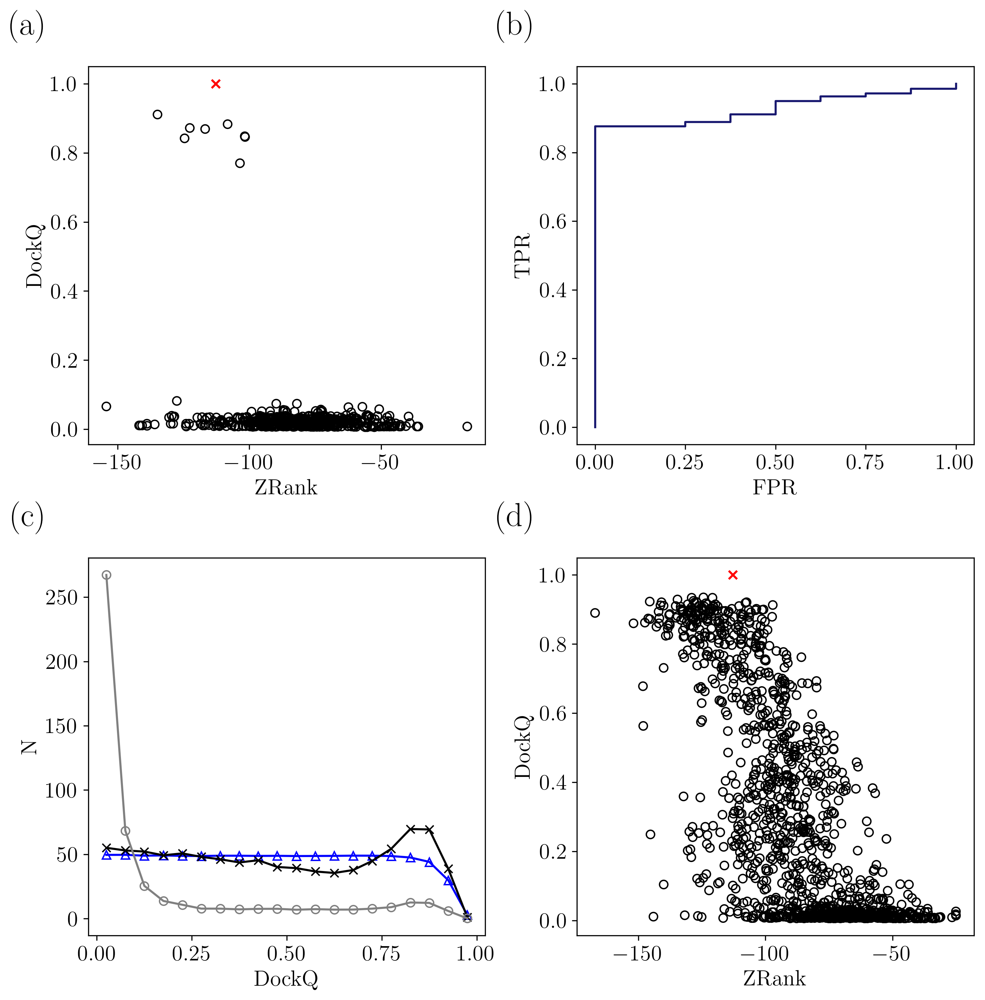

In [43]:
%matplotlib inline

## Subpanel A
%matplotlib inline

font_size = 16

fig, ax = plt.subplots(2, 2, figsize = (10,10), dpi = 300)

pdb = "1xg2"

ax[0,0].scatter(target_score_df[target_score_df["pdb"] == pdb]["ZRank"], target_score_df[target_score_df["pdb"] == pdb]["DockQ"], color = "red", label = "Target", marker = "x")
ax[0,0].scatter(zdock_relaxed_combined_dfs[pdb]["ZRank"], zdock_relaxed_combined_dfs[pdb]["DockQ"], color = "black", label = "Decoys", marker = "o", facecolor = "None")
# ax.scatter(ss_score_dict[pdb]["ZRank"], ss_score_dict[pdb]["DockQ"], color = "blue", label = "Supersampled Data", marker = "o", facecolor = "None")

ax[0,0].text(-0.1, 1.15, "(a)", transform=ax[0,0].transAxes,fontsize=font_size*1.5, fontweight='bold', va='top', ha='right')

ax[0,0].set_xlabel("ZRank", fontsize = font_size)
ax[0,0].set_ylabel("DockQ", fontsize = font_size)

## Subpanel B

pdb = "1xg2"

tpr, fpr, thresh = create_ROC_curve_single_data(zdock_relaxed_combined_dfs[pdb], col_name = "ZRank", quality = "acceptable", cutoff = 100000)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid", "indianred", "magenta"]

ax[0,1].plot(fpr, tpr, color = colors[0], label = "ZRank")


ax[0,1].set_xlabel("FPR", fontsize = font_size)
ax[0,1].set_ylabel("TPR", fontsize = font_size)

ax[0,1].text(-0.1, 1.15, "(b)", transform=ax[0,1].transAxes,fontsize=font_size*1.5, fontweight='bold', va='top', ha='right')


## Subpanel C

x_axis = np.linspace(0.025, 0.975, 20)

ax[1,0].plot(x_axis, before_dockq_mean, label = "Supersampled before minimization", color = "blue", marker = "^", markerfacecolor = "None")
ax[1,0].plot(x_axis, after_dockq_mean, label = "Supersampled after minimization", color = "black", marker = "x")
ax[1,0].plot(x_axis, avg_dockq_bins_relax, label = "Not Supersampled", color = "gray", marker = "o", markerfacecolor = "None")

ax[1,0].set_xlabel("DockQ", fontsize = font_size)
ax[1,0].set_ylabel("N", fontsize = font_size)

ax[1,0].text(-0.1, 1.15, "(c)", transform=ax[1,0].transAxes,fontsize=font_size*1.5, fontweight='bold', va='top', ha='right')

## Subpanel D

ax[1,1].scatter(ss_score_dict[pdb]["ZRank"], ss_score_dict[pdb]["DockQ"], color = "black", label = "Supersampled Decoys", marker = "o", facecolor = "None")
ax[1,1].scatter(target_score_df[target_score_df["pdb"] == pdb]["ZRank"], target_score_df[target_score_df["pdb"] == pdb]["DockQ"], color = "red", label = "Target", marker = "x")

ax[1,1].text(-0.1, 1.15, "(d)", transform=ax[1,1].transAxes,fontsize=font_size*1.5, fontweight='bold', va='top', ha='right')


ax[1,1].set_xlabel("ZRank", fontsize = font_size)
ax[1,1].set_ylabel("DockQ", fontsize = font_size)
fig.tight_layout()

ax[0,0].tick_params(axis='both', which='major', labelsize=font_size)
ax[0,1].tick_params(axis='both', which='major', labelsize=font_size)
ax[1,0].tick_params(axis='both', which='major', labelsize=font_size)
ax[1,1].tick_params(axis='both', which='major', labelsize=font_size)

plt.savefig(join(figure_save_dir, "supersample_justification_1.png"))

In [166]:
print(pdb_list)

['1acb', '1ay7', '1c3a', '1euv', '1f60', '1ggp', '1itb', '1j7d', '1kfu', '1n1j', '1pdk', '1qav', '1r8o', '1spp', '1tfo', '1ugh', '1ugq', '1vet', '1wmh', '1wqj', '1wrd', '1xg2', '2bkr', '2d5r', '2dvw', '2fhz', '2g2u', '2grn', '2h7z', '2hla', '2hsm', '2hth', '2oul', '2pe6', '2wmp', '3dgp', '3fpn', '3gfk', '3k9p', '3ona', '3qc8', '3qhy', '3rcz', '3sgb', '3vz9', '3wdg', '3whq', '3ygs', '4bi8', '4ct6', '4dbg', '4dhi', '4g6t', '4gi3', '4h5s', '4hwi', '4je3', '4k12', '4qjf', '4qlp', '4uzz', '4yii', '5by8', '5dmb', '5k7m', '5maw', '5mu7', '5uq2', '5zrz', '6fud', '6kp3', '6wg4', '6xod', '6zbk', '7bxh', '7joe', '7jxv']


In [249]:
print(relaxed_corr_df[relaxed_corr_df["pdb"] == pdb]["spearman_dockq_zrank"])
print(relaxed_corr_df[relaxed_corr_df["pdb"] == pdb]["pearson_dockq_zrank"])
print(ss_corr_df[ss_corr_df["pdb"] == pdb]["spearman_dockq_zrank"])
print(ss_corr_df[ss_corr_df["pdb"] == pdb]["pearson_dockq_zrank"])

21   -0.115535
Name: spearman_dockq_zrank, dtype: float64
21   -0.215259
Name: pearson_dockq_zrank, dtype: float64
23   -0.743289
Name: spearman_dockq_zrank, dtype: float64
23   -0.722783
Name: pearson_dockq_zrank, dtype: float64


In [241]:
## Max delta spearman 

delta_list = []

for i in range(len(relaxed_corr_df)):
    temp_rel_row = relaxed_corr_df.iloc[i,:]
    pdb = temp_rel_row["pdb"]
    temp_ss_row = ss_corr_df[ss_corr_df["pdb"] == pdb]
    
    temp_delta = float(temp_ss_row["spearman_dockq_zrank"]) - float(temp_rel_row["spearman_dockq_zrank"])
    delta_list.append((temp_delta, pdb))
    
print(sorted(delta_list))

[(-0.9435131182057843, '2hth'), (-0.7176644136935217, '4dhi'), (-0.6277539791573561, '1xg2'), (-0.6098585314079134, '7jxv'), (-0.5992160217231599, '3rcz'), (-0.569449793529111, '1qav'), (-0.5581067819522185, '4gi3'), (-0.55631531570792, '2grn'), (-0.554855852280559, '1ggp'), (-0.5528378816244646, '1acb'), (-0.5430955075193038, '3whq'), (-0.5388199786953165, '1wrd'), (-0.5264103960704439, '1wqj'), (-0.5175701223592621, '4je3'), (-0.5162554471795033, '5uq2'), (-0.506658121328753, '1wmh'), (-0.48618012744208283, '6zbk'), (-0.47441287365436274, '6wg4'), (-0.43522985187159824, '4qjf'), (-0.4211833579191726, '6fud'), (-0.4205616920458909, '2h7z'), (-0.4060907421103386, '7bxh'), (-0.3984622606615985, '5by8'), (-0.39443558828369085, '2g2u'), (-0.38709538064441484, '4g6t'), (-0.38274114911339585, '1ay7'), (-0.38268995571572517, '3qc8'), (-0.37365548250661457, '6kp3'), (-0.3603622256017267, '4dbg'), (-0.3213123322557246, '2pe6'), (-0.3087367225044468, '2d5r'), (-0.30010367632559554, '3qhy'), (-0

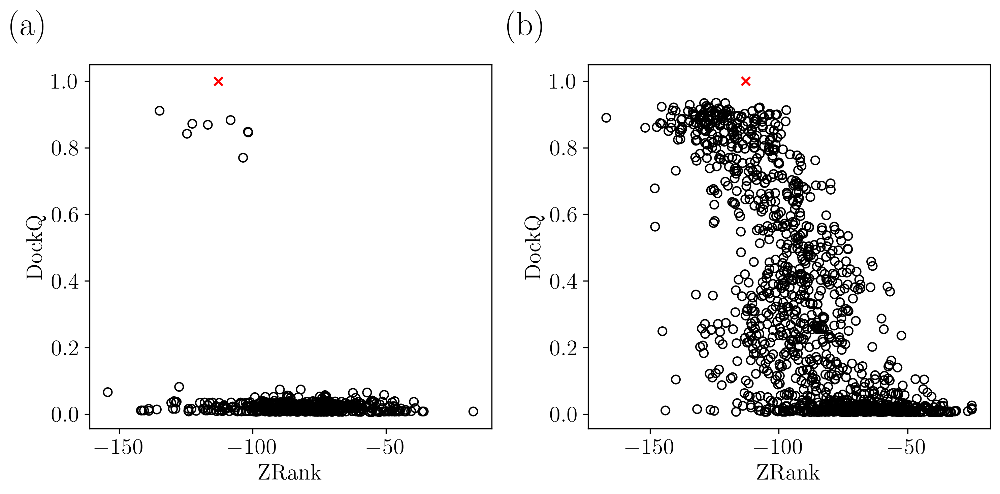

In [247]:
%matplotlib inline

## Subpanel A
%matplotlib inline

font_size = 16

fig, ax = plt.subplots(1, 2, figsize = (10,5), dpi = 300)

pdb = "1xg2"

ax[0].scatter(target_score_df[target_score_df["pdb"] == pdb]["ZRank"], target_score_df[target_score_df["pdb"] == pdb]["DockQ"], color = "red", label = "Target", marker = "x")
ax[0].scatter(zdock_relaxed_combined_dfs[pdb]["ZRank"], zdock_relaxed_combined_dfs[pdb]["DockQ"], color = "black", label = "Decoys", marker = "o", facecolor = "None")
# ax.scatter(ss_score_dict[pdb]["ZRank"], ss_score_dict[pdb]["DockQ"], color = "blue", label = "Supersampled Data", marker = "o", facecolor = "None")

ax[0].text(-0.1, 1.15, "(a)", transform=ax[0].transAxes,fontsize=font_size*1.5, fontweight='bold', va='top', ha='right')

ax[0].set_xlabel("ZRank", fontsize = font_size)
ax[0].set_ylabel("DockQ", fontsize = font_size)

## Subpanel D

ax[1].scatter(ss_score_dict[pdb]["ZRank"], ss_score_dict[pdb]["DockQ"], color = "black", label = "Supersampled Decoys", marker = "o", facecolor = "None")
ax[1].scatter(target_score_df[target_score_df["pdb"] == pdb]["ZRank"], target_score_df[target_score_df["pdb"] == pdb]["DockQ"], color = "red", label = "Target", marker = "x")

ax[1].text(-0.1, 1.15, "(b)", transform=ax[1].transAxes,fontsize=font_size*1.5, fontweight='bold', va='top', ha='right')


ax[1].set_xlabel("ZRank", fontsize = font_size)
ax[1].set_ylabel("DockQ", fontsize = font_size)
fig.tight_layout()

ax[0].tick_params(axis='both', which='major', labelsize=font_size)
ax[1].tick_params(axis='both', which='major', labelsize=font_size)

fig.tight_layout()

# Figure 1

NameError: name 'fraction_relaxed_corr_df' is not defined

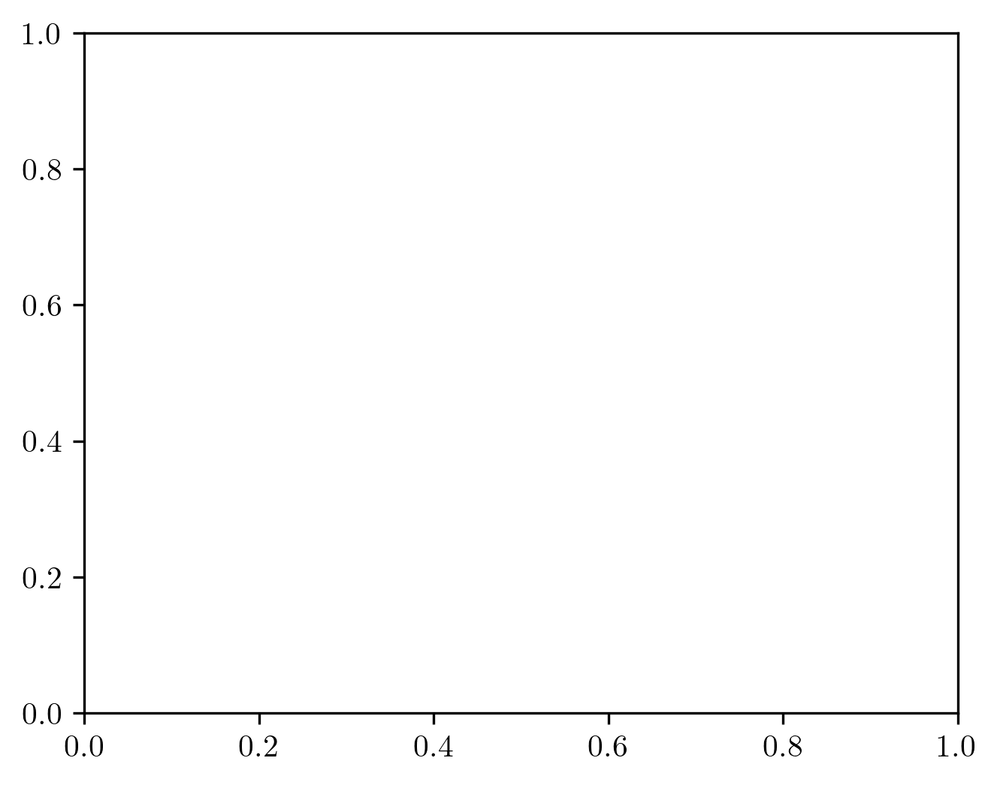

In [804]:
## Tenative Figure 1 - A
%matplotlib inline

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

## Relaxed

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid"]

ax.scatter(relaxed_corr_df["spearman_dockq_zrank"], fraction_relaxed_corr_df["zrank_auc"], color = colors[0], marker = "^", facecolor = "None", label = "ZRank")
ax.scatter(relaxed_corr_df["spearman_dockq_hdock"], fraction_relaxed_corr_df["hdock_auc"], color = colors[1], marker = "o", facecolor = "None", label = "HDOCK")
ax.scatter(relaxed_corr_df["spearman_dockq_rosetta"], fraction_relaxed_corr_df["rosetta_auc"], color = colors[2], marker = "s", facecolor = "None", label = "Rosetta")
ax.scatter(relaxed_corr_df["spearman_dockq_pydock"], fraction_relaxed_corr_df["pydock_auc"], color = colors[3], marker = "h", facecolor = "None", label = "PyDock")
ax.scatter(np.array(relaxed_corr_df["spearman_dockq_voromqa"])*-1, fraction_relaxed_corr_df["voromqa_auc"], color = colors[4], marker = "*", facecolor = "None", label = "VoroMQA")

## Y = -X

temp_x = np.linspace(-1, 0, 10)
temp_y = np.linspace(0.5, 1, 10)[::-1]
ax.plot(temp_x, temp_y, "b--", )

ax.set_xlabel("Spearman Correlation", fontsize = 20)
ax.set_ylabel("AUROC", fontsize = 20)

plt.legend(loc = "lower left")
plt.tight_layout


<function matplotlib.pyplot.tight_layout(*, pad=1.08, h_pad=None, w_pad=None, rect=None)>

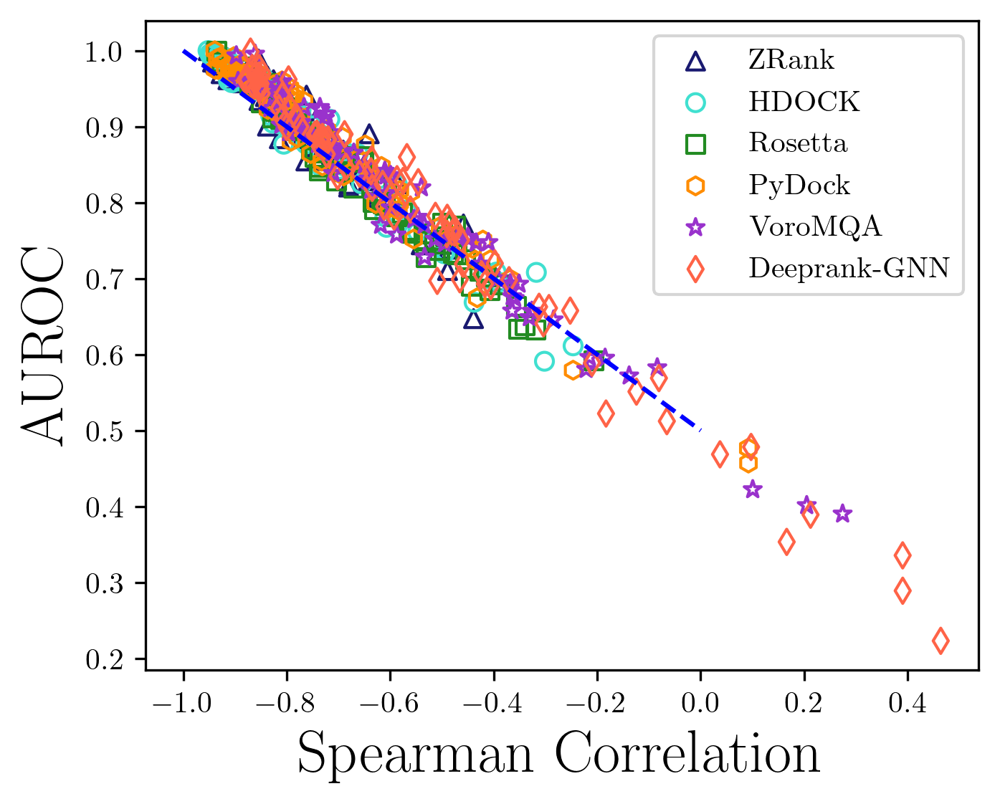

In [264]:
## Tenative Figure 1 - C

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

## Relaxed

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid", "indianred", "magenta", "tomato"]

ax.scatter(ss_corr_df["spearman_dockq_zrank"], ss_corr_df["zrank_auc"], color = colors[0], marker = "^", facecolor = "None", label = "ZRank")
ax.scatter(ss_corr_df["spearman_dockq_hdock"], ss_corr_df["hdock_auc"], color = colors[1], marker = "o", facecolor = "None", label = "HDOCK")
ax.scatter(ss_corr_df["spearman_dockq_rosetta"], ss_corr_df["rosetta_auc"], color = colors[2], marker = "s", facecolor = "None", label = "Rosetta")
ax.scatter(ss_corr_df["spearman_dockq_pydock"], ss_corr_df["pydock_auc"], color = colors[3], marker = "h", facecolor = "None", label = "PyDock")
ax.scatter(np.array(ss_corr_df["spearman_dockq_voromqa"])*-1, ss_corr_df["voromqa_auc"], color = colors[4], marker = "*", facecolor = "None", label = "VoroMQA")
# ax.scatter(ss_corr_df["spearman_dockq_dove"], ss_corr_df["dove_auc"], color = colors[5], marker = "p", facecolor = "None", label = "DOVE (Fold -1)")
# ax.scatter(ss_corr_df["spearman_dockq_dove_5"], ss_corr_df["dove_5_auc"], color = colors[6], marker = "P", facecolor = "None", label = "DOVE (Fold 5)")
ax.scatter(ss_corr_df["spearman_dockq_deeprank"]*-1, ss_corr_df["deeprank_auc"], color = colors[7], marker = "d", facecolor = "None", label = "Deeprank-GNN")


## Y = -X

temp_x = np.linspace(-1, 0, 10)
temp_y = np.linspace(0.5, 1, 10)[::-1]
ax.plot(temp_x, temp_y, "b--", )

ax.set_xlabel("Spearman Correlation", fontsize = 20)
ax.set_ylabel("AUROC", fontsize = 20)

plt.legend()
plt.tight_layout


<function matplotlib.pyplot.tight_layout(*, pad=1.08, h_pad=None, w_pad=None, rect=None)>

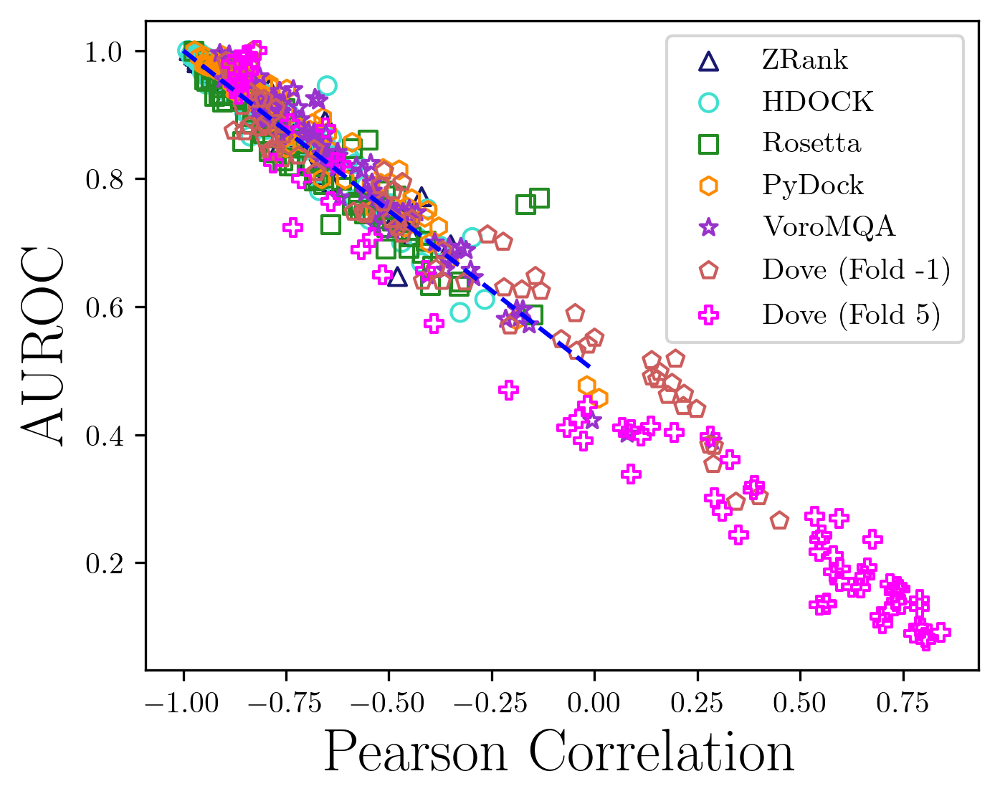

In [214]:
## Tenative Figure 1 - C

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

## Relaxed

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid", "indianred", "magenta"]

ax.scatter(ss_corr_df["pearson_dockq_zrank"], ss_corr_df["zrank_auc"], color = colors[0], marker = "^", facecolor = "None", label = "ZRank")
ax.scatter(ss_corr_df["pearson_dockq_hdock"], ss_corr_df["hdock_auc"], color = colors[1], marker = "o", facecolor = "None", label = "HDOCK")
ax.scatter(ss_corr_df["pearson_dockq_rosetta"], ss_corr_df["rosetta_auc"], color = colors[2], marker = "s", facecolor = "None", label = "Rosetta")
ax.scatter(ss_corr_df["pearson_dockq_pydock"], ss_corr_df["pydock_auc"], color = colors[3], marker = "h", facecolor = "None", label = "PyDock")
ax.scatter(np.array(ss_corr_df["pearson_dockq_voromqa"])*-1, ss_corr_df["voromqa_auc"], color = colors[4], marker = "*", facecolor = "None", label = "VoroMQA")
ax.scatter(ss_corr_df["pearson_dockq_dove"], ss_corr_df["dove_auc"], color = colors[5], marker = "p", facecolor = "None", label = "Dove (Fold -1)")
ax.scatter(ss_corr_df["pearson_dockq_dove_5"], ss_corr_df["dove_5_auc"], color = colors[6], marker = "P", facecolor = "None", label = "Dove (Fold 5)")

## Y = -X

temp_x = np.linspace(-1, 0, 10)
temp_y = np.linspace(0.5, 1, 10)[::-1]
ax.plot(temp_x, temp_y, "b--", )

ax.set_xlabel("Pearson Correlation", fontsize = 20)
ax.set_ylabel("AUROC", fontsize = 20)

plt.legend()
plt.tight_layout


<function matplotlib.pyplot.tight_layout(*, pad=1.08, h_pad=None, w_pad=None, rect=None)>

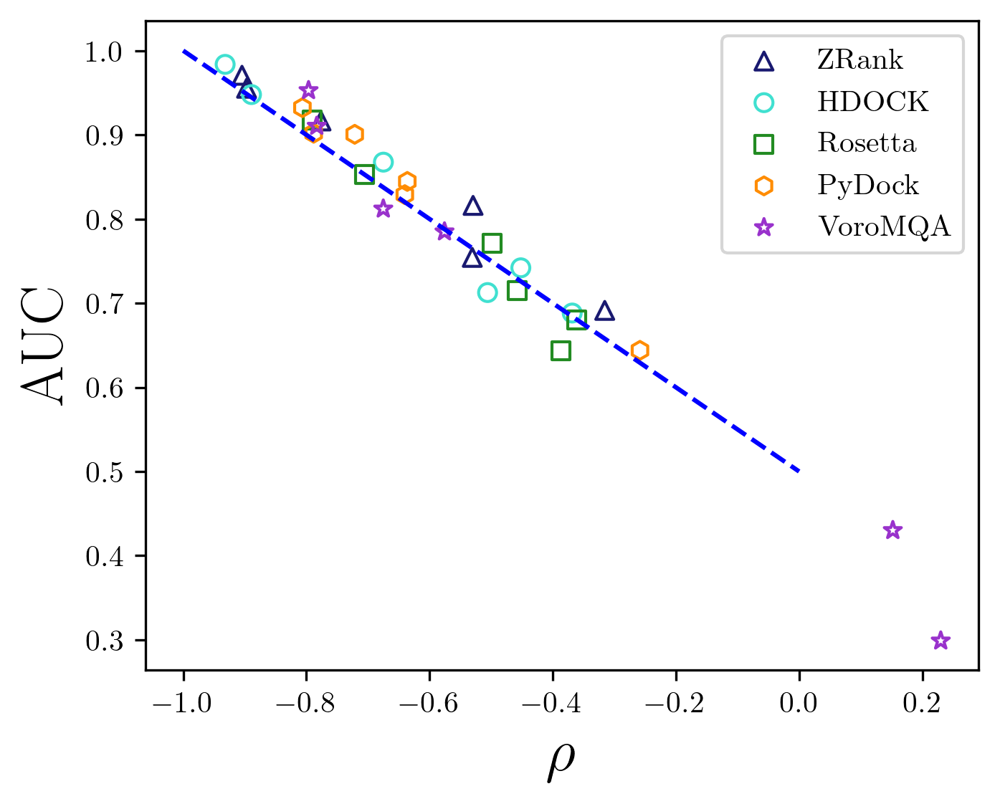

In [402]:
## ONLY FOR THE LOWEST RESOLUTION STRUCTURES

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

low_res_structures = ["1mbv", "1n8s", "1ry7", "3hw2", "3u82", "4uc1", "6yxj", "8enf"]
low_res_df = ss_corr_df[ss_corr_df["pdb"].isin(low_res_structures)]

## Relaxed

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid", "indianred", "magenta", "tomato"]

ax.scatter(low_res_df["spearman_dockq_zrank"], low_res_df["zrank_auc"], color = colors[0], marker = "^", facecolor = "None", label = "ZRank")
ax.scatter(low_res_df["spearman_dockq_hdock"], low_res_df["hdock_auc"], color = colors[1], marker = "o", facecolor = "None", label = "HDOCK")
ax.scatter(low_res_df["spearman_dockq_rosetta"], low_res_df["rosetta_auc"], color = colors[2], marker = "s", facecolor = "None", label = "Rosetta")
ax.scatter(low_res_df["spearman_dockq_pydock"], low_res_df["pydock_auc"], color = colors[3], marker = "h", facecolor = "None", label = "PyDock")
ax.scatter(np.array(low_res_df["spearman_dockq_voromqa"])*-1, low_res_df["voromqa_auc"], color = colors[4], marker = "*", facecolor = "None", label = "VoroMQA")
# ax.scatter(ss_corr_df["spearman_dockq_dove"], ss_corr_df["dove_auc"], color = colors[5], marker = "p", facecolor = "None", label = "DOVE (Fold -1)")
# ax.scatter(ss_corr_df["spearman_dockq_dove_5"], ss_corr_df["dove_5_auc"], color = colors[6], marker = "P", facecolor = "None", label = "DOVE (Fold 5)")
# ax.scatter(ss_corr_df["spearman_dockq_deeprank"]*-1, ss_corr_df["deeprank_auc"], color = colors[7], marker = "d", facecolor = "None", label = "Deeprank-GNN")


## Y = -X

temp_x = np.linspace(-1, 0, 10)
temp_y = np.linspace(0.5, 1, 10)[::-1]
ax.plot(temp_x, temp_y, "b--", )

ax.set_xlabel(r"$\rho$", fontsize = 20)
ax.set_ylabel("AUC", fontsize = 20)

plt.legend()
plt.tight_layout


<function matplotlib.pyplot.tight_layout(*, pad=1.08, h_pad=None, w_pad=None, rect=None)>

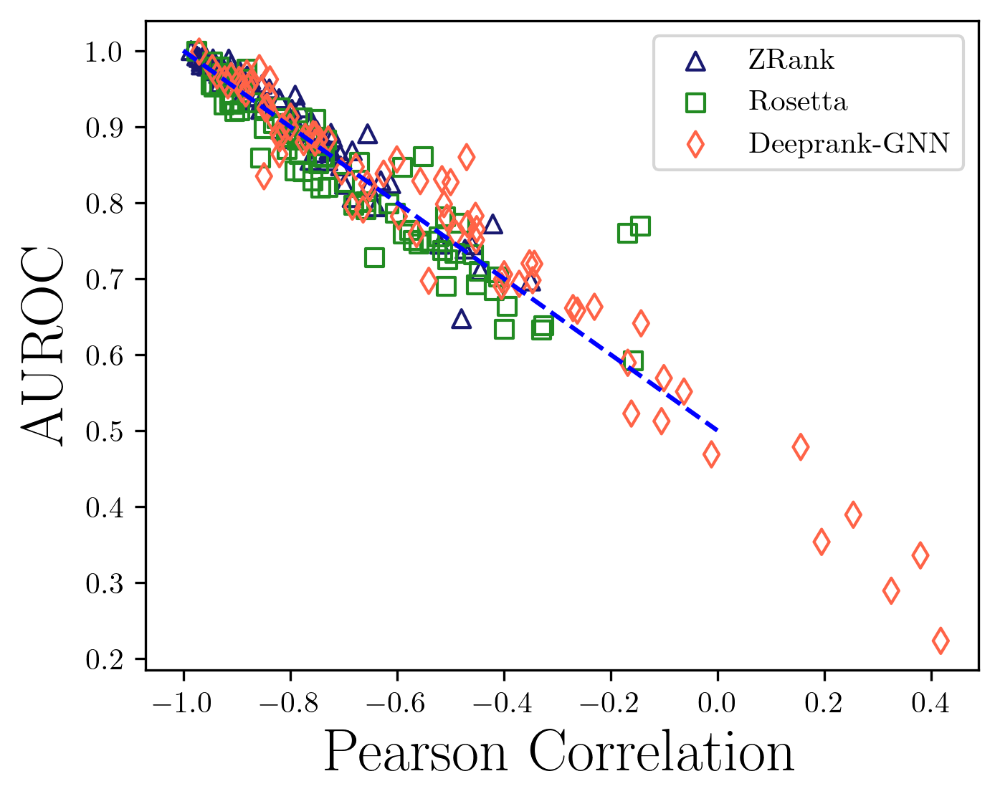

In [261]:
## Incorporating Deeprank-GNN

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

## Relaxed

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid", "indianred", "magenta", "tomato"]

ax.scatter(ss_corr_df["pearson_dockq_zrank"], ss_corr_df["zrank_auc"], color = colors[0], marker = "^", facecolor = "None", label = "ZRank")
# ax.scatter(ss_corr_df["pearson_dockq_hdock"], ss_corr_df["hdock_auc"], color = colors[1], marker = "o", facecolor = "None", label = "HDOCK")
ax.scatter(ss_corr_df["pearson_dockq_rosetta"], ss_corr_df["rosetta_auc"], color = colors[2], marker = "s", facecolor = "None", label = "Rosetta")
# ax.scatter(ss_corr_df["pearson_dockq_pydock"], ss_corr_df["pydock_auc"], color = colors[3], marker = "h", facecolor = "None", label = "PyDock")
# ax.scatter(np.array(ss_corr_df["pearson_dockq_voromqa"])*-1, ss_corr_df["voromqa_auc"], color = colors[4], marker = "*", facecolor = "None", label = "VoroMQA")
# ax.scatter(ss_corr_df["pearson_dockq_dove"], ss_corr_df["dove_auc"], color = colors[5], marker = "p", facecolor = "None", label = "Dove (Fold -1)")
# ax.scatter(ss_corr_df["pearson_dockq_dove_5"], ss_corr_df["dove_5_auc"], color = colors[6], marker = "P", facecolor = "None", label = "Dove (Fold 5)")
ax.scatter(ss_corr_df["pearson_dockq_deeprank"]*-1, ss_corr_df["deeprank_auc"], color = colors[7], marker = "d", facecolor = "None", label = "Deeprank-GNN")


## Y = -X

temp_x = np.linspace(-1, 0, 10)
temp_y = np.linspace(0.5, 1, 10)[::-1]
ax.plot(temp_x, temp_y, "b--", )

ax.set_xlabel("Pearson Correlation", fontsize = 20)
ax.set_ylabel("AUROC", fontsize = 20)

plt.legend()
plt.tight_layout


### Actual Figure 1 combined

In [700]:
relaxed_corr_df

,pdb,pearson_ialign_zrank,pearson_ialign_hdock,pearson_ialign_rosetta,pearson_ialign_pydock,pearson_ialign_voromqa,pearson_ialign_dove_5,pearson_ialign_deeprank_gnn_esm,pearson_dockq_zrank,pearson_dockq_hdock,...,spearman_dockq_voromqa,spearman_dockq_dove_5,spearman_dockq_deeprank_gnn_esm,zrank_auc,hdock_auc,rosetta_auc,pydock_auc,voromqa_auc,dove_5_auc,deeprank_gnn_esm_auc
0,1acb,-0.398599,-0.192445,-0.580015,-0.567228,0.634883,0.055565,-0.074471,-0.378991,-0.182561,...,0.287390,0.117788,-0.024269,0.830351,0.681765,0.913021,0.883709,0.953786,0.425099,0.423792
1,1ay7,-0.597038,-0.447387,-0.375227,-0.209347,0.146640,-0.032223,0.080100,-0.614750,-0.478766,...,0.737146,-0.061404,0.066492,0.948614,0.905976,0.714065,0.714115,0.595245,0.533642,0.617574
2,1c3a,-0.939430,-0.913159,-0.863782,-0.910119,0.697532,-0.079470,0.046022,-0.935229,-0.909886,...,0.673709,-0.074858,0.041798,0.967479,0.939328,0.900211,0.965350,0.885146,0.528613,0.514219
3,1euv,-0.849719,-0.722615,-0.293107,-0.806377,0.083928,0.221681,0.170780,-0.863528,-0.695760,...,0.086935,0.202478,0.185466,0.952222,0.833481,0.669106,0.957656,0.537457,0.437118,0.541736
4,1f60,-0.833235,-0.895053,-0.633505,-0.664845,0.624661,-0.008960,0.060199,-0.838382,-0.898555,...,0.619941,-0.008200,0.040872,0.930732,0.977670,0.764620,0.905065,0.842718,0.494199,0.544623
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
79,3hw2,-0.023809,0.024671,-0.029493,0.131237,0.195680,0.005928,0.003086,-0.020918,0.005956,...,0.186389,0.006472,-0.024894,0.586911,0.443670,0.674232,0.286437,0.768207,0.481314,0.554188
80,3u82,-0.127088,0.117978,-0.212715,-0.439994,-0.249080,-0.043758,0.081022,-0.099227,0.141314,...,-0.242282,0.053006,-0.027123,0.583415,0.348389,0.658294,0.864662,0.227017,0.521358,0.566797
81,4u1c,-0.314480,-0.410082,-0.215140,-0.535334,0.448819,-0.065443,0.069462,-0.309913,-0.417662,...,0.323090,-0.027557,0.013305,0.776629,0.820814,0.645682,0.918333,0.894735,0.555000,0.554186
82,6yxj,-0.549993,-0.427002,-0.418319,-0.558575,0.853481,0.005073,0.015497,-0.547420,-0.407267,...,0.656060,-0.012265,-0.028015,0.845662,0.755462,0.728523,0.862116,0.996391,0.505647,0.497025


In [703]:
ss_score_dict["1acb"]["Dove_5"]

0      0.5775
1      0.4171
2      0.4030
3      0.3918
4      0.5847
        ...  
428    0.5708
429    0.4937
430    0.4859
431    0.5530
432    0.3919
Name: Dove_5, Length: 1394, dtype: float64

In [706]:
zdock_relaxed_combined_dfs["3hw2"]

,Model Number,IS-Score,iRMSD,NormRMSD,ZRank,HDOCK,Rosetta,VoroMQA,PyDock,DockQ,...,CAPRI,ZRank Z-score,HDOCK Z-score,Rosetta Z-score,VoroMQA Z-score,PyDock Z-score,Decoy_x,Dove_5,Decoy_y,Deeprank_gnn_esm
0,MODEL 1,0.0669,0,0,-117.4770,-19977.96,-983.548,0.510055,-35.910,0.051,...,incorrect,-2.824630,-1.018881,-0.194619,0.969537,-2.044824,relaxed_3hw2_model_1,0.6336,relaxed_3hw2_,0.399
1,MODEL 2,0.0669,0,0,-66.8168,-19929.24,-967.794,0.555303,-15.427,0.047,...,incorrect,0.286259,-0.715757,-0.103066,1.589067,0.951180,relaxed_3hw2_model_10,0.6227,relaxed_3hw2_m,0.153
2,MODEL 3,0.0669,0,0,-120.8000,-20017.70,-965.470,0.490516,-39.311,0.051,...,incorrect,-3.028685,-1.266134,-0.089560,0.702012,-2.542281,relaxed_3hw2_model_100,0.6297,relaxed_3hw2_mo,0.530
3,MODEL 4,0.0669,0,0,-60.6052,-19710.88,-976.158,0.491823,-28.768,0.042,...,incorrect,0.667694,0.642829,-0.151673,0.719907,-1.000179,relaxed_3hw2_model_101,0.5037,relaxed_3hw2_mo,0.192
4,MODEL 5,0.0669,0,0,-71.3902,-20011.38,-960.693,0.494012,-23.205,0.055,...,incorrect,0.005420,-1.226813,-0.061799,0.749879,-0.186491,relaxed_3hw2_model_102,0.4831,relaxed_3hw2_mo,0.117
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
495,MODEL 496,0.0669,0,0,-71.3116,-19830.39,-964.819,0.510719,-27.383,0.044,...,incorrect,0.010247,-0.100735,-0.085777,0.978629,-0.797598,relaxed_3hw2_model_95,0.4675,relaxed_3hw2_m,0.179
496,MODEL 497,0.0669,0,0,-75.2346,-19580.83,-939.979,0.348766,-21.922,0.030,...,incorrect,-0.230653,1.451969,0.058579,-1.238811,0.001170,relaxed_3hw2_model_96,0.4856,relaxed_3hw2_m,0.061
497,MODEL 498,0.0669,0,0,-40.6284,-19771.38,-965.431,0.479524,-24.677,0.038,...,incorrect,1.894409,0.266412,-0.089334,0.551511,-0.401798,relaxed_3hw2_model_97,0.4983,relaxed_3hw2_m,0.138
498,MODEL 499,0.0669,0,0,-96.6212,-20079.13,-976.337,0.495270,-13.070,0.019,...,incorrect,-1.543939,-1.648337,-0.152713,0.767103,1.295933,relaxed_3hw2_model_98,0.6109,relaxed_3hw2_m,0.284


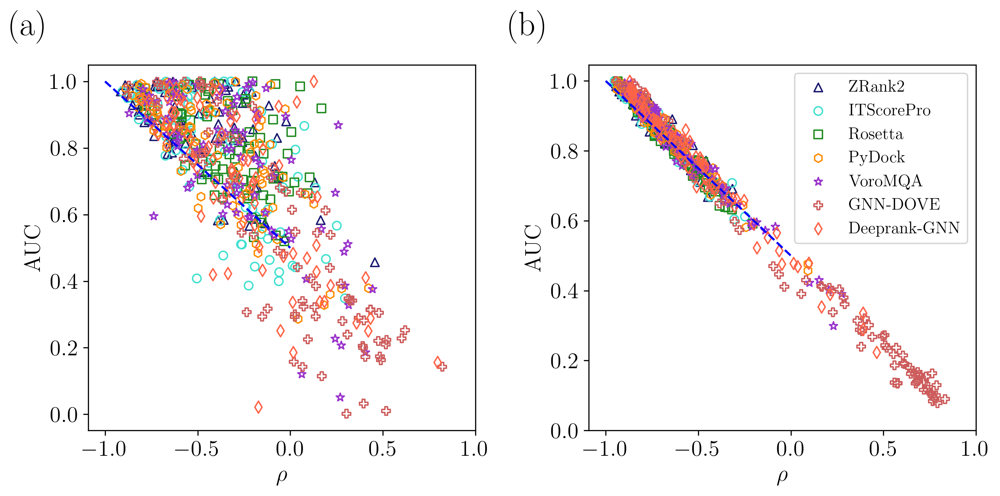

In [878]:
## Tenative Figure 1 - A
%matplotlib inline

font_size = 16

fig, ax = plt.subplots(1,2, figsize = (10,5), dpi = 300)

## Subpanel A

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid", "indianred", "tomato"]

ax[0].scatter(relaxed_corr_df["spearman_dockq_zrank"], relaxed_corr_df["zrank_auc"], color = colors[0], marker = "^", facecolor = "None", label = "ZRank")
ax[0].scatter(relaxed_corr_df["spearman_dockq_hdock"], relaxed_corr_df["hdock_auc"], color = colors[1], marker = "o", facecolor = "None", label = "HDOCK")
ax[0].scatter(relaxed_corr_df["spearman_dockq_rosetta"], relaxed_corr_df["rosetta_auc"], color = colors[2], marker = "s", facecolor = "None", label = "Rosetta")
ax[0].scatter(relaxed_corr_df["spearman_dockq_pydock"], relaxed_corr_df["pydock_auc"], color = colors[3], marker = "h", facecolor = "None", label = "PyDock")
ax[0].scatter(np.array(relaxed_corr_df["spearman_dockq_voromqa"])*-1, relaxed_corr_df["voromqa_auc"], color = colors[4], marker = "*", facecolor = "None", label = "VoroMQA")
ax[0].scatter(relaxed_corr_df["spearman_dockq_dove_5"], relaxed_corr_df["dove_5_auc"], color = colors[5], marker = "P", facecolor = "None", label = "GNN-DOVE")
ax[0].scatter(np.array(relaxed_corr_df["spearman_dockq_deeprank_gnn_esm"])*-1, relaxed_corr_df["deeprank_gnn_esm_auc"], color = colors[6], marker = "d", facecolor = "None", label = "Deeprank-GNN")

## Y = -X

temp_x = np.linspace(-1, 0, 10)
temp_y = np.linspace(0.5, 1, 10)[::-1]
ax[0].plot(temp_x, temp_y, "b--", )

ax[0].set_xlabel(r"$\rho$", fontsize = font_size)
ax[0].set_ylabel("AUC", fontsize = font_size)

ax[0].text(-0.1, 1.15, "(a)", transform=ax[0].transAxes,fontsize=font_size*1.5, fontweight='bold', va='top', ha='right')

# ax[0].legend(loc = "lower left", fontsize = font_size)
plt.tight_layout()

## Subpanel B

ax[1].scatter(ss_corr_df["spearman_dockq_zrank"], ss_corr_df["zrank_auc"], color = colors[0], marker = "^", facecolor = "None", label = "ZRank2")
ax[1].scatter(ss_corr_df["spearman_dockq_hdock"], ss_corr_df["hdock_auc"], color = colors[1], marker = "o", facecolor = "None", label = "ITScorePro")
ax[1].scatter(ss_corr_df["spearman_dockq_rosetta"], ss_corr_df["rosetta_auc"], color = colors[2], marker = "s", facecolor = "None", label = "Rosetta")
ax[1].scatter(ss_corr_df["spearman_dockq_pydock"], ss_corr_df["pydock_auc"], color = colors[3], marker = "h", facecolor = "None", label = "PyDock")
ax[1].scatter(np.array(ss_corr_df["spearman_dockq_voromqa"])*-1, ss_corr_df["voromqa_auc"], color = colors[4], marker = "*", facecolor = "None", label = "VoroMQA")
ax[1].scatter(ss_corr_df["spearman_dockq_dove_5"], ss_corr_df["dove_5_auc"], color = colors[5], marker = "P", facecolor = "None", label = "GNN-DOVE")
ax[1].scatter(np.array(ss_corr_df["spearman_dockq_deeprank_gnn_esm"])*-1, ss_corr_df["deeprank_gnn_esm_auc"], color = colors[6], marker = "d", facecolor = "None", label = "Deeprank-GNN")


## Y = -X

temp_x = np.linspace(-1, 0, 10)
temp_y = np.linspace(0.5, 1, 10)[::-1]
ax[1].plot(temp_x, temp_y, "b--", )

ax[1].set_xlabel(r"$\rho$", fontsize = font_size)
ax[1].set_ylabel("AUC", fontsize = font_size)

ax[1].legend(fontsize = font_size-4)

ax[1].text(-0.1, 1.15, "(b)", transform=ax[1].transAxes,fontsize=font_size*1.5, fontweight='bold', va='top', ha='right')
ax[0].tick_params(axis='both', which='major', labelsize=font_size)
ax[1].tick_params(axis='both', which='major', labelsize=font_size)
y_ticks_temp = [0, 0.2, 0.4, 0.6, 0.8, 1.0]
x_ticks_temp = [-1.0, -0.5,  0.0,  0.5, 1.0]
ax[0].set_xticks(x_ticks_temp)
ax[1].set_xticks(x_ticks_temp)
ax[0].set_yticks(y_ticks_temp)
ax[1].set_yticks(y_ticks_temp)

plt.tight_layout()
plt.savefig(join(figure_save_dir, "compare_supersampled_and_not.png"))

## DockQ Distribution for the Dataset

In [40]:
## Get the DockQ Averaged bins

num_samples = len(ss_corr_df)

all_dockq_bins_ss = np.zeros((num_samples,20))

pdb_list = list(relaxed_corr_df["pdb"])
for i,pdb in enumerate(pdb_list):
    temp_bins = np.zeros((20,))
    temp_dockq = ss_score_dict[pdb]["DockQ"]
    for val in temp_dockq:
        bin_val = int(val//0.05)
        temp_bins[bin_val] += 1
    all_dockq_bins_ss[i, :] =  temp_bins
    
avg_dockq_bins_ss = all_dockq_bins_ss.mean(axis = 0)

all_dockq_bins_relax = np.zeros((num_samples,20))

pdb_list = list(relaxed_corr_df["pdb"])
for i,pdb in enumerate(pdb_list):
    temp_bins = np.zeros((20,))
    temp_dockq = zdock_relaxed_combined_dfs[pdb]["DockQ"]
    for val in temp_dockq:
        bin_val = int(val//0.05)
        temp_bins[bin_val] += 1
    all_dockq_bins_relax[i, :] =  temp_bins
    
avg_dockq_bins_relax = all_dockq_bins_relax.mean(axis = 0)


dockq_list_ss = []
dockq_list_relax = []

pdb_list = list(relaxed_corr_df["pdb"])
for i,pdb in enumerate(pdb_list):
    temp_dockq = ss_score_dict[pdb]["DockQ"]
    for val in temp_dockq:
        dockq_list_ss.append(val)
    temp_dockq = zdock_relaxed_combined_dfs[pdb]["DockQ"]
    for val in temp_dockq:
        dockq_list_relax.append(val)

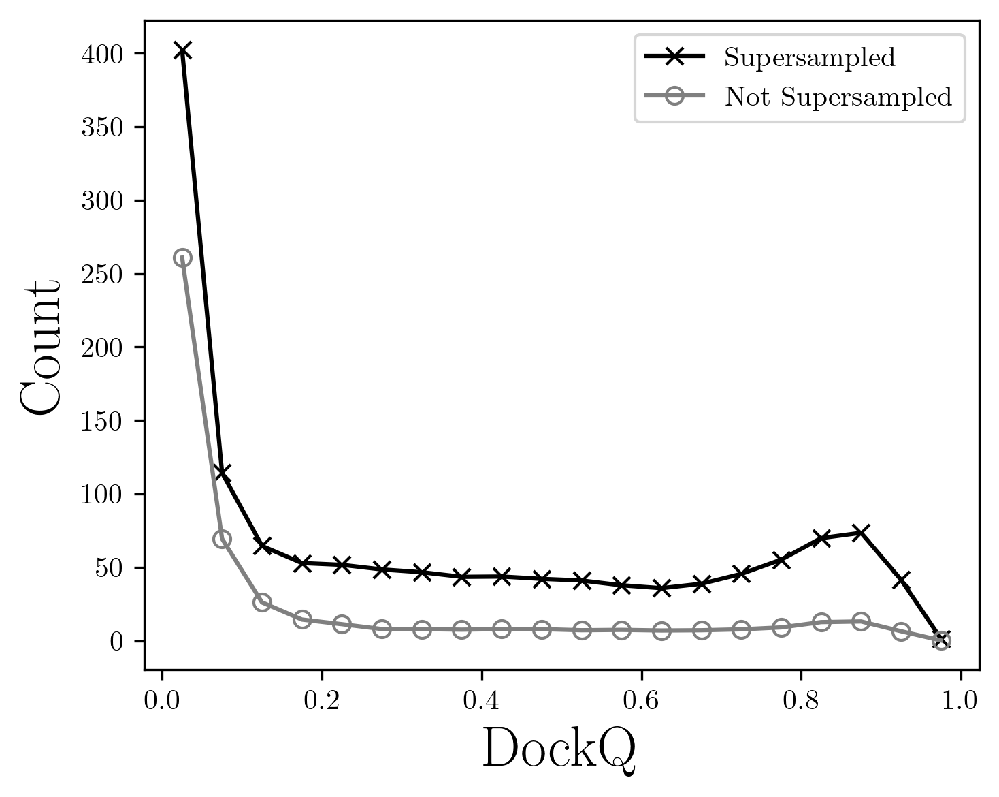

In [33]:
## Tentative Figure 1 - C bins of DockQ

%matplotlib inline

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

x_axis = np.linspace(0.025, 0.975, 20)

ax.plot(x_axis, avg_dockq_bins_ss, label = "Supersampled", color = "black", marker = "x")
ax.plot(x_axis, avg_dockq_bins_relax, label = "Not Supersampled", color = "gray", marker = "o", markerfacecolor = "None")

ax.set_xlabel("DockQ", fontsize = 20)
ax.set_ylabel("Count", fontsize = 20)

plt.legend()
plt.tight_layout()

/var/folders/kr/4__h_fpn42334nd1tdtl4w8w0000gn/T/ipykernel_26119/1713954657.py:105: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if bins == []:


<function matplotlib.pyplot.tight_layout(*, pad=1.08, h_pad=None, w_pad=None, rect=None)>

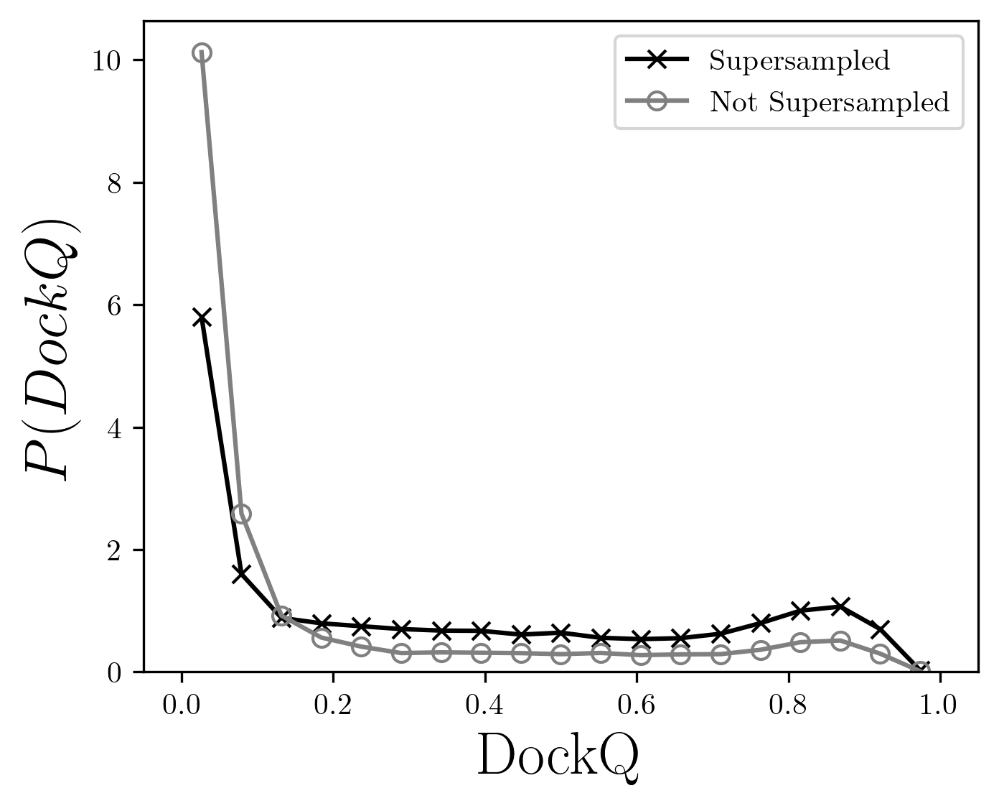

In [34]:
## Tenative Figure 1 - C - Distribution of DockQ Data in datasets

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid"]

nbins = 20
bins = np.linspace(0, 1, nbins)
x = create_prob_dist_identical_bins(dockq_list_ss, fig, ax, bins = bins, color = "black", marker = "x", label = "Supersampled")
x = create_prob_dist_identical_bins(dockq_list_relax, fig, ax, bins = bins, color = "gray", marker = "o", label = "Not Supersampled")

ax.set_xlabel("DockQ", fontsize = 20)
ax.set_ylabel("$P(DockQ)$", fontsize = 20)

plt.legend()
plt.tight_layout

In [29]:
## Getting DockQ bins before and after supersampling

## Before supersampling depends on the naming scheme of the decoys
## After supersampling simply depends on the decoy's dockQ score
## Only use the 'sampled' data



grace_pdbs = ['1spp', '3qc8', '2d5r', '1ka9', '3ona', '2wmp', '1itb', '2hth', '2hsm', '1kfu', '1ggp', '1pdk', '2hla', '2pe6', '1c3a', '2dvw', '3gfk', '2oul', '1tfo', '2nts', '1brb', '3k9p']


before_dockq_dict = {pdb:np.zeros((20, )) for pdb in list(ss_score_dict.keys()) if pdb not in grace_pdbs}
after_dockq_dict = {pdb:np.zeros((20, )) for pdb in list(ss_score_dict.keys())}


for pdb in list(ss_score_dict.keys()):
    temp_decoy_list = list(ss_score_dict[pdb]["Decoy"])
    
    decoy_name_set = set([])
    for decoy in temp_decoy_list:
        ## get before decoy
        if pdb not in grace_pdbs and decoy.count("_") == 2:
            ## Can only do the before for decoys I generated
            bin_ind = int(decoy.split(".")[1].split("_")[1])
            before_dockq_dict[pdb][bin_ind] += 1
        
        ## get after count
        if pdb not in grace_pdbs and decoy.count("_") == 2:
            temp_dockq = ss_score_dict[pdb][ss_score_dict[pdb]["Decoy"] == decoy].iloc[0]["DockQ"] ## slice
            bin_ind = int(temp_dockq//0.05)
            after_dockq_dict[pdb][bin_ind] += 1
        elif pdb in grace_pdbs:
            if decoy not in decoy_name_set:
                temp_dockq = ss_score_dict[pdb][ss_score_dict[pdb]["Decoy"] == decoy].iloc[0]["DockQ"] ## slice
                bin_ind = int(temp_dockq//0.05)
                after_dockq_dict[pdb][bin_ind] += 1
                decoy_name_set.add(decoy)
            
            

In [30]:
## Getting everything averaged

before_dockq_arr = np.zeros((len(before_dockq_dict), 20))
after_dockq_arr = np.zeros((len(after_dockq_dict), 20))

for i,(key,value) in enumerate(list(before_dockq_dict.items())):
    before_dockq_arr[i, :] = value
    
for i,(key,value) in enumerate(list(after_dockq_dict.items())):
    after_dockq_arr[i, :] = value
    
before_dockq_mean = np.mean(before_dockq_arr, axis = 0)
after_dockq_mean = np.mean(after_dockq_arr, axis = 0)

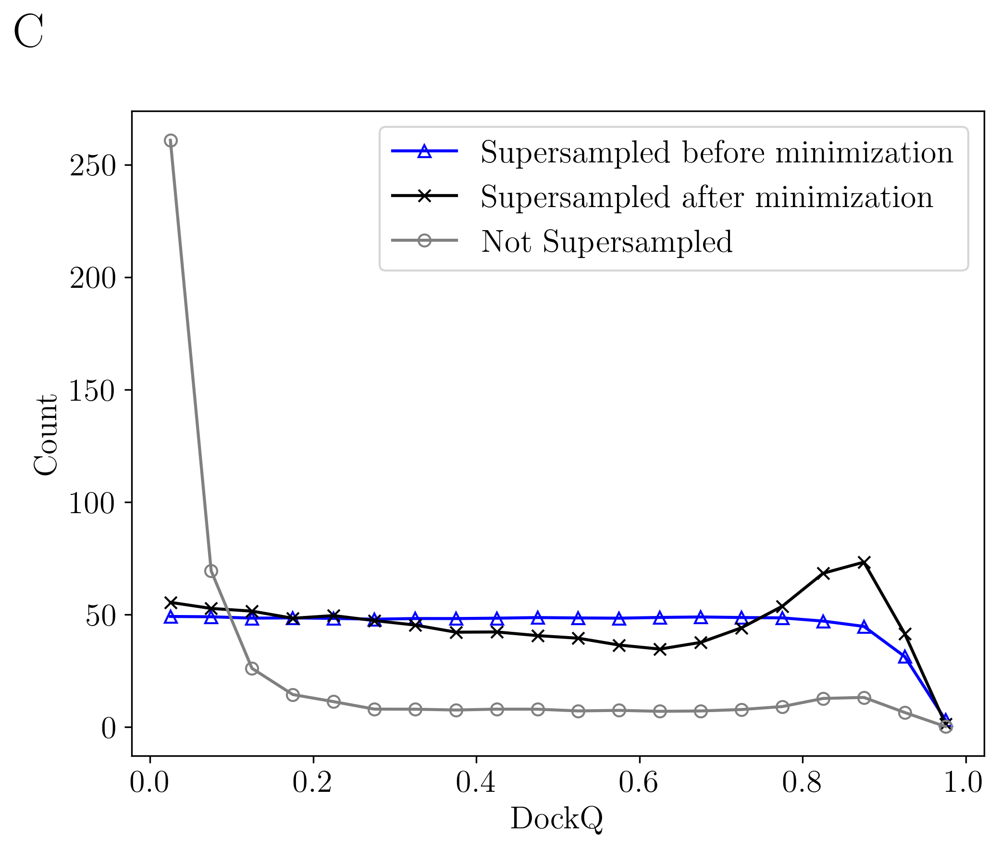

In [263]:
## Tentative Figure 1 - C bins of DockQ

%matplotlib inline

font_size = 16

fig, ax = plt.subplots(figsize = (7,6), dpi = 300)

x_axis = np.linspace(0.025, 0.975, 20)

ax.plot(x_axis, before_dockq_mean, label = "Supersampled before minimization", color = "blue", marker = "^", markerfacecolor = "None")
ax.plot(x_axis, after_dockq_mean, label = "Supersampled after minimization", color = "black", marker = "x")
ax.plot(x_axis, avg_dockq_bins_relax, label = "Not Supersampled", color = "gray", marker = "o", markerfacecolor = "None")

ax.set_xlabel("DockQ", fontsize = font_size)
ax.set_ylabel("Count", fontsize = font_size)

ax.text(-0.1, 1.15, "C", transform=ax.transAxes,fontsize=font_size*1.5, fontweight='bold', va='top', ha='right')
plt.xticks(fontsize = font_size)
plt.yticks(fontsize = font_size)

plt.legend(fontsize = font_size)
plt.tight_layout()

# Figure 2: Spearman Correlation Distributions

-0.4936801623648872
-0.413730558651469
-0.3376426967565434
-0.4142071901430943
0.2955548689415086


/var/folders/kr/4__h_fpn42334nd1tdtl4w8w0000gn/T/ipykernel_22963/3778460129.py:105: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if bins == []:


<function matplotlib.pyplot.tight_layout(*, pad=1.08, h_pad=None, w_pad=None, rect=None)>

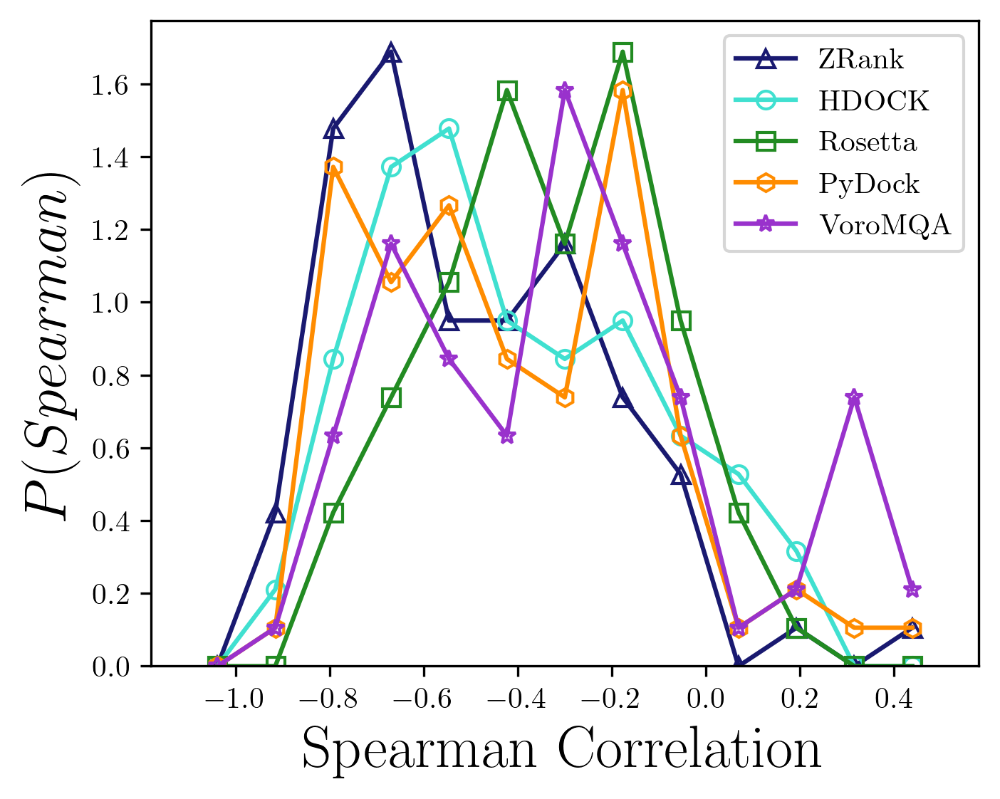

In [54]:
## Tenative Figure 2 - A - Spearman Correlation for non-supersampled data

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid", "indianred"]

nbins = 14
bins = np.linspace(-1.1, 0.5, nbins)
x = create_prob_dist_identical_bins(np.array(fraction_relaxed_corr_df["spearman_dockq_zrank"]), fig, ax, bins = bins, color = colors[0], marker = "^", label = "ZRank")
x = create_prob_dist_identical_bins(np.array(fraction_relaxed_corr_df["spearman_dockq_hdock"]), fig, ax, bins = bins, color = colors[1], marker = "o", label = "HDOCK")
x = create_prob_dist_identical_bins(np.array(fraction_relaxed_corr_df["spearman_dockq_rosetta"]), fig, ax, bins = bins, color = colors[2], marker = "s", label = "Rosetta")
x = create_prob_dist_identical_bins(np.array(fraction_relaxed_corr_df["spearman_dockq_pydock"]), fig, ax, bins = bins, color = colors[3], marker = "h", label = "PyDock")
x = create_prob_dist_identical_bins(np.array(fraction_relaxed_corr_df["spearman_dockq_voromqa"])*-1, fig, ax, bins = bins, color = colors[4], marker = "*", label = "VoroMQA")


print(np.mean(fraction_relaxed_corr_df["spearman_dockq_zrank"]))
print(np.mean(fraction_relaxed_corr_df["spearman_dockq_hdock"]))
print(np.mean(fraction_relaxed_corr_df["spearman_dockq_rosetta"]))
print(np.mean(fraction_relaxed_corr_df["spearman_dockq_pydock"]))
print(np.mean(fraction_relaxed_corr_df["spearman_dockq_voromqa"]))

ax.set_xlabel("Spearman Correlation", fontsize = 20)
ax.set_ylabel("$P(Spearman)$", fontsize = 20)

plt.legend()
plt.tight_layout

-0.7878227632048596
-0.742773506078077
-0.6622373354683259
-0.721535868432936
0.5731116292336002


/var/folders/kr/4__h_fpn42334nd1tdtl4w8w0000gn/T/ipykernel_22963/3778460129.py:105: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if bins == []:


<function matplotlib.pyplot.tight_layout(*, pad=1.08, h_pad=None, w_pad=None, rect=None)>

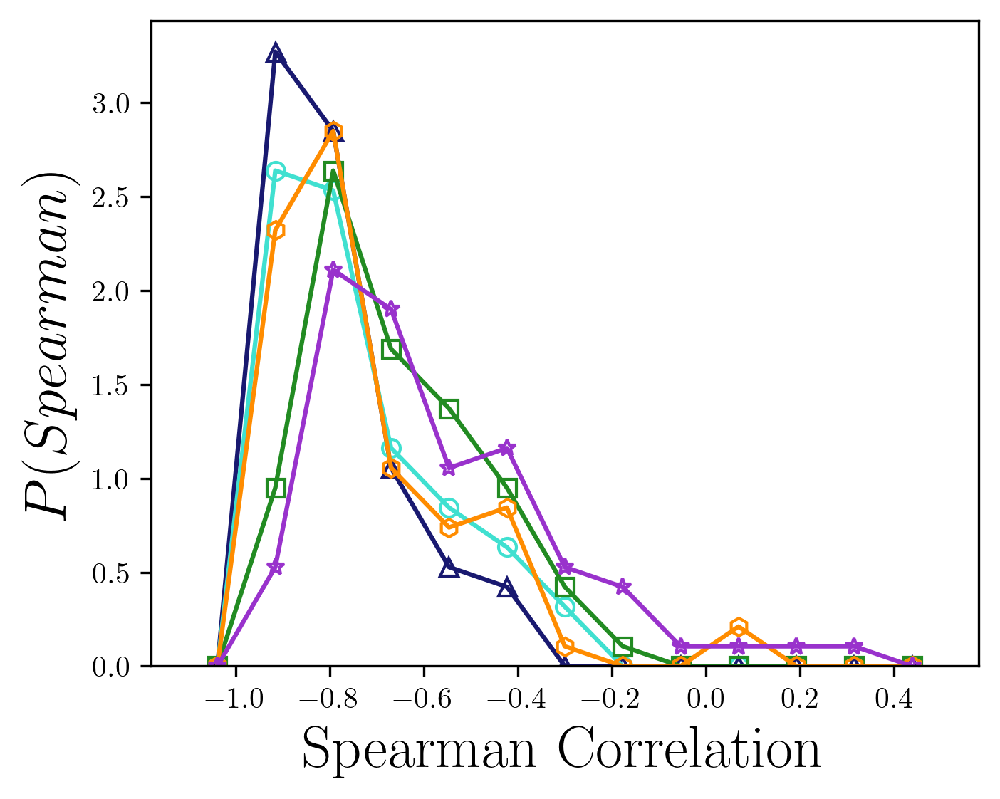

In [55]:
## Tenative Figure 2 - B - Spearman correlation for supersampled structures

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid", "indianred"]

nbins = 14
bins = np.linspace(-1.1, 0.5, nbins)
x = create_prob_dist_identical_bins(np.array(ss_corr_df["spearman_dockq_zrank"]), fig, ax, bins = bins, color = colors[0], marker = "^", label = "ZRank")
x = create_prob_dist_identical_bins(np.array(ss_corr_df["spearman_dockq_hdock"]), fig, ax, bins = bins, color = colors[1], marker = "o", label = "HDOCK")
x = create_prob_dist_identical_bins(np.array(ss_corr_df["spearman_dockq_rosetta"]), fig, ax, bins = bins, color = colors[2], marker = "s", label = "Rosetta")
x = create_prob_dist_identical_bins(np.array(ss_corr_df["spearman_dockq_pydock"]), fig, ax, bins = bins, color = colors[3], marker = "h", label = "PyDock")
x = create_prob_dist_identical_bins(np.array(ss_corr_df["spearman_dockq_voromqa"])*-1, fig, ax, bins = bins, color = colors[4], marker = "*", label = "VoroMQA")
# x = create_prob_dist_identical_bins(np.array(ss_corr_df["spearman_dockq_dove"]), fig, ax, bins = bins, color = colors[5], marker = "p", label = "Dove (Fold -1)")

print(np.mean(ss_corr_df["spearman_dockq_zrank"]))
print(np.mean(ss_corr_df["spearman_dockq_hdock"]))
print(np.mean(ss_corr_df["spearman_dockq_rosetta"]))
print(np.mean(ss_corr_df["spearman_dockq_pydock"]))
print(np.mean(ss_corr_df["spearman_dockq_voromqa"]))

ax.set_xlabel("Spearman Correlation", fontsize = 20)
ax.set_ylabel("$P(Spearman)$", fontsize = 20)

# plt.legend()
plt.tight_layout

-0.29414260083997223
-0.32904294742660795
-0.3245946387117825
-0.3073286782898417
0.27755676029209153


/var/folders/kr/4__h_fpn42334nd1tdtl4w8w0000gn/T/ipykernel_22963/3778460129.py:105: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if bins == []:


<function matplotlib.pyplot.tight_layout(*, pad=1.08, h_pad=None, w_pad=None, rect=None)>

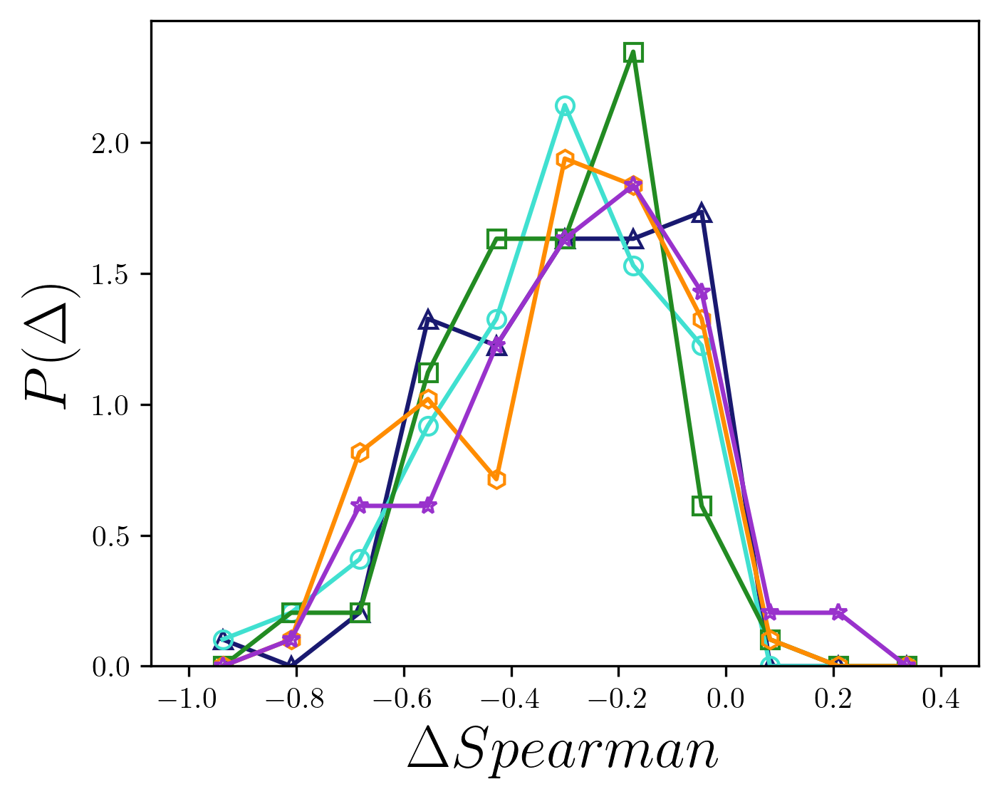

In [57]:
## Tenative Figure 2 - C - Delta improvement in spearman for each score - prob distribution

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid"]

nbins = 12
bins = np.linspace(-1, 0.4, nbins)
x = create_prob_dist_identical_bins(np.array(ss_corr_df["spearman_dockq_zrank"]) - np.array(fraction_relaxed_corr_df["spearman_dockq_zrank"]), fig, ax, bins = bins, color = colors[0], marker = "^", label = "ZRank")
x = create_prob_dist_identical_bins(np.array(ss_corr_df["spearman_dockq_hdock"]) - np.array(fraction_relaxed_corr_df["spearman_dockq_hdock"]), fig, ax, bins = bins, color = colors[1], marker = "o", label = "HDOCK")
x = create_prob_dist_identical_bins(np.array(ss_corr_df["spearman_dockq_rosetta"]) - np.array(fraction_relaxed_corr_df["spearman_dockq_rosetta"]), fig, ax, bins = bins, color = colors[2], marker = "s", label = "Rosetta")
x = create_prob_dist_identical_bins(np.array(ss_corr_df["spearman_dockq_pydock"]) - np.array(fraction_relaxed_corr_df["spearman_dockq_pydock"]), fig, ax, bins = bins, color = colors[3], marker = "h", label = "PyDock")
x = create_prob_dist_identical_bins(np.array(ss_corr_df["spearman_dockq_voromqa"])*-1 - np.array(fraction_relaxed_corr_df["spearman_dockq_voromqa"])*-1, fig, ax, bins = bins, color = colors[4], marker = "*", label = "VoroMQA")


print(np.mean(np.array(ss_corr_df["spearman_dockq_zrank"]) - np.array(fraction_relaxed_corr_df["spearman_dockq_zrank"])))
print(np.mean(np.array(ss_corr_df["spearman_dockq_hdock"]) - np.array(fraction_relaxed_corr_df["spearman_dockq_hdock"])))
print(np.mean(np.array(ss_corr_df["spearman_dockq_rosetta"]) - np.array(fraction_relaxed_corr_df["spearman_dockq_rosetta"])))
print(np.mean(np.array(ss_corr_df["spearman_dockq_pydock"]) - np.array(fraction_relaxed_corr_df["spearman_dockq_pydock"])))
print(np.mean(np.array(ss_corr_df["spearman_dockq_voromqa"]) - np.array(fraction_relaxed_corr_df["spearman_dockq_voromqa"])))

ax.set_xlabel("$\Delta Spearman$", fontsize = 20)
ax.set_ylabel("$P(\Delta)$", fontsize = 20)

# plt.legend()
plt.tight_layout

In [797]:
ss_corr_df.columns

Index(['pdb', 'pearson_ialign_zrank', 'pearson_ialign_hdock',
       'pearson_ialign_rosetta', 'pearson_ialign_pydock',
       'pearson_ialign_voromqa', 'pearson_ialign_voromqa_js',
       'pearson_ialign_dove_5', 'pearson_ialign_intertwined',
       'pearson_ialign_deeprank_gnn_esm', 'pearson_ialign_contact_42',
       'pearson_ialign_contact_43', 'pearson_ialign_contact_44',
       'pearson_ialign_contact_45', 'pearson_ialign_interface_rsa',
       'pearson_dockq_zrank', 'pearson_dockq_hdock', 'pearson_dockq_rosetta',
       'pearson_dockq_pydock', 'pearson_dockq_voromqa',
       'pearson_dockq_voromqa_js', 'pearson_dockq_dove_5',
       'pearson_dockq_intertwined', 'pearson_dockq_deeprank_gnn_esm',
       'pearson_dockq_contact_42', 'pearson_dockq_contact_43',
       'pearson_dockq_contact_44', 'pearson_dockq_contact_45',
       'pearson_dockq_interface_rsa', 'spearman_ialign_zrank',
       'spearman_ialign_hdock', 'spearman_ialign_rosetta',
       'spearman_ialign_pydock', 'spearma

/var/folders/kr/4__h_fpn42334nd1tdtl4w8w0000gn/T/ipykernel_6975/1467087135.py:130: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if bins == []:


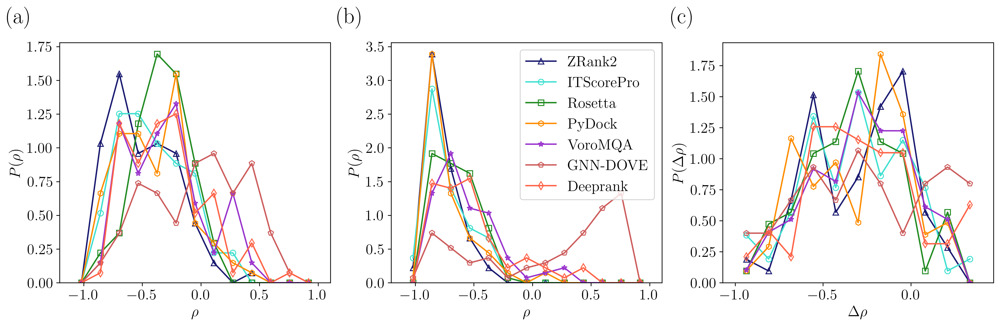

In [833]:
## All together

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid", "indianred", "tomato"]

markers = ["^", "o", "s", "h", "*", "p", "d"]

font_size = 16

## Subpanel A

fig, ax = plt.subplots(1, 3, figsize = (15,5), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid", "indianred", "tomato"]

nbins = 14
bins = np.linspace(-1.1, 1.0, nbins)
x = create_prob_dist_identical_bins(np.array(relaxed_corr_df["spearman_dockq_zrank"]), fig, ax[0], bins = bins, color = colors[0], marker = "^", label = "ZRank2")
x = create_prob_dist_identical_bins(np.array(relaxed_corr_df["spearman_dockq_hdock"]), fig, ax[0], bins = bins, color = colors[1], marker = "o", label = "ITScorePro")
x = create_prob_dist_identical_bins(np.array(relaxed_corr_df["spearman_dockq_rosetta"]), fig, ax[0], bins = bins, color = colors[2], marker = "s", label = "Rosetta")
x = create_prob_dist_identical_bins(np.array(relaxed_corr_df["spearman_dockq_pydock"]), fig, ax[0], bins = bins, color = colors[3], marker = "h", label = "PyDock")
x = create_prob_dist_identical_bins(np.array(relaxed_corr_df["spearman_dockq_voromqa"])*-1, fig, ax[0], bins = bins, color = colors[4], marker = "*", label = "VoroMQA")
x = create_prob_dist_identical_bins(np.array(relaxed_corr_df["spearman_dockq_dove_5"]), fig, ax[0], bins = bins, color = colors[5], marker = "p", label = "GNN-DOVE")
x = create_prob_dist_identical_bins(np.array(relaxed_corr_df["spearman_dockq_deeprank_gnn_esm"])*-1, fig, ax[0], bins = bins, color = colors[6], marker = "d", label = "Deeprank-GNN-ESM")


ax[0].set_xlabel(r"$\rho$", fontsize = font_size)
ax[0].set_ylabel(r"$P(\rho)$", fontsize = font_size)

ax[0].text(-0.1, 1.15, "(a)", transform=ax[0].transAxes,fontsize=font_size*1.5, fontweight='bold', va='top', ha='right')

## Subpanel B

nbins = 14
bins = np.linspace(-1.1, 1.0, nbins)
x = create_prob_dist_identical_bins(np.array(ss_corr_df["spearman_dockq_zrank"]), fig, ax[1], bins = bins, color = colors[0], marker = "^", label = "ZRank2")
x = create_prob_dist_identical_bins(np.array(ss_corr_df["spearman_dockq_hdock"]), fig, ax[1], bins = bins, color = colors[1], marker = "o", label = "ITScorePro")
x = create_prob_dist_identical_bins(np.array(ss_corr_df["spearman_dockq_rosetta"]), fig, ax[1], bins = bins, color = colors[2], marker = "s", label = "Rosetta")
x = create_prob_dist_identical_bins(np.array(ss_corr_df["spearman_dockq_pydock"]), fig, ax[1], bins = bins, color = colors[3], marker = "h", label = "PyDock")
x = create_prob_dist_identical_bins(np.array(ss_corr_df["spearman_dockq_voromqa"])*-1, fig, ax[1], bins = bins, color = colors[4], marker = "*", label = "VoroMQA")
x = create_prob_dist_identical_bins(np.array(ss_corr_df["spearman_dockq_dove_5"]), fig, ax[1], bins = bins, color = colors[5], marker = "p", label = "GNN-DOVE")
x = create_prob_dist_identical_bins(np.array(ss_corr_df["spearman_dockq_deeprank_gnn_esm"])*-1, fig, ax[1], bins = bins, color = colors[6], marker = "d", label = "Deeprank")

ax[1].set_xlabel(r"$\rho$", fontsize = font_size)
ax[1].set_ylabel(r"$P(\rho)$", fontsize = font_size)

ax[1].text(-0.1, 1.15, "(b)", transform=ax[1].transAxes,fontsize=font_size*1.5, fontweight='bold', va='top', ha='right')

ax[1].legend(fontsize = font_size)

## Subpanel C

nbins = 12
bins = np.linspace(-1, 0.4, nbins)
x = create_prob_dist_identical_bins(np.array(ss_corr_df["spearman_dockq_zrank"]) - np.array(relaxed_corr_df["spearman_dockq_zrank"]), fig, ax[2], bins = bins, color = colors[0], marker = "^", label = "ZRank")
x = create_prob_dist_identical_bins(np.array(ss_corr_df["spearman_dockq_hdock"]) - np.array(relaxed_corr_df["spearman_dockq_hdock"]), fig, ax[2], bins = bins, color = colors[1], marker = "o", label = "HDOCK")
x = create_prob_dist_identical_bins(np.array(ss_corr_df["spearman_dockq_rosetta"]) - np.array(relaxed_corr_df["spearman_dockq_rosetta"]), fig, ax[2], bins = bins, color = colors[2], marker = "s", label = "Rosetta")
x = create_prob_dist_identical_bins(np.array(ss_corr_df["spearman_dockq_pydock"]) - np.array(relaxed_corr_df["spearman_dockq_pydock"]), fig, ax[2], bins = bins, color = colors[3], marker = "h", label = "PyDock")
x = create_prob_dist_identical_bins(np.array(ss_corr_df["spearman_dockq_voromqa"])*-1 - np.array(relaxed_corr_df["spearman_dockq_voromqa"])*-1, fig, ax[2], bins = bins, color = colors[4], marker = "*", label = "VoroMQA")
x = create_prob_dist_identical_bins(np.array(ss_corr_df["spearman_dockq_dove_5"])*-1 - np.array(relaxed_corr_df["spearman_dockq_dove_5"])*-1, fig, ax[2], bins = bins, color = colors[5], marker = "p", label = "GNN-DOVE")
x = create_prob_dist_identical_bins(np.array(ss_corr_df["spearman_dockq_deeprank_gnn_esm"])*-1 - np.array(relaxed_corr_df["spearman_dockq_deeprank_gnn_esm"])*-1, fig, ax[2], bins = bins, color = colors[6], marker = "d", label = "Deeprank")

ax[2].set_xlabel(r"$\Delta \rho$", fontsize = font_size)
ax[2].set_ylabel(r"$P(\Delta \rho)$", fontsize = font_size)

ax[2].text(-0.1, 1.15, "(c)", transform=ax[2].transAxes,fontsize=font_size*1.5, fontweight='bold', va='top', ha='right')
ax[0].tick_params(axis='both', which='major', labelsize=font_size)
ax[1].tick_params(axis='both', which='major', labelsize=font_size)
ax[2].tick_params(axis='both', which='major', labelsize=font_size)


plt.tight_layout()
plt.savefig(join(figure_save_dir, "spearman_comparison.png"))

/var/folders/kr/4__h_fpn42334nd1tdtl4w8w0000gn/T/ipykernel_6975/1467087135.py:130: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if bins == []:


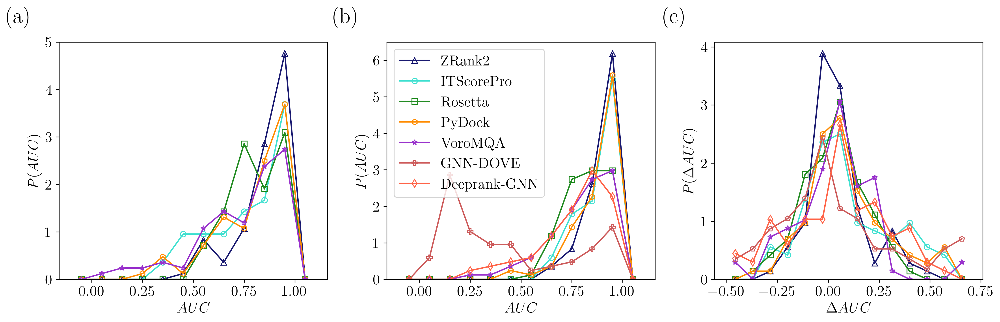

In [810]:
## All together - but AUROC

font_size = 16

## Subpanel A

fig, ax = plt.subplots(1, 3, figsize = (15,5), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid", "indianred", "tomato"]

nbins = 13
bins = np.linspace(-.1, 1.1, nbins)
x = create_prob_dist_identical_bins(np.array(relaxed_corr_df["zrank_auc"]), fig, ax[0], bins = bins, color = colors[0], marker = "^", label = "ZRank2")
x = create_prob_dist_identical_bins(np.array(relaxed_corr_df["hdock_auc"]), fig, ax[0], bins = bins, color = colors[1], marker = "o", label = "ITScorePro")
x = create_prob_dist_identical_bins(np.array(relaxed_corr_df["rosetta_auc"]), fig, ax[0], bins = bins, color = colors[2], marker = "s", label = "Rosetta")
x = create_prob_dist_identical_bins(np.array(relaxed_corr_df["pydock_auc"]), fig, ax[0], bins = bins, color = colors[3], marker = "h", label = "PyDock")
x = create_prob_dist_identical_bins(np.array(relaxed_corr_df["voromqa_auc"]), fig, ax[0], bins = bins, color = colors[4], marker = "*", label = "VoroMQA")


ax[0].set_xlabel("$AUC$", fontsize = font_size)
ax[0].set_ylabel("$P(AUC)$", fontsize = font_size)

ax[0].text(-0.1, 1.15, "(a)", transform=ax[0].transAxes,fontsize=font_size*1.5, fontweight='bold', va='top', ha='right')

## Subpanel B

nbins = 13
bins = np.linspace(-.1, 1.1, nbins)
x = create_prob_dist_identical_bins(np.array(ss_corr_df["zrank_auc"]), fig, ax[1], bins = bins, color = colors[0], marker = "^", label = "ZRank2")
x = create_prob_dist_identical_bins(np.array(ss_corr_df["hdock_auc"]), fig, ax[1], bins = bins, color = colors[1], marker = "o", label = "ITScorePro")
x = create_prob_dist_identical_bins(np.array(ss_corr_df["rosetta_auc"]), fig, ax[1], bins = bins, color = colors[2], marker = "s", label = "Rosetta")
x = create_prob_dist_identical_bins(np.array(ss_corr_df["pydock_auc"]), fig, ax[1], bins = bins, color = colors[3], marker = "h", label = "PyDock")
x = create_prob_dist_identical_bins(np.array(ss_corr_df["voromqa_auc"]), fig, ax[1], bins = bins, color = colors[4], marker = "*", label = "VoroMQA")
x = create_prob_dist_identical_bins(np.array(ss_corr_df["dove_5_auc"]), fig, ax[1], bins = bins, color = colors[5], marker = "P", label = "GNN-DOVE")
x = create_prob_dist_identical_bins(np.array(ss_corr_df["deeprank_gnn_esm_auc"]), fig, ax[1], bins = bins, color = colors[6], marker = "d", label = "Deeprank-GNN")

ax[1].set_xlabel("$AUC$", fontsize = font_size)
ax[1].set_ylabel("$P(AUC)$", fontsize = font_size)

ax[1].text(-0.1, 1.15, "(b)", transform=ax[1].transAxes,fontsize=font_size*1.5, fontweight='bold', va='top', ha='right')

ax[1].legend(fontsize = font_size)

## Subpanel C

nbins = 15
bins = np.linspace(-.5, 0.7, nbins)
x = create_prob_dist_identical_bins(np.array(ss_corr_df["zrank_auc"]) - np.array(relaxed_corr_df["zrank_auc"]), fig, ax[2], bins = bins, color = colors[0], marker = "^", label = "ZRank2")
x = create_prob_dist_identical_bins(np.array(ss_corr_df["hdock_auc"]) - np.array(relaxed_corr_df["hdock_auc"]), fig, ax[2], bins = bins, color = colors[1], marker = "o", label = "ITScorePro")
x = create_prob_dist_identical_bins(np.array(ss_corr_df["rosetta_auc"]) - np.array(relaxed_corr_df["rosetta_auc"]), fig, ax[2], bins = bins, color = colors[2], marker = "s", label = "Rosetta")
x = create_prob_dist_identical_bins(np.array(ss_corr_df["pydock_auc"]) - np.array(relaxed_corr_df["pydock_auc"]), fig, ax[2], bins = bins, color = colors[3], marker = "h", label = "PyDock")
x = create_prob_dist_identical_bins(np.array(ss_corr_df["voromqa_auc"]) - np.array(relaxed_corr_df["voromqa_auc"]), fig, ax[2], bins = bins, color = colors[4], marker = "*", label = "VoroMQA")
x = create_prob_dist_identical_bins(np.array(ss_corr_df["dove_5_auc"]) - np.array(relaxed_corr_df["dove_5_auc"]), fig, ax[2], bins = bins, color = colors[5], marker = "p", label = "GNN-DOVE")
x = create_prob_dist_identical_bins(np.array(ss_corr_df["deeprank_gnn_esm_auc"]) - np.array(relaxed_corr_df["deeprank_gnn_esm_auc"]), fig, ax[2], bins = bins, color = colors[6], marker = "d", label = "Deeprank")

ax[2].set_xlabel(r"$\Delta AUC$", fontsize = font_size)
ax[2].set_ylabel(r"$P(\Delta AUC)$", fontsize = font_size)

ax[2].text(-0.1, 1.15, "(c)", transform=ax[2].transAxes,fontsize=font_size*1.5, fontweight='bold', va='top', ha='right')
ax[0].tick_params(axis='both', which='major', labelsize=font_size)
ax[1].tick_params(axis='both', which='major', labelsize=font_size)
ax[2].tick_params(axis='both', which='major', labelsize=font_size)


plt.tight_layout()
plt.savefig(join(figure_save_dir, "auroc_comparison.png"))

# Figure 2 Supplement - Show VoroMQA is bad so we can remove it

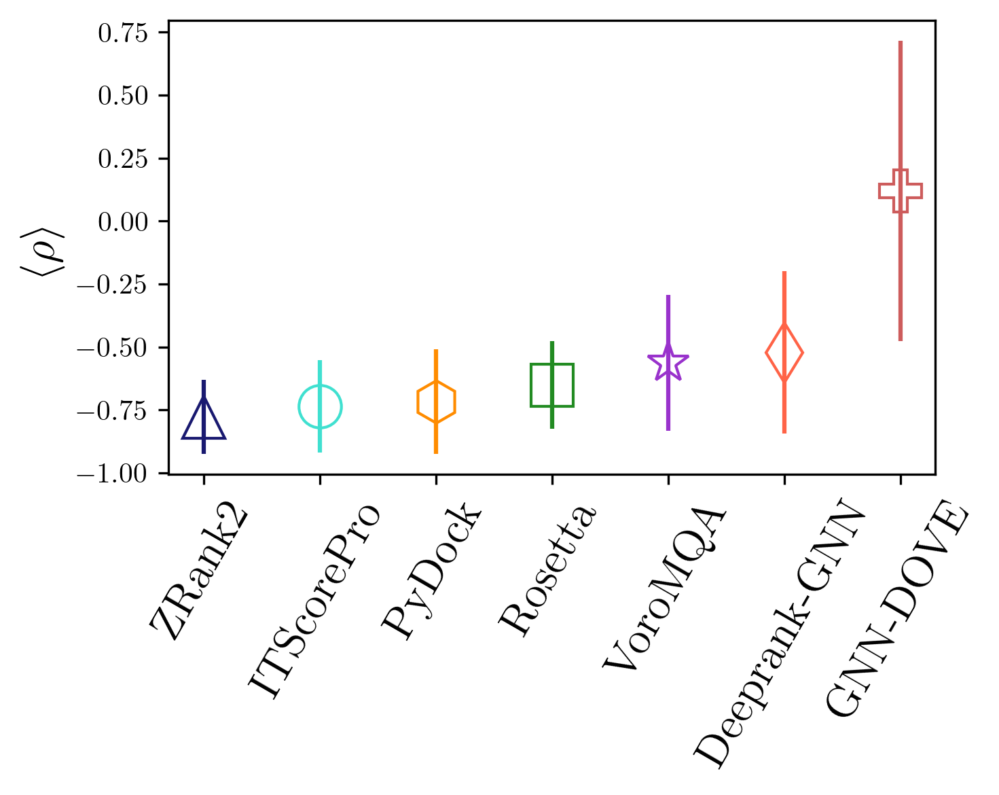

In [226]:
## Show a plot of the average spearman with standard deviation for all scoring methods
## Also showing Deeprank this time:

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid", "indianred", "tomato"]

markers = ["^", "o", "s", "h", "*", "P", "d"]

x_axis = range(7)


ss_plot_data = [np.mean(ss_corr_df["spearman_dockq_zrank"]), np.mean(ss_corr_df["spearman_dockq_hdock"]),
                    np.mean(ss_corr_df["spearman_dockq_rosetta"]), np.mean(ss_corr_df["spearman_dockq_pydock"]),
                    np.mean(ss_corr_df["spearman_dockq_voromqa"]*-1), np.mean(ss_corr_df["spearman_dockq_dove_5"]),
                    np.mean(ss_corr_df["spearman_dockq_deeprank_gnn_esm"]*-1)]


ss_plot_std = [np.std(ss_corr_df["spearman_dockq_zrank"]), np.std(ss_corr_df["spearman_dockq_hdock"]),
                    np.std(ss_corr_df["spearman_dockq_rosetta"]), np.std(ss_corr_df["spearman_dockq_pydock"]),
                    np.std(ss_corr_df["spearman_dockq_voromqa"]*-1), np.std(ss_corr_df["spearman_dockq_dove_5"]),
                      np.std(ss_corr_df["spearman_dockq_deeprank_gnn_esm"]*-1)]

plt.errorbar(x_axis[0], ss_plot_data[0], yerr = ss_plot_std[0], color = colors[0], marker = markers[0], markerfacecolor = "None", markersize = 15)
plt.errorbar(x_axis[1], ss_plot_data[1], yerr = ss_plot_std[1], color = colors[1], marker = markers[1], markerfacecolor = "None", markersize = 15)
plt.errorbar(x_axis[3], ss_plot_data[2], yerr = ss_plot_std[2], color = colors[2], marker = markers[2], markerfacecolor = "None", markersize = 15)
plt.errorbar(x_axis[2], ss_plot_data[3], yerr = ss_plot_std[3], color = colors[3], marker = markers[3], markerfacecolor = "None", markersize = 15)
plt.errorbar(x_axis[4], ss_plot_data[4], yerr = ss_plot_std[4], color = colors[4], marker = markers[4], markerfacecolor = "None", markersize = 15)
plt.errorbar(x_axis[6], ss_plot_data[5], yerr = ss_plot_std[5], color = colors[5], marker = markers[5], markerfacecolor = "None", markersize = 15)
plt.errorbar(x_axis[5], ss_plot_data[6], yerr = ss_plot_std[6], color = colors[6], marker = markers[6], markerfacecolor = "None", markersize = 15)

                              
score_list = ["ZRank2", "ITScorePro", "PyDock", "Rosetta", "VoroMQA", "Deeprank-GNN", "GNN-DOVE"]
plt.xticks(x_axis, score_list, fontsize = 16, rotation = 60)

ax.set_ylabel(r"$\langle \rho \rangle$", fontsize = 16)
fig.tight_layout()
plt.savefig(join(figure_save_dir, "simple_spearman_graph.png"))

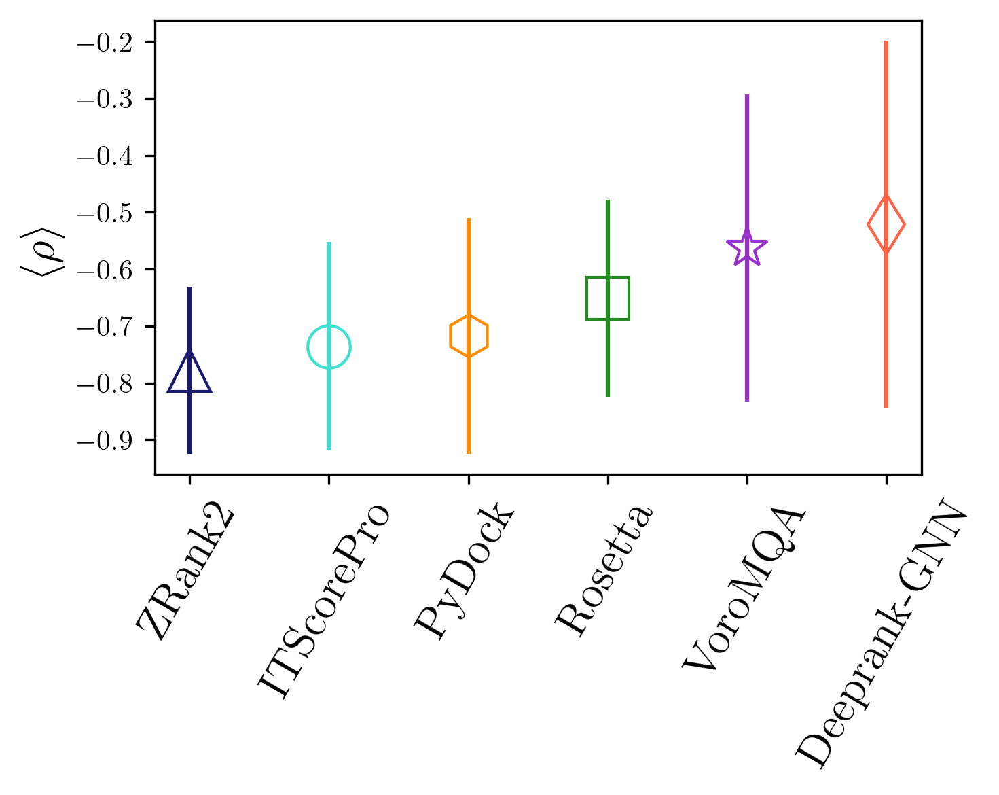

In [227]:
## Show a plot of the average spearman BUT NO DOVE

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid", "indianred", "tomato"]

markers = ["^", "o", "s", "h", "*", "P", "d"]

x_axis = range(6)


ss_plot_data = [np.mean(ss_corr_df["spearman_dockq_zrank"]), np.mean(ss_corr_df["spearman_dockq_hdock"]),
                    np.mean(ss_corr_df["spearman_dockq_rosetta"]), np.mean(ss_corr_df["spearman_dockq_pydock"]),
                    np.mean(ss_corr_df["spearman_dockq_voromqa"]*-1), np.mean(ss_corr_df["spearman_dockq_dove_5"]),
                    np.mean(ss_corr_df["spearman_dockq_deeprank_gnn_esm"]*-1)]


ss_plot_std = [np.std(ss_corr_df["spearman_dockq_zrank"]), np.std(ss_corr_df["spearman_dockq_hdock"]),
                    np.std(ss_corr_df["spearman_dockq_rosetta"]), np.std(ss_corr_df["spearman_dockq_pydock"]),
                    np.std(ss_corr_df["spearman_dockq_voromqa"]*-1), np.std(ss_corr_df["spearman_dockq_dove_5"]),
                      np.std(ss_corr_df["spearman_dockq_deeprank_gnn_esm"]*-1)]

plt.errorbar(x_axis[0], ss_plot_data[0], yerr = ss_plot_std[0], color = colors[0], marker = markers[0], markerfacecolor = "None", markersize = 15)
plt.errorbar(x_axis[1], ss_plot_data[1], yerr = ss_plot_std[1], color = colors[1], marker = markers[1], markerfacecolor = "None", markersize = 15)
plt.errorbar(x_axis[3], ss_plot_data[2], yerr = ss_plot_std[2], color = colors[2], marker = markers[2], markerfacecolor = "None", markersize = 15)
plt.errorbar(x_axis[2], ss_plot_data[3], yerr = ss_plot_std[3], color = colors[3], marker = markers[3], markerfacecolor = "None", markersize = 15)
plt.errorbar(x_axis[4], ss_plot_data[4], yerr = ss_plot_std[4], color = colors[4], marker = markers[4], markerfacecolor = "None", markersize = 15)
# plt.errorbar(x_axis[6], ss_plot_data[5], yerr = ss_plot_std[5], color = colors[5], marker = markers[5], markerfacecolor = "None", markersize = 15)
plt.errorbar(x_axis[5], ss_plot_data[6], yerr = ss_plot_std[6], color = colors[6], marker = markers[6], markerfacecolor = "None", markersize = 15)

                              
score_list = ["ZRank2", "ITScorePro", "PyDock", "Rosetta", "VoroMQA", "Deeprank-GNN"]
plt.xticks(x_axis, score_list, fontsize = 16, rotation = 60)

ax.set_ylabel(r"$\langle \rho \rangle$", fontsize = 16)
fig.tight_layout()
plt.savefig(join(figure_save_dir, "simple_spearman_graph_no_dove.png"))

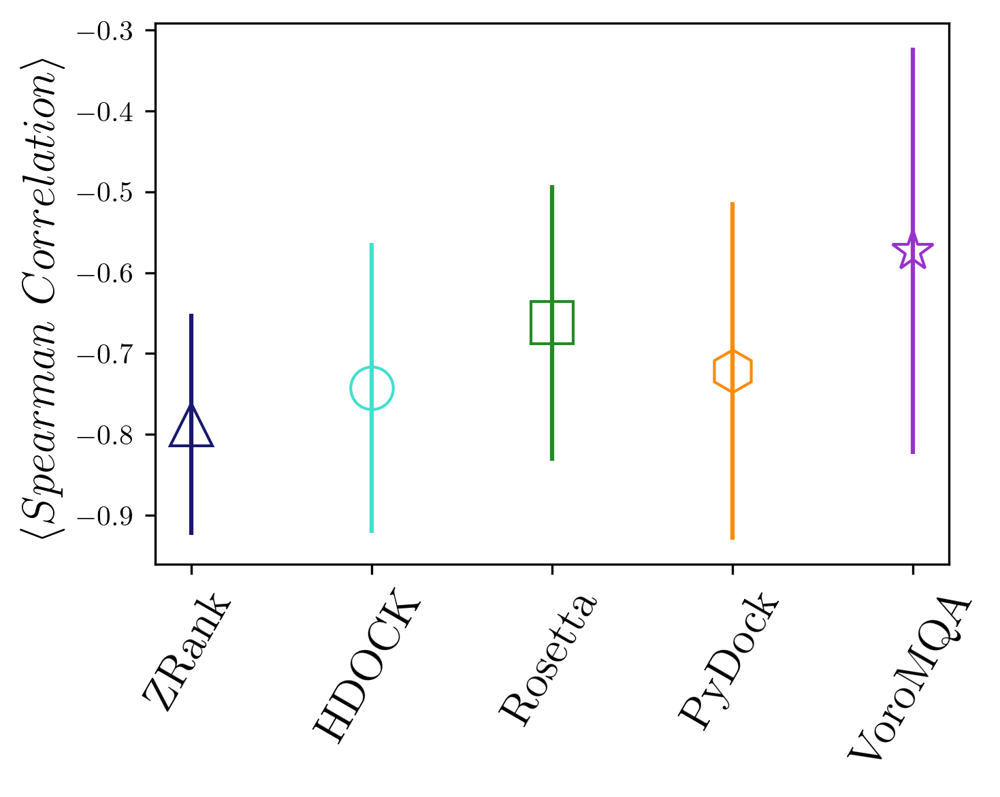

In [118]:
## Show a plot of the average spearman with standard deviation for all scoring methods
## Both before and after supersampling - emphasize that it's bad

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid", "indianred"]

markers = ["^", "o", "s", "h", "*", "p"]

x_axis = range(5)

relaxed_plot_data = [np.mean(relaxed_corr_df["spearman_dockq_zrank"]), np.mean(relaxed_corr_df["spearman_dockq_hdock"]),
                    np.mean(relaxed_corr_df["spearman_dockq_rosetta"]), np.mean(relaxed_corr_df["spearman_dockq_pydock"]),
                    np.mean(relaxed_corr_df["spearman_dockq_voromqa"]*-1)]

ss_plot_data = [np.mean(ss_corr_df["spearman_dockq_zrank"]), np.mean(ss_corr_df["spearman_dockq_hdock"]),
                    np.mean(ss_corr_df["spearman_dockq_rosetta"]), np.mean(ss_corr_df["spearman_dockq_pydock"]),
                    np.mean(ss_corr_df["spearman_dockq_voromqa"]*-1), np.mean(ss_corr_df["spearman_dockq_dove"])]

relaxed_plot_std = [np.std(relaxed_corr_df["spearman_dockq_zrank"]), np.std(relaxed_corr_df["spearman_dockq_hdock"]),
                    np.std(relaxed_corr_df["spearman_dockq_rosetta"]), np.std(relaxed_corr_df["spearman_dockq_pydock"]),
                    np.std(relaxed_corr_df["spearman_dockq_voromqa"]*-1)]

ss_plot_std = [np.std(ss_corr_df["spearman_dockq_zrank"]), np.std(ss_corr_df["spearman_dockq_hdock"]),
                    np.std(ss_corr_df["spearman_dockq_rosetta"]), np.std(ss_corr_df["spearman_dockq_pydock"]),
                    np.std(ss_corr_df["spearman_dockq_voromqa"]*-1), np.std(ss_corr_df["spearman_dockq_dove"])]

plt.errorbar(x_axis[0], ss_plot_data[0], yerr = ss_plot_std[0], color = colors[0], marker = markers[0], markerfacecolor = "None", markersize = 15)
plt.errorbar(x_axis[1], ss_plot_data[1], yerr = ss_plot_std[1], color = colors[1], marker = markers[1], markerfacecolor = "None", markersize = 15)
plt.errorbar(x_axis[2], ss_plot_data[2], yerr = ss_plot_std[2], color = colors[2], marker = markers[2], markerfacecolor = "None", markersize = 15)
plt.errorbar(x_axis[3], ss_plot_data[3], yerr = ss_plot_std[3], color = colors[3], marker = markers[3], markerfacecolor = "None", markersize = 15)
plt.errorbar(x_axis[4], ss_plot_data[4], yerr = ss_plot_std[4], color = colors[4], marker = markers[4], markerfacecolor = "None", markersize = 15)
# plt.errorbar(x_axis[5], ss_plot_data[5], yerr = ss_plot_std[5], color = colors[5], marker = markers[5], markerfacecolor = "None", markersize = 15)

score_list = ["ZRank", "HDOCK", "Rosetta", "PyDock", "VoroMQA"]
plt.xticks(x_axis, score_list, fontsize = 16, rotation = 60)

ax.set_ylabel(r"$\langle Spearman$ $Correlation\rangle$", fontsize = 16)
fig.tight_layout()

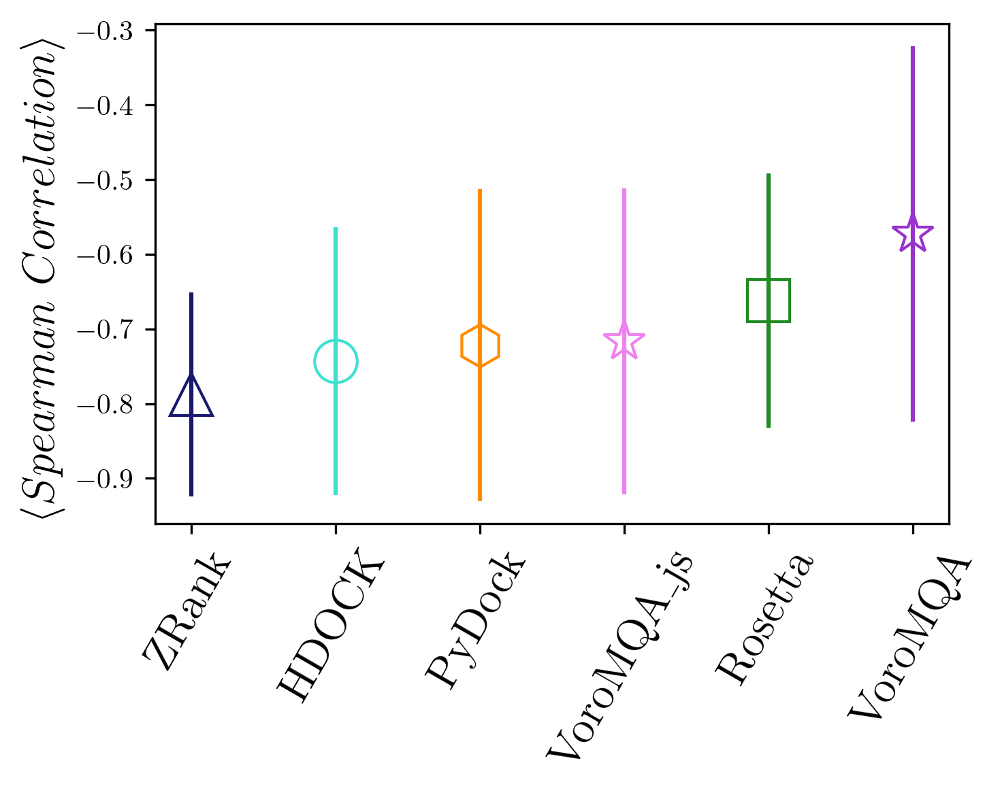

In [538]:
## Including the New VoroMQA data

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid", "indianred", "violet"]

markers = ["^", "o", "s", "h", "*", "p"]



ss_plot_data = [np.mean(ss_corr_df["spearman_dockq_zrank"]), np.mean(ss_corr_df["spearman_dockq_hdock"]),
                    np.mean(ss_corr_df["spearman_dockq_rosetta"]), np.mean(ss_corr_df["spearman_dockq_pydock"]),
                    np.mean(ss_corr_df["spearman_dockq_voromqa"]*-1), np.mean(ss_corr_df["spearman_dockq_voromqa_js"]*-1)]

ss_plot_std = [np.std(ss_corr_df["spearman_dockq_zrank"]), np.std(ss_corr_df["spearman_dockq_hdock"]),
                    np.std(ss_corr_df["spearman_dockq_rosetta"]), np.std(ss_corr_df["spearman_dockq_pydock"]),
                    np.std(ss_corr_df["spearman_dockq_voromqa"]*-1), np.std(ss_corr_df["spearman_dockq_voromqa_js"]*-1)]

x_axis = range(len(ss_plot_data))

plt.errorbar(x_axis[0], ss_plot_data[0], yerr = ss_plot_std[0], color = colors[0], marker = markers[0], markerfacecolor = "None", markersize = 15)
plt.errorbar(x_axis[1], ss_plot_data[1], yerr = ss_plot_std[1], color = colors[1], marker = markers[1], markerfacecolor = "None", markersize = 15)
plt.errorbar(x_axis[2], ss_plot_data[3], yerr = ss_plot_std[3], color = colors[3], marker = markers[3], markerfacecolor = "None", markersize = 15)
plt.errorbar(x_axis[3], ss_plot_data[5], yerr = ss_plot_std[5], color = colors[6], marker = markers[4], markerfacecolor = "None", markersize = 15)
plt.errorbar(x_axis[4], ss_plot_data[2], yerr = ss_plot_std[2], color = colors[2], marker = markers[2], markerfacecolor = "None", markersize = 15)
plt.errorbar(x_axis[5], ss_plot_data[4], yerr = ss_plot_std[4], color = colors[4], marker = markers[4], markerfacecolor = "None", markersize = 15)
# plt.errorbar(x_axis[5], ss_plot_data[5], yerr = ss_plot_std[5], color = colors[5], marker = markers[5], markerfacecolor = "None", markersize = 15)

score_list = ["ZRank", "HDOCK", "PyDock", "VoroMQA_js", "Rosetta", "VoroMQA"]
plt.xticks(x_axis, score_list, fontsize = 16, rotation = 60)

ax.set_ylabel(r"$\langle Spearman$ $Correlation\rangle$", fontsize = 16)
fig.tight_layout()

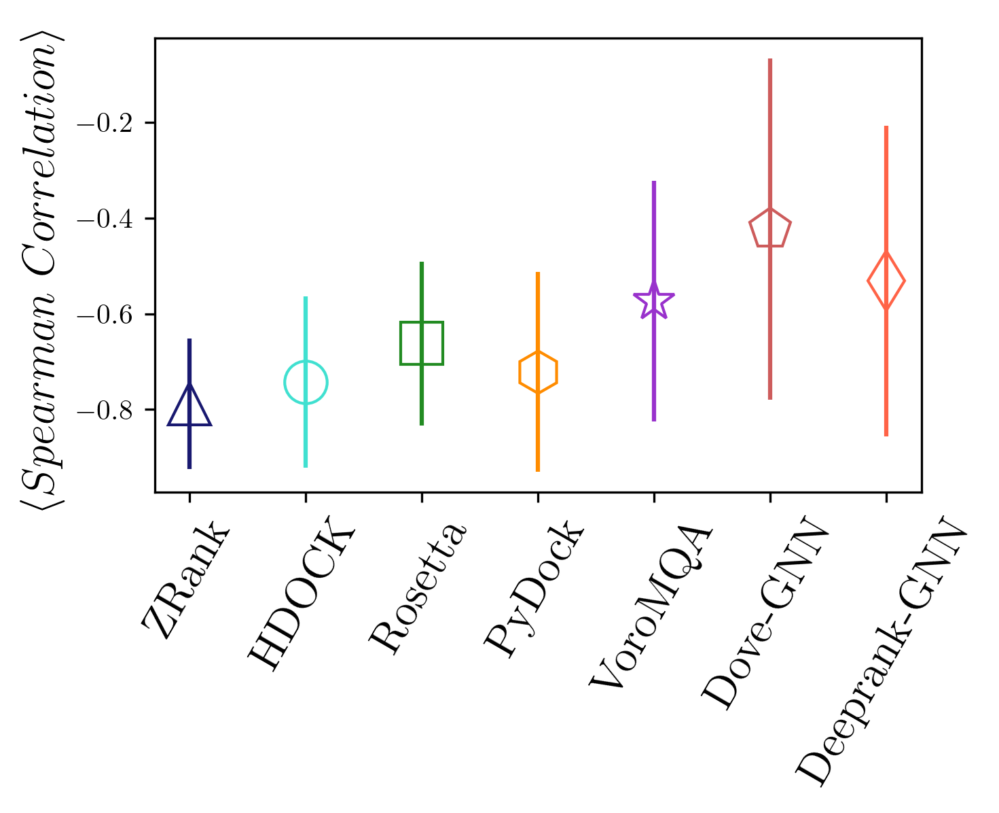

In [308]:
## Show a plot of the average spearman with standard deviation for all scoring methods
## Also showing Deeprank this time:

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid", "indianred", "tomato"]

markers = ["^", "o", "s", "h", "*", "p", "d"]

x_axis = range(7)

relaxed_plot_data = [np.mean(relaxed_corr_df["spearman_dockq_zrank"]), np.mean(relaxed_corr_df["spearman_dockq_hdock"]),
                    np.mean(relaxed_corr_df["spearman_dockq_rosetta"]), np.mean(relaxed_corr_df["spearman_dockq_pydock"]),
                    np.mean(relaxed_corr_df["spearman_dockq_voromqa"]*-1)]

ss_plot_data = [np.mean(ss_corr_df["spearman_dockq_zrank"]), np.mean(ss_corr_df["spearman_dockq_hdock"]),
                    np.mean(ss_corr_df["spearman_dockq_rosetta"]), np.mean(ss_corr_df["spearman_dockq_pydock"]),
                    np.mean(ss_corr_df["spearman_dockq_voromqa"]*-1), np.mean(ss_corr_df["spearman_dockq_dove"]),
                    np.mean(ss_corr_df["spearman_dockq_deeprank"]*-1)]

relaxed_plot_std = [np.std(relaxed_corr_df["spearman_dockq_zrank"]), np.std(relaxed_corr_df["spearman_dockq_hdock"]),
                    np.std(relaxed_corr_df["spearman_dockq_rosetta"]), np.std(relaxed_corr_df["spearman_dockq_pydock"]),
                    np.std(relaxed_corr_df["spearman_dockq_voromqa"]*-1)]

ss_plot_std = [np.std(ss_corr_df["spearman_dockq_zrank"]), np.std(ss_corr_df["spearman_dockq_hdock"]),
                    np.std(ss_corr_df["spearman_dockq_rosetta"]), np.std(ss_corr_df["spearman_dockq_pydock"]),
                    np.std(ss_corr_df["spearman_dockq_voromqa"]*-1), np.std(ss_corr_df["spearman_dockq_dove"]),
                      np.std(ss_corr_df["spearman_dockq_deeprank"]*-1)]

plt.errorbar(x_axis[0], ss_plot_data[0], yerr = ss_plot_std[0], color = colors[0], marker = markers[0], markerfacecolor = "None", markersize = 15)
plt.errorbar(x_axis[1], ss_plot_data[1], yerr = ss_plot_std[1], color = colors[1], marker = markers[1], markerfacecolor = "None", markersize = 15)
plt.errorbar(x_axis[2], ss_plot_data[2], yerr = ss_plot_std[2], color = colors[2], marker = markers[2], markerfacecolor = "None", markersize = 15)
plt.errorbar(x_axis[3], ss_plot_data[3], yerr = ss_plot_std[3], color = colors[3], marker = markers[3], markerfacecolor = "None", markersize = 15)
plt.errorbar(x_axis[4], ss_plot_data[4], yerr = ss_plot_std[4], color = colors[4], marker = markers[4], markerfacecolor = "None", markersize = 15)
plt.errorbar(x_axis[5], ss_plot_data[5], yerr = ss_plot_std[5], color = colors[5], marker = markers[5], markerfacecolor = "None", markersize = 15)
plt.errorbar(x_axis[6], ss_plot_data[6], yerr = ss_plot_std[6], color = colors[6], marker = markers[6], markerfacecolor = "None", markersize = 15)

                              
score_list = ["ZRank", "HDOCK", "Rosetta", "PyDock", "VoroMQA", "Dove-GNN", "Deeprank-GNN"]
plt.xticks(x_axis, score_list, fontsize = 16, rotation = 60)

ax.set_ylabel(r"$\langle Spearman$ $Correlation\rangle$", fontsize = 16)
fig.tight_layout()

0.15560097096824865


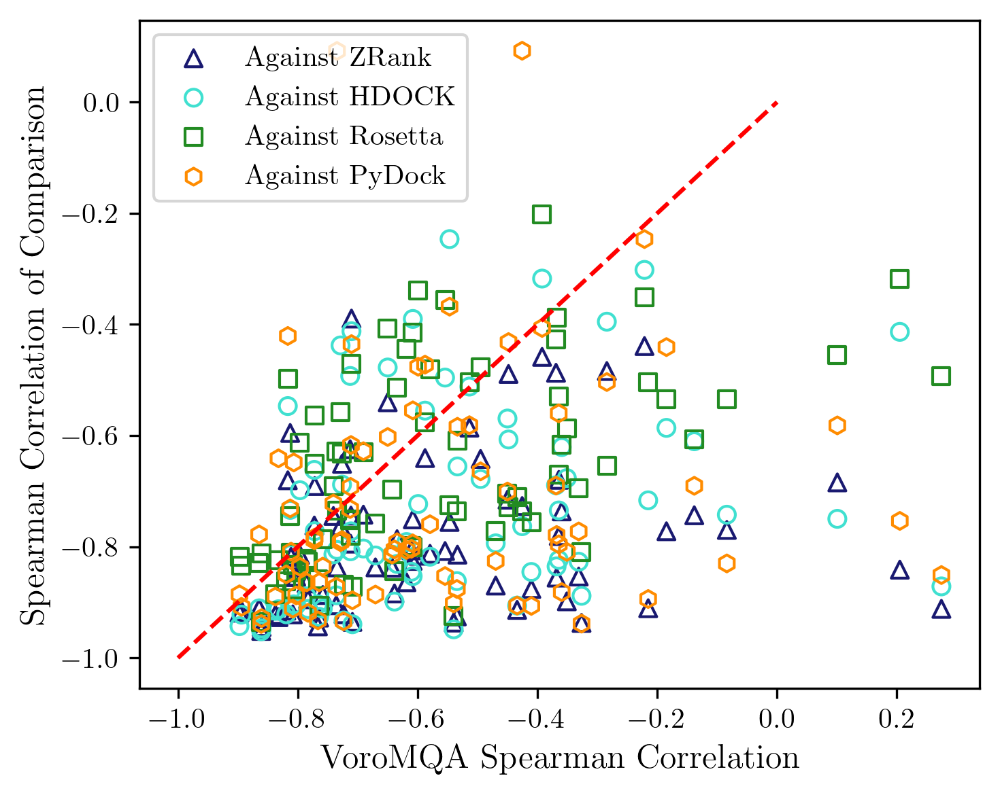

In [112]:
## Comparing VoroMQA to other scores to see if it agrees well relative to others?

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid"]

ax.scatter(np.array(ss_corr_df["spearman_dockq_voromqa"])*-1, ss_corr_df["spearman_dockq_zrank"], color = colors[0], marker = "^", facecolor = "None", label = "Against ZRank")
ax.scatter(np.array(ss_corr_df["spearman_dockq_voromqa"])*-1, ss_corr_df["spearman_dockq_hdock"], color = colors[1], marker = "o", facecolor = "None", label = "Against HDOCK")
ax.scatter(np.array(ss_corr_df["spearman_dockq_voromqa"])*-1, ss_corr_df["spearman_dockq_rosetta"], color = colors[2], marker = "s", facecolor = "None", label = "Against Rosetta")
ax.scatter(np.array(ss_corr_df["spearman_dockq_voromqa"])*-1, ss_corr_df["spearman_dockq_pydock"], color = colors[3], marker = "h", facecolor = "None", label = "Against PyDock")

ax.plot([-1,0], [-1, 0], "r--")

## getting the average residuals to the y = x line

p1 = np.array([1,1])
p2 = np.array([-1,-1])

avg_resid = []
avg_resid.append(np.mean(np.abs(np.cross(p2-p1, np.array(ss_corr_df[["spearman_dockq_voromqa", "spearman_dockq_zrank"]]) * np.array([-1,1]) - p1)/norm(p2-p1))))
avg_resid.append(np.mean(np.abs(np.cross(p2-p1, np.array(ss_corr_df[["spearman_dockq_voromqa", "spearman_dockq_hdock"]]) * np.array([-1,1]) - p1)/norm(p2-p1))))
avg_resid.append(np.mean(np.abs(np.cross(p2-p1, np.array(ss_corr_df[["spearman_dockq_voromqa", "spearman_dockq_rosetta"]]) * np.array([-1,1]) - p1)/norm(p2-p1))))
avg_resid.append(np.mean(np.abs(np.cross(p2-p1, np.array(ss_corr_df[["spearman_dockq_voromqa", "spearman_dockq_pydock"]]) * np.array([-1,1]) - p1)/norm(p2-p1))))

print(np.mean(avg_resid))

ax.set_xlabel("VoroMQA Spearman Correlation", fontsize = 12)
ax.set_ylabel("Spearman Correlation of Comparison", fontsize = 12)

plt.legend()
plt.tight_layout()

0.07810069819632483


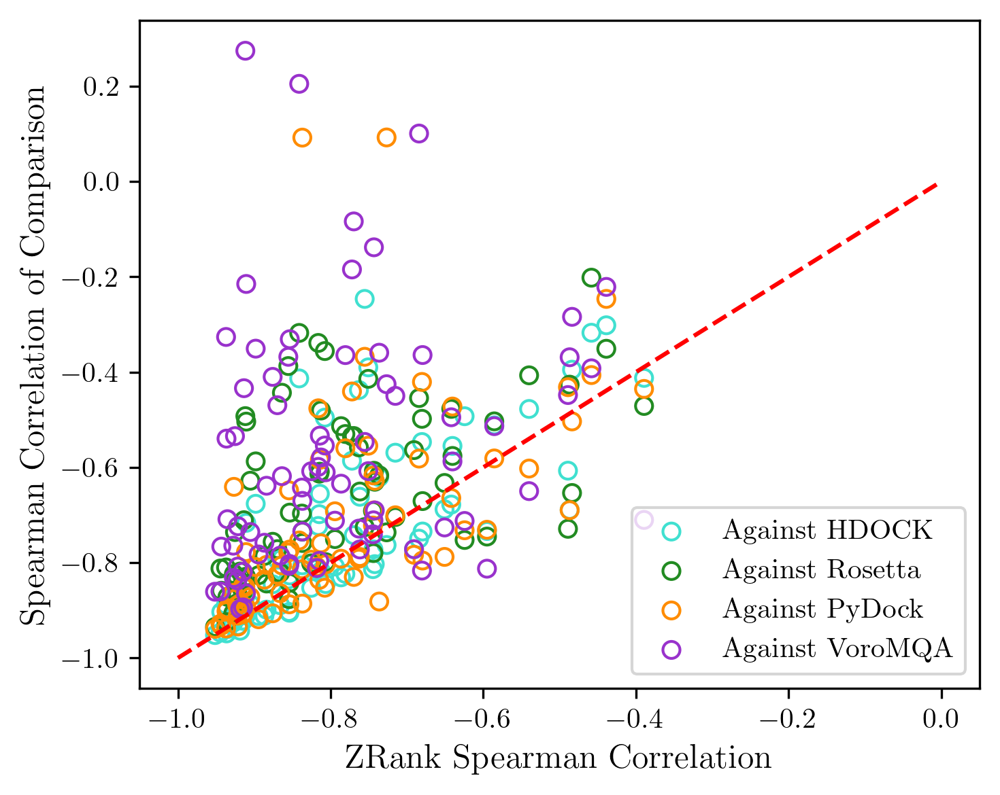

In [90]:
## Comparing VoroMQA to other scores to see if it agrees well relative to others?

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid"]

ax.scatter(np.array(ss_corr_df["spearman_dockq_zrank"]), ss_corr_df["spearman_dockq_hdock"], color = colors[1], marker = "o", facecolor = "None", label = "Against HDOCK")
ax.scatter(np.array(ss_corr_df["spearman_dockq_zrank"]), ss_corr_df["spearman_dockq_rosetta"], color = colors[2], marker = "o", facecolor = "None", label = "Against Rosetta")
ax.scatter(np.array(ss_corr_df["spearman_dockq_zrank"]), ss_corr_df["spearman_dockq_pydock"], color = colors[3], marker = "o", facecolor = "None", label = "Against PyDock")
ax.scatter(np.array(ss_corr_df["spearman_dockq_zrank"]), ss_corr_df["spearman_dockq_voromqa"]*-1, color = colors[4], marker = "o", facecolor = "None", label = "Against VoroMQA")

ax.plot([-1,0], [-1, 0], "r--")

## getting the average residuals to the y = x line

p1 = np.array([1,1])
p2 = np.array([-1,-1])

avg_resid = []
avg_resid.append(np.mean(np.abs(np.cross(p2-p1, np.array(ss_corr_df[["spearman_dockq_zrank", "spearman_dockq_hdock"]]) - p1)/norm(p2-p1))))
avg_resid.append(np.mean(np.abs(np.cross(p2-p1, np.array(ss_corr_df[["spearman_dockq_zrank", "spearman_dockq_rosetta"]]) - p1)/norm(p2-p1))))
avg_resid.append(np.mean(np.abs(np.cross(p2-p1, np.array(ss_corr_df[["spearman_dockq_zrank", "spearman_dockq_pydock"]]) - p1)/norm(p2-p1))))
# avg_resid.append(np.mean(np.abs(np.cross(p2-p1, np.array(ss_corr_df[["spearman_dockq_zrank", "spearman_dockq_voromqa"]]) * np.array([1,-1]) - p1)/norm(p2-p1))))

print(np.mean(avg_resid))

ax.set_xlabel("ZRank Spearman Correlation", fontsize = 12)
ax.set_ylabel("Spearman Correlation of Comparison", fontsize = 12)

plt.legend()
plt.tight_layout()

0.07439502814795128


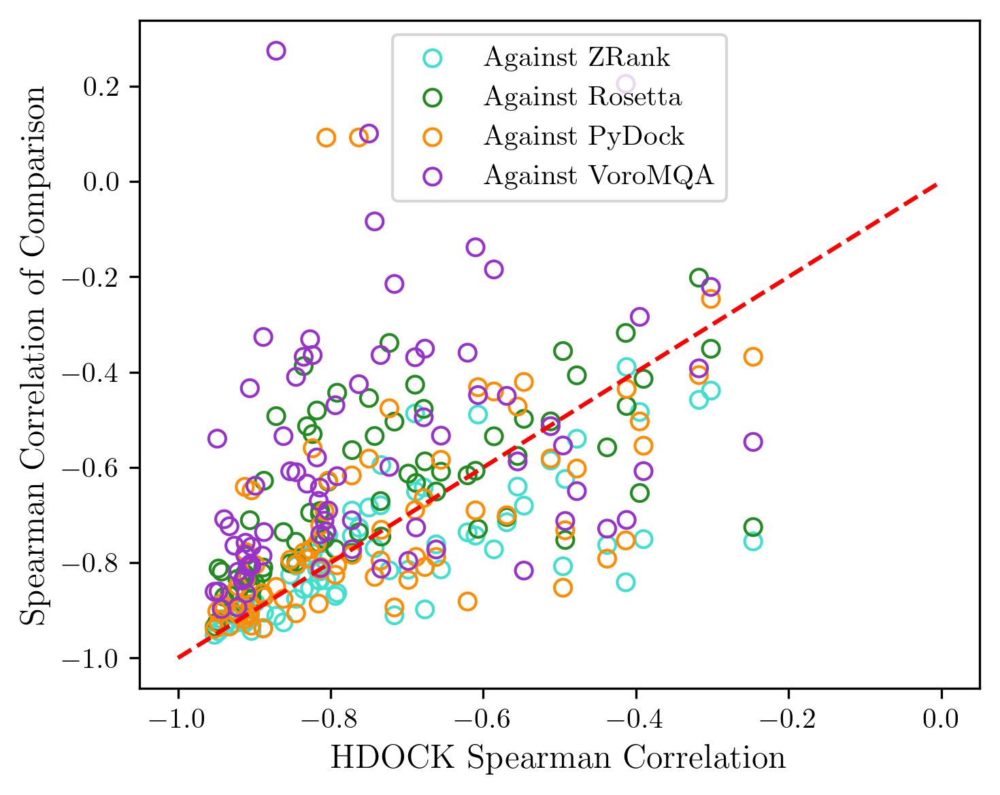

In [91]:
## Comparing VoroMQA to other scores to see if it agrees well relative to others?

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid"]

ax.scatter(np.array(ss_corr_df["spearman_dockq_hdock"]), ss_corr_df["spearman_dockq_zrank"], color = colors[1], marker = "o", facecolor = "None", label = "Against ZRank")
ax.scatter(np.array(ss_corr_df["spearman_dockq_hdock"]), ss_corr_df["spearman_dockq_rosetta"], color = colors[2], marker = "o", facecolor = "None", label = "Against Rosetta")
ax.scatter(np.array(ss_corr_df["spearman_dockq_hdock"]), ss_corr_df["spearman_dockq_pydock"], color = colors[3], marker = "o", facecolor = "None", label = "Against PyDock")
ax.scatter(np.array(ss_corr_df["spearman_dockq_hdock"]), ss_corr_df["spearman_dockq_voromqa"]*-1, color = colors[4], marker = "o", facecolor = "None", label = "Against VoroMQA")

ax.plot([-1,0], [-1, 0], "r--")

## getting the average residuals to the y = x line

p1 = np.array([1,1])
p2 = np.array([-1,-1])

avg_resid = []
avg_resid.append(np.mean(np.abs(np.cross(p2-p1, np.array(ss_corr_df[["spearman_dockq_hdock", "spearman_dockq_zrank"]]) - p1)/norm(p2-p1))))
avg_resid.append(np.mean(np.abs(np.cross(p2-p1, np.array(ss_corr_df[["spearman_dockq_hdock", "spearman_dockq_rosetta"]]) - p1)/norm(p2-p1))))
avg_resid.append(np.mean(np.abs(np.cross(p2-p1, np.array(ss_corr_df[["spearman_dockq_hdock", "spearman_dockq_pydock"]]) - p1)/norm(p2-p1))))

print(np.mean(avg_resid))

ax.set_xlabel("HDOCK Spearman Correlation", fontsize = 12)
ax.set_ylabel("Spearman Correlation of Comparison", fontsize = 12)

plt.legend()
plt.tight_layout()

0.10012464233427669


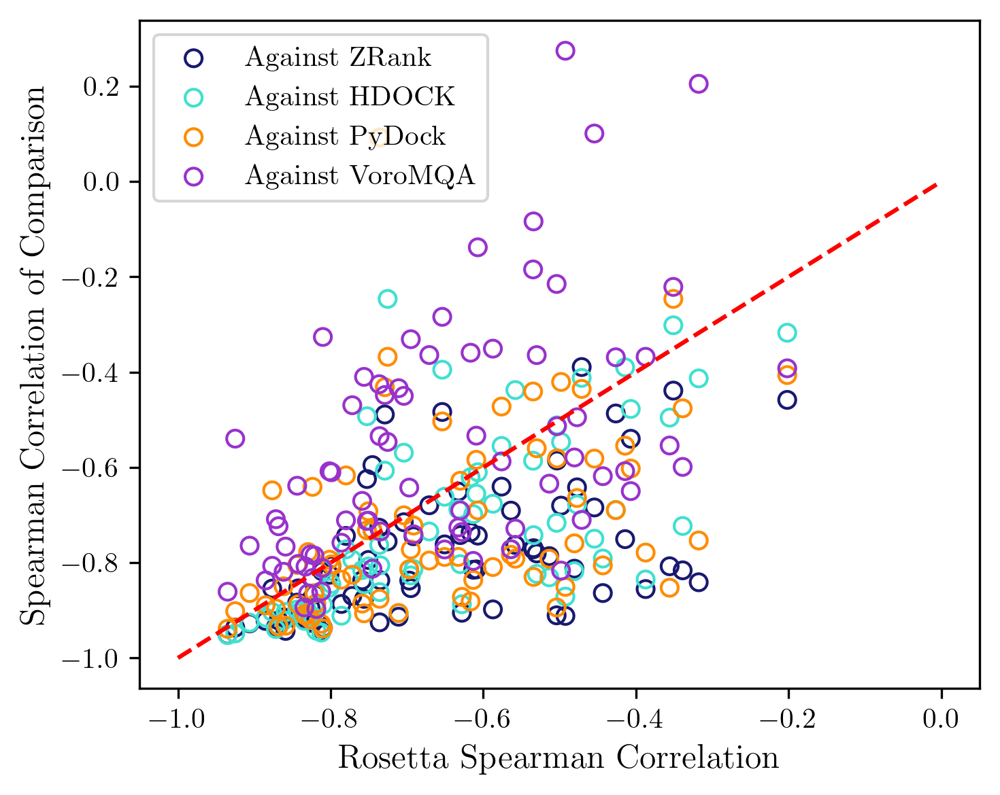

In [92]:
## Comparing VoroMQA to other scores to see if it agrees well relative to others?

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid"]

ax.scatter(np.array(ss_corr_df["spearman_dockq_rosetta"]), ss_corr_df["spearman_dockq_zrank"], color = colors[0], marker = "o", facecolor = "None", label = "Against ZRank")
ax.scatter(np.array(ss_corr_df["spearman_dockq_rosetta"]), ss_corr_df["spearman_dockq_hdock"], color = colors[1], marker = "o", facecolor = "None", label = "Against HDOCK")
ax.scatter(np.array(ss_corr_df["spearman_dockq_rosetta"]), ss_corr_df["spearman_dockq_pydock"], color = colors[3], marker = "o", facecolor = "None", label = "Against PyDock")
ax.scatter(np.array(ss_corr_df["spearman_dockq_rosetta"]), ss_corr_df["spearman_dockq_voromqa"]*-1, color = colors[4], marker = "o", facecolor = "None", label = "Against VoroMQA")

ax.plot([-1,0], [-1, 0], "r--")

## getting the average residuals to the y = x line

p1 = np.array([1,1])
p2 = np.array([-1,-1])

avg_resid = []
avg_resid.append(np.mean(np.abs(np.cross(p2-p1, np.array(ss_corr_df[["spearman_dockq_rosetta", "spearman_dockq_zrank"]]) - p1)/norm(p2-p1))))
avg_resid.append(np.mean(np.abs(np.cross(p2-p1, np.array(ss_corr_df[["spearman_dockq_rosetta", "spearman_dockq_hdock"]]) - p1)/norm(p2-p1))))
avg_resid.append(np.mean(np.abs(np.cross(p2-p1, np.array(ss_corr_df[["spearman_dockq_rosetta", "spearman_dockq_pydock"]]) - p1)/norm(p2-p1))))

print(np.mean(avg_resid))

ax.set_xlabel("Rosetta Spearman Correlation", fontsize = 12)
ax.set_ylabel("Spearman Correlation of Comparison", fontsize = 12)

plt.legend()
plt.tight_layout()

0.08821980872934422


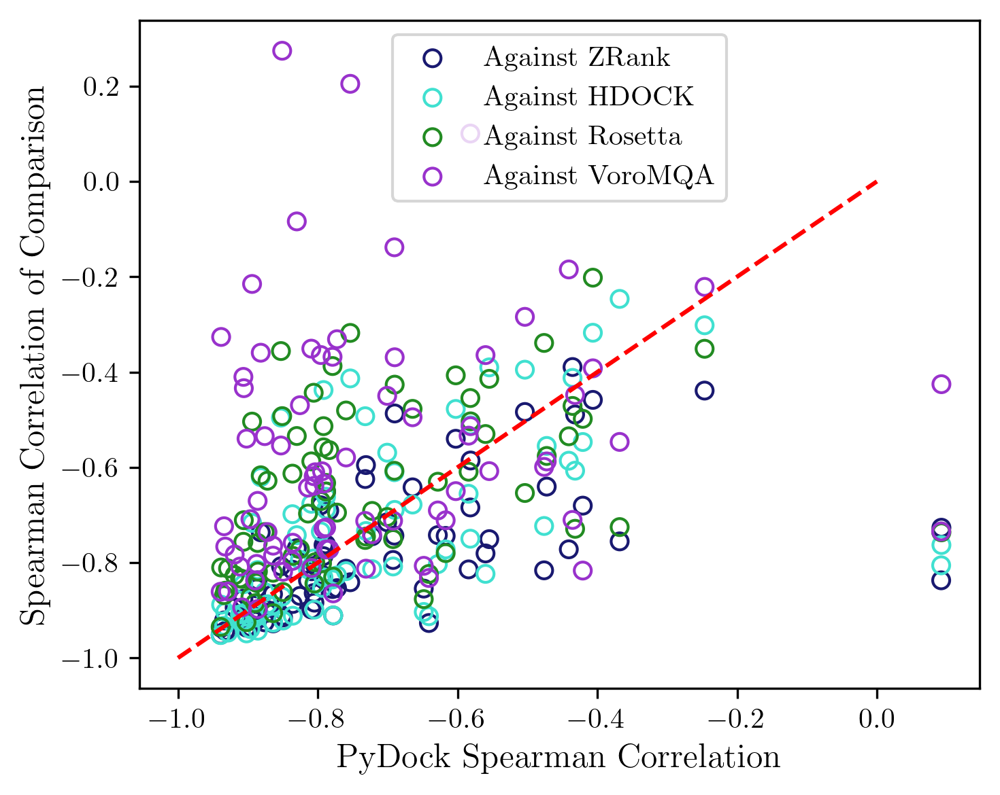

In [93]:
## Comparing VoroMQA to other scores to see if it agrees well relative to others?

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid"]

ax.scatter(np.array(ss_corr_df["spearman_dockq_pydock"]), ss_corr_df["spearman_dockq_zrank"], color = colors[0], marker = "o", facecolor = "None", label = "Against ZRank")
ax.scatter(np.array(ss_corr_df["spearman_dockq_pydock"]), ss_corr_df["spearman_dockq_hdock"], color = colors[1], marker = "o", facecolor = "None", label = "Against HDOCK")
ax.scatter(np.array(ss_corr_df["spearman_dockq_pydock"]), ss_corr_df["spearman_dockq_rosetta"], color = colors[2], marker = "o", facecolor = "None", label = "Against Rosetta")
ax.scatter(np.array(ss_corr_df["spearman_dockq_pydock"]), ss_corr_df["spearman_dockq_voromqa"]*-1, color = colors[4], marker = "o", facecolor = "None", label = "Against VoroMQA")

ax.plot([-1,0], [-1, 0], "r--")

## getting the average residuals to the y = x line

p1 = np.array([1,1])
p2 = np.array([-1,-1])

avg_resid = []
avg_resid.append(np.mean(np.abs(np.cross(p2-p1, np.array(ss_corr_df[["spearman_dockq_pydock", "spearman_dockq_zrank"]]) - p1)/norm(p2-p1))))
avg_resid.append(np.mean(np.abs(np.cross(p2-p1, np.array(ss_corr_df[["spearman_dockq_pydock", "spearman_dockq_hdock"]]) - p1)/norm(p2-p1))))
avg_resid.append(np.mean(np.abs(np.cross(p2-p1, np.array(ss_corr_df[["spearman_dockq_pydock", "spearman_dockq_rosetta"]]) - p1)/norm(p2-p1))))

print(np.mean(avg_resid))

ax.set_xlabel("PyDock Spearman Correlation", fontsize = 12)
ax.set_ylabel("Spearman Correlation of Comparison", fontsize = 12)

plt.legend()
plt.tight_layout()

In [42]:
## Get all residuals in an array

def get_residual(col1, col2):
    p1 = np.array([1,1])
    p2 = np.array([-1,-1])
    mult = np.array([1,1])
    if col1 in "spearman_dockq_voromqa":
        mult[0] = -1
    if col2 in "spearman_dockq_voromqa":
        mult[1] = -1
    return np.mean(np.abs(np.cross(p2-p1, np.array(ss_corr_df[[col1, col2]]) * mult - p1)/norm(p2-p1)))

col_names = ["spearman_dockq_zrank", "spearman_dockq_hdock", 
             "spearman_dockq_rosetta", "spearman_dockq_pydock", 
             "spearman_dockq_voromqa"]

residual_array = np.zeros((5,5))

for i,col1 in enumerate(col_names):
    for j,col2 in enumerate(col_names):
        residual_array[i,j] = get_residual(col1, col2)
        
print(residual_array)

[[0.         0.05705843 0.10417943 0.07306423 0.17091186]
 [0.05705843 0.         0.08536298 0.08076368 0.16151108]
 [0.10417943 0.08536298 0.         0.11083151 0.12486646]
 [0.07306423 0.08076368 0.11083151 0.         0.16511448]
 [0.17091186 0.16151108 0.12486646 0.16511448 0.        ]]


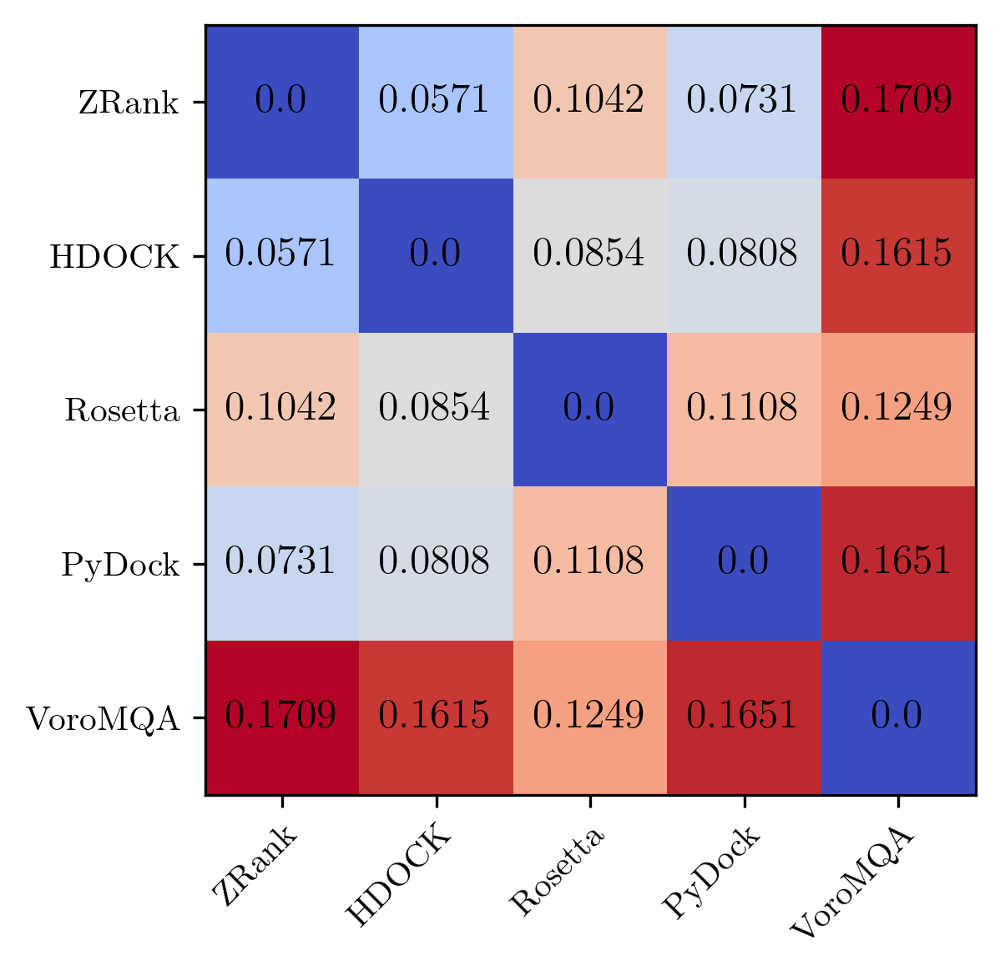

In [43]:
## Make a nicer figure with it all

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)
im = ax.imshow(residual_array, cmap = "coolwarm")

# Show all ticks and label them with the respective list entries

temp_names = ["ZRank", "HDOCK", "Rosetta", "PyDock", "VoroMQA"]
ax.set_xticks(np.arange(len(col_names)), labels=temp_names)
ax.set_yticks(np.arange(len(col_names)), labels=temp_names)

# Rotate the tick labels and set their alignment.
plt.setp(ax.get_xticklabels(), rotation=45, ha="right",
         rotation_mode="anchor")

# Loop over data dimensions and create text annotations.
for i in range(len(temp_names)):
    for j in range(len(temp_names)):
        text = ax.text(j, i, round(residual_array[i, j], 4),
                       ha="center", va="center", color="k", size = 12)

fig.tight_layout()
plt.show()

In [44]:
print(ss_plot_std)

[0.1365758837247185, 0.17940086106147884, 0.17056344911497318, 0.20861956843810608, 0.2508768392940198, 0.35613243218056095]


## All together for the figure

0.15560097096824865


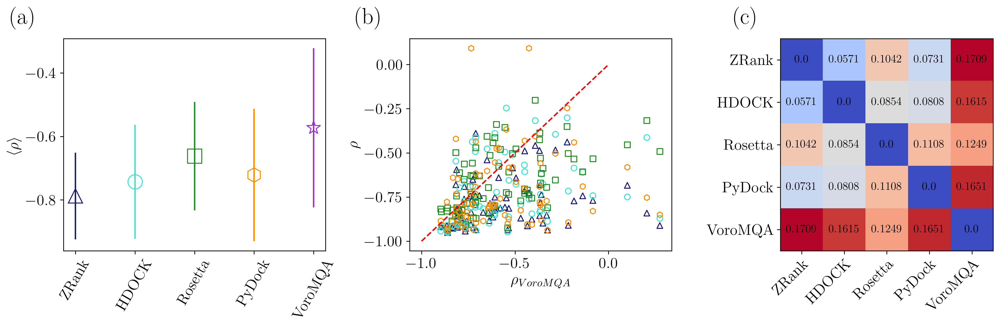

In [45]:
## Comparing VoroMQA to other scores to see if it agrees well relative to others?

font_size = 16

fig, ax = plt.subplots(1, 3, figsize = (15,5), dpi = 300)

markers = ["^", "o", "s", "h", "*", "p"]

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid"]

## Subpanel A

x_axis = range(5)

relaxed_plot_data = [np.mean(relaxed_corr_df["spearman_dockq_zrank"]), np.mean(relaxed_corr_df["spearman_dockq_hdock"]),
                    np.mean(relaxed_corr_df["spearman_dockq_rosetta"]), np.mean(relaxed_corr_df["spearman_dockq_pydock"]),
                    np.mean(relaxed_corr_df["spearman_dockq_voromqa"]*-1)]

ss_plot_data = [np.mean(ss_corr_df["spearman_dockq_zrank"]), np.mean(ss_corr_df["spearman_dockq_hdock"]),
                    np.mean(ss_corr_df["spearman_dockq_rosetta"]), np.mean(ss_corr_df["spearman_dockq_pydock"]),
                    np.mean(ss_corr_df["spearman_dockq_voromqa"]*-1), np.mean(ss_corr_df["spearman_dockq_dove"])]

relaxed_plot_std = [np.std(relaxed_corr_df["spearman_dockq_zrank"]), np.std(relaxed_corr_df["spearman_dockq_hdock"]),
                    np.std(relaxed_corr_df["spearman_dockq_rosetta"]), np.std(relaxed_corr_df["spearman_dockq_pydock"]),
                    np.std(relaxed_corr_df["spearman_dockq_voromqa"]*-1)]

ss_plot_std = [np.std(ss_corr_df["spearman_dockq_zrank"]), np.std(ss_corr_df["spearman_dockq_hdock"]),
                    np.std(ss_corr_df["spearman_dockq_rosetta"]), np.std(ss_corr_df["spearman_dockq_pydock"]),
                    np.std(ss_corr_df["spearman_dockq_voromqa"]*-1), np.std(ss_corr_df["spearman_dockq_dove"])]

ax[0].errorbar(x_axis[0], ss_plot_data[0], yerr = ss_plot_std[0], color = colors[0], marker = markers[0], markerfacecolor = "None", markersize = 15)
ax[0].errorbar(x_axis[1], ss_plot_data[1], yerr = ss_plot_std[1], color = colors[1], marker = markers[1], markerfacecolor = "None", markersize = 15)
ax[0].errorbar(x_axis[2], ss_plot_data[2], yerr = ss_plot_std[2], color = colors[2], marker = markers[2], markerfacecolor = "None", markersize = 15)
ax[0].errorbar(x_axis[3], ss_plot_data[3], yerr = ss_plot_std[3], color = colors[3], marker = markers[3], markerfacecolor = "None", markersize = 15)
ax[0].errorbar(x_axis[4], ss_plot_data[4], yerr = ss_plot_std[4], color = colors[4], marker = markers[4], markerfacecolor = "None", markersize = 15)

score_list = ["ZRank", "HDOCK", "Rosetta", "PyDock", "VoroMQA"]
ax[0].set_xticks(x_axis, score_list, fontsize = font_size, rotation = 60)

ax[0].set_ylabel(r"$\langle \rho \rangle$", fontsize = font_size)

## Subpanel B

ax[1].scatter(np.array(ss_corr_df["spearman_dockq_voromqa"])*-1, ss_corr_df["spearman_dockq_zrank"], color = colors[0], marker = "^", facecolor = "None", label = "Against ZRank")
ax[1].scatter(np.array(ss_corr_df["spearman_dockq_voromqa"])*-1, ss_corr_df["spearman_dockq_hdock"], color = colors[1], marker = "o", facecolor = "None", label = "Against HDOCK")
ax[1].scatter(np.array(ss_corr_df["spearman_dockq_voromqa"])*-1, ss_corr_df["spearman_dockq_rosetta"], color = colors[2], marker = "s", facecolor = "None", label = "Against Rosetta")
ax[1].scatter(np.array(ss_corr_df["spearman_dockq_voromqa"])*-1, ss_corr_df["spearman_dockq_pydock"], color = colors[3], marker = "h", facecolor = "None", label = "Against PyDock")

ax[1].plot([-1,0], [-1, 0], "r--")

## getting the average residuals to the y = x line

p1 = np.array([1,1])
p2 = np.array([-1,-1])

avg_resid = []
avg_resid.append(np.mean(np.abs(np.cross(p2-p1, np.array(ss_corr_df[["spearman_dockq_voromqa", "spearman_dockq_zrank"]]) * np.array([-1,1]) - p1)/norm(p2-p1))))
avg_resid.append(np.mean(np.abs(np.cross(p2-p1, np.array(ss_corr_df[["spearman_dockq_voromqa", "spearman_dockq_hdock"]]) * np.array([-1,1]) - p1)/norm(p2-p1))))
avg_resid.append(np.mean(np.abs(np.cross(p2-p1, np.array(ss_corr_df[["spearman_dockq_voromqa", "spearman_dockq_rosetta"]]) * np.array([-1,1]) - p1)/norm(p2-p1))))
avg_resid.append(np.mean(np.abs(np.cross(p2-p1, np.array(ss_corr_df[["spearman_dockq_voromqa", "spearman_dockq_pydock"]]) * np.array([-1,1]) - p1)/norm(p2-p1))))

print(np.mean(avg_resid))

ax[1].set_xlabel(r"$\rho_{VoroMQA}$", fontsize = font_size)
ax[1].set_ylabel(r"$\rho$", fontsize = font_size)

## Subpanel C

im = ax[2].imshow(residual_array, cmap = "coolwarm")

# Show all ticks and label them with the respective list entries

temp_names = ["ZRank", "HDOCK", "Rosetta", "PyDock", "VoroMQA"]
ax[2].set_xticks(np.arange(len(col_names)), labels=temp_names)
ax[2].set_yticks(np.arange(len(col_names)), labels=temp_names)

# Rotate the tick labels and set their alignment.
plt.setp(ax[2].get_xticklabels(), rotation=45, ha="right",
         rotation_mode="anchor")

# Loop over data dimensions and create text annotations.
for i in range(len(temp_names)):
    for j in range(len(temp_names)):
        text = ax[2].text(j, i, round(residual_array[i, j], 4),
                       ha="center", va="center", color="k", size = 12)

ax[0].text(-0.1, 1.15, "(a)", transform=ax[0].transAxes,fontsize=font_size*1.5, fontweight='bold', va='top', ha='right')
ax[1].text(-0.1, 1.15, "(b)", transform=ax[1].transAxes,fontsize=font_size*1.5, fontweight='bold', va='top', ha='right')
ax[2].text(-0.1, 1.15, "(c)", transform=ax[2].transAxes,fontsize=font_size*1.5, fontweight='bold', va='top', ha='right')
ax[0].tick_params(axis='both', which='major', labelsize=font_size)
ax[1].tick_params(axis='both', which='major', labelsize=font_size)
ax[2].tick_params(axis='both', which='major', labelsize=font_size)
        
plt.tight_layout()


## Supplement for Figure 2: Improvemet for ROC Plots (if any)

/var/folders/kr/4__h_fpn42334nd1tdtl4w8w0000gn/T/ipykernel_22963/3778460129.py:105: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if bins == []:


<function matplotlib.pyplot.tight_layout(*, pad=1.08, h_pad=None, w_pad=None, rect=None)>

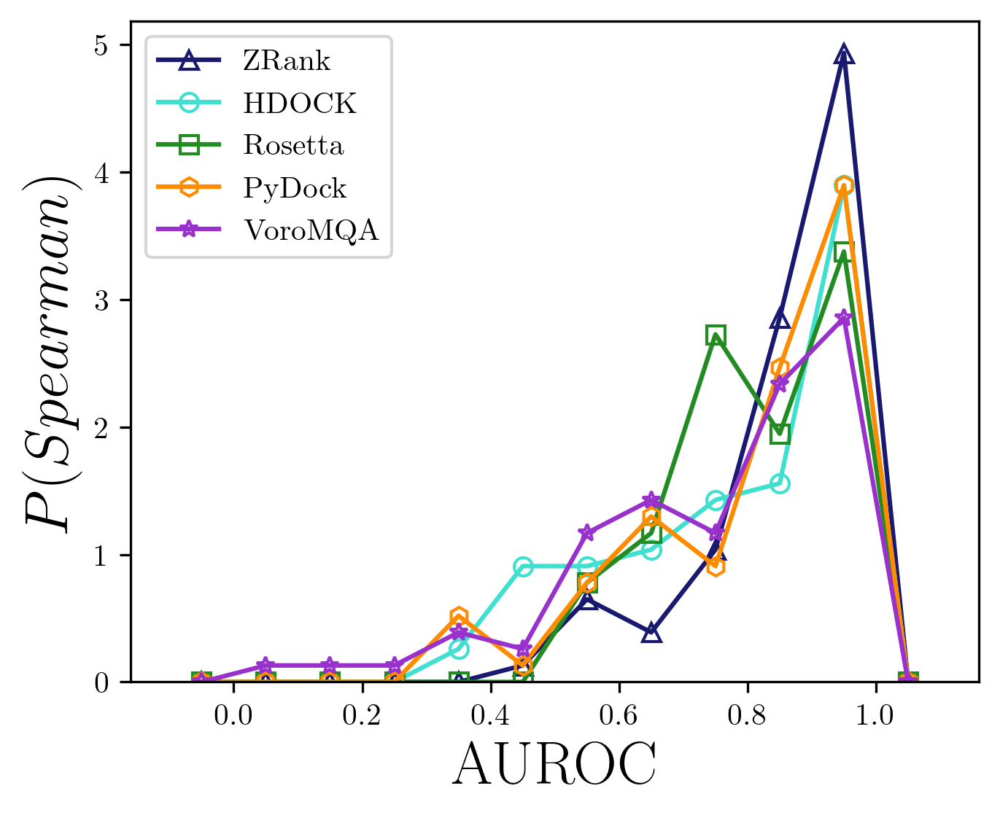

In [38]:
## Tenative Figure 2 - A - Spearman Correlation for non-supersampled data

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid", "indianred"]

nbins = 13
bins = np.linspace(-.1, 1.1, nbins)
x = create_prob_dist_identical_bins(np.array(fraction_relaxed_corr_df["zrank_auc"]), fig, ax, bins = bins, color = colors[0], marker = "^", label = "ZRank")
x = create_prob_dist_identical_bins(np.array(fraction_relaxed_corr_df["hdock_auc"]), fig, ax, bins = bins, color = colors[1], marker = "o", label = "HDOCK")
x = create_prob_dist_identical_bins(np.array(fraction_relaxed_corr_df["rosetta_auc"]), fig, ax, bins = bins, color = colors[2], marker = "s", label = "Rosetta")
x = create_prob_dist_identical_bins(np.array(fraction_relaxed_corr_df["pydock_auc"]), fig, ax, bins = bins, color = colors[3], marker = "h", label = "PyDock")
x = create_prob_dist_identical_bins(np.array(fraction_relaxed_corr_df["voromqa_auc"]), fig, ax, bins = bins, color = colors[4], marker = "*", label = "VoroMQA")

ax.set_xlabel("AUROC", fontsize = 20)
ax.set_ylabel("$P(Spearman)$", fontsize = 20)

plt.legend()
plt.tight_layout

/var/folders/kr/4__h_fpn42334nd1tdtl4w8w0000gn/T/ipykernel_22963/3778460129.py:105: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if bins == []:


<function matplotlib.pyplot.tight_layout(*, pad=1.08, h_pad=None, w_pad=None, rect=None)>

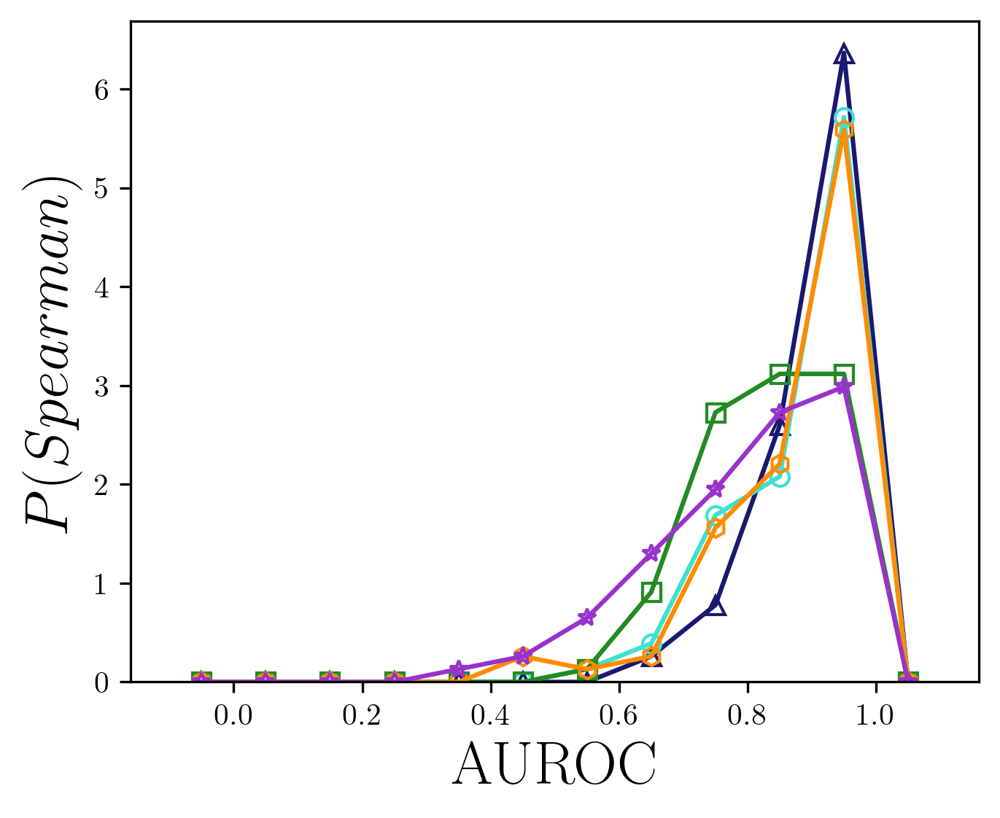

In [45]:
## Tenative Figure 2 - A - Spearman Correlation for non-supersampled data

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid", "indianred"]

nbins = 13
bins = np.linspace(-.1, 1.1, nbins)
x = create_prob_dist_identical_bins(np.array(ss_corr_df["zrank_auc"]), fig, ax, bins = bins, color = colors[0], marker = "^", label = "ZRank")
x = create_prob_dist_identical_bins(np.array(ss_corr_df["hdock_auc"]), fig, ax, bins = bins, color = colors[1], marker = "o", label = "HDOCK")
x = create_prob_dist_identical_bins(np.array(ss_corr_df["rosetta_auc"]), fig, ax, bins = bins, color = colors[2], marker = "s", label = "Rosetta")
x = create_prob_dist_identical_bins(np.array(ss_corr_df["pydock_auc"]), fig, ax, bins = bins, color = colors[3], marker = "h", label = "PyDock")
x = create_prob_dist_identical_bins(np.array(ss_corr_df["voromqa_auc"]), fig, ax, bins = bins, color = colors[4], marker = "*", label = "VoroMQA")

ax.set_xlabel("AUROC", fontsize = 20)
ax.set_ylabel("$P(Spearman)$", fontsize = 20)

# plt.legend()
plt.tight_layout

0.04361790758742777
0.09440812478893305
0.02635815815675382
0.08313929214584803
0.049209404078876105


/var/folders/kr/4__h_fpn42334nd1tdtl4w8w0000gn/T/ipykernel_22963/3778460129.py:105: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if bins == []:


<function matplotlib.pyplot.tight_layout(*, pad=1.08, h_pad=None, w_pad=None, rect=None)>

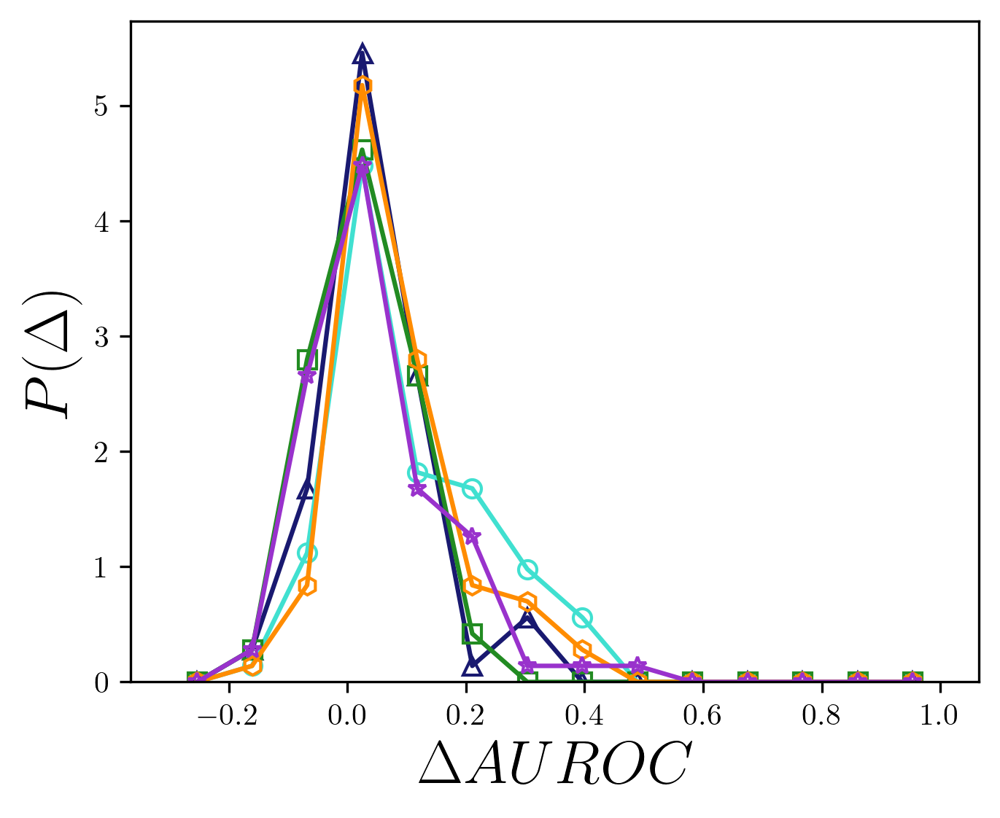

In [60]:
## Tenative Figure 2 - C - Delta improvement in spearman for each score - prob distribution

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid"]

nbins = 15
bins = np.linspace(-.3, 1, nbins)
x = create_prob_dist_identical_bins(np.array(ss_corr_df["zrank_auc"]) - np.array(fraction_relaxed_corr_df["zrank_auc"]), fig, ax, bins = bins, color = colors[0], marker = "^", label = "ZRank")
x = create_prob_dist_identical_bins(np.array(ss_corr_df["hdock_auc"]) - np.array(fraction_relaxed_corr_df["hdock_auc"]), fig, ax, bins = bins, color = colors[1], marker = "o", label = "HDOCK")
x = create_prob_dist_identical_bins(np.array(ss_corr_df["rosetta_auc"]) - np.array(fraction_relaxed_corr_df["rosetta_auc"]), fig, ax, bins = bins, color = colors[2], marker = "s", label = "Rosetta")
x = create_prob_dist_identical_bins(np.array(ss_corr_df["pydock_auc"]) - np.array(fraction_relaxed_corr_df["pydock_auc"]), fig, ax, bins = bins, color = colors[3], marker = "h", label = "PyDock")
x = create_prob_dist_identical_bins(np.array(ss_corr_df["voromqa_auc"]) - np.array(fraction_relaxed_corr_df["voromqa_auc"]), fig, ax, bins = bins, color = colors[4], marker = "*", label = "VoroMQA")


print(np.mean(np.array(ss_corr_df["zrank_auc"]) - np.array(fraction_relaxed_corr_df["zrank_auc"])))
print(np.mean(np.array(ss_corr_df["hdock_auc"]) - np.array(fraction_relaxed_corr_df["hdock_auc"])))
print(np.mean(np.array(ss_corr_df["rosetta_auc"]) - np.array(fraction_relaxed_corr_df["rosetta_auc"])))
print(np.mean(np.array(ss_corr_df["pydock_auc"]) - np.array(fraction_relaxed_corr_df["pydock_auc"])))
print(np.mean(np.array(ss_corr_df["voromqa_auc"]) - np.array(fraction_relaxed_corr_df["voromqa_auc"])))


ax.set_xlabel("$\Delta AUROC$", fontsize = 20)
ax.set_ylabel("$P(\Delta)$", fontsize = 20)

# plt.legend()
plt.tight_layout

## Creating the scatterplot of ∆Spearman and ∆AUROC from supersampling

In [ ]:
x = create_prob_dist_identical_bins(np.array(ss_corr_df["spearman_dockq_zrank"]) - np.array(fraction_relaxed_corr_df["spearman_dockq_zrank"]), fig, ax, bins = bins, color = colors[0], marker = "^", label = "ZRank")
x = create_prob_dist_identical_bins(np.array(ss_corr_df["spearman_dockq_hdock"]) - np.array(fraction_relaxed_corr_df["spearman_dockq_hdock"]), fig, ax, bins = bins, color = colors[1], marker = "o", label = "HDOCK")
x = create_prob_dist_identical_bins(np.array(ss_corr_df["spearman_dockq_rosetta"]) - np.array(fraction_relaxed_corr_df["spearman_dockq_rosetta"]), fig, ax, bins = bins, color = colors[2], marker = "s", label = "Rosetta")
x = create_prob_dist_identical_bins(np.array(ss_corr_df["spearman_dockq_pydock"]) - np.array(fraction_relaxed_corr_df["spearman_dockq_pydock"]), fig, ax, bins = bins, color = colors[3], marker = "h", label = "PyDock")
x = create_prob_dist_identical_bins(np.array(ss_corr_df["spearman_dockq_voromqa"])*-1 - np.array(fraction_relaxed_corr_df["spearman_dockq_voromqa"])*-1, fig, ax, bins = bins, color = colors[4], marker = "*", label = "VoroMQA")


SpearmanrResult(correlation=-0.5590361445783133, pvalue=3.259642526806373e-08)


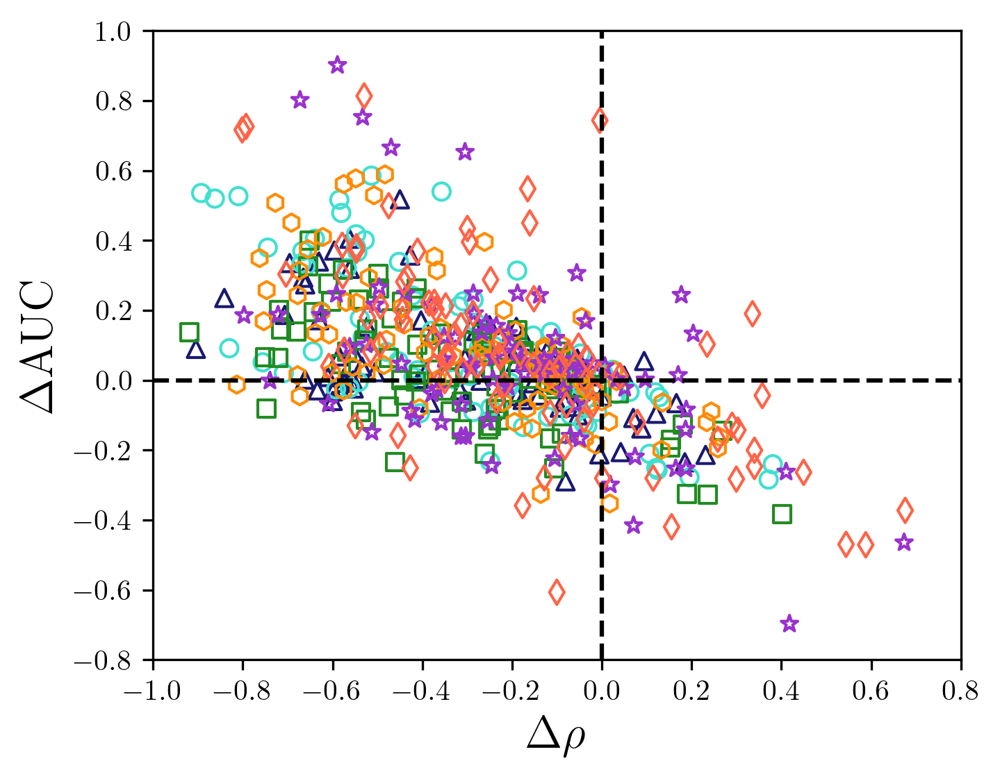

In [877]:
## Tenative Figure 2 - C - Delta improvement in spearman for each score - prob distribution

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid", "tomato"]

zrank_spearman_delta = np.abs(np.array(ss_corr_df["spearman_dockq_zrank"]))*-1 - np.abs(np.array(relaxed_corr_df["spearman_dockq_zrank"]))*-1
zrank_auc_delta = np.array(ss_corr_df["zrank_auc"]) - np.array(relaxed_corr_df["zrank_auc"])

hdock_spearman_delta = np.abs(np.array(ss_corr_df["spearman_dockq_hdock"]))*-1 - np.abs(np.array(relaxed_corr_df["spearman_dockq_hdock"]))*-1
hdock_auc_delta = np.array(ss_corr_df["hdock_auc"]) - np.array(relaxed_corr_df["hdock_auc"])

rosetta_spearman_delta = np.abs(np.array(ss_corr_df["spearman_dockq_rosetta"]))*-1 - np.abs(np.array(relaxed_corr_df["spearman_dockq_rosetta"]))*-1
rosetta_auc_delta = np.array(ss_corr_df["rosetta_auc"]) - np.array(relaxed_corr_df["rosetta_auc"])

pydock_spearman_delta = np.abs(np.array(ss_corr_df["spearman_dockq_pydock"]))*-1 - np.abs(np.array(relaxed_corr_df["spearman_dockq_pydock"]))*-1
pydock_auc_delta = np.array(ss_corr_df["pydock_auc"]) - np.array(relaxed_corr_df["pydock_auc"])

voromqa_spearman_delta = np.abs(np.array(ss_corr_df["spearman_dockq_voromqa"])) *-1 - np.abs(np.array(relaxed_corr_df["spearman_dockq_voromqa"])) *-1
voromqa_auc_delta = np.array(ss_corr_df["voromqa_auc"]) - np.array(relaxed_corr_df["voromqa_auc"])

deeprank_spearman_delta = np.abs(np.array(ss_corr_df["spearman_dockq_deeprank_gnn_esm"])) *-1 - np.abs(np.array(relaxed_corr_df["spearman_dockq_deeprank_gnn_esm"])) *-1
deeprank_auc_delta = np.array(ss_corr_df["deeprank_gnn_esm_auc"]) - np.array(relaxed_corr_df["deeprank_gnn_esm_auc"])

ax.scatter(zrank_spearman_delta,
           zrank_auc_delta,
           color = colors[0], marker = "^", label = "ZRank", facecolor = "None")
ax.scatter(hdock_spearman_delta,
           hdock_auc_delta,
           color = colors[1], marker = "o", label = "HDOCK", facecolor = "None")
ax.scatter(rosetta_spearman_delta,
           rosetta_auc_delta,
           color = colors[2], marker = "s", label = "Rosetta", facecolor = "None")
ax.scatter(pydock_spearman_delta,
           pydock_auc_delta,
           color = colors[3], marker = "h", label = "PyDock", facecolor = "None")
ax.scatter(voromqa_spearman_delta,
           voromqa_auc_delta,
           color = colors[4], marker = "*", label = "VoroMQA", facecolor = "None")
ax.scatter(deeprank_spearman_delta,
           deeprank_auc_delta,
           color = colors[5], marker = "d", label = "Deeprank-GNN", facecolor = "None")

ax.set_ylabel("$\Delta$AUC", fontsize = 16)
ax.set_xlabel(r"$\Delta\rho$", fontsize = 16)

## Create vertical and horizontal dotted lines

x_vert = [0,0]
y_vert = [-0.8, 1.0]
ax.plot(x_vert, y_vert, color = "black", linestyle = "--")

x_horiz = [-1, 0.8]
y_horiz = [0,0]
ax.plot(x_horiz, y_horiz, color = "black", linestyle = "--")

ax.set_xlim([-1, 0.8])
ax.set_ylim([-0.8, 1.0])

zrank_spearman = spearmanr(np.array(ss_corr_df["spearman_dockq_zrank"]) - np.array(relaxed_corr_df["spearman_dockq_zrank"]),
         np.array(ss_corr_df["zrank_auc"]) - np.array(relaxed_corr_df["zrank_auc"]))
print(zrank_spearman)
# plt.legend()
plt.tight_layout
plt.savefig(join(figure_save_dir, "delta_auc_vs_delta_spearman.png"))

# Figure 3 - Some variation of the pearson correlations

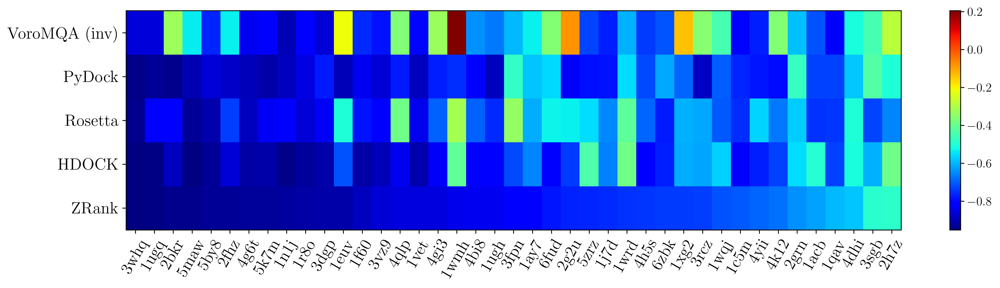

In [81]:
## Compare spearman of supersampled scores

# get the data

spearman_data = np.zeros((5,41))
score_ref = ["spearman_dockq_zrank", "spearman_dockq_hdock", "spearman_dockq_rosetta", "spearman_dockq_pydock", "spearman_dockq_voromqa"]

for i in range(5):
    for j in range(41):
        if i == 4:
            spearman_data[i][j] = ss_corr_df[score_ref[i]].iloc[j] * -1
        else:
            spearman_data[i][j] = ss_corr_df[score_ref[i]].iloc[j]

fig, ax = plt.subplots(figsize = (15,4), dpi = 300)

sorted_data = spearman_data[:, spearman_data[0, :].argsort()]

heatmap = ax.pcolor(sorted_data, cmap = "jet")

label_ticks = list(np.array(ss_corr_df["pdb"])[spearman_data[0, :].argsort()])
x = np.linspace(0.5, 40.5, 41)
plt.xticks(x, label_ticks)
plt.xticks(rotation = 60, fontsize = 16)

score_list = ["ZRank", "HDOCK", "Rosetta", "PyDock", "VoroMQA (inv)"]
y = np.linspace(0.5, 4.5, 5)
plt.yticks(y, score_list, fontsize = 16)
        
cbar = fig.colorbar(heatmap)
cbar.ax.tick_params(labelsize=12)

fig.tight_layout()

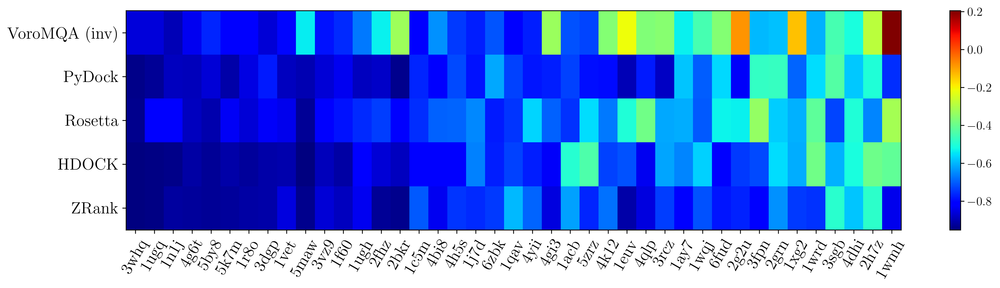

In [88]:
## Creating Figure 3 but with symbols for each instead

spearman_data = np.zeros((5,41))
score_ref = ["spearman_dockq_zrank", "spearman_dockq_hdock", "spearman_dockq_rosetta", "spearman_dockq_pydock", "spearman_dockq_voromqa"]

for i in range(5):
    for j in range(41):
        if i == 4:
            spearman_data[i][j] = ss_corr_df[score_ref[i]].iloc[j] * -1
        else:
            spearman_data[i][j] = ss_corr_df[score_ref[i]].iloc[j]

fig, ax = plt.subplots(figsize = (15,4), dpi = 300)

mean_data = np.mean(spearman_data, axis = 0)

sorted_data = spearman_data[:, mean_data.argsort()]

heatmap = ax.pcolor(sorted_data, cmap = "jet")

label_ticks = list(np.array(ss_corr_df["pdb"])[mean_data.argsort()])
x = np.linspace(0.5, 40.5, 41)
plt.xticks(x, label_ticks)
plt.xticks(rotation = 60, fontsize = 16)

score_list = ["ZRank", "HDOCK", "Rosetta", "PyDock", "VoroMQA (inv)"]
y = np.linspace(0.5, 4.5, 5)
plt.yticks(y, score_list, fontsize = 16)
        
cbar = fig.colorbar(heatmap)
cbar.ax.tick_params(labelsize=12)

fig.tight_layout()
      
      

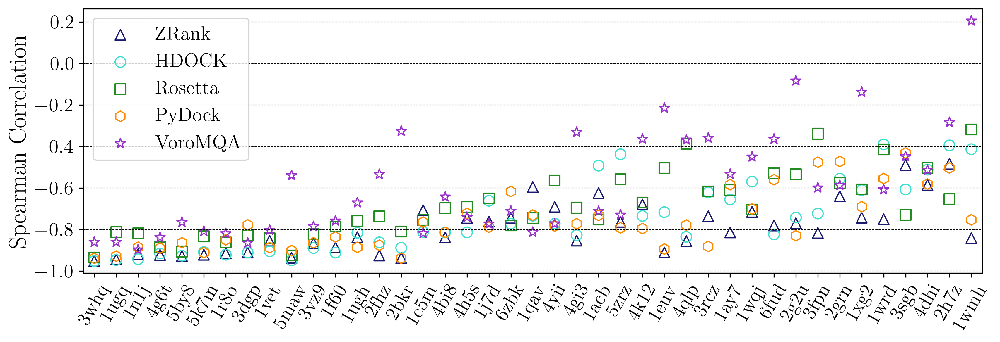

In [36]:
## Creating Figure 3 but with symbols for each instead

spearman_data = np.zeros((5,41))
score_ref = ["spearman_dockq_zrank", "spearman_dockq_hdock", "spearman_dockq_rosetta", "spearman_dockq_pydock", "spearman_dockq_voromqa"]

for i in range(5):
    for j in range(41):
        if i == 4:
            spearman_data[i][j] = ss_corr_df[score_ref[i]].iloc[j] * -1
        else:
            spearman_data[i][j] = ss_corr_df[score_ref[i]].iloc[j]

fig, ax = plt.subplots(figsize = (11.5,4), dpi = 300)

mean_data = np.mean(spearman_data, axis = 0)

sorted_data = spearman_data[:, mean_data.argsort()]




label_ticks = list(np.array(ss_corr_df["pdb"])[mean_data.argsort()])
x = np.linspace(0.5, 40.5, 41)
plt.xticks(x, label_ticks)
plt.xticks(rotation = 60, fontsize = 16)
plt.yticks(fontsize = 16)
plt.xlim(0, 41)

marker_size = 75

ax.scatter(x, sorted_data[0], color = colors[0], marker = "^", label = "ZRank", facecolor = "None", s = marker_size)
ax.scatter(x, sorted_data[1], color = colors[1], marker = "o", label = "HDOCK", facecolor = "None", s = marker_size)
ax.scatter(x, sorted_data[2], color = colors[2], marker = "s", label = "Rosetta", facecolor = "None", s = marker_size)
ax.scatter(x, sorted_data[3], color = colors[3], marker = "h", label = "PyDock", facecolor = "None", s = marker_size)
ax.scatter(x, sorted_data[4], color = colors[4], marker = "*", label = "VoroMQA", facecolor = "None", s = marker_size)

# score_list = ["ZRank", "HDOCK", "Rosetta", "PyDock", "VoroMQA (inv)"]
# y = np.linspace(0.5, 4.5, 5)
# plt.yticks(y, score_list, fontsize = 16)

ax.set_ylabel("Spearman Correlation", fontsize = 20)

fig.tight_layout()
plt.legend(fontsize = 16)
plt.grid(axis = "y", color = 'black', linestyle = '--', linewidth = 0.5)
      

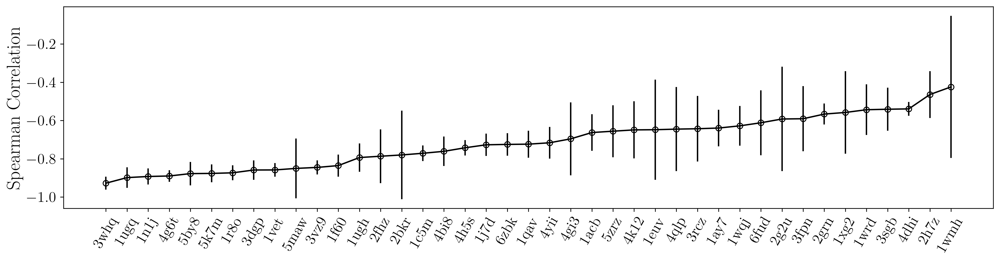

In [117]:
## Creating Figure 3 but with symbols for each instead

spearman_data = np.zeros((5,41))
score_ref = ["spearman_dockq_zrank", "spearman_dockq_hdock", "spearman_dockq_rosetta", "spearman_dockq_pydock", "spearman_dockq_voromqa"]

for i in range(5):
    for j in range(41):
        if i == 4:
            spearman_data[i][j] = ss_corr_df[score_ref[i]].iloc[j] * -1
        else:
            spearman_data[i][j] = ss_corr_df[score_ref[i]].iloc[j]

fig, ax = plt.subplots(figsize = (15,4), dpi = 300)

mean_data = np.mean(spearman_data, axis = 0)

stdev_data = np.std(spearman_data, axis = 0)

sorted_data = spearman_data[:, mean_data.argsort()]

sorted_mean_data = mean_data[mean_data.argsort()]

sorted_stdev_data = stdev_data[mean_data.argsort()]


label_ticks = list(np.array(ss_corr_df["pdb"])[mean_data.argsort()])
x = np.linspace(0.5, 40.5, 41)
plt.xticks(x, label_ticks)
plt.xticks(rotation = 60, fontsize = 16)
plt.yticks(fontsize = 16)

marker_size = 75

plt.errorbar(x, sorted_mean_data, yerr = sorted_stdev_data, color = "black", marker = "o", markerfacecolor = "None")

ax.set_ylabel("Spearman Correlation", fontsize = 20)

fig.tight_layout()
      

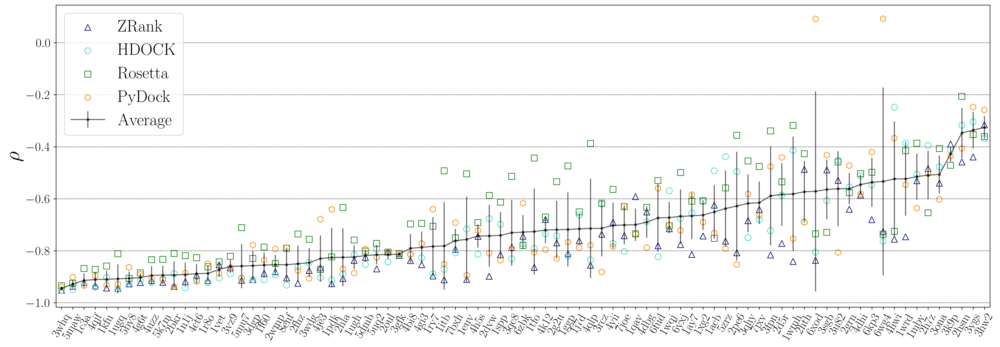

In [403]:
## Creating Figure 3 but with symbols for each instead

num_samples = len(ss_corr_df)

spearman_data = np.zeros((4,num_samples))
# score_ref = ["spearman_dockq_zrank", "spearman_dockq_hdock", "spearman_dockq_rosetta", "spearman_dockq_pydock", "spearman_dockq_voromqa"]
score_ref = ["spearman_dockq_zrank", "spearman_dockq_hdock", "spearman_dockq_rosetta", "spearman_dockq_pydock"]

for i in range(len(score_ref)):
    for j in range(num_samples):
        if i == 4:
            spearman_data[i][j] = ss_corr_df[score_ref[i]].iloc[j] * -1
        else:
            spearman_data[i][j] = ss_corr_df[score_ref[i]].iloc[j]

fig, ax = plt.subplots(figsize = (20,7), dpi = 300)

mean_data = np.mean(spearman_data, axis = 0)

stdev_data = np.std(spearman_data, axis = 0)

sorted_data = spearman_data[:, mean_data.argsort()]

sorted_mean_data = mean_data[mean_data.argsort()]

sorted_stdev_data = stdev_data[mean_data.argsort()]


label_ticks = list(np.array(ss_corr_df["pdb"])[mean_data.argsort()])
x = np.linspace(0.5, num_samples-0.5, num_samples)
plt.xticks(x, label_ticks)
plt.xticks(rotation = 60, fontsize = 17)
plt.yticks(fontsize = 18)
plt.xlim(0, num_samples)

marker_size = 75

ax.scatter(x, sorted_data[0], color = colors[0], marker = "^", label = "ZRank", facecolor = "None", s = marker_size)
ax.scatter(x, sorted_data[1], color = colors[1], marker = "o", label = "HDOCK", facecolor = "None", s = marker_size)
ax.scatter(x, sorted_data[2], color = colors[2], marker = "s", label = "Rosetta", facecolor = "None", s = marker_size)
ax.scatter(x, sorted_data[3], color = colors[3], marker = "h", label = "PyDock", facecolor = "None", s = marker_size)
# ax.scatter(x, sorted_data[4], color = colors[4], marker = "*", label = "VoroMQA", facecolor = "None", s = marker_size)

plt.errorbar(x, sorted_mean_data, yerr = sorted_stdev_data, color = "black", marker = ".", label = "Average", alpha = 0.6)

ax.set_ylabel(r"$\rho$", fontsize = 30)

fig.tight_layout()
plt.legend(fontsize = 24)
plt.grid(axis = "y", color = 'black', linestyle = '--', linewidth = 0.5)
      

In [561]:
print(np.mean(ss_corr_df["spearman_dockq_zrank"]))
print(np.mean(ss_corr_df["spearman_dockq_hdock"]))
print(np.mean(ss_corr_df["spearman_dockq_rosetta"]))
print(np.mean(ss_corr_df["spearman_dockq_pydock"]))
print(np.mean(ss_corr_df["spearman_dockq_voromqa"])*-1)

-0.7867946302404539
-0.7436652300843051
-0.6634255775456988
-0.7220899367058261
-0.5762464929287539


# Final PER-TARGET Figure

['3whq', '1ugq', '1n1j', '1kfu', '4uzz', '1r8o', '5k7m', '5by8', '4g6t', '4qjf', '1c3a', '5maw', '4ct6', '1vet', '4je3', '3vz9', '2wmp', '8enf', '1pdk', '1f60', '5dmb', '1ry7', '5mu7', '3dgp', '2bkr', '2fhz', '5uq2', '3wdg', '7bxh', '4qlp', '4u1c', '1ugh', '2oul', '2hla', '2g2u', '3gfk', '1spp', '6zbk', '4yii', '4bi8', '4dbg', '3qc8', '1ggp', '1acb', '6yxj', '5zrz', '7joe', '1euv', '4h5s', '1itb', '1tfo', '1j7d', '1wqj', '4gi3', '1qav', '2hth', '6fud', '7jxv', '3rcz', '4hwi', '6kp3', '3fpn', '3k9p', '2h7z', '6xod', '4dhi', '4k12', '3qhy', '1ay7', '6wg4', '2dvw', '1wrd', '3sgb', '2d5r', '2pe6', '3ona', '2grn', '1xg2', '3ygs', '3hw2', '2hsm', '1wmh', '3u82', '1mbv']


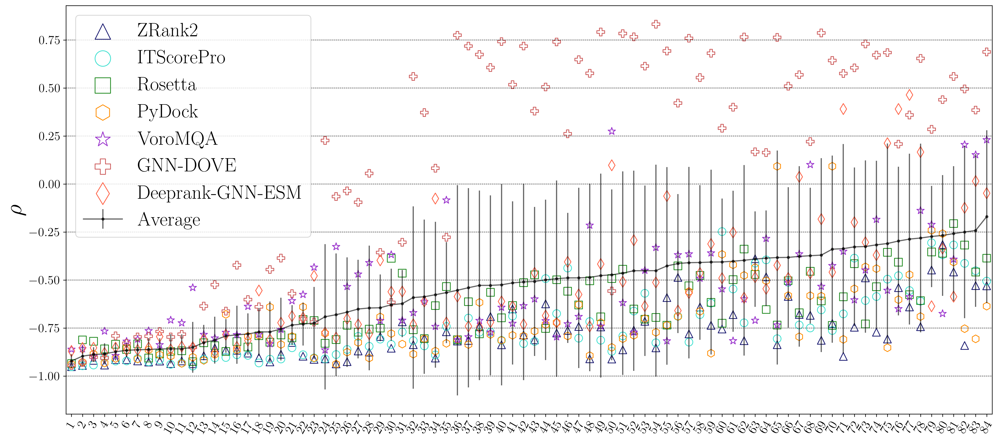

In [98]:
## Creating Figure 3 but with Deeprank-GNN data

num_samples = len(ss_corr_df)
colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid", "indianred", "tomato"]



score_ref = ["spearman_dockq_zrank", "spearman_dockq_hdock", "spearman_dockq_rosetta",
             "spearman_dockq_pydock", "spearman_dockq_voromqa", "spearman_dockq_dove_5",
             "spearman_dockq_deeprank_gnn_esm"]
spearman_data = np.zeros((len(score_ref),num_samples))

for i in range(len(score_ref)):
    for j in range(num_samples):
        if "deeprank" in score_ref[i] or "voromqa" in score_ref[i]:
            spearman_data[i][j] = ss_corr_df[score_ref[i]].iloc[j] * -1
        else:
            spearman_data[i][j] = ss_corr_df[score_ref[i]].iloc[j]

fig, ax = plt.subplots(figsize = (18,8), dpi = 300)

mean_data = np.mean(spearman_data, axis = 0)

stdev_data = np.std(spearman_data, axis = 0)

sorted_data = spearman_data[:, mean_data.argsort()]

sorted_mean_data = mean_data[mean_data.argsort()]

sorted_stdev_data = stdev_data[mean_data.argsort()]


pdb_order = list(np.array(ss_corr_df["pdb"])[mean_data.argsort()])
print(pdb_order)
label_ticks = list(range(1, len(ss_corr_df)+1))
x = np.linspace(0.5, num_samples-0.5, num_samples)
plt.xticks(x, label_ticks)
plt.xticks(rotation = 60, fontsize = 16)
plt.yticks(fontsize = 16)
plt.xlim(0, num_samples)

marker_size = 100

ax.scatter(x, sorted_data[0], color = colors[0], marker = "^", label = "ZRank2", facecolor = "None", s = marker_size)
ax.scatter(x, sorted_data[1], color = colors[1], marker = "o", label = "ITScorePro", facecolor = "None", s = marker_size)
ax.scatter(x, sorted_data[2], color = colors[2], marker = "s", label = "Rosetta", facecolor = "None", s = marker_size)
ax.scatter(x, sorted_data[3], color = colors[3], marker = "h", label = "PyDock", facecolor = "None", s = marker_size)
ax.scatter(x, sorted_data[4], color = colors[4], marker = "*", label = "VoroMQA", facecolor = "None", s = marker_size)
ax.scatter(x, sorted_data[5], color = colors[5], marker = "P", label = "GNN-DOVE", facecolor = "None", s = marker_size)
ax.scatter(x, sorted_data[6], color = colors[6], marker = "d", label = "Deeprank-GNN-ESM", facecolor = "None", s = marker_size)

plt.errorbar(x, sorted_mean_data, yerr = sorted_stdev_data, color = "black", marker = ".", label = "Average", alpha = 0.6)

ax.set_ylabel(r"$\rho$", fontsize = 30)

fig.tight_layout()
lgnd = plt.legend(fontsize = 25)
lgnd.legendHandles[0]._sizes = [400]
lgnd.legendHandles[1]._sizes = [400]
lgnd.legendHandles[2]._sizes = [400]
lgnd.legendHandles[3]._sizes = [400]
lgnd.legendHandles[4]._sizes = [400]
lgnd.legendHandles[5]._sizes = [400]
lgnd.legendHandles[6]._sizes = [400]
plt.grid(axis = "y", color = 'black', linestyle = '--', linewidth = 0.5)
plt.savefig(join(figure_save_dir, "per_target_spearman_all_scores.png"))

['3whq', '5maw', '1kfu', '4qjf', '1c3a', '1ugq', '5by8', '5k7m', '4uzz', '1n1j', '1r8o', '4g6t', '2bkr', '1vet', '4ct6', '3vz9', '2wmp', '3dgp', '3wdg', '1f60', '1pdk', '4je3', '2fhz', '1ugh', '5uq2', '8enf', '5dmb', '5mu7', '2oul', '3gfk', '1ry7', '4bi8', '1euv', '1spp', '4gi3', '6zbk', '3qc8', '2g2u', '4yii', '7bxh', '4qlp', '1tfo', '4dbg', '6yxj', '4h5s', '7joe', '2hla', '4u1c', '1ggp', '1wqj', '1acb', '6fud', '3rcz', '1j7d', '1itb', '5zrz', '2hth', '3fpn', '3qhy', '7jxv', '1qav', '1ay7', '4k12', '6xod', '2d5r', '4dhi', '6wg4', '4hwi', '2h7z', '2dvw', '3sgb', '1xg2', '1wmh', '6kp3', '2pe6', '1wrd', '3u82', '3k9p', '1mbv', '3ygs', '2hsm', '2grn', '3hw2', '3ona']


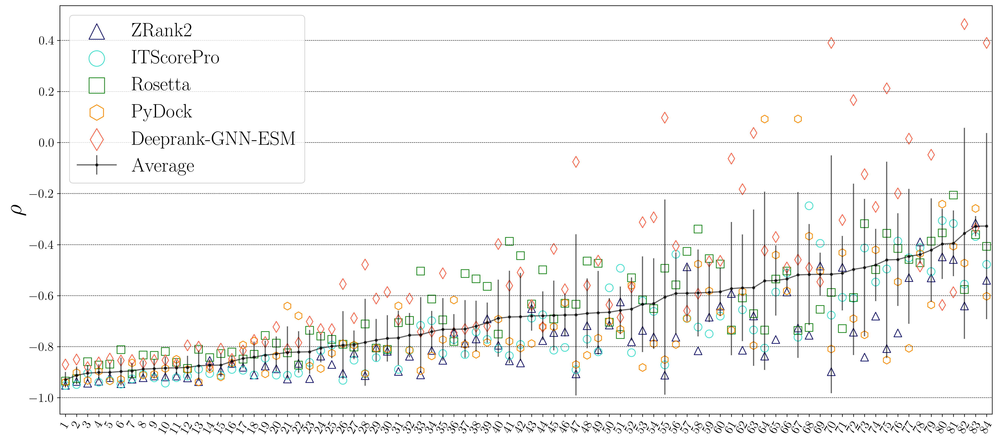

In [329]:
## Only scores that do well now

num_samples = len(ss_corr_df)
colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid", "indianred", "tomato"]



score_ref = ["spearman_dockq_zrank", "spearman_dockq_hdock", "spearman_dockq_rosetta",
             "spearman_dockq_pydock", "spearman_dockq_deeprank_gnn_esm"]
spearman_data = np.zeros((len(score_ref),num_samples))

for i in range(len(score_ref)):
    for j in range(num_samples):
        if "deeprank" in score_ref[i] or "voromqa" in score_ref[i]:
            spearman_data[i][j] = ss_corr_df[score_ref[i]].iloc[j] * -1
        else:
            spearman_data[i][j] = ss_corr_df[score_ref[i]].iloc[j]

fig, ax = plt.subplots(figsize = (18,8), dpi = 300)

mean_data = np.mean(spearman_data, axis = 0)

stdev_data = np.std(spearman_data, axis = 0)

sorted_data = spearman_data[:, mean_data.argsort()]

sorted_mean_data = mean_data[mean_data.argsort()]

sorted_stdev_data = stdev_data[mean_data.argsort()]


pdb_order = list(np.array(ss_corr_df["pdb"])[mean_data.argsort()])
print(pdb_order)
label_ticks = list(range(1, len(ss_corr_df)+1))
x = np.linspace(0.5, num_samples-0.5, num_samples)
plt.xticks(x, label_ticks)
plt.xticks(rotation = 60, fontsize = 16)
plt.yticks(fontsize = 16)
plt.xlim(0, num_samples)

marker_size = 100

ax.scatter(x, sorted_data[0], color = colors[0], marker = "^", label = "ZRank2", facecolor = "None", s = marker_size)
ax.scatter(x, sorted_data[1], color = colors[1], marker = "o", label = "ITScorePro", facecolor = "None", s = marker_size)
ax.scatter(x, sorted_data[2], color = colors[2], marker = "s", label = "Rosetta", facecolor = "None", s = marker_size)
ax.scatter(x, sorted_data[3], color = colors[3], marker = "h", label = "PyDock", facecolor = "None", s = marker_size)
ax.scatter(x, sorted_data[4], color = colors[6], marker = "d", label = "Deeprank-GNN-ESM", facecolor = "None", s = marker_size)

plt.errorbar(x, sorted_mean_data, yerr = sorted_stdev_data, color = "black", marker = ".", label = "Average", alpha = 0.6)

ax.set_ylabel(r"$\rho$", fontsize = 30)

fig.tight_layout()
lgnd = plt.legend(fontsize = 25)
lgnd.legendHandles[0]._sizes = [400]
lgnd.legendHandles[1]._sizes = [400]
lgnd.legendHandles[2]._sizes = [400]
lgnd.legendHandles[3]._sizes = [400]
lgnd.legendHandles[4]._sizes = [400]
plt.grid(axis = "y", color = 'black', linestyle = '--', linewidth = 0.5)
plt.savefig(join(figure_save_dir, "per_target_spearman_no_voro_dove.png"))

['3whq', '1ugq', '4uzz', '1n1j', '1kfu', '5k7m', '4g6t', '5by8', '1r8o', '1c3a', '4qjf', '1vet', '4ct6', '5maw', '3vz9', '3dgp', '1pdk', '1f60', '4je3', '2wmp', '8enf', '2bkr', '1ugh', '3gfk', '2fhz', '3wdg', '5dmb', '1spp', '2oul', '5uq2', '4bi8', '1ry7', '6zbk', '5mu7', '4yii', '3qc8', '6yxj', '7bxh', '4h5s', '4dbg', '2hla', '7joe', '4u1c', '1tfo', '1acb', '4gi3', '1euv', '1ggp', '1j7d', '4qlp', '1wqj', '5zrz', '2g2u', '1qav', '6fud', '3fpn', '3rcz', '6xod', '7jxv', '1ay7', '2hth', '6kp3', '4k12', '4dhi', '4hwi', '6wg4', '3sgb', '2dvw', '3k9p', '1wrd', '2d5r', '2h7z', '2pe6', '3qhy', '1itb', '1xg2', '2grn', '2hsm', '3hw2', '3ona', '1wmh', '3ygs', '3u82', '1mbv']


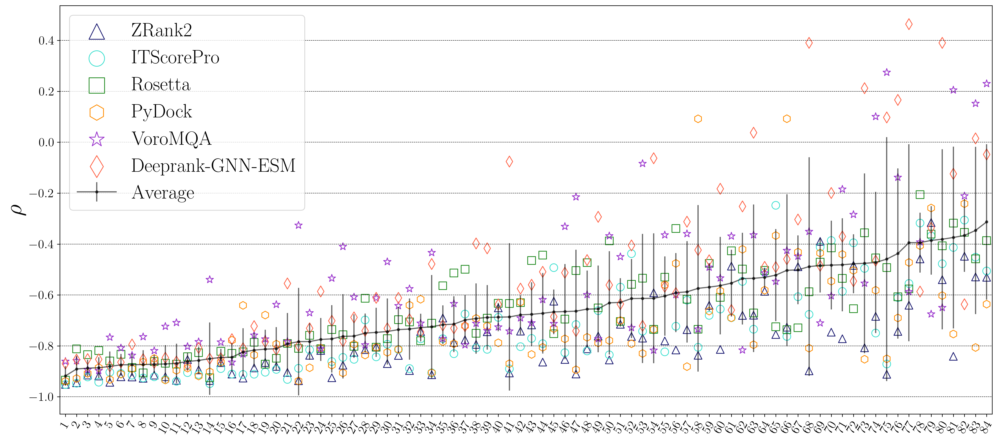

In [832]:
## Only scores that do well now

num_samples = len(ss_corr_df)
colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid", "indianred", "tomato"]



score_ref = ["spearman_dockq_zrank", "spearman_dockq_hdock", "spearman_dockq_rosetta",
             "spearman_dockq_pydock", "spearman_dockq_voromqa","spearman_dockq_deeprank_gnn_esm"]
spearman_data = np.zeros((len(score_ref),num_samples))

for i in range(len(score_ref)):
    for j in range(num_samples):
        if "deeprank" in score_ref[i] or "voromqa" in score_ref[i]:
            spearman_data[i][j] = ss_corr_df[score_ref[i]].iloc[j] * -1
        else:
            spearman_data[i][j] = ss_corr_df[score_ref[i]].iloc[j]

fig, ax = plt.subplots(figsize = (18,8), dpi = 300)

mean_data = np.mean(spearman_data, axis = 0)

stdev_data = np.std(spearman_data, axis = 0)

sorted_data = spearman_data[:, mean_data.argsort()]

sorted_mean_data = mean_data[mean_data.argsort()]

sorted_stdev_data = stdev_data[mean_data.argsort()]


pdb_order = list(np.array(ss_corr_df["pdb"])[mean_data.argsort()])
print(pdb_order)
label_ticks = list(range(1, len(ss_corr_df)+1))
x = np.linspace(0.5, num_samples-0.5, num_samples)
plt.xticks(x, label_ticks)
plt.xticks(rotation = 60, fontsize = 16)
plt.yticks(fontsize = 16)
plt.xlim(0, num_samples)

marker_size = 100

ax.scatter(x, sorted_data[0], color = colors[0], marker = "^", label = "ZRank2", facecolor = "None", s = marker_size)
ax.scatter(x, sorted_data[1], color = colors[1], marker = "o", label = "ITScorePro", facecolor = "None", s = marker_size)
ax.scatter(x, sorted_data[2], color = colors[2], marker = "s", label = "Rosetta", facecolor = "None", s = marker_size)
ax.scatter(x, sorted_data[3], color = colors[3], marker = "h", label = "PyDock", facecolor = "None", s = marker_size)
ax.scatter(x, sorted_data[4], color = colors[4], marker = "*", label = "VoroMQA", facecolor = "None", s = marker_size)
ax.scatter(x, sorted_data[5], color = colors[6], marker = "d", label = "Deeprank-GNN-ESM", facecolor = "None", s = marker_size)

plt.errorbar(x, sorted_mean_data, yerr = sorted_stdev_data, color = "black", marker = ".", label = "Average", alpha = 0.6)

ax.set_ylabel(r"$\rho$", fontsize = 30)

fig.tight_layout()
lgnd = plt.legend(fontsize = 25)
lgnd.legendHandles[0]._sizes = [400]
lgnd.legendHandles[1]._sizes = [400]
lgnd.legendHandles[2]._sizes = [400]
lgnd.legendHandles[3]._sizes = [400]
lgnd.legendHandles[4]._sizes = [400]
lgnd.legendHandles[5]._sizes = [400]
plt.grid(axis = "y", color = 'black', linestyle = '--', linewidth = 0.5)
plt.savefig(join(figure_save_dir, "per_target_spearman_no_dove.png"))

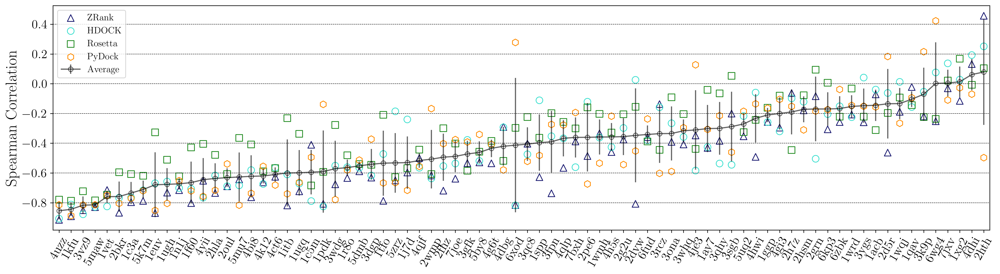

In [547]:
## Creating Figure 3 but with Non-supersampled Data

num_samples = len(ss_corr_df)

spearman_data = np.zeros((4,num_samples))
score_ref = ["spearman_dockq_zrank", "spearman_dockq_hdock", "spearman_dockq_rosetta", "spearman_dockq_pydock", "spearman_dockq_voromqa"]

for i in range(4):
    for j in range(num_samples):
        if i == 4:
            spearman_data[i][j] = fraction_relaxed_corr_df[score_ref[i]].iloc[j] * -1
        else:
            spearman_data[i][j] = fraction_relaxed_corr_df[score_ref[i]].iloc[j]

fig, ax = plt.subplots(figsize = (18,5), dpi = 300)

mean_data = np.mean(spearman_data, axis = 0)

stdev_data = np.std(spearman_data, axis = 0)

sorted_data = spearman_data[:, mean_data.argsort()]

sorted_mean_data = mean_data[mean_data.argsort()]

sorted_stdev_data = stdev_data[mean_data.argsort()]


label_ticks = list(np.array(fraction_relaxed_corr_df["pdb"])[mean_data.argsort()])
x = np.linspace(0.5, num_samples-0.5, num_samples)
plt.xticks(x, label_ticks)
plt.xticks(rotation = 60, fontsize = 16)
plt.yticks(fontsize = 16)
plt.xlim(0, num_samples)

marker_size = 75

ax.scatter(x, sorted_data[0], color = colors[0], marker = "^", label = "ZRank", facecolor = "None", s = marker_size)
ax.scatter(x, sorted_data[1], color = colors[1], marker = "o", label = "HDOCK", facecolor = "None", s = marker_size)
ax.scatter(x, sorted_data[2], color = colors[2], marker = "s", label = "Rosetta", facecolor = "None", s = marker_size)
ax.scatter(x, sorted_data[3], color = colors[3], marker = "h", label = "PyDock", facecolor = "None", s = marker_size)
# ax.scatter(x, sorted_data[4], color = colors[4], marker = "*", label = "VoroMQA", facecolor = "None", s = marker_size)

plt.errorbar(x, sorted_mean_data, yerr = sorted_stdev_data, color = "black", marker = "o", markerfacecolor = "None", label = "Average", alpha = 0.6)

ax.set_ylabel("Spearman Correlation", fontsize = 20)

fig.tight_layout()
plt.legend(fontsize = 12)
plt.grid(axis = "y", color = 'black', linestyle = '--', linewidth = 0.5)
      

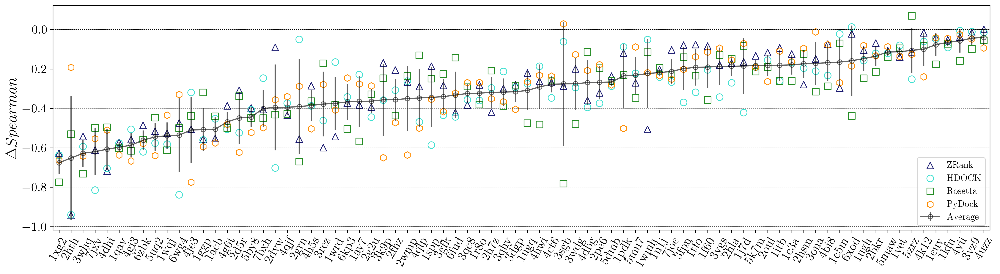

In [548]:
## Creating Figure 3 but with Delta Spearman

num_samples = len(ss_corr_df)

spearman_data = np.zeros((4,num_samples))
score_ref = ["spearman_dockq_zrank", "spearman_dockq_hdock", "spearman_dockq_rosetta", "spearman_dockq_pydock", "spearman_dockq_voromqa"]

for i in range(4):
    for j in range(num_samples):
        if i == 4:
            spearman_data[i][j] = ss_corr_df[score_ref[i]].iloc[j] * -1 - fraction_relaxed_corr_df[score_ref[i]].iloc[j] * -1
        else:
            spearman_data[i][j] = ss_corr_df[score_ref[i]].iloc[j] - fraction_relaxed_corr_df[score_ref[i]].iloc[j]

fig, ax = plt.subplots(figsize = (18,5), dpi = 300)

mean_data = np.mean(spearman_data, axis = 0)

delta_mean_data = mean_data
delta_spearman_data = spearman_data

stdev_data = np.std(spearman_data, axis = 0)

sorted_data = spearman_data[:, mean_data.argsort()]

sorted_mean_data = mean_data[mean_data.argsort()]

sorted_stdev_data = stdev_data[mean_data.argsort()]


label_ticks = list(np.array(ss_corr_df["pdb"])[mean_data.argsort()])
x = np.linspace(0.5, num_samples-0.5, num_samples)
plt.xticks(x, label_ticks)
plt.xticks(rotation = 60, fontsize = 16)
plt.yticks(fontsize = 16)
plt.xlim(0, num_samples)

marker_size = 75

ax.scatter(x, sorted_data[0], color = colors[0], marker = "^", label = "ZRank", facecolor = "None", s = marker_size)
ax.scatter(x, sorted_data[1], color = colors[1], marker = "o", label = "HDOCK", facecolor = "None", s = marker_size)
ax.scatter(x, sorted_data[2], color = colors[2], marker = "s", label = "Rosetta", facecolor = "None", s = marker_size)
ax.scatter(x, sorted_data[3], color = colors[3], marker = "h", label = "PyDock", facecolor = "None", s = marker_size)
# ax.scatter(x, sorted_data[4], color = colors[4], marker = "*", label = "VoroMQA", facecolor = "None", s = marker_size)

plt.errorbar(x, sorted_mean_data, yerr = sorted_stdev_data, color = "black", marker = "o", markerfacecolor = "None", label = "Average", alpha = 0.6)

ax.set_ylabel("$\Delta Spearman$", fontsize = 20)

fig.tight_layout()
plt.legend(fontsize = 12)
plt.grid(axis = "y", color = 'black', linestyle = '--', linewidth = 0.5)
      

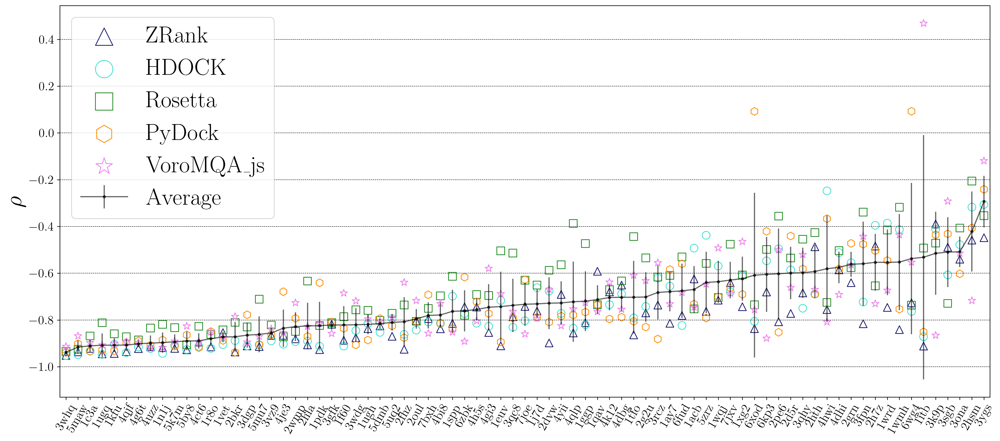

In [542]:
## Creating the per target with the new VoroMQA data

num_samples = len(ss_corr_df)
colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid", "indianred", "magenta", "tomato", "violet"]



# score_ref = ["spearman_dockq_zrank", "spearman_dockq_hdock", "spearman_dockq_rosetta", "spearman_dockq_pydock", "spearman_dockq_voromqa"]
score_ref = ["spearman_dockq_zrank", "spearman_dockq_hdock", "spearman_dockq_rosetta", "spearman_dockq_pydock","spearman_dockq_voromqa_js"]
spearman_data = np.zeros((len(score_ref),num_samples))

for i in range(len(score_ref)):
    for j in range(num_samples):
        if score_ref[i] == "spearman_dockq_deeprank" or score_ref[i] == "spearman_dockq_voromqa" or score_ref[i] == "spearman_dockq_voromqa_js":
            spearman_data[i][j] = ss_corr_df[score_ref[i]].iloc[j] * -1
        else:
            spearman_data[i][j] = ss_corr_df[score_ref[i]].iloc[j]

fig, ax = plt.subplots(figsize = (18,8), dpi = 300)

mean_data = np.mean(spearman_data, axis = 0)

stdev_data = np.std(spearman_data, axis = 0)

sorted_data = spearman_data[:, mean_data.argsort()]

sorted_mean_data = mean_data[mean_data.argsort()]

sorted_stdev_data = stdev_data[mean_data.argsort()]


label_ticks = list(np.array(ss_corr_df["pdb"])[mean_data.argsort()])
x = np.linspace(0.5, num_samples-0.5, num_samples)
plt.xticks(x, label_ticks)
plt.xticks(rotation = 60, fontsize = 16)
plt.yticks(fontsize = 16)
plt.xlim(0, num_samples)

marker_size = 100

ax.scatter(x, sorted_data[0], color = colors[0], marker = "^", label = "ZRank", facecolor = "None", s = marker_size)
ax.scatter(x, sorted_data[1], color = colors[1], marker = "o", label = "HDOCK", facecolor = "None", s = marker_size)
ax.scatter(x, sorted_data[2], color = colors[2], marker = "s", label = "Rosetta", facecolor = "None", s = marker_size)
ax.scatter(x, sorted_data[3], color = colors[3], marker = "h", label = "PyDock", facecolor = "None", s = marker_size)
# ax.scatter(x, sorted_data[4], color = colors[4], marker = "*", label = "VoroMQA", facecolor = "None", s = marker_size)
ax.scatter(x, sorted_data[4], color = colors[8], marker = "*", label = "VoroMQA_js", facecolor = "None", s = marker_size)

plt.errorbar(x, sorted_mean_data, yerr = sorted_stdev_data, color = "black", marker = ".", label = "Average", alpha = 0.6)

ax.set_ylabel(r"$\rho$", fontsize = 30)

fig.tight_layout()
lgnd = plt.legend(fontsize = 30)
lgnd.legendHandles[0]._sizes = [500]
lgnd.legendHandles[1]._sizes = [500]
lgnd.legendHandles[2]._sizes = [500]
lgnd.legendHandles[3]._sizes = [500]
lgnd.legendHandles[4]._sizes = [500]
lgnd.legendHandles[5]._sizes = [500]
plt.grid(axis = "y", color = 'black', linestyle = '--', linewidth = 0.5)
      

SpearmanrResult(correlation=-0.21799719268073697, pvalue=0.05519433620791758)
(-0.09817944232234177, 0.39245890283314866)


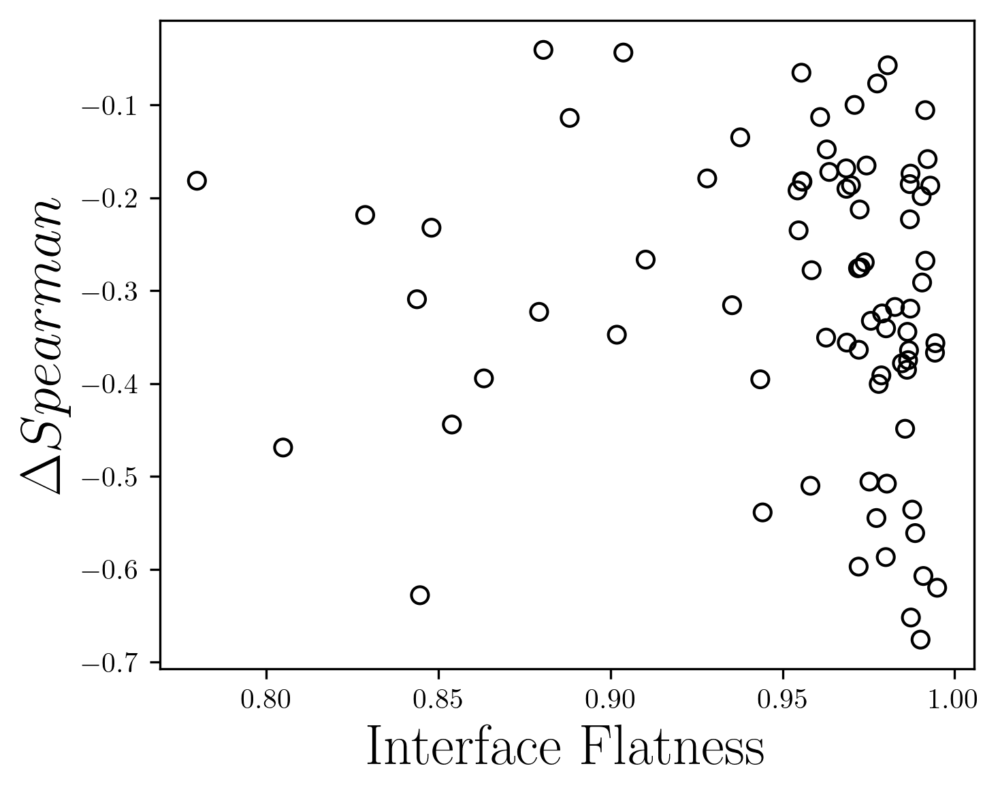

In [549]:
## Quick scatter of the average delta vs flatness

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid"]

## Relaxed and Supersampled

ax.scatter(ss_corr_df["flatness_p3"], delta_mean_data, color = "black", marker = "o",  facecolor = "None", label = "Delta")

print(spearmanr(ss_corr_df["flatness_p3"], delta_mean_data))
print(pearsonr(ss_corr_df["flatness_p3"], delta_mean_data))


ax.set_xlabel("Interface Flatness", fontsize = 20)
ax.set_ylabel("$\Delta Spearman$", fontsize = 20)


fig.tight_layout()

SpearmanrResult(correlation=0.17631586705988048, pvalue=0.18160705885318024)
(0.08324782510779744, 0.5307597191460833)


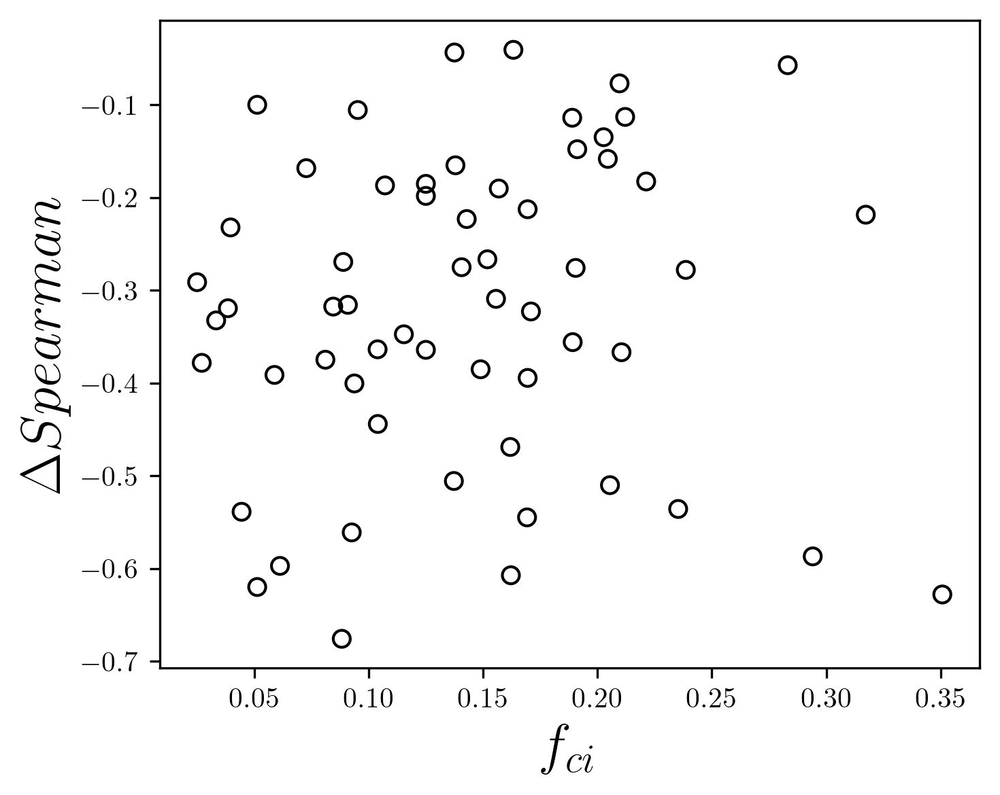

In [421]:
## Quick scatter of the average delta vs fraction core interface

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid"]

## Relaxed and Supersampled

ax.scatter(ss_corr_df["fci"], delta_mean_data, color = "black", marker = "o",  facecolor = "None", label = "Delta")

print(spearmanr(ss_corr_df["fci"], delta_mean_data))
print(pearsonr(ss_corr_df["fci"], delta_mean_data))


ax.set_xlabel("$f_{ci}$", fontsize = 20)
ax.set_ylabel("$\Delta Spearman$", fontsize = 20)


fig.tight_layout()

Spearman Correlation is: 0.23001841092261535
Pearson Correlation is: 0.03773763392382204


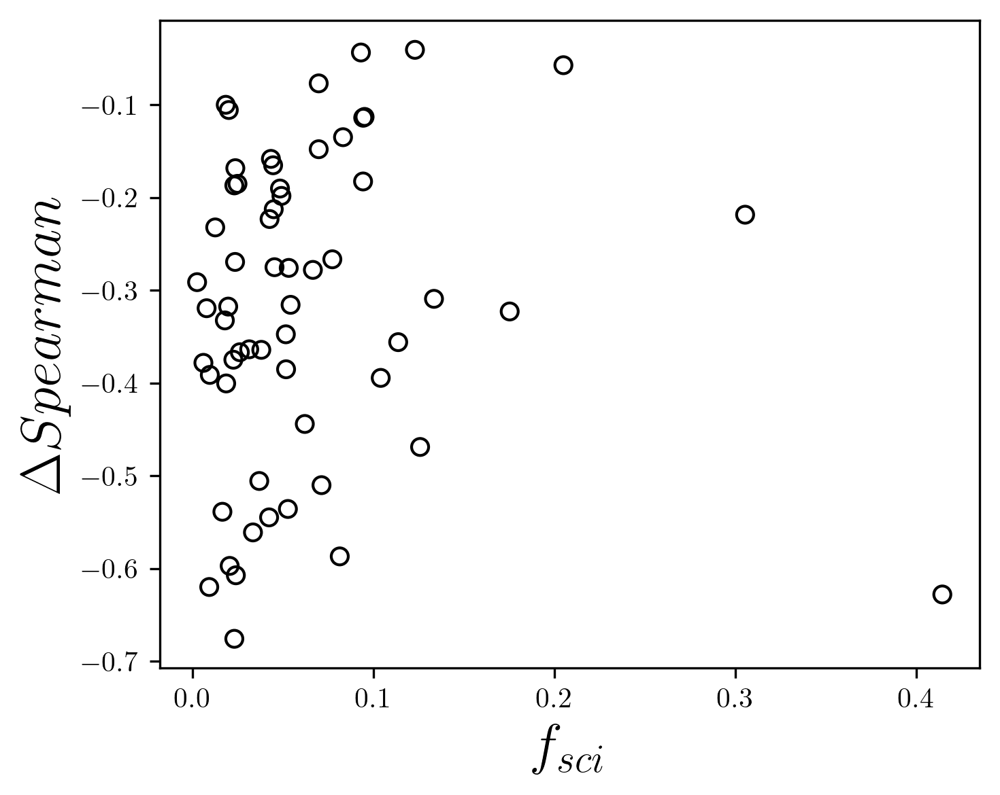

In [422]:
## Quick scatter of the average delta vs fraction core interface

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid"]

## Relaxed and Supersampled

ax.scatter(ss_corr_df["fsci"], delta_mean_data, color = "black", marker = "o",  facecolor = "None", label = "Delta")

print("Spearman Correlation is:", spearmanr(ss_corr_df["fsci"], delta_mean_data)[0])
print("Pearson Correlation is:", pearsonr(ss_corr_df["fsci"], delta_mean_data)[0])


ax.set_xlabel("$f_{sci}$", fontsize = 20)
ax.set_ylabel("$\Delta Spearman$", fontsize = 20)


fig.tight_layout()

Spearman Correlation is: -0.01358202712987433
Pearson Correlation is: -0.04921373853790963


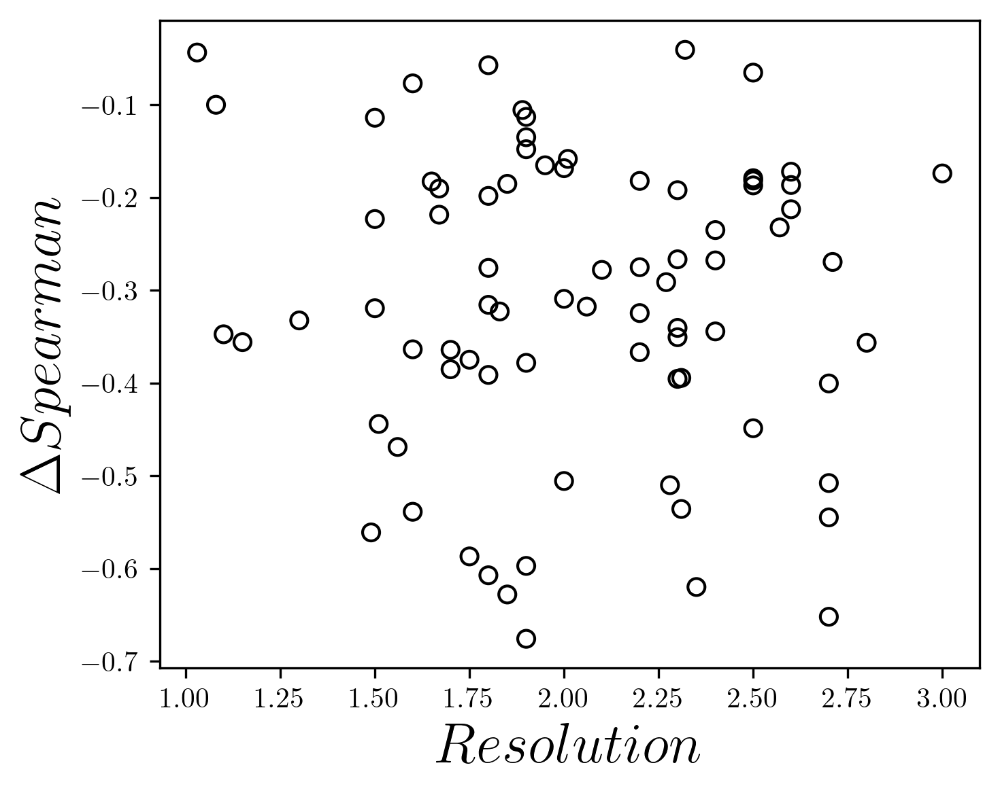

In [552]:
## Quick scatter of the average delta vs resolution

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid"]

## Relaxed and Supersampled

ax.scatter(ss_corr_df["resolution"], delta_mean_data, color = "black", marker = "o",  facecolor = "None", label = "Delta")

print("Spearman Correlation is:", spearmanr(ss_corr_df["resolution"], delta_mean_data)[0])
print("Pearson Correlation is:", pearsonr(ss_corr_df["resolution"], delta_mean_data)[0])


ax.set_xlabel("$Resolution$", fontsize = 20)
ax.set_ylabel("$\Delta Spearman$", fontsize = 20)


fig.tight_layout()

Spearman Correlation is: -0.03925882429520949
Pearson Correlation is: -0.13389529941222164


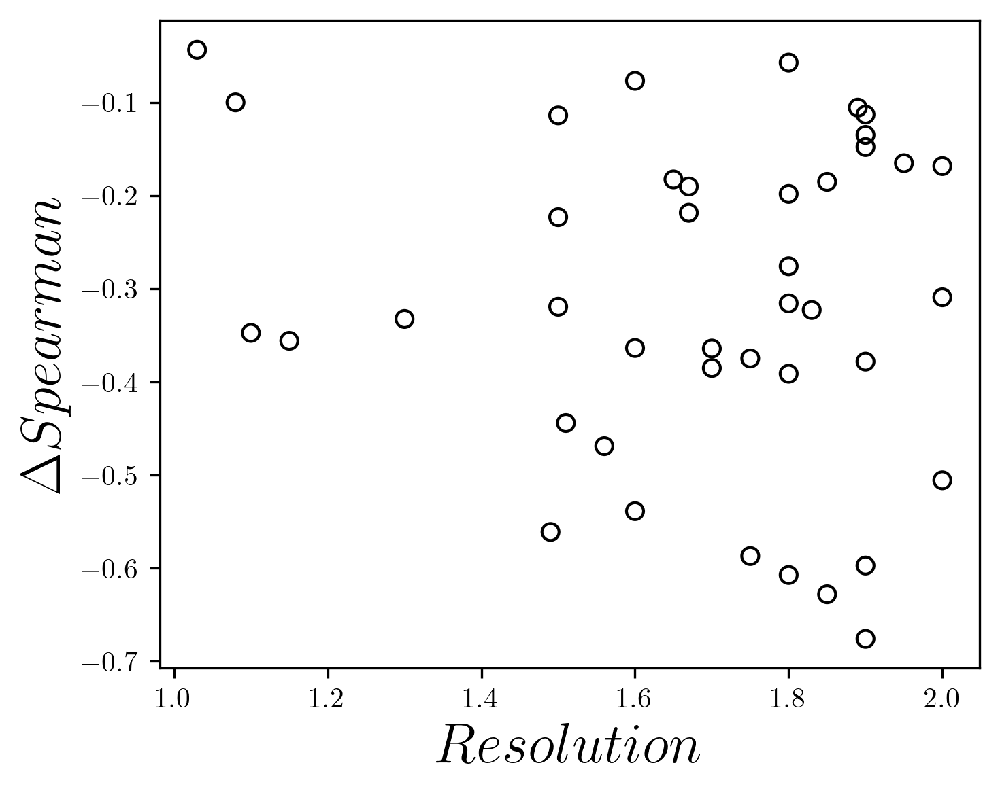

In [554]:
## Only the data <= 2Å

## Quick scatter of the average delta vs resolution

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid"]

## Relaxed and Supersampled

ax.scatter(ss_corr_df["resolution"][ss_corr_df["resolution"]<=2.0], delta_mean_data[ss_corr_df["resolution"]<=2.0], color = "black", marker = "o",  facecolor = "None", label = "Delta")

print("Spearman Correlation is:", spearmanr(ss_corr_df["resolution"][ss_corr_df["resolution"]<=2.0], delta_mean_data[ss_corr_df["resolution"]<=2.0])[0])
print("Pearson Correlation is:", pearsonr(ss_corr_df["resolution"][ss_corr_df["resolution"]<=2.0], delta_mean_data[ss_corr_df["resolution"]<=2.0])[0])


ax.set_xlabel("$Resolution$", fontsize = 20)
ax.set_ylabel("$\Delta Spearman$", fontsize = 20)


fig.tight_layout()

Spearman Correlation is: -0.011307599950438476
Pearson Correlation is: -0.07883375091441415


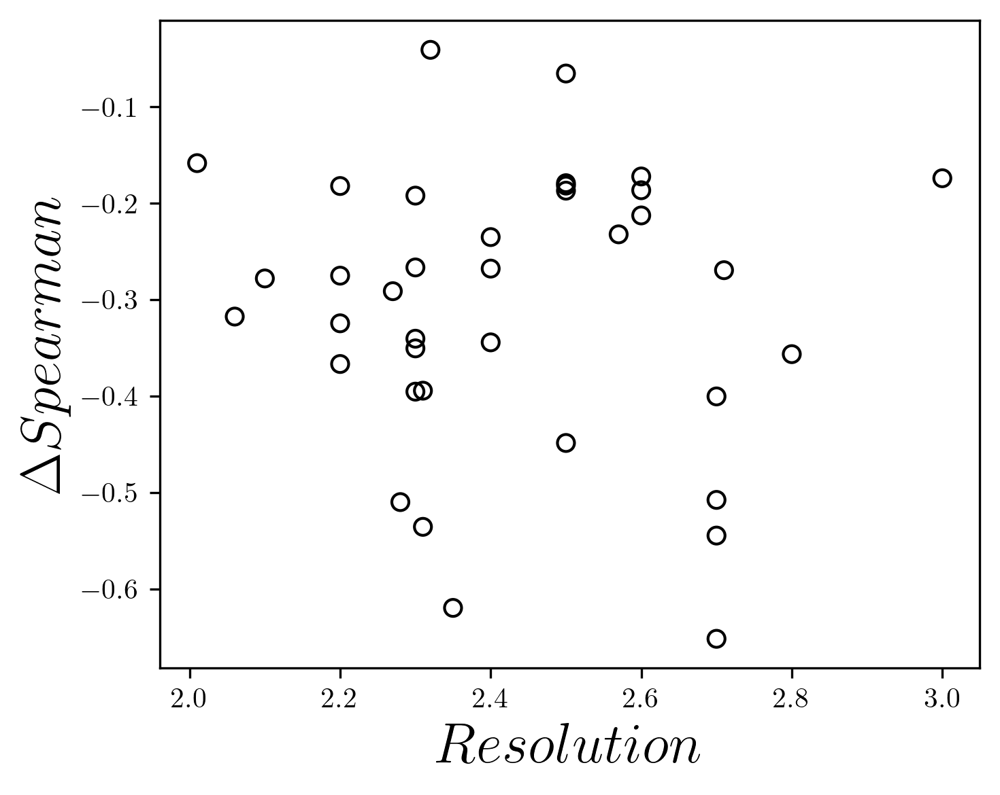

In [557]:
## Only the data > 2Å

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid"]

## Relaxed and Supersampled

ax.scatter(ss_corr_df["resolution"][ss_corr_df["resolution"]>2.0], delta_mean_data[ss_corr_df["resolution"]>2.0], color = "black", marker = "o",  facecolor = "None", label = "Delta")

print("Spearman Correlation is:", spearmanr(ss_corr_df["resolution"][ss_corr_df["resolution"]>2.0], delta_mean_data[ss_corr_df["resolution"]>2.0])[0])
print("Pearson Correlation is:", pearsonr(ss_corr_df["resolution"][ss_corr_df["resolution"]>2.0], delta_mean_data[ss_corr_df["resolution"]>2.0])[0])


ax.set_xlabel("$Resolution$", fontsize = 20)
ax.set_ylabel("$\Delta Spearman$", fontsize = 20)


fig.tight_layout()

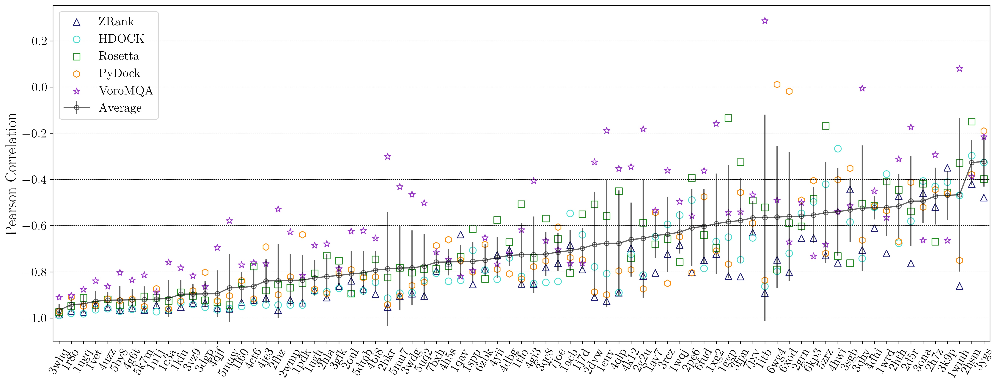

In [48]:
## Creating Figure 3 but with PEARSON Correlation

num_samples = len(ss_corr_df)

spearman_data = np.zeros((5,num_samples))
score_ref = ["pearson_dockq_zrank", "pearson_dockq_hdock", "pearson_dockq_rosetta", "pearson_dockq_pydock", "pearson_dockq_voromqa"]

for i in range(5):
    for j in range(num_samples):
        if i == 4:
            spearman_data[i][j] = ss_corr_df[score_ref[i]].iloc[j] * -1
        else:
            spearman_data[i][j] = ss_corr_df[score_ref[i]].iloc[j]

fig, ax = plt.subplots(figsize = (18,7), dpi = 300)

mean_data = np.mean(spearman_data, axis = 0)

stdev_data = np.std(spearman_data, axis = 0)

sorted_data = spearman_data[:, mean_data.argsort()]

sorted_mean_data = mean_data[mean_data.argsort()]

sorted_stdev_data = stdev_data[mean_data.argsort()]


label_ticks = list(np.array(ss_corr_df["pdb"])[mean_data.argsort()])
x = np.linspace(0.5, num_samples-0.5, num_samples)
plt.xticks(x, label_ticks)
plt.xticks(rotation = 60, fontsize = 16)
plt.yticks(fontsize = 16)
plt.xlim(0, num_samples)

marker_size = 75

ax.scatter(x, sorted_data[0], color = colors[0], marker = "^", label = "ZRank", facecolor = "None", s = marker_size)
ax.scatter(x, sorted_data[1], color = colors[1], marker = "o", label = "HDOCK", facecolor = "None", s = marker_size)
ax.scatter(x, sorted_data[2], color = colors[2], marker = "s", label = "Rosetta", facecolor = "None", s = marker_size)
ax.scatter(x, sorted_data[3], color = colors[3], marker = "h", label = "PyDock", facecolor = "None", s = marker_size)
ax.scatter(x, sorted_data[4], color = colors[4], marker = "*", label = "VoroMQA", facecolor = "None", s = marker_size)

plt.errorbar(x, sorted_mean_data, yerr = sorted_stdev_data, color = "black", marker = "o", markerfacecolor = "None", label = "Average", alpha = 0.6)

ax.set_ylabel("Pearson Correlation", fontsize = 20)

fig.tight_layout()
plt.legend(fontsize = 16)
plt.grid(axis = "y", color = 'black', linestyle = '--', linewidth = 0.5)
      

# Figure 4 - Flatness

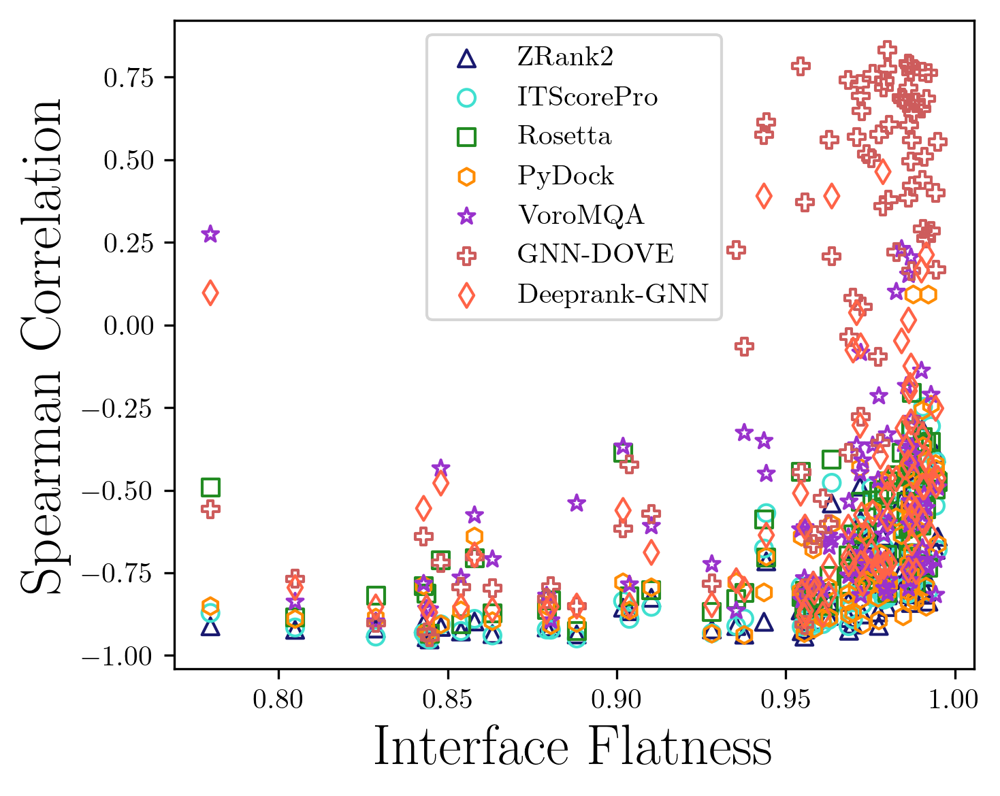

In [100]:
## Final Flatness Figure

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid", "indianred", "tomato"]

## Relaxed and Supersampled

ax.scatter(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_zrank"], color = colors[0], marker = "^",  facecolor = "None", label = r"ZRank2")
ax.scatter(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_hdock"], color = colors[1], marker = "o", facecolor = "None", label = "ITScorePro")
ax.scatter(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_rosetta"], color = colors[2], marker = "s", facecolor = "None", label = "Rosetta")
ax.scatter(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_pydock"], color = colors[3], marker = "h", facecolor = "None", label = "PyDock")
ax.scatter(ss_corr_df["flatness_p3"], np.array(ss_corr_df["spearman_dockq_voromqa"])*-1, color = colors[4], marker = "*", facecolor = "None", label = "VoroMQA")
ax.scatter(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_dove_5"], color = colors[5], marker = "P", facecolor = "None", label = "GNN-DOVE")
ax.scatter(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_deeprank_gnn_esm"]*-1, color = colors[6], marker = "d", facecolor = "None", label = "Deeprank-GNN")



ax.set_xlabel("Interface Flatness", fontsize = 20)
ax.set_ylabel("Spearman Correlation", fontsize = 20)


plt.legend()
fig.tight_layout()

In [108]:
ss_corr_df.columns

Index(['pdb', 'pearson_ialign_zrank', 'pearson_ialign_hdock',
       'pearson_ialign_rosetta', 'pearson_ialign_pydock',
       'pearson_ialign_voromqa', 'pearson_ialign_voromqa_js',
       'pearson_ialign_dove_5', 'pearson_ialign_intertwined',
       'pearson_ialign_deeprank_gnn_esm', 'pearson_ialign_contact_42',
       'pearson_ialign_contact_43', 'pearson_ialign_contact_44',
       'pearson_ialign_contact_45', 'pearson_ialign_interface_rsa',
       'pearson_dockq_zrank', 'pearson_dockq_hdock', 'pearson_dockq_rosetta',
       'pearson_dockq_pydock', 'pearson_dockq_voromqa',
       'pearson_dockq_voromqa_js', 'pearson_dockq_dove_5',
       'pearson_dockq_intertwined', 'pearson_dockq_deeprank_gnn_esm',
       'pearson_dockq_contact_42', 'pearson_dockq_contact_43',
       'pearson_dockq_contact_44', 'pearson_dockq_contact_45',
       'pearson_dockq_interface_rsa', 'spearman_ialign_zrank',
       'spearman_ialign_hdock', 'spearman_ialign_rosetta',
       'spearman_ialign_pydock', 'spearma

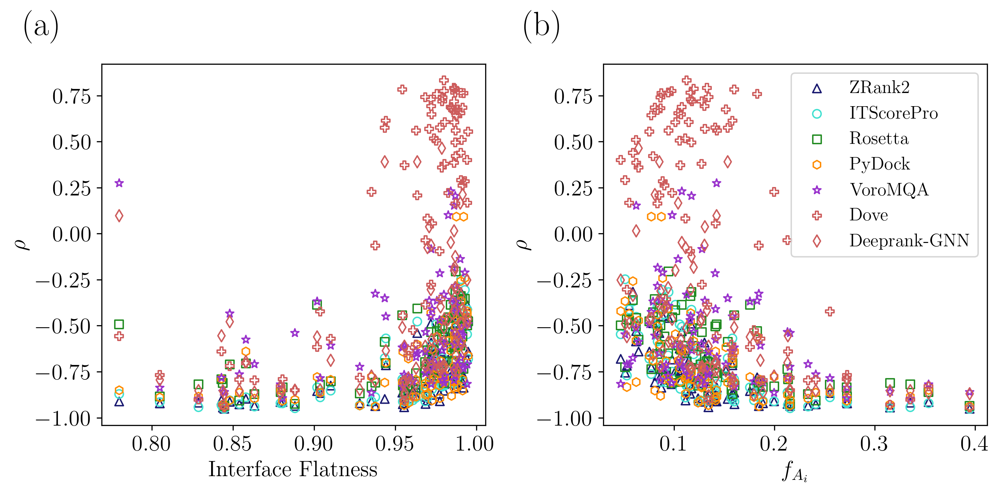

In [834]:
## Final Flatness Correlation Figure

fig, ax = plt.subplots(1,2,figsize = (10,5), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid", "indianred", "tomato"]

font_size = 16

## Interface Flatness

ax[0].scatter(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_zrank"], color = colors[0], marker = "^",  facecolor = "None", label = "ZRank2")
ax[0].scatter(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_hdock"], color = colors[1], marker = "o", facecolor = "None", label = "ITScorePro")
ax[0].scatter(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_rosetta"], color = colors[2], marker = "s", facecolor = "None", label = "Rosetta")
ax[0].scatter(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_pydock"], color = colors[3], marker = "h", facecolor = "None", label = "PyDock")
ax[0].scatter(ss_corr_df["flatness_p3"], np.array(ss_corr_df["spearman_dockq_voromqa"])*-1, color = colors[4], marker = "*", facecolor = "None", label = "VoroMQA")
ax[0].scatter(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_dove_5"], color = colors[5], marker = "P", facecolor = "None", label = "Dove")
ax[0].scatter(ss_corr_df["flatness_p3"], np.array(ss_corr_df["spearman_dockq_deeprank_gnn_esm"])*-1, color = colors[5], marker = "d", facecolor = "None", label = "Deeprank-GNN")


ax[0].set_xlabel("Interface Flatness", fontsize = font_size)
ax[0].set_ylabel(r"$\rho$", fontsize = font_size)

## Relative Interface Surface Area

ax[1].scatter(ss_corr_df["relative_interface_sasa"], ss_corr_df["spearman_dockq_zrank"], color = colors[0], marker = "^",  facecolor = "None", label = "ZRank2")
ax[1].scatter(ss_corr_df["relative_interface_sasa"], ss_corr_df["spearman_dockq_hdock"], color = colors[1], marker = "o", facecolor = "None", label = "ITScorePro")
ax[1].scatter(ss_corr_df["relative_interface_sasa"], ss_corr_df["spearman_dockq_rosetta"], color = colors[2], marker = "s", facecolor = "None", label = "Rosetta")
ax[1].scatter(ss_corr_df["relative_interface_sasa"], ss_corr_df["spearman_dockq_pydock"], color = colors[3], marker = "h", facecolor = "None", label = "PyDock")
ax[1].scatter(ss_corr_df["relative_interface_sasa"], np.array(ss_corr_df["spearman_dockq_voromqa"])*-1, color = colors[4], marker = "*", facecolor = "None", label = "VoroMQA")
ax[1].scatter(ss_corr_df["relative_interface_sasa"], ss_corr_df["spearman_dockq_dove_5"], color = colors[5], marker = "P", facecolor = "None", label = "Dove")
ax[1].scatter(ss_corr_df["relative_interface_sasa"], np.array(ss_corr_df["spearman_dockq_deeprank_gnn_esm"])*-1, color = colors[5], marker = "d", facecolor = "None", label = "Deeprank-GNN")


ax[1].set_xlabel("$f_{A_{i}}$", fontsize = font_size)
ax[1].set_ylabel(r"$\rho$", fontsize = font_size)


ax[1].legend(fontsize = font_size-3)

ax[0].text(-0.1, 1.15, "(a)", transform=ax[0].transAxes,fontsize=font_size*1.5, fontweight='bold', va='top', ha='right')
ax[1].text(-0.1, 1.15, "(b)", transform=ax[1].transAxes,fontsize=font_size*1.5, fontweight='bold', va='top', ha='right')
ax[0].tick_params(axis='both', which='major', labelsize=font_size)
ax[1].tick_params(axis='both', which='major', labelsize=font_size)

fig.tight_layout()
plt.savefig(join(figure_save_dir, "flatness_and_rel_interface.png"))

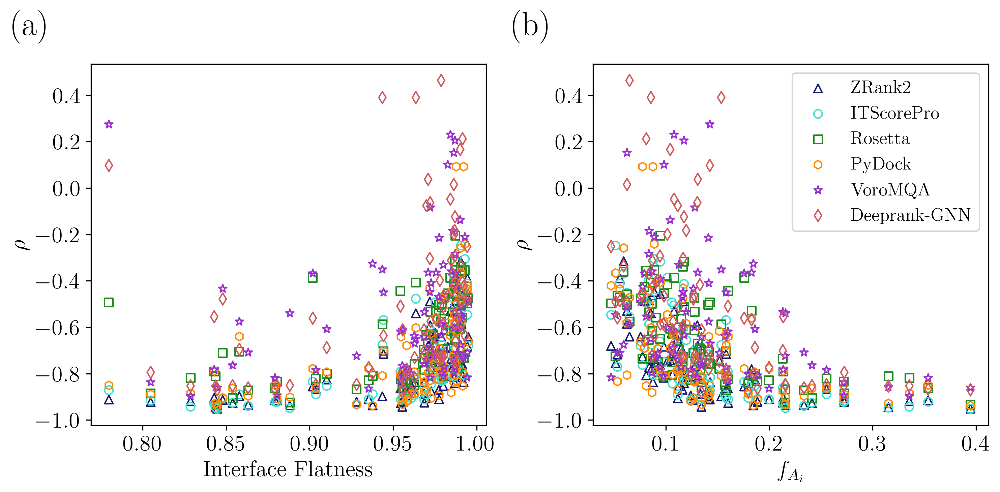

In [835]:
## Final Flatness Correlation Figure - NO DOVE

fig, ax = plt.subplots(1,2,figsize = (10,5), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid", "indianred", "tomato"]

font_size = 16

## Interface Flatness

ax[0].scatter(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_zrank"], color = colors[0], marker = "^",  facecolor = "None", label = "ZRank2")
ax[0].scatter(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_hdock"], color = colors[1], marker = "o", facecolor = "None", label = "ITScorePro")
ax[0].scatter(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_rosetta"], color = colors[2], marker = "s", facecolor = "None", label = "Rosetta")
ax[0].scatter(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_pydock"], color = colors[3], marker = "h", facecolor = "None", label = "PyDock")
ax[0].scatter(ss_corr_df["flatness_p3"], np.array(ss_corr_df["spearman_dockq_voromqa"])*-1, color = colors[4], marker = "*", facecolor = "None", label = "VoroMQA")
# ax[0].scatter(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_dove_5"], color = colors[5], marker = "P", facecolor = "None", label = "Dove")
ax[0].scatter(ss_corr_df["flatness_p3"], np.array(ss_corr_df["spearman_dockq_deeprank_gnn_esm"])*-1, color = colors[5], marker = "d", facecolor = "None", label = "Deeprank-GNN")


ax[0].set_xlabel("Interface Flatness", fontsize = font_size)
ax[0].set_ylabel(r"$\rho$", fontsize = font_size)

## Relative Interface Surface Area

ax[1].scatter(ss_corr_df["relative_interface_sasa"], ss_corr_df["spearman_dockq_zrank"], color = colors[0], marker = "^",  facecolor = "None", label = "ZRank2")
ax[1].scatter(ss_corr_df["relative_interface_sasa"], ss_corr_df["spearman_dockq_hdock"], color = colors[1], marker = "o", facecolor = "None", label = "ITScorePro")
ax[1].scatter(ss_corr_df["relative_interface_sasa"], ss_corr_df["spearman_dockq_rosetta"], color = colors[2], marker = "s", facecolor = "None", label = "Rosetta")
ax[1].scatter(ss_corr_df["relative_interface_sasa"], ss_corr_df["spearman_dockq_pydock"], color = colors[3], marker = "h", facecolor = "None", label = "PyDock")
ax[1].scatter(ss_corr_df["relative_interface_sasa"], np.array(ss_corr_df["spearman_dockq_voromqa"])*-1, color = colors[4], marker = "*", facecolor = "None", label = "VoroMQA")
# ax[1].scatter(ss_corr_df["relative_interface_sasa"], ss_corr_df["spearman_dockq_dove_5"], color = colors[5], marker = "P", facecolor = "None", label = "Dove")
ax[1].scatter(ss_corr_df["relative_interface_sasa"], np.array(ss_corr_df["spearman_dockq_deeprank_gnn_esm"])*-1, color = colors[5], marker = "d", facecolor = "None", label = "Deeprank-GNN")


ax[1].set_xlabel("$f_{A_{i}}$", fontsize = font_size)
ax[1].set_ylabel(r"$\rho$", fontsize = font_size)


ax[1].legend(fontsize = font_size-3)

ax[0].text(-0.1, 1.15, "(a)", transform=ax[0].transAxes,fontsize=font_size*1.5, fontweight='bold', va='top', ha='right')
ax[1].text(-0.1, 1.15, "(b)", transform=ax[1].transAxes,fontsize=font_size*1.5, fontweight='bold', va='top', ha='right')
ax[0].tick_params(axis='both', which='major', labelsize=font_size)
ax[1].tick_params(axis='both', which='major', labelsize=font_size)

fig.tight_layout()
plt.savefig(join(figure_save_dir, "flatness_and_rel_interface_no_dove.png"))

In [339]:
print("INTERFACE FLATNESS")
print("ZRank\t\t", str(spearmanr(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_zrank"])[0])[:6])
print("HDOCK\t\t", str(spearmanr(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_hdock"])[0])[:6])
print("Rosetta\t\t", str(spearmanr(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_rosetta"])[0])[:6])
print("PyDock\t\t", str(spearmanr(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_pydock"])[0])[:6])
print("VoroMQA\t\t", str(spearmanr(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_voromqa"])[0])[:6])
print("Deeprank\t", str(spearmanr(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_deeprank_gnn_esm"])[0])[:6])
print("\nRelative Interface SASA")
print("ZRank\t\t", str(spearmanr(ss_corr_df["relative_interface_sasa"], ss_corr_df["spearman_dockq_zrank"])[0])[:6])
print("HDOCK\t\t", str(spearmanr(ss_corr_df["relative_interface_sasa"], ss_corr_df["spearman_dockq_hdock"])[0])[:6])
print("Rosetta\t\t", str(spearmanr(ss_corr_df["relative_interface_sasa"], ss_corr_df["spearman_dockq_rosetta"])[0])[:6])
print("PyDock\t\t", str(spearmanr(ss_corr_df["relative_interface_sasa"], ss_corr_df["spearman_dockq_pydock"])[0])[:6])
print("VoroMQA\t\t", str(spearmanr(ss_corr_df["relative_interface_sasa"], ss_corr_df["spearman_dockq_voromqa"])[0])[:6])
print("Deeprank\t", str(spearmanr(ss_corr_df["relative_interface_sasa"], ss_corr_df["spearman_dockq_deeprank_gnn_esm"])[0])[:6])

INTERFACE FLATNESS
ZRank		 0.7338
HDOCK		 0.7918
Rosetta		 0.6451
PyDock		 0.6380
VoroMQA		 -0.311
Deeprank	 -0.522

Relative Interface SASA
ZRank		 -0.783
HDOCK		 -0.801
Rosetta		 -0.654
PyDock		 -0.620
VoroMQA		 0.3414
Deeprank	 0.6590


In [340]:
print("INTERFACE FLATNESS")
print("ZRank\t\t", str(pearsonr(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_zrank"])[0])[:6])
print("HDOCK\t\t", str(pearsonr(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_hdock"])[0])[:6])
print("Rosetta\t\t", str(pearsonr(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_rosetta"])[0])[:6])
print("PyDock\t\t", str(pearsonr(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_pydock"])[0])[:6])
print("VoroMQA\t\t", str(pearsonr(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_voromqa"])[0])[:6])
print("Deeprank\t", str(pearsonr(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_deeprank_gnn_esm"])[0])[:6])
print("\nRelative Interface SASA")
print("ZRank\t\t", str(pearsonr(ss_corr_df["relative_interface_sasa"], ss_corr_df["spearman_dockq_zrank"])[0])[:6])
print("HDOCK\t\t", str(pearsonr(ss_corr_df["relative_interface_sasa"], ss_corr_df["spearman_dockq_hdock"])[0])[:6])
print("Rosetta\t\t", str(pearsonr(ss_corr_df["relative_interface_sasa"], ss_corr_df["spearman_dockq_rosetta"])[0])[:6])
print("PyDock\t\t", str(pearsonr(ss_corr_df["relative_interface_sasa"], ss_corr_df["spearman_dockq_pydock"])[0])[:6])
print("VoroMQA\t\t", str(pearsonr(ss_corr_df["relative_interface_sasa"], ss_corr_df["spearman_dockq_voromqa"])[0])[:6])
print("Deeprank\t", str(pearsonr(ss_corr_df["relative_interface_sasa"], ss_corr_df["spearman_dockq_deeprank_gnn_esm"])[0])[:6])

INTERFACE FLATNESS
ZRank		 0.5394
HDOCK		 0.5725
Rosetta		 0.4700
PyDock		 0.4294
VoroMQA		 -0.163
Deeprank	 -0.283

Relative Interface SASA
ZRank		 -0.614
HDOCK		 -0.648
Rosetta		 -0.600
PyDock		 -0.503
VoroMQA		 0.3404
Deeprank	 0.5024


SpearmanrResult(correlation=0.7358843037655849, pvalue=2.282861298892731e-15)
SpearmanrResult(correlation=0.7978674278997522, pvalue=1.7276009525670385e-19)
SpearmanrResult(correlation=0.6422484362537257, pvalue=5.981576263381195e-11)
SpearmanrResult(correlation=0.6535619831241342, pvalue=2.1143334174876492e-11)
SpearmanrResult(correlation=-0.4234918769153268, pvalue=6.632180744968837e-05)


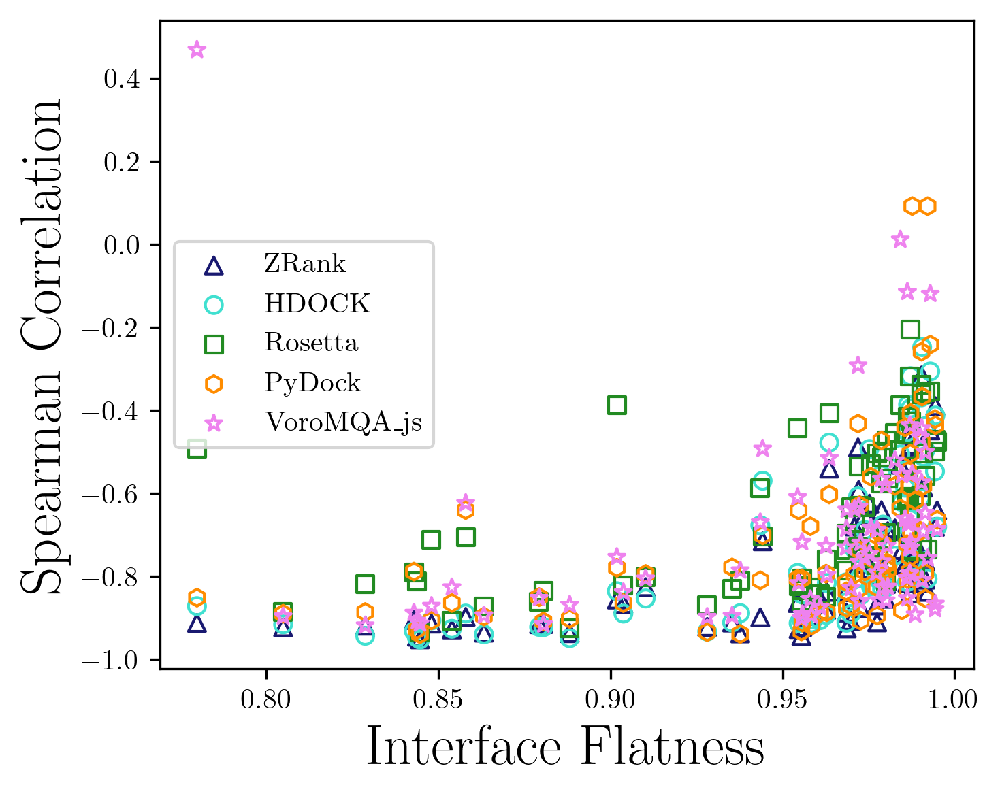

In [830]:
## Correlating Interface Flatness to Spearman Correlation

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid", "tomato", "violet"]

## Relaxed and Supersampled

ax.scatter(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_zrank"], color = colors[0], marker = "^",  facecolor = "None", label = "ZRank")
ax.scatter(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_hdock"], color = colors[1], marker = "o", facecolor = "None", label = "HDOCK")
ax.scatter(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_rosetta"], color = colors[2], marker = "s", facecolor = "None", label = "Rosetta")
ax.scatter(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_pydock"], color = colors[3], marker = "h", facecolor = "None", label = "PyDock")
# ax.scatter(ss_corr_df["flatness_p3"], np.array(ss_corr_df["spearman_dockq_voromqa"])*-1, color = colors[4], marker = "*", facecolor = "None", label = "VoroMQA")
# ax.scatter(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_deeprank"]*-1, color = colors[5], marker = "d", facecolor = "None", label = "Deeprank-GNN-ESM")
ax.scatter(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_voromqa_js"]*-1, color = colors[6], marker = "*", facecolor = "None", label = "VoroMQA_js")


print(spearmanr(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_zrank"]))
print(spearmanr(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_hdock"]))
print(spearmanr(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_rosetta"]))
print(spearmanr(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_pydock"]))
print(spearmanr(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_voromqa_js"]))
# print(spearmanr(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_deeprank"]))

ax.set_xlabel("Interface Flatness", fontsize = 20)
ax.set_ylabel("Spearman Correlation", fontsize = 20)


plt.legend()
fig.tight_layout()

In [323]:
np.mean(ss_corr_df["deeprank_auc"])

0.7792958066592963

In [545]:
np.mean(ss_corr_df["spearman_dockq_zrank"])

-0.7879152081897544

SpearmanrResult(correlation=0.7251432777748567, pvalue=8.810925633643827e-14)
SpearmanrResult(correlation=0.7866869972133129, pvalue=2.2579749859495565e-17)
SpearmanrResult(correlation=0.634207897365792, pvalue=5.92952092473821e-10)
SpearmanrResult(correlation=0.6851569483148429, pvalue=6.288577652851717e-12)
SpearmanrResult(correlation=-0.31907566118092434, pvalue=0.00467789639475443)
SpearmanrResult(correlation=-0.5374362479625637, pvalue=4.6614117656352387e-07)


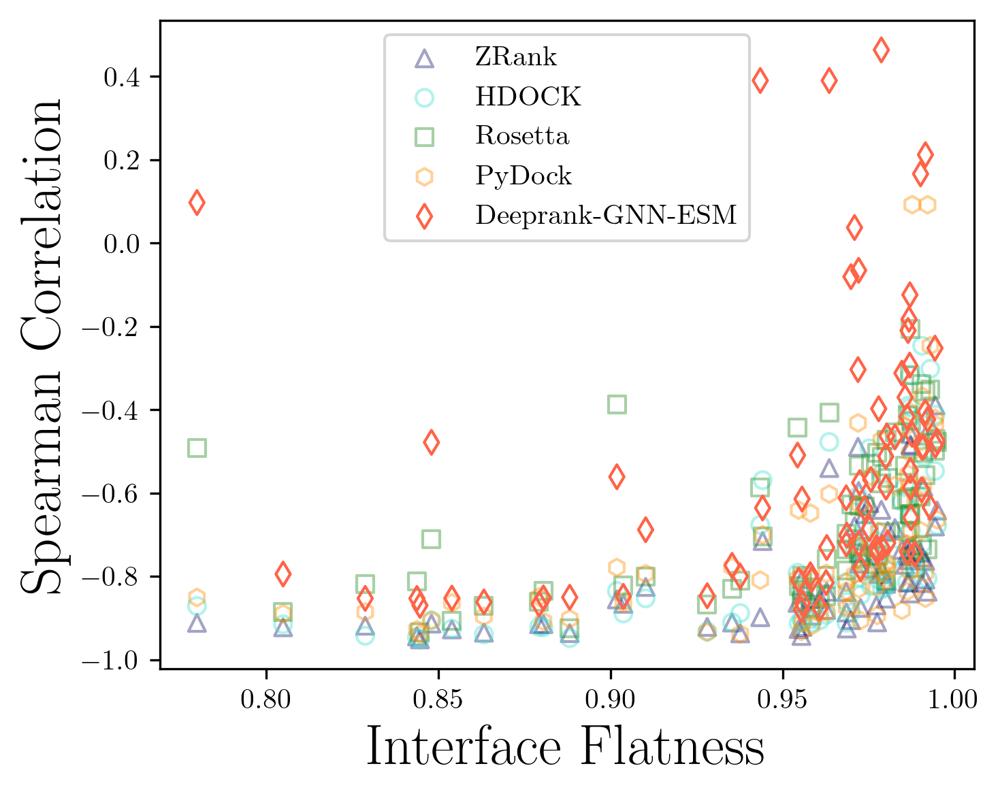

In [321]:
## Correlating Interface Flatness to Spearman Correlation

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid", "tomato"]

## Relaxed and Supersampled

ax.scatter(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_zrank"], color = colors[0], marker = "^",  facecolor = "None", label = "ZRank", alpha = 0.4)
ax.scatter(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_hdock"], color = colors[1], marker = "o", facecolor = "None", label = "HDOCK", alpha = 0.4)
ax.scatter(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_rosetta"], color = colors[2], marker = "s", facecolor = "None", label = "Rosetta", alpha = 0.4)
ax.scatter(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_pydock"], color = colors[3], marker = "h", facecolor = "None", label = "PyDock", alpha = 0.4)
# ax.scatter(ss_corr_df["flatness_p3"], np.array(ss_corr_df["spearman_dockq_voromqa"])*-1, color = colors[4], marker = "*", facecolor = "None", label = "VoroMQA")
ax.scatter(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_deeprank"]*-1, color = colors[5], marker = "d", facecolor = "None", label = "Deeprank-GNN-ESM")


print(spearmanr(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_zrank"]))
print(spearmanr(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_hdock"]))
print(spearmanr(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_rosetta"]))
print(spearmanr(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_pydock"]))
print(spearmanr(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_voromqa"]))
print(spearmanr(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_deeprank"]))

ax.set_xlabel("Interface Flatness", fontsize = 20)
ax.set_ylabel("Spearman Correlation", fontsize = 20)


plt.legend()
fig.tight_layout()

In [821]:
print(list(ss_corr_df["pdb"]))

['1acb', '1ay7', '1c3a', '1euv', '1f60', '1ggp', '1itb', '1j7d', '1kfu', '1mbv', '1n1j', '1pdk', '1qav', '1r8o', '1ry7', '1spp', '1tfo', '1ugh', '1ugq', '1vet', '1wmh', '1wqj', '1wrd', '1xg2', '2bkr', '2d5r', '2dvw', '2fhz', '2g2u', '2grn', '2h7z', '2hla', '2hsm', '2hth', '2oul', '2pe6', '2wmp', '3dgp', '3fpn', '3gfk', '3hw2', '3k9p', '3ona', '3qc8', '3qhy', '3rcz', '3sgb', '3u82', '3vz9', '3wdg', '3whq', '3ygs', '4bi8', '4ct6', '4dbg', '4dhi', '4g6t', '4gi3', '4h5s', '4hwi', '4je3', '4k12', '4qjf', '4qlp', '4uzz', '4yii', '5by8', '5dmb', '5k7m', '5maw', '5mu7', '5uq2', '5zrz', '6fud', '6kp3', '6wg4', '6xod', '6yxj', '6zbk', '7bxh', '7joe', '7jxv', '8enf']


SpearmanrResult(correlation=0.7251432777748567, pvalue=8.810925633643827e-14)
SpearmanrResult(correlation=0.7866869972133129, pvalue=2.2579749859495565e-17)
SpearmanrResult(correlation=0.6348914243651085, pvalue=5.609562149113669e-10)
SpearmanrResult(correlation=0.6848414743151584, pvalue=6.486395732414961e-12)
SpearmanrResult(correlation=-0.31918081918081914, pvalue=0.004663534031413308)


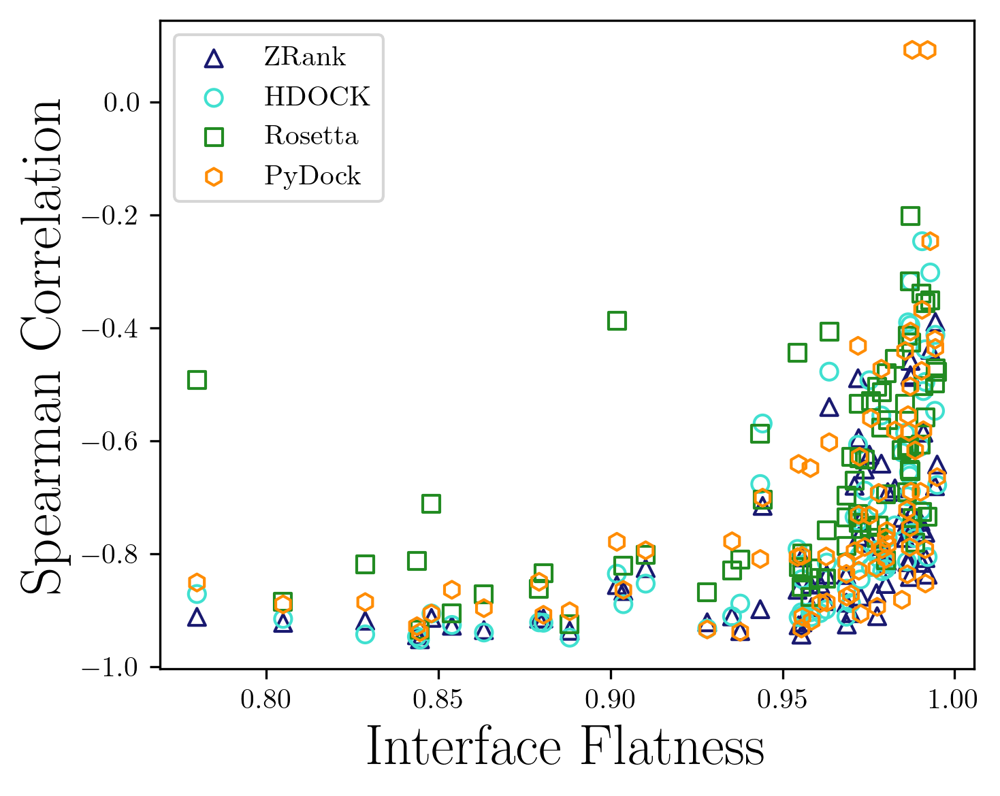

In [47]:
## Correlating Interface Flatness to Spearman Correlation with DOVE scores

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid", "indianred", "magenta"]

## Relaxed and Supersampled

ax.scatter(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_zrank"], color = colors[0], marker = "^",  facecolor = "None", label = "ZRank")
ax.scatter(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_hdock"], color = colors[1], marker = "o", facecolor = "None", label = "HDOCK")
ax.scatter(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_rosetta"], color = colors[2], marker = "s", facecolor = "None", label = "Rosetta")
ax.scatter(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_pydock"], color = colors[3], marker = "h", facecolor = "None", label = "PyDock")
# ax.scatter(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_dove"], color = colors[5], marker = "p", facecolor = "None", label = "Dove (Fold -1)")
# ax.scatter(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_dove_5"], color = colors[6], marker = "P", facecolor = "None", label = "Dove (Fold 5)")
# ax.scatter(ss_corr_df["flatness_p3"], np.array(ss_corr_df["spearman_dockq_voromqa"])*-1, color = colors[4], marker = "*", facecolor = "None", label = "VoroMQA")

print(spearmanr(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_zrank"]))
print(spearmanr(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_hdock"]))
print(spearmanr(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_rosetta"]))
print(spearmanr(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_pydock"]))
print(spearmanr(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_voromqa"]))

ax.set_xlabel("Interface Flatness", fontsize = 20)
ax.set_ylabel("Spearman Correlation", fontsize = 20)


plt.legend()
fig.tight_layout()

In [230]:
ss_corr_df[ss_corr_df["flatness_p3"] == min(ss_corr_df["flatness_p3"])]

,pdb,pearson_ialign_zrank,pearson_ialign_hdock,pearson_ialign_rosetta,pearson_ialign_pydock,pearson_ialign_voromqa,pearson_ialign_voromqa_js,pearson_ialign_dove_5,pearson_ialign_intertwined,pearson_ialign_deeprank_gnn_esm,...,contact_42_auc,contact_43_auc,contact_44_auc,contact_45_auc,interface_rsa_auc,flatness_p3,resolution,complex_sasa,monomer_sasa,relative_interface_sasa
6,1itb,-0.875987,-0.84115,-0.537481,-0.812798,-0.223361,-0.229232,-0.652779,-0.591254,-0.106991,...,0.958492,0.959047,0.959134,0.958685,0.966142,0.779851,2.5,22494.148135,26228.622019,0.142382


In [234]:
ss_score_dict["1itb"][ss_score_dict["1itb"]["CAPRI"] == "Incorrect"]

,Decoy,Model,Fnat,iRMSD,LRMSD,CAPRI,DockQ,IS-Score,ZRank,HDOCK,...,Contact_45,Interface_rsa,ZRank Z-score,HDOCK Z-score,Rosetta Z-score,PyDock Z-score,VoroMQA Z-score,VoroMQA_js Z-score,Dove_5 Z-score,Deeprank_gnn_esm Z-score
0,relaxed_1itb_model_1,-1,0.000,26.708,49.357,Incorrect,0.011,0.0806,-58.4376,-19877.92,...,127,0.034207,1.276776,0.875032,-0.826342,2.563480,0.598895,0.433922,0.258101,-0.213964
1,relaxed_1itb_model_10,-1,0.000,24.682,46.127,Incorrect,0.012,0.0806,-50.6233,-19716.17,...,101,0.015353,1.398322,1.451649,0.256055,1.937118,2.669986,1.766956,-0.164654,-0.652390
2,relaxed_1itb_model_100,-1,0.143,10.583,18.373,Incorrect,0.113,0.1587,-138.5230,-19981.74,...,240,0.048719,0.031111,0.504928,0.375030,0.218589,-0.728052,0.825991,1.595205,-0.323570
3,relaxed_1itb_model_101,-1,0.089,6.714,14.931,Incorrect,0.127,0.1475,-135.8170,-20202.65,...,341,0.088107,0.073201,-0.282585,0.169465,-0.296405,-0.937149,-0.309376,0.007090,-0.260938
4,relaxed_1itb_model_102,-1,0.152,9.864,18.020,Incorrect,0.119,0.1826,-105.8350,-19759.21,...,165,0.027836,0.539547,1.298217,-0.392198,0.384906,-0.578136,1.468004,0.087747,-0.683706
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
349,relaxed_1itb_model_425,-1,0.000,30.225,59.057,Incorrect,0.008,0.0806,-54.2681,-19761.60,...,123,0.012232,1.341630,1.289697,0.820382,0.933575,-1.655673,0.870098,-0.167436,-0.761997
350,relaxed_1itb_model_426,-1,0.000,30.507,61.854,Incorrect,0.007,0.0806,-72.2861,-19748.18,...,141,0.018308,1.061374,1.337538,0.433644,0.702260,0.111108,1.365086,-0.045059,0.412360
351,relaxed_1itb_model_427,-1,0.000,28.279,50.877,Incorrect,0.010,0.0806,-113.3440,-19891.42,...,286,0.039717,0.422751,0.826907,2.740014,0.535473,0.599322,1.126577,1.111261,4.138983
352,relaxed_1itb_model_428,-1,0.000,32.857,63.776,Incorrect,0.007,0.0806,-57.7682,-19879.67,...,106,0.018143,1.287188,0.868794,-0.587565,0.452197,2.650532,1.510478,-0.204288,3.293447


# Figure 5: Fraction Core Interface

SpearmanrResult(correlation=-0.3520187181895764, pvalue=0.0015746152328056037)
SpearmanrResult(correlation=-0.3612633987355287, pvalue=0.001155792157528556)
SpearmanrResult(correlation=-0.4211072131588473, pvalue=0.0001234239963733508)
SpearmanrResult(correlation=-0.2639349972558455, pvalue=0.01954634610870602)
SpearmanrResult(correlation=0.3502228978920043, pvalue=0.001670328739758123)
(-0.2981027133955776, 0.008029507732592332)
(-0.35527001367170796, 0.0014138317460378838)
(-0.3978809784961479, 0.000309271283247023)
(-0.08838877158761896, 0.4415769195132725)
(0.31135526974199657, 0.005524432115808047)


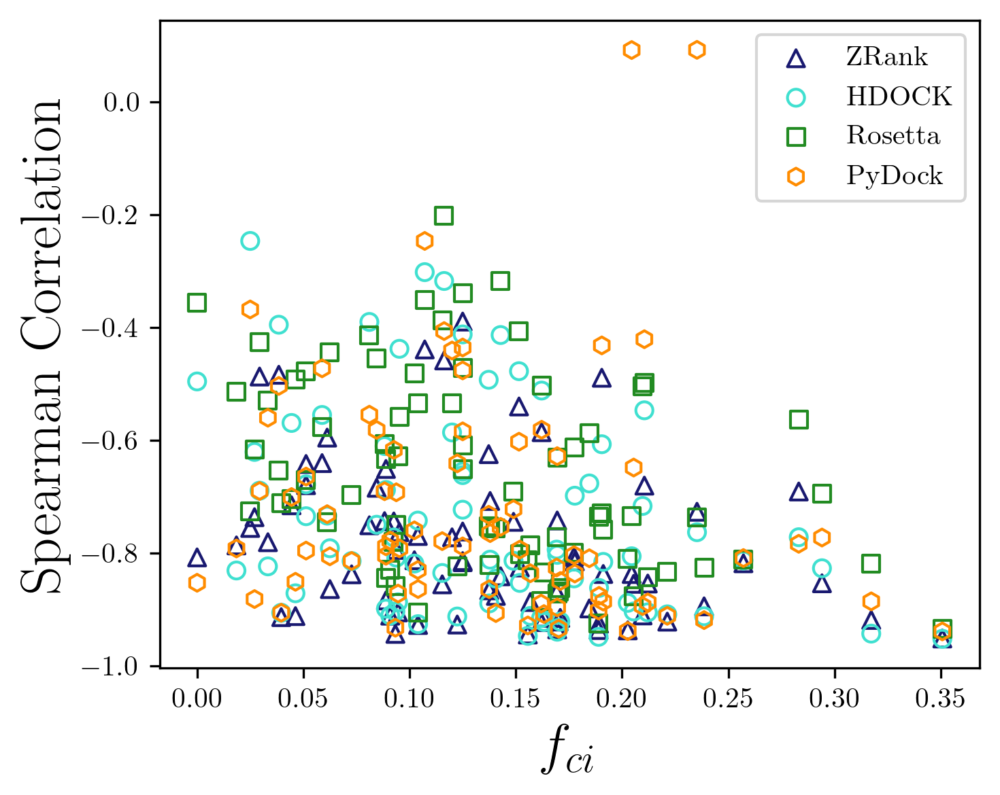

In [566]:
## Correlating Fraction core interface residues to Spearman Correlation

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid"]

## Relaxed and Supersampled

ax.scatter(ss_corr_df["fci"], ss_corr_df["spearman_dockq_zrank"], color = colors[0], marker = "^",  facecolor = "None", label = "ZRank")
ax.scatter(ss_corr_df["fci"], ss_corr_df["spearman_dockq_hdock"], color = colors[1], marker = "o", facecolor = "None", label = "HDOCK")
ax.scatter(ss_corr_df["fci"], ss_corr_df["spearman_dockq_rosetta"], color = colors[2], marker = "s", facecolor = "None", label = "Rosetta")
ax.scatter(ss_corr_df["fci"], ss_corr_df["spearman_dockq_pydock"], color = colors[3], marker = "h", facecolor = "None", label = "PyDock")
# ax.scatter(ss_corr_df["fci"], np.array(ss_corr_df["spearman_dockq_voromqa"])*-1, color = colors[4], marker = "*", facecolor = "None", label = "VoroMQA")

print(spearmanr(ss_corr_df["fci"], ss_corr_df["spearman_dockq_zrank"]))
print(spearmanr(ss_corr_df["fci"], ss_corr_df["spearman_dockq_hdock"]))
print(spearmanr(ss_corr_df["fci"], ss_corr_df["spearman_dockq_rosetta"]))
print(spearmanr(ss_corr_df["fci"], ss_corr_df["spearman_dockq_pydock"]))
print(spearmanr(ss_corr_df["fci"], ss_corr_df["spearman_dockq_voromqa"]))

print(pearsonr(ss_corr_df["fci"], ss_corr_df["spearman_dockq_zrank"]))
print(pearsonr(ss_corr_df["fci"], ss_corr_df["spearman_dockq_hdock"]))
print(pearsonr(ss_corr_df["fci"], ss_corr_df["spearman_dockq_rosetta"]))
print(pearsonr(ss_corr_df["fci"], ss_corr_df["spearman_dockq_pydock"]))
print(pearsonr(ss_corr_df["fci"], ss_corr_df["spearman_dockq_voromqa"]))

ax.set_xlabel("$f_{ci}$", fontsize = 20)
ax.set_ylabel("Spearman Correlation", fontsize = 20)


plt.legend()
fig.tight_layout()

-0.6261539240238636
-0.65253294221055
-0.6279116821868307
-0.493006904614649
0.46146842361867785
-0.4095019856034402
-0.45259807450715384
-0.4506496769238779
-0.32210817310980067
0.3611083182918039


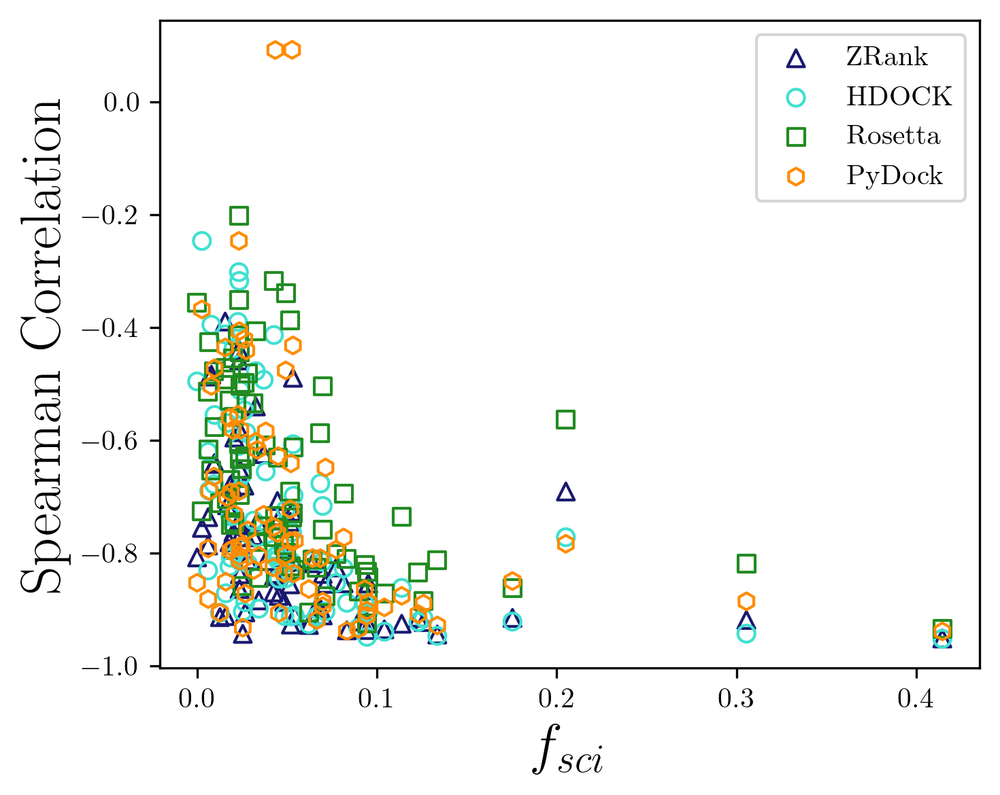

In [567]:
## Correlating Fraction core interface residues to Spearman Correlation

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid"]

## Relaxed and Supersampled

ax.scatter(ss_corr_df["fsci"], ss_corr_df["spearman_dockq_zrank"], color = colors[0], marker = "^",  facecolor = "None", label = "ZRank")
ax.scatter(ss_corr_df["fsci"], ss_corr_df["spearman_dockq_hdock"], color = colors[1], marker = "o", facecolor = "None", label = "HDOCK")
ax.scatter(ss_corr_df["fsci"], ss_corr_df["spearman_dockq_rosetta"], color = colors[2], marker = "s", facecolor = "None", label = "Rosetta")
ax.scatter(ss_corr_df["fsci"], ss_corr_df["spearman_dockq_pydock"], color = colors[3], marker = "h", facecolor = "None", label = "PyDock")
# ax.scatter(ss_corr_df["fci"], np.array(ss_corr_df["spearman_dockq_voromqa"])*-1, color = colors[4], marker = "*", facecolor = "None", label = "VoroMQA")

print(spearmanr(ss_corr_df["fsci"], ss_corr_df["spearman_dockq_zrank"])[0])
print(spearmanr(ss_corr_df["fsci"], ss_corr_df["spearman_dockq_hdock"])[0])
print(spearmanr(ss_corr_df["fsci"], ss_corr_df["spearman_dockq_rosetta"])[0])
print(spearmanr(ss_corr_df["fsci"], ss_corr_df["spearman_dockq_pydock"])[0])
print(spearmanr(ss_corr_df["fsci"], ss_corr_df["spearman_dockq_voromqa"])[0])

print(pearsonr(ss_corr_df["fsci"], ss_corr_df["spearman_dockq_zrank"])[0])
print(pearsonr(ss_corr_df["fsci"], ss_corr_df["spearman_dockq_hdock"])[0])
print(pearsonr(ss_corr_df["fsci"], ss_corr_df["spearman_dockq_rosetta"])[0])
print(pearsonr(ss_corr_df["fsci"], ss_corr_df["spearman_dockq_pydock"])[0])
print(pearsonr(ss_corr_df["fsci"], ss_corr_df["spearman_dockq_voromqa"])[0])

ax.set_xlabel("$f_{sci}$", fontsize = 20)
ax.set_ylabel("Spearman Correlation", fontsize = 20)


plt.legend()
fig.tight_layout()

SpearmanrResult(correlation=0.5478306408309382, pvalue=0.00020938272218284183)
SpearmanrResult(correlation=0.5380728431571048, pvalue=0.0002850813450535395)
SpearmanrResult(correlation=0.4417145911279989, pvalue=0.0038374741977923593)
SpearmanrResult(correlation=0.5866875851392396, pvalue=5.5450092357001264e-05)
SpearmanrResult(correlation=0.3329848456195684, pvalue=0.033392391012478366)
(0.43373389040137034, 0.004610468231537128)
(0.4751345566848507, 0.0016943303529639)
(0.35995829309182653, 0.02079589539130637)
(0.45907062306414675, 0.0025355327146161437)
(0.31133266671523696, 0.04754616964108912)


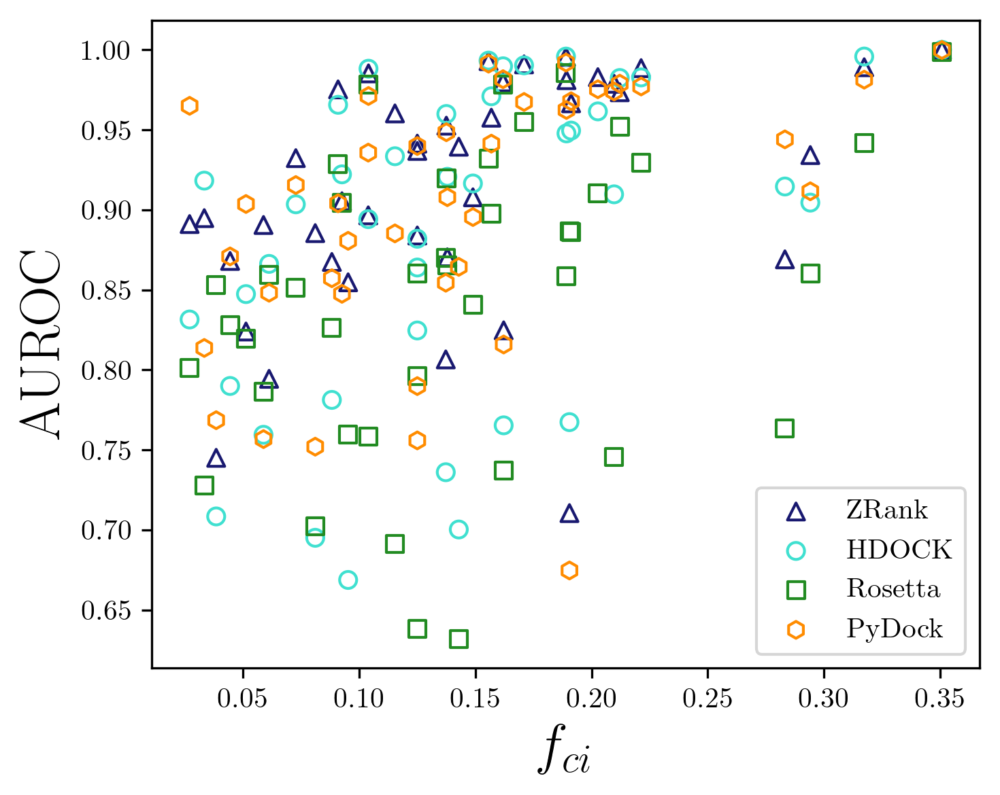

In [222]:
## Correlating Fraction core interface residues to Spearman Correlation

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid"]

## Relaxed and Supersampled

ax.scatter(ss_corr_df["fci"], ss_corr_df["zrank_auc"], color = colors[0], marker = "^",  facecolor = "None", label = "ZRank")
ax.scatter(ss_corr_df["fci"], ss_corr_df["hdock_auc"], color = colors[1], marker = "o", facecolor = "None", label = "HDOCK")
ax.scatter(ss_corr_df["fci"], ss_corr_df["rosetta_auc"], color = colors[2], marker = "s", facecolor = "None", label = "Rosetta")
ax.scatter(ss_corr_df["fci"], ss_corr_df["pydock_auc"], color = colors[3], marker = "h", facecolor = "None", label = "PyDock")
# ax.scatter(ss_corr_df["fci"], np.array(ss_corr_df["voromqa_auc"]), color = colors[4], marker = "*", facecolor = "None", label = "VoroMQA")

print(spearmanr(ss_corr_df["fci"], ss_corr_df["zrank_auc"]))
print(spearmanr(ss_corr_df["fci"], ss_corr_df["hdock_auc"]))
print(spearmanr(ss_corr_df["fci"], ss_corr_df["rosetta_auc"]))
print(spearmanr(ss_corr_df["fci"], ss_corr_df["pydock_auc"]))
print(spearmanr(ss_corr_df["fci"], ss_corr_df["voromqa_auc"]))

print(pearsonr(ss_corr_df["fci"], ss_corr_df["zrank_auc"]))
print(pearsonr(ss_corr_df["fci"], ss_corr_df["hdock_auc"]))
print(pearsonr(ss_corr_df["fci"], ss_corr_df["rosetta_auc"]))
print(pearsonr(ss_corr_df["fci"], ss_corr_df["pydock_auc"]))
print(pearsonr(ss_corr_df["fci"], ss_corr_df["voromqa_auc"]))

ax.set_xlabel("$f_{ci}$", fontsize = 20)
ax.set_ylabel("AUROC", fontsize = 20)


plt.legend()
fig.tight_layout()

0.7536042517710683
0.7892329812791445
0.6173613839211145
0.7184981931115214
0.5324273710351138
0.4754158606505602
0.5405756993775516
0.4639492093836614
0.505841094762318
0.469610433207008


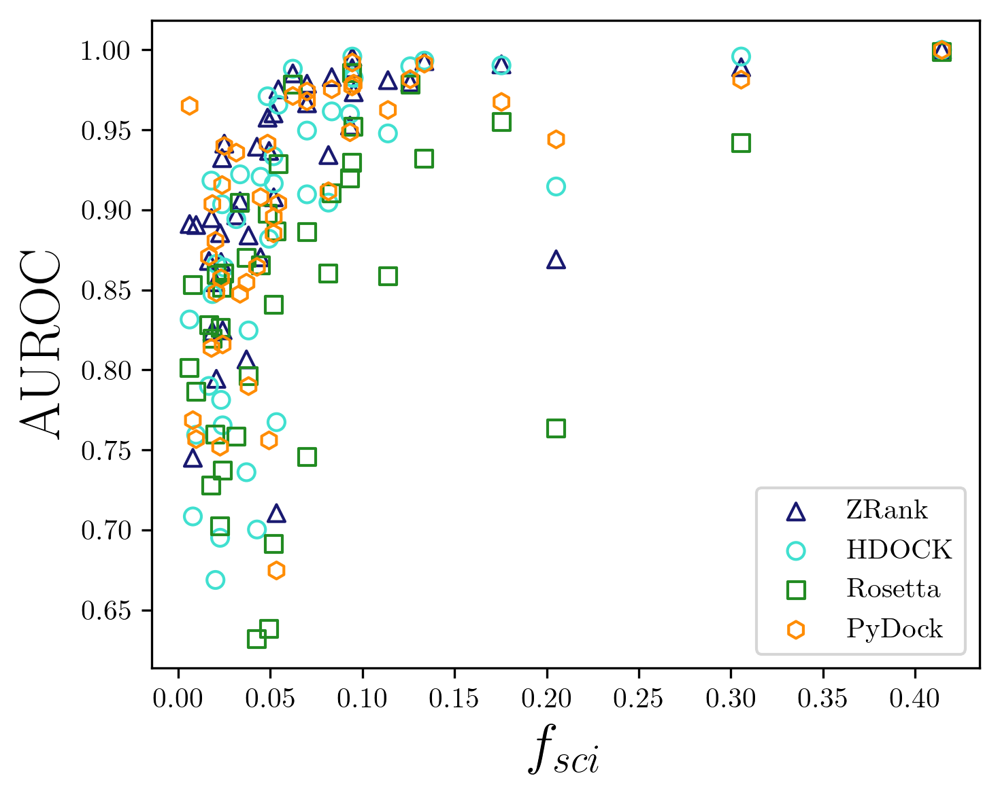

In [237]:
## Correlating Fraction core interface residues to Spearman Correlation

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid"]

## Relaxed and Supersampled

ax.scatter(ss_corr_df["fsci"], ss_corr_df["zrank_auc"], color = colors[0], marker = "^",  facecolor = "None", label = "ZRank")
ax.scatter(ss_corr_df["fsci"], ss_corr_df["hdock_auc"], color = colors[1], marker = "o", facecolor = "None", label = "HDOCK")
ax.scatter(ss_corr_df["fsci"], ss_corr_df["rosetta_auc"], color = colors[2], marker = "s", facecolor = "None", label = "Rosetta")
ax.scatter(ss_corr_df["fsci"], ss_corr_df["pydock_auc"], color = colors[3], marker = "h", facecolor = "None", label = "PyDock")
# ax.scatter(ss_corr_df["fsci"], np.array(ss_corr_df["voromqa_auc"]), color = colors[4], marker = "*", facecolor = "None", label = "VoroMQA")

print(spearmanr(ss_corr_df["fsci"], ss_corr_df["zrank_auc"])[0])
print(spearmanr(ss_corr_df["fsci"], ss_corr_df["hdock_auc"])[0])
print(spearmanr(ss_corr_df["fsci"], ss_corr_df["rosetta_auc"])[0])
print(spearmanr(ss_corr_df["fsci"], ss_corr_df["pydock_auc"])[0])
print(spearmanr(ss_corr_df["fsci"], ss_corr_df["voromqa_auc"])[0])

print(pearsonr(ss_corr_df["fsci"], ss_corr_df["zrank_auc"])[0])
print(pearsonr(ss_corr_df["fsci"], ss_corr_df["hdock_auc"])[0])
print(pearsonr(ss_corr_df["fsci"], ss_corr_df["rosetta_auc"])[0])
print(pearsonr(ss_corr_df["fsci"], ss_corr_df["pydock_auc"])[0])
print(pearsonr(ss_corr_df["fsci"], ss_corr_df["voromqa_auc"])[0])

ax.set_xlabel("$f_{sci}$", fontsize = 20)
ax.set_ylabel("AUROC", fontsize = 20)


plt.legend()
fig.tight_layout()

SpearmanrResult(correlation=0.8663907719382941, pvalue=2.516619208993686e-13)
(0.8066986981882145, 1.9153330501402143e-10)


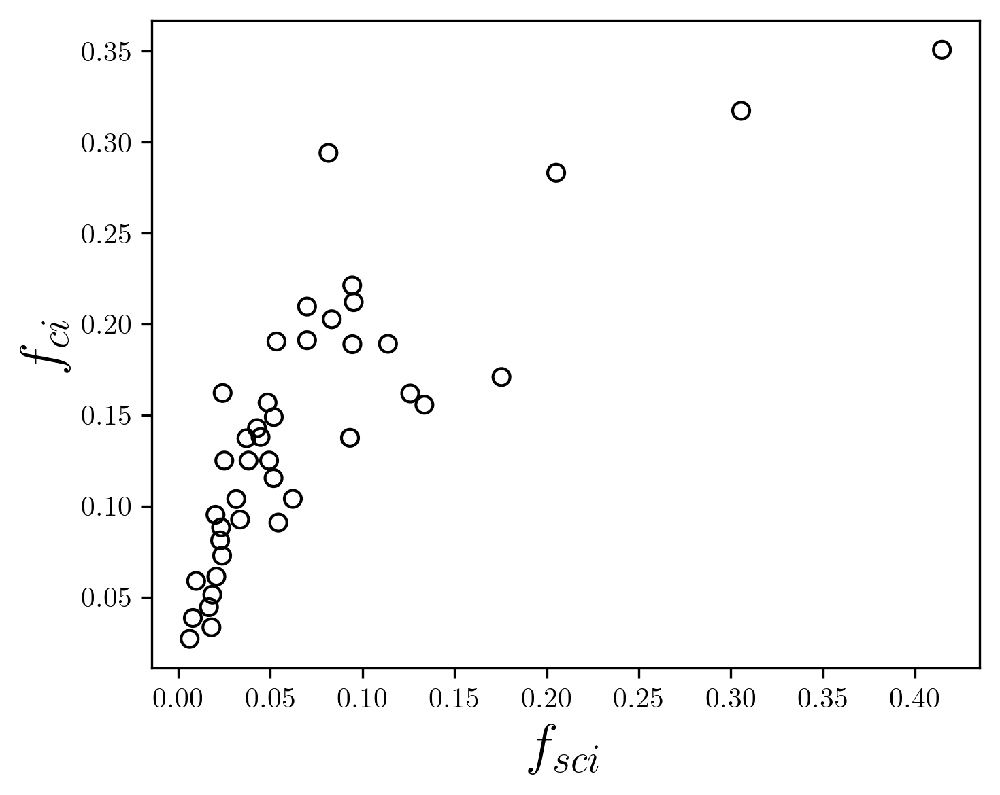

In [282]:
### How correlated are these values - f_ci, f_sci, interface flatness?

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

ax.scatter(ss_corr_df["fsci"], ss_corr_df["fci"], color = "black", marker = "o",  facecolor = "None", label = "")

ax.set_xlabel("$f_{sci}$", fontsize = 20)
ax.set_ylabel("$f_{ci}$", fontsize = 20)

print(spearmanr(ss_corr_df["fsci"], ss_corr_df["fci"]))
print(pearsonr(ss_corr_df["fsci"], ss_corr_df["fci"]))

fig.tight_layout()

SpearmanrResult(correlation=-0.6194520673152315, pvalue=1.5725885915293395e-05)
(-0.6608664051493129, 2.567449079483162e-06)


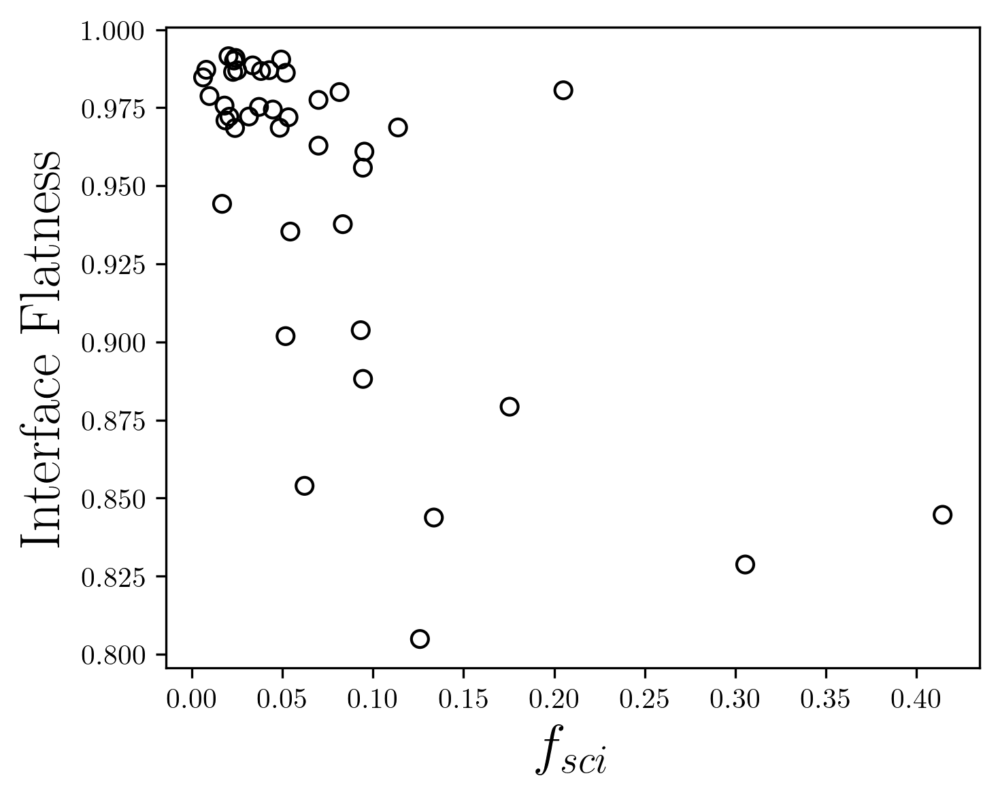

In [281]:
### How correlated are these values - f_ci, f_sci, interface flatness?

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

ax.scatter(ss_corr_df["fsci"], ss_corr_df["flatness_p3"], color = "black", marker = "o",  facecolor = "None", label = "")

ax.set_xlabel("$f_{sci}$", fontsize = 20)
ax.set_ylabel("Interface Flatness", fontsize = 20)

print(spearmanr(ss_corr_df["fsci"], ss_corr_df["flatness_p3"]))
print(pearsonr(ss_corr_df["fsci"], ss_corr_df["flatness_p3"]))

fig.tight_layout()

SpearmanrResult(correlation=-0.34274264329340187, pvalue=0.02825858754154846)
(-0.3763877611418842, 0.015288776881802323)


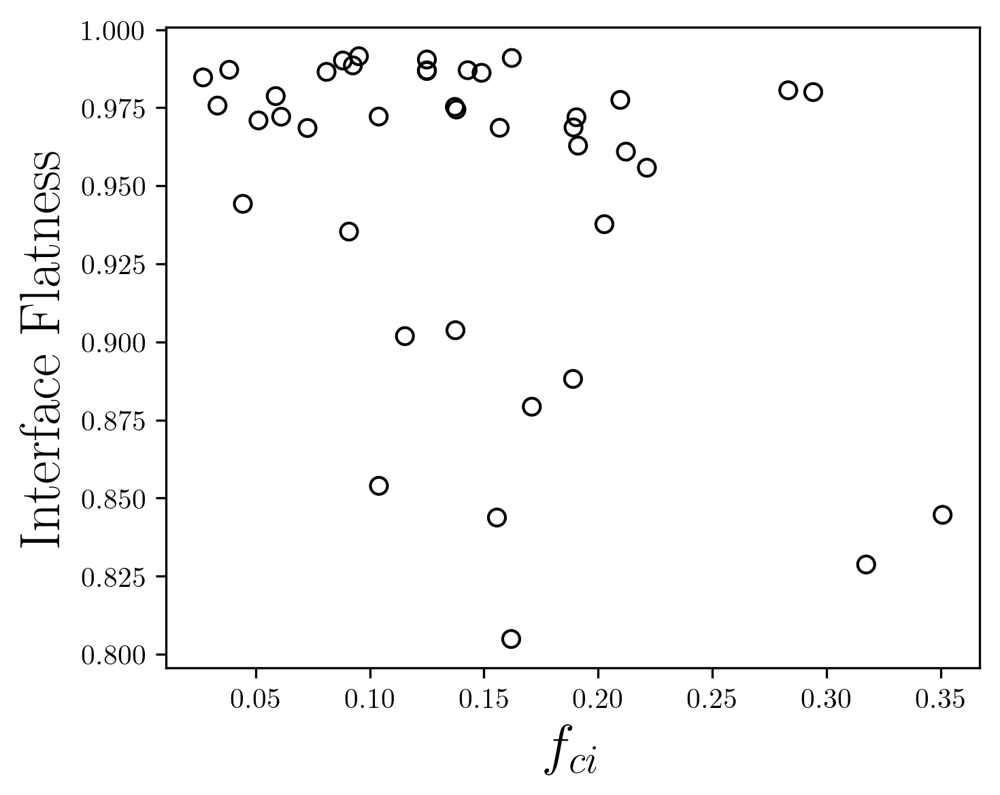

In [280]:
### How correlated are these values - f_ci, f_sci, interface flatness?

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

ax.scatter(ss_corr_df["fci"], ss_corr_df["flatness_p3"], color = "black", marker = "o",  facecolor = "None", label = "")

ax.set_xlabel("$f_{ci}$", fontsize = 20)
ax.set_ylabel("Interface Flatness", fontsize = 20)

print(spearmanr(ss_corr_df["fci"], ss_corr_df["flatness_p3"]))
print(pearsonr(ss_corr_df["fci"], ss_corr_df["flatness_p3"]))

fig.tight_layout()

## Only those with an interface flatness > 0.95

In [159]:
## Simplify getting all the data by creating small dataframes specifically for this analysis

flatness_cutoff = 0.983
flat_pdbs = list(ss_corr_df[ss_corr_df["flatness_p3"] >= flatness_cutoff]['pdb'])
flat_relaxed_corr_df = relaxed_corr_df[relaxed_corr_df["pdb"].isin(flat_pdbs)]
flat_ss_corr_df = ss_corr_df[ss_corr_df["pdb"].isin(flat_pdbs)]

SpearmanrResult(correlation=-0.1982575511265524, pvalue=0.3530576576552886)
SpearmanrResult(correlation=-0.39520790960831437, pvalue=0.05595257955483197)
SpearmanrResult(correlation=-0.13681949682140102, pvalue=0.5237972043656199)
SpearmanrResult(correlation=0.30109003918340155, pvalue=0.15279801762444306)
SpearmanrResult(correlation=0.3756000199364576, pvalue=0.07049578235451619)
(-0.174230381693551, 0.4155067982531422)
(-0.3596548635305484, 0.08431386306209905)
(-0.17220830274306662, 0.42102389484227726)
(0.5056575642698282, 0.011710197969046102)
(0.23297922208063968, 0.2732565241777346)


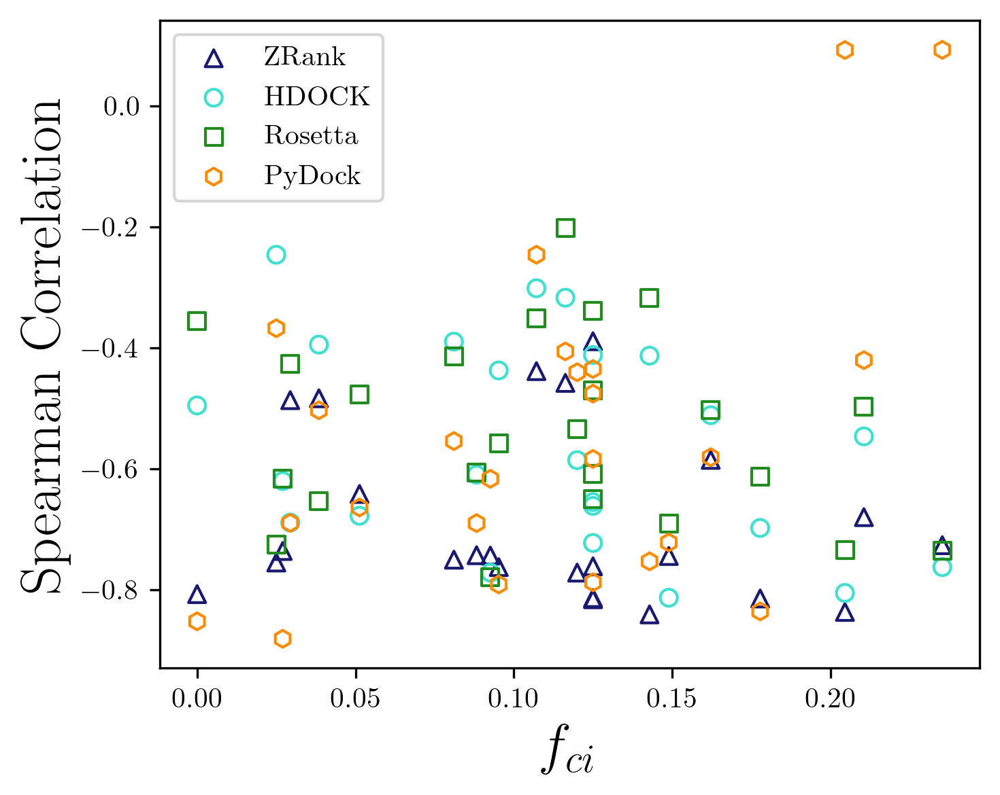

In [161]:
## Correlating Fraction core interface residues to Spearman Correlation

%matplotlib inline

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid"]

## Relaxed and Supersampled

ax.scatter(flat_ss_corr_df["fci"], flat_ss_corr_df["spearman_dockq_zrank"], color = colors[0], marker = "^",  facecolor = "None", label = "ZRank")
ax.scatter(flat_ss_corr_df["fci"], flat_ss_corr_df["spearman_dockq_hdock"], color = colors[1], marker = "o", facecolor = "None", label = "HDOCK")
ax.scatter(flat_ss_corr_df["fci"], flat_ss_corr_df["spearman_dockq_rosetta"], color = colors[2], marker = "s", facecolor = "None", label = "Rosetta")
ax.scatter(flat_ss_corr_df["fci"], flat_ss_corr_df["spearman_dockq_pydock"], color = colors[3], marker = "h", facecolor = "None", label = "PyDock")
# ax.scatter(flat_ss_corr_df["fci"], np.array(flat_ss_corr_df["spearman_dockq_voromqa"])*-1, color = colors[4], marker = "*", facecolor = "None", label = "VoroMQA")

print(spearmanr(flat_ss_corr_df["fci"], flat_ss_corr_df["spearman_dockq_zrank"]))
print(spearmanr(flat_ss_corr_df["fci"], flat_ss_corr_df["spearman_dockq_hdock"]))
print(spearmanr(flat_ss_corr_df["fci"], flat_ss_corr_df["spearman_dockq_rosetta"]))
print(spearmanr(flat_ss_corr_df["fci"], flat_ss_corr_df["spearman_dockq_pydock"]))
print(spearmanr(flat_ss_corr_df["fci"], flat_ss_corr_df["spearman_dockq_voromqa"]))

print(pearsonr(flat_ss_corr_df["fci"], flat_ss_corr_df["spearman_dockq_zrank"]))
print(pearsonr(flat_ss_corr_df["fci"], flat_ss_corr_df["spearman_dockq_hdock"]))
print(pearsonr(flat_ss_corr_df["fci"], flat_ss_corr_df["spearman_dockq_rosetta"]))
print(pearsonr(flat_ss_corr_df["fci"], flat_ss_corr_df["spearman_dockq_pydock"]))
print(pearsonr(flat_ss_corr_df["fci"], flat_ss_corr_df["spearman_dockq_voromqa"]))

ax.set_xlabel("$f_{ci}$", fontsize = 20)
ax.set_ylabel("Spearman Correlation", fontsize = 20)


plt.legend()
fig.tight_layout()

SpearmanrResult(correlation=-0.43618178895876786, pvalue=0.03310506366138338)
SpearmanrResult(correlation=-0.5849097768190856, pvalue=0.002681471356239551)
SpearmanrResult(correlation=-0.21656882442818184, pvalue=0.3094121208219955)
SpearmanrResult(correlation=0.16873233710468788, pvalue=0.4306005683196147)
SpearmanrResult(correlation=0.2878886782559365, pvalue=0.1725179825955356)
(-0.42750319497617695, 0.03718273300238024)
(-0.5383213142817185, 0.006654145568589799)
(-0.19008425089654274, 0.373649835551635)
(0.27777432026482207, 0.1887767345767721)
(0.1402750683619163, 0.5132640092018572)


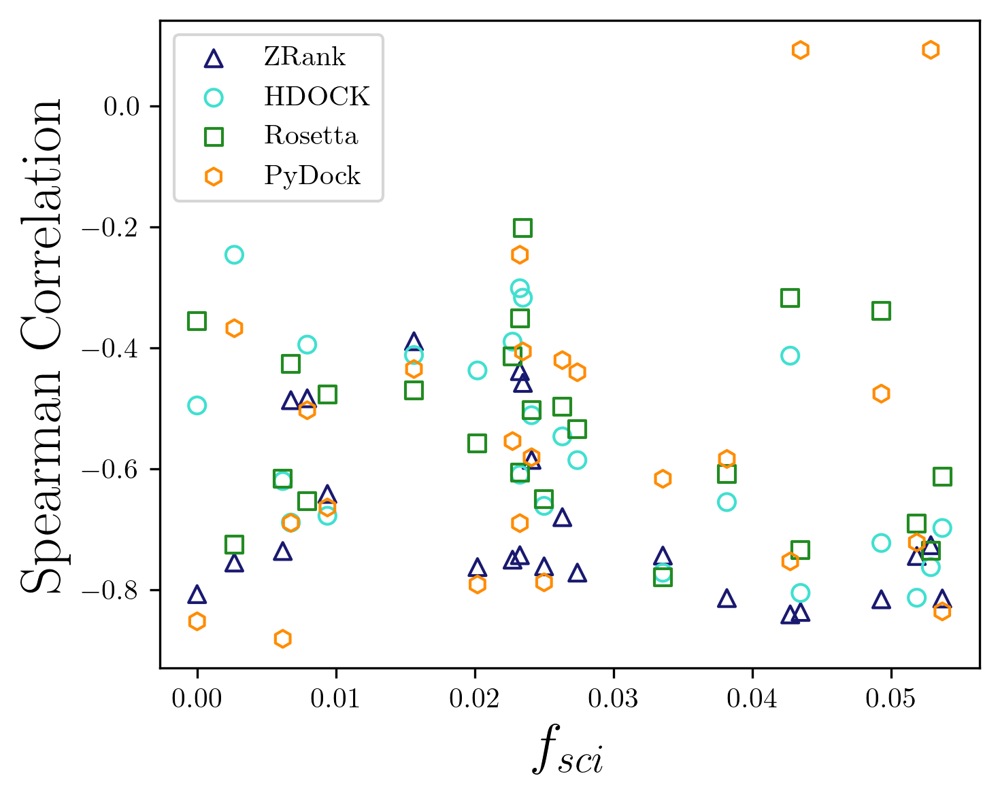

In [163]:
## Correlating Fraction core interface residues to Spearman Correlation

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid"]

## Relaxed and Supersampled

ax.scatter(flat_ss_corr_df["fsci"], flat_ss_corr_df["spearman_dockq_zrank"], color = colors[0], marker = "^",  facecolor = "None", label = "ZRank")
ax.scatter(flat_ss_corr_df["fsci"], flat_ss_corr_df["spearman_dockq_hdock"], color = colors[1], marker = "o", facecolor = "None", label = "HDOCK")
ax.scatter(flat_ss_corr_df["fsci"], flat_ss_corr_df["spearman_dockq_rosetta"], color = colors[2], marker = "s", facecolor = "None", label = "Rosetta")
ax.scatter(flat_ss_corr_df["fsci"], flat_ss_corr_df["spearman_dockq_pydock"], color = colors[3], marker = "h", facecolor = "None", label = "PyDock")
# ax.scatter(flat_ss_corr_df["fsci"], np.array(flat_ss_corr_df["spearman_dockq_voromqa"])*-1, color = colors[4], marker = "*", facecolor = "None", label = "VoroMQA")

print(spearmanr(flat_ss_corr_df["fsci"], flat_ss_corr_df["spearman_dockq_zrank"]))
print(spearmanr(flat_ss_corr_df["fsci"], flat_ss_corr_df["spearman_dockq_hdock"]))
print(spearmanr(flat_ss_corr_df["fsci"], flat_ss_corr_df["spearman_dockq_rosetta"]))
print(spearmanr(flat_ss_corr_df["fsci"], flat_ss_corr_df["spearman_dockq_pydock"]))
print(spearmanr(flat_ss_corr_df["fsci"], flat_ss_corr_df["spearman_dockq_voromqa"]))

print(pearsonr(flat_ss_corr_df["fsci"], flat_ss_corr_df["spearman_dockq_zrank"]))
print(pearsonr(flat_ss_corr_df["fsci"], flat_ss_corr_df["spearman_dockq_hdock"]))
print(pearsonr(flat_ss_corr_df["fsci"], flat_ss_corr_df["spearman_dockq_rosetta"]))
print(pearsonr(flat_ss_corr_df["fsci"], flat_ss_corr_df["spearman_dockq_pydock"]))
print(pearsonr(flat_ss_corr_df["fsci"], flat_ss_corr_df["spearman_dockq_voromqa"]))

ax.set_xlabel("$f_{sci}$", fontsize = 20)
ax.set_ylabel("Spearman Correlation", fontsize = 20)


plt.legend()
fig.tight_layout()

SpearmanrResult(correlation=-0.26347826086956516, pvalue=0.21350236658523813)
SpearmanrResult(correlation=-0.39652173913043476, pvalue=0.05506841408516782)
SpearmanrResult(correlation=-0.1443478260869565, pvalue=0.5009827163280622)
SpearmanrResult(correlation=0.2417391304347826, pvalue=0.2551064662177336)
SpearmanrResult(correlation=0.1660869565217391, pvalue=0.43796690160823903)
(-0.25011686836911695, 0.23849505212581093)
(-0.3129268719261783, 0.13652134451769843)
(-0.10187893019249425, 0.6357176871839451)
(0.4090720120219872, 0.04715782514442498)
(0.03240098358965343, 0.8805302375428317)


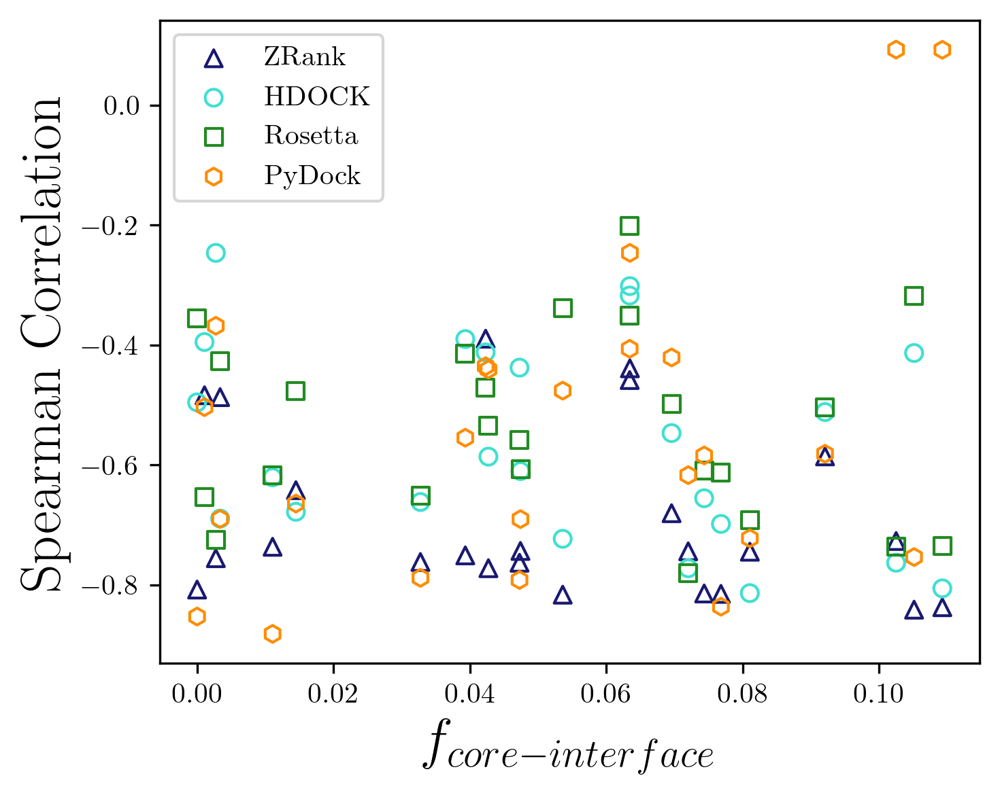

In [164]:
## Correlating Fraction core interface vs Interface residues to Spearman Correlation

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid"]

## Relaxed and Supersampled

ax.scatter(flat_ss_corr_df["fcore_sa_interface"], flat_ss_corr_df["spearman_dockq_zrank"], color = colors[0], marker = "^",  facecolor = "None", label = "ZRank")
ax.scatter(flat_ss_corr_df["fcore_sa_interface"], flat_ss_corr_df["spearman_dockq_hdock"], color = colors[1], marker = "o", facecolor = "None", label = "HDOCK")
ax.scatter(flat_ss_corr_df["fcore_sa_interface"], flat_ss_corr_df["spearman_dockq_rosetta"], color = colors[2], marker = "s", facecolor = "None", label = "Rosetta")
ax.scatter(flat_ss_corr_df["fcore_sa_interface"], flat_ss_corr_df["spearman_dockq_pydock"], color = colors[3], marker = "h", facecolor = "None", label = "PyDock")
# ax.scatter(flat_ss_corr_df["fsci"], np.array(flat_ss_corr_df["spearman_dockq_voromqa"])*-1, color = colors[4], marker = "*", facecolor = "None", label = "VoroMQA")

print(spearmanr(flat_ss_corr_df["fcore_sa_interface"], flat_ss_corr_df["spearman_dockq_zrank"]))
print(spearmanr(flat_ss_corr_df["fcore_sa_interface"], flat_ss_corr_df["spearman_dockq_hdock"]))
print(spearmanr(flat_ss_corr_df["fcore_sa_interface"], flat_ss_corr_df["spearman_dockq_rosetta"]))
print(spearmanr(flat_ss_corr_df["fcore_sa_interface"], flat_ss_corr_df["spearman_dockq_pydock"]))
print(spearmanr(flat_ss_corr_df["fcore_sa_interface"], flat_ss_corr_df["spearman_dockq_voromqa"]))

print(pearsonr(flat_ss_corr_df["fcore_sa_interface"], flat_ss_corr_df["spearman_dockq_zrank"]))
print(pearsonr(flat_ss_corr_df["fcore_sa_interface"], flat_ss_corr_df["spearman_dockq_hdock"]))
print(pearsonr(flat_ss_corr_df["fcore_sa_interface"], flat_ss_corr_df["spearman_dockq_rosetta"]))
print(pearsonr(flat_ss_corr_df["fcore_sa_interface"], flat_ss_corr_df["spearman_dockq_pydock"]))
print(pearsonr(flat_ss_corr_df["fcore_sa_interface"], flat_ss_corr_df["spearman_dockq_voromqa"]))

ax.set_xlabel("$f_{core-interface}$", fontsize = 20)
ax.set_ylabel("Spearman Correlation", fontsize = 20)


plt.legend()
fig.tight_layout()

In [48]:
print(list(ss_corr_df["pdb"]))

['1acb', '1ay7', '1c3a', '1euv', '1f60', '1ggp', '1itb', '1j7d', '1kfu', '1n1j', '1pdk', '1qav', '1r8o', '1spp', '1tfo', '1ugh', '1ugq', '1vet', '1wmh', '1wqj', '1wrd', '1xg2', '2bkr', '2d5r', '2dvw', '2fhz', '2g2u', '2grn', '2h7z', '2hla', '2hsm', '2hth', '2oul', '2pe6', '2wmp', '3dgp', '3fpn', '3gfk', '3k9p', '3ona', '3qc8', '3qhy', '3rcz', '3sgb', '3vz9', '3wdg', '3whq', '3ygs', '4bi8', '4ct6', '4dbg', '4dhi', '4g6t', '4gi3', '4h5s', '4hwi', '4je3', '4k12', '4qjf', '4qlp', '4uzz', '4yii', '5by8', '5dmb', '5k7m', '5maw', '5mu7', '5uq2', '5zrz', '6fud', '6kp3', '6wg4', '6xod', '6zbk', '7bxh', '7joe', '7jxv']


SpearmanrResult(correlation=-0.3817391304347826, pvalue=0.06566315225644624)
SpearmanrResult(correlation=-0.4208695652173913, pvalue=0.04055960072223449)
SpearmanrResult(correlation=-0.10173913043478258, pvalue=0.6361837822056855)
SpearmanrResult(correlation=0.09652173913043478, pvalue=0.6536731719946905)
SpearmanrResult(correlation=0.15826086956521737, pvalue=0.460148912728106)
(-0.406014993269302, 0.04899736605323832)
(-0.40504687560216046, 0.049591444500038426)
(-0.1279585435180337, 0.5512689108200449)
(0.14776594467868456, 0.49078850594464707)
(-0.005093002528562152, 0.9811568165919886)


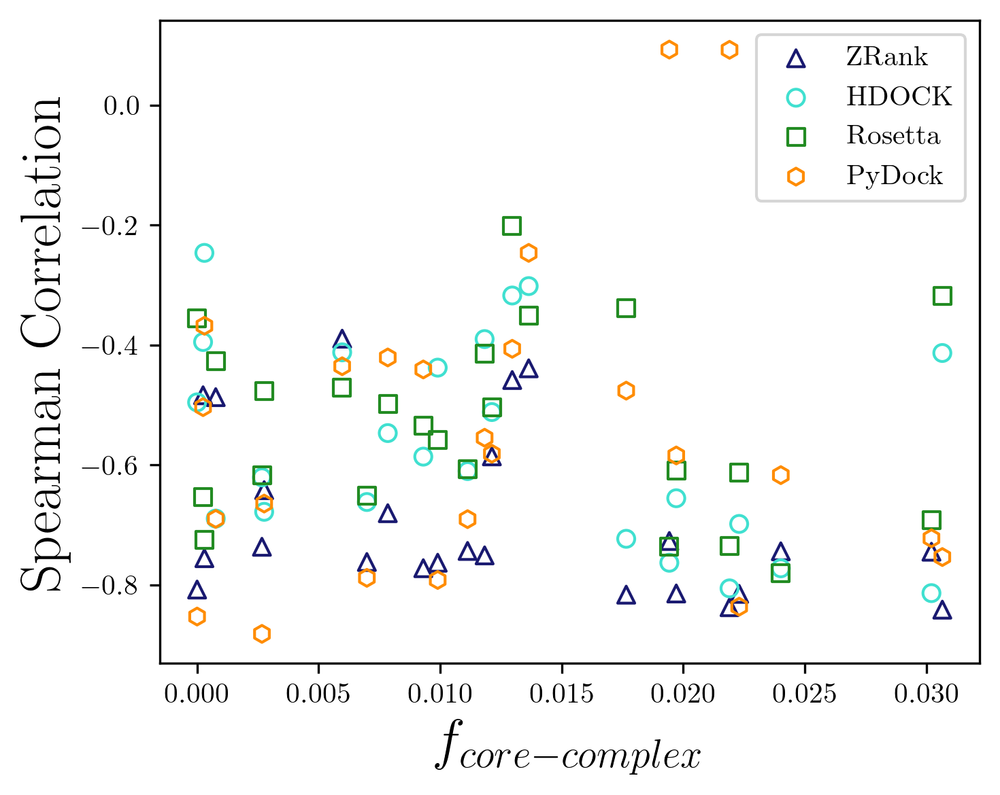

In [165]:
## Correlating Fraction core interface vs Interface residues to Spearman Correlation

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid"]

## Relaxed and Supersampled

ax.scatter(flat_ss_corr_df["fcore_sa_complex"], flat_ss_corr_df["spearman_dockq_zrank"], color = colors[0], marker = "^",  facecolor = "None", label = "ZRank")
ax.scatter(flat_ss_corr_df["fcore_sa_complex"], flat_ss_corr_df["spearman_dockq_hdock"], color = colors[1], marker = "o", facecolor = "None", label = "HDOCK")
ax.scatter(flat_ss_corr_df["fcore_sa_complex"], flat_ss_corr_df["spearman_dockq_rosetta"], color = colors[2], marker = "s", facecolor = "None", label = "Rosetta")
ax.scatter(flat_ss_corr_df["fcore_sa_complex"], flat_ss_corr_df["spearman_dockq_pydock"], color = colors[3], marker = "h", facecolor = "None", label = "PyDock")
# ax.scatter(flat_ss_corr_df["fsci"], np.array(flat_ss_corr_df["spearman_dockq_voromqa"])*-1, color = colors[4], marker = "*", facecolor = "None", label = "VoroMQA")

print(spearmanr(flat_ss_corr_df["fcore_sa_complex"], flat_ss_corr_df["spearman_dockq_zrank"]))
print(spearmanr(flat_ss_corr_df["fcore_sa_complex"], flat_ss_corr_df["spearman_dockq_hdock"]))
print(spearmanr(flat_ss_corr_df["fcore_sa_complex"], flat_ss_corr_df["spearman_dockq_rosetta"]))
print(spearmanr(flat_ss_corr_df["fcore_sa_complex"], flat_ss_corr_df["spearman_dockq_pydock"]))
print(spearmanr(flat_ss_corr_df["fcore_sa_complex"], flat_ss_corr_df["spearman_dockq_voromqa"]))

print(pearsonr(flat_ss_corr_df["fcore_sa_complex"], flat_ss_corr_df["spearman_dockq_zrank"]))
print(pearsonr(flat_ss_corr_df["fcore_sa_complex"], flat_ss_corr_df["spearman_dockq_hdock"]))
print(pearsonr(flat_ss_corr_df["fcore_sa_complex"], flat_ss_corr_df["spearman_dockq_rosetta"]))
print(pearsonr(flat_ss_corr_df["fcore_sa_complex"], flat_ss_corr_df["spearman_dockq_pydock"]))
print(pearsonr(flat_ss_corr_df["fcore_sa_complex"], flat_ss_corr_df["spearman_dockq_voromqa"]))

ax.set_xlabel("$f_{core-complex}$", fontsize = 20)
ax.set_ylabel("Spearman Correlation", fontsize = 20)


plt.legend()
fig.tight_layout()

<IPython.core.display.Javascript object>


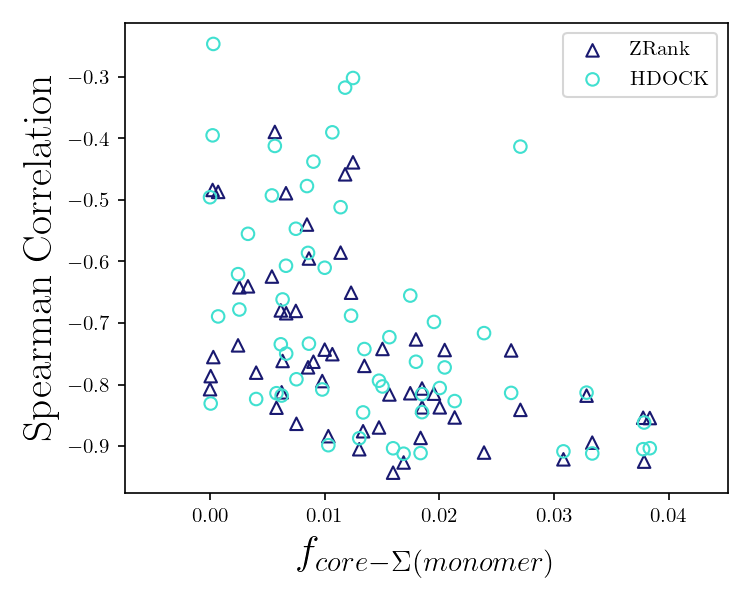

SpearmanrResult(correlation=-0.5371743209572735, pvalue=1.3767617753212322e-05)
SpearmanrResult(correlation=-0.4970623519640715, pvalue=7.213446403931747e-05)
SpearmanrResult(correlation=-0.4335722415331139, pvalue=0.0006740794130877001)
SpearmanrResult(correlation=-0.30167030668430284, pvalue=0.021372454453146818)
SpearmanrResult(correlation=0.32320280537697255, pvalue=0.013335987675097317)
(-0.19691385518997295, 0.13845888857264407)
(-0.27917311778093773, 0.03381841629287327)
(-0.17279220343424617, 0.19460326495595442)
(-0.15853448092624872, 0.23459142388435938)
(0.20845909359444986, 0.11633981094939243)


In [130]:
## Correlating Fraction core interface vs Interface residues to Spearman Correlation
%matplotlib notebook

fig, ax = plt.subplots(figsize = (5,4), dpi = 150)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid"]

## Relaxed and Supersampled

ax.scatter(flat_ss_corr_df["fcore_sa_monomer"], flat_ss_corr_df["spearman_dockq_zrank"], color = colors[0], marker = "^",  facecolor = "None", label = "ZRank")
ax.scatter(flat_ss_corr_df["fcore_sa_monomer"], flat_ss_corr_df["spearman_dockq_hdock"], color = colors[1], marker = "o", facecolor = "None", label = "HDOCK")
# ax.scatter(flat_ss_corr_df["fcore_sa_monomer"], flat_ss_corr_df["spearman_dockq_rosetta"], color = colors[2], marker = "s", facecolor = "None", label = "Rosetta")
# ax.scatter(flat_ss_corr_df["fcore_sa_monomer"], flat_ss_corr_df["spearman_dockq_pydock"], color = colors[3], marker = "h", facecolor = "None", label = "PyDock")
# ax.scatter(flat_ss_corr_df["fsci"], np.array(flat_ss_corr_df["spearman_dockq_voromqa"])*-1, color = colors[4], marker = "*", facecolor = "None", label = "VoroMQA")

print(spearmanr(flat_ss_corr_df["fcore_sa_monomer"], flat_ss_corr_df["spearman_dockq_zrank"]))
print(spearmanr(flat_ss_corr_df["fcore_sa_monomer"], flat_ss_corr_df["spearman_dockq_hdock"]))
print(spearmanr(flat_ss_corr_df["fcore_sa_monomer"], flat_ss_corr_df["spearman_dockq_rosetta"]))
print(spearmanr(flat_ss_corr_df["fcore_sa_monomer"], flat_ss_corr_df["spearman_dockq_pydock"]))
print(spearmanr(flat_ss_corr_df["fcore_sa_monomer"], flat_ss_corr_df["spearman_dockq_voromqa"]))

print(pearsonr(flat_ss_corr_df["fcore_sa_monomer"], flat_ss_corr_df["spearman_dockq_zrank"]))
print(pearsonr(flat_ss_corr_df["fcore_sa_monomer"], flat_ss_corr_df["spearman_dockq_hdock"]))
print(pearsonr(flat_ss_corr_df["fcore_sa_monomer"], flat_ss_corr_df["spearman_dockq_rosetta"]))
print(pearsonr(flat_ss_corr_df["fcore_sa_monomer"], flat_ss_corr_df["spearman_dockq_pydock"]))
print(pearsonr(flat_ss_corr_df["fcore_sa_monomer"], flat_ss_corr_df["spearman_dockq_voromqa"]))

ax.set_xlabel("$f_{core-\Sigma (monomer)}$", fontsize = 20)
ax.set_ylabel("Spearman Correlation", fontsize = 20)


plt.legend()
fig.tight_layout()

SpearmanrResult(correlation=-0.42068965517241375, pvalue=0.02305944721768225)
SpearmanrResult(correlation=-0.7147783251231525, pvalue=1.3227077935502407e-05)
SpearmanrResult(correlation=-0.3236453201970443, pvalue=0.08677498429132277)
SpearmanrResult(correlation=-0.35911330049261075, pvalue=0.055723544434525374)
SpearmanrResult(correlation=0.3177339901477832, pvalue=0.09302927713266362)
(-0.2769141116777049, 0.145877656164408)
(-0.5185001910072231, 0.003957093208143131)
(-0.09691483298861762, 0.6169868603514163)
(-0.2617303693911137, 0.17021607971951266)
(0.2083592186116866, 0.27807568754199186)


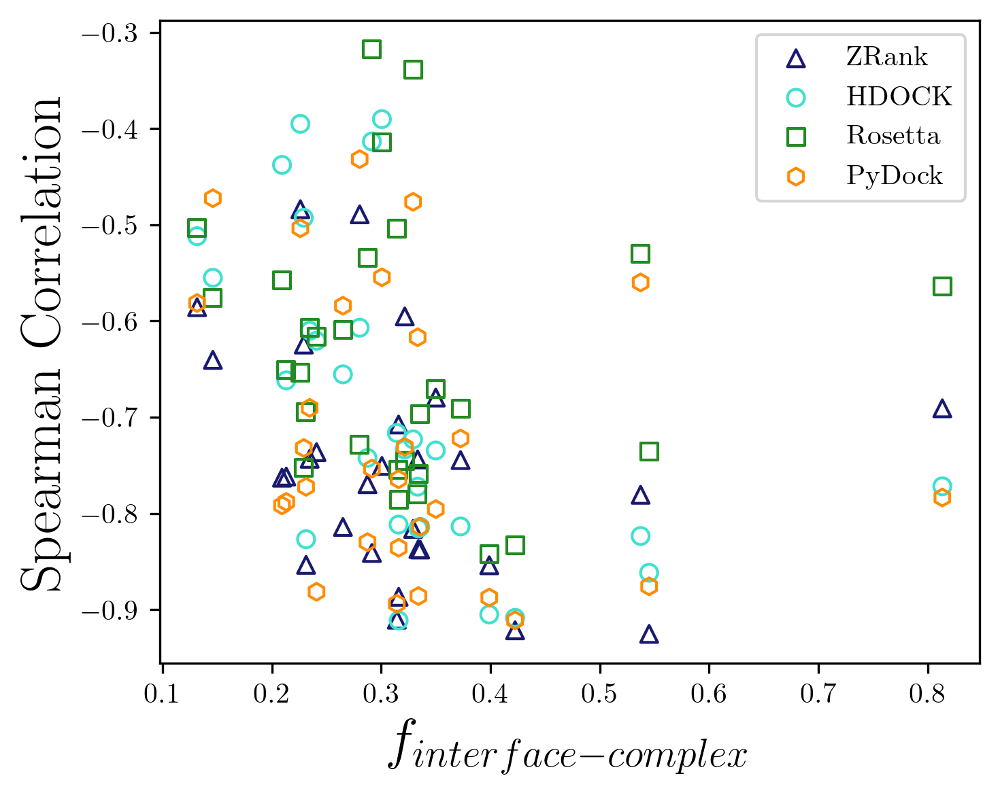

In [358]:
## Correlating Fraction core interface vs Interface residues to Spearman Correlation

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid"]

## Relaxed and Supersampled

ax.scatter(flat_ss_corr_df["finterface_complex"], flat_ss_corr_df["spearman_dockq_zrank"], color = colors[0], marker = "^",  facecolor = "None", label = "ZRank")
ax.scatter(flat_ss_corr_df["finterface_complex"], flat_ss_corr_df["spearman_dockq_hdock"], color = colors[1], marker = "o", facecolor = "None", label = "HDOCK")
ax.scatter(flat_ss_corr_df["finterface_complex"], flat_ss_corr_df["spearman_dockq_rosetta"], color = colors[2], marker = "s", facecolor = "None", label = "Rosetta")
ax.scatter(flat_ss_corr_df["finterface_complex"], flat_ss_corr_df["spearman_dockq_pydock"], color = colors[3], marker = "h", facecolor = "None", label = "PyDock")
# ax.scatter(flat_ss_corr_df["fsci"], np.array(flat_ss_corr_df["spearman_dockq_voromqa"])*-1, color = colors[4], marker = "*", facecolor = "None", label = "VoroMQA")

print(spearmanr(flat_ss_corr_df["finterface_complex"], flat_ss_corr_df["spearman_dockq_zrank"]))
print(spearmanr(flat_ss_corr_df["finterface_complex"], flat_ss_corr_df["spearman_dockq_hdock"]))
print(spearmanr(flat_ss_corr_df["finterface_complex"], flat_ss_corr_df["spearman_dockq_rosetta"]))
print(spearmanr(flat_ss_corr_df["finterface_complex"], flat_ss_corr_df["spearman_dockq_pydock"]))
print(spearmanr(flat_ss_corr_df["finterface_complex"], flat_ss_corr_df["spearman_dockq_voromqa"]))

print(pearsonr(flat_ss_corr_df["finterface_complex"], flat_ss_corr_df["spearman_dockq_zrank"]))
print(pearsonr(flat_ss_corr_df["finterface_complex"], flat_ss_corr_df["spearman_dockq_hdock"]))
print(pearsonr(flat_ss_corr_df["finterface_complex"], flat_ss_corr_df["spearman_dockq_rosetta"]))
print(pearsonr(flat_ss_corr_df["finterface_complex"], flat_ss_corr_df["spearman_dockq_pydock"]))
print(pearsonr(flat_ss_corr_df["finterface_complex"], flat_ss_corr_df["spearman_dockq_voromqa"]))

ax.set_xlabel("$f_{interface-complex}$", fontsize = 20)
ax.set_ylabel("Spearman Correlation", fontsize = 20)


plt.legend()
fig.tight_layout()

SpearmanrResult(correlation=-0.39950738916256145, pvalue=0.03178565194072386)
SpearmanrResult(correlation=-0.692118226600985, pvalue=3.1914728268677534e-05)
SpearmanrResult(correlation=-0.2871921182266009, pvalue=0.1308966508594674)
SpearmanrResult(correlation=-0.3231527093596058, pvalue=0.08728361045384748)
SpearmanrResult(correlation=0.30788177339901474, pvalue=0.10420305730369814)
(-0.23043157094387906, 0.22913346826840536)
(-0.47573547851560405, 0.009095835114713591)
(-0.06035345486662348, 0.7558002777259661)
(-0.23745724237077864, 0.21485288961434412)
(0.2073614072330507, 0.2804355198308943)


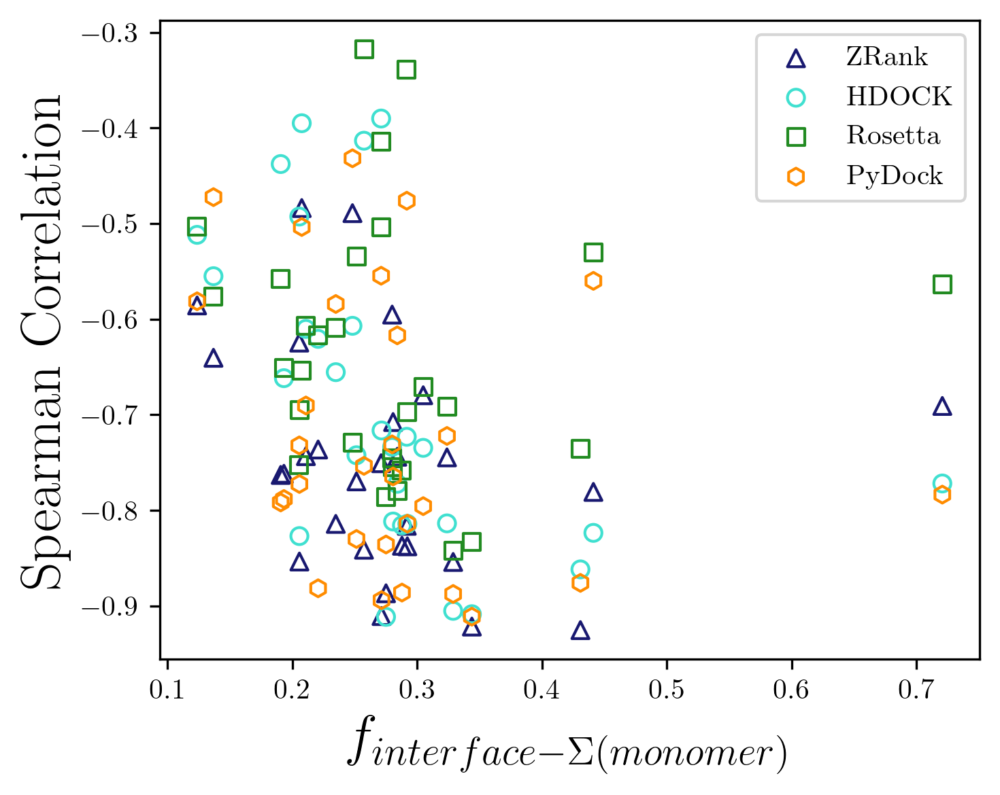

In [360]:
## Correlating Fraction core interface vs Interface residues to Spearman Correlation

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid"]

## Relaxed and Supersampled

ax.scatter(flat_ss_corr_df["finterface_monomer"], flat_ss_corr_df["spearman_dockq_zrank"], color = colors[0], marker = "^",  facecolor = "None", label = "ZRank")
ax.scatter(flat_ss_corr_df["finterface_monomer"], flat_ss_corr_df["spearman_dockq_hdock"], color = colors[1], marker = "o", facecolor = "None", label = "HDOCK")
ax.scatter(flat_ss_corr_df["finterface_monomer"], flat_ss_corr_df["spearman_dockq_rosetta"], color = colors[2], marker = "s", facecolor = "None", label = "Rosetta")
ax.scatter(flat_ss_corr_df["finterface_monomer"], flat_ss_corr_df["spearman_dockq_pydock"], color = colors[3], marker = "h", facecolor = "None", label = "PyDock")
# ax.scatter(flat_ss_corr_df["fsci"], np.array(flat_ss_corr_df["spearman_dockq_voromqa"])*-1, color = colors[4], marker = "*", facecolor = "None", label = "VoroMQA")

print(spearmanr(flat_ss_corr_df["finterface_monomer"], flat_ss_corr_df["spearman_dockq_zrank"]))
print(spearmanr(flat_ss_corr_df["finterface_monomer"], flat_ss_corr_df["spearman_dockq_hdock"]))
print(spearmanr(flat_ss_corr_df["finterface_monomer"], flat_ss_corr_df["spearman_dockq_rosetta"]))
print(spearmanr(flat_ss_corr_df["finterface_monomer"], flat_ss_corr_df["spearman_dockq_pydock"]))
print(spearmanr(flat_ss_corr_df["finterface_monomer"], flat_ss_corr_df["spearman_dockq_voromqa"]))

print(pearsonr(flat_ss_corr_df["finterface_monomer"], flat_ss_corr_df["spearman_dockq_zrank"]))
print(pearsonr(flat_ss_corr_df["finterface_monomer"], flat_ss_corr_df["spearman_dockq_hdock"]))
print(pearsonr(flat_ss_corr_df["finterface_monomer"], flat_ss_corr_df["spearman_dockq_rosetta"]))
print(pearsonr(flat_ss_corr_df["finterface_monomer"], flat_ss_corr_df["spearman_dockq_pydock"]))
print(pearsonr(flat_ss_corr_df["finterface_monomer"], flat_ss_corr_df["spearman_dockq_voromqa"]))

ax.set_xlabel("$f_{interface-\Sigma (monomer)}$", fontsize = 20)
ax.set_ylabel("Spearman Correlation", fontsize = 20)


plt.legend()
fig.tight_layout()

In [361]:
ss_corr_df.iloc[ss_corr_df["finterface_monomer"].argmax()]

pdb                            1r8o
pearson_ialign_zrank      -0.966238
pearson_ialign_hdock      -0.976257
pearson_ialign_rosetta    -0.957612
pearson_ialign_pydock     -0.906374
pearson_ialign_voromqa     0.902879
pearson_dockq_zrank       -0.970577
pearson_dockq_hdock       -0.979542
pearson_dockq_rosetta     -0.947615
pearson_dockq_pydock      -0.909764
pearson_dockq_voromqa         0.903
spearman_ialign_zrank     -0.916469
spearman_ialign_hdock     -0.909791
spearman_ialign_rosetta   -0.848513
spearman_ialign_pydock    -0.846168
spearman_ialign_voromqa    0.813157
spearman_dockq_zrank      -0.914927
spearman_dockq_hdock       -0.92143
spearman_dockq_rosetta    -0.861622
spearman_dockq_pydock     -0.849596
spearman_dockq_voromqa     0.819155
zrank_auc                  0.990937
hdock_auc                   0.99031
rosetta_auc                0.954837
pydock_auc                 0.967438
voromqa_auc                0.955204
flatness_p3                 0.87927
resolution                  

## PCA with different interface size measurements

In [131]:
from sklearn.decomposition import PCA

In [188]:
## Some function for fitting PCA stuff

def perform_pca(corr_df, cols, n_components = 2):
    '''
    Performs PCA using Scikit-learn on the data
    and with n_components. The output will
    be in the form of the principal components
    array
    '''
    
    ## Save data in dataframe to numpy array
    data = np.zeros((len(corr_df), n_components))
    
    for i in range(n_components):
        data[:,i] = np.array(corr_df[cols[i]])

    ## Perform PCA
    pca = PCA(n_components)
    pca.fit(data)
    ev = pca.explained_variance_ratio_
    for i in range(n_components):
        print(f"Explained variance for PC{i+1}: {ev[i]}")
    return pca.transform(data)
    

### Fci - # core interface/ # interface residues

Explained variance for fci: 0.9724996089916196
Explained variance for flatness_p3: 0.027500391008380427
(58,) (58,)
SpearmanrResult(correlation=-0.31188286320711195, pvalue=0.017158031474351274)
SpearmanrResult(correlation=-0.3176658771417146, pvalue=0.015102561662443427)
SpearmanrResult(correlation=-0.35679350333753734, pvalue=0.0059735940605793875)
SpearmanrResult(correlation=-0.1308253099141776, pvalue=0.3276480876626632)
SpearmanrResult(correlation=0.32437171244886037, pvalue=0.012986666679597681)
(-0.24956767745612513, 0.05885283569992843)
(-0.3279249104300904, 0.011972732677045041)
(-0.34837480545168087, 0.00736428465621046)
(0.017122911523676457, 0.8984854973489695)
(0.22768920287399053, 0.08562535467417907)


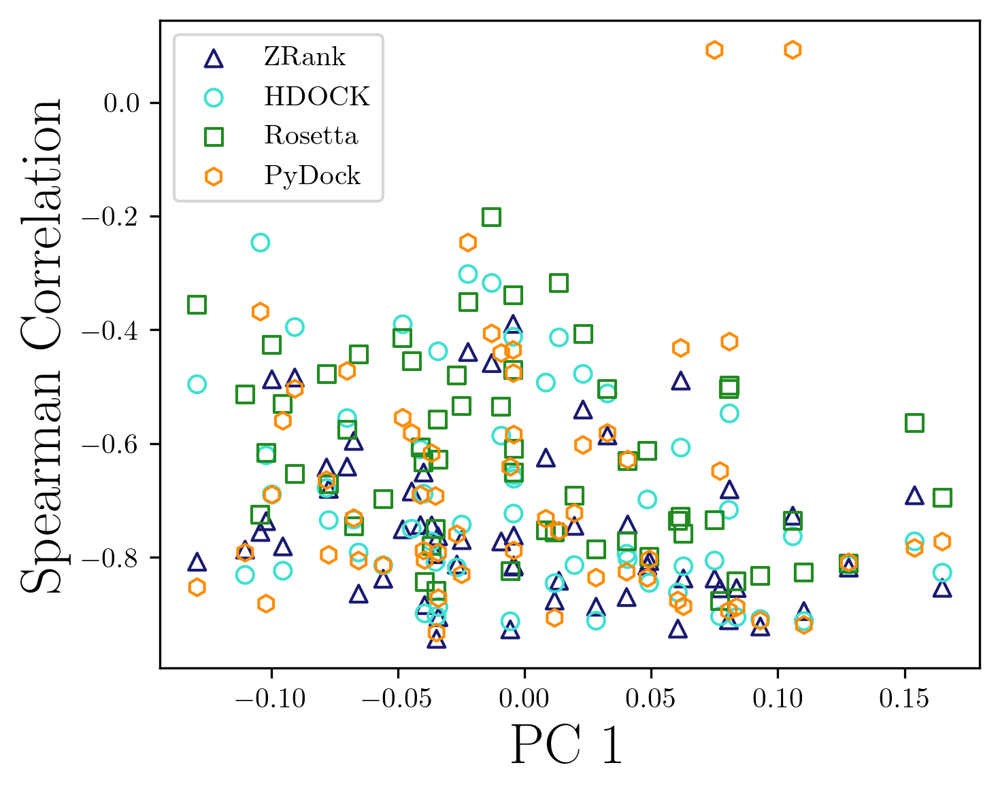

In [145]:
## Starting with Fci

## Getting PCA for each score
pca_fci = perform_pca(flat_ss_corr_df, "fci", "flatness_p3")[:, 0]

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid"]

## Plotting the data

ax.scatter(pca_fci, flat_ss_corr_df["spearman_dockq_zrank"], color = colors[0], marker = "^",  facecolor = "None", label = "ZRank")
ax.scatter(pca_fci, flat_ss_corr_df["spearman_dockq_hdock"], color = colors[1], marker = "o", facecolor = "None", label = "HDOCK")
ax.scatter(pca_fci, flat_ss_corr_df["spearman_dockq_rosetta"], color = colors[2], marker = "s", facecolor = "None", label = "Rosetta")
ax.scatter(pca_fci, flat_ss_corr_df["spearman_dockq_pydock"], color = colors[3], marker = "h", facecolor = "None", label = "PyDock")
# ax.scatter(ss_corr_df["fci"], np.array(ss_corr_df["spearman_dockq_voromqa"])*-1, color = colors[4], marker = "*", facecolor = "None", label = "VoroMQA")

print(spearmanr(pca_fci, flat_ss_corr_df["spearman_dockq_zrank"]))
print(spearmanr(pca_fci, flat_ss_corr_df["spearman_dockq_hdock"]))
print(spearmanr(pca_fci, flat_ss_corr_df["spearman_dockq_rosetta"]))
print(spearmanr(pca_fci, flat_ss_corr_df["spearman_dockq_pydock"]))
print(spearmanr(pca_fci, flat_ss_corr_df["spearman_dockq_voromqa"]))

print(pearsonr(pca_fci, flat_ss_corr_df["spearman_dockq_zrank"]))
print(pearsonr(pca_fci, flat_ss_corr_df["spearman_dockq_hdock"]))
print(pearsonr(pca_fci, flat_ss_corr_df["spearman_dockq_rosetta"]))
print(pearsonr(pca_fci, flat_ss_corr_df["spearman_dockq_pydock"]))
print(pearsonr(pca_fci, flat_ss_corr_df["spearman_dockq_voromqa"]))

ax.set_xlabel("PC 1", fontsize = 20)
ax.set_ylabel("Spearman Correlation", fontsize = 20)


plt.legend()
fig.tight_layout()


### # core interface/ # surface residues

Explained variance for fsci: 0.8959962103040332
Explained variance for flatness_p3: 0.10400378969596694
SpearmanrResult(correlation=-0.5539696699375558, pvalue=6.44846643293603e-06)
SpearmanrResult(correlation=-0.5656587406564337, pvalue=3.7105315336234355e-06)
SpearmanrResult(correlation=-0.5103509797286906, pvalue=4.2638432210638096e-05)
SpearmanrResult(correlation=-0.34245901135070295, pvalue=0.008503295906536326)
SpearmanrResult(correlation=0.3339075332984712, pvalue=0.010419481372340876)
(-0.33824494769024405, 0.009405387972418971)
(-0.4389015096877168, 0.0005679437407085911)
(-0.3392536129602611, 0.009182228720921587)
(-0.22837100575355612, 0.08466681898660912)
(0.24016899292341526, 0.0693802046615815)


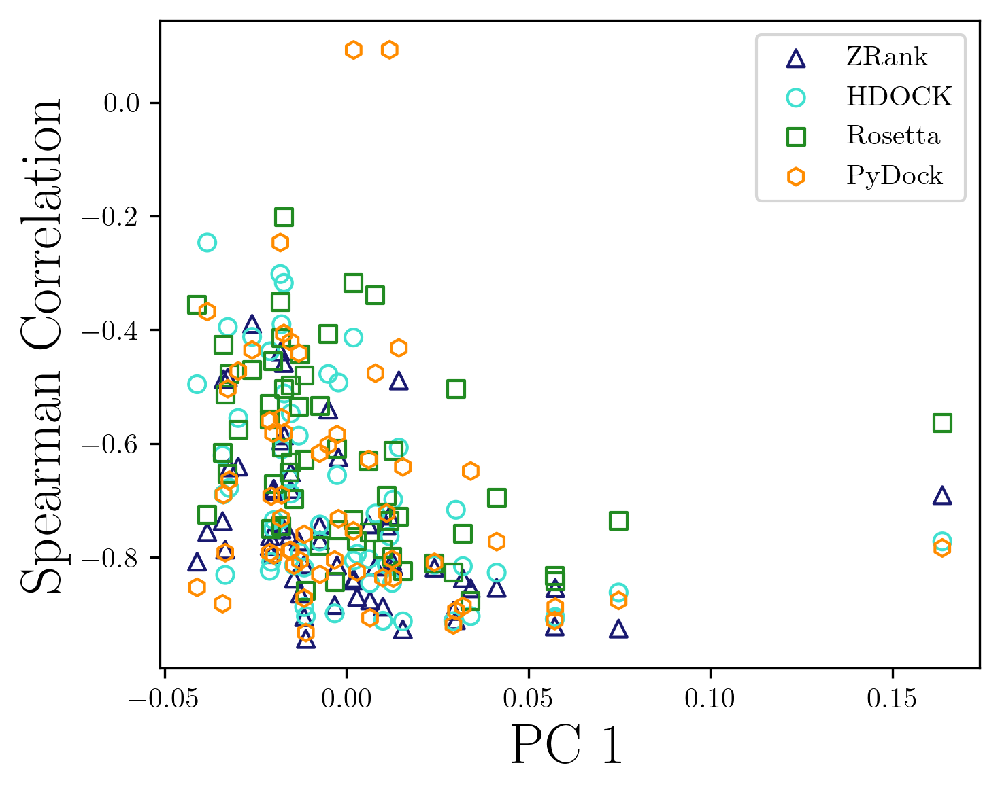

In [146]:
## Now with Fsci

## Getting PCA for each score
pca_fci = perform_pca(flat_ss_corr_df, "fsci", "flatness_p3")[:, 0]

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid"]

## Plotting the data

ax.scatter(pca_fci, flat_ss_corr_df["spearman_dockq_zrank"], color = colors[0], marker = "^",  facecolor = "None", label = "ZRank")
ax.scatter(pca_fci, flat_ss_corr_df["spearman_dockq_hdock"], color = colors[1], marker = "o", facecolor = "None", label = "HDOCK")
ax.scatter(pca_fci, flat_ss_corr_df["spearman_dockq_rosetta"], color = colors[2], marker = "s", facecolor = "None", label = "Rosetta")
ax.scatter(pca_fci, flat_ss_corr_df["spearman_dockq_pydock"], color = colors[3], marker = "h", facecolor = "None", label = "PyDock")
# ax.scatter(ss_corr_df["fci"], np.array(ss_corr_df["spearman_dockq_voromqa"])*-1, color = colors[4], marker = "*", facecolor = "None", label = "VoroMQA")

print(spearmanr(pca_fci, flat_ss_corr_df["spearman_dockq_zrank"]))
print(spearmanr(pca_fci, flat_ss_corr_df["spearman_dockq_hdock"]))
print(spearmanr(pca_fci, flat_ss_corr_df["spearman_dockq_rosetta"]))
print(spearmanr(pca_fci, flat_ss_corr_df["spearman_dockq_pydock"]))
print(spearmanr(pca_fci, flat_ss_corr_df["spearman_dockq_voromqa"]))

print(pearsonr(pca_fci, flat_ss_corr_df["spearman_dockq_zrank"]))
print(pearsonr(pca_fci, flat_ss_corr_df["spearman_dockq_hdock"]))
print(pearsonr(pca_fci, flat_ss_corr_df["spearman_dockq_rosetta"]))
print(pearsonr(pca_fci, flat_ss_corr_df["spearman_dockq_pydock"]))
print(pearsonr(pca_fci, flat_ss_corr_df["spearman_dockq_voromqa"]))

ax.set_xlabel("PC 1", fontsize = 20)
ax.set_ylabel("Spearman Correlation", fontsize = 20)


plt.legend()
fig.tight_layout()


### ∑SASAcore/∑SASAinterface

Explained variance for fcore_sa_interface: 0.9239556483354977
Explained variance for flatness_p3: 0.0760443516645023
SpearmanrResult(correlation=-0.37795687348118984, pvalue=0.0034432334658491773)
SpearmanrResult(correlation=-0.3537789535205636, pvalue=0.0064425470003451795)
SpearmanrResult(correlation=-0.3406748900304531, pvalue=0.008875591305755468)
SpearmanrResult(correlation=-0.15334215140422655, pvalue=0.25046973950386897)
SpearmanrResult(correlation=0.31569719154695625, pvalue=0.01577724077880139)
(-0.29082330410408724, 0.026777848439621513)
(-0.319487751105312, 0.014500370323338183)
(-0.27985148461665643, 0.033370001840912385)
(-0.03471747504340751, 0.7958491919781538)
(0.22220031278748298, 0.09365621699561932)


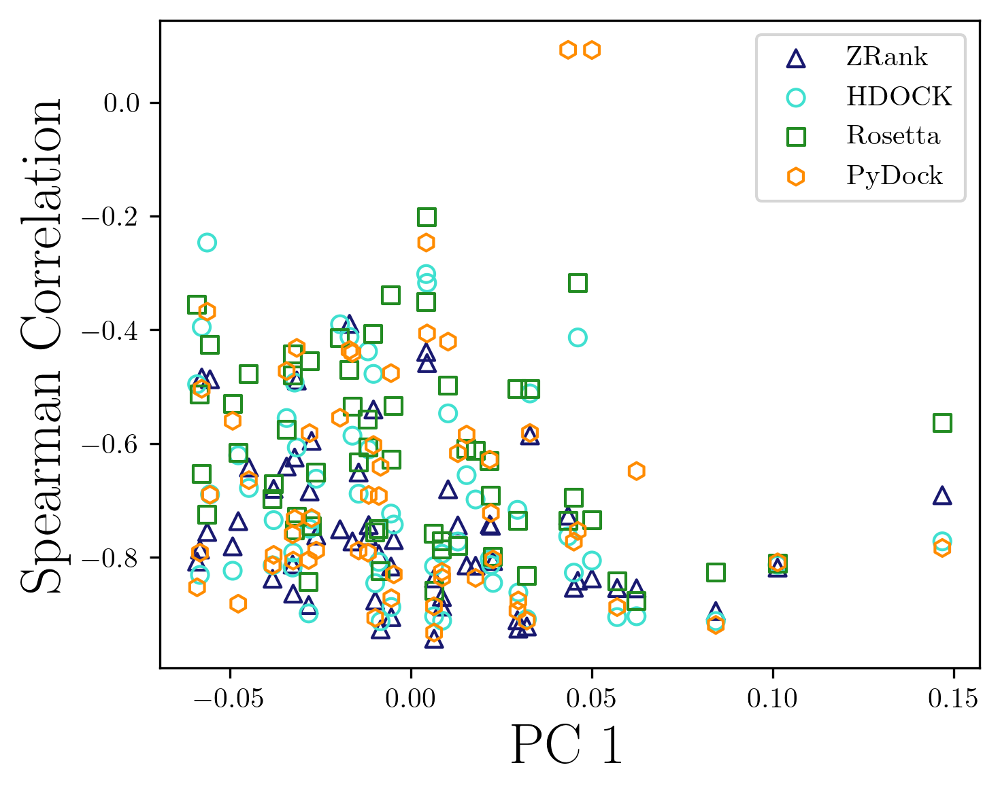

In [147]:
## Now with Fcore-interface

## Getting PCA for each score
pca_fci = perform_pca(flat_ss_corr_df, "fcore_sa_interface", "flatness_p3")[:, 0]

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid"]

## Plotting the data

ax.scatter(pca_fci, flat_ss_corr_df["spearman_dockq_zrank"], color = colors[0], marker = "^",  facecolor = "None", label = "ZRank")
ax.scatter(pca_fci, flat_ss_corr_df["spearman_dockq_hdock"], color = colors[1], marker = "o", facecolor = "None", label = "HDOCK")
ax.scatter(pca_fci, flat_ss_corr_df["spearman_dockq_rosetta"], color = colors[2], marker = "s", facecolor = "None", label = "Rosetta")
ax.scatter(pca_fci, flat_ss_corr_df["spearman_dockq_pydock"], color = colors[3], marker = "h", facecolor = "None", label = "PyDock")
# ax.scatter(ss_corr_df["fci"], np.array(ss_corr_df["spearman_dockq_voromqa"])*-1, color = colors[4], marker = "*", facecolor = "None", label = "VoroMQA")

print(spearmanr(pca_fci, flat_ss_corr_df["spearman_dockq_zrank"]))
print(spearmanr(pca_fci, flat_ss_corr_df["spearman_dockq_hdock"]))
print(spearmanr(pca_fci, flat_ss_corr_df["spearman_dockq_rosetta"]))
print(spearmanr(pca_fci, flat_ss_corr_df["spearman_dockq_pydock"]))
print(spearmanr(pca_fci, flat_ss_corr_df["spearman_dockq_voromqa"]))

print(pearsonr(pca_fci, flat_ss_corr_df["spearman_dockq_zrank"]))
print(pearsonr(pca_fci, flat_ss_corr_df["spearman_dockq_hdock"]))
print(pearsonr(pca_fci, flat_ss_corr_df["spearman_dockq_rosetta"]))
print(pearsonr(pca_fci, flat_ss_corr_df["spearman_dockq_pydock"]))
print(pearsonr(pca_fci, flat_ss_corr_df["spearman_dockq_voromqa"]))

ax.set_xlabel("PC 1", fontsize = 20)
ax.set_ylabel("Spearman Correlation", fontsize = 20)


plt.legend()
fig.tight_layout()


### ∑SASAcore/∑SASAcomplex

Explained variance for fcore_sa_complex: 0.7974885360304897
Explained variance for flatness_p3: 0.20251146396951017
SpearmanrResult(correlation=-0.5886062321203359, pvalue=1.17650724547037e-06)
SpearmanrResult(correlation=-0.56701221200283, pvalue=3.4757570669592806e-06)
SpearmanrResult(correlation=-0.4785444030883756, pvalue=0.00014489167088601427)
SpearmanrResult(correlation=-0.37974099480143964, pvalue=0.0032814911457628823)
SpearmanrResult(correlation=0.3316312405795318, pvalue=0.010988584409764166)
(-0.23952685511765576, 0.07015108145150818)
(-0.3299713222229156, 0.011420344785763757)
(-0.2192369726172102, 0.09822981718078545)
(-0.2031891605193194, 0.12607523975477003)
(0.23041575885141063, 0.08184270823616353)


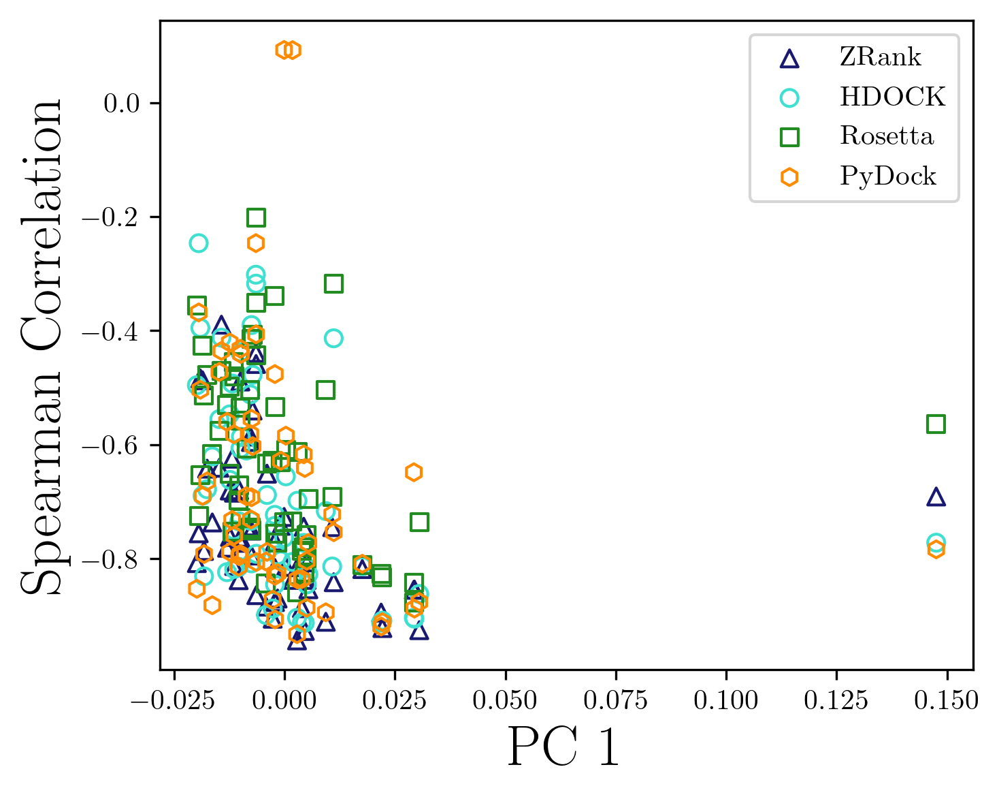

In [148]:
## Now with Fcore-complex

## Getting PCA for each score
pca_fci = perform_pca(flat_ss_corr_df, "fcore_sa_complex", "flatness_p3")[:, 0]

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid"]

## Plotting the data

ax.scatter(pca_fci, flat_ss_corr_df["spearman_dockq_zrank"], color = colors[0], marker = "^",  facecolor = "None", label = "ZRank")
ax.scatter(pca_fci, flat_ss_corr_df["spearman_dockq_hdock"], color = colors[1], marker = "o", facecolor = "None", label = "HDOCK")
ax.scatter(pca_fci, flat_ss_corr_df["spearman_dockq_rosetta"], color = colors[2], marker = "s", facecolor = "None", label = "Rosetta")
ax.scatter(pca_fci, flat_ss_corr_df["spearman_dockq_pydock"], color = colors[3], marker = "h", facecolor = "None", label = "PyDock")
# ax.scatter(ss_corr_df["fci"], np.array(ss_corr_df["spearman_dockq_voromqa"])*-1, color = colors[4], marker = "*", facecolor = "None", label = "VoroMQA")

print(spearmanr(pca_fci, flat_ss_corr_df["spearman_dockq_zrank"]))
print(spearmanr(pca_fci, flat_ss_corr_df["spearman_dockq_hdock"]))
print(spearmanr(pca_fci, flat_ss_corr_df["spearman_dockq_rosetta"]))
print(spearmanr(pca_fci, flat_ss_corr_df["spearman_dockq_pydock"]))
print(spearmanr(pca_fci, flat_ss_corr_df["spearman_dockq_voromqa"]))

print(pearsonr(pca_fci, flat_ss_corr_df["spearman_dockq_zrank"]))
print(pearsonr(pca_fci, flat_ss_corr_df["spearman_dockq_hdock"]))
print(pearsonr(pca_fci, flat_ss_corr_df["spearman_dockq_rosetta"]))
print(pearsonr(pca_fci, flat_ss_corr_df["spearman_dockq_pydock"]))
print(pearsonr(pca_fci, flat_ss_corr_df["spearman_dockq_voromqa"]))

ax.set_xlabel("PC 1", fontsize = 20)
ax.set_ylabel("Spearman Correlation", fontsize = 20)


plt.legend()
fig.tight_layout()


### ∑SASAcore/∑SASAmonomer

Explained variance for fcore_sa_monomer: 0.75063515068442
Explained variance for flatness_p3: 0.24936484931558006
SpearmanrResult(correlation=-0.5865145036759052, pvalue=1.3111615993587667e-06)
SpearmanrResult(correlation=-0.5791934541203975, pvalue=1.9046204858425827e-06)
SpearmanrResult(correlation=-0.48918760958503804, pvalue=9.75154531036433e-05)
SpearmanrResult(correlation=-0.38238641606939616, pvalue=0.003054052761099148)
SpearmanrResult(correlation=0.3389522901350395, pvalue=0.009248407388752286)
(-0.232939171651512, 0.07846056664096195)
(-0.32754733870753117, 0.012077129527221795)
(-0.21597763547605459, 0.10345867439106093)
(-0.19786287746576114, 0.13652973912856528)
(0.23125519790674792, 0.08070506605954324)


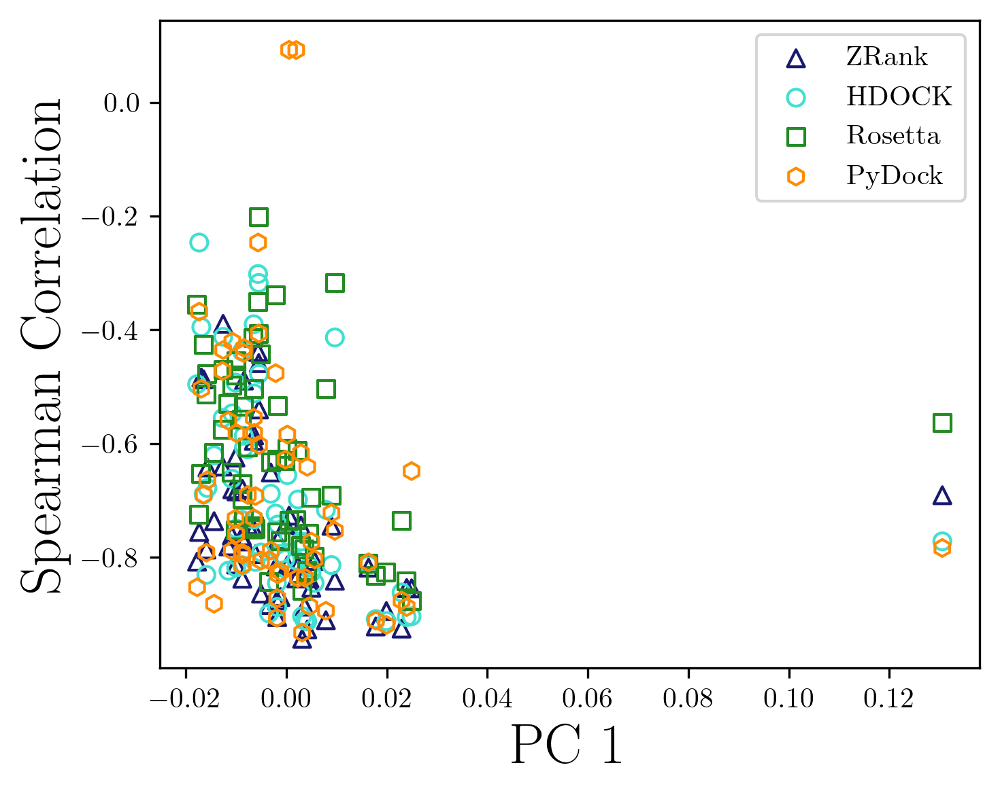

In [149]:
## Now with Fcore-monomer

## Getting PCA for each score
pca_fci = perform_pca(flat_ss_corr_df, "fcore_sa_monomer", "flatness_p3")[:, 0]

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid"]

## Plotting the data

ax.scatter(pca_fci, flat_ss_corr_df["spearman_dockq_zrank"], color = colors[0], marker = "^",  facecolor = "None", label = "ZRank")
ax.scatter(pca_fci, flat_ss_corr_df["spearman_dockq_hdock"], color = colors[1], marker = "o", facecolor = "None", label = "HDOCK")
ax.scatter(pca_fci, flat_ss_corr_df["spearman_dockq_rosetta"], color = colors[2], marker = "s", facecolor = "None", label = "Rosetta")
ax.scatter(pca_fci, flat_ss_corr_df["spearman_dockq_pydock"], color = colors[3], marker = "h", facecolor = "None", label = "PyDock")
# ax.scatter(ss_corr_df["fci"], np.array(ss_corr_df["spearman_dockq_voromqa"])*-1, color = colors[4], marker = "*", facecolor = "None", label = "VoroMQA")

print(spearmanr(pca_fci, flat_ss_corr_df["spearman_dockq_zrank"]))
print(spearmanr(pca_fci, flat_ss_corr_df["spearman_dockq_hdock"]))
print(spearmanr(pca_fci, flat_ss_corr_df["spearman_dockq_rosetta"]))
print(spearmanr(pca_fci, flat_ss_corr_df["spearman_dockq_pydock"]))
print(spearmanr(pca_fci, flat_ss_corr_df["spearman_dockq_voromqa"]))

print(pearsonr(pca_fci, flat_ss_corr_df["spearman_dockq_zrank"]))
print(pearsonr(pca_fci, flat_ss_corr_df["spearman_dockq_hdock"]))
print(pearsonr(pca_fci, flat_ss_corr_df["spearman_dockq_rosetta"]))
print(pearsonr(pca_fci, flat_ss_corr_df["spearman_dockq_pydock"]))
print(pearsonr(pca_fci, flat_ss_corr_df["spearman_dockq_voromqa"]))

ax.set_xlabel("PC 1", fontsize = 20)
ax.set_ylabel("Spearman Correlation", fontsize = 20)


plt.legend()
fig.tight_layout()


### ∑SASAinterface/∑SASAcomplex

Explained variance for finterface_complex: 0.9910207292318348
Explained variance for flatness_p3: 0.00897927076816517
SpearmanrResult(correlation=-0.5284382786305332, pvalue=2.0106674069329976e-05)
SpearmanrResult(correlation=-0.6143837091267035, pvalue=2.9000651919942037e-07)
SpearmanrResult(correlation=-0.3489187609585039, pvalue=0.0072665699511910925)
SpearmanrResult(correlation=-0.5064136085391738, pvalue=4.993977727958741e-05)
SpearmanrResult(correlation=0.2026208126980221, pvalue=0.12716098575893234)
(-0.35488129270218116, 0.0062674550819343975)
(-0.4985551301972475, 6.807072207838789e-05)
(-0.21738432500061888, 0.1011761662465132)
(-0.3783521870668624, 0.0034067992816393567)
(0.1547544362976243, 0.24608043045701983)


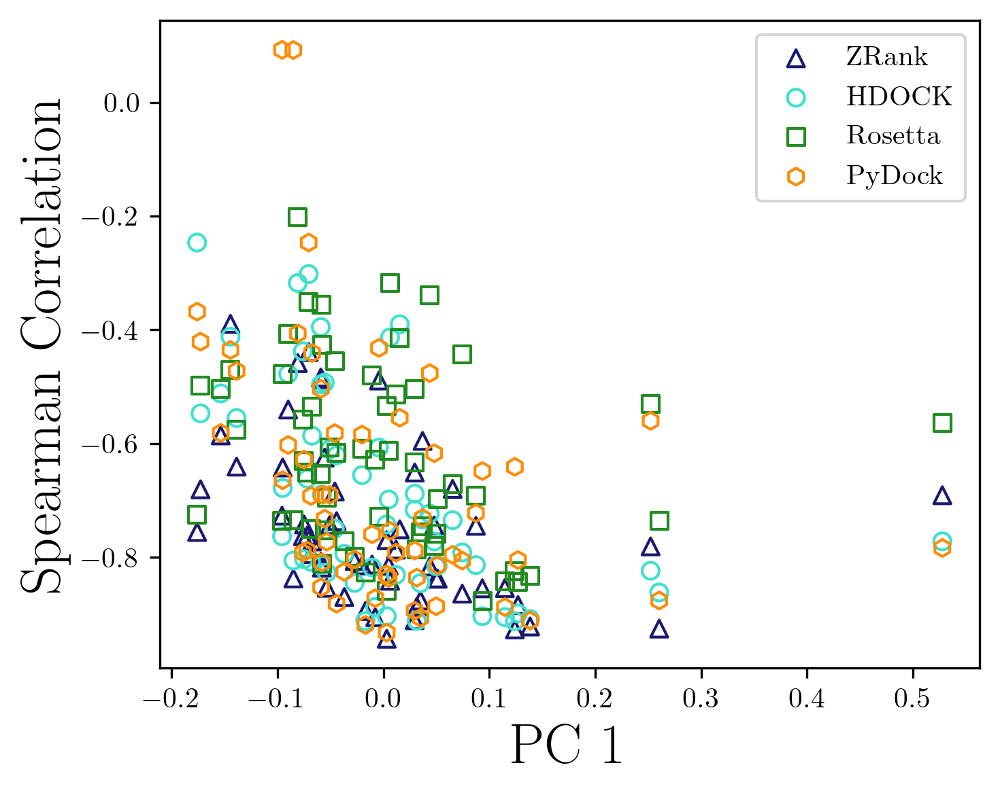

In [151]:
## Now with Finterface-complex

## Getting PCA for each score
pca_fci = perform_pca(flat_ss_corr_df, "finterface_complex", "flatness_p3")[:, 0]

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid"]

## Plotting the data

ax.scatter(pca_fci, flat_ss_corr_df["spearman_dockq_zrank"], color = colors[0], marker = "^",  facecolor = "None", label = "ZRank")
ax.scatter(pca_fci, flat_ss_corr_df["spearman_dockq_hdock"], color = colors[1], marker = "o", facecolor = "None", label = "HDOCK")
ax.scatter(pca_fci, flat_ss_corr_df["spearman_dockq_rosetta"], color = colors[2], marker = "s", facecolor = "None", label = "Rosetta")
ax.scatter(pca_fci, flat_ss_corr_df["spearman_dockq_pydock"], color = colors[3], marker = "h", facecolor = "None", label = "PyDock")
# ax.scatter(ss_corr_df["fci"], np.array(ss_corr_df["spearman_dockq_voromqa"])*-1, color = colors[4], marker = "*", facecolor = "None", label = "VoroMQA")

print(spearmanr(pca_fci, flat_ss_corr_df["spearman_dockq_zrank"]))
print(spearmanr(pca_fci, flat_ss_corr_df["spearman_dockq_hdock"]))
print(spearmanr(pca_fci, flat_ss_corr_df["spearman_dockq_rosetta"]))
print(spearmanr(pca_fci, flat_ss_corr_df["spearman_dockq_pydock"]))
print(spearmanr(pca_fci, flat_ss_corr_df["spearman_dockq_voromqa"]))

print(pearsonr(pca_fci, flat_ss_corr_df["spearman_dockq_zrank"]))
print(pearsonr(pca_fci, flat_ss_corr_df["spearman_dockq_hdock"]))
print(pearsonr(pca_fci, flat_ss_corr_df["spearman_dockq_rosetta"]))
print(pearsonr(pca_fci, flat_ss_corr_df["spearman_dockq_pydock"]))
print(pearsonr(pca_fci, flat_ss_corr_df["spearman_dockq_voromqa"]))

ax.set_xlabel("PC 1", fontsize = 20)
ax.set_ylabel("Spearman Correlation", fontsize = 20)


plt.legend()
fig.tight_layout()


### ∑SASAcore/∑SASAinterface

Explained variance for finterface_monomer: 0.9862190975830392
Explained variance for flatness_p3: 0.013780902416960946
SpearmanrResult(correlation=-0.5073364299117169, pvalue=4.813195215533419e-05)
SpearmanrResult(correlation=-0.5919283890614907, pvalue=9.889347349497136e-07)
SpearmanrResult(correlation=-0.3227721554031192, pvalue=0.013466706019531512)
SpearmanrResult(correlation=-0.4945399735457873, pvalue=7.951148703564119e-05)
SpearmanrResult(correlation=0.18920914208373069, pvalue=0.15488372712138235)
(-0.32314564820786873, 0.013353273971692989)
(-0.47324435013050725, 0.00017563003766084615)
(-0.18950477213617983, 0.15422807312958622)
(-0.3650614715481688, 0.004837501718296641)
(0.14846928448605748, 0.2660210813965658)


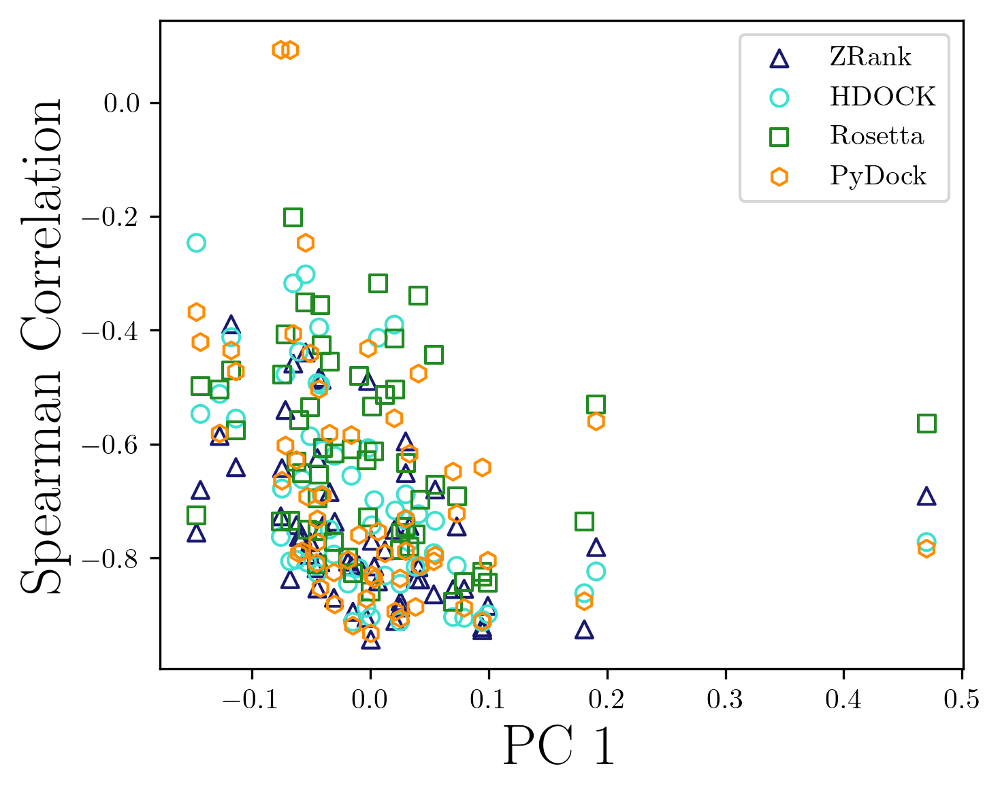

In [155]:
## Now with Finterface-monomer

## Getting PCA for each score
pca_fci = perform_pca(flat_ss_corr_df, "finterface_monomer", "flatness_p3")[:, 0]

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid"]

## Plotting the data

ax.scatter(pca_fci, flat_ss_corr_df["spearman_dockq_zrank"], color = colors[0], marker = "^",  facecolor = "None", label = "ZRank")
ax.scatter(pca_fci, flat_ss_corr_df["spearman_dockq_hdock"], color = colors[1], marker = "o", facecolor = "None", label = "HDOCK")
ax.scatter(pca_fci, flat_ss_corr_df["spearman_dockq_rosetta"], color = colors[2], marker = "s", facecolor = "None", label = "Rosetta")
ax.scatter(pca_fci, flat_ss_corr_df["spearman_dockq_pydock"], color = colors[3], marker = "h", facecolor = "None", label = "PyDock")
# ax.scatter(ss_corr_df["fci"], np.array(ss_corr_df["spearman_dockq_voromqa"])*-1, color = colors[4], marker = "*", facecolor = "None", label = "VoroMQA")

print(spearmanr(pca_fci, flat_ss_corr_df["spearman_dockq_zrank"]))
print(spearmanr(pca_fci, flat_ss_corr_df["spearman_dockq_hdock"]))
print(spearmanr(pca_fci, flat_ss_corr_df["spearman_dockq_rosetta"]))
print(spearmanr(pca_fci, flat_ss_corr_df["spearman_dockq_pydock"]))
print(spearmanr(pca_fci, flat_ss_corr_df["spearman_dockq_voromqa"]))

print(pearsonr(pca_fci, flat_ss_corr_df["spearman_dockq_zrank"]))
print(pearsonr(pca_fci, flat_ss_corr_df["spearman_dockq_hdock"]))
print(pearsonr(pca_fci, flat_ss_corr_df["spearman_dockq_rosetta"]))
print(pearsonr(pca_fci, flat_ss_corr_df["spearman_dockq_pydock"]))
print(pearsonr(pca_fci, flat_ss_corr_df["spearman_dockq_voromqa"]))

ax.set_xlabel("PC 1", fontsize = 20)
ax.set_ylabel("Spearman Correlation", fontsize = 20)


plt.legend()
fig.tight_layout()


SpearmanrResult(correlation=0.5345904211141531, pvalue=1.541644875674333e-05)
SpearmanrResult(correlation=0.69423851856409, pvalue=1.508989784819437e-09)
SpearmanrResult(correlation=0.5780245470485096, pvalue=2.0199236625639677e-06)
SpearmanrResult(correlation=0.572856747362269, pvalue=2.61224608491311e-06)
SpearmanrResult(correlation=-0.30277769233135443, pvalue=0.02087672314080436)
(0.4715402394378948, 0.00018671361715723013)
(0.6361480221989395, 8.032719031416239e-08)
(0.5525257727331159, 6.894121223069707e-06)
(0.5034143630592114, 5.6256597926046686e-05)
(-0.315261759014142, 0.01592989966546471)


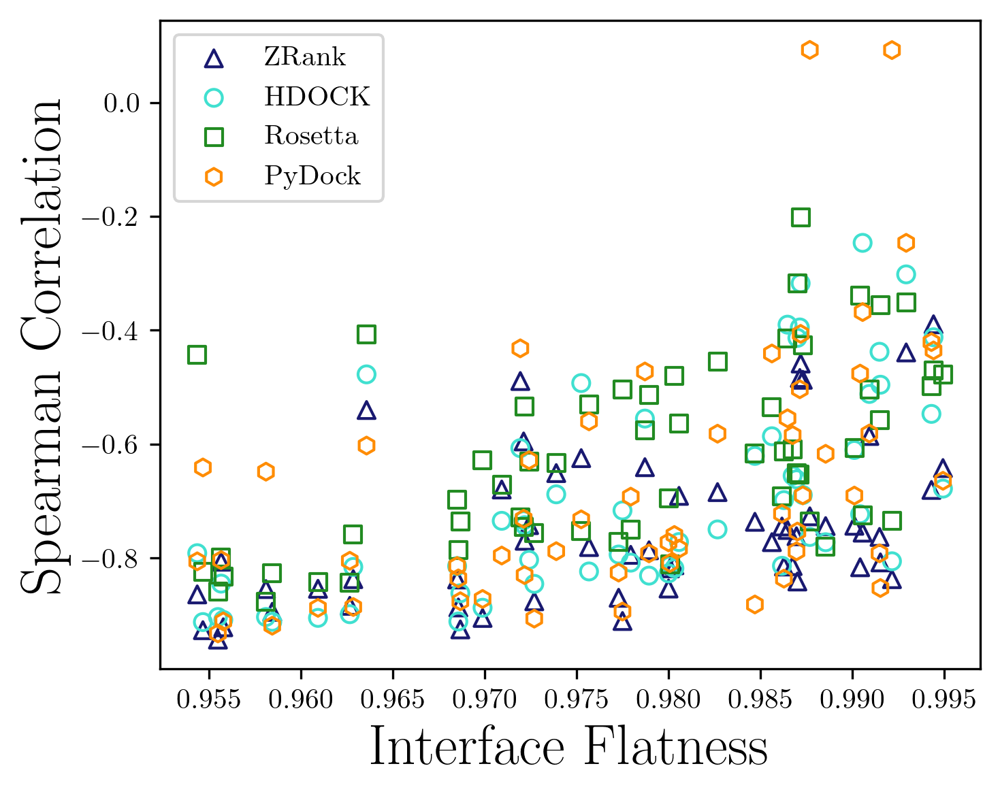

In [158]:
## Getting Looking at just flatness for this regime as a comparison point

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid"]

## Plotting the data

ax.scatter(flat_ss_corr_df["flatness_p3"], flat_ss_corr_df["spearman_dockq_zrank"], color = colors[0], marker = "^",  facecolor = "None", label = "ZRank")
ax.scatter(flat_ss_corr_df["flatness_p3"], flat_ss_corr_df["spearman_dockq_hdock"], color = colors[1], marker = "o", facecolor = "None", label = "HDOCK")
ax.scatter(flat_ss_corr_df["flatness_p3"], flat_ss_corr_df["spearman_dockq_rosetta"], color = colors[2], marker = "s", facecolor = "None", label = "Rosetta")
ax.scatter(flat_ss_corr_df["flatness_p3"], flat_ss_corr_df["spearman_dockq_pydock"], color = colors[3], marker = "h", facecolor = "None", label = "PyDock")
# ax.scatter(ss_corr_df["fci"], np.array(ss_corr_df["spearman_dockq_voromqa"])*-1, color = colors[4], marker = "*", facecolor = "None", label = "VoroMQA")

print(spearmanr(flat_ss_corr_df["flatness_p3"], flat_ss_corr_df["spearman_dockq_zrank"]))
print(spearmanr(flat_ss_corr_df["flatness_p3"], flat_ss_corr_df["spearman_dockq_hdock"]))
print(spearmanr(flat_ss_corr_df["flatness_p3"], flat_ss_corr_df["spearman_dockq_rosetta"]))
print(spearmanr(flat_ss_corr_df["flatness_p3"], flat_ss_corr_df["spearman_dockq_pydock"]))
print(spearmanr(flat_ss_corr_df["flatness_p3"], flat_ss_corr_df["spearman_dockq_voromqa"]))

print(pearsonr(flat_ss_corr_df["flatness_p3"], flat_ss_corr_df["spearman_dockq_zrank"]))
print(pearsonr(flat_ss_corr_df["flatness_p3"], flat_ss_corr_df["spearman_dockq_hdock"]))
print(pearsonr(flat_ss_corr_df["flatness_p3"], flat_ss_corr_df["spearman_dockq_rosetta"]))
print(pearsonr(flat_ss_corr_df["flatness_p3"], flat_ss_corr_df["spearman_dockq_pydock"]))
print(pearsonr(flat_ss_corr_df["flatness_p3"], flat_ss_corr_df["spearman_dockq_voromqa"]))

ax.set_xlabel("Interface Flatness", fontsize = 20)
ax.set_ylabel("Spearman Correlation", fontsize = 20)


plt.legend()
fig.tight_layout()

# Suppplement Figure: Resolution

SpearmanrResult(correlation=0.18669293534407383, pvalue=0.0890527652798425)
SpearmanrResult(correlation=0.13898871067108062, pvalue=0.20734652266893516)
SpearmanrResult(correlation=0.23464034213094803, pvalue=0.03168348749731968)
SpearmanrResult(correlation=0.13412506839346028, pvalue=0.2238470451846008)
SpearmanrResult(correlation=0.0036781294724504096, pvalue=0.9735106299072112)
(0.27748188221042647, 0.010605046185471015)
(0.17825274576807906, 0.10474878544176247)
(0.27664702411421316, 0.010851444343150071)
(0.1536595333486846, 0.16286089815862664)
(-0.03103900629281134, 0.7792610393674998)


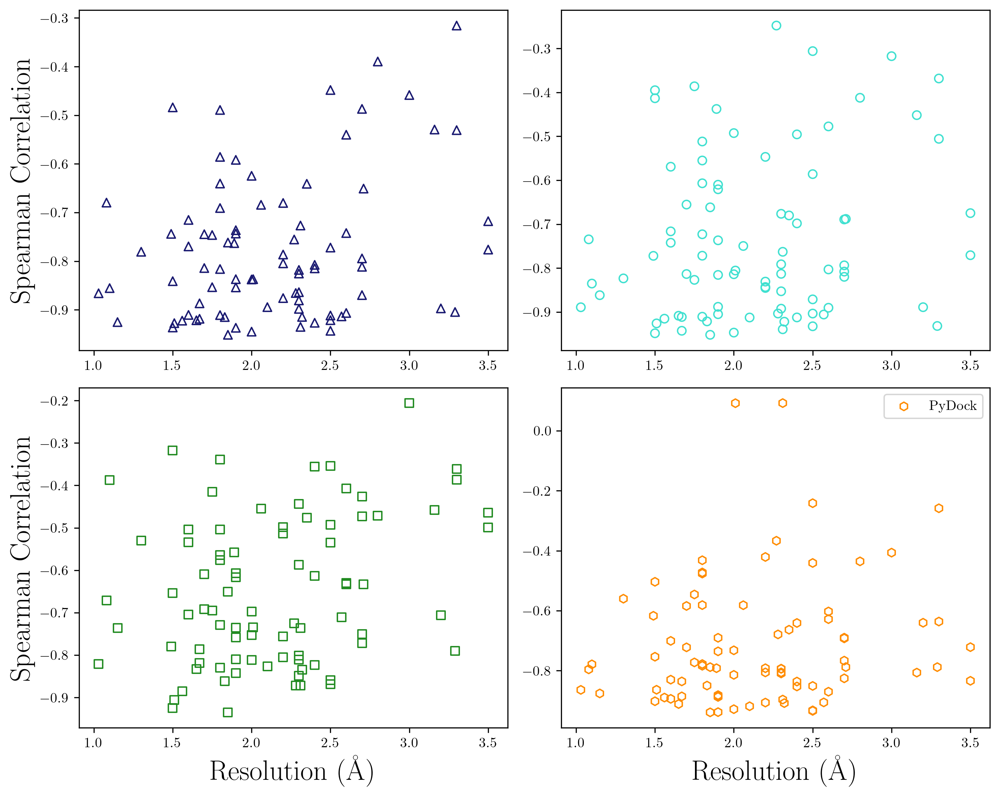

In [115]:
## Scatter the pearson correlations vs the resolution for each score... See if there is anything there

fig, ax = plt.subplots(2,2, figsize = (10,8), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid"]

## Relaxed and Supersampled

ax[0,0].scatter(ss_corr_df["resolution"], ss_corr_df["spearman_dockq_zrank"], color = colors[0], marker = "^",  facecolor = "None", label = "ZRank")
ax[0,1].scatter(ss_corr_df["resolution"], ss_corr_df["spearman_dockq_hdock"], color = colors[1], marker = "o", facecolor = "None", label = "HDOCK")
ax[1,0].scatter(ss_corr_df["resolution"], ss_corr_df["spearman_dockq_rosetta"], color = colors[2], marker = "s", facecolor = "None", label = "Rosetta")
ax[1,1].scatter(ss_corr_df["resolution"], ss_corr_df["spearman_dockq_pydock"], color = colors[3], marker = "h", facecolor = "None", label = "PyDock")
# ax.scatter(ss_corr_df["resolution"], np.array(ss_corr_df["spearman_dockq_voromqa"])*-1, color = colors[4], marker = "*", facecolor = "None", label = "VoroMQA")

print(spearmanr(ss_corr_df["resolution"], ss_corr_df["spearman_dockq_zrank"]))
print(spearmanr(ss_corr_df["resolution"], ss_corr_df["spearman_dockq_hdock"]))
print(spearmanr(ss_corr_df["resolution"], ss_corr_df["spearman_dockq_rosetta"]))
print(spearmanr(ss_corr_df["resolution"], ss_corr_df["spearman_dockq_pydock"]))
print(spearmanr(ss_corr_df["resolution"], ss_corr_df["spearman_dockq_voromqa"]))

print(pearsonr(ss_corr_df["resolution"], ss_corr_df["spearman_dockq_zrank"]))
print(pearsonr(ss_corr_df["resolution"], ss_corr_df["spearman_dockq_hdock"]))
print(pearsonr(ss_corr_df["resolution"], ss_corr_df["spearman_dockq_rosetta"]))
print(pearsonr(ss_corr_df["resolution"], ss_corr_df["spearman_dockq_pydock"]))
print(pearsonr(ss_corr_df["resolution"], ss_corr_df["spearman_dockq_voromqa"]))

# ax[0,0].set_xlabel("Resolution (Å)", fontsize = 20)
# ax[0,1].set_xlabel("Resolution (Å)", fontsize = 20)
ax[1,0].set_xlabel("Resolution (Å)", fontsize = 20)
ax[1,1].set_xlabel("Resolution (Å)", fontsize = 20)
ax[0,0].set_ylabel("Spearman Correlation", fontsize = 20)
# ax[0,1].set_ylabel("Spearman Correlation", fontsize = 20)
ax[1,0].set_ylabel("Spearman Correlation", fontsize = 20)
# ax[1,1].set_ylabel("Spearman Correlation", fontsize = 20)


plt.legend()
fig.tight_layout()

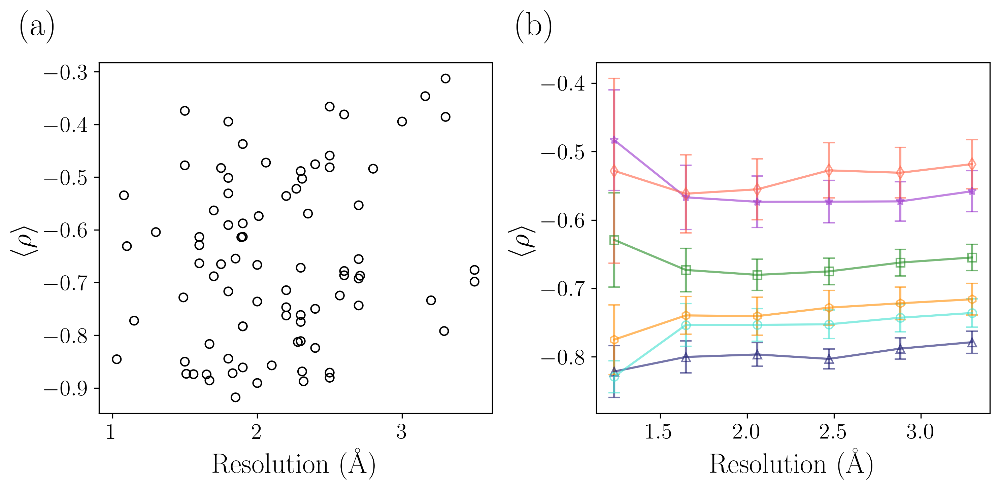

In [125]:
## Combined Resolution Figure

fig, ax = plt.subplots(1,2, figsize = (10,5), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid", "indianred", "tomato"]

font_size = 16

def get_rolling_avg(datax, datay, nbins):
    '''
    Gets the rolling average of the datay over
    nbins of the datax. 
    '''

    bins = np.linspace(min(datax), max(datax), nbins+1)
    avg_data = np.zeros((nbins))
    std_data = np.zeros((nbins))
    
    for i in range(nbins):
        temp_data = datay[(datax >= bins[0]) & (datax < bins[i+1])]
        avg_data[i] = np.mean(temp_data)
        std_data[i] = np.std(temp_data)/np.sqrt(len(temp_data)) ## standard error
#         std_data[i] = np.std(temp_data)
        
    bin_step = bins[1] - bins[0]
    cent_bins = [ele + 0.5*bin_step for ele in bins][:nbins]
        
    return cent_bins, avg_data, std_data

## Get rolling average data for Spearman Correlation based on the resolution

nbins = 6

zrank_x, zrank_y, zrank_err = get_rolling_avg(ss_corr_df["resolution"], ss_corr_df["spearman_dockq_zrank"], nbins)
hdock_x, hdock_y, hdock_err = get_rolling_avg(ss_corr_df["resolution"], ss_corr_df["spearman_dockq_hdock"], nbins)
rosetta_x, rosetta_y, rosetta_err = get_rolling_avg(ss_corr_df["resolution"], ss_corr_df["spearman_dockq_rosetta"], nbins)
pydock_x, pydock_y, pydock_err = get_rolling_avg(ss_corr_df["resolution"], ss_corr_df["spearman_dockq_pydock"], nbins)
deeprank_x, deeprank_y , deeprank_err = get_rolling_avg(ss_corr_df["resolution"], ss_corr_df["spearman_dockq_deeprank_gnn_esm"], nbins)
voromqa_x, voromqa_y , voromqa_err = get_rolling_avg(ss_corr_df["resolution"], ss_corr_df["spearman_dockq_voromqa"], nbins)

deeprank_y = deeprank_y * -1
voromqa_y = voromqa_y * -1

## Resolution Scatterplot


score_ref = ["spearman_dockq_zrank", "spearman_dockq_hdock", "spearman_dockq_rosetta", "spearman_dockq_pydock", 
             "spearman_dockq_deeprank_gnn_esm", "spearman_dockq_voromqa"]
spearman_data = np.zeros((len(score_ref),len(ss_corr_df)))

for i in range(len(score_ref)):
    for j in range(len(ss_corr_df)):
        if i >= 4:
            spearman_data[i][j] = ss_corr_df[score_ref[i]].iloc[j] * -1
        else:
            spearman_data[i][j] = ss_corr_df[score_ref[i]].iloc[j]

mean_data_ss = np.mean(spearman_data, axis = 0)

ax[0].scatter(ss_corr_df["resolution"], mean_data_ss, color = "black", marker = "o", label = "Supersampled", facecolor = "None")

ax[0].set_xlabel("Resolution (Å)", fontsize = 20)
ax[0].set_ylabel(r"$\langle \rho \rangle$", fontsize = 20)

## Relaxed and Supersampled

ax[1].errorbar(zrank_x, zrank_y, yerr = zrank_err, color = colors[0], marker = "^",  markerfacecolor = "None", label = "ZRank2", alpha = 0.6, solid_capstyle = "projecting", capsize = 4)
ax[1].errorbar(hdock_x, hdock_y, yerr = hdock_err, color = colors[1], marker = "o", markerfacecolor = "None", label = "ITScorePro", alpha = 0.6, solid_capstyle = "projecting", capsize = 4)
ax[1].errorbar(rosetta_x, rosetta_y, yerr = rosetta_err, color = colors[2], marker = "s", markerfacecolor = "None", label = "Rosetta", alpha = 0.6, solid_capstyle = "projecting", capsize = 4)
ax[1].errorbar(pydock_x, pydock_y, yerr = pydock_err, color = colors[3], marker = "h", markerfacecolor = "None", label = "PyDock", alpha = 0.6, solid_capstyle = "projecting", capsize = 4)
ax[1].errorbar(voromqa_x, voromqa_y, yerr = voromqa_err, color = colors[4], marker = "*", markerfacecolor = "None", label = "VoroMQA", alpha = 0.6, solid_capstyle = "projecting", capsize = 4)
ax[1].errorbar(deeprank_x, deeprank_y, yerr = deeprank_err, color = colors[6], marker = "d", markerfacecolor = "None", label = "Deeprank-GNN", alpha = 0.6, solid_capstyle = "projecting", capsize = 4)

ax[1].set_xlabel("Resolution (Å)", fontsize = 20)
ax[1].set_ylabel(r"$\langle \rho \rangle$", fontsize = 20)

ax[0].text(-0.1, 1.15, "(a)", transform=ax[0].transAxes,fontsize=font_size*1.5, fontweight='bold', va='top', ha='right')
ax[1].text(-0.1, 1.15, "(b)", transform=ax[1].transAxes,fontsize=font_size*1.5, fontweight='bold', va='top', ha='right')
ax[0].tick_params(axis='both', which='major', labelsize=font_size)
ax[1].tick_params(axis='both', which='major', labelsize=font_size)

fig.tight_layout()
plt.savefig(join(figure_save_dir, "resolution_combined_fig.png"))

In [342]:
print(spearmanr(ss_corr_df["resolution"], mean_data_ss)[0])
print(pearsonr(ss_corr_df["resolution"], mean_data_ss)[0])

0.16414792686968768
0.21053728863378224


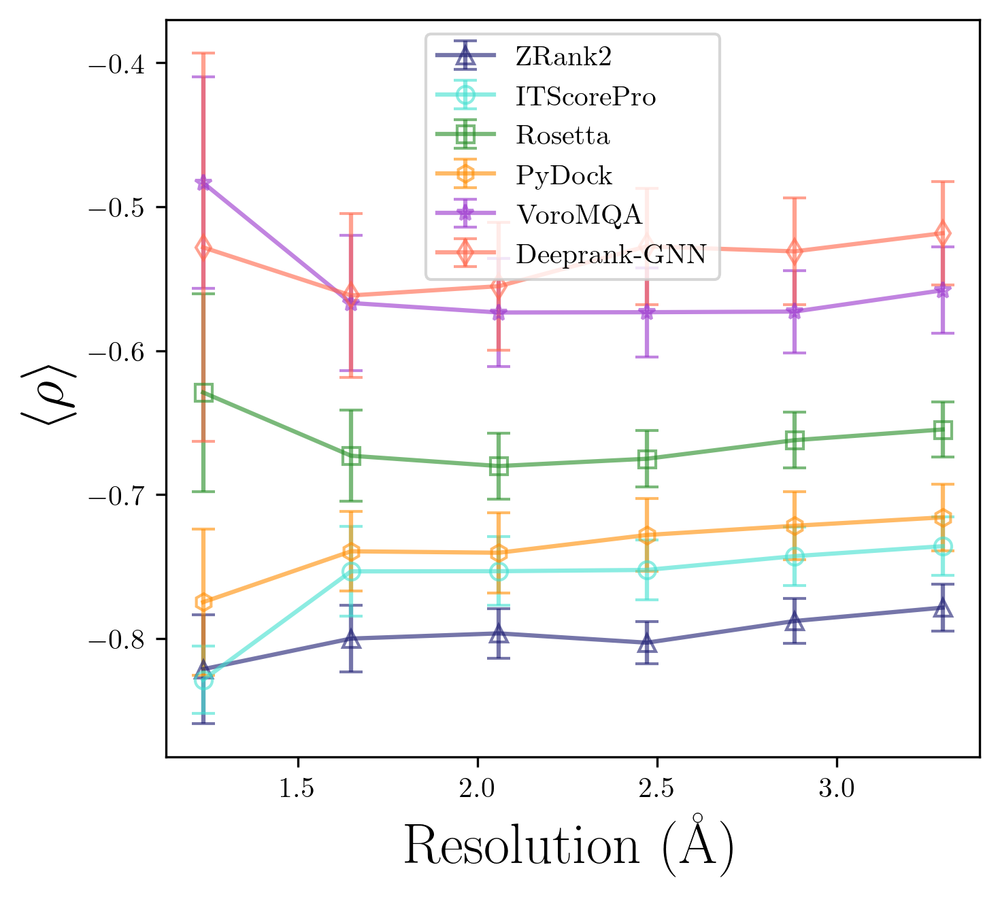

In [119]:
## Now with the rolling average for each score!

fig, ax = plt.subplots(figsize = (5,4.5), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid", "indianred", "tomato"]

def get_rolling_avg(datax, datay, nbins):
    '''
    Gets the rolling average of the datay over
    nbins of the datax. 
    '''

    bins = np.linspace(min(datax), max(datax), nbins+1)
    avg_data = np.zeros((nbins))
    std_data = np.zeros((nbins))
    
    for i in range(nbins):
        temp_data = datay[(datax >= bins[0]) & (datax < bins[i+1])]
        avg_data[i] = np.mean(temp_data)
        std_data[i] = np.std(temp_data)/np.sqrt(len(temp_data)) ## standard error
#         std_data[i] = np.std(temp_data)
        
    bin_step = bins[1] - bins[0]
    cent_bins = [ele + 0.5*bin_step for ele in bins][:nbins]
        
    return cent_bins, avg_data, std_data

## Get rolling average data for Spearman Correlation based on the resolution

nbins = 6

zrank_x, zrank_y, zrank_err = get_rolling_avg(ss_corr_df["resolution"], ss_corr_df["spearman_dockq_zrank"], nbins)
hdock_x, hdock_y, hdock_err = get_rolling_avg(ss_corr_df["resolution"], ss_corr_df["spearman_dockq_hdock"], nbins)
rosetta_x, rosetta_y, rosetta_err = get_rolling_avg(ss_corr_df["resolution"], ss_corr_df["spearman_dockq_rosetta"], nbins)
pydock_x, pydock_y, pydock_err = get_rolling_avg(ss_corr_df["resolution"], ss_corr_df["spearman_dockq_pydock"], nbins)
deeprank_x, deeprank_y , deeprank_err = get_rolling_avg(ss_corr_df["resolution"], ss_corr_df["spearman_dockq_deeprank_gnn_esm"], nbins)
voromqa_x, voromqa_y , voromqa_err = get_rolling_avg(ss_corr_df["resolution"], ss_corr_df["spearman_dockq_voromqa"], nbins)

deeprank_y = deeprank_y * -1
voromqa_y = voromqa_y * -1

## Relaxed and Supersampled

ax.errorbar(zrank_x, zrank_y, yerr = zrank_err, color = colors[0], marker = "^",  markerfacecolor = "None", label = "ZRank2", alpha = 0.6, solid_capstyle = "projecting", capsize = 4)
ax.errorbar(hdock_x, hdock_y, yerr = hdock_err, color = colors[1], marker = "o", markerfacecolor = "None", label = "ITScorePro", alpha = 0.6, solid_capstyle = "projecting", capsize = 4)
ax.errorbar(rosetta_x, rosetta_y, yerr = rosetta_err, color = colors[2], marker = "s", markerfacecolor = "None", label = "Rosetta", alpha = 0.6, solid_capstyle = "projecting", capsize = 4)
ax.errorbar(pydock_x, pydock_y, yerr = pydock_err, color = colors[3], marker = "h", markerfacecolor = "None", label = "PyDock", alpha = 0.6, solid_capstyle = "projecting", capsize = 4)
ax.errorbar(voromqa_x, voromqa_y, yerr = voromqa_err, color = colors[4], marker = "*", markerfacecolor = "None", label = "VoroMQA", alpha = 0.6, solid_capstyle = "projecting", capsize = 4)
ax.errorbar(deeprank_x, deeprank_y, yerr = deeprank_err, color = colors[6], marker = "d", markerfacecolor = "None", label = "Deeprank-GNN", alpha = 0.6, solid_capstyle = "projecting", capsize = 4)

ax.set_xlabel("Resolution (Å)", fontsize = 20)
ax.set_ylabel(r"$\langle \rho \rangle$", fontsize = 20)


plt.legend()
fig.tight_layout()
plt.savefig(join(figure_save_dir, "resolution_no_dove.png"))

## Now with lower resolution data

SpearmanrResult(correlation=0.16340362184143276, pvalue=0.13993270132121974)
(0.2291871739752136, 0.03714589233272207)


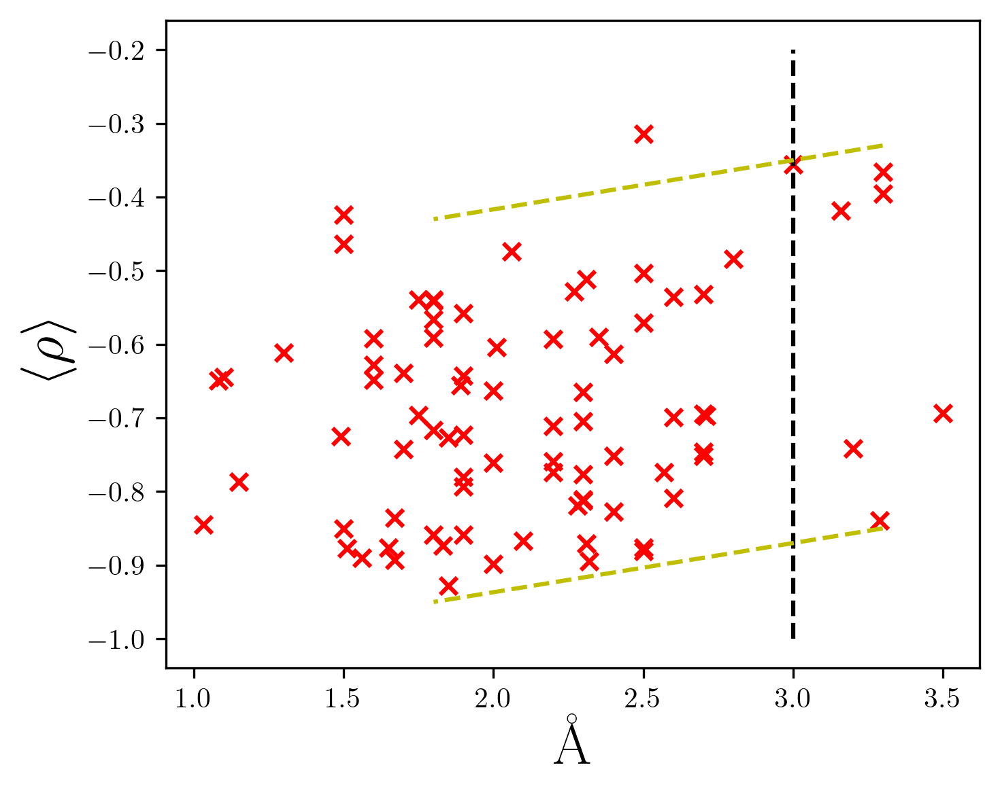

In [405]:
## Resolution against mean spearman

spearman_data = np.zeros((5,len(ss_corr_df)))
score_ref = ["spearman_dockq_zrank", "spearman_dockq_hdock", "spearman_dockq_rosetta", "spearman_dockq_pydock", "spearman_dockq_voromqa"]

for i in range(5):
    for j in range(len(ss_corr_df)):
        if i == 4:
            spearman_data[i][j] = ss_corr_df[score_ref[i]].iloc[j] * -1
        else:
            spearman_data[i][j] = ss_corr_df[score_ref[i]].iloc[j]

mean_data_ss = np.mean(spearman_data, axis = 0)

spearman_data = np.zeros((5,len(ss_corr_df)))


mean_data_relax = np.mean(spearman_data, axis = 0)

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

ax.scatter(ss_corr_df["resolution"], mean_data_ss, color = "red", marker = "x", label = "Supersampled")
# ax.scatter(fraction_relaxed_corr_df["resolution"], mean_data_relax, color = "black", marker = "o", facecolor = "None", label = "Not Supersampled")

ax.set_xlabel("Å", fontsize = 20)
ax.set_ylabel(r"$\langle \rho \rangle$", fontsize = 20)

print(spearmanr(ss_corr_df["resolution"], mean_data_ss))
# print(spearmanr(fraction_relaxed_corr_df["resolution"], mean_data_relax))

print(pearsonr(ss_corr_df["resolution"], mean_data_ss))
# print(pearsonr(fraction_relaxed_corr_df["resolution"], mean_data_relax))

## Vertical line at x = 3

x = [3,3]
y = [-1, -0.2]
ax.plot(x,y,"k--")

## Add special line

x = [3.3, 3, 2.7, 2.4, 2.1, 1.8]
y = [-0.85, -0.87, -0.89, -0.91, -0.93, -0.95]
ax.plot(x,y,"y--")

x = [3.3, 3, 2.7, 2.4, 2.1, 1.8]
y = [-0.33, -0.35, -0.37, -0.39, -0.41, -0.43]
ax.plot(x,y,"y--")

# plt.legend()
plt.tight_layout()

SpearmanrResult(correlation=0.16340362184143276, pvalue=0.13993270132121974)
(0.2291871739752136, 0.03714589233272207)
-0.5758198467678265


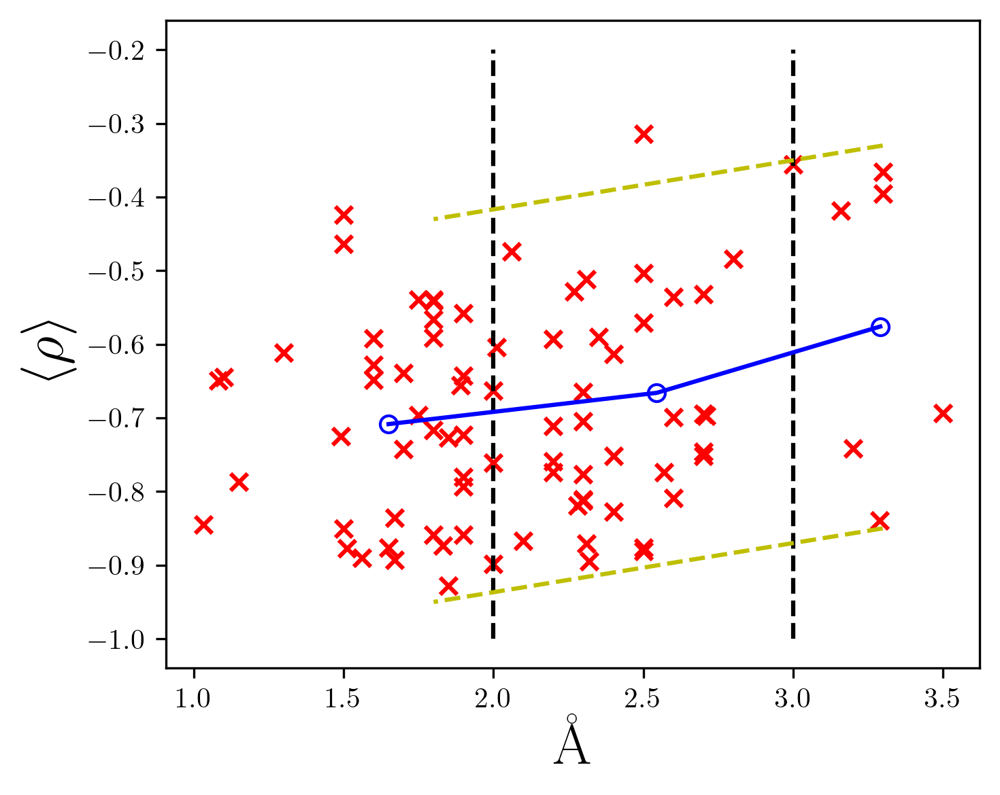

In [417]:
## Resolution against mean pearson

def get_avgs_quick(df_input):
    
    spearman_data = np.zeros((5,len(df_input)))
    score_ref = ["spearman_dockq_zrank", "spearman_dockq_hdock", "spearman_dockq_rosetta", "spearman_dockq_pydock", "spearman_dockq_voromqa"]

    
    for i in range(5):
        for j in range(len(df_input)):
            if i == 4:
                spearman_data[i][j] = df_input[score_ref[i]].iloc[j] * -1
            else:
                spearman_data[i][j] = df_input[score_ref[i]].iloc[j]
            
    return np.mean(spearman_data, axis = 0)

spearman_data = np.zeros((5,len(ss_corr_df)))
score_ref = ["spearman_dockq_zrank", "spearman_dockq_hdock", "spearman_dockq_rosetta", "spearman_dockq_pydock", "spearman_dockq_voromqa"]

for i in range(5):
    for j in range(len(ss_corr_df)):
        if i == 4:
            spearman_data[i][j] = ss_corr_df[score_ref[i]].iloc[j] * -1
        else:
            spearman_data[i][j] = ss_corr_df[score_ref[i]].iloc[j]

mean_data_ss = np.mean(spearman_data, axis = 0)

spearman_data = np.zeros((5,len(ss_corr_df)))


mean_data_relax = np.mean(spearman_data, axis = 0)

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

ax.scatter(ss_corr_df["resolution"], mean_data_ss, color = "red", marker = "x", label = "Supersampled")
# ax.scatter(fraction_relaxed_corr_df["resolution"], mean_data_relax, color = "black", marker = "o", facecolor = "None", label = "Not Supersampled")

ax.set_xlabel("Å", fontsize = 20)
ax.set_ylabel(r"$\langle \rho \rangle$", fontsize = 20)

print(spearmanr(ss_corr_df["resolution"], mean_data_ss))
# print(spearmanr(fraction_relaxed_corr_df["resolution"], mean_data_relax))

print(pearsonr(ss_corr_df["resolution"], mean_data_ss))
# print(pearsonr(fraction_relaxed_corr_df["resolution"], mean_data_relax))

## Vertical line at x = 3

x = [3,3]
y = [-1, -0.2]
ax.plot(x,y,"k--")

## Vertical line at x = 3

x = [2,2]
y = [-1, -0.2]
ax.plot(x,y,"k--")

## Slope line with averages

greater_3 = ss_corr_df[ss_corr_df["resolution"] > 3]
middle_2_3 = ss_corr_df[ss_corr_df["resolution"] <= 3]
middle_2_3 = ss_corr_df[ss_corr_df["resolution"] > 2]
less_2 = ss_corr_df[ss_corr_df["resolution"] < 2]

greater_3_avg = np.mean(get_avgs_quick(greater_3))
middle_2_3_avg = np.mean(get_avgs_quick(middle_2_3))
less_2_avg = np.mean(get_avgs_quick(less_2))

print(greater_3_avg)

x = [np.mean(greater_3["resolution"]), np.mean(middle_2_3["resolution"]), np.mean(less_2["resolution"])]
y = [greater_3_avg, middle_2_3_avg,less_2_avg]

ax.plot(x,y, color = "blue", marker = "o", markerfacecolor = "None")


## Add special line

x = [3.3, 3, 2.7, 2.4, 2.1, 1.8]
y = [-0.85, -0.87, -0.89, -0.91, -0.93, -0.95]
ax.plot(x,y,"y--")

x = [3.3, 3, 2.7, 2.4, 2.1, 1.8]
y = [-0.33, -0.35, -0.37, -0.39, -0.41, -0.43]
ax.plot(x,y,"y--")

# plt.legend()
plt.tight_layout()

In [420]:
dockq_max = [max(ss_score_dict[temp]["DockQ"]) for temp in ss_score_dict.keys()]
print(ss_score_dict.keys())
print(dockq_max)

dict_keys(['1acb', '1ay7', '1c3a', '1euv', '1f60', '1ggp', '1itb', '1j7d', '1kfu', '1mbv', '1n1j', '1pdk', '1qav', '1r8o', '1ry7', '1spp', '1tfo', '1ugh', '1ugq', '1vet', '1wmh', '1wqj', '1wrd', '1xg2', '2bkr', '2d5r', '2dvw', '2fhz', '2g2u', '2grn', '2h7z', '2hla', '2hsm', '2hth', '2oul', '2pe6', '2wmp', '3dgp', '3fpn', '3gfk', '3hw2', '3k9p', '3ona', '3qc8', '3qhy', '3rcz', '3sgb', '3u82', '3vz9', '3wdg', '3whq', '3ygs', '4bi8', '4ct6', '4dbg', '4dhi', '4g6t', '4gi3', '4h5s', '4hwi', '4je3', '4k12', '4qjf', '4qlp', '4uzz', '4yii', '5by8', '5dmb', '5k7m', '5maw', '5mu7', '5uq2', '5zrz', '6fud', '6kp3', '6wg4', '6xod', '6yxj', '6zbk', '7bxh', '7joe', '7jxv', '8enf'])
[0.924, 0.946, 0.934, 0.941, 0.952, 0.827, 0.847, 0.935, 0.869, 0.917, 0.951, 0.885, 0.945, 0.944, 0.881, 0.93, 0.948, 0.942, 0.93, 0.965, 0.955, 0.94, 0.908, 0.935, 0.53, 0.928, 0.932, 0.971, 0.909, 0.964, 0.919, 0.932, 0.871, 0.864, 0.955, 0.907, 0.536, 0.948, 0.843, 0.947, 0.903, 0.935, 0.896, 0.953, 0.928, 0.922, 0.924

<IPython.core.display.Javascript object>


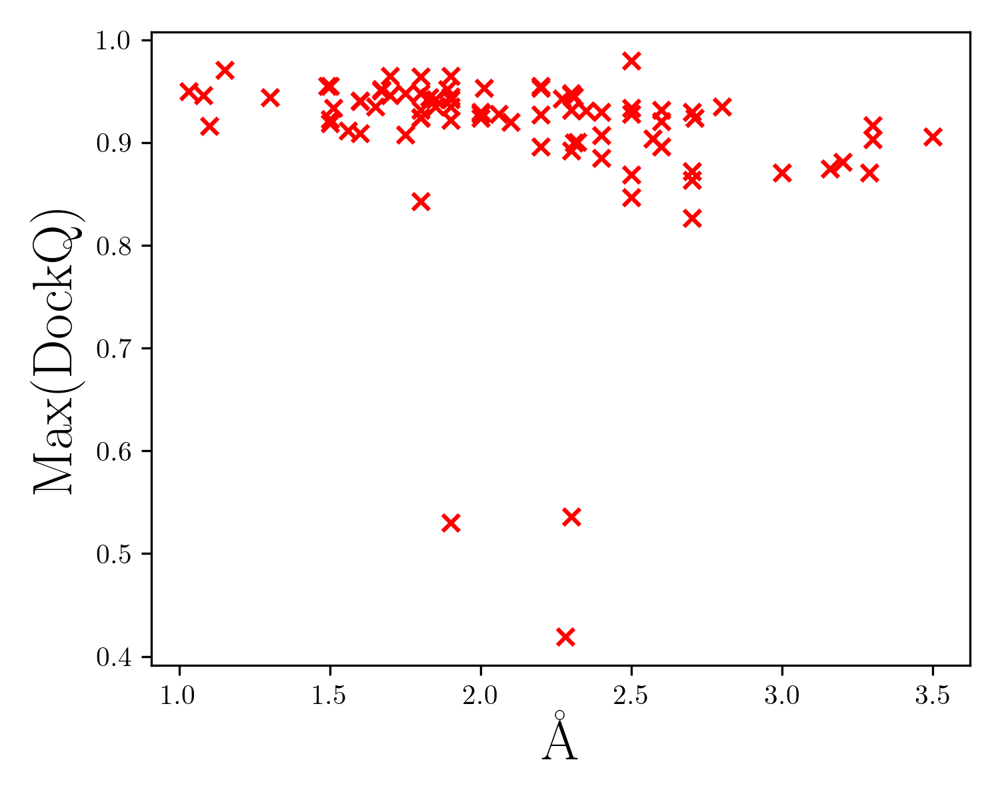

SpearmanrResult(correlation=-0.4907233157238717, pvalue=2.480487571881866e-06)
(-0.19065265128699777, 0.08426454202793285)


In [426]:
## Resolution vs best DockQ
%matplotlib notebook

dockq_max = [max(ss_score_dict[temp]["DockQ"]) for temp in ss_score_dict.keys()]

fig, ax = plt.subplots(figsize = (5,4), dpi = 150)

ax.scatter(ss_corr_df["resolution"], dockq_max, color = "red", marker = "x", label = "Supersampled")
# ax.scatter(fraction_relaxed_corr_df["resolution"], mean_data_relax, color = "black", marker = "o", facecolor = "None", label = "Not Supersampled")

ax.set_xlabel("Å", fontsize = 20)
ax.set_ylabel(r"Max(DockQ)", fontsize = 20)

print(spearmanr(ss_corr_df["resolution"], dockq_max))
# print(spearmanr(fraction_relaxed_corr_df["resolution"], mean_data_relax))

print(pearsonr(ss_corr_df["resolution"], dockq_max))
# print(pearsonr(fraction_relaxed_corr_df["resolution"], mean_data_relax))

## Vertical line at x = 3

# x = [3,3]
# y = [-1, -0.2]
# ax.plot(x,y,"k--")

# ## Add special line

# x = [3.3, 3, 2.7, 2.4, 2.1, 1.8]
# y = [-0.85, -0.87, -0.89, -0.91, -0.93, -0.95]
# ax.plot(x,y,"y--")

# x = [3.3, 3, 2.7, 2.4, 2.1, 1.8]
# y = [-0.33, -0.35, -0.37, -0.39, -0.41, -0.43]
# ax.plot(x,y,"y--")

# plt.legend()
plt.tight_layout()

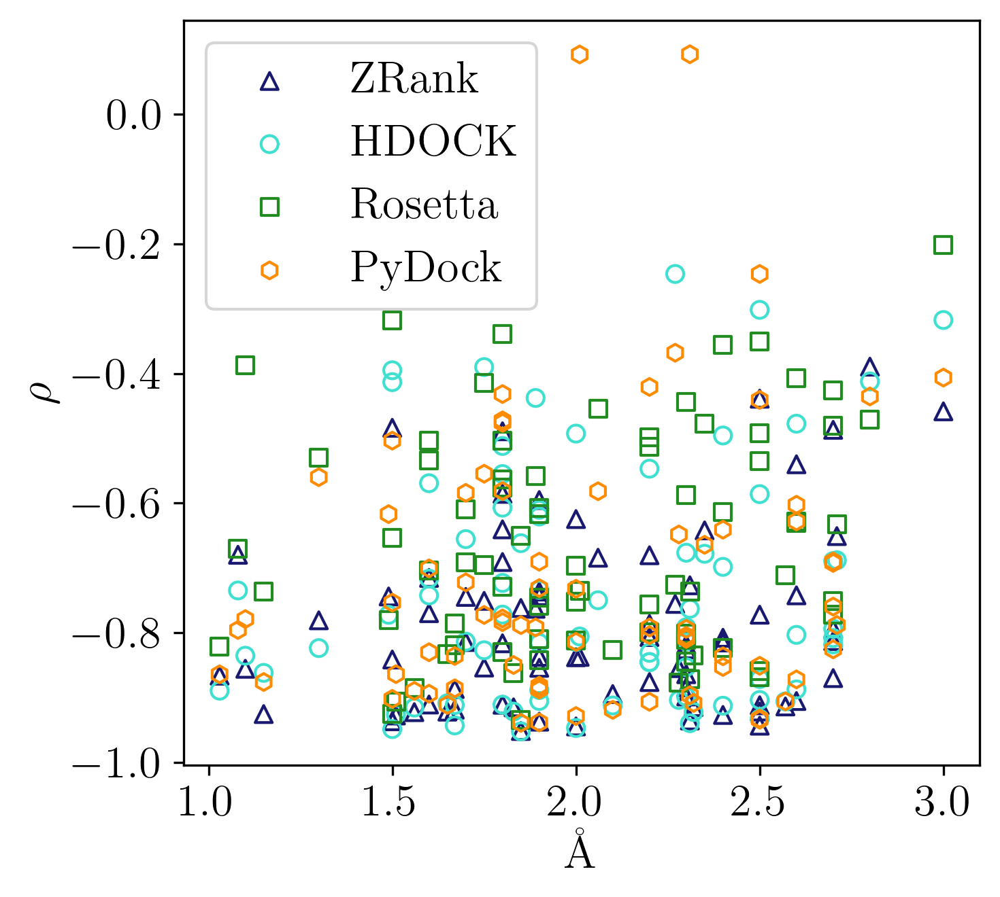

In [47]:
## Figure S3
%matplotlib inline

font_size = 16

fig, ax = plt.subplots(figsize = (5,4.5), dpi = 300)

## Subpanel A

pdb_len = len(ss_corr_df)
spearman_data = np.zeros((4,pdb_len))
score_ref = ["spearman_dockq_zrank", "spearman_dockq_hdock", "spearman_dockq_rosetta", "spearman_dockq_pydock", "spearman_dockq_voromqa"]

for i in range(4):
    for j in range(pdb_len):
        if i == 4:
            spearman_data[i][j] = ss_corr_df[score_ref[i]].iloc[j] * -1
        else:
            spearman_data[i][j] = ss_corr_df[score_ref[i]].iloc[j]

mean_data_ss = np.mean(spearman_data, axis = 0)

# ax.scatter(ss_corr_df["resolution"], mean_data_ss, color = "red", marker = "x", label = "Average")

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid"]

ax.scatter(ss_corr_df["resolution"], ss_corr_df["spearman_dockq_zrank"], color = colors[0], marker = "^",  facecolor = "None", label = "ZRank")
ax.scatter(ss_corr_df["resolution"], ss_corr_df["spearman_dockq_hdock"], color = colors[1], marker = "o", facecolor = "None", label = "HDOCK")
ax.scatter(ss_corr_df["resolution"], ss_corr_df["spearman_dockq_rosetta"], color = colors[2], marker = "s", facecolor = "None", label = "Rosetta")
ax.scatter(ss_corr_df["resolution"], ss_corr_df["spearman_dockq_pydock"], color = colors[3], marker = "h", facecolor = "None", label = "PyDock")


ax.set_xlabel("Å", fontsize = font_size)
ax.set_ylabel(r"$\rho$", fontsize = font_size)


ax.legend(fontsize = font_size)

# ax.text(-0.1, 1.15, "(b)", transform=ax[1].transAxes,fontsize=font_size*1.5, fontweight='bold', va='top', ha='right')
ax.tick_params(axis='both', which='major', labelsize=font_size)
# ax[1].tick_params(axis='both', which='major', labelsize=font_size)
# x_ticks_temp = [-1.0, -0.75, -0.5, -0.25, 0.0, 0.25, 0.5]
# y_ticks_temp = [0, 0.2, 0.4, 0.6, 0.8, 1.0]
# ax[0].set_xticks(x_ticks_temp)
# ax[1].set_xticks(x_ticks_temp)
# ax[0].set_yticks(y_ticks_temp)
# ax[1].set_yticks(y_ticks_temp)

plt.tight_layout()

/var/folders/kr/4__h_fpn42334nd1tdtl4w8w0000gn/T/ipykernel_6162/1590331270.py:71: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  if bins == []:


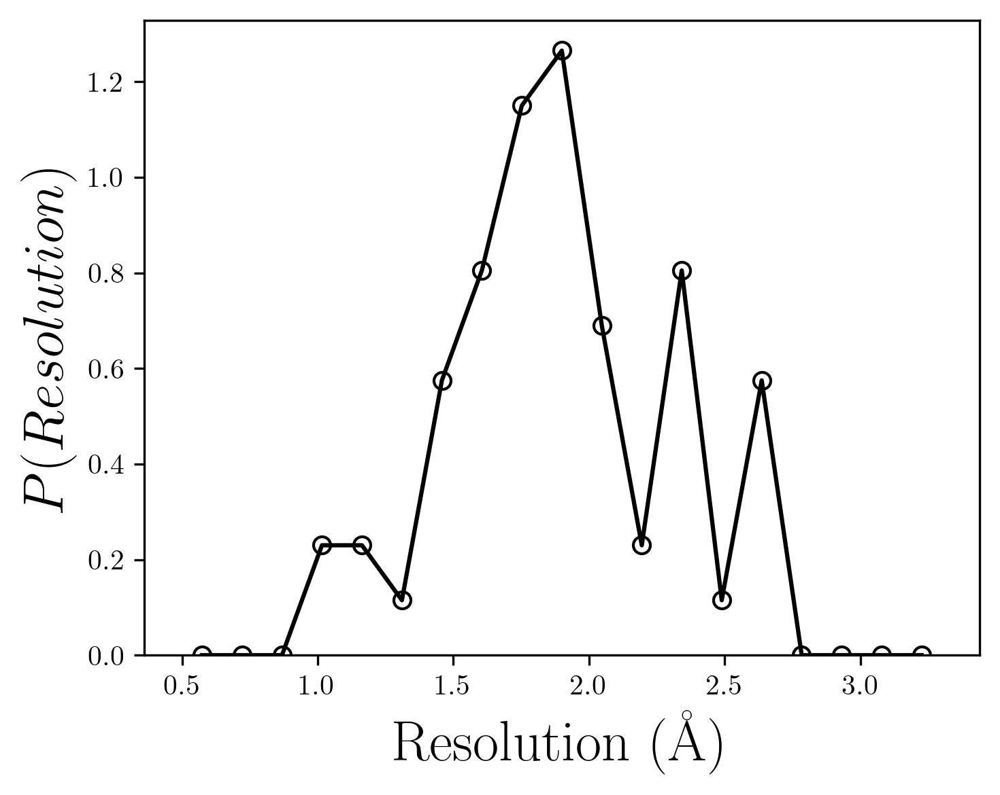

In [432]:
## Resolution Distribution

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)
bins = np.linspace(0.5, 3.3, 20)
create_prob_dist_identical_bins(np.array(ss_corr_df["resolution"]), fig, ax, bins = bins, color = "black", marker = "o")

ax.set_xlabel("Resolution (Å)", fontsize = 20)
ax.set_ylabel("$P(Resolution)$", fontsize = 20)
fig.tight_layout()

# Figure 5: Using flatness and contacts as a score for decoys

In [127]:
ss_corr_df.columns

Index(['pdb', 'pearson_ialign_zrank', 'pearson_ialign_hdock',
       'pearson_ialign_rosetta', 'pearson_ialign_pydock',
       'pearson_ialign_voromqa', 'pearson_ialign_voromqa_js',
       'pearson_ialign_dove_5', 'pearson_ialign_intertwined',
       'pearson_ialign_deeprank_gnn_esm', 'pearson_ialign_contact_42',
       'pearson_ialign_contact_43', 'pearson_ialign_contact_44',
       'pearson_ialign_contact_45', 'pearson_ialign_interface_rsa',
       'pearson_dockq_zrank', 'pearson_dockq_hdock', 'pearson_dockq_rosetta',
       'pearson_dockq_pydock', 'pearson_dockq_voromqa',
       'pearson_dockq_voromqa_js', 'pearson_dockq_dove_5',
       'pearson_dockq_intertwined', 'pearson_dockq_deeprank_gnn_esm',
       'pearson_dockq_contact_42', 'pearson_dockq_contact_43',
       'pearson_dockq_contact_44', 'pearson_dockq_contact_45',
       'pearson_dockq_interface_rsa', 'spearman_ialign_zrank',
       'spearman_ialign_hdock', 'spearman_ialign_rosetta',
       'spearman_ialign_pydock', 'spearma

SpearmanrResult(correlation=0.7338058114812189, pvalue=2.022839830772216e-15)
SpearmanrResult(correlation=0.7453072795383213, pvalue=4.2732064210507966e-16)
SpearmanrResult(correlation=-0.807735142249671, pvalue=1.6449409043394634e-20)
SpearmanrResult(correlation=-0.8109142452161587, pvalue=8.89008526785198e-21)
(0.5394006928402947, 1.195797682260224e-07)
(0.4871509820332446, 2.6114380981623428e-06)
(-0.5414056229672113, 1.0511418829745062e-07)
(-0.5514154827214677, 5.452093948372386e-08)


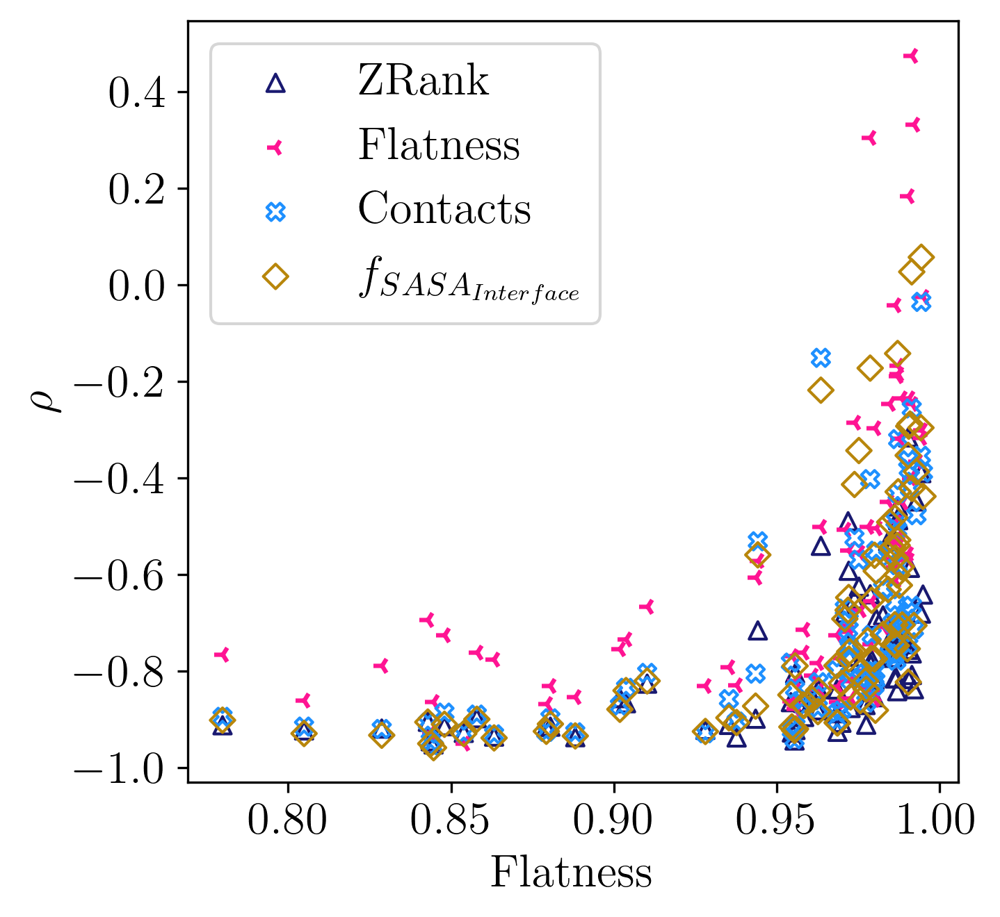

In [132]:
## Getting Looking at just flatness for this regime as a comparison point

fig, ax = plt.subplots(figsize = (5,4.5), dpi = 300)

font_size = 16

colors = ["midnightblue", "deeppink", "dodgerblue", "darkgoldenrod"]

## Plotting the data

ax.scatter(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_zrank"], color = colors[0], marker = "^",  facecolor = "None", label = "ZRank")
ax.scatter(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_intertwined"], color = colors[1], marker = "3", label = "Flatness")
ax.scatter(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_contact_45"]*-1, color = colors[2], marker = "X", label = "Contacts", facecolor = "None")
ax.scatter(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_interface_rsa"]*-1, color = colors[3], marker = "D", label = "$f_{SASA_{Interface}}$", facecolor = "None")


print(spearmanr(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_zrank"]))
print(spearmanr(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_intertwined"]))
print(spearmanr(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_contact_45"]))
print(spearmanr(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_interface_rsa"]))

print(pearsonr(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_zrank"]))
print(pearsonr(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_intertwined"]))
print(pearsonr(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_contact_45"]))
print(pearsonr(ss_corr_df["flatness_p3"], ss_corr_df["spearman_dockq_interface_rsa"]))


ax.set_xlabel("Flatness", fontsize = font_size)
ax.set_ylabel(r"$\rho$", fontsize = font_size)

ax.tick_params(axis='both', which='major', labelsize=font_size)

plt.legend(fontsize = font_size)
fig.tight_layout()

['1ugq', '5by8', '3whq', '1kfu', '5maw', '1r8o', '4g6t', '1c3a', '2fhz', '4qjf', '2bkr', '5k7m', '1n1j', '4uzz', '1pdk', '1f60', '1itb', '3dgp', '1ry7', '1euv', '5mu7', '2wmp', '8enf', '3wdg', '2hla', '1vet', '1ggp', '4qlp', '1tfo', '4je3', '4ct6', '1ugh', '4gi3', '2oul', '5uq2', '3vz9', '2dvw', '4bi8', '6fud', '5dmb', '3qc8', '7joe', '2g2u', '3fpn', '1spp', '1ay7', '7bxh', '4h5s', '6yxj', '3qhy', '1xg2', '1j7d', '6zbk', '3sgb', '6wg4', '2d5r', '4k12', '1qav', '3gfk', '1wqj', '4yii', '1wrd', '3rcz', '4u1c', '1mbv', '2pe6', '1acb', '1wmh', '6xod', '4dbg', '2hsm', '3u82', '4dhi', '3ygs', '4hwi', '6kp3', '2hth', '7jxv', '3ona', '2h7z', '2grn', '3hw2', '3k9p', '5zrz']


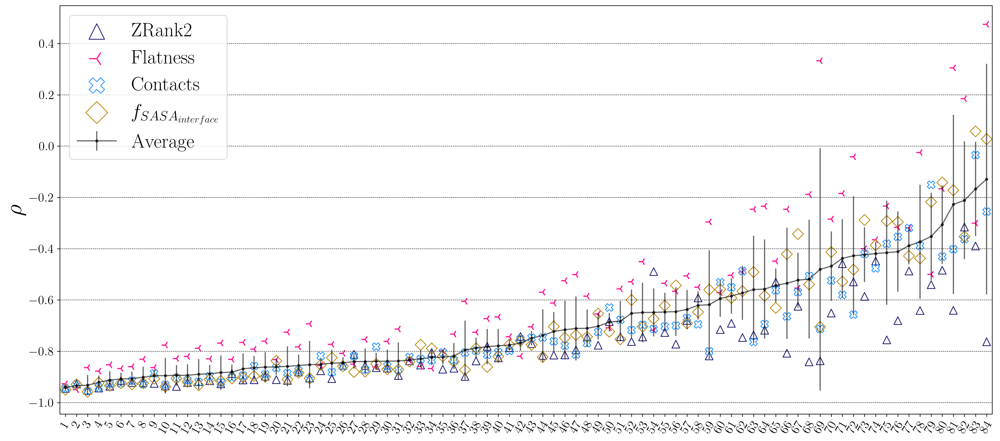

In [183]:
## Creating Figure 3 but with Deeprank-GNN data

num_samples = len(ss_corr_df)
colors = ["midnightblue", "deeppink", "dodgerblue", "darkgoldenrod"]



score_ref = ["spearman_dockq_zrank", "spearman_dockq_intertwined", "spearman_dockq_contact_45",
             "spearman_dockq_interface_rsa"]
spearman_data = np.zeros((len(score_ref),num_samples))

for i in range(len(score_ref)):
    for j in range(num_samples):
        if "contact" in score_ref[i] or "interface" in score_ref[i]:
            spearman_data[i][j] = ss_corr_df[score_ref[i]].iloc[j] * -1
        else:
            spearman_data[i][j] = ss_corr_df[score_ref[i]].iloc[j]

fig, ax = plt.subplots(figsize = (18,8), dpi = 300)

mean_data = np.mean(spearman_data, axis = 0)

stdev_data = np.std(spearman_data, axis = 0)

sorted_data = spearman_data[:, mean_data.argsort()]

sorted_mean_data = mean_data[mean_data.argsort()]

sorted_stdev_data = stdev_data[mean_data.argsort()]


pdb_order = list(np.array(ss_corr_df["pdb"])[mean_data.argsort()])
print(pdb_order)
label_ticks = list(range(1, len(ss_corr_df)+1))
x = np.linspace(0.5, num_samples-0.5, num_samples)
plt.xticks(x, label_ticks)
plt.xticks(rotation = 60, fontsize = 16)
plt.yticks(fontsize = 16)
plt.xlim(0, num_samples)

marker_size = 100

ax.scatter(x, sorted_data[0], color = colors[0], marker = "^", label = "ZRank2", facecolor = "None", s = marker_size)
ax.scatter(x, sorted_data[1], color = colors[1], marker = "3", label = "Flatness", s = marker_size)
ax.scatter(x, sorted_data[2], color = colors[2], marker = "X", label = "Contacts", facecolor = "None", s = marker_size)
ax.scatter(x, sorted_data[3], color = colors[3], marker = "D", label = "$f_{SASA_{interface}}$", facecolor = "None", s = marker_size)

plt.errorbar(x, sorted_mean_data, yerr = sorted_stdev_data, color = "black", marker = ".", label = "Average", alpha = 0.6)

ax.set_ylabel(r"$\rho$", fontsize = 30)

fig.tight_layout()
lgnd = plt.legend(fontsize = 25)
lgnd.legendHandles[0]._sizes = [400]
lgnd.legendHandles[1]._sizes = [400]
lgnd.legendHandles[2]._sizes = [400]
lgnd.legendHandles[3]._sizes = [400]
lgnd.legendHandles[4]._sizes = [400]

plt.grid(axis = "y", color = 'black', linestyle = '--', linewidth = 0.5)
plt.savefig(join(figure_save_dir, "per_target_spearman_physical_scores.png"))

In [346]:
# print("ZRANK", np.mean(ss_corr_df["spearman_dockq_zrank"]))
# print("HDOCK", np.mean(ss_corr_df["spearman_dockq_hdock"]))
# print("ROSETTA", np.mean(ss_corr_df["spearman_dockq_rosetta"]))
# print("PYDOCK", np.mean(ss_corr_df["spearman_dockq_pydock"]))
# print("VOROMQA", np.mean(ss_corr_df["spearman_dockq_voromqa"]))
# print("DEEPRANK", np.mean(ss_corr_df["spearman_dockq_deeprank_gnn_esm"]))
# print("FLATNESS", np.mean(ss_corr_df["spearman_dockq_intertwined"]))
# print("DOCKQ", np.mean(ss_corr_df["spearman_dockq_contact_45"]))
# print("INTERFACE_RSA", np.mean(ss_corr_df["spearman_dockq_interface_rsa"]))

new_list = []

new_list.append(("ZRANK", np.mean(ss_corr_df["spearman_dockq_zrank"])))
new_list.append(("HDOCK", np.mean(ss_corr_df["spearman_dockq_hdock"])))
new_list.append(("ROSETTA", np.mean(ss_corr_df["spearman_dockq_rosetta"])))
new_list.append(("PYDOCK", np.mean(ss_corr_df["spearman_dockq_pydock"])))
new_list.append(("VOROMQA", np.mean(ss_corr_df["spearman_dockq_voromqa"]*-1)))
new_list.append(("DEEPRANK", np.mean(ss_corr_df["spearman_dockq_deeprank_gnn_esm"]*-1)))
new_list.append(("FLATNESS", np.mean(ss_corr_df["spearman_dockq_intertwined"])))
new_list.append(("CONTACT", np.mean(ss_corr_df["spearman_dockq_contact_45"]*-1)))
new_list.append(("INTERFACE_RSA", np.mean(ss_corr_df["spearman_dockq_interface_rsa"]*-1)))

sort_list = sorted(new_list, key = lambda x: x[1])

for name, score in sort_list:
    if len(name)<8:
        print(f"{name}\t\t{score}")
    else:
        print(f"{name}\t{score}")

ZRANK		-0.7778638790471619
HDOCK		-0.7356066833565911
CONTACT		-0.7223768373756357
PYDOCK		-0.7173486515746138
INTERFACE_RSA	-0.6944123767007305
ROSETTA		-0.6506865963072884
FLATNESS	-0.5766366897272404
VOROMQA		-0.5627137201603863
DEEPRANK	-0.5213085608648156


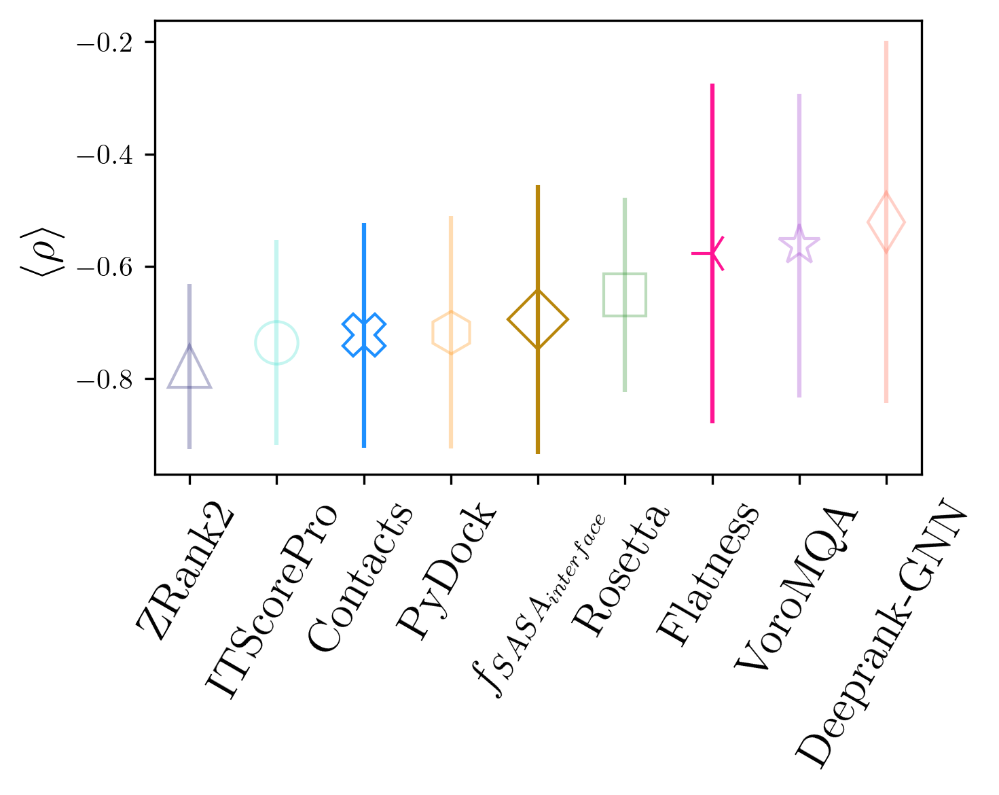

In [185]:
## Show a plot of the average spearman BUT NO DOVE

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid", "indianred", "tomato",
         "deeppink", "dodgerblue", "darkgoldenrod"]

markers = ["^", "o", "s", "h", "*", "P", "d", "3", "X", "D"]

x_axis = range(9)


ss_plot_data = [np.mean(ss_corr_df["spearman_dockq_zrank"]), np.mean(ss_corr_df["spearman_dockq_hdock"]),
                    np.mean(ss_corr_df["spearman_dockq_rosetta"]), np.mean(ss_corr_df["spearman_dockq_pydock"]),
                    np.mean(ss_corr_df["spearman_dockq_voromqa"]*-1), np.mean(ss_corr_df["spearman_dockq_dove_5"]),
                    np.mean(ss_corr_df["spearman_dockq_deeprank_gnn_esm"]*-1), np.mean(ss_corr_df["spearman_dockq_intertwined"]),
                    np.mean(ss_corr_df["spearman_dockq_contact_45"])*-1, np.mean(ss_corr_df["spearman_dockq_interface_rsa"])*-1]


ss_plot_std = [np.std(ss_corr_df["spearman_dockq_zrank"]), np.std(ss_corr_df["spearman_dockq_hdock"]),
                    np.std(ss_corr_df["spearman_dockq_rosetta"]), np.std(ss_corr_df["spearman_dockq_pydock"]),
                    np.std(ss_corr_df["spearman_dockq_voromqa"]*-1), np.std(ss_corr_df["spearman_dockq_dove_5"]),
                      np.std(ss_corr_df["spearman_dockq_deeprank_gnn_esm"]*-1), np.std(ss_corr_df["spearman_dockq_intertwined"]),
                    np.std(ss_corr_df["spearman_dockq_contact_45"])*-1, np.std(ss_corr_df["spearman_dockq_interface_rsa"])*-1]

plt.errorbar(x_axis[0], ss_plot_data[0], yerr = ss_plot_std[0], color = colors[0], marker = markers[0], markerfacecolor = "None", markersize = 15, alpha = 0.3)
plt.errorbar(x_axis[1], ss_plot_data[1], yerr = ss_plot_std[1], color = colors[1], marker = markers[1], markerfacecolor = "None", markersize = 15, alpha = 0.3)
plt.errorbar(x_axis[5], ss_plot_data[2], yerr = ss_plot_std[2], color = colors[2], marker = markers[2], markerfacecolor = "None", markersize = 15, alpha = 0.3)
plt.errorbar(x_axis[3], ss_plot_data[3], yerr = ss_plot_std[3], color = colors[3], marker = markers[3], markerfacecolor = "None", markersize = 15, alpha = 0.3)
plt.errorbar(x_axis[7], ss_plot_data[4], yerr = ss_plot_std[4], color = colors[4], marker = markers[4], markerfacecolor = "None", markersize = 15, alpha = 0.3)
# plt.errorbar(x_axis[6], ss_plot_data[5], yerr = ss_plot_std[5], color = colors[5], marker = markers[5], markerfacecolor = "None", markersize = 15)
plt.errorbar(x_axis[8], ss_plot_data[6], yerr = ss_plot_std[6], color = colors[6], marker = markers[6], markerfacecolor = "None", markersize = 15, alpha = 0.3)
plt.errorbar(x_axis[6], ss_plot_data[7], yerr = ss_plot_std[7], color = colors[7], marker = markers[7], markersize = 15)
plt.errorbar(x_axis[2], ss_plot_data[8], yerr = ss_plot_std[8], color = colors[8], marker = markers[8], markerfacecolor = "None", markersize = 15)
plt.errorbar(x_axis[4], ss_plot_data[9], yerr = ss_plot_std[9], color = colors[9], marker = markers[9], markerfacecolor = "None", markersize = 15)

                              
score_list = ["ZRank2", "ITScorePro", "Contacts", "PyDock", "$f_{SASA_{interface}}$", "Rosetta", 
             "Flatness", "VoroMQA", "Deeprank-GNN"]
plt.xticks(x_axis, score_list, fontsize = 16, rotation = 60)

ax.set_ylabel(r"$\langle \rho \rangle$", fontsize = 16)
fig.tight_layout()
plt.savefig(join(figure_save_dir, "simple_spearman_graph_with_physical_dimmed.png"))

### PCA for the 3 phyiscal metrics

In [190]:
ss_score_dict["1acb"].columns

Index(['Decoy', 'Model', 'Fnat', 'iRMSD', 'LRMSD', 'CAPRI', 'DockQ',
       'IS-Score', 'ZRank', 'HDOCK', 'Rosetta', 'PyDock', 'VoroMQA',
       'VoroMQA_js', 'Dove_5', 'Intertwined', 'Deeprank_gnn_esm', 'Contact_42',
       'Contact_43', 'Contact_44', 'Contact_45', 'Interface_rsa',
       'ZRank Z-score', 'HDOCK Z-score', 'Rosetta Z-score', 'PyDock Z-score',
       'VoroMQA Z-score', 'VoroMQA_js Z-score', 'Dove_5 Z-score',
       'Deeprank_gnn_esm Z-score'],
      dtype='object')

In [202]:
def perform_pca(corr_df, cols, n_components = 2):
    '''
    Performs PCA using Scikit-learn on the data
    and with n_components. The output will
    be in the form of the principal components
    array
    '''
    
    ## Save data in dataframe to numpy array
    data = np.zeros((len(corr_df), n_components))
    
    for i in range(n_components):
        temp_data = np.array(corr_df[cols[i]])
        z_normalized = (temp_data - np.mean(temp_data))/np.std(temp_data)
        data[:,i] = z_normalized
    
    print(data.shape)
    ## Perform PCA
    pca = PCA(n_components)
    pca.fit(data)
    ev = pca.explained_variance_ratio_
    for i in range(n_components):
        print(f"Explained variance for PC{i+1}: {ev[i]}")
    return pca.transform(data)

In [218]:
### Creating a combination of the 3 physical scores using PCA per each target at a time

cols_to_add = ["pdb", "spearman_pca", "pearson_pca"]
physical_pca_scores_dict = {}
physical_pca_dict = {col : [] for col in cols_to_add}
pca_cols = ["Intertwined", "Contact_45", "Interface_rsa"]

for pdb in list(ss_corr_df["pdb"]):
    target_df_temp = ss_score_dict[pdb]
    print(pdb)
    temp_pca = perform_pca(target_df_temp, pca_cols, n_components=len(pca_cols))
    
    ## Store the PCA scores to be plotted if necessary
    physical_pca_scores_dict[pdb] = temp_pca
    
    ## Get the Pearson and Spearman correlations between PC1 and DockQ
    
#     print(len(temp_pca[:,0]))
#     print(len(np.array(target_df_temp["DockQ"])))
    
    temp_pearson = pearsonr(temp_pca[:,0], np.array(target_df_temp["DockQ"]))[0]
    temp_spearman = spearmanr(temp_pca[:,0], np.array(target_df_temp["DockQ"]))[0]
    
    ## Add data to dict
    
    physical_pca_dict["pdb"].append(pdb)
    
    if temp_spearman > 0:
        physical_pca_dict["spearman_pca"].append(temp_spearman*-1)
    else:
        physical_pca_dict["spearman_pca"].append(temp_spearman)
    
    if temp_pearson > 0:
        physical_pca_dict["pearson_pca"].append(temp_pearson*-1)
    else:
        physical_pca_dict["pearson_pca"].append(temp_pearson)
        
physical_pca_df = pd.DataFrame(physical_pca_dict)

1acb
(1394, 3)
Explained variance for PC1: 0.7369837796604274
Explained variance for PC2: 0.18772060981747812
Explained variance for PC3: 0.07529561052209446
1ay7
(1352, 3)
Explained variance for PC1: 0.8196925145221495
Explained variance for PC2: 0.14005978190799742
Explained variance for PC3: 0.040247703569853126
1c3a
(1330, 3)
Explained variance for PC1: 0.9027216422601225
Explained variance for PC2: 0.07972198977025023
Explained variance for PC3: 0.01755636796962728
1euv
(1392, 3)
Explained variance for PC1: 0.931786647069002
Explained variance for PC2: 0.04108007566223738
Explained variance for PC3: 0.02713327726876059
1f60
(1348, 3)
Explained variance for PC1: 0.9232897690172508
Explained variance for PC2: 0.06226213453205579
Explained variance for PC3: 0.014448096450693419
1ggp
(1260, 3)
Explained variance for PC1: 0.9107810292499696
Explained variance for PC2: 0.05014394383024012
Explained variance for PC3: 0.03907502691979017
1itb
(1214, 3)
Explained variance for PC1: 0.833209

In [208]:
physical_pca_df

,pdb,spearman_pca,pearson_pca
0,1acb,-0.560266,-0.609628
1,1ay7,-0.761510,-0.727037
2,1c3a,-0.934137,-0.949899
3,1euv,-0.869201,-0.905071
4,1f60,-0.912299,-0.940672
...,...,...,...
79,6zbk,-0.704572,-0.744200
80,7bxh,-0.754178,-0.708331
81,7joe,-0.824570,-0.833885
82,7jxv,-0.356035,-0.311271


In [209]:
print(np.mean(physical_pca_df['spearman_pca']))

-0.7181417933239713


['1ugq', '5by8', '3whq', '1kfu', '5maw', '1r8o', '4g6t', '1c3a', '2fhz', '4qjf', '2bkr', '5k7m', '1n1j', '4uzz', '1pdk', '1f60', '1itb', '1ry7', '3dgp', '5mu7', '8enf', '2wmp', '1euv', '3wdg', '2hla', '1vet', '1ggp', '4qlp', '4ct6', '1tfo', '4je3', '1ugh', '4gi3', '2oul', '5uq2', '3vz9', '2dvw', '6fud', '4bi8', '3qc8', '5dmb', '7joe', '2g2u', '3fpn', '1spp', '1ay7', '4h5s', '7bxh', '6yxj', '1xg2', '3qhy', '3sgb', '6zbk', '1j7d', '6wg4', '2d5r', '4k12', '1qav', '3gfk', '1wqj', '4yii', '1wrd', '4u1c', '3rcz', '1mbv', '2pe6', '1acb', '6xod', '1wmh', '4dbg', '3u82', '2hsm', '3ygs', '4dhi', '4hwi', '6kp3', '2hth', '7jxv', '3ona', '2h7z', '3hw2', '2grn', '3k9p', '5zrz']


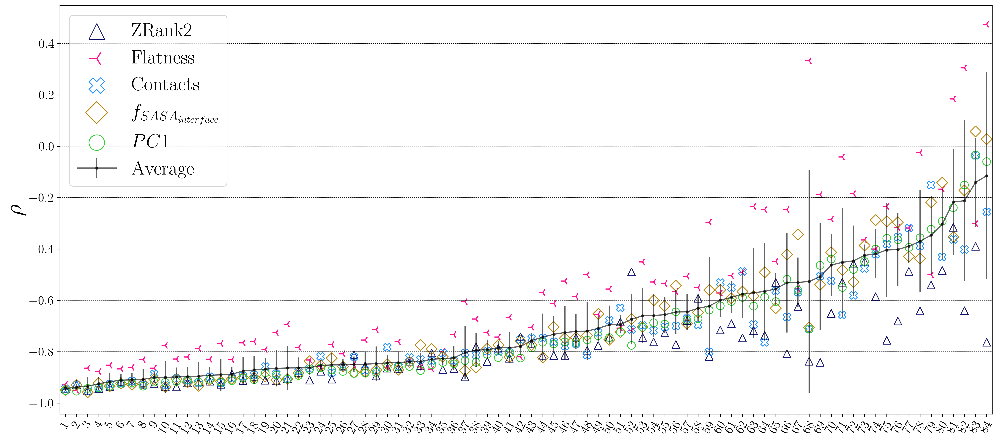

In [212]:
## Creating the per target figure with PCA data

num_samples = len(ss_corr_df)
colors = ["midnightblue", "deeppink", "dodgerblue", "darkgoldenrod", "limegreen"]



score_ref = ["spearman_dockq_zrank", "spearman_dockq_intertwined", "spearman_dockq_contact_45",
             "spearman_dockq_interface_rsa", "spearman_pca"]
spearman_data = np.zeros((len(score_ref),num_samples))

for i in range(len(score_ref)):
    for j in range(num_samples):
        if "contact" in score_ref[i] or "interface" in score_ref[i]:
            spearman_data[i][j] = ss_corr_df[score_ref[i]].iloc[j] * -1
        elif "pca" in score_ref[i]:
            spearman_data[i][j] = physical_pca_df[score_ref[i]].iloc[j]
        else:
            spearman_data[i][j] = ss_corr_df[score_ref[i]].iloc[j]

fig, ax = plt.subplots(figsize = (18,8), dpi = 300)

mean_data = np.mean(spearman_data, axis = 0)

stdev_data = np.std(spearman_data, axis = 0)

sorted_data = spearman_data[:, mean_data.argsort()]

sorted_mean_data = mean_data[mean_data.argsort()]

sorted_stdev_data = stdev_data[mean_data.argsort()]


pdb_order = list(np.array(ss_corr_df["pdb"])[mean_data.argsort()])
print(pdb_order)
label_ticks = list(range(1, len(ss_corr_df)+1))
x = np.linspace(0.5, num_samples-0.5, num_samples)
plt.xticks(x, label_ticks)
plt.xticks(rotation = 60, fontsize = 16)
plt.yticks(fontsize = 16)
plt.xlim(0, num_samples)

marker_size = 100

ax.scatter(x, sorted_data[0], color = colors[0], marker = "^", label = "ZRank2", facecolor = "None", s = marker_size)
ax.scatter(x, sorted_data[1], color = colors[1], marker = "3", label = "Flatness", s = marker_size)
ax.scatter(x, sorted_data[2], color = colors[2], marker = "X", label = "Contacts", facecolor = "None", s = marker_size)
ax.scatter(x, sorted_data[3], color = colors[3], marker = "D", label = "$f_{SASA_{interface}}$", facecolor = "None", s = marker_size)
ax.scatter(x, sorted_data[4], color = colors[4], marker = "o", label = "$PC1$", facecolor = "None", s = marker_size)

plt.errorbar(x, sorted_mean_data, yerr = sorted_stdev_data, color = "black", marker = ".", label = "Average", alpha = 0.6)

ax.set_ylabel(r"$\rho$", fontsize = 30)

fig.tight_layout()
lgnd = plt.legend(fontsize = 25)
lgnd.legendHandles[0]._sizes = [400]
lgnd.legendHandles[1]._sizes = [400]
lgnd.legendHandles[2]._sizes = [400]
lgnd.legendHandles[3]._sizes = [400]
lgnd.legendHandles[4]._sizes = [400]

plt.grid(axis = "y", color = 'black', linestyle = '--', linewidth = 0.5)
plt.savefig(join(figure_save_dir, "per_target_spearman_physical_scores_and_pca.png"))

## Doing the same now, but with Support Vector Regression

In [349]:
from sklearn.svm import SVR

def perform_svr(corr_df, cols, n_components = 2):
    '''
    Performs support vector regression
    using Scikit-learn on the data
    and with n_components. The output will
    be in the form of the principal components
    array
    '''
    
    ## Store data in dataframe to numpy array
    data = np.zeros((len(corr_df), n_components))
    
    ## Z normalize the data
    for i in range(n_components):
        temp_data = np.array(corr_df[cols[i]])
        z_normalized = (temp_data - np.mean(temp_data))/np.std(temp_data)
        data[:,i] = z_normalized
    
    ## Perform SVR
    svr = SVR()
    svr.fit(data, corr_df["DockQ"]) ## Fit to DockQ
    return svr.predict(data)

def perform_svr_loo(corr_dict, pdb_to_exclude, cols):
    '''
    Performs support vector regression
    using Scikit-learn in a leave-one-out
    fashion, where the pdb_to_exclude is left
    out of the trained model. The 'cols' are used
    for the training.  
    '''
    
    ## Store data in dataframe to numpy array
    data_x = [[],[],[]]
    data_y = []     
    count = [0,0,0]
    
    test_x = []
    
    ## Z normalize the data
    for temp_pdb in list(corr_dict.keys()):
        if temp_pdb not in pdb_to_exclude:
            corr_df = corr_dict[temp_pdb]
            for i in range(len(cols)):
                temp_data = np.array(corr_df[cols[i]])
                z_normalized = (temp_data - np.mean(temp_data))/np.std(temp_data)
                z_normalized = list(z_normalized)
                count[i] += len(z_normalized)
                data_x[i] += z_normalized ## Add to the proper list of data variables
                
            ## Get temp_y (dockq) data and normalize
                
            temp_data_y = np.array(corr_df["DockQ"])
            z_normalized = (temp_data_y - np.mean(temp_data_y))/np.std(temp_data_y)
            z_normalized = list(z_normalized)
            data_y += z_normalized
        
        elif temp_pdb in pdb_to_exclude:
            ## The PDB is the one that we are testing on
            corr_df = corr_dict[temp_pdb]
            for i in range(len(cols)):
                temp_data = np.array(corr_df[cols[i]])
                z_normalized = (temp_data - np.mean(temp_data))/np.std(temp_data)
                z_normalized = list(z_normalized)
                test_x.append(z_normalized)
    
    ## Perform SVR
    data_x = np.array(data_x).T
    data_y = np.array(data_y)
    svr = SVR()
    svr.fit(data_x, data_y) ## Fit to DockQ
    test_x = np.array(test_x).T
    print(test_x.shape)
    return svr.predict(test_x) ## Test on the leave one out and return the results

In [351]:
## Quickly save the score dict as a pickle file

import pickle

os.chdir("/Users/jakesumner/Desktop/PPI Project/supersampling")

with open("score_dict_superampling.pickle", "wb") as f:
    pickle.dump(ss_score_dict, f)

In [350]:
### Creating a combination of the 3 physical scores using SVR per each target at a time
### THIS IS THE LEAVE ONE OUT VERSION (NO DATA LEAKAGE)

cols_to_add = ["pdb", "spearman_svr", "pearson_svr"]
physical_svr_scores_dict = {}
physical_svr_dict = {col : [] for col in cols_to_add}
pca_cols = ["Intertwined", "Contact_45", "Interface_rsa"]

for pdb in list(ss_corr_df["pdb"]):
    print(pdb)
    
    ## Performs the leave one out method for the SVR
    temp_svr = perform_svr_loo(ss_score_dict, pdb, pca_cols) 
    
    ## Store the PCA scores to be plotted if necessary
    physical_svr_scores_dict[pdb] = temp_svr
    
    ## Get the Pearson and Spearman correlations between PC1 and DockQ
    
    print(len(temp_svr))
    print(len(np.array(ss_score_dict[pdb]["DockQ"])))
    
    temp_pearson = pearsonr(temp_svr, np.array(ss_score_dict[pdb]["DockQ"]))[0]
    temp_spearman = spearmanr(temp_svr, np.array(ss_score_dict[pdb]["DockQ"]))[0]
    
    ## Add data to dict
    
    physical_svr_dict["pdb"].append(pdb)
    
    if temp_spearman > 0:
        physical_svr_dict["spearman_svr"].append(temp_spearman*-1)
    else:
        physical_svr_dict["spearman_svr"].append(temp_spearman)
    
    if temp_pearson > 0:
        physical_svr_dict["pearson_svr"].append(temp_pearson*-1)
    else:
        physical_svr_dict["pearson_svr"].append(temp_pearson)
        
physical_svr_df = pd.DataFrame(physical_svr_dict)

1acb
(1394, 3)
1394
1394
1ay7
(1352, 3)
1352
1352
1c3a
(1330, 3)
1330
1330
1euv


KeyboardInterrupt: 

In [ ]:
physical_svr_df

In [217]:
### Creating a combination of the 3 physical scores using SVR per each target at a time
### THIS IS THE DATA LEAKAGE VERSION

cols_to_add = ["pdb", "spearman_svr", "pearson_svr"]
physical_svr_scores_dict = {}
physical_svr_dict = {col : [] for col in cols_to_add}
pca_cols = ["Intertwined", "Contact_45", "Interface_rsa"]

for pdb in list(ss_corr_df["pdb"]):
    target_df_temp = ss_score_dict[pdb]
    print(pdb)
    temp_svr = perform_svr(target_df_temp, pca_cols, n_components=len(pca_cols))
    
    ## Store the PCA scores to be plotted if necessary
    physical_svr_scores_dict[pdb] = temp_svr
    
    ## Get the Pearson and Spearman correlations between PC1 and DockQ
    
    print(len(temp_svr))
    print(len(np.array(target_df_temp["DockQ"])))
    
    temp_pearson = pearsonr(temp_svr, np.array(target_df_temp["DockQ"]))[0]
    temp_spearman = spearmanr(temp_svr, np.array(target_df_temp["DockQ"]))[0]
    
    ## Add data to dict
    
    physical_svr_dict["pdb"].append(pdb)
    
    if temp_spearman > 0:
        physical_svr_dict["spearman_svr"].append(temp_spearman*-1)
    else:
        physical_svr_dict["spearman_svr"].append(temp_spearman)
    
    if temp_pearson > 0:
        physical_svr_dict["pearson_svr"].append(temp_pearson*-1)
    else:
        physical_svr_dict["pearson_svr"].append(temp_pearson)
        
physical_svr_df = pd.DataFrame(physical_svr_dict)

1acb
1394
1394
1ay7
1352
1352
1c3a
1330
1330
1euv
1392
1392
1f60
1348
1348
1ggp
1260
1260
1itb
1214
1214
1j7d
1388
1388
1kfu
1214
1214
1mbv
894
894
1n1j
1392
1392
1pdk
1256
1256
1qav
1390
1390
1r8o
1336
1336
1ry7
1332
1332
1spp
1390
1390
1tfo
1408
1408
1ugh
1386
1386
1ugq
1218
1218
1vet
1438
1438
1wmh
1420
1420
1wqj
1414
1414
1wrd
1392
1392
1xg2
1222
1222
2bkr
1324
1324
2d5r
1188
1188
2dvw
1418
1418
2fhz
1400
1400
2g2u
1316
1316
2grn
1368
1368
2h7z
1396
1396
2hla
1370
1370
2hsm
1420
1420
2hth
1290
1290
2oul
1432
1432
2pe6
1362
1362
2wmp
1206
1206
3dgp
1468
1468
3fpn
1366
1366
3gfk
1400
1400
3hw2
1310
1310
3k9p
1356
1356
3ona
1344
1344
3qc8
1350
1350
3qhy
1290
1290
3rcz
1392
1392
3sgb
1334
1334
3u82
1298
1298
3vz9
1440
1440
3wdg
1382
1382
3whq
756
756
3ygs
698
698
4bi8
1312
1312
4ct6
1314
1314
4dbg
1378
1378
4dhi
1386
1386
4g6t
1306
1306
4gi3
1412
1412
4h5s
1384
1384
4hwi
1444
1444
4je3
1060
1060
4k12
1380
1380
4qjf
1156
1156
4qlp
1322
1322
4u1c
1106
1106
4uzz
1378
1378
4yii
1378
1378
5

In [219]:
physical_svr_df

,pdb,spearman_svr,pearson_svr
0,1acb,-0.715173,-0.773134
1,1ay7,-0.811767,-0.826045
2,1c3a,-0.922484,-0.976779
3,1euv,-0.871868,-0.941490
4,1f60,-0.897692,-0.958976
...,...,...,...
79,6zbk,-0.772863,-0.874095
80,7bxh,-0.853676,-0.898864
81,7joe,-0.878847,-0.899370
82,7jxv,-0.672466,-0.709315


In [225]:
print(np.mean(physical_svr_df["spearman_svr"]))
print(np.mean(ss_corr_df["spearman_dockq_zrank"]))

-0.8181391032796147
-0.7778638790471619


['1ugq', '5by8', '3whq', '1kfu', '5maw', '4g6t', '1c3a', '1r8o', '4qjf', '2bkr', '5k7m', '2fhz', '1n1j', '1pdk', '4uzz', '1f60', '1ry7', '1itb', '5mu7', '8enf', '3dgp', '2wmp', '1euv', '2hla', '1vet', '3wdg', '1ggp', '4qlp', '4ct6', '1tfo', '4je3', '1ugh', '4gi3', '2oul', '3vz9', '5uq2', '2dvw', '6fud', '4bi8', '7joe', '3qc8', '5dmb', '2g2u', '3fpn', '1spp', '7bxh', '1ay7', '4h5s', '6yxj', '1xg2', '3sgb', '3qhy', '6zbk', '1j7d', '2d5r', '6wg4', '4k12', '3gfk', '1qav', '1wqj', '3rcz', '4yii', '4u1c', '1wrd', '1mbv', '6xod', '2pe6', '1acb', '1wmh', '2hsm', '4dbg', '3u82', '4dhi', '3ygs', '6kp3', '4hwi', '2hth', '7jxv', '3ona', '2h7z', '3hw2', '2grn', '5zrz', '3k9p']


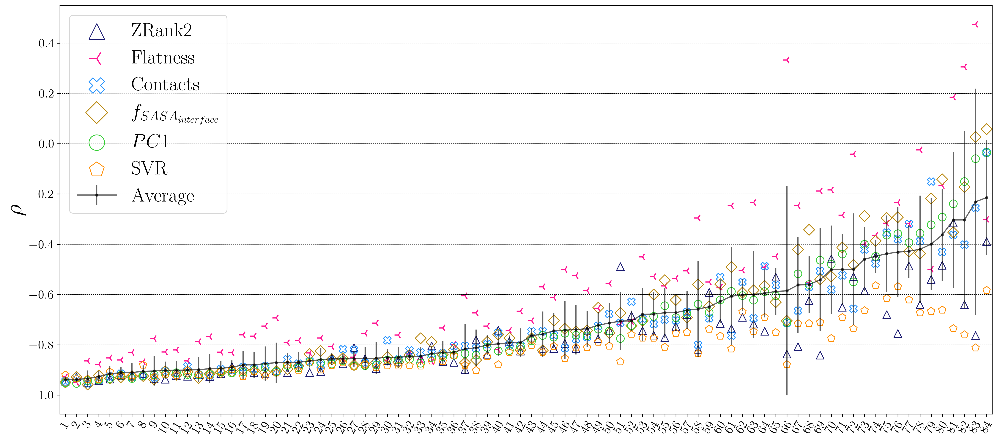

In [222]:
## Creating the per target figure with PCA data

num_samples = len(ss_corr_df)
colors = ["midnightblue", "deeppink", "dodgerblue", "darkgoldenrod", "limegreen", "darkorange"]



score_ref = ["spearman_dockq_zrank", "spearman_dockq_intertwined", "spearman_dockq_contact_45",
             "spearman_dockq_interface_rsa", "spearman_pca", "spearman_svr"]
spearman_data = np.zeros((len(score_ref),num_samples))

for i in range(len(score_ref)):
    for j in range(num_samples):
        if "contact" in score_ref[i] or "interface" in score_ref[i]:
            spearman_data[i][j] = ss_corr_df[score_ref[i]].iloc[j] * -1
        elif "pca" in score_ref[i]:
            spearman_data[i][j] = physical_pca_df[score_ref[i]].iloc[j]
        elif "svr" in score_ref[i]:
            spearman_data[i][j] = physical_svr_df[score_ref[i]].iloc[j]
        else:
            spearman_data[i][j] = ss_corr_df[score_ref[i]].iloc[j]

fig, ax = plt.subplots(figsize = (18,8), dpi = 300)

mean_data = np.mean(spearman_data, axis = 0)

stdev_data = np.std(spearman_data, axis = 0)

sorted_data = spearman_data[:, mean_data.argsort()]

sorted_mean_data = mean_data[mean_data.argsort()]

sorted_stdev_data = stdev_data[mean_data.argsort()]


pdb_order = list(np.array(ss_corr_df["pdb"])[mean_data.argsort()])
print(pdb_order)
label_ticks = list(range(1, len(ss_corr_df)+1))
x = np.linspace(0.5, num_samples-0.5, num_samples)
plt.xticks(x, label_ticks)
plt.xticks(rotation = 60, fontsize = 16)
plt.yticks(fontsize = 16)
plt.xlim(0, num_samples)

marker_size = 100

ax.scatter(x, sorted_data[0], color = colors[0], marker = "^", label = "ZRank2", facecolor = "None", s = marker_size)
ax.scatter(x, sorted_data[1], color = colors[1], marker = "3", label = "Flatness", s = marker_size)
ax.scatter(x, sorted_data[2], color = colors[2], marker = "X", label = "Contacts", facecolor = "None", s = marker_size)
ax.scatter(x, sorted_data[3], color = colors[3], marker = "D", label = "$f_{SASA_{interface}}$", facecolor = "None", s = marker_size)
ax.scatter(x, sorted_data[4], color = colors[4], marker = "o", label = "$PC1$", facecolor = "None", s = marker_size)
ax.scatter(x, sorted_data[5], color = colors[5], marker = "p", label = "SVR", facecolor = "None", s = marker_size)

plt.errorbar(x, sorted_mean_data, yerr = sorted_stdev_data, color = "black", marker = ".", label = "Average", alpha = 0.6)

ax.set_ylabel(r"$\rho$", fontsize = 30)

fig.tight_layout()
lgnd = plt.legend(fontsize = 25)
lgnd.legendHandles[0]._sizes = [400]
lgnd.legendHandles[1]._sizes = [400]
lgnd.legendHandles[2]._sizes = [400]
lgnd.legendHandles[3]._sizes = [400]
lgnd.legendHandles[4]._sizes = [400]
lgnd.legendHandles[5]._sizes = [400]

plt.grid(axis = "y", color = 'black', linestyle = '--', linewidth = 0.5)
plt.savefig(join(figure_save_dir, "per_target_spearman_physical_scores_and_pca_svr.png"))

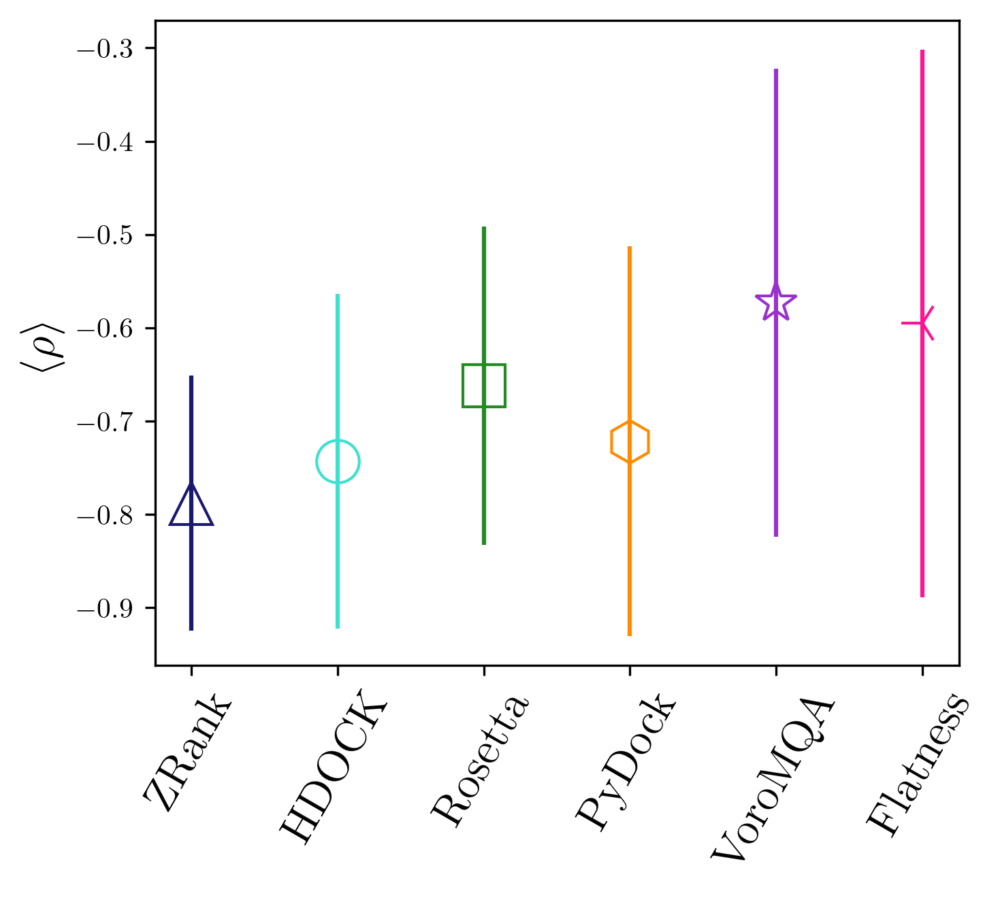

In [400]:
## Show a plot of the average spearman with standard deviation for all scoring methods
## Both before and after supersampling - emphasize that it's bad

fig, ax = plt.subplots(figsize = (5,4.5), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid", "indianred","deeppink"]

markers = ["^", "o", "s", "h", "*", "p", "3"]

x_axis = range(6)

ss_plot_data = [np.mean(ss_corr_df["spearman_dockq_zrank"]), np.mean(ss_corr_df["spearman_dockq_hdock"]),
                np.mean(ss_corr_df["spearman_dockq_rosetta"]), np.mean(ss_corr_df["spearman_dockq_pydock"]),
                np.mean(ss_corr_df["spearman_dockq_voromqa"]*-1), np.mean(ss_corr_df["spearman_dockq_dove"]),
                np.mean(ss_corr_df["spearman_dockq_intertwined"])]


ss_plot_std = [np.std(ss_corr_df["spearman_dockq_zrank"]), np.std(ss_corr_df["spearman_dockq_hdock"]),
              np.std(ss_corr_df["spearman_dockq_rosetta"]), np.std(ss_corr_df["spearman_dockq_pydock"]),
              np.std(ss_corr_df["spearman_dockq_voromqa"]*-1), np.std(ss_corr_df["spearman_dockq_dove"]),
              np.std(ss_corr_df["spearman_dockq_intertwined"])]

plt.errorbar(x_axis[0], ss_plot_data[0], yerr = ss_plot_std[0], color = colors[0], marker = markers[0], markerfacecolor = "None", markersize = 15)
plt.errorbar(x_axis[1], ss_plot_data[1], yerr = ss_plot_std[1], color = colors[1], marker = markers[1], markerfacecolor = "None", markersize = 15)
plt.errorbar(x_axis[2], ss_plot_data[2], yerr = ss_plot_std[2], color = colors[2], marker = markers[2], markerfacecolor = "None", markersize = 15)
plt.errorbar(x_axis[3], ss_plot_data[3], yerr = ss_plot_std[3], color = colors[3], marker = markers[3], markerfacecolor = "None", markersize = 15)
plt.errorbar(x_axis[4], ss_plot_data[4], yerr = ss_plot_std[4], color = colors[4], marker = markers[4], markerfacecolor = "None", markersize = 15)
# plt.errorbar(x_axis[5], ss_plot_data[5], yerr = ss_plot_std[5], color = colors[5], marker = markers[5], markerfacecolor = "None", markersize = 15)
plt.errorbar(x_axis[5], ss_plot_data[6], yerr = ss_plot_std[6], color = colors[6], marker = markers[6], markersize = 15)

score_list = ["ZRank", "HDOCK", "Rosetta", "PyDock", "VoroMQA", "Flatness"]
plt.xticks(x_axis, score_list, fontsize = 16, rotation = 60)

ax.set_ylabel(r"$\langle \rho \rangle$", fontsize = 16)
fig.tight_layout()

## Reading in the SVR results generating from the cluster

In [499]:
svr_dir = "/Users/jakesumner/Desktop/PPI Project/supersampling/physical_score_svr/"

os.chdir(svr_dir)

def read_in_svr_data(svr_dir, score_dict):
    '''
    Takes the svr_dir and turns all 
    the data for all 4 kernels into a 
    df for each PDB, similar to the score
    dict. It returns the pearson and spearman
    correlations for each PDB for each 
    kernel function
    '''
    
    ## Read in all files
    svr_files = sorted([f for f in listdir(svr_dir) if isfile(join(svr_dir, f)) and "results.txt" in f])
    
    ## Init dict
    cols_to_add = ["pdb", "svr_rbf_pearson", "svr_rbf_spearman", "svr_sigmoid_pearson", "svr_sigmoid_spearman",
                  "svr_linear_pearson", "svr_linear_spearman", "svr_poly_pearson", "svr_poly_spearman",]
    final_dict = {col : [] for col in cols_to_add}
    
    ## Sort files appropriately so all are in same order
    gaussian_files = sorted([f for f in svr_files if "rbf" in f])
    linear_files = sorted([f for f in svr_files if "linear" in f])
    poly_files = sorted([f for f in svr_files if "poly" in f])
    sigmoid_files = sorted([f for f in svr_files if "sigmoid" in f])
    
    ## Get Gaussian Corrs
    for tempfile in gaussian_files:
        temp_data = {"decoy" : [], "pred_y" : []}
        
        ## Isolate and add PDB to dictionary (just this time)
        curr_pdb = tempfile.split("_")[3]
        final_dict["pdb"].append(curr_pdb)
        with open(tempfile, "r") as f:
            for line in f:
                line = line.split()
                temp_decoy = line[0]
                temp_score = float(line[1])
                temp_data["decoy"].append(temp_decoy)
                temp_data["pred_y"].append(temp_score)
                
        ## Calculate correlations
        temp_pearson = pearsonr(temp_data["pred_y"], score_dict[curr_pdb]["DockQ"])[0]
        final_dict["svr_rbf_pearson"].append(temp_pearson)
        
        temp_spearman = spearmanr(temp_data["pred_y"], score_dict[curr_pdb]["DockQ"])[0]
        final_dict["svr_rbf_spearman"].append(temp_spearman)
        
    ## Get sigmoid Corrs
    for tempfile in sigmoid_files:
        temp_data = {"decoy" : [], "pred_y" : []}
        curr_pdb = tempfile.split("_")[3]
        with open(tempfile, "r") as f:
            for line in f:
                line = line.split()
                temp_decoy = line[0]
                temp_score = float(line[1])
                temp_data["decoy"].append(temp_decoy)
                temp_data["pred_y"].append(temp_score)
                
        ## Calculate correlations
#         print(tempfile, curr_pdb, len(temp_data["pred_y"]), len(score_dict[curr_pdb]["DockQ"]))
        temp_pearson = pearsonr(temp_data["pred_y"], score_dict[curr_pdb]["DockQ"])[0]
        final_dict["svr_sigmoid_pearson"].append(temp_pearson)
        
        temp_spearman = spearmanr(temp_data["pred_y"], score_dict[curr_pdb]["DockQ"])[0]
        final_dict["svr_sigmoid_spearman"].append(temp_spearman)
        
    ## Get linear Corrs
    for tempfile in linear_files:
        temp_data = {"decoy" : [], "pred_y" : []}
        curr_pdb = tempfile.split("_")[3]
        with open(tempfile, "r") as f:
            for line in f:
                line = line.split()
                temp_decoy = line[0]
                temp_score = float(line[1])
                temp_data["decoy"].append(temp_decoy)
                temp_data["pred_y"].append(temp_score)
                
        ## Calculate correlations
        temp_pearson = pearsonr(temp_data["pred_y"], score_dict[curr_pdb]["DockQ"])[0]
        final_dict["svr_linear_pearson"].append(temp_pearson)
        
        temp_spearman = spearmanr(temp_data["pred_y"], score_dict[curr_pdb]["DockQ"])[0]
        final_dict["svr_linear_spearman"].append(temp_spearman)
        
    ## Get Poly Corrs
    for tempfile in poly_files:
        temp_data = {"decoy" : [], "pred_y" : []}
        curr_pdb = tempfile.split("_")[3]
        with open(tempfile, "r") as f:
            for line in f:
                line = line.split()
                temp_decoy = line[0]
                temp_score = float(line[1])
                temp_data["decoy"].append(temp_decoy)
                temp_data["pred_y"].append(temp_score)
                
        ## Calculate correlations
        
        temp_pearson = pearsonr(temp_data["pred_y"], score_dict[curr_pdb]["DockQ"])[0]
        final_dict["svr_poly_pearson"].append(temp_pearson)
        
        temp_spearman = spearmanr(temp_data["pred_y"], score_dict[curr_pdb]["DockQ"])[0]
        final_dict["svr_poly_spearman"].append(temp_spearman)
        
    return pd.DataFrame(final_dict)
        

In [500]:
## Get the SVR correlation dictionary

svr_overall_df = read_in_svr_data(svr_dir, ss_score_dict)

In [501]:
svr_overall_df

,pdb,svr_rbf_pearson,svr_rbf_spearman,svr_sigmoid_pearson,svr_sigmoid_spearman,svr_linear_pearson,svr_linear_spearman,svr_poly_pearson,svr_poly_spearman
0,1acb,0.677183,0.589508,0.066127,-0.038955,0.619327,0.551909,0.471534,0.510059
1,1ay7,0.801028,0.799247,0.230869,0.159493,0.775617,0.789152,0.622221,0.777672
2,1c3a,0.975038,0.941922,0.339517,0.345490,0.966335,0.935533,0.865231,0.933234
3,1euv,0.936395,0.871953,0.389494,0.286633,0.924675,0.868782,0.804498,0.863038
4,1f60,0.957294,0.913520,0.417016,0.323865,0.947199,0.910116,0.782482,0.908000
...,...,...,...,...,...,...,...,...,...
79,6zbk,0.851714,0.746866,0.099139,0.036126,0.796529,0.717869,0.622817,0.706116
80,7bxh,0.873886,0.841526,-0.059020,-0.078527,0.799709,0.804595,0.520822,0.791540
81,7joe,0.861994,0.836056,0.301902,0.256082,0.821216,0.775915,0.705150,0.768775
82,7jxv,0.531376,0.505645,-0.184399,-0.171024,0.386079,0.402513,0.136042,0.408656


In [ ]:
print("Gaussian Spearman", np.mean(svr_overall_df["svr_rbf_spearman"]))
# print("Sigmoid", np.mean(svr_overall_df["svr_sigmoid_spearman"]))
# print("Polynomial", np.mean(svr_overall_df["svr_poly_spearman"]))
# print("Linear", np.mean(svr_overall_df["svr_linear_spearman"]))
print("Zrank Spearman", np.mean(ss_corr_df["spearman_dockq_zrank"]))
print()

print("Gaussian Spearman", np.mean(svr_overall_df["svr_rbf_pearson"]))
# print("Sigmoid", np.mean(svr_overall_df["svr_sigmoid_pearson"]))
# print("Polynomial", np.mean(svr_overall_df["svr_poly_pearson"]))
# print("Linear", np.mean(svr_overall_df["svr_linear_pearson"]))
print("Zrank Pearson", np.mean(ss_corr_df["pearson_dockq_zrank"]))

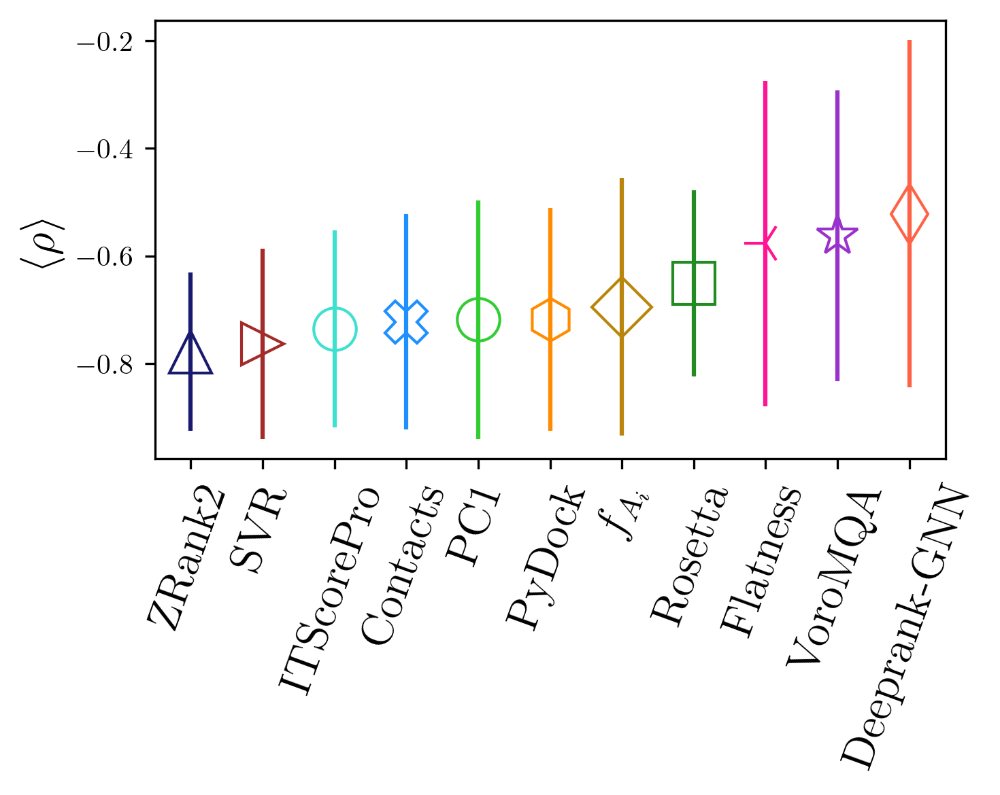

In [844]:
## Show a plot of the average spearman BUT NO DOVE

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid", "tomato",
         "deeppink", "dodgerblue", "darkgoldenrod", "brown", "limegreen"]

markers = ["^", "o", "s", "h", "*", "d", "3", "X", "D", ">", "o"]

ss_plot_data = [np.mean(ss_corr_df["spearman_dockq_zrank"]), np.mean(ss_corr_df["spearman_dockq_hdock"]),
                    np.mean(ss_corr_df["spearman_dockq_rosetta"]), np.mean(ss_corr_df["spearman_dockq_pydock"]),
                    np.mean(ss_corr_df["spearman_dockq_voromqa"]*-1), 
                    np.mean(ss_corr_df["spearman_dockq_deeprank_gnn_esm"]*-1), np.mean(ss_corr_df["spearman_dockq_intertwined"]),
                    np.mean(ss_corr_df["spearman_dockq_contact_45"])*-1, np.mean(ss_corr_df["spearman_dockq_interface_rsa"])*-1,
                    np.mean(svr_overall_df["svr_rbf_spearman"]) *-1, np.mean(physical_pca_df["spearman_pca"])
               ]


ss_plot_std = [np.std(ss_corr_df["spearman_dockq_zrank"]), np.std(ss_corr_df["spearman_dockq_hdock"]),
                    np.std(ss_corr_df["spearman_dockq_rosetta"]), np.std(ss_corr_df["spearman_dockq_pydock"]),
                    np.std(ss_corr_df["spearman_dockq_voromqa"]*-1), 
                      np.std(ss_corr_df["spearman_dockq_deeprank_gnn_esm"]*-1), np.std(ss_corr_df["spearman_dockq_intertwined"]),
                    np.std(ss_corr_df["spearman_dockq_contact_45"])*-1, np.std(ss_corr_df["spearman_dockq_interface_rsa"])*-1,
                    np.std(svr_overall_df["svr_rbf_spearman"]), np.std(physical_pca_df["spearman_pca"])
              ]

x_axis = range(len(ss_plot_data))


## Sort the data 
ss_plot_data = np.array(ss_plot_data)
ss_plot_std = np.array(ss_plot_std)
colors = np.array(colors)
markers = np.array(markers)

sort_inds = np.argsort(ss_plot_data)
ss_plot_data = ss_plot_data[sort_inds]
ss_plot_std = ss_plot_std[sort_inds]
colors = colors[sort_inds]
markers = markers[sort_inds]

for i in range(len(ss_plot_data)):
    plt.errorbar(x_axis[i], ss_plot_data[i], yerr = ss_plot_std[i], color = colors[i], marker = markers[i], markerfacecolor = "None", markersize = 15, alpha = 1)

score_list = ["ZRank2", "ITScorePro", "Rosetta",  "PyDock", "VoroMQA",  "Deeprank-GNN", 
             "Flatness", "Contacts", "$f_{A_{i}}$", "SVR", "PC1"]

score_list = np.array(score_list)
score_list = score_list[sort_inds]
plt.xticks(x_axis, score_list, fontsize = 16, rotation = 70)

ax.set_ylabel(r"$\langle \rho \rangle$", fontsize = 16)
fig.tight_layout()
plt.savefig(join(figure_save_dir, "simple_spearman_graph_with_physical_and_combined.png"))

In [856]:
np.mean(ss_corr_df["spearman_dockq_zrank"])




-0.7778638790471619

In [843]:
np.mean(svr_overall_df["svr_rbf_spearman"])



0.7632156191485454

In [855]:
counter = 0
deltas = []
for pdb in ss_corr_df["pdb"]:
    temp_zrank = ss_corr_df[ss_corr_df["pdb"] == pdb]["spearman_dockq_zrank"].iloc[0]
    temp_svr = svr_overall_df[svr_overall_df["pdb"] == pdb]["svr_rbf_spearman"].iloc[0] *-1
#     print(f"Zrank: {temp_zrank}      SVR: {temp_svr}")

    if temp_svr < temp_zrank: ## all are negative so less than
        counter += 1
        deltas.append(abs(temp_zrank-temp_svr))

print(f"Number of times that SVR outperforms ZRank: {counter}")
print(np.mean(deltas))

Number of times that SVR outperforms ZRank: 41
0.0483685072310782


1 1ugq
2 5by8
3 3whq
4 1kfu
5 5maw
6 1r8o
7 1c3a
8 4g6t
9 4qjf
10 2fhz
11 2bkr
12 1n1j
13 5k7m
14 1pdk
15 4uzz
16 1f60
17 1itb
18 1ry7
19 5mu7
20 8enf
21 3dgp
22 2wmp
23 1euv
24 2hla
25 1vet
26 4ct6
27 4qlp
28 1ggp
29 3wdg
30 4je3
31 1tfo
32 4gi3
33 1ugh
34 2oul
35 3vz9
36 5uq2
37 2dvw
38 6fud
39 4bi8
40 5dmb
41 3qc8
42 7joe
43 2g2u
44 3fpn
45 7bxh
46 1spp
47 1ay7
48 4h5s
49 6yxj
50 1xg2
51 3qhy
52 3sgb
53 6zbk
54 1j7d
55 6wg4
56 2d5r
57 4k12
58 3gfk
59 1qav
60 1wqj
61 4yii
62 3rcz
63 4u1c
64 1wrd
65 1mbv
66 6xod
67 2pe6
68 1acb
69 1wmh
70 3u82
71 4dbg
72 2hsm
73 4dhi
74 3ygs
75 4hwi
76 6kp3
77 2hth
78 7jxv
79 2h7z
80 3ona
81 2grn
82 3hw2
83 5zrz
84 3k9p


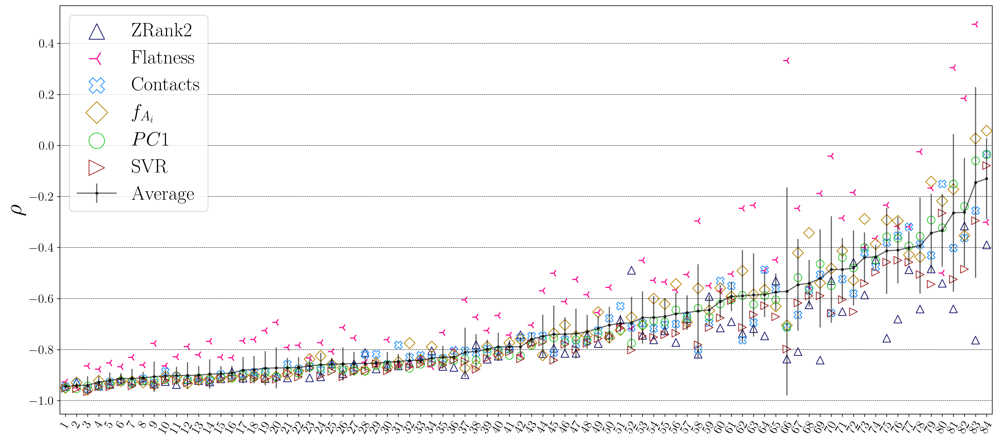

In [836]:
## Creating the per target figure with PCA data

num_samples = len(ss_corr_df)
colors = ["midnightblue", "deeppink", "dodgerblue", "darkgoldenrod", "limegreen", "brown"]



score_ref = ["spearman_dockq_zrank", "spearman_dockq_intertwined", "spearman_dockq_contact_45",
             "spearman_dockq_interface_rsa", "spearman_pca", "svr_rbf_spearman"]
spearman_data = np.zeros((len(score_ref),num_samples))

for i in range(len(score_ref)):
    for j in range(num_samples):
        if "contact" in score_ref[i] or "interface" in score_ref[i]:
            spearman_data[i][j] = ss_corr_df[score_ref[i]].iloc[j] * -1
        elif "pca" in score_ref[i]:
            spearman_data[i][j] = physical_pca_df[score_ref[i]].iloc[j]
        elif "svr" in score_ref[i]:
            spearman_data[i][j] = svr_overall_df[score_ref[i]].iloc[j] *-1
        else:
            spearman_data[i][j] = ss_corr_df[score_ref[i]].iloc[j]

fig, ax = plt.subplots(figsize = (18,8), dpi = 300)

mean_data = np.mean(spearman_data, axis = 0)

stdev_data = np.std(spearman_data, axis = 0)

sorted_data = spearman_data[:, mean_data.argsort()]

sorted_mean_data = mean_data[mean_data.argsort()]

sorted_stdev_data = stdev_data[mean_data.argsort()]


pdb_order = list(np.array(ss_corr_df["pdb"])[mean_data.argsort()])

for i,pdb in enumerate(pdb_order):
    print(i+1, pdb)

label_ticks = list(range(1, len(ss_corr_df)+1))
x = np.linspace(0.5, num_samples-0.5, num_samples)
plt.xticks(x, label_ticks)
plt.xticks(rotation = 60, fontsize = 16)
plt.yticks(fontsize = 16)
plt.xlim(0, num_samples)

marker_size = 100

ax.scatter(x, sorted_data[0], color = colors[0], marker = "^", label = "ZRank2", facecolor = "None", s = marker_size)
ax.scatter(x, sorted_data[1], color = colors[1], marker = "3", label = "Flatness", s = marker_size)
ax.scatter(x, sorted_data[2], color = colors[2], marker = "X", label = "Contacts", facecolor = "None", s = marker_size)
ax.scatter(x, sorted_data[3], color = colors[3], marker = "D", label = "$f_{A_{i}}$", facecolor = "None", s = marker_size)
ax.scatter(x, sorted_data[4], color = colors[4], marker = "o", label = "$PC1$", facecolor = "None", s = marker_size)
ax.scatter(x, sorted_data[5], color = colors[5], marker = ">", label = "SVR", facecolor = "None", s = marker_size)

plt.errorbar(x, sorted_mean_data, yerr = sorted_stdev_data, color = "black", marker = ".", label = "Average", alpha = 0.6)

ax.set_ylabel(r"$\rho$", fontsize = 30)

fig.tight_layout()
lgnd = plt.legend(fontsize = 25)
lgnd.legendHandles[0]._sizes = [400]
lgnd.legendHandles[1]._sizes = [400]
lgnd.legendHandles[2]._sizes = [400]
lgnd.legendHandles[3]._sizes = [400]
lgnd.legendHandles[4]._sizes = [400]
lgnd.legendHandles[5]._sizes = [400]

plt.grid(axis = "y", color = 'black', linestyle = '--', linewidth = 0.5)
plt.savefig(join(figure_save_dir, "per_target_spearman_physical_scores_and_pca_svr.png"))

### Checking SVR variable gamma results

In [492]:

def read_in_svr_data_gamma(svr_dir, score_dict, gammas):
    '''
    Takes the svr_dir and turns all 
    the data for all 4 kernels into a 
    df for each PDB, similar to the score
    dict. It returns the pearson and spearman
    correlations for each PDB for each 
    kernel function
    '''
    
    ## Read in all files
    svr_files = sorted([f for f in listdir(svr_dir) if isfile(join(svr_dir, f)) and "results.txt" in f])
    
    os.chdir(svr_dir)
    
    ## Init dict
    
    cols_to_add = ["pdb"] + [f"svr_rbf_gamma{gamma_val}_spearman" for gamma_val in gammas]
    cols_to_add += [f"svr_rbf_gamma{gamma_val}_pearson" for gamma_val in gammas]
    final_dict = {col : [] for col in cols_to_add}
    
    ## Sort files appropriately so all are in same order
    
    sorted_files = []
    for gamma_val in gammas:
        sorted_files.append(sorted([f for f in svr_files if gamma_val == float(f.split("_")[4].split("mma")[-1])]))
        
#     print(sorted_files)
    ## Loop through and read in data for each gamma
        
    for i, gamma_val in enumerate(gammas):
        temp_files = sorted_files[i]
        print(temp_files[0])
        for tempfile in temp_files:
            temp_data = {"decoy" : [], "pred_y" : []}
            curr_pdb = tempfile.split("_")[3]
            
            ## Only add to the pdb column the first time
            if i == 0:
                final_dict["pdb"].append(curr_pdb)
            with open(tempfile, "r") as f:
                for line in f:
                    line = line.split()
                    temp_decoy = line[0]
                    temp_score = float(line[1])
                    temp_data["decoy"].append(temp_decoy)
                    temp_data["pred_y"].append(temp_score)
                    
            ## Calculate correlations
            temp_pearson = pearsonr(temp_data["pred_y"], score_dict[curr_pdb]["DockQ"])[0]
            final_dict[f"svr_rbf_gamma{gamma_val}_pearson"].append(temp_pearson)

            temp_spearman = spearmanr(temp_data["pred_y"], score_dict[curr_pdb]["DockQ"])[0]
            final_dict[f"svr_rbf_gamma{gamma_val}_spearman"].append(temp_spearman)

    
    for k,v in list(final_dict.items()):
        print(k, len(v))
        
    return pd.DataFrame(final_dict)
        

In [497]:
## Get the SVR correlation dictionary
svr_dir = "/Users/jakesumner/Desktop/PPI Project/supersampling/svr_gamma_rbf_results/"

gammas = [0.1, 0.8, 0.9, 1.1, 1.2, 1.5, 2.0]
svr_gamma_df = read_in_svr_data_gamma(svr_dir, ss_score_dict, gammas)

svr_loo_rbf_1acb_gamma0.1_results.txt
svr_loo_rbf_1acb_gamma0.8_results.txt
svr_loo_rbf_1acb_gamma0.9_results.txt
svr_loo_rbf_1acb_gamma1.1_results.txt
svr_loo_rbf_1acb_gamma1.2_results.txt
svr_loo_rbf_1acb_gamma1.5_results.txt
svr_loo_rbf_1acb_gamma2.0_results.txt
pdb 84
svr_rbf_gamma0.1_spearman 84
svr_rbf_gamma0.8_spearman 84
svr_rbf_gamma0.9_spearman 84
svr_rbf_gamma1.1_spearman 84
svr_rbf_gamma1.2_spearman 84
svr_rbf_gamma1.5_spearman 84
svr_rbf_gamma2.0_spearman 84
svr_rbf_gamma0.1_pearson 84
svr_rbf_gamma0.8_pearson 84
svr_rbf_gamma0.9_pearson 84
svr_rbf_gamma1.1_pearson 84
svr_rbf_gamma1.2_pearson 84
svr_rbf_gamma1.5_pearson 84
svr_rbf_gamma2.0_pearson 84


In [503]:
print("Gamma 0.1", np.mean(svr_gamma_df["svr_rbf_gamma0.1_spearman"]))
print("Gamma 0.8",np.mean(svr_gamma_df["svr_rbf_gamma0.8_spearman"]))
print("Gamma 0.9",np.mean(svr_gamma_df["svr_rbf_gamma0.9_spearman"]))
print("Gamma 1.1",np.mean(svr_gamma_df["svr_rbf_gamma1.1_spearman"]))
print("Gamma 1.2",np.mean(svr_gamma_df["svr_rbf_gamma1.2_spearman"]))
print("Gamma 1.5",np.mean(svr_gamma_df["svr_rbf_gamma1.5_spearman"]))
print("Gamma 2",np.mean(svr_gamma_df["svr_rbf_gamma2.0_spearman"]))
print("Gamma 1",np.mean(svr_overall_df["svr_rbf_spearman"]))

Gamma 0.1 0.7581453937770196
Gamma 0.8 0.7630391014826298
Gamma 0.9 0.7631970885836695
Gamma 1.1 0.7632888549737382
Gamma 1.2 0.7633197814734674
Gamma 1.5 0.763381438896612
Gamma 2 0.7633081716055408
Gamma 1 0.7632156191485454


In [440]:
svr_overall_df

,pdb,svr_rbf_gamma0.1_spearman,svr_rbf_gamma0.5_spearman,svr_rbf_gamma0.8_spearman,svr_rbf_gamma0.9_spearman,svr_rbf_gamma1.1_spearman,svr_rbf_gamma1.2_spearman,svr_rbf_gamma1.5_spearman,svr_rbf_gamma2.0_spearman,svr_rbf_gamma0.1_pearson,svr_rbf_gamma0.5_pearson,svr_rbf_gamma0.8_pearson,svr_rbf_gamma0.9_pearson,svr_rbf_gamma1.1_pearson,svr_rbf_gamma1.2_pearson,svr_rbf_gamma1.5_pearson,svr_rbf_gamma2.0_pearson
0,1acb,0.589508,0.589508,0.589508,0.589508,0.589508,0.589508,0.589508,0.589508,0.677183,0.677183,0.677183,0.677183,0.677183,0.677183,0.677183,0.677183
1,1ay7,0.799247,0.799247,0.799247,0.799247,0.799247,0.799247,0.799247,0.799247,0.801028,0.801028,0.801028,0.801028,0.801028,0.801028,0.801028,0.801028
2,1c3a,0.941922,0.941922,0.941922,0.941922,0.941922,0.941922,0.941922,0.941922,0.975038,0.975038,0.975038,0.975038,0.975038,0.975038,0.975038,0.975038
3,1euv,0.871953,0.871953,0.871953,0.871953,0.871953,0.871953,0.871953,0.871953,0.936395,0.936395,0.936395,0.936395,0.936395,0.936395,0.936395,0.936395
4,1f60,0.913505,0.913505,0.913505,0.913505,0.913505,0.913505,0.913505,0.913505,0.957297,0.957297,0.957297,0.957297,0.957297,0.957297,0.957297,0.957297
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
79,6zbk,0.746877,0.746877,0.746877,0.746877,0.746877,0.746877,0.746877,0.746877,0.851719,0.851719,0.851719,0.851719,0.851719,0.851719,0.851719,0.851719
80,7bxh,0.841526,0.841526,0.841526,0.841526,0.841526,0.841526,0.841526,0.841526,0.873886,0.873886,0.873886,0.873886,0.873886,0.873886,0.873886,0.873886
81,7joe,0.836064,0.836064,0.836064,0.836064,0.836064,0.836064,0.836064,0.836064,0.862011,0.862011,0.862011,0.862011,0.862011,0.862011,0.862011,0.862011
82,7jxv,0.505645,0.505645,0.505645,0.505645,0.505645,0.505645,0.505645,0.505645,0.531376,0.531376,0.531376,0.531376,0.531376,0.531376,0.531376,0.531376


# Contacts Testing and Analysis

In [221]:
# Contacts Testing and Analysis

contact_dir = "/Users/jakesumner/Desktop/PPI Project/supersampling/contacts_testing"

os.chdir(contact_dir)

contact_sample_file = "contacts_1ay7_sampled.txt"
contact_random_file = "contacts_1ay7_random.txt"

intertwined_sample_file = "intertwined_1ay7_sampled.txt"
intertwined_random_file = "intertwined_1ay7_random.txt"

## Define the names for the distances
ca_names_arr = []
name_start = "ca_"
for cutoff in np.linspace(1,30, 291):
    ca_names_arr.append(name_start+str(cutoff)) 

ha_names_arr = []
name_start = "ha_"
for cutoff in np.linspace(1,30, 291):
    ha_names_arr.append(name_start+str(cutoff)) 

contact_s_df = pd.read_csv(contact_sample_file)
contact_r_df = pd.read_csv(contact_random_file)

intertwine_s_df = pd.read_csv(intertwined_sample_file)
intertwine_r_df = pd.read_csv(intertwined_random_file)

merge_sample = intertwine_s_df.merge(contact_s_df, on = "decoy")
merge_random = intertwine_r_df.merge(contact_r_df, on = "decoy")

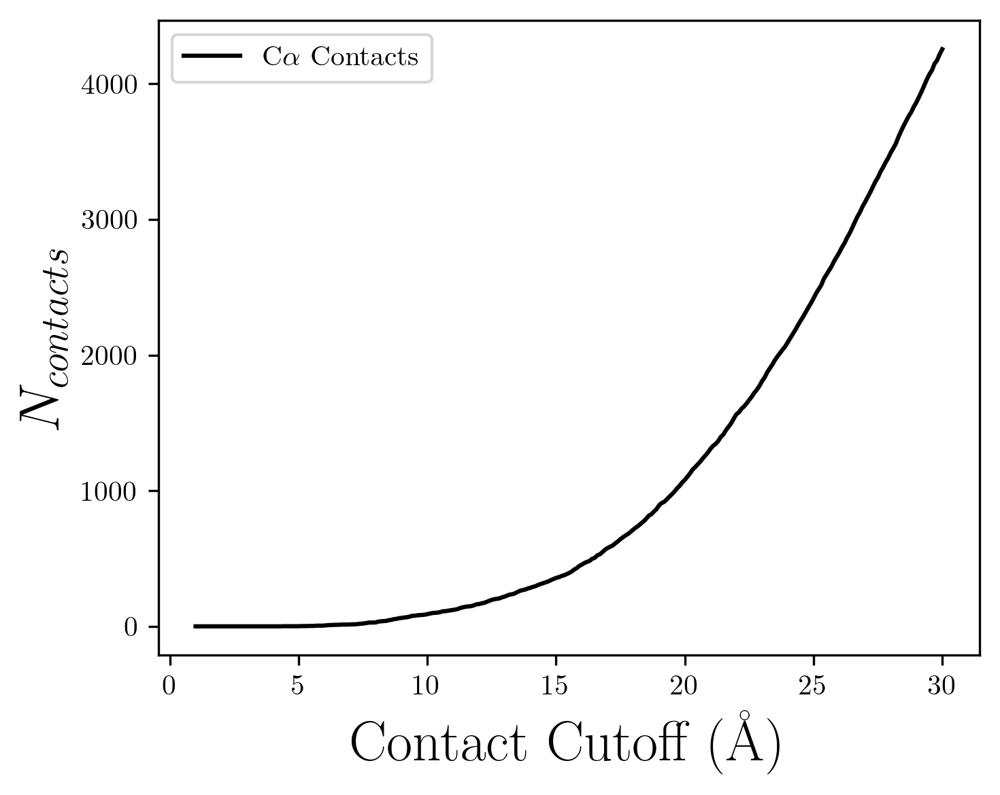

In [224]:
## Plotting some data preliminarily

x_axis = np.linspace(1,30, 291) #distance cutoffs used (in Å)

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

ca_data = [merge_sample.iloc[j][ca_names_arr[i]] for i in range(291)]
# ha_data = [merge_sample.iloc[j][ha_names_arr[i]] for i in range(291)]


ax.plot(x_axis, ca_data, color = "black", label = r"C$\alpha$ Contacts")
# ax.plot(x_axis, ha_data, color = "blue", label = "Heavy-atom Contacts")


ax.set_xlabel("Contact Cutoff (Å)", fontsize = 20)
ax.set_ylabel("$N_{contacts}$", fontsize = 20)
# plt.yscale('log')
plt.legend()
fig.tight_layout()

In [462]:
print(list(ss_corr_df["pdb"]))

['1acb', '1ay7', '1c5m', '1euv', '1f60', '1j7d', '1n1j', '1qav', '1r8o', '1ugh', '1ugq', '1vet', '1wmh', '1wqj', '1wrd', '1xg2', '2bkr', '2fhz', '2g2u', '2grn', '2h7z', '3dgp', '3fpn', '3qhy', '3rcz', '3sgb', '3vz9', '3wdg', '3whq', '3ygs', '4bi8', '4ct6', '4dbg', '4dhi', '4g6t', '4gi3', '4h5s', '4hwi', '4je3', '4k12', '4qjf', '4qlp', '4uzz', '4yii', '5by8', '5dmb', '5k7m', '5maw', '5mu7', '5uq2', '5zrz', '6fud', '6kp3', '6wg4', '6xod', '6zbk', '7bxh', '7joe', '7jxv']


In [460]:
## make quick tasklist

os.chdir("/Users/jakesumner/Desktop/")

filename = 'zip_tasklist.sh'
with open(filename, "w") as f:
    for name in ss_corr_df["pdb"]:
        f.write(f"zip -r sampled_{name}.zip ../{name}/sampled_{name}/ \n")

f.close()

## Moving Dove Fold -1 Scores

In [163]:
## Copy the DOVE score files to the corret folder

dove_dir = "/Users/jakesumner/Desktop/PPI Project/supersampling/DOVE_supersample_scores/SS_scores"
file_indicator = "Predict"
dove_files = sorted([f for f in listdir(dove_dir) if isfile(join(dove_dir, f)) and file_indicator in f])
os.chdir(dove_dir)

for temp_file in dove_files:
    pdb_name = temp_file.split(".")[0].split("_")[1]
    os.system(f'cp {temp_file} ../../scores_high_res_all_residues/scores_sampled_{pdb_name}/dove_sampled_{pdb_name}.txt')

cp: ../../scores_high_res_all_residues/scores_sampled_1brb/dove_sampled_1brb.txt: No such file or directory
cp: ../../scores_high_res_all_residues/scores_sampled_1ka9/dove_sampled_1ka9.txt: No such file or directory
cp: ../../scores_high_res_all_residues/scores_sampled_2nts/dove_sampled_2nts.txt: No such file or directory
cp: ../../scores_high_res_all_residues/scores_sampled_3m7f/dove_sampled_3m7f.txt: No such file or directory


In [164]:
## Copy the DOVE score files to the corret folder

dove_dir = "/Users/jakesumner/Desktop/PPI Project/supersampling/DOVE_supersample_scores/SS_rand_scores"
file_indicator = "Predict"
dove_files = sorted([f for f in listdir(dove_dir) if isfile(join(dove_dir, f)) and file_indicator in f])
os.chdir(dove_dir)

for temp_file in dove_files:
    pdb_name = temp_file.split(".")[0].split("_")[1]
    os.system(f'cp {temp_file} ../../scores_high_res_all_residues/scores_sampled_{pdb_name}/dove_random_{pdb_name}.txt')

cp: ../../scores_high_res_all_residues/scores_sampled_1brb/dove_random_1brb.txt: No such file or directory
cp: ../../scores_high_res_all_residues/scores_sampled_1ka9/dove_random_1ka9.txt: No such file or directory
cp: ../../scores_high_res_all_residues/scores_sampled_2nts/dove_random_2nts.txt: No such file or directory
cp: ../../scores_high_res_all_residues/scores_sampled_3m7f/dove_random_3m7f.txt: No such file or directory


In [581]:
## Copy the DOVE score files to the corret folder

dove_dir = "/Users/jakesumner/Desktop/PPI Project/supersampling/DOVE_supersample_scores/SS_rand_scores"
file_indicator = "Predict"
dove_files = sorted([f for f in listdir(dove_dir) if isfile(join(dove_dir, f)) and file_indicator in f])
os.chdir(dove_dir)

pdbs_naomi_did = set([])

for temp_file in dove_files:
    pdb_name = temp_file.split(".")[0].split("_")[1]
    pdbs_naomi_did.add(pdb_name)
#     os.system(f'cp {temp_file} ../../scores_high_res_all_residues/scores_sampled_{pdb_name}/dove_random_{pdb_name}.txt')

pdbs_i_have = set(ss_corr_df["pdb"])
print(pdbs_i_have - pdbs_naomi_did)

{'2hla', '4gi3', '4k12', '1c5m'}


In [583]:
ss_score_dict["1ay7"]

,Decoy,Model,Fnat,iRMSD,LRMSD,CAPRI,DockQ,IS-Score,ZRank,HDOCK,Rosetta,PyDock,VoroMQA,ZRank Z-score,HDOCK Z-score,Rosetta Z-score,PyDock Z-score,VoroMQA Z-score
0,complex.0_0_29,0,0.000,13.547,55.214,Incorrect,0.012,0.0636,-52.7136,-8585.36,-509.086,-16.051,0.382181,0.608208,0.468991,1.708137,0.495574,-0.182455
1,complex.0_0_2,0,0.000,9.188,36.842,Incorrect,0.026,0.0636,-47.4250,-8684.09,-521.068,-19.779,0.485730,0.847912,-0.511170,0.436036,-0.024568,1.423898
2,complex.0_0_32,0,0.025,12.612,33.477,Incorrect,0.033,0.0636,-46.3331,-8481.12,-523.791,-4.774,0.220355,0.897402,1.503855,0.146941,2.068978,-2.692858
3,complex.0_0_35,0,0.000,9.578,41.922,Incorrect,0.021,0.0636,-46.8489,-8681.00,-534.531,-9.514,0.265245,0.874023,-0.480494,-0.993300,1.407638,-1.996480
4,complex.0_0_36,0,0.000,11.406,50.095,Incorrect,0.015,0.0636,-22.6434,-8491.75,-515.708,-9.202,0.386620,1.971130,1.398323,1.005095,1.451169,-0.113593
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
392,complex.30205_2,30205,0.000,11.705,47.565,Incorrect,0.016,0.0636,-30.6907,-8598.93,-528.985,-14.699,0.415122,1.606388,0.334273,-0.404494,0.684210,0.328558
393,complex.30233_0,30233,0.075,14.503,37.490,Incorrect,0.045,0.1503,-48.7018,-8660.49,-512.704,-13.632,0.380091,0.790041,-0.276877,1.324023,0.833081,-0.214877
394,complex.30319_4,30319,0.000,13.135,44.855,Incorrect,0.016,0.0636,-44.4404,-8563.32,-520.955,-21.236,0.473441,0.983188,0.687798,0.448033,-0.227854,1.233260
395,complex.30393_5,30393,0.000,13.891,56.235,Incorrect,0.011,0.0636,-25.7659,-8541.88,-518.792,-9.475,0.463288,1.829603,0.900648,0.677674,1.413079,1.075756


## Moving Dove Fold 5 Scores

In [146]:
## Copy the DOVE score files to the corret folder

dove_dir = "/Users/jakesumner/Desktop/PPI Project/supersampling/DOVE_fold_5_scores/SS_Scores"
file_indicator = "Predict"
dove_files = sorted([f for f in listdir(dove_dir) if isfile(join(dove_dir, f)) and file_indicator in f])
os.chdir(dove_dir)

for temp_file in dove_files:
    pdb_name = temp_file.split(".")[0].split("_")[1]
    os.system(f'cp {temp_file} ../../scores_high_res_all_residues/scores_sampled_{pdb_name}/dove_5_sampled_{pdb_name}.txt')

cp: ../../scores_high_res_all_residues/scores_sampled_1brb/dove_5_sampled_1brb.txt: No such file or directory
cp: ../../scores_high_res_all_residues/scores_sampled_1ka9/dove_5_sampled_1ka9.txt: No such file or directory
cp: ../../scores_high_res_all_residues/scores_sampled_2nts/dove_5_sampled_2nts.txt: No such file or directory
cp: ../../scores_high_res_all_residues/scores_sampled_3m7f/dove_5_sampled_3m7f.txt: No such file or directory


In [147]:
## Copy the DOVE score files to the corret folder

dove_dir = "/Users/jakesumner/Desktop/PPI Project/supersampling/DOVE_fold_5_scores/Rand_SS_Scores"
file_indicator = "Predict"
dove_files = sorted([f for f in listdir(dove_dir) if isfile(join(dove_dir, f)) and file_indicator in f])
os.chdir(dove_dir)

for temp_file in dove_files:
    pdb_name = temp_file.split(".")[0].split("_")[1]
    os.system(f'cp {temp_file} ../../scores_high_res_all_residues/scores_sampled_{pdb_name}/dove_5_random_{pdb_name}.txt')

cp: ../../scores_high_res_all_residues/scores_sampled_1brb/dove_5_random_1brb.txt: No such file or directory
cp: ../../scores_high_res_all_residues/scores_sampled_1ka9/dove_5_random_1ka9.txt: No such file or directory
cp: ../../scores_high_res_all_residues/scores_sampled_2nts/dove_5_random_2nts.txt: No such file or directory
cp: ../../scores_high_res_all_residues/scores_sampled_3m7f/dove_5_random_3m7f.txt: No such file or directory


# Plotting for Presentation

In [243]:
target_score_df

,pdb,ZRank,HDOCK,Rosetta,PyDock,VoroMQA,DockQ,IS-Score
0,1acb,-107.812,-14019.33,653.876,0.567411,-43.58,1.0,1.0
1,1ay7,-71.1704,-8615.92,-62.267,0.467549,-28.44,1.0,1.0
2,1bpl,-389.958,-24883.13,-359.986,0.636892,-149.353,1.0,1.0
3,1brb,-76.1359,-12475.43,-142.609,0.508304,-12.06,1.0,1.0
4,1c3a,-243.852,-13237.19,458.06,0.551583,-109.739,1.0,1.0
...,...,...,...,...,...,...,...,...
84,6xod,-91.3928,-15610.32,-171.465,0.518585,-22.937,1.0,1.0
85,6zbk,-94.5071,-11141.21,-353.065,0.545889,-33.796,1.0,1.0
86,7bxh,-120.772,-23668.37,385.189,0.486844,-48.523,1.0,1.0
87,7joe,-111.187,-17553.99,805.658,0.555442,-31.104,1.0,1.0


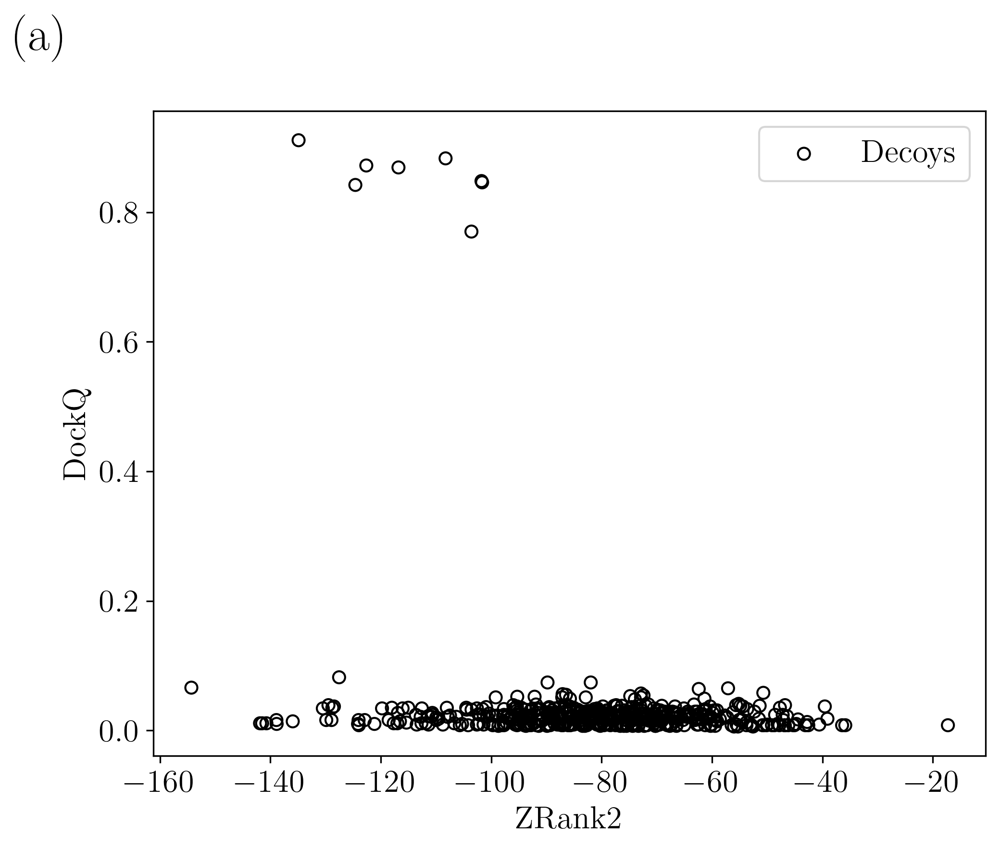

In [116]:
## Simple plot of score correlations
%matplotlib inline

font_size = 16

fig, ax = plt.subplots(figsize = (7,6), dpi = 300)

pdb = "1xg2"

# ax.scatter(target_score_df[target_score_df["pdb"] == pdb]["ZRank"], target_score_df[target_score_df["pdb"] == pdb]["DockQ"], color = "red", label = "Target", marker = "x")
ax.scatter(zdock_relaxed_combined_dfs[pdb]["ZRank"], zdock_relaxed_combined_dfs[pdb]["DockQ"], color = "black", label = "Decoys", marker = "o", facecolor = "None")
# ax.scatter(ss_score_dict[pdb]["ZRank"], ss_score_dict[pdb]["DockQ"], color = "blue", label = "Supersampled Data", marker = "o", facecolor = "None")

ax.text(-0.1, 1.15, "(a)", transform=ax.transAxes,fontsize=font_size*1.5, fontweight='bold', va='top', ha='right')
plt.xticks(fontsize = font_size)
plt.yticks(fontsize = font_size)

plt.legend(fontsize = font_size)

ax.set_xlabel("ZRank2", fontsize = font_size)
ax.set_ylabel("DockQ", fontsize = font_size)
plt.legend(fontsize = font_size)
fig.tight_layout()

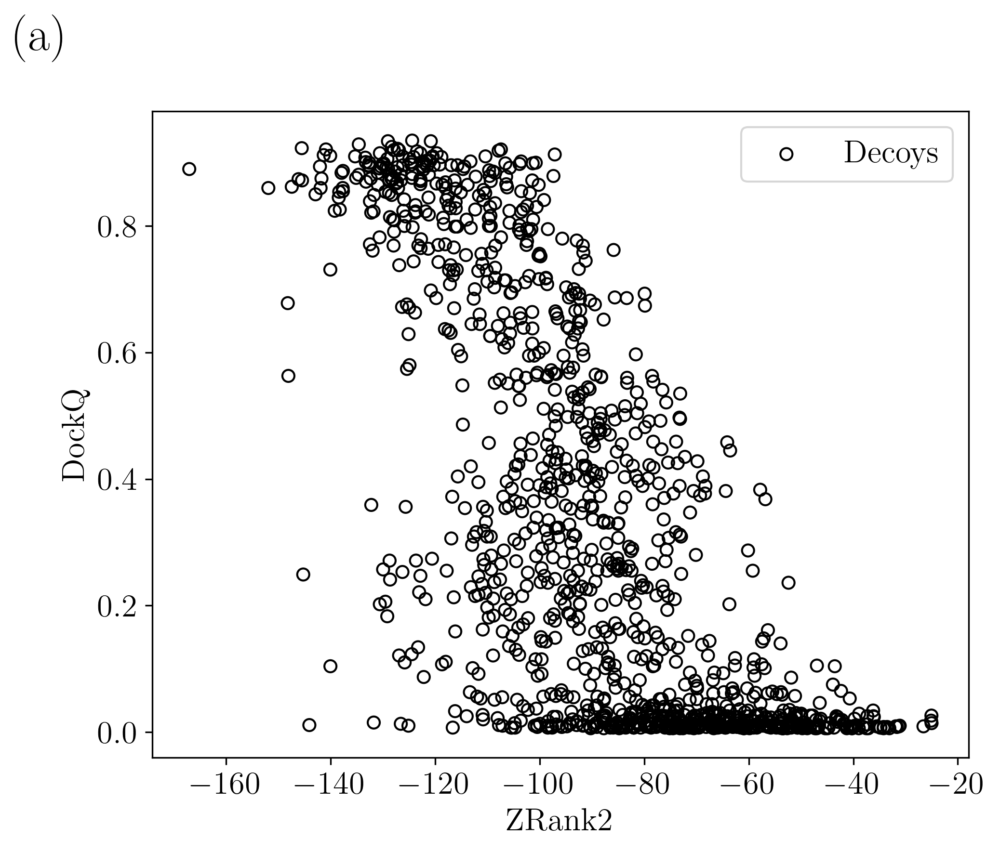

In [120]:
## Simple plot of score correlations with supersampled data
%matplotlib inline

font_size = 16

fig, ax = plt.subplots(figsize = (7,6), dpi = 300)

pdb = "1xg2"

# ax.scatter(target_score_df[target_score_df["pdb"] == pdb]["ZRank"], target_score_df[target_score_df["pdb"] == pdb]["DockQ"], color = "red", label = "Target", marker = "x")
ax.scatter(ss_score_dict[pdb]["ZRank"], ss_score_dict[pdb]["DockQ"], color = "black", label = "Decoys", marker = "o", facecolor = "None")
# ax.scatter(ss_score_dict[pdb]["ZRank"], ss_score_dict[pdb]["DockQ"], color = "blue", label = "Supersampled Data", marker = "o", facecolor = "None")

ax.text(-0.1, 1.15, "(a)", transform=ax.transAxes,fontsize=font_size*1.5, fontweight='bold', va='top', ha='right')
plt.xticks(fontsize = font_size)
plt.yticks(fontsize = font_size)

plt.legend(fontsize = font_size)

ax.set_xlabel("ZRank2", fontsize = font_size)
ax.set_ylabel("DockQ", fontsize = font_size)
plt.legend(fontsize = font_size)
fig.tight_layout()

In [278]:
best_dr_score = max(ss_corr_df["spearman_dockq_deeprank"])
print(best_dr_score)
ss_corr_df[ss_corr_df["spearman_dockq_deeprank"] == best_dr_score]


0.8801023335945669


,pdb,pearson_ialign_zrank,pearson_ialign_hdock,pearson_ialign_rosetta,pearson_ialign_pydock,pearson_ialign_voromqa,pearson_ialign_dove,pearson_ialign_dove_5,pearson_ialign_intertwined,pearson_ialign_deeprank,...,deeprank_auc,flatness_p3,resolution,fci,fsci,fcore_sa_interface,fcore_sa_complex,fcore_sa_monomer,finterface_complex,finterface_monomer
8,1kfu,-0.963097,-0.947952,-0.894444,-0.937752,0.807826,-0.848428,-0.849858,-0.849123,0.914558,...,0.961411,0.955494,2.5,0.093333,0.025408,0.063936,0.018349,0.015957,0.286985,0.249576


In [281]:
worst_dr_score = min(ss_corr_df["spearman_dockq_deeprank"])
print(worst_dr_score)
ss_corr_df[ss_corr_df["spearman_dockq_deeprank"] == worst_dr_score]


-0.4638634482040541


,pdb,pearson_ialign_zrank,pearson_ialign_hdock,pearson_ialign_rosetta,pearson_ialign_pydock,pearson_ialign_voromqa,pearson_ialign_dove,pearson_ialign_dove_5,pearson_ialign_intertwined,pearson_ialign_deeprank,...,deeprank_auc,flatness_p3,resolution,fci,fsci,fcore_sa_interface,fcore_sa_complex,fcore_sa_monomer,finterface_complex,finterface_monomer
27,2grn,-0.629021,-0.548259,-0.608206,-0.486762,0.4878,0.145285,0.416184,0.269918,-0.368418,...,0.223125,0.978719,1.8,0.058824,0.009709,0.024193,0.003535,0.003308,0.146099,0.136713


In [76]:
pdb_list

['1acb',
 '1ay7',
 '1c3a',
 '1euv',
 '1f60',
 '1ggp',
 '1itb',
 '1j7d',
 '1kfu',
 '1n1j',
 '1pdk',
 '1qav',
 '1r8o',
 '1spp',
 '1tfo',
 '1ugh',
 '1ugq',
 '1vet',
 '1wmh',
 '1wqj',
 '1wrd',
 '1xg2',
 '2bkr',
 '2d5r',
 '2dvw',
 '2fhz',
 '2g2u',
 '2grn',
 '2h7z',
 '2hla',
 '2hsm',
 '2hth',
 '2oul',
 '2pe6',
 '2wmp',
 '3dgp',
 '3fpn',
 '3gfk',
 '3k9p',
 '3ona',
 '3qc8',
 '3qhy',
 '3rcz',
 '3sgb',
 '3vz9',
 '3wdg',
 '3whq',
 '3ygs',
 '4bi8',
 '4ct6',
 '4dbg',
 '4dhi',
 '4g6t',
 '4gi3',
 '4h5s',
 '4hwi',
 '4je3',
 '4k12',
 '4qjf',
 '4qlp',
 '4uzz',
 '4yii',
 '5by8',
 '5dmb',
 '5k7m',
 '5maw',
 '5mu7',
 '5uq2',
 '5zrz',
 '6fud',
 '6kp3',
 '6wg4',
 '6xod',
 '6zbk',
 '7bxh',
 '7joe',
 '7jxv',
 '1mbv',
 '1ry7',
 '3hw2',
 '3u82',
 '4u1c',
 '6yxj',
 '8enf']

In [61]:
ss_score_dict["1acb"].columns

Index(['Decoy', 'Model', 'Fnat', 'iRMSD', 'LRMSD', 'CAPRI', 'DockQ',
       'IS-Score', 'ZRank', 'HDOCK', 'Rosetta', 'PyDock', 'VoroMQA',
       'VoroMQA_js', 'Dove_5', 'Intertwined', 'Deeprank_gnn_esm', 'Contact_42',
       'Contact_43', 'Contact_44', 'Contact_45', 'Interface_rsa',
       'ZRank Z-score', 'HDOCK Z-score', 'Rosetta Z-score', 'PyDock Z-score',
       'VoroMQA Z-score', 'VoroMQA_js Z-score', 'Dove_5 Z-score',
       'Deeprank_gnn_esm Z-score'],
      dtype='object')

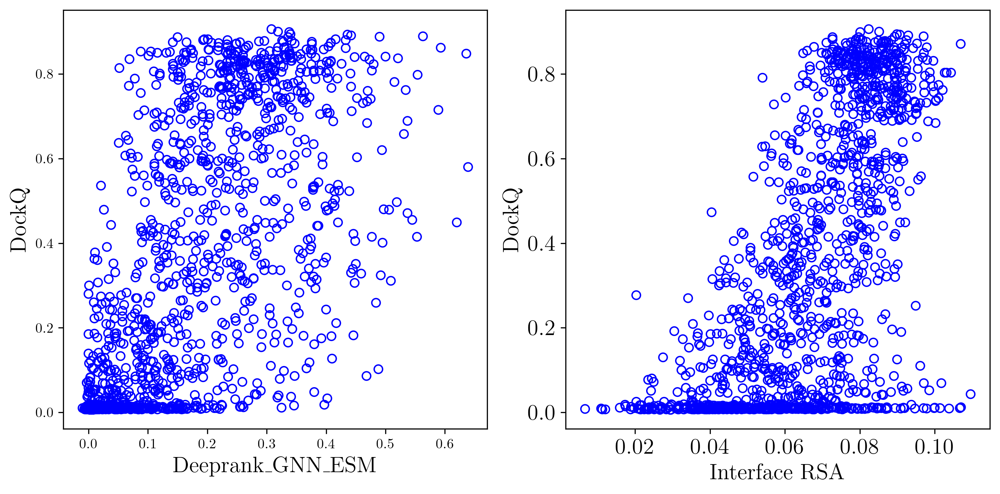

In [78]:
## Simple plot of score correlations

font_size = 16

fig, ax = plt.subplots(1,2, figsize = (10,5), dpi = 300)

pdb = "6yxj"

# ax.scatter(zdock_relaxed_combined_dfs[pdb]["ZRank"], zdock_relaxed_combined_dfs[pdb]["DockQ"], color = "black", label = "Original Data", marker = "o", facecolor = "None")
ax[0].scatter(ss_score_dict[pdb]["Deeprank_gnn_esm"], ss_score_dict[pdb]["DockQ"], color = "blue", label = "Supersampled Decoys", marker = "o", facecolor = "None")
# ax.scatter(target_score_df[target_score_df["pdb"] == pdb]["ZRank"], target_score_df[target_score_df["pdb"] == pdb]["DockQ"], color = "red", label = "Target", marker = "x")
ax[1].scatter(ss_score_dict[pdb]["Interface_rsa"], ss_score_dict[pdb]["DockQ"], color = "blue", label = "Supersampled Decoys", marker = "o", facecolor = "None")

# ax.text(-0.1, 1.15, "(d)", transform=ax.transAxes,fontsize=font_size*1.5, fontweight='bold', va='top', ha='right')
plt.xticks(fontsize = font_size)
plt.yticks(fontsize = font_size)

# plt.legend(fontsize = font_size)

ax[0].set_xlabel("Deeprank_GNN_ESM", fontsize = font_size)
ax[0].set_ylabel("DockQ", fontsize = font_size)
ax[1].set_xlabel("Interface RSA", fontsize = font_size)
ax[1].set_ylabel("DockQ", fontsize = font_size)
# plt.legend(fontsize = font_size)
fig.tight_layout()

# Looking at Fnat vs Deeprank-GNN-ESM score, for consistency with the paper

In [295]:
def get_pearson_corr_fnat(combined_df, gt_score = "Fnat", original_data = False):
    '''
    Gets the pearson correlation for all targets in the
    dictionary df
    '''
    zscore_column = ["ZRank", "HDOCK", "Rosetta", "PyDock", "VoroMQA", "Dove", "Dove_5", "Intertwined", "Deeprank_gnn_esm"]
    if original_data:
        zscore_column = ["ZRank", "HDOCK", "Rosetta", "PyDock", "VoroMQA"]
    all_correlations = []
    for j in range(len(zscore_column)):
        temp_target_corr = []
        for pdb, value in combined_df.items():
            score_temp = combined_df[pdb][zscore_column[j]]
            ialign_temp = combined_df[pdb][gt_score]
            temp_target_corr.append(pearsonr(score_temp, ialign_temp)[0])
        all_correlations.append(temp_target_corr)
    return all_correlations


pearson_corr_fnats = get_pearson_corr_fnat(ss_score_dict)

In [309]:
print(np.array(list(ss_score_dict.keys())))
pdb_array = np.array(list(ss_score_dict.keys()))

['1acb' '1ay7' '1c3a' '1euv' '1f60' '1ggp' '1itb' '1j7d' '1kfu' '1n1j'
 '1pdk' '1qav' '1r8o' '1spp' '1tfo' '1ugh' '1ugq' '1vet' '1wmh' '1wqj'
 '1wrd' '1xg2' '2bkr' '2d5r' '2dvw' '2fhz' '2g2u' '2grn' '2h7z' '2hla'
 '2hsm' '2hth' '2oul' '2pe6' '2wmp' '3dgp' '3fpn' '3gfk' '3k9p' '3ona'
 '3qc8' '3qhy' '3rcz' '3sgb' '3vz9' '3wdg' '3whq' '3ygs' '4bi8' '4ct6'
 '4dbg' '4dhi' '4g6t' '4gi3' '4h5s' '4hwi' '4je3' '4k12' '4qjf' '4qlp'
 '4uzz' '4yii' '5by8' '5dmb' '5k7m' '5maw' '5mu7' '5uq2' '5zrz' '6fud'
 '6kp3' '6wg4' '6xod' '6zbk' '7bxh' '7joe' '7jxv']


In [296]:
print(pearson_corr_fnats)

[[-0.7091870539423203, -0.8092825410110591, -0.9716436806747121, -0.9061290396208781, -0.9391868805614896, -0.8436128672600777, -0.9041104833193897, -0.8221976844229535, -0.9736845515286061, -0.9485702745846851, -0.9492855004350411, -0.6687851133447088, -0.9725916835064832, -0.8637129018372766, -0.8460659418234964, -0.8933189232227283, -0.9738843605900239, -0.949868014511275, -0.8670775938729014, -0.6959496767104678, -0.757359202536757, -0.7197062807336256, -0.9169687798741579, -0.7559564923331354, -0.8875870481689061, -0.9696503878508504, -0.8301146255575511, -0.6495286839353361, -0.511344812381287, -0.9022413581878547, -0.4738814813265563, -0.4978418241200525, -0.881016166094184, -0.8181035834210837, -0.9363089819427343, -0.9342271106949092, -0.8443413981727399, -0.8700198843032343, -0.367903467639559, -0.49740551812157574, -0.802552237203551, -0.7576806208329695, -0.7388073190762408, -0.4510498686496841, -0.9487001606884868, -0.9143321064496686, -0.9889063972956865, -0.4622567808029

In [301]:
print(np.mean(pearson_corr_fnats[8]))
print(np.mean(pearson_corr_fnats[0]))

0.5574238608678097
-0.8144277692309038


In [310]:
grid = np.argsort(pearson_corr_fnats[8])
print(np.array(pearson_corr_fnats[8])[grid])
print(np.array(pdb_array)[grid])

[-0.4170969  -0.33172544 -0.27735903 -0.24436369 -0.16100662 -0.10072453
  0.01880059  0.06996332  0.12511689  0.13420075  0.1386963   0.14156431
  0.21555071  0.23350642  0.28004237  0.30336299  0.32274443  0.341732
  0.38391087  0.3911337   0.40124939  0.40972169  0.44733363  0.45843834
  0.4603542   0.47279049  0.47440313  0.48678681  0.49038946  0.5007671
  0.50537247  0.547043    0.55595551  0.56909594  0.57338751  0.58503537
  0.62071578  0.62521712  0.6435464   0.66323392  0.69457675  0.69698094
  0.7042305   0.70652833  0.71833229  0.73706245  0.75722185  0.7631192
  0.76745667  0.77156143  0.77569524  0.77822417  0.78049086  0.81584944
  0.82387282  0.83146728  0.8383986   0.84155426  0.84848858  0.85595641
  0.85693151  0.86164777  0.86165739  0.86807553  0.87271933  0.88391904
  0.88873676  0.8898183   0.89177659  0.89347307  0.92742131  0.92841585
  0.93093138  0.93262545  0.94699333  0.94746262  0.97307729]
['2grn' '3ona' '2dvw' '2pe6' '1xg2' '1itb' '4k12' '1wmh' '2hla' '1

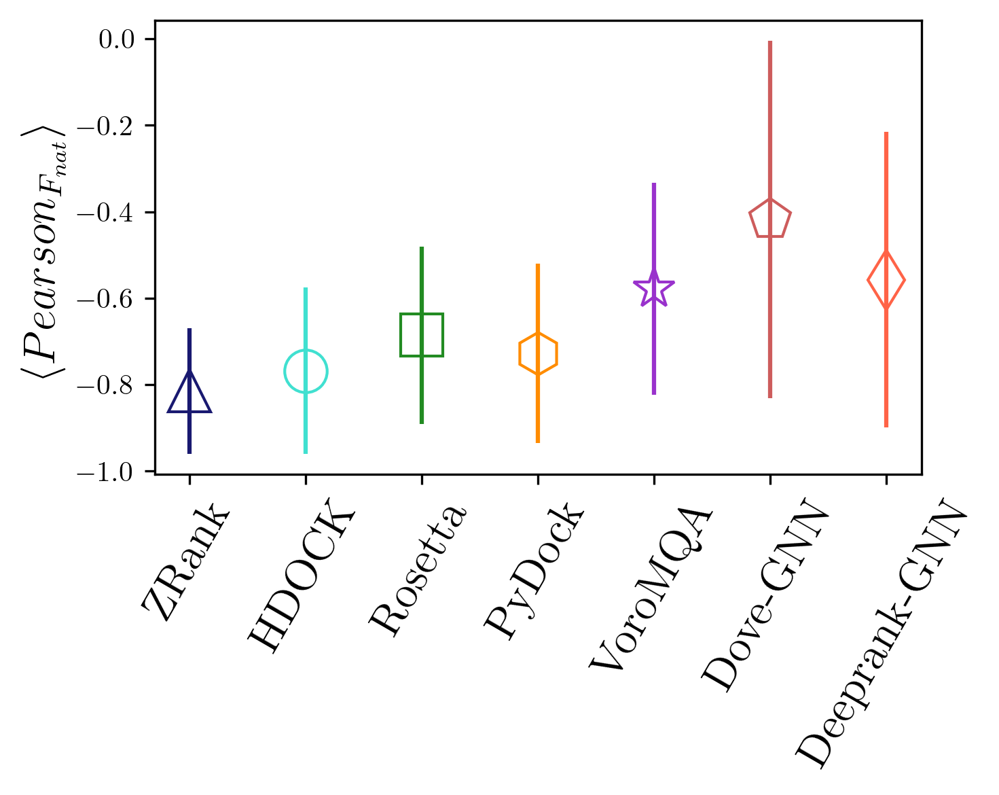

In [312]:
## Show Fnat instead

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid", "indianred", "tomato"]

markers = ["^", "o", "s", "h", "*", "p", "d"]

x_axis = range(7)

ss_plot_data = [np.mean(pearson_corr_fnats[0]), np.mean(pearson_corr_fnats[1]),
                    np.mean(pearson_corr_fnats[2]), np.mean(pearson_corr_fnats[3]),
                    np.mean(pearson_corr_fnats[4])*-1, np.mean(pearson_corr_fnats[5]),
                    np.mean(pearson_corr_fnats[8])*-1]

ss_plot_std = [np.std(pearson_corr_fnats[0]), np.std(pearson_corr_fnats[1]),
                    np.std(pearson_corr_fnats[2]), np.std(pearson_corr_fnats[3]),
                    np.std(pearson_corr_fnats[4])*-1, np.std(pearson_corr_fnats[5]),
                    np.std(pearson_corr_fnats[8])*-1]

plt.errorbar(x_axis[0], ss_plot_data[0], yerr = ss_plot_std[0], color = colors[0], marker = markers[0], markerfacecolor = "None", markersize = 15)
plt.errorbar(x_axis[1], ss_plot_data[1], yerr = ss_plot_std[1], color = colors[1], marker = markers[1], markerfacecolor = "None", markersize = 15)
plt.errorbar(x_axis[2], ss_plot_data[2], yerr = ss_plot_std[2], color = colors[2], marker = markers[2], markerfacecolor = "None", markersize = 15)
plt.errorbar(x_axis[3], ss_plot_data[3], yerr = ss_plot_std[3], color = colors[3], marker = markers[3], markerfacecolor = "None", markersize = 15)
plt.errorbar(x_axis[4], ss_plot_data[4], yerr = ss_plot_std[4], color = colors[4], marker = markers[4], markerfacecolor = "None", markersize = 15)
plt.errorbar(x_axis[5], ss_plot_data[5], yerr = ss_plot_std[5], color = colors[5], marker = markers[5], markerfacecolor = "None", markersize = 15)
plt.errorbar(x_axis[6], ss_plot_data[6], yerr = ss_plot_std[6], color = colors[6], marker = markers[6], markerfacecolor = "None", markersize = 15)

                              
score_list = ["ZRank", "HDOCK", "Rosetta", "PyDock", "VoroMQA", "Dove-GNN", "Deeprank-GNN"]
plt.xticks(x_axis, score_list, fontsize = 16, rotation = 60)

ax.set_ylabel(r"$\langle Pearson_{F_{nat}}\rangle$", fontsize = 16)
fig.tight_layout()

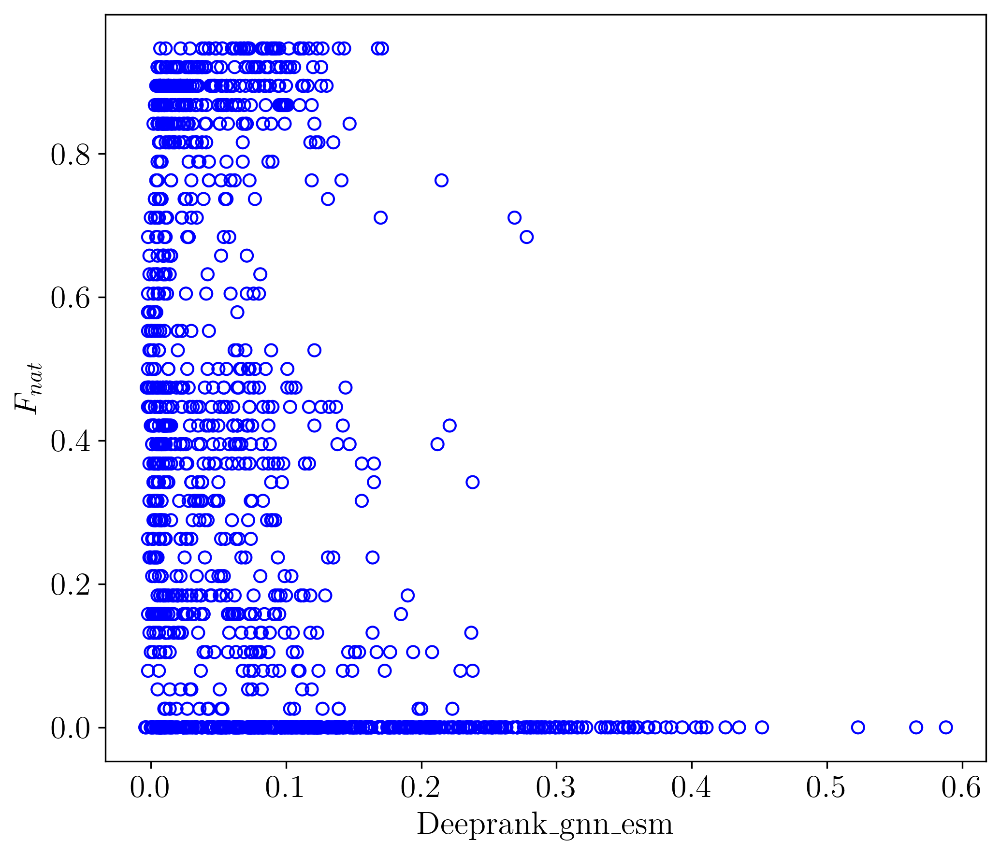

In [313]:
## Simple plot of score correlations

font_size = 16

fig, ax = plt.subplots(figsize = (7,6), dpi = 300)

pdb = "2grn"
score = "Deeprank_gnn_esm"


# ax.scatter(zdock_relaxed_combined_dfs[pdb]["ZRank"], zdock_relaxed_combined_dfs[pdb]["DockQ"], color = "black", label = "Original Data", marker = "o", facecolor = "None")
ax.scatter(ss_score_dict[pdb][score], ss_score_dict[pdb]["Fnat"], color = "blue", label = "Supersampled Decoys", marker = "o", facecolor = "None")
# ax.scatter(target_score_df[target_score_df["pdb"] == pdb]["ZRank"], target_score_df[target_score_df["pdb"] == pdb]["DockQ"], color = "red", label = "Target", marker = "x")

# ax.text(-0.1, 1.15, "(d)", transform=ax.transAxes,fontsize=font_size*1.5, fontweight='bold', va='top', ha='right')
plt.xticks(fontsize = font_size)
plt.yticks(fontsize = font_size)

# plt.legend(fontsize = font_size)

ax.set_xlabel(score, fontsize = font_size)
ax.set_ylabel("$F_{nat}$", fontsize = font_size)
# plt.legend(fontsize = font_size)
fig.tight_layout()

In [185]:
ss_corr_df[ss_corr_df["pdb"] == "2hth"]["spearman_dockq_dove"]

31    0.419907
Name: spearman_dockq_dove, dtype: float64

In [170]:
ss_corr_df[ss_corr_df["pdb"] == "3fpn"]

,pdb,pearson_ialign_zrank,pearson_ialign_hdock,pearson_ialign_rosetta,pearson_ialign_pydock,pearson_ialign_voromqa,pearson_ialign_dove,pearson_ialign_dove_5,pearson_dockq_zrank,pearson_dockq_hdock,...,dove_5_auc,flatness_p3,resolution,fci,fsci,fcore_sa_interface,fcore_sa_complex,fcore_sa_monomer,finterface_complex,finterface_monomer
36,3fpn,-0.800799,-0.72398,-0.350717,-0.430724,0.49839,-0.741903,0.766868,-0.82042,-0.747726,...,0.098478,0.990426,1.8,0.125,0.049296,0.053613,0.017651,0.015634,0.329242,0.291613


In [124]:
ss_corr_df["pdb"].iloc[40:60]

40    3qc8
41    3qhy
42    3rcz
43    3sgb
44    3vz9
45    3wdg
46    3whq
47    3ygs
48    4bi8
49    4ct6
50    4dbg
51    4dhi
52    4g6t
53    4gi3
54    4h5s
55    4hwi
56    4je3
57    4k12
58    4qjf
59    4qlp
Name: pdb, dtype: object

In [209]:
ss_score_dict["4je3"].iloc[60:111]

,Decoy,Model,Fnat,iRMSD,LRMSD,CAPRI,DockQ,IS-Score,ZRank,HDOCK,...,VoroMQA,Dove,Dove_5,ZRank Z-score,HDOCK Z-score,Rosetta Z-score,PyDock Z-score,VoroMQA Z-score,Dove Z-score,Dove_5 Z-score
60,complex.5_2_41,5,0.034,8.013,17.090,Incorrect,0.089,0.1350,-90.2860,-14997.69,...,0.499587,0.9014,0.5782,0.696767,0.907972,0.896157,0.529596,-0.525860,1.021866,1.222003
61,complex.5_2_45,5,0.085,9.015,16.925,Incorrect,0.105,0.1070,-39.2236,-14896.64,...,0.522772,0.7805,0.4204,1.664156,1.174168,1.135651,1.713103,-0.234773,0.670099,0.190015
62,complex.5_2_4,5,0.043,7.320,20.580,Incorrect,0.076,0.1242,-71.2366,-14822.94,...,0.456246,0.9618,0.3985,1.057662,1.368315,1.105945,0.570277,-1.070007,1.197604,0.046792
63,complex.5_2_9,5,0.051,6.316,13.857,Incorrect,0.126,0.0934,-72.0046,-14984.30,...,0.462617,0.9872,0.3742,1.043112,0.943245,1.012858,0.361775,-0.990019,1.271507,-0.112126
64,complex.5_3_11,5,0.197,7.141,13.894,Incorrect,0.170,0.1650,-86.2325,-15049.76,...,0.516113,0.6671,0.5738,0.773562,0.770805,1.124631,1.691821,-0.318376,0.340155,1.193228
65,complex.5_3_12,5,0.034,6.446,15.805,Incorrect,0.103,0.1724,-66.6654,-14924.69,...,0.536346,0.9630,0.4123,1.144265,1.100276,1.274220,1.625202,-0.064351,1.201095,0.137042
66,complex.5_3_14,5,0.060,6.659,13.264,Incorrect,0.133,0.1587,-95.6796,-15002.12,...,0.529896,0.8741,0.4480,0.594584,0.896302,0.666280,0.206368,-0.145331,0.942435,0.370515
67,complex.5_3_19,5,0.077,6.818,14.113,Incorrect,0.130,0.1448,-79.9720,-15129.26,...,0.575510,0.8741,0.5210,0.892168,0.561378,0.061659,0.704512,0.427354,0.942435,0.847924
68,complex.5_3_47,5,0.051,5.709,11.445,Incorrect,0.157,0.1365,-69.5521,-14956.52,...,0.592145,0.9324,0.5280,1.089576,1.016426,0.962379,0.204927,0.636206,1.112063,0.893703
69,complex.5_4_14,5,0.085,5.566,13.036,Incorrect,0.151,0.2090,-85.4052,-15008.11,...,0.496506,0.9522,0.5452,0.789235,0.880523,0.693453,0.370864,-0.564542,1.169672,1.006188


## Pearson vs Spearman

<function matplotlib.pyplot.tight_layout(*, pad=1.08, h_pad=None, w_pad=None, rect=None)>

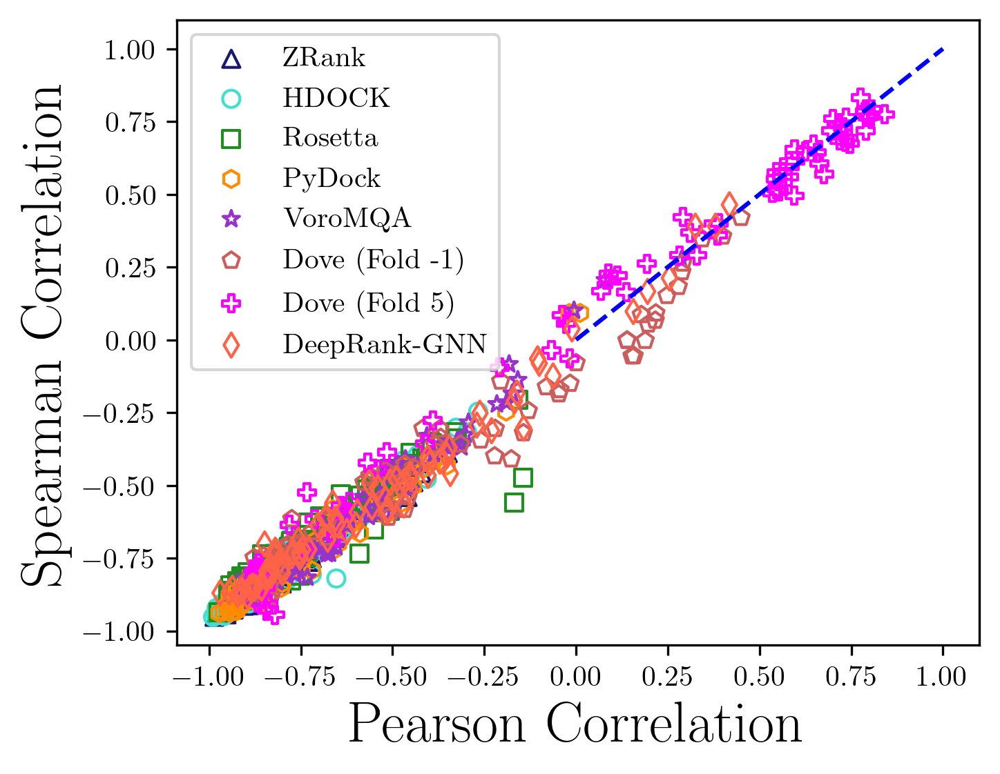

In [259]:
## Tenative Figure 1 - C

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

## Relaxed

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid", "indianred", "magenta", "tomato"]

ax.scatter(ss_corr_df["pearson_dockq_zrank"], ss_corr_df["spearman_dockq_zrank"], color = colors[0], marker = "^", facecolor = "None", label = "ZRank")
ax.scatter(ss_corr_df["pearson_dockq_hdock"], ss_corr_df["spearman_dockq_hdock"], color = colors[1], marker = "o", facecolor = "None", label = "HDOCK")
ax.scatter(ss_corr_df["pearson_dockq_rosetta"], ss_corr_df["spearman_dockq_rosetta"], color = colors[2], marker = "s", facecolor = "None", label = "Rosetta")
ax.scatter(ss_corr_df["pearson_dockq_pydock"], ss_corr_df["spearman_dockq_pydock"], color = colors[3], marker = "h", facecolor = "None", label = "PyDock")
ax.scatter(np.array(ss_corr_df["pearson_dockq_voromqa"])*-1, np.array(ss_corr_df["spearman_dockq_voromqa"])*-1, color = colors[4], marker = "*", facecolor = "None", label = "VoroMQA")
ax.scatter(ss_corr_df["pearson_dockq_dove"], ss_corr_df["spearman_dockq_dove"], color = colors[5], marker = "p", facecolor = "None", label = "Dove (Fold -1)")
ax.scatter(ss_corr_df["pearson_dockq_dove_5"], ss_corr_df["spearman_dockq_dove_5"], color = colors[6], marker = "P", facecolor = "None", label = "Dove (Fold 5)")
ax.scatter(ss_corr_df["pearson_dockq_deeprank"]*-1, ss_corr_df["spearman_dockq_deeprank"]*-1, color = colors[7], marker = "d", facecolor = "None", label = "DeepRank-GNN")


## Y = -X

temp_x = np.linspace(0, 1, 10)
temp_y = np.linspace(0, 1, 10)
ax.plot(temp_x, temp_y, "b--", )

ax.set_xlabel("Pearson Correlation", fontsize = 20)
ax.set_ylabel("Spearman Correlation", fontsize = 20)

plt.legend()
plt.tight_layout


In [190]:
keys_list = list(ss_score_dict.keys())

temp_list = sorted([(key, len(ss_score_dict[key])) for key in keys_list], key = lambda x: x[1])

In [192]:
print(temp_list)

[('4je3', 222), ('3whq', 756), ('1qav', 1096), ('2oul', 1144), ('4qjf', 1156), ('2d5r', 1188), ('2wmp', 1206), ('1itb', 1214), ('1kfu', 1214), ('1ugq', 1218), ('1xg2', 1222), ('5mu7', 1232), ('2hla', 1254), ('1pdk', 1256), ('7bxh', 1260), ('2hth', 1290), ('3qhy', 1290), ('1wrd', 1292), ('5uq2', 1292), ('4g6t', 1306), ('5k7m', 1310), ('4bi8', 1312), ('4ct6', 1314), ('2g2u', 1316), ('4qlp', 1322), ('2bkr', 1324), ('6kp3', 1324), ('1c3a', 1330), ('3sgb', 1334), ('1r8o', 1336), ('6wg4', 1338), ('5by8', 1340), ('3ona', 1344), ('7joe', 1344), ('1f60', 1348), ('3qc8', 1350), ('1ay7', 1352), ('6fud', 1354), ('3k9p', 1356), ('2pe6', 1362), ('3fpn', 1366), ('2grn', 1368), ('3ygs', 1368), ('5zrz', 1368), ('4dbg', 1378), ('4uzz', 1378), ('4yii', 1378), ('4k12', 1380), ('3wdg', 1382), ('4h5s', 1384), ('5maw', 1384), ('1ugh', 1386), ('4dhi', 1386), ('1j7d', 1388), ('1spp', 1390), ('1euv', 1392), ('1n1j', 1392), ('3rcz', 1392), ('1acb', 1394), ('2h7z', 1396), ('5dmb', 1398), ('2fhz', 1400), ('3gfk', 

In [195]:
print(len(ss_score_dict["1ggp"][ss_score_dict["1ggp"]["CAPRI"] == "Incorrect"]))

1219


In [227]:
print(list(ss_corr_df["pdb"]))

['1acb', '1ay7', '1c3a', '1euv', '1f60', '1ggp', '1itb', '1j7d', '1kfu', '1n1j', '1pdk', '1qav', '1r8o', '1spp', '1tfo', '1ugh', '1ugq', '1vet', '1wmh', '1wqj', '1wrd', '1xg2', '2bkr', '2d5r', '2dvw', '2fhz', '2g2u', '2grn', '2h7z', '2hla', '2hsm', '2hth', '2oul', '2pe6', '2wmp', '3dgp', '3fpn', '3gfk', '3k9p', '3ona', '3qc8', '3qhy', '3rcz', '3sgb', '3vz9', '3wdg', '3whq', '3ygs', '4bi8', '4ct6', '4dbg', '4dhi', '4g6t', '4gi3', '4h5s', '4hwi', '4je3', '4k12', '4qjf', '4qlp', '4uzz', '4yii', '5by8', '5dmb', '5k7m', '5maw', '5mu7', '5uq2', '5zrz', '6fud', '6kp3', '6wg4', '6xod', '6zbk', '7bxh', '7joe', '7jxv']


In [270]:
ss_score_dict["1c3a"]

,Decoy,Model,Fnat,iRMSD,LRMSD,CAPRI,DockQ,IS-Score,ZRank,HDOCK,...,VoroMQA,Dove,Dove_5,ZRank Z-score,HDOCK Z-score,Rosetta Z-score,PyDock Z-score,VoroMQA Z-score,Dove Z-score,Dove_5 Z-score
0,relaxed_1c3a_model_1,-1,0.000,14.587,44.483,Incorrect,0.015,0.0801,-45.6718,-11915.17,...,0.189853,0.9475,0.3599,1.352819,1.540943,1.213574,1.218367,-2.896579,1.345536,-0.059094
1,relaxed_1c3a_model_10,-1,0.016,17.073,41.739,Incorrect,0.021,0.0950,-88.6814,-12407.81,...,0.486187,0.6584,0.6077,0.811752,0.514212,0.291751,0.902709,0.422884,0.449892,1.298584
2,relaxed_1c3a_model_100,-1,0.094,10.747,22.316,Incorrect,0.080,0.1210,-69.8619,-12148.79,...,0.398116,0.8511,0.5565,1.048504,1.054046,0.347028,0.761460,-0.563666,1.046884,1.018063
3,relaxed_1c3a_model_101,-1,0.102,6.821,17.235,Incorrect,0.115,0.1503,-68.5353,-12281.38,...,0.432391,0.9568,0.5790,1.065193,0.777710,1.173961,1.169117,-0.179726,1.374347,1.141339
4,relaxed_1c3a_model_102,-1,0.102,5.327,12.626,Incorrect,0.163,0.1304,-154.3100,-12599.56,...,0.379934,0.3829,0.3144,-0.013866,0.114578,0.743279,0.425566,-0.767337,-0.403619,-0.308385
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
408,relaxed_1c3a_model_467,-1,0.039,13.585,32.146,Incorrect,0.039,0.1023,-98.7871,-12366.69,...,0.326682,0.8896,0.6329,0.684621,0.599912,0.919926,0.234226,-1.363853,1.166159,1.436653
409,relaxed_1c3a_model_468,-1,0.000,15.236,26.549,Incorrect,0.034,0.0801,-61.3359,-12241.98,...,0.350293,0.9405,0.6056,1.155763,0.859825,1.069883,1.267238,-1.099368,1.323849,1.287078
410,relaxed_1c3a_model_469,-1,0.016,17.900,28.405,Incorrect,0.035,0.0890,-100.9140,-12337.98,...,0.439060,0.9285,0.6161,0.657864,0.659748,0.531056,1.088306,-0.105021,1.286673,1.344607
411,relaxed_1c3a_model_47,-1,0.000,16.412,31.450,Incorrect,0.025,0.0801,-64.9817,-12000.60,...,0.328468,0.8494,0.4064,1.109898,1.362895,0.723006,1.245864,-1.343847,1.041618,0.195676


In [271]:
print(len(set(ss_score_dict["1c3a"]["Decoy"])))

917


In [275]:
ss_score_dict["2wmp"]

,Decoy,Model,Fnat,iRMSD,LRMSD,CAPRI,DockQ,IS-Score,ZRank,HDOCK,...,VoroMQA,Dove,Dove_5,ZRank Z-score,HDOCK Z-score,Rosetta Z-score,PyDock Z-score,VoroMQA Z-score,Dove Z-score,Dove_5 Z-score
0,relaxed_2wmp_model_1,-1,0.000,17.960,45.087,Incorrect,0.014,0.0769,-66.5931,-13550.79,...,0.438577,0.9041,0.5143,1.039038,0.902456,0.882665,0.931234,-0.024641,0.785165,0.692536
1,relaxed_2wmp_model_10,-1,0.000,25.016,53.145,Incorrect,0.010,0.0769,-40.1710,-13427.54,...,0.249728,0.6085,0.4484,1.457388,1.198621,1.454601,2.490636,-2.041485,-0.563392,0.260540
2,relaxed_2wmp_model_100,-1,0.058,15.011,23.621,Incorrect,0.061,0.0940,-85.7864,-13779.72,...,0.399625,0.5929,0.6240,0.735144,0.352347,0.720607,0.354431,-0.440635,-0.634561,1.411656
3,relaxed_2wmp_model_101,-1,0.058,9.929,15.583,Incorrect,0.103,0.1069,-80.4076,-13465.28,...,0.324193,0.9884,0.5200,0.820309,1.107933,1.130994,-0.413611,-1.246224,1.169750,0.729901
4,relaxed_2wmp_model_102,-1,0.078,8.119,15.238,Incorrect,0.116,0.0877,-117.4020,-13653.71,...,0.363760,0.9001,0.6055,0.234565,0.655144,0.854847,0.498072,-0.823662,0.766916,1.290382
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
306,relaxed_2wmp_model_237,-1,0.000,14.937,27.519,Incorrect,0.032,0.0769,-81.9176,-13632.36,...,0.287359,0.8051,0.5958,0.796400,0.706447,0.382922,2.327083,-1.639599,0.333517,1.226796
307,relaxed_2wmp_model_237,-1,0.000,14.937,27.519,Incorrect,0.032,0.0769,-81.9176,-13632.36,...,0.287359,0.8051,0.5958,0.796400,0.706447,0.315276,2.327083,-1.639599,0.333517,1.226796
308,relaxed_2wmp_model_238,-1,0.019,20.760,35.415,Incorrect,0.026,0.1002,-68.7446,-13484.99,...,0.331827,0.8204,0.5506,1.004973,1.060571,0.832525,1.994226,-1.164695,0.403317,0.930495
309,relaxed_2wmp_model_238,-1,0.019,20.760,35.415,Incorrect,0.026,0.1002,-68.7446,-13484.99,...,0.331827,0.8204,0.5506,1.004973,1.060571,0.474247,1.994226,-1.164695,0.403317,0.930495


# ROC Plots

In [77]:
def create_ROC_curve_single_data(score_df, col_name = "ZRank Z-score", quality = "acceptable", cutoff = 100000):
    '''
    Takes the score_df (DataFrame) and a given 'col_name' which corresponds to one of the columns 
    in the dataframe and some quality metric, which is what treats the data as a true positive. Also, a 
    cutoff is taken which is used to distinguish 'true positives' from 'false positives'. The cutoff
    is designed to be used with Z-score normalized scores, that way it is easy to have a standardized cutoff
    across all scoring metrics. True positives are labeled with a 1 and false positives are labeled with a 0.
    '''
    
    if quality.lower() in "acceptable":
        quality = ["acceptable", "medium", "high"]
    elif quality.lower() in "medium":
        quality = ["medium", "high"]
    elif quality.lower() in "high":
        quality = ["high"]
    else:
        print("Please input a valid quality from 'acceptable', 'medium', or 'high'.")
        return 1
    
    temp_scores = score_df[col_name]
    temp_capri = score_df["CAPRI"]
    
    ## Filter according to the cutoff
    final_scores = temp_scores[temp_scores <= cutoff]
    final_capri = np.array(temp_capri[temp_scores <= cutoff])
    
    ## Get the label array for the capri scores
    capri_mask = np.zeros(final_capri.size)
    for i in range(len(capri_mask)):
        if final_capri[i].lower() in quality:
            capri_mask[i] = 1
    
    ## Get the ROC curve data using sklearn
    false_pos, true_pos, thresholds = metrics.roc_curve(capri_mask, final_scores, pos_label=1)
    
    return false_pos, true_pos, thresholds

<function matplotlib.pyplot.tight_layout(*, pad=1.08, h_pad=None, w_pad=None, rect=None)>

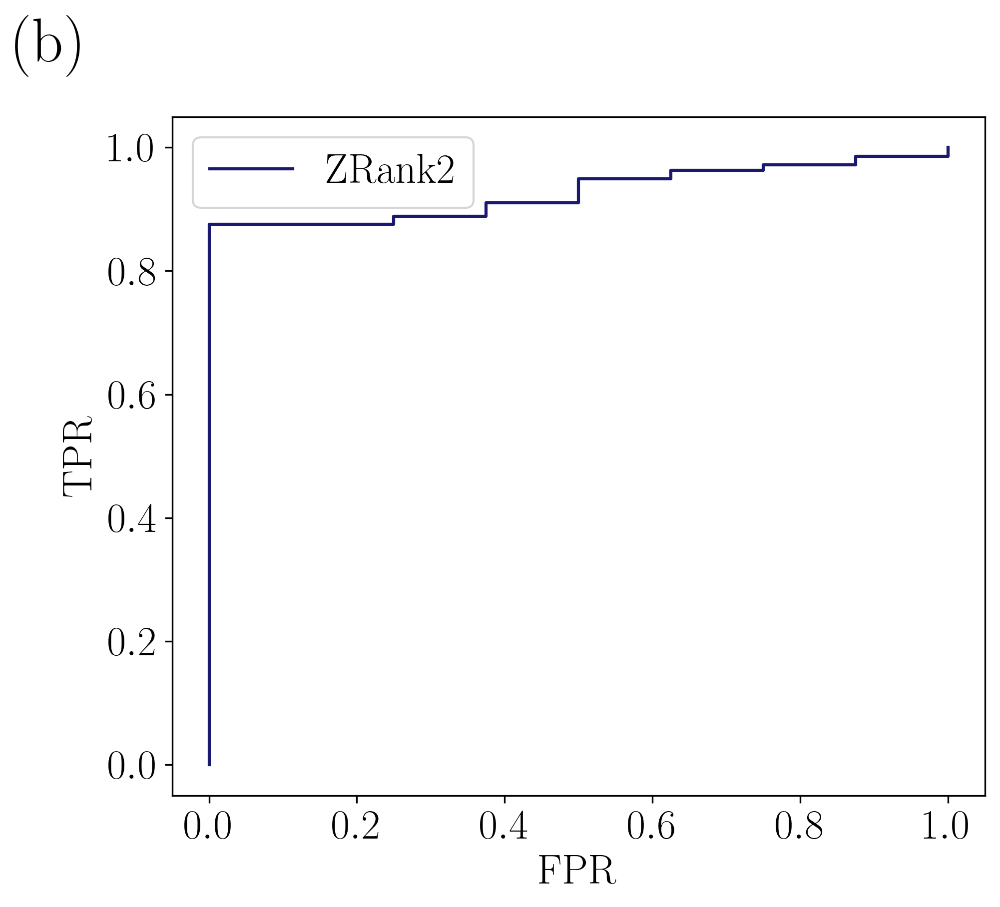

In [79]:
## Quick ROC Plots for example

pdb = "1xg2"

font_size = 20

tpr, fpr, thresh = create_ROC_curve_single_data(zdock_relaxed_combined_dfs[pdb], col_name = "ZRank", quality = "acceptable", cutoff = 100000)

fig, ax = plt.subplots(figsize = (7,6), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid", "indianred", "magenta"]

ax.plot(fpr, tpr, color = colors[0], label = "ZRank2")


ax.set_xlabel("FPR", fontsize = font_size)
ax.set_ylabel("TPR", fontsize = font_size)

ax.text(-0.1, 1.15, "(b)", transform=ax.transAxes,fontsize=font_size*1.5, fontweight='bold', va='top', ha='right')
plt.xticks(fontsize = font_size)
plt.yticks(fontsize = font_size)

plt.legend(fontsize = font_size)

# plt.legend()
plt.tight_layout


In [119]:
relaxed_corr_df[relaxed_corr_df["pdb"] == "1xg2"]["zrank_auc"]

21    0.927591
Name: zrank_auc, dtype: float64

In [83]:
ss_balanced_dir = "/Users/jakesumner/Desktop/PPI Project/supersampling/all_supersampled_balanced_datasets"
os.chdir(ss_balanced_dir)

pdb_list = ['1acb', '1ay7', '1c3a', '1euv', '1f60', '1ggp', '1itb', '1j7d', '1kfu', '1mbv', '1n1j', '1pdk', '1qav', '1r8o', '1ry7', '1spp', '1tfo', '1ugh', '1ugq', '1vet', '1wmh', '1wqj', '1wrd', '1xg2', '2bkr', '2d5r', '2dvw', '2fhz', '2g2u', '2grn', '2h7z', '2hla', '2hsm', '2hth', '2oul', '2pe6', '2wmp', '3dgp', '3fpn', '3gfk', '3hw2', '3k9p', '3ona', '3qc8', '3qhy', '3rcz', '3sgb', '3u82', '3vz9', '3wdg', '3whq', '3ygs', '4bi8', '4ct6', '4dbg', '4dhi', '4g6t', '4gi3', '4h5s', '4hwi', '4je3', '4k12', '4qjf', '4qlp', '4u1c', '4uzz', '4yii', '5by8', '5dmb', '5k7m', '5maw', '5mu7', '5uq2', '5zrz', '6fud', '6kp3', '6wg4', '6xod', '6yxj', '6zbk', '7bxh', '7joe', '7jxv', '8enf']

all_csv_files = sorted([f for f in listdir(ss_balanced_dir) if isfile(join(ss_balanced_dir, f)) and ".csv" in f and f[:4] in pdb_list])

ss_score_dict = {}
for csv_file in all_csv_files:
    pdb_name = csv_file[:4]
    ss_score_dict[pdb_name] = pd.read_csv(csv_file)

<function matplotlib.pyplot.tight_layout(*, pad=1.08, h_pad=None, w_pad=None, rect=None)>

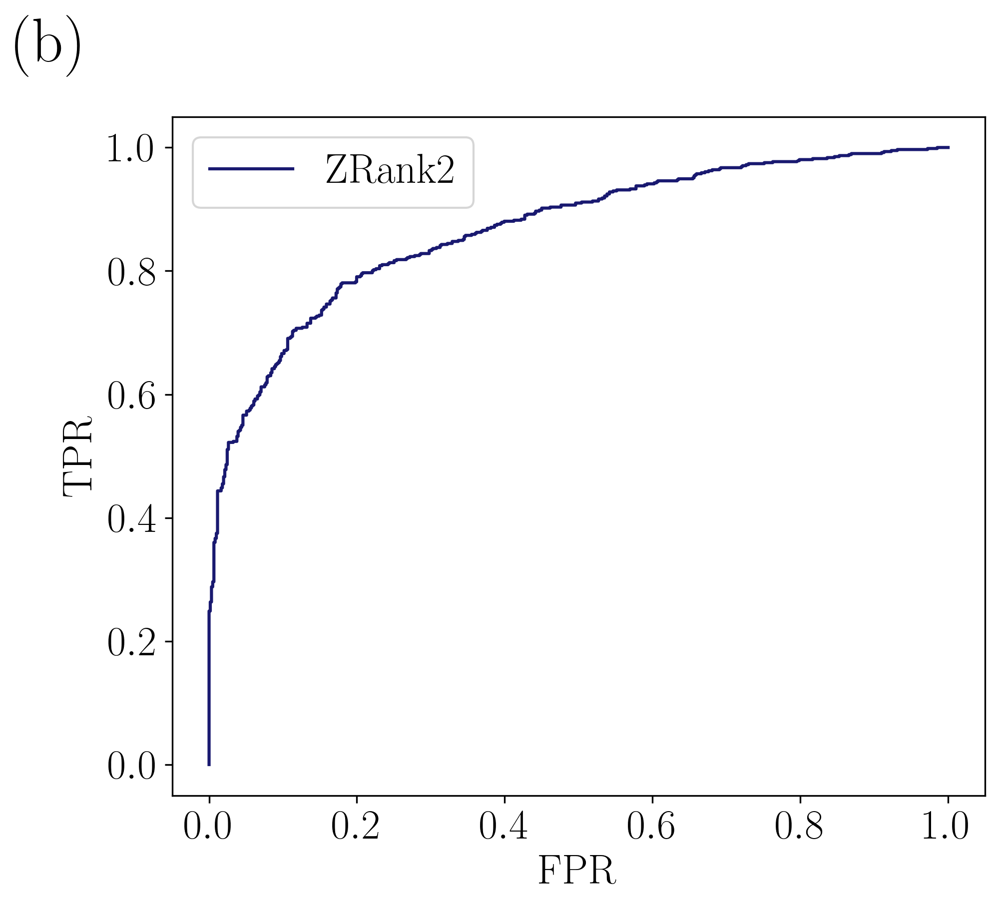

In [85]:
## ROC plots for supersampled data

pdb = "1xg2"

font_size = 20

tpr, fpr, thresh = create_ROC_curve_single_data(ss_score_dict[pdb], col_name = "ZRank", quality = "acceptable", cutoff = 100000)

fig, ax = plt.subplots(figsize = (7,6), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid", "indianred", "magenta"]

ax.plot(fpr, tpr, color = colors[0], label = "ZRank2")


ax.set_xlabel("FPR", fontsize = font_size)
ax.set_ylabel("TPR", fontsize = font_size)

ax.text(-0.1, 1.15, "(b)", transform=ax.transAxes,fontsize=font_size*1.5, fontweight='bold', va='top', ha='right')
plt.xticks(fontsize = font_size)
plt.yticks(fontsize = font_size)

plt.legend(fontsize = font_size)

# plt.legend()
plt.tight_layout


In [113]:
ss_corr_df[ss_corr_df["pdb"] == "3rcz"]["zrank_auc"]

45    0.891149
Name: zrank_auc, dtype: float64

0.8314999999999988

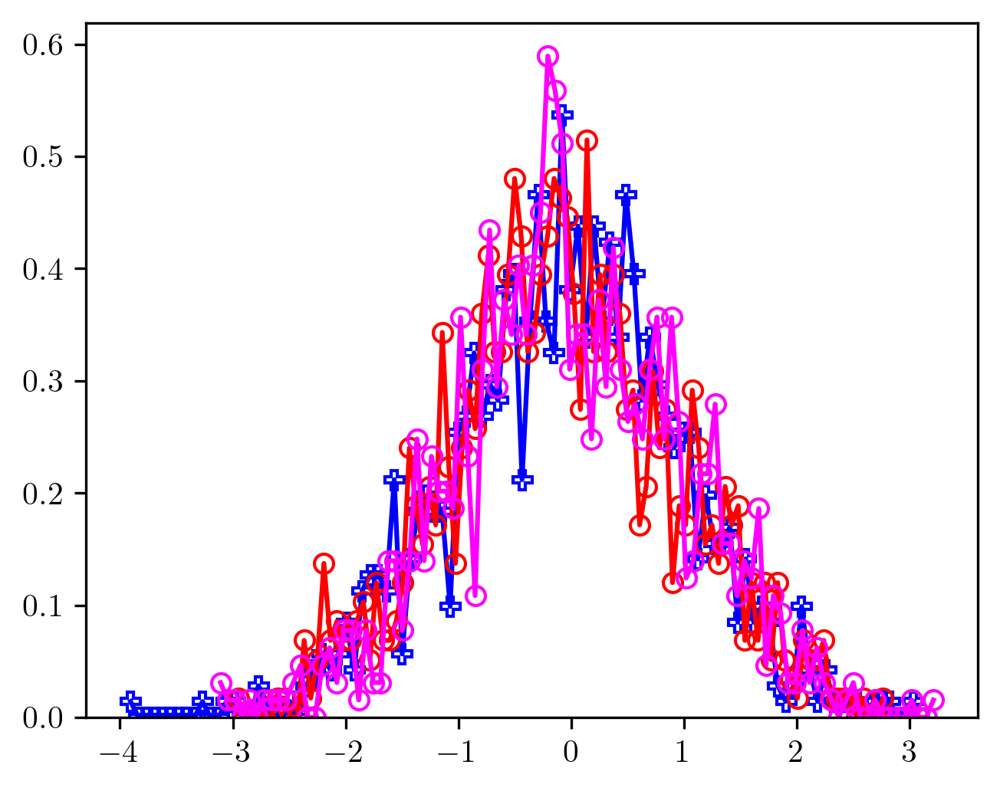

In [294]:
temp_data = np.random.normal(size = (1000))
temp_data_1 = np.random.normal(size = (1000))
temp_data_2 = np.random.normal(size = (1000))

fig,ax = plt.subplots(figsize = [5,4], dpi = 300)

colors = ["blue", "red", "magenta"]

create_prob_dist(temp_data, fig, ax, color = colors[0], marker = "P")
create_prob_dist(temp_data_1, fig, ax, color = colors[1])
create_prob_dist(temp_data_2, fig, ax, color = colors[2])

In [220]:
## Move intertwined scores into the proper folder

inter_dir = r"/Users/jakesumner/Desktop/PPI Project/supersampling/intertwined_scores"
score_dir = r"/Users/jakesumner/Desktop/PPI\ Project/supersampling/scores_high_res_all_residues"

inter_files = sorted([f for f in listdir(inter_dir) if isfile(join(inter_dir, f)) and ".txt" in f])

In [221]:
os.chdir(inter_dir)

inter_list = []
for f in inter_files:
    pdb = f.split("_")[1]
    inter_list.append(pdb)
    new_dir = join(score_dir, f"scores_sampled_{pdb}")
    os.system(f"cp {f} {new_dir}")

In [225]:
print(inter_list)

['1acb', '1acb', '1ay7', '1ay7', '1euv', '1euv', '1f60', '1f60', '1j7d', '1j7d', '1n1j', '1n1j', '1qav', '1qav', '1r8o', '1r8o', '1ugh', '1ugh', '1ugq', '1ugq', '1vet', '1vet', '1wmh', '1wmh', '1wqj', '1wqj', '1wrd', '1wrd', '1xg2', '1xg2', '2bkr', '2bkr', '2fhz', '2fhz', '2g2u', '2g2u', '2grn', '2grn', '2h7z', '2h7z', '3dgp', '3dgp', '3fpn', '3fpn', '3qhy', '3qhy', '3rcz', '3rcz', '3sgb', '3sgb', '3vz9', '3vz9', '3wdg', '3wdg', '3whq', '3whq', '3ygs', '3ygs', '4bi8', '4bi8', '4ct6', '4ct6', '4dbg', '4dbg', '4dhi', '4dhi', '4g6t', '4g6t', '4gi3', '4gi3', '4h5s', '4h5s', '4hwi', '4hwi', '4je3', '4je3', '4k12', '4k12', '4qjf', '4qjf', '4qlp', '4qlp', '4uzz', '4uzz', '4yii', '4yii', '5by8', '5by8', '5dmb', '5dmb', '5k7m', '5k7m', '5maw', '5maw', '5mu7', '5mu7', '5uq2', '5uq2', '5zrz', '5zrz', '6fud', '6fud', '6kp3', '6kp3', '6wg4', '6wg4', '6xod', '6xod', '6zbk', '6zbk', '7bxh', '7bxh', '7joe', '7joe', '7jxv', '7jxv']


In [372]:
## Lazy Jocob moving files

scores_dir = "/Users/jakesumner/Desktop/PPI Project/supersampling/scores_high_res_all_residues"
os.chdir(scores_dir)

all_dirs = sorted([f for f in listdir(scores_dir) if isdir(join(scores_dir, f)) and "scores" in f])

all_txt_files = sorted([f for f in listdir(scores_dir) if isfile(join(scores_dir, f)) and ".txt" in f])

In [376]:
for txt_file in all_txt_files:
    pdb = txt_file.split("_")[1]
    os.system(f"cp {txt_file} scores_sampled_{pdb}/")

cp: directory scores_sampled_1brb does not exist
cp: directory scores_sampled_1brb does not exist
cp: directory scores_sampled_1ka9 does not exist
cp: directory scores_sampled_1ka9 does not exist
cp: directory scores_sampled_2nts does not exist
cp: directory scores_sampled_2nts does not exist
cp: directory scores_sampled_1brb does not exist
cp: directory scores_sampled_1brb does not exist
cp: directory scores_sampled_1ka9 does not exist
cp: directory scores_sampled_1ka9 does not exist
cp: directory scores_sampled_2nts does not exist
cp: directory scores_sampled_2nts does not exist


# Creating the dataset of physical attributes for training purposes

In [182]:
def create_supersampled_voro_rosetta_data(score_dir):
    '''
    Loops through all of the folders in the score_dir and
    collects the score data. Outputs a dictionary where
    each key is the PDB ID and each value is a pandas
    DataFrame with all of the score data for that particular
    supersampled target
    '''
    
    score_dirs = sorted([f for f in listdir(score_dir) if isdir(join(score_dir, f)) and "scores_sampled" in f])
    
    final_dict = {}
    
    grace_pdbs = ['1spp', '3qc8', '2d5r', '1ka9', '3ona', '2wmp', '1itb', '2hth', '2hsm', '1kfu', '1ggp', '1pdk', '2hla', '2pe6', '1c3a', '2dvw', '3gfk', '2oul', '1tfo', '2nts', '1brb', '3k9p']
    
    inter_list = ['1acb', '1acb', '1ay7', '1ay7', '1euv', '1euv', '1f60', '1f60', '1j7d', '1j7d', '1n1j', '1n1j', '1qav', '1qav', '1r8o', '1r8o', '1ugh', '1ugh', '1ugq', '1ugq', '1vet', '1vet', '1wmh', '1wmh', '1wqj', '1wqj', '1wrd', '1wrd', '1xg2', '1xg2', '2bkr', '2bkr', '2fhz', '2fhz', '2g2u', '2g2u', '2grn', '2grn', '2h7z', '2h7z', '3dgp', '3dgp', '3fpn', '3fpn', '3qhy', '3qhy', '3rcz', '3rcz', '3sgb', '3sgb', '3vz9', '3vz9', '3wdg', '3wdg', '3whq', '3whq', '3ygs', '3ygs', '4bi8', '4bi8', '4ct6', '4ct6', '4dbg', '4dbg', '4dhi', '4dhi', '4g6t', '4g6t', '4gi3', '4gi3', '4h5s', '4h5s', '4hwi', '4hwi', '4je3', '4je3', '4k12', '4k12', '4qjf', '4qjf', '4qlp', '4qlp', '4uzz', '4uzz', '4yii', '4yii', '5by8', '5by8', '5dmb', '5dmb', '5k7m', '5k7m', '5maw', '5maw', '5mu7', '5mu7', '5uq2', '5uq2', '5zrz', '5zrz', '6fud', '6fud', '6kp3', '6kp3', '6wg4', '6wg4', '6xod', '6zbk', '6zbk', '7bxh', '7bxh', '7joe', '7joe', '7jxv', '7jxv']
    
    for target_score_dir in score_dirs:
        
        pdb_name = target_score_dir.split("_")[-1].strip("/")
        
        ## Temporary until the intertwined stuff is done running
#         if pdb_name not in inter_list:
#             continue
        print(pdb_name)
        
        
        comb_dir = join(score_dir, target_score_dir)
        
        ## Sampled Decoy Scores
        dockq_fileind_s = f"dockq_scores_{pdb_name}_sampled"
        ialign_fileind_s = f"sampled_iAlign"
        rosetta_fileind_s = "rosetta_scores_sampled"
        voromqa_fileind_s = f"voromqa_new_scores_{pdb_name}_sampled"
        intertwined_fileind_s = f"intertwined_{pdb_name}_sampled"
        
        if pdb_name in grace_pdbs:
            dockq_temp_df_s = create_dockq_df_multi_file(comb_dir, file_indicator = dockq_fileind_s, grace = True)
            ialign_temp_df_s = get_ialign_scores(comb_dir, file_indicator = ialign_fileind_s, ss = True, grace = True)
            rosetta_temp_df_s = get_all_rosetta_cols(comb_dir, rosetta_fileind_s, grace = True)
            voromqa_temp_df_s = get_all_voro_cols(comb_dir, voromqa_fileind_s, grace = True)
            intertwined_temp_df_s = get_intertwined_score(comb_dir, intertwined_fileind_s, grace = True)
        else:
            dockq_temp_df_s = create_dockq_df_multi_file(comb_dir, file_indicator = dockq_fileind_s)
            ialign_temp_df_s = get_ialign_scores(comb_dir, file_indicator = ialign_fileind_s, ss = True)
            rosetta_temp_df_s = get_all_rosetta_cols(comb_dir, rosetta_fileind_s)
            voromqa_temp_df_s = get_all_voro_cols(comb_dir, voromqa_fileind_s)
            intertwined_temp_df_s = get_intertwined_score(comb_dir, intertwined_fileind_s)
        
        ## Random Negative Decoy Scores
        dockq_fileind_r = f"dockq_scores_{pdb_name}_random"
        ialign_fileind_r = f"random_iAlign"
        rosetta_fileind_r = "rosetta_scores_random"
        voromqa_fileind_r = f"voromqa_new_scores_{pdb_name}_random"
        intertwined_fileind_r = f"intertwined_{pdb_name}_random"
        
        if pdb_name in grace_pdbs:
            dockq_temp_df_r = create_dockq_df_multi_file(comb_dir, file_indicator = dockq_fileind_r, grace = True)
            ialign_temp_df_r = get_ialign_scores(comb_dir, file_indicator = ialign_fileind_r, ss = True, grace = True)
            rosetta_temp_df_r = get_all_rosetta_cols(comb_dir, rosetta_fileind_r, grace = True)
            voromqa_temp_df_r = get_all_voro_cols(comb_dir, voromqa_fileind_r, grace = True)
            intertwined_temp_df_r = get_intertwined_score(comb_dir, intertwined_fileind_r, grace = True)
        else:
            dockq_temp_df_r = create_dockq_df_multi_file(comb_dir, file_indicator = dockq_fileind_r)
            ialign_temp_df_r = get_ialign_scores(comb_dir, file_indicator = ialign_fileind_r, ss = True)
            rosetta_temp_df_r = get_all_rosetta_cols(comb_dir, rosetta_fileind_r)
            voromqa_temp_df_r = get_all_voro_cols(comb_dir, voromqa_fileind_r)
            intertwined_temp_df_r = get_intertwined_score(comb_dir, intertwined_fileind_r)
        
        ## Combine datasets within groups
#         print(ialign_temp_df_s)
#         print(dockq_temp_df_s)
#         print(rosetta_temp_df_s)
#         print(voromqa_temp_df_s)
#         print(intertwined_temp_df_s)

        print(len(ialign_temp_df_s))
        print(len(dockq_temp_df_s))
        print(len(rosetta_temp_df_s))
        print(len(voromqa_temp_df_s))
        print(len(intertwined_temp_df_s))

        comb_df_s = dockq_temp_df_s.merge(ialign_temp_df_s, on='Decoy')
        comb_df_s = comb_df_s.merge(rosetta_temp_df_s, on='Decoy')
        comb_df_s = comb_df_s.merge(voromqa_temp_df_s, on='Decoy')
        comb_df_s = comb_df_s.merge(intertwined_temp_df_s, on='Decoy')
        
        
        comb_df_r = dockq_temp_df_r.merge(ialign_temp_df_r, on='Decoy')
        comb_df_r = comb_df_r.merge(rosetta_temp_df_r, on='Decoy')
        comb_df_r = comb_df_r.merge(voromqa_temp_df_r, on='Decoy')
        comb_df_r = comb_df_r.merge(intertwined_temp_df_r, on='Decoy')
        
        ## Save Those Datasets for later use
        
        os.chdir(score_dir)
        
        comb_df_s.to_csv(f"{pdb_name}_sampled_scores.csv")
        comb_df_r.to_csv(f"{pdb_name}_random_scores.csv")
        
        ## Balancing the dataset
        
        balancing_ind = get_num_quality_diff_supersampling(comb_df_s)
        
        temp_balanced_df = pd.concat([comb_df_s, comb_df_r.iloc[:balancing_ind]])
        
        ## Adding the contact area data from Andres
        
        carea_dir = "/Users/jakesumner/Desktop/andres_data/ForJake"
        
        carea_temp = get_contact_area_column(carea_dir, pdb_name)
        
        try:
            temp_balanced_df["relative_interface_area"] = carea_temp
            
        except: 
            failure_list = np.zeros((len(temp_balanced_df)))
            print(f"RELATIVE INTERFACE AREA HAS FAILED with df len: {len(temp_balanced_df)}; and iarea len: {len(carea_temp)}")
            temp_balanced_df["relative_interface_area"] = failure_list
        
        ## Storing the supersampled data in a dictionary
        
        final_dict[pdb_name] = temp_balanced_df
        
    return final_dict

voro_cols = ['Decoy', 'voro_glob_chains', 'voro_glob_unique_chains', 'voro_glob_residues',
             'voro_glob_atoms', 'voro_glob_light_score', 'voro_glob_dark_score', 'voro_glob_area',
             'voro_glob_area_per_atom', 'voro_glob_nonprotein_area', 'voro_glob_volume', 'voro_glob_volume_per_atom',
             'voro_glob_energy', 'voro_glob_energy_norm', 'voro_glob_energy_per_atom', 'voro_glob_sas_area',
             'voro_glob_sas_area_per_atom', 'voro_glob_sas_energy', 'voro_glob_sas_energy_norm',
             'voro_glob_sas_energy_per_atom', 'voro_glob_nonsas_area', 'voro_glob_nonsas_area_per_atom',
             'voro_glob_nonsas_energy', 'voro_glob_nonsas_energy_norm', 'voro_glob_nonsas_energy_per_atom',
             'voro_iface_atoms', 'voro_iface_atoms_light_score', 'voro_iface_area', 'voro_iface_energy',
             'voro_iface_energy_norm', 'voro_iface_energy_per_atom', 'voro_iface_shelled_energy',
             'voro_iface_shelled_energy_norm', 'voro_iface_shelled_energy_per_atom', 'voro_iface_expanded_area',
             'voro_iface_expanded_energy', 'voro_iface_expanded_energy_norm', 'voro_iface_expanded_energy_per_atom',
             'voro_iface_expanded_shelled_energy', 'voro_iface_expanded_shelled_energy_norm',
             'voro_iface_expanded_shelled_energy_per_atom', 'voro_split_light_score', 'voro_split_dark_score',
             'voro_split_area', 'voro_split_area_per_atom', 'voro_split_volume', 'voro_split_volume_per_atom',
             'voro_split_energy', 'voro_split_energy_norm', 'voro_split_energy_per_atom', 'voro_split_sas_area',
             'voro_split_sas_area_per_atom', 'voro_split_sas_energy', 'voro_split_sas_energy_norm',
             'voro_split_sas_energy_per_atom', 'voro_split_nonsas_area', 'voro_split_nonsas_area_per_atom',
             'voro_split_nonsas_energy', 'voro_split_nonsas_energy_norm', 'voro_split_nonsas_energy_per_atom',
             'voro_diff_glob_light_score', 'voro_diff_glob_dark_score', 'voro_diff_glob_area',
             'voro_diff_glob_area_per_atom', 'voro_diff_glob_energy', 'voro_diff_glob_energy_norm',
             'voro_diff_glob_energy_per_atom', 'voro_diff_glob_volume', 'voro_diff_glob_volume_per_atom',
             'voro_diff_sas_area', 'voro_diff_sas_area_per_atom', 'voro_diff_sas_energy', 'voro_diff_sas_energy_norm',
             'voro_diff_sas_energy_per_atom', 'voro_diff_nonsas_area', 'voro_diff_nonsas_area_per_atom',
             'voro_diff_nonsas_energy', 'voro_diff_nonsas_energy_norm', 'voro_diff_nonsas_energy_per_atom']

def get_all_voro_cols(voromqa_dir, file_indicator = "voromqa", grace = False):
    
    global voro_cols
    os.chdir(voromqa_dir)
    
    voromqa_files = sorted([f for f in listdir(voromqa_dir) if isfile(join(voromqa_dir, f)) and file_indicator in f])
    
    voromqa_data = {col : [] for col in voro_cols}
    
    count = 0
    for score_file in voromqa_files:
        temp_obj = open(score_file, "r")
        for line in temp_obj:
            line = line.split()
            score = float(line[4])
            if grace:
                decoy = line[0].split(".")[0]
            else:
                decoy = line[0].split("_corrected_H")[0]
    
            for i,ele in enumerate(line):
                if i == 0:
                    voromqa_data[voro_cols[i]].append(decoy)
                else:
                    voromqa_data[voro_cols[i]].append(float(ele))
            count += 1
#     print(voromqa_files)
#     for k,v in list(voromqa_data.items()):
#         print(f"{k}:    {len(v)}")
    return pd.DataFrame(voromqa_data)

rosetta_cols = ['rosetta_total_score', 'rosetta_dslf_fa13', 'rosetta_fa_atr', 'rosetta_fa_dun',
                'rosetta_fa_elec', 'rosetta_fa_intra_rep', 'rosetta_fa_intra_sol_xover4',
                'rosetta_fa_rep', 'rosetta_fa_sol', 'rosetta_hbond_bb_sc', 'rosetta_hbond_lr_bb',
                'rosetta_hbond_sc', 'rosetta_hbond_sr_bb', 'rosetta_lk_ball_wtd', 'rosetta_omega',
                'rosetta_p_aa_pp', 'rosetta_pro_close', 'rosetta_rama_prepro', 'rosetta_ref',
                'rosetta_yhh_planarity', 'Decoy']

def get_all_rosetta_cols(rosetta_dir, file_indicator, grace = False):
    
    global rosetta_cols
    
    os.chdir(rosetta_dir)
    
    rosetta_score_files = sorted([f for f in listdir(rosetta_dir) if isfile(join(rosetta_dir, f)) and file_indicator in f])
    
    rosetta_dict = {col : [] for col in rosetta_cols}
    
    for score_file in rosetta_score_files:
        with open(score_file, "r") as f:
            temp_num = 0
            for line in f:
                if temp_num < 2:
                    temp_num += 1
                    continue
                line = line.split()
                if grace:
                    temp_decoy = line[-1].split("_")
                    temp_decoy = "relaxed_" + "_".join(temp_decoy[:3])
                    if temp_decoy not in rosetta_dict["Decoy"]:
                        rosetta_dict["Decoy"].append(temp_decoy)
                    else:
                        continue
                else:
                    rosetta_dict["Decoy"].append(line[-1].split("_corrected_H_0001")[0])
                
                ## Add all the score data
                
                for i,ele in enumerate(line[:-1]):
                    if i == 0:
                        ## The first element is always SCORE
                        continue
                    rosetta_dict[rosetta_cols[i-1]].append(float(ele))
    return pd.DataFrame(rosetta_dict)

def get_contact_area_column(carea_dir, file_indicator, grace = False):
    
    os.chdir(carea_dir)
    
    contact_score_files = sorted([f for f in listdir(carea_dir) if isfile(join(carea_dir, f)) and file_indicator in f])
    
    if len(contact_score_files) == 1:
        return list(pd.read_csv(contact_score_files[0])["rSASAi"])
    
    else:
        print("MORE THAN 1 CONTACT AREA FILE")
        return 1


In [183]:
## Copy over the new voromqa files

# voro_dir = "/Users/jakesumner/Desktop/PPI Project/supersampling/new_voromqa_rosetta_scores"

# file_indicator = "voromqa_new"

# new_voro_files = sorted([f for f in listdir(voro_dir) if isfile(join(voro_dir, f)) and file_indicator in f])

# score_dir_area = "/Users/jakesumner/Desktop/PPI\ Project/supersampling/scores_high_res_all_residues"

# os.chdir(voro_dir)

# for voro_file in new_voro_files:
#     pdb_name = voro_file.split("_")[3]
    
#     temp_dir = join(score_dir_area, f"scores_sampled_{pdb_name}")
    
#     os.system(f"cp {voro_file} {temp_dir}")

In [184]:
## Getting the terms in a score dict that is supersampled

score_dir = "/Users/jakesumner/Desktop/PPI Project/supersampling/scores_high_res_all_residues"
ss_special_score_dict = create_supersampled_voro_rosetta_data(score_dir)

1acb
961
961
961
961
961
1ay7
955
955
955
955
955
1c3a
917
917
917
917
917
1euv
932
932
932
932
932
1f60
916
916
916
916
916
1ggp
889
889
889
888
889
RELATIVE INTERFACE AREA HAS FAILED with df len: 1260; and iarea len: 1219
1itb
863
863
863
863
863
1j7d
935
935
935
935
935
1kfu
880
880
880
880
880
1n1j
924
924
924
924
924
1pdk
886
886
886
886
886
1qav
959
959
959
959
959
RELATIVE INTERFACE AREA HAS FAILED with df len: 1390; and iarea len: 1096
1r8o
918
918
918
918
918
1spp
953
953
953
953
953
1tfo
950
950
950
950
950
1ugh
935
935
935
935
935
1ugq
841
841
841
841
841
1vet
951
951
951
951
951
1wmh
954
954
954
954
954
1wqj
955
955
955
955
955
1wrd
950
950
950
950
950
RELATIVE INTERFACE AREA HAS FAILED with df len: 1392; and iarea len: 1292
1xg2
838
838
839
839
839
2bkr
951
951
951
951
951
2d5r
910
910
910
910
910
2dvw
938
938
938
938
938
2fhz
943
943
943
943
943
2g2u
915
915
915
915
915
2grn
938
938
939
939
939
2h7z
951
951
951
951
951
2hla
934
934
934
934
934
RELATIVE INTERFACE AREA HAS 

In [205]:
for k in ss_special_score_dict.keys():
    print(k, len(ss_special_score_dict[k]))

1acb 1394
1ay7 1352
1c3a 1330
1euv 1392
1f60 1348
1ggp 1260
1itb 1214
1j7d 1388
1kfu 1214
1n1j 1392
1pdk 1256
1qav 1390
1r8o 1336
1spp 1390
1tfo 1408
1ugh 1386
1ugq 1218
1vet 1438
1wmh 1420
1wqj 1414
1wrd 1392
1xg2 1222
2bkr 1324
2d5r 1188
2dvw 1418
2fhz 1400
2g2u 1316
2grn 1368
2h7z 1396
2hla 1370
2hsm 1420
2hth 1290
2oul 1432
2pe6 1362
2wmp 1206
3dgp 1468
3fpn 1366
3gfk 1400
3k9p 1356
3ona 1344
3qc8 1350
3qhy 1290
3rcz 1392
3sgb 1334
3vz9 1440
3wdg 1382
3whq 756
3ygs 482
4bi8 1312
4ct6 1314
4dbg 1378
4dhi 1386
4g6t 1306
4gi3 1412
4h5s 1384
4hwi 1444
4je3 1060
4k12 1384
4qjf 1156
4qlp 1322
4uzz 1378
4yii 1378
5by8 1340
5dmb 1398
5k7m 1310
5maw 1384
5mu7 1232
5uq2 1292
5zrz 1368
6fud 1354
6kp3 1324
6wg4 1338
6xod 1414
6zbk 1408
7bxh 1260
7joe 1344
7jxv 1414


In [208]:
## Save all of the supersampled and balanced data into CSVs

os.chdir("/Users/jakesumner/Desktop/PPI Project/supersampling/all_77_rosetta_voro_terms")

for pdb in list(ss_special_score_dict.keys()):
    temp_filename = f"{pdb}_supersampled_balanced_rosetta_voro_terms.csv"
    ss_special_score_dict[pdb].to_csv(temp_filename, index = False)

## Human mutation look

In [328]:
os.chdir("/Users/jakesumner/Downloads/")

In [330]:
human_mut = pd.read_csv("human_mutation_dataset_final.csv")

In [335]:
human_mut

,PDB ID,Wild Type Sequence,Wild Type Sequence Length,Mutant ID,Mutant Sequence,Number of Variants,Alterations,Single Amino Acid Variant
0,5AY8,GSHMARTKQTARKATAWQAPRKPLATKAAGKRAPPTGGIKKPHRYK...,653,3AFA,GSHMARTKQTARKSTGGKAPRKQLATKAARKSAPATGGVKKPHRYR...,30,"['A14S', 'A16G', 'W17G', 'Q18K', 'P23Q', 'G30R...",False
1,5AY8,GSHMARTKQTARKATAWQAPRKPLATKAAGKRAPPTGGIKKPHRYK...,653,3AV1,GSHMARTKQTARKSTGGKAPRKQLATKAARKSAPATGGVKKPHRYR...,29,"['A14S', 'A16G', 'W17G', 'Q18K', 'P23Q', 'G30R...",False
2,5AY8,GSHMARTKQTARKATAWQAPRKPLATKAAGKRAPPTGGIKKPHRYK...,653,3AZG,GSHMARTKQTARKSTGGKAPRKQLATKAARKSAPATGGVKKPHRYR...,30,"['A14S', 'A16G', 'W17G', 'Q18K', 'P23Q', 'G30R...",False
3,5AY8,GSHMARTKQTARKATAWQAPRKPLATKAAGKRAPPTGGIKKPHRYK...,653,5B0Z,GSHMARTKQTARKSTGGKAPRKQLATKAARKSAPATGGVKKPHRYR...,29,"['A14S', 'A16G', 'W17G', 'Q18K', 'P23Q', 'G30R...",False
4,5AY8,GSHMARTKQTARKATAWQAPRKPLATKAAGKRAPPTGGIKKPHRYK...,653,5X7X,GSHMARTKQTARKSTGGKAPRKQLATKAARKSAPSTGGVKKPHRYR...,26,"['A14S', 'A16G', 'W17G', 'Q18K', 'P23Q', 'G30R...",False
...,...,...,...,...,...,...,...,...
9105,8AH4,MGLGEEDIPREPRRIVIHRGSTGLGFNIVGGEDGEGIFISFILAGG...,104,8AH8,MGLGEEDIPREPRRIVIHRGSTGLGFNIVGGENGEGIFISFILAGG...,1,['D33N'],True
9106,8AH4,MGLGEEDIPREPRRIVIHRGSTGLGFNIVGGEDGEGIFISFILAGG...,104,6QJF,MGLGEEDIPREPRRIVIHRGSTGLGFNIVGGEPGEGIFISFILAGG...,1,['D33P'],True
9107,8AH4,MGLGEEDIPREPRRIVIHRGSTGLGFNIVGGEDGEGIFISFILAGG...,104,6QJG,MGLGEEDIPREPRRIVIHRGSTGLGFNIVGGEPGEGIFISFILAGG...,1,['D33P'],True
9108,8AH4,MGLGEEDIPREPRRIVIHRGSTGLGFNIVGGEDGEGIFISFILAGG...,104,6QJL,MGLGEEDIPREPRRIVIHRGSTGLGFNIVGGEGGEGIFISFILAGG...,1,['D33G'],True


In [334]:
subset = human_mut[human_mut["Number of Variants"] == 1]

for i in range(len(subset)):
    curr_row = subset.iloc[i,:]
    temp_str = curr_row[]

661

In [428]:
ss_score_dict['1acb']

,Decoy,Model,Fnat,iRMSD,LRMSD,CAPRI,DockQ,IS-Score,ZRank,HDOCK,Rosetta,PyDock,VoroMQA,ZRank Z-score,HDOCK Z-score,Rosetta Z-score,PyDock Z-score,VoroMQA Z-score
0,complex.0_0_11,0,0.000,17.080,55.333,Incorrect,0.010,0.0674,-90.7441,-14001.70,-865.917,-25.407,0.359046,-0.412019,0.603176,0.930127,0.517537,-1.717751
1,complex.0_0_12,0,0.000,13.973,39.901,Incorrect,0.018,0.0674,-53.6282,-13961.83,-869.591,-20.688,0.442720,1.216584,0.917062,0.662108,0.929245,-0.552951
2,complex.0_0_23,0,0.000,18.394,61.114,Incorrect,0.009,0.0674,-52.9918,-13801.49,-860.852,-16.918,0.353537,1.244509,2.179378,1.299620,1.258158,-1.794440
3,complex.0_0_47,0,0.000,17.761,53.786,Incorrect,0.010,0.0674,-72.3909,-14098.54,-871.422,-8.684,0.463591,0.393299,-0.159220,0.528537,1.976531,-0.262412
4,complex.0_0_48,0,0.000,8.163,23.286,Incorrect,0.050,0.0674,-72.9910,-14135.63,-885.508,-32.694,0.409047,0.366967,-0.451220,-0.499039,-0.118216,-1.021702
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
428,complex.30398_9,30398,0.048,8.520,19.539,Incorrect,0.079,0.0789,-73.7768,-14032.87,-876.877,-27.645,0.380453,0.332487,0.357783,0.130594,0.322283,-1.419750
429,complex.30615_2,30615,0.000,8.496,19.663,Incorrect,0.063,0.0674,-65.1939,-14064.29,-860.022,-16.916,0.398795,0.709095,0.110421,1.360168,1.258332,-1.164417
430,complex.3062_4,3062,0.032,7.503,19.385,Incorrect,0.077,0.0871,-57.1963,-14076.82,-869.219,-30.322,0.505681,1.060020,0.011776,0.689246,0.088729,0.323509
431,complex.30640_6,30640,0.000,16.341,54.560,Incorrect,0.011,0.0674,-72.0428,-14108.88,-878.928,-28.540,0.336951,0.408573,-0.240624,-0.019027,0.244199,-2.025328


Text(0, 0.5, 'iAlign')

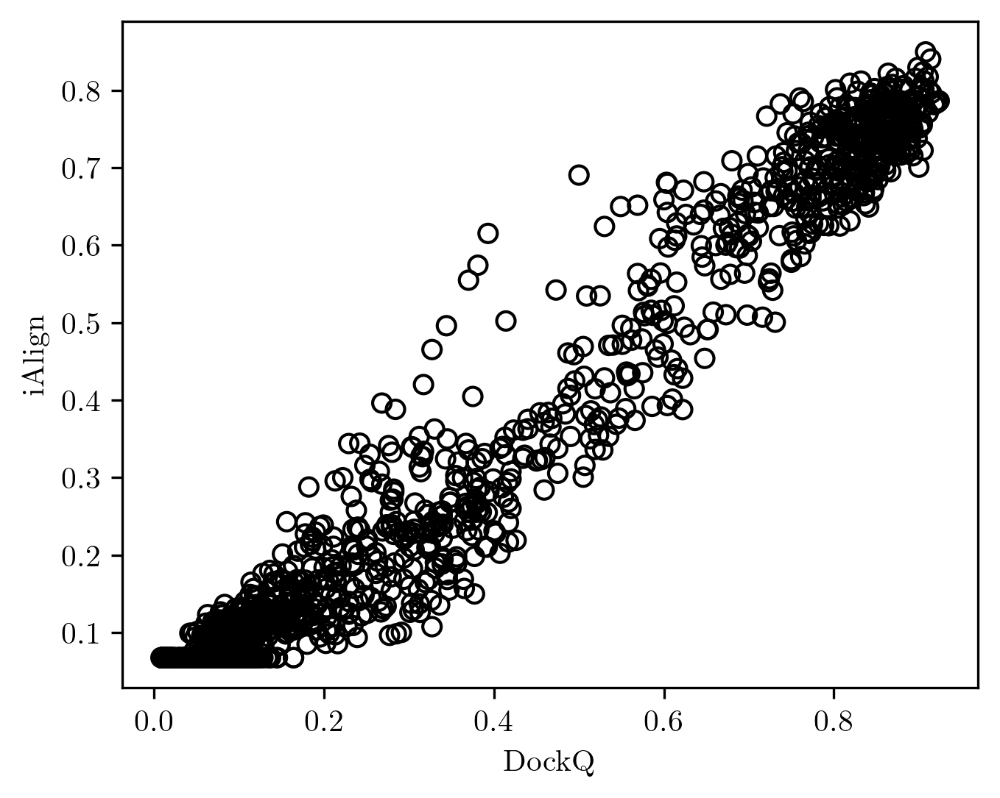

In [432]:
## Creating extra figure for Grace

%matplotlib inline
fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

for pdb in list(ss_score_dict.keys())[:1]:
    ax.scatter(ss_score_dict[pdb]["DockQ"], ss_score_dict[pdb]["IS-Score"], marker = "o", facecolor="None", color = "black")

ax.set_xlabel("DockQ")
ax.set_ylabel("iAlign")

In [433]:
ss_corr_df

,pdb,pearson_ialign_zrank,pearson_ialign_hdock,pearson_ialign_rosetta,pearson_ialign_pydock,pearson_ialign_voromqa,pearson_dockq_zrank,pearson_dockq_hdock,pearson_dockq_rosetta,pearson_dockq_pydock,...,spearman_dockq_rosetta,spearman_dockq_pydock,spearman_dockq_voromqa,zrank_auc,hdock_auc,rosetta_auc,pydock_auc,voromqa_auc,flatness_p3,resolution
0,1acb,-0.717506,-0.572495,-0.818415,-0.742908,0.774556,-0.683783,-0.547174,-0.805366,-0.738255,...,-0.752406,-0.732053,0.712506,0.806568,0.736080,0.869884,0.854494,0.865833,0.975254,2.00
1,1ay7,-0.804331,-0.644121,-0.720965,-0.518193,0.524763,-0.804780,-0.648286,-0.681171,-0.543381,...,-0.609163,-0.584144,0.533496,0.883995,0.824654,0.795933,0.789900,0.728337,0.986755,1.70
2,1c3a,-0.965753,-0.961120,-0.938805,-0.954437,0.768060,-0.964818,-0.964682,-0.925867,-0.960536,...,-0.868213,-0.934019,0.723587,0.989890,0.993320,0.970107,0.989612,0.916598,0.928116,2.50
3,1euv,-0.903749,-0.810849,-0.561124,-0.861152,0.159493,-0.927113,-0.807654,-0.558442,-0.899218,...,-0.503997,-0.893921,0.215138,0.978815,0.909721,0.745435,0.973982,0.596322,0.977500,1.60
4,1f60,-0.934282,-0.954465,-0.874791,-0.824968,0.788822,-0.932479,-0.949422,-0.849036,-0.838318,...,-0.785851,-0.835710,0.758213,0.957604,0.970972,0.897589,0.941392,0.890942,0.968571,1.67
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
78,6zbk,-0.781797,-0.774058,-0.835361,-0.678408,0.624669,-0.790465,-0.792547,-0.830612,-0.681477,...,-0.779926,-0.616940,0.711180,0.905397,0.922205,0.904381,0.847561,0.870021,0.988550,1.49
79,7bxh,-0.804953,-0.820440,-0.814243,-0.720781,0.732772,-0.796301,-0.805913,-0.786721,-0.686369,...,-0.750567,-0.692186,0.711890,0.922827,0.933610,0.881982,0.886090,0.892283,0.977949,2.70
80,7joe,-0.777183,-0.849470,-0.664958,-0.580647,0.694228,-0.762863,-0.841643,-0.658086,-0.606106,...,-0.630186,-0.628131,0.690469,0.855429,0.901846,0.790475,0.798686,0.867768,0.972420,2.60
81,7jxv,-0.619194,-0.622669,-0.477439,-0.504229,0.413785,-0.628586,-0.653727,-0.489602,-0.587059,...,-0.475918,-0.663379,0.491377,0.826855,0.853405,0.732098,0.856209,0.743187,0.994932,2.35


<function matplotlib.pyplot.tight_layout(*, pad=1.08, h_pad=None, w_pad=None, rect=None)>

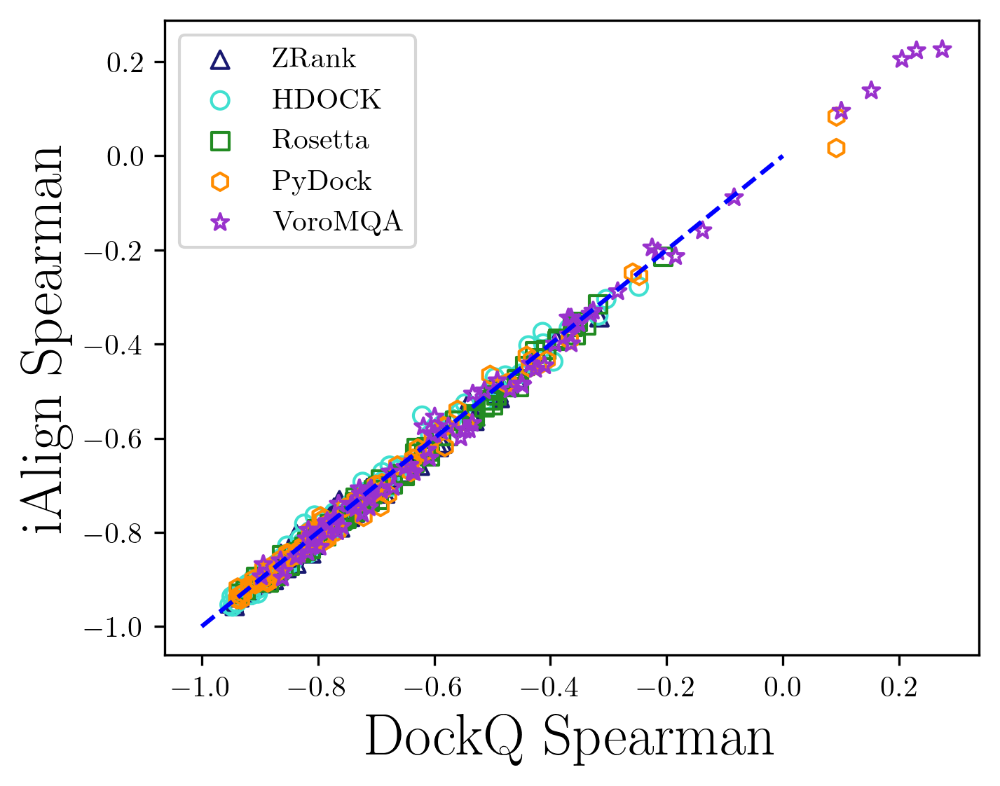

In [436]:
## Creating extra figure for Grace

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid", "indianred", "magenta", "tomato"]

ax.scatter(ss_corr_df["spearman_dockq_zrank"], ss_corr_df["spearman_ialign_zrank"], color = colors[0], marker = "^", facecolor = "None", label = "ZRank")
ax.scatter(ss_corr_df["spearman_dockq_hdock"], ss_corr_df["spearman_ialign_hdock"], color = colors[1], marker = "o", facecolor = "None", label = "HDOCK")
ax.scatter(ss_corr_df["spearman_dockq_rosetta"], ss_corr_df["spearman_ialign_rosetta"], color = colors[2], marker = "s", facecolor = "None", label = "Rosetta")
ax.scatter(ss_corr_df["spearman_dockq_pydock"], ss_corr_df["spearman_ialign_pydock"], color = colors[3], marker = "h", facecolor = "None", label = "PyDock")
ax.scatter(np.array(ss_corr_df["spearman_dockq_voromqa"])*-1, np.array(ss_corr_df["spearman_ialign_voromqa"])*-1, color = colors[4], marker = "*", facecolor = "None", label = "VoroMQA")
# ax.scatter(ss_corr_df["spearman_dockq_dove"], ss_corr_df["dove_auc"], color = colors[5], marker = "p", facecolor = "None", label = "DOVE (Fold -1)")
# ax.scatter(ss_corr_df["spearman_dockq_dove_5"], ss_corr_df["dove_5_auc"], color = colors[6], marker = "P", facecolor = "None", label = "DOVE (Fold 5)")
# ax.scatter(ss_corr_df["spearman_dockq_deeprank"]*-1, ss_corr_df["spearman_dockq_deeprank"], color = colors[7], marker = "d", facecolor = "None", label = "Deeprank-GNN")


## Y = -X

temp_x = [-1, -0.5, 0]
temp_y = [-1, -0.5, 0]
ax.plot(temp_x, temp_y, "b--")

ax.set_xlabel("DockQ Spearman", fontsize = 20)
ax.set_ylabel("iAlign Spearman", fontsize = 20)

plt.legend()
plt.tight_layout

<function matplotlib.pyplot.tight_layout(*, pad=1.08, h_pad=None, w_pad=None, rect=None)>

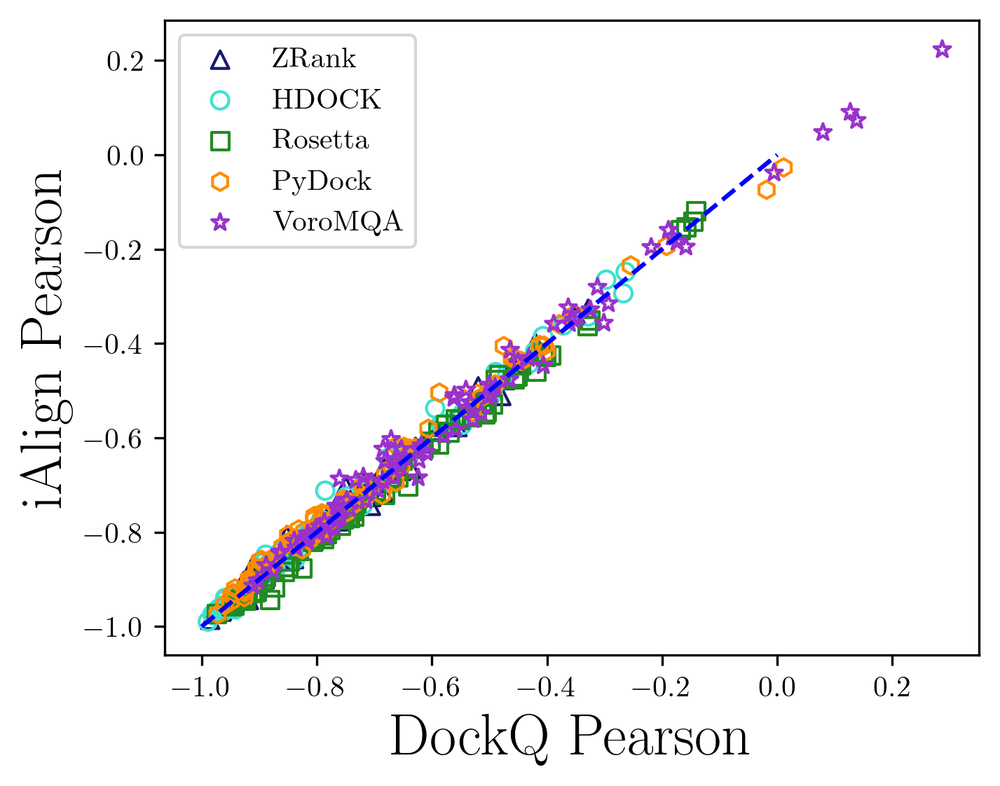

In [437]:
## Creating extra figure for Grace

fig, ax = plt.subplots(figsize = (5,4), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid", "indianred", "magenta", "tomato"]

ax.scatter(ss_corr_df["pearson_dockq_zrank"], ss_corr_df["pearson_ialign_zrank"], color = colors[0], marker = "^", facecolor = "None", label = "ZRank")
ax.scatter(ss_corr_df["pearson_dockq_hdock"], ss_corr_df["pearson_ialign_hdock"], color = colors[1], marker = "o", facecolor = "None", label = "HDOCK")
ax.scatter(ss_corr_df["pearson_dockq_rosetta"], ss_corr_df["pearson_ialign_rosetta"], color = colors[2], marker = "s", facecolor = "None", label = "Rosetta")
ax.scatter(ss_corr_df["pearson_dockq_pydock"], ss_corr_df["pearson_ialign_pydock"], color = colors[3], marker = "h", facecolor = "None", label = "PyDock")
ax.scatter(np.array(ss_corr_df["pearson_dockq_voromqa"])*-1, np.array(ss_corr_df["pearson_ialign_voromqa"])*-1, color = colors[4], marker = "*", facecolor = "None", label = "VoroMQA")
# ax.scatter(ss_corr_df["spearman_dockq_dove"], ss_corr_df["dove_auc"], color = colors[5], marker = "p", facecolor = "None", label = "DOVE (Fold -1)")
# ax.scatter(ss_corr_df["spearman_dockq_dove_5"], ss_corr_df["dove_5_auc"], color = colors[6], marker = "P", facecolor = "None", label = "DOVE (Fold 5)")
# ax.scatter(ss_corr_df["spearman_dockq_deeprank"]*-1, ss_corr_df["spearman_dockq_deeprank"], color = colors[7], marker = "d", facecolor = "None", label = "Deeprank-GNN")


## Y = -X

temp_x = [-1, -0.5, 0]
temp_y = [-1, -0.5, 0]
ax.plot(temp_x, temp_y, "b--")

ax.set_xlabel("DockQ Pearson", fontsize = 20)
ax.set_ylabel("iAlign Pearson", fontsize = 20)

plt.legend()
plt.tight_layout

# Naomi Plot: Average Random Hitrate

In [438]:
hitrate_df = pd.read_csv("/Users/jakesumner/Desktop/PPI Project/average_rand_hitrate.csv")

In [439]:
hitrate_df

,Percent Correct,1%,5%,10%,20%,30%,40%,50%,60%,70%,80%,90%,99%
0,NaN,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,NaN,0.009589,0.049233,0.100849,0.198849,0.300493,0.404192,0.499534,0.598548,0.700027,0.804329,0.899781,0.989973
2,NaN,0.019068,0.096466,0.193178,0.361397,0.507589,0.643205,0.750521,0.840822,0.909397,0.959726,0.989781,0.999973
3,NaN,0.029452,0.141589,0.275699,0.490137,0.659014,0.785918,0.877479,0.935479,0.972466,0.991699,0.999068,1.000000
4,NaN,0.039945,0.184356,0.349808,0.591288,0.763315,0.872521,0.940055,0.973452,0.992082,0.998384,0.999890,1.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...
496,NaN,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
497,NaN,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
498,NaN,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
499,NaN,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


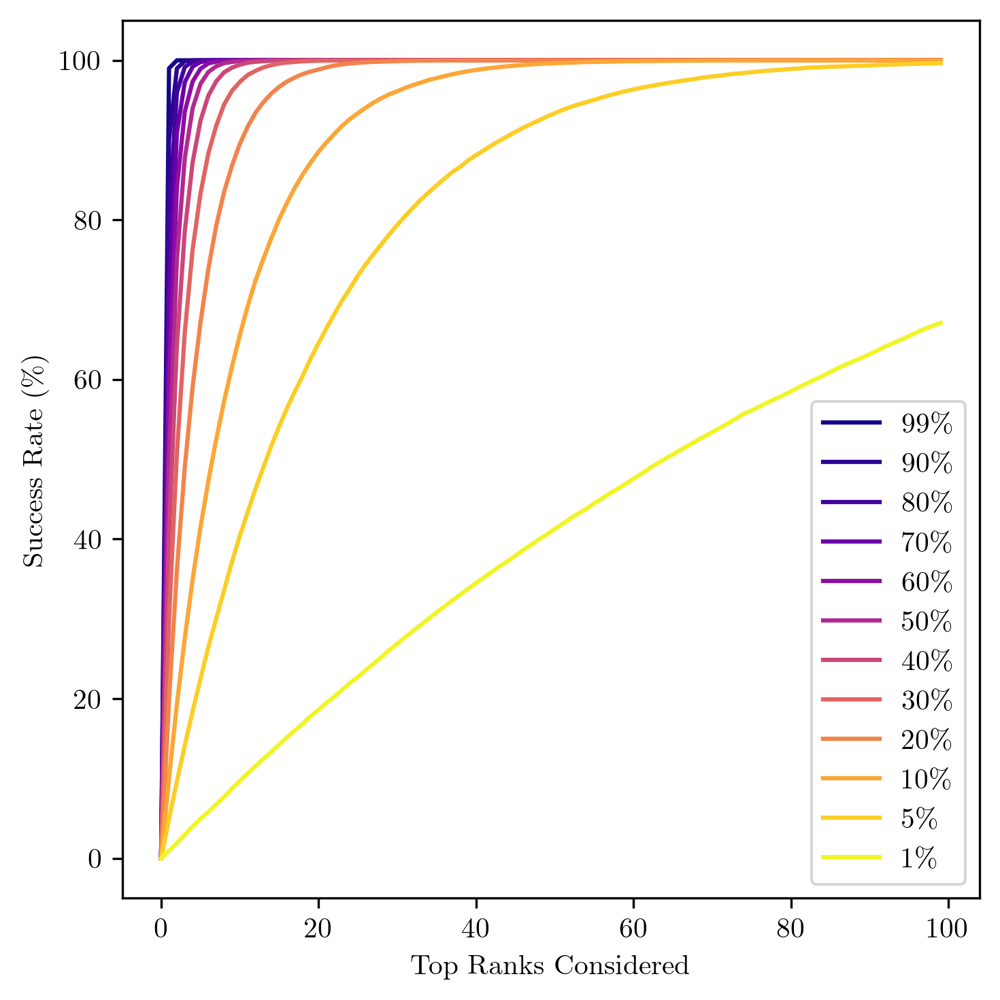

In [453]:
import matplotlib as mpl

fig, ax = plt.subplots(figsize = (5,5), dpi = 300)

colors = mpl.colormaps["plasma"]
colors = colors([0.01, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 0.99])

x_axis = range(501)

stop_at = 100
ax.plot(x_axis[:stop_at], hitrate_df["99%"][:stop_at]*100, color = colors[0], label = "99\%")
ax.plot(x_axis[:stop_at], hitrate_df["90%"][:stop_at]*100, color = colors[1], label = "90\%")
ax.plot(x_axis[:stop_at], hitrate_df["80%"][:stop_at]*100, color = colors[2], label = "80\%")
ax.plot(x_axis[:stop_at], hitrate_df["70%"][:stop_at]*100, color = colors[3], label = "70\%")
ax.plot(x_axis[:stop_at], hitrate_df["60%"][:stop_at]*100, color = colors[4], label = "60\%")
ax.plot(x_axis[:stop_at], hitrate_df["50%"][:stop_at]*100, color = colors[5], label = "50\%")
ax.plot(x_axis[:stop_at], hitrate_df["40%"][:stop_at]*100, color = colors[6], label = "40\%")
ax.plot(x_axis[:stop_at], hitrate_df["30%"][:stop_at]*100, color = colors[7], label = "30\%")
ax.plot(x_axis[:stop_at], hitrate_df["20%"][:stop_at]*100, color = colors[8], label = "20\%")
ax.plot(x_axis[:stop_at], hitrate_df["10%"][:stop_at]*100, color = colors[9], label = "10\%")
ax.plot(x_axis[:stop_at], hitrate_df["5%"][:stop_at]*100, color = colors[10], label = "5\%")
ax.plot(x_axis[:stop_at], hitrate_df["1%"][:stop_at]*100, color = colors[11], label = "1\%")

ax.set_xlabel("Top Ranks Considered")
ax.set_ylabel("Success Rate (\%)")

plt.legend()
fig.tight_layout()

# Introduction Figure: Subsampling our supersampled data

Show that undersampling can be bad as a fraction of the overall dataset (replicating datasets such as Dockground)
Especially show that undersampling affects the 
- Success Rate
- ROC plots
- Spearman correlations.

Use set random seeds in order to replicate results appropriately. 

Create random seeds for the following dataset sizes:
- 99 incorrect vs 1 random correct (Dockground 2.0)
- 100 incorrect and 10 random correct (Dockground 1.0)

Show that you can get wildly different results for different samples of this data

In [635]:
ss_score_dict["4je3"]

,Decoy,Model,Fnat,iRMSD,LRMSD,CAPRI,DockQ,IS-Score,ZRank,HDOCK,Rosetta,PyDock,VoroMQA,VoroMQA_js,ZRank Z-score,HDOCK Z-score,Rosetta Z-score,PyDock Z-score,VoroMQA Z-score,VoroMQA_js Z-score
0,complex.0_0_10,0,0.000,11.330,28.583,Incorrect,0.033,0.0776,-53.0849,-14805.13,-809.450,-8.614,0.473866,-0.00351,1.468547,1.500398,1.246177,2.237991,-0.898851,-1.788518
1,complex.0_0_22,0,0.009,15.596,30.546,Incorrect,0.030,0.0851,-76.7903,-14882.05,-824.998,-21.848,0.451240,0.00169,1.006901,1.292622,0.720386,0.689912,-1.187306,-1.244251
2,complex.0_0_33,0,0.000,19.399,42.890,Incorrect,0.015,0.0776,-94.4625,-14881.18,-815.956,-24.049,0.351778,-0.00299,0.662747,1.294972,1.026162,0.432444,-2.455331,-1.734091
3,complex.0_0_35,0,0.017,17.250,36.983,Incorrect,0.025,0.0894,-60.4892,-14715.51,-809.568,-14.878,0.523876,0.00111,1.324353,1.742480,1.242186,1.505245,-0.261281,-1.304958
4,complex.0_0_3,0,0.000,17.187,45.078,Incorrect,0.014,0.0776,-127.6280,-15337.98,-818.026,-25.296,0.583114,0.01191,0.016871,0.061064,0.956160,0.286574,0.493935,-0.174558
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
127,complex.1584_2,1584,0.000,16.803,47.724,Incorrect,0.013,0.0776,-148.4040,-15246.28,-823.943,-29.172,0.526786,0.01316,-0.387727,0.308764,0.756063,-0.166831,-0.224182,-0.043725
128,complex.15885_5,15885,0.017,11.460,32.858,Incorrect,0.032,0.0910,-62.9382,-15039.24,-824.152,-11.588,0.529374,0.00877,1.276661,0.868020,0.748996,1.890100,-0.191188,-0.503212
129,complex.15896_5,15896,0.009,17.263,37.207,Incorrect,0.022,0.0776,-56.4927,-14923.29,-834.179,-21.142,0.438419,0.00593,1.402182,1.181224,0.409910,0.772498,-1.350759,-0.800465
130,complex.15897_0,15897,0.034,12.501,22.962,Incorrect,0.056,0.1089,-60.4638,-14821.77,-815.192,-14.721,0.403563,-0.00120,1.324848,1.455450,1.051998,1.523610,-1.795132,-1.546738


In [ ]:
random_seed_list = [10,20,30,40,50,60,70,80,90,100]

In [414]:
def get_spearman_corr(combined_df, gt_score = "IS-Score", original_data = False):
    '''
    Gets the spearman correlation for all targets in the
    dictionary df
    '''
    zscore_column = ["ZRank", "HDOCK", "Rosetta", "PyDock", "VoroMQA", "Dove", "Dove_5", "Intertwined", "Deeprank_gnn_esm"]
    if original_data:
        zscore_column = ["ZRank", "HDOCK", "Rosetta", "PyDock", "VoroMQA"]
    all_correlations = []
    for j in range(len(zscore_column)):
        temp_target_corr = []
        for pdb, value in combined_df.items():
            score_temp = combined_df[pdb][zscore_column[j]]
            ialign_temp = combined_df[pdb][gt_score]
            temp_target_corr.append(spearmanr(score_temp, ialign_temp)[0])
        all_correlations.append(temp_target_corr)
    return all_correlations

## Correlation Function

def get_pearson_corr(combined_df, gt_score = "IS-Score", original_data = False):
    '''
    Gets the pearson correlation for all targets in the
    dictionary df
    '''
    zscore_column = ["ZRank", "HDOCK", "Rosetta", "PyDock", "VoroMQA", "Dove", "Dove_5", "Intertwined", "Deeprank_gnn_esm"]
    if original_data:
        zscore_column = ["ZRank", "HDOCK", "Rosetta", "PyDock", "VoroMQA"]
    all_correlations = []
    for j in range(len(zscore_column)):
        temp_target_corr = []
        for pdb, value in combined_df.items():
            score_temp = combined_df[pdb][zscore_column[j]]
            ialign_temp = combined_df[pdb][gt_score]
            temp_target_corr.append(pearsonr(score_temp, ialign_temp)[0])
        all_correlations.append(temp_target_corr)
    return all_correlations      

def create_randomly_subsampled_dataset_frac(score_dict, num_incorrect = 400, frac_correct = 0.01, random_seed = 1):
    '''
    score_dict = supersampled score dictionary I made
    num_incorrect = default incorrect decoys, set to 400 for now
    frac_correct = the fraction of correct models, default 0.01 (fraction based on num incorrect, i.e. default is 4)
    random_seed = random seed for reproducibility
    '''
    
    np.random.seed(random_seed)

    new_score_dict = {}

    num_correct = round(num_incorrect*frac_correct)

    for pdb in list(score_dict.keys()):
        temp_df = score_dict[pdb] 
        temp_inc = temp_df[temp_df["CAPRI"] == "Incorrect"]
        temp_cor = temp_df[temp_df["CAPRI"] != "Incorrect"]

        ## Get all the incorrect decoys

        inc_inds = np.random.randint(0, len(temp_inc), size = (num_incorrect,))

        new_score_dict[pdb] = temp_inc.iloc[inc_inds[:1],:] ## init dataframe with first incorrect decoy

        for i in inc_inds[1:]:
            new_score_dict[pdb] = pd.concat([new_score_dict[pdb], temp_inc.iloc[i:i+1,:]])

        ## Get all the ≥ Acceptable decoys

        cor_inds = np.random.randint(0, len(temp_cor), size = (num_correct,))

        for i in cor_inds:
            new_score_dict[pdb] = pd.concat([new_score_dict[pdb], temp_cor.iloc[i:i+1,:]])
            

            
    ## Correlations

    temp_spearman_corrs = get_spearman_corr(new_score_dict, original_data = True)
    temp_pearson_corrs = get_pearson_corr(new_score_dict, original_data = True)

    temp_spearman_corrs_dq = get_spearman_corr(new_score_dict, gt_score = "DockQ", original_data = True)
    temp_pearson_corrs_dq = get_pearson_corr(new_score_dict, gt_score = "DockQ", original_data = True)

    corr_master_list = [[temp_pearson_corrs, temp_pearson_corrs_dq], [temp_spearman_corrs, temp_spearman_corrs_dq]]


    ## Rewriting the correlation dictionary code so that it is more extensible

    score_fxns = ["ZRank", "HDOCK", "Rosetta", "PyDock", "VoroMQA"]
    gt_scores = ["iAlign", "DockQ"]
    correlations = ["pearson", "spearman"]

    new_corr_dict = {}
    new_corr_dict["pdb"] = list(new_score_dict.keys())

    for i,corr in enumerate(correlations):
        for j,gt_score in enumerate(gt_scores):
            for k,score_fxn in enumerate(score_fxns):
                col_name = f"{corr}_{gt_score.lower()}_{score_fxn.lower()}"
                new_corr_dict[col_name] = []
                for l,pdb in enumerate(list(new_score_dict.keys())):
                    new_corr_dict[col_name].append(corr_master_list[i][j][k][l])

    cutoff = 1000000

    ## AUC for all supersampled data using different scores
    curves, auc_ss_z, temp_keys = get_indiv_ROC_curve(new_score_dict, cutoff = cutoff, col_name = "ZRank")
    curves, auc_ss_h, temp_keys = get_indiv_ROC_curve(new_score_dict, cutoff = cutoff, col_name = "HDOCK")
    curves, auc_ss_r, temp_keys = get_indiv_ROC_curve(new_score_dict, cutoff = cutoff, col_name = "Rosetta")
    curves, auc_ss_p, temp_keys = get_indiv_ROC_curve(new_score_dict, cutoff = cutoff, col_name = "PyDock")
    curves, auc_ss_v, temp_keys = get_indiv_ROC_curve(new_score_dict, cutoff = cutoff, col_name = "VoroMQA")
    # curves, auc_ss_d, temp_keys = get_indiv_ROC_curve(ss_score_dict, cutoff = cutoff, col_name = "Dove")
    # curves, auc_ss_d_5, temp_keys = get_indiv_ROC_curve(ss_score_dict, cutoff = cutoff, col_name = "Dove_5")
    # curves, auc_ss_i, temp_keys = get_indiv_ROC_curve(ss_score_dict, cutoff = cutoff, col_name = "Intertwined")
    # curves, auc_ss_dr, temp_keys = get_indiv_ROC_curve(ss_score_dict, cutoff = cutoff, col_name = "Deeprank_gnn_esm")

    auc_master = [auc_ss_z, auc_ss_h, auc_ss_r, auc_ss_p, auc_ss_v]

    for i in range(len(auc_master)):
        col_name = f"{score_fxns[i].lower()}_auc"
        new_corr_dict[col_name] = []
        for j, pdb in enumerate(list(new_score_dict.keys())):
            if "voromqa" in col_name:
                new_corr_dict[col_name].append(1 - auc_master[i][j])
            else:
                new_corr_dict[col_name].append(auc_master[i][j])


    ## Make df

    new_corr_df = pd.DataFrame(new_corr_dict)
    
    return new_corr_df

## Hit Rate plot code

In [415]:
def make_hit_rate_plot(score_dict, column = "ZRank", top_ranks = 50):
    '''
    Makes a hit rate plot from the score_dict. Hit rate is calculated based
    on the column name provided and the hit rate plot is calculated up to the
    top_ranks specified
    '''
    
    hit_rate_final = np.zeros((len(score_dict),top_ranks)) ## Create the hit rate plot y_axis
    hit_rate_x = range(1,top_ranks + 1)
    
    pdbs = list(score_dict.keys())
    
    for i,pdb in enumerate(pdbs):
        temp_df = score_dict[pdb]
        score_vals = np.array(temp_df[column]) ## gets the score column for each PDB
        capri_vals = np.array(temp_df["CAPRI"]) ## gets all of the CAPRI scores for the minimum
        
        ## Sorting the dataframes
        sort_vals = np.argsort(score_vals)
        score_vals = score_vals[sort_vals]
        capri_vals = capri_vals[sort_vals]
        
        capri_bool = False ## controls whether you found a positive
        for j in range(top_ranks):
            if capri_vals[j] != "Incorrect":
                ## Positive has been found in the top_ranks
                capri_bool = True
            if capri_bool:
                hit_rate_final[i,j] = 1
            else:
                hit_rate_final[i,j] = 0
                
    return np.mean(hit_rate_final, axis = 0), hit_rate_x
            

In [708]:
hit_rate_test, test_x = make_hit_rate_plot(ss_score_dict)

Text(0, 0.5, 'Success Rate')

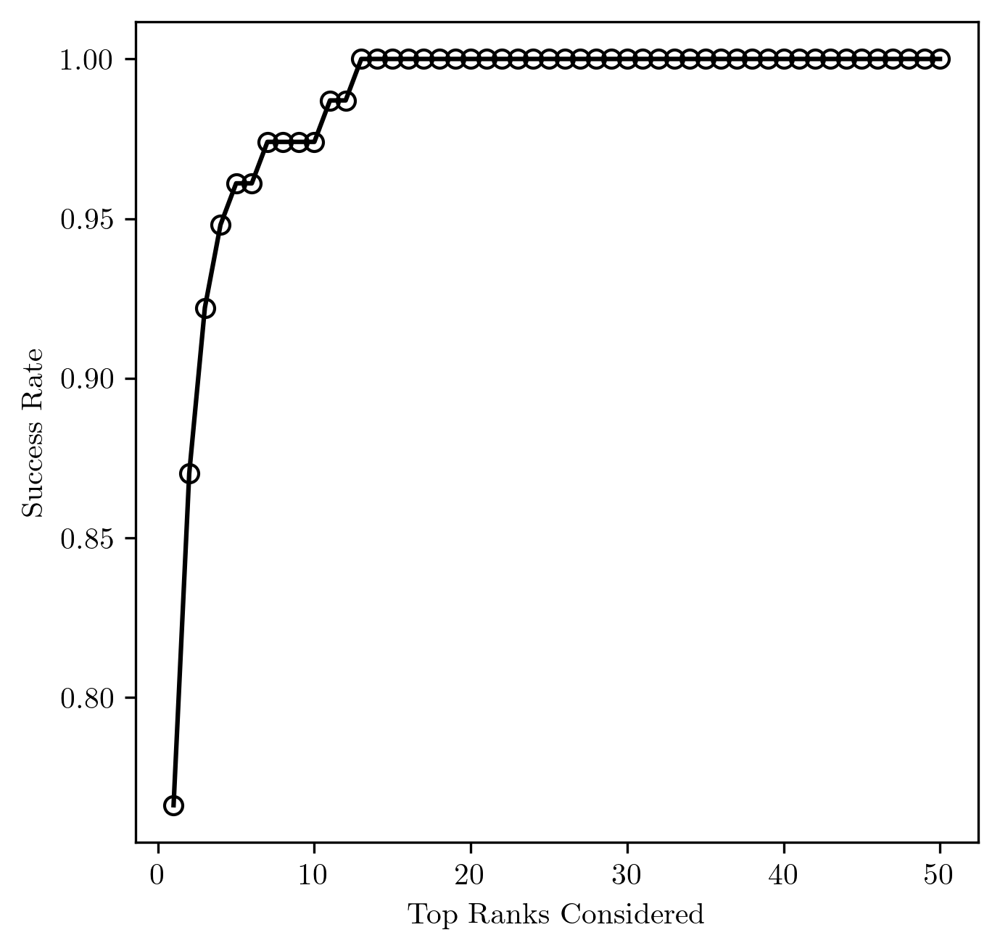

In [709]:
fig, ax = plt.subplots(figsize = (5,5), dpi = 300)

ax.plot(test_x, hit_rate_test, color = "black", marker = "o", markerfacecolor = "None")

ax.set_xlabel("Top Ranks Considered")
ax.set_ylabel("Success Rate")

# Now test it with the following parameters

- 1 - 100%, step of 10%
- 10 trials each
- plot the mean and stdev for the AUC and Spearman for each one

In [654]:
frac_list = np.linspace(0.05, 1, 20)
corr_means = []
corr_stds = []
auc_means = []
auc_stds = []

num_incorrect = 400
random_seed_list = [10,20,30,40,50,60,70,80,90,100] ## 10 seeds = 10 runs

count = 0
for frac in frac_list:
    temp_corr = []
    temp_aucs = []
    for seed in random_seed_list:
        temp_df = create_randomly_subsampled_dataset_frac(ss_score_dict, num_incorrect = num_incorrect,
                                                          frac_correct = frac, random_seed = seed)
        temp_corr.append(np.mean(temp_df["spearman_dockq_zrank"]))
        temp_aucs.append(np.mean(temp_df["zrank_auc"]))
        print(f"Done with {count}")
        count += 1
    
    ## Average together the runs to get an overall average and stdev
    
    corr_means.append(np.mean(temp_corr))
    corr_stds.append(np.std(temp_corr))
    auc_means.append(np.mean(temp_aucs))
    auc_stds.append(np.std(temp_aucs))

1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg


4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz


1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg


4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd


1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg


4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh


1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg


4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet


1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg


4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet


1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg


3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo


1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg


3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav


1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg


3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j


1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg


3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu


6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy


1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m


7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9


2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud


6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy


2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7


5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm


3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv


5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul


2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a


5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6


2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh


4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz


2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh


4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw


2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk


4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh


2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod


4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh


2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3


4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq


2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3


4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet


2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud


3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o


2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2


3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o


hi


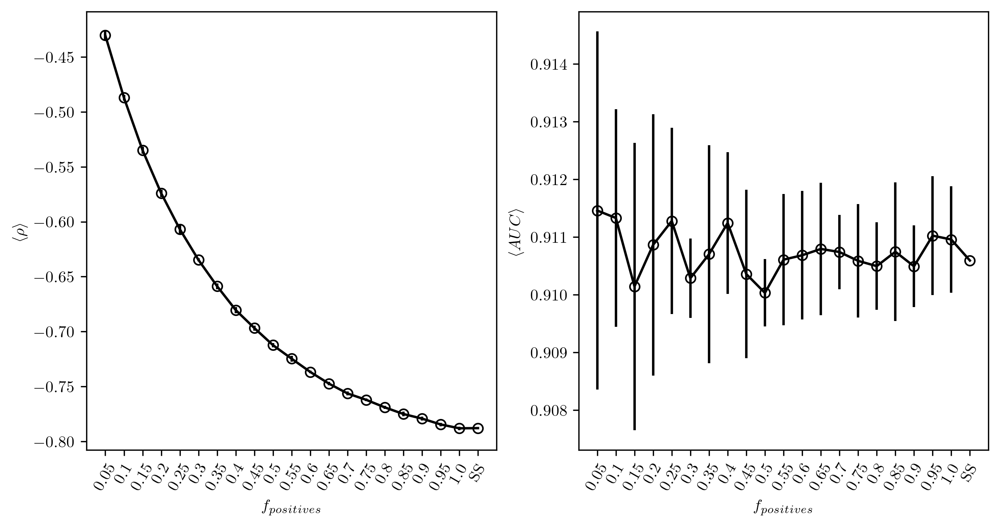

In [672]:
## Plot the average spearman and average AUC data

fig,ax = plt.subplots(1,2, figsize = (10,5), dpi = 300)

frac_list_plot = list(frac_list) + [1.05]
corr_means_plot = corr_means + [np.mean(ss_corr_df["spearman_dockq_zrank"])]
corr_stds_plot = corr_stds + [0]

auc_means_plot = auc_means + [np.mean(ss_corr_df["zrank_auc"])]
auc_stds_plot = auc_stds + [0]

ax[0].errorbar(frac_list_plot, corr_means_plot, yerr = corr_stds_plot, color = "black", marker = "o", markerfacecolor = "None")
ax[1].errorbar(frac_list_plot, auc_means_plot, yerr = auc_stds_plot, color = "black", marker = "o", markerfacecolor = "None")

ax[0].set_xlabel("$f_{positives}$")
ax[1].set_xlabel("$f_{positives}$")

ax[0].set_ylabel(r"$\langle \rho \rangle$")
ax[1].set_ylabel(r"$\langle AUC \rangle$")

label_ticks = [0.05, 0.1, 0.15, 0.2, 0.25, 0.3, 0.35, 0.4, 0.45, 0.5, 0.55, 0.6, 0.65, 0.7, 0.75, 0.8, 0.85, 0.9, 0.95, 1.0] + ["SS"]
ax[0].set_xticks(frac_list_plot, label_ticks, rotation = 60)
ax[1].set_xticks(frac_list_plot, label_ticks, rotation = 60)

print("hi")

In [416]:
### Test again with constant N = 400 decoys

def create_randomly_subsampled_dataset_frac(score_dict, num_total = 400, frac_correct = 0.01, random_seed = 1):
    '''
    score_dict = supersampled score dictionary I made
    num_incorrect = default incorrect decoys, set to 400 for now
    frac_correct = the fraction of correct models, default 0.01 (fraction based on num incorrect, i.e. default is 4)
    random_seed = random seed for reproducibility
    '''
    
    np.random.seed(random_seed)

    new_score_dict = {}
    
    num_correct = round(num_total*frac_correct)
    num_incorrect = num_total - num_correct

    for pdb in list(score_dict.keys()):
        temp_df = score_dict[pdb] 
        temp_inc = temp_df[temp_df["CAPRI"] == "Incorrect"]
        temp_cor = temp_df[temp_df["CAPRI"] != "Incorrect"]

        ## Get all the incorrect decoys

        inc_inds = np.random.randint(0, len(temp_inc), size = (num_incorrect,))

        new_score_dict[pdb] = temp_inc.iloc[inc_inds[:1],:] ## init dataframe with first incorrect decoy

        for i in inc_inds[1:]:
            new_score_dict[pdb] = pd.concat([new_score_dict[pdb], temp_inc.iloc[i:i+1,:]])

        ## Get all the ≥ Acceptable decoys

        cor_inds = np.random.randint(0, len(temp_cor), size = (num_correct,))

        for i in cor_inds:
            new_score_dict[pdb] = pd.concat([new_score_dict[pdb], temp_cor.iloc[i:i+1,:]])
            
    ## Make sure the fraction code is working correctly
#     for ele in list(new_score_dict.keys()):
#         print(len(new_score_dict[ele]), len(new_score_dict[ele][new_score_dict[ele]['CAPRI'] != "Incorrect"]), len(new_score_dict[ele][new_score_dict[ele]['CAPRI'] == "Incorrect"]))
            
    ## Correlations

    temp_spearman_corrs = get_spearman_corr(new_score_dict, original_data = True)
    temp_pearson_corrs = get_pearson_corr(new_score_dict, original_data = True)

    temp_spearman_corrs_dq = get_spearman_corr(new_score_dict, gt_score = "DockQ", original_data = True)
    temp_pearson_corrs_dq = get_pearson_corr(new_score_dict, gt_score = "DockQ", original_data = True)

    corr_master_list = [[temp_pearson_corrs, temp_pearson_corrs_dq], [temp_spearman_corrs, temp_spearman_corrs_dq]]


    ## Rewriting the correlation dictionary code so that it is more extensible

    score_fxns = ["ZRank", "HDOCK", "Rosetta", "PyDock", "VoroMQA"]
    gt_scores = ["iAlign", "DockQ"]
    correlations = ["pearson", "spearman"]

    new_corr_dict = {}
    new_corr_dict["pdb"] = list(new_score_dict.keys())

    for i,corr in enumerate(correlations):
        for j,gt_score in enumerate(gt_scores):
            for k,score_fxn in enumerate(score_fxns):
                col_name = f"{corr}_{gt_score.lower()}_{score_fxn.lower()}"
                new_corr_dict[col_name] = []
                for l,pdb in enumerate(list(new_score_dict.keys())):
                    new_corr_dict[col_name].append(corr_master_list[i][j][k][l])

    cutoff = 1000000

    ## AUC for all supersampled data using different scores
    curves, auc_ss_z, temp_keys = get_indiv_ROC_curve(new_score_dict, cutoff = cutoff, col_name = "ZRank")
    curves, auc_ss_h, temp_keys = get_indiv_ROC_curve(new_score_dict, cutoff = cutoff, col_name = "HDOCK")
    curves, auc_ss_r, temp_keys = get_indiv_ROC_curve(new_score_dict, cutoff = cutoff, col_name = "Rosetta")
    curves, auc_ss_p, temp_keys = get_indiv_ROC_curve(new_score_dict, cutoff = cutoff, col_name = "PyDock")
    curves, auc_ss_v, temp_keys = get_indiv_ROC_curve(new_score_dict, cutoff = cutoff, col_name = "VoroMQA")

    auc_master = [auc_ss_z, auc_ss_h, auc_ss_r, auc_ss_p, auc_ss_v]

    for i in range(len(auc_master)):
        col_name = f"{score_fxns[i].lower()}_auc"
        new_corr_dict[col_name] = []
        for j, pdb in enumerate(list(new_score_dict.keys())):
            if "voromqa" in col_name:
                new_corr_dict[col_name].append(1 - auc_master[i][j])
            else:
                new_corr_dict[col_name].append(auc_master[i][j])

    ## Get hit rate plot data
    score_column = "ZRank"
    top_ranks = 50
    temp_hit_rate, temp_x = make_hit_rate_plot(new_score_dict, column = score_column, top_ranks = top_ranks)
    
    
    ## Make df

    new_corr_df = pd.DataFrame(new_corr_dict)
    
    return new_corr_df, temp_hit_rate

In [469]:
## Function to allow this all to work

def run_subsampling_suite(score_dict, total_n, random_seed_list):
    '''
    Run the subsampling suite where total_n is
    the total number of decoys for each measurement.
    Fractional datasets are subsampled from the score_dict
    and individual runs are done 10 times for each fraction in 
    order to establish any variance that may be present
    '''
    frac_list = np.linspace(0, 0.5, 21)[1:]
    corr_means = []
    corr_stds = []
    auc_means = []
    auc_stds = []
    avg_hit_rate = []

    count = 0
    for i,frac in enumerate(frac_list):
        temp_corr = []
        temp_aucs = []
        temp_agg_hr = []
        for j in range(10):
            temp_df, temp_hit_rate = create_randomly_subsampled_dataset_frac(score_dict, num_total = total_n,
                                                              frac_correct = frac, random_seed = random_seed_list[i][j])
            temp_corr.append(np.mean(temp_df["spearman_dockq_zrank"]))
            temp_aucs.append(np.mean(temp_df["zrank_auc"]))
            temp_agg_hr.append(temp_hit_rate)
            print(f"Done with {count}")
            count += 1

        ## Average together the runs to get an overall average and stdev

        corr_means.append(np.mean(temp_corr))
        corr_stds.append(np.std(temp_corr))
        auc_means.append(np.mean(temp_aucs))
        auc_stds.append(np.std(temp_aucs))
        avg_hit_rate.append(np.mean(temp_agg_hr, axis = 0))
        
    return corr_means, corr_stds, auc_means, auc_stds, avg_hit_rate

In [483]:
## N = 400 total!

random_seed_list = [list(range(n, n+10)) for n in range(10, 210, 10)]
total_n = 400
subsampling_400 = run_subsampling_suite(ss_score_dict, total_n, random_seed_list)

Done with 0
Done with 1
Done with 2
Done with 3
Done with 4
Done with 5
Done with 6
Done with 7
Done with 8
Done with 9
Done with 10
Done with 11
Done with 12
Done with 13
Done with 14
Done with 15
Done with 16
Done with 17
Done with 18
Done with 19
Done with 20
Done with 21
Done with 22
Done with 23
Done with 24
Done with 25
Done with 26
Done with 27
Done with 28
Done with 29
Done with 30
Done with 31
Done with 32
Done with 33
Done with 34
Done with 35
Done with 36
Done with 37
Done with 38
Done with 39
Done with 40
Done with 41
Done with 42
Done with 43
Done with 44
Done with 45
Done with 46
Done with 47
Done with 48
Done with 49
Done with 50
Done with 51
Done with 52
Done with 53
Done with 54
Done with 55
Done with 56
Done with 57
Done with 58
Done with 59
Done with 60
Done with 61
Done with 62
Done with 63
Done with 64
Done with 65
Done with 66
Done with 67
Done with 68
Done with 69
Done with 70
Done with 71
Done with 72
Done with 73
Done with 74
Done with 75
Done with 76
Done with

In [485]:
## N = 200 

random_seed_list = [list(range(n, n+100, 10)) for n in range(100, 2100, 100)]
total_n = 200
subsampling_200 = run_subsampling_suite(ss_score_dict, total_n, random_seed_list)

Done with 0
Done with 1
Done with 2
Done with 3
Done with 4
Done with 5
Done with 6
Done with 7
Done with 8
Done with 9
Done with 10
Done with 11
Done with 12
Done with 13
Done with 14
Done with 15
Done with 16
Done with 17
Done with 18
Done with 19
Done with 20
Done with 21
Done with 22
Done with 23
Done with 24
Done with 25
Done with 26
Done with 27
Done with 28
Done with 29
Done with 30
Done with 31
Done with 32
Done with 33
Done with 34
Done with 35
Done with 36
Done with 37
Done with 38
Done with 39
Done with 40
Done with 41
Done with 42
Done with 43
Done with 44
Done with 45
Done with 46
Done with 47
Done with 48
Done with 49
Done with 50
Done with 51
Done with 52
Done with 53
Done with 54
Done with 55
Done with 56
Done with 57
Done with 58
Done with 59
Done with 60
Done with 61
Done with 62
Done with 63
Done with 64
Done with 65
Done with 66
Done with 67
Done with 68
Done with 69
Done with 70
Done with 71
Done with 72
Done with 73
Done with 74
Done with 75
Done with 76
Done with

In [486]:
## N = 100

random_seed_list = [list(range(n, n+1000, 100)) for n in range(1000, 21000, 1000)]
total_n = 100
subsampling_100 = run_subsampling_suite(ss_score_dict, total_n, random_seed_list)

Done with 0
Done with 1
Done with 2
Done with 3
Done with 4
Done with 5
Done with 6
Done with 7
Done with 8
Done with 9
Done with 10
Done with 11
Done with 12
Done with 13
Done with 14
Done with 15
Done with 16
Done with 17
Done with 18
Done with 19
Done with 20
Done with 21
Done with 22
Done with 23
Done with 24
Done with 25
Done with 26
Done with 27
Done with 28
Done with 29
Done with 30
Done with 31
Done with 32
Done with 33
Done with 34
Done with 35
Done with 36
Done with 37
Done with 38
Done with 39
Done with 40
Done with 41
Done with 42
Done with 43
Done with 44
Done with 45
Done with 46
Done with 47
Done with 48
Done with 49
Done with 50
Done with 51
Done with 52
Done with 53
Done with 54
Done with 55
Done with 56
Done with 57
Done with 58
Done with 59
Done with 60
Done with 61
Done with 62
Done with 63
Done with 64
Done with 65
Done with 66
Done with 67
Done with 68
Done with 69
Done with 70
Done with 71
Done with 72
Done with 73
Done with 74
Done with 75
Done with 76
Done with

In [487]:
## N = 50

random_seed_list = [list(range(n, n+10000, 1000)) for n in range(10000, 210000, 10000)]
total_n = 50
subsampling_50 = run_subsampling_suite(ss_score_dict, total_n, random_seed_list)

Done with 0
Done with 1
Done with 2
Done with 3
Done with 4
Done with 5
Done with 6
Done with 7
Done with 8
Done with 9
Done with 10
Done with 11
Done with 12
Done with 13
Done with 14
Done with 15
Done with 16
Done with 17
Done with 18
Done with 19
Done with 20
Done with 21
Done with 22
Done with 23
Done with 24
Done with 25
Done with 26
Done with 27
Done with 28
Done with 29
Done with 30
Done with 31
Done with 32
Done with 33
Done with 34
Done with 35
Done with 36
Done with 37
Done with 38
Done with 39
Done with 40
Done with 41
Done with 42
Done with 43
Done with 44
Done with 45
Done with 46
Done with 47
Done with 48
Done with 49
Done with 50
Done with 51
Done with 52
Done with 53
Done with 54
Done with 55
Done with 56
Done with 57
Done with 58
Done with 59
Done with 60
Done with 61
Done with 62
Done with 63
Done with 64
Done with 65
Done with 66
Done with 67
Done with 68
Done with 69
Done with 70
Done with 71
Done with 72
Done with 73
Done with 74
Done with 75
Done with 76
Done with

In [489]:
## Saving the data

os.chdir("/Users/jakesumner/Desktop/PPI Project/")

# with open("subsampling_400.pickle", "wb") as f:
#     pickle.dump(subsampling_400, f)
    
# with open("subsampling_200.pickle", "wb") as f:
#     pickle.dump(subsampling_200, f)
    
# with open("subsampling_100.pickle", "wb") as f:
#     pickle.dump(subsampling_100, f)
    
# with open("subsampling_50.pickle", "wb") as f:
#     pickle.dump(subsampling_50, f)


In [506]:
## Load in the pickle data

os.chdir("/Users/jakesumner/Desktop/PPI Project/")

with open("subsampling_400.pickle", "rb") as f:
    subsampling_400 = pickle.load(f)
    
with open("subsampling_200.pickle", "rb") as f:
    subsampling_200 = pickle.load(f)
    
with open("subsampling_100.pickle", "rb") as f:
    subsampling_100 = pickle.load(f)
    
with open("subsampling_50.pickle", "rb") as f:
    subsampling_50 = pickle.load(f)


In [813]:
ss_corr_df[ss_corr_df["pdb"] == "1xg2"]["spearman_dockq_zrank"]

23   -0.743289
Name: spearman_dockq_zrank, dtype: float64

In [814]:
relaxed_corr_df[relaxed_corr_df["pdb"] == "1xg2"]["spearman_dockq_zrank"]

21   -0.115535
Name: spearman_dockq_zrank, dtype: float64

hi


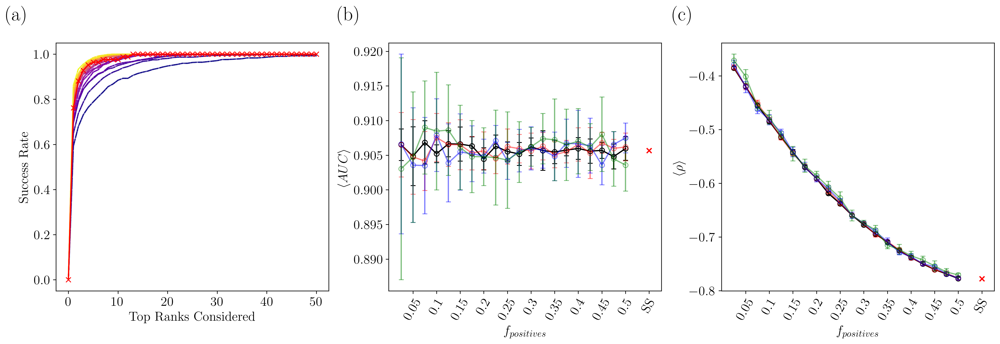

In [507]:
## Plot the average spearman and average AUC data

import matplotlib as mpl

fig,ax = plt.subplots(1,3, figsize = (17,6), dpi = 300)

font_size = 16

frac_list = np.linspace(0, 0.5, 21)[1:]
frac_list_plot = list(frac_list)


## Plot Hit Rate

colors = mpl.colormaps["plasma"]
colors = colors(np.linspace(0,1, len(frac_list)))

labels = [0.025, 0.05, 0.075, 0.1, 0.125, 0.15, 0.175, 0.2, 0.225, 0.25, 0.275, 0.3, 0.325, 0.35, 0.375, 0.4, 0.425, 0.45, 0.475, 0.5]
hr_x_axis = range(0,51)
for i, hr_data in enumerate(subsampling_400[4]):
    ax[0].plot(hr_x_axis, [0] + list(hr_data), color = colors[i], alpha = 0.6, label = str(labels[i]))
    
for i, hr_data in enumerate(subsampling_400[4]):
    ax[0].plot(hr_x_axis, [0] + list(hr_data), color = colors[i], alpha = 0.6, label = str(labels[i]), linestyle = "--")
    
for i, hr_data in enumerate(subsampling_400[4]):
    ax[0].plot(hr_x_axis, [0] + list(hr_data), color = colors[i], alpha = 0.6, label = str(labels[i]), linestyle = "-.")
    
for i, hr_data in enumerate(subsampling_400[4]):
    ax[0].plot(hr_x_axis, [0] + list(hr_data), color = colors[i], alpha = 0.6, label = str(labels[i]), linestyle = (0,(1,1)))
    
hit_rate_ss, test_ss = make_hit_rate_plot(ss_score_dict)
ax[0].plot(hr_x_axis, [0] + list(hit_rate_ss), color = "red", marker = "x")
    
## Plot the Average AUC

ax[1].errorbar(frac_list_plot, subsampling_400[2], yerr = subsampling_400[3], color = "black", marker = "o", 
               markerfacecolor = "None", solid_capstyle = "projecting", capsize = 3)
ax[1].scatter([0.55], [np.mean(ss_corr_df["zrank_auc"])], color = "red", marker = "x")

ax[1].errorbar(frac_list_plot, subsampling_200[2], yerr = subsampling_200[3], color = "red", marker = "o", 
               markerfacecolor = "None", solid_capstyle = "projecting", capsize = 3, alpha = 0.5)

ax[1].errorbar(frac_list_plot, subsampling_100[2], yerr = subsampling_100[3], color = "blue", marker = "o", 
               markerfacecolor = "None", solid_capstyle = "projecting", capsize = 3, alpha = 0.5)

ax[1].errorbar(frac_list_plot, subsampling_50[2], yerr = subsampling_50[3], color = "green", marker = "o", 
               markerfacecolor = "None", solid_capstyle = "projecting", capsize = 3, alpha = 0.5)


## Plot the average Spearman

ax[2].errorbar(frac_list_plot, subsampling_400[0], yerr = subsampling_400[1], color = "black", marker = "o", 
               markerfacecolor = "None", solid_capstyle = "projecting", capsize = 3)
ax[2].scatter([0.55], [np.mean(ss_corr_df["spearman_dockq_zrank"])], color = "red", marker = "x")

ax[2].errorbar(frac_list_plot, subsampling_200[0], yerr = subsampling_200[1], color = "red", marker = "o", 
               markerfacecolor = "None", alpha = 0.5, solid_capstyle = "projecting", capsize = 3)

ax[2].errorbar(frac_list_plot, subsampling_100[0], yerr = subsampling_100[1], color = "blue", marker = "o", 
               markerfacecolor = "None", alpha = 0.5, solid_capstyle = "projecting", capsize = 3)

ax[2].errorbar(frac_list_plot, subsampling_50[0], yerr = subsampling_50[1], color = "green", marker = "o", 
               markerfacecolor = "None", alpha = 0.5, solid_capstyle = "projecting", capsize = 3)


## Labeling

ax[0].set_xlabel("Top Ranks Considered", fontsize = font_size)
ax[1].set_xlabel("$f_{positives}$", fontsize = font_size)
ax[2].set_xlabel("$f_{positives}$", fontsize = font_size)


ax[0].set_ylabel("Success Rate", fontsize = font_size)
ax[1].set_ylabel(r"$\langle AUC \rangle$", fontsize = font_size)
ax[2].set_ylabel(r"$\langle \rho \rangle$", fontsize = font_size)


# label_ticks = [0.025, 0.05, 0.075, 0.1, 0.125, 0.15, 0.175, 0.2, 0.225, 0.25, 0.275, 0.3, 0.325, 0.35, 0.375, 0.4, 0.425, 0.45, 0.475, 0.5] + ["SS"]
label_ticks = [0.05, 0.1, 0.15, 0.2, 0.25, 0.3, 0.35, 0.4, 0.45, 0.5] + ["SS"]
x_ref = [0.05, 0.1, 0.15, 0.2, 0.25, 0.3, 0.35, 0.4, 0.45, 0.5, 0.55]

ax[1].set_xticks(x_ref, label_ticks, rotation = 60)
ax[2].set_xticks(x_ref, label_ticks, rotation = 60)

ax[0].text(-0.1, 1.15, "(a)", transform=ax[0].transAxes,fontsize=font_size*1.5, fontweight='bold', va='top', ha='right')
ax[1].text(-0.1, 1.15, "(b)", transform=ax[1].transAxes,fontsize=font_size*1.5, fontweight='bold', va='top', ha='right')
ax[2].text(-0.1, 1.15, "(c)", transform=ax[2].transAxes,fontsize=font_size*1.5, fontweight='bold', va='top', ha='right')

ax[0].tick_params(axis='both', which='major', labelsize=font_size)
ax[1].tick_params(axis='both', which='major', labelsize=font_size)
ax[2].tick_params(axis='both', which='major', labelsize=font_size)

# ax[0].legend()

print("hi")
plt.tight_layout()

## Test code to practice the plots

In [568]:
## Create randomly subsampled data to replicate Dockground 1.0

np.random.seed(42069)

dg1_score_dict = {}

ITER_PER_INCORRECT = 100
ITER_PER_CORRECT = 10

for pdb in list(ss_score_dict.keys()):
    temp_df = ss_score_dict[pdb] 
    temp_inc = temp_df[temp_df["CAPRI"] == "Incorrect"]
    temp_cor = temp_df[temp_df["CAPRI"] != "Incorrect"]
    
    ## Get all the incorrect decoys
    
    inc_inds = np.random.randint(0, len(temp_inc), size = (ITER_PER_INCORRECT,))
    
    dg1_score_dict[pdb] = temp_inc.iloc[inc_inds[:1],:] ## init dataframe with first incorrect decoy
    
    for i in inc_inds[1:]:
        dg1_score_dict[pdb] = pd.concat([dg1_score_dict[pdb], temp_inc.iloc[i:i+1,:]])
        
    ## Get all the ≥ Acceptable decoys
    
    cor_inds = np.random.randint(0, len(temp_cor), size = (ITER_PER_CORRECT,))
    
    for i in cor_inds:
        dg1_score_dict[pdb] = pd.concat([dg1_score_dict[pdb], temp_cor.iloc[i:i+1,:]])
    

In [619]:
## Correlations

temp_spearman_corrs = get_spearman_corr(dg1_score_dict, original_data = True)
temp_pearson_corrs = get_pearson_corr(dg1_score_dict, original_data = True)

temp_spearman_corrs_dq = get_spearman_corr(dg1_score_dict, gt_score = "DockQ", original_data = True)
temp_pearson_corrs_dq = get_pearson_corr(dg1_score_dict, gt_score = "DockQ", original_data = True)

corr_master_list = [[temp_pearson_corrs, temp_pearson_corrs_dq], [temp_spearman_corrs, temp_spearman_corrs_dq]]


## Rewriting the correlation dictionary code so that it is more extensible

score_fxns = ["ZRank", "HDOCK", "Rosetta", "PyDock", "VoroMQA"]
gt_scores = ["iAlign", "DockQ"]
correlations = ["pearson", "spearman"]

dg1_corr_dict = {}
dg1_corr_dict["pdb"] = list(dg1_score_dict.keys())

for i,corr in enumerate(correlations):
    for j,gt_score in enumerate(gt_scores):
        for k,score_fxn in enumerate(score_fxns):
            col_name = f"{corr}_{gt_score.lower()}_{score_fxn.lower()}"
            dg1_corr_dict[col_name] = []
            for l,pdb in enumerate(list(dg1_score_dict.keys())):
                dg1_corr_dict[col_name].append(corr_master_list[i][j][k][l])

cutoff = 1000000

## AUC for all supersampled data using different scores
curves, auc_ss_z, temp_keys = get_indiv_ROC_curve(dg1_score_dict, cutoff = cutoff, col_name = "ZRank")
curves, auc_ss_h, temp_keys = get_indiv_ROC_curve(dg1_score_dict, cutoff = cutoff, col_name = "HDOCK")
curves, auc_ss_r, temp_keys = get_indiv_ROC_curve(dg1_score_dict, cutoff = cutoff, col_name = "Rosetta")
curves, auc_ss_p, temp_keys = get_indiv_ROC_curve(dg1_score_dict, cutoff = cutoff, col_name = "PyDock")
curves, auc_ss_v, temp_keys = get_indiv_ROC_curve(dg1_score_dict, cutoff = cutoff, col_name = "VoroMQA")
# curves, auc_ss_d, temp_keys = get_indiv_ROC_curve(ss_score_dict, cutoff = cutoff, col_name = "Dove")
# curves, auc_ss_d_5, temp_keys = get_indiv_ROC_curve(ss_score_dict, cutoff = cutoff, col_name = "Dove_5")
# curves, auc_ss_i, temp_keys = get_indiv_ROC_curve(ss_score_dict, cutoff = cutoff, col_name = "Intertwined")
# curves, auc_ss_dr, temp_keys = get_indiv_ROC_curve(ss_score_dict, cutoff = cutoff, col_name = "Deeprank_gnn_esm")

auc_master = [auc_ss_z, auc_ss_h, auc_ss_r, auc_ss_p, auc_ss_v]

for i in range(len(auc_master)):
    col_name = f"{score_fxns[i].lower()}_auc"
    dg1_corr_dict[col_name] = []
    for j, pdb in enumerate(list(dg1_score_dict.keys())):
        if "voromqa" in col_name:
            dg1_corr_dict[col_name].append(1 - auc_master[i][j])
        else:
            dg1_corr_dict[col_name].append(auc_master[i][j])


## Make df

dg1_corr_df = pd.DataFrame(dg1_corr_dict)

1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg


In [624]:
dg1_corr_df[dg1_corr_df["pdb"] == "4dhi"]


,pdb,pearson_ialign_zrank,pearson_ialign_hdock,pearson_ialign_rosetta,pearson_ialign_pydock,pearson_ialign_voromqa,pearson_dockq_zrank,pearson_dockq_hdock,pearson_dockq_rosetta,pearson_dockq_pydock,...,spearman_dockq_zrank,spearman_dockq_hdock,spearman_dockq_rosetta,spearman_dockq_pydock,spearman_dockq_voromqa,zrank_auc,hdock_auc,rosetta_auc,pydock_auc,voromqa_auc
51,4dhi,-0.480283,-0.303713,-0.341487,-0.462493,0.349019,-0.445428,-0.279062,-0.306968,-0.44819,...,-0.122165,-0.081023,-0.205596,-0.379184,0.399774,0.81,0.816,0.792,0.853,0.776


In [628]:
ss_corr_df.columns

Index(['pdb', 'pearson_ialign_zrank', 'pearson_ialign_hdock',
       'pearson_ialign_rosetta', 'pearson_ialign_pydock',
       'pearson_ialign_voromqa', 'pearson_ialign_voromqa_js',
       'pearson_dockq_zrank', 'pearson_dockq_hdock', 'pearson_dockq_rosetta',
       'pearson_dockq_pydock', 'pearson_dockq_voromqa',
       'pearson_dockq_voromqa_js', 'spearman_ialign_zrank',
       'spearman_ialign_hdock', 'spearman_ialign_rosetta',
       'spearman_ialign_pydock', 'spearman_ialign_voromqa',
       'spearman_ialign_voromqa_js', 'spearman_dockq_zrank',
       'spearman_dockq_hdock', 'spearman_dockq_rosetta',
       'spearman_dockq_pydock', 'spearman_dockq_voromqa',
       'spearman_dockq_voromqa_js', 'zrank_auc', 'hdock_auc', 'rosetta_auc',
       'pydock_auc', 'voromqa_auc', 'voromqa_js_auc', 'flatness_p3',
       'resolution'],
      dtype='object')

In [632]:
temp_df = ss_corr_df.loc[:, ["pdb", "spearman_dockq_voromqa_js"]]

In [634]:
os.chdir("/Users/jakesumner/Desktop/")
temp_df.to_csv("spearman_dockq_voromqa_js.csv")

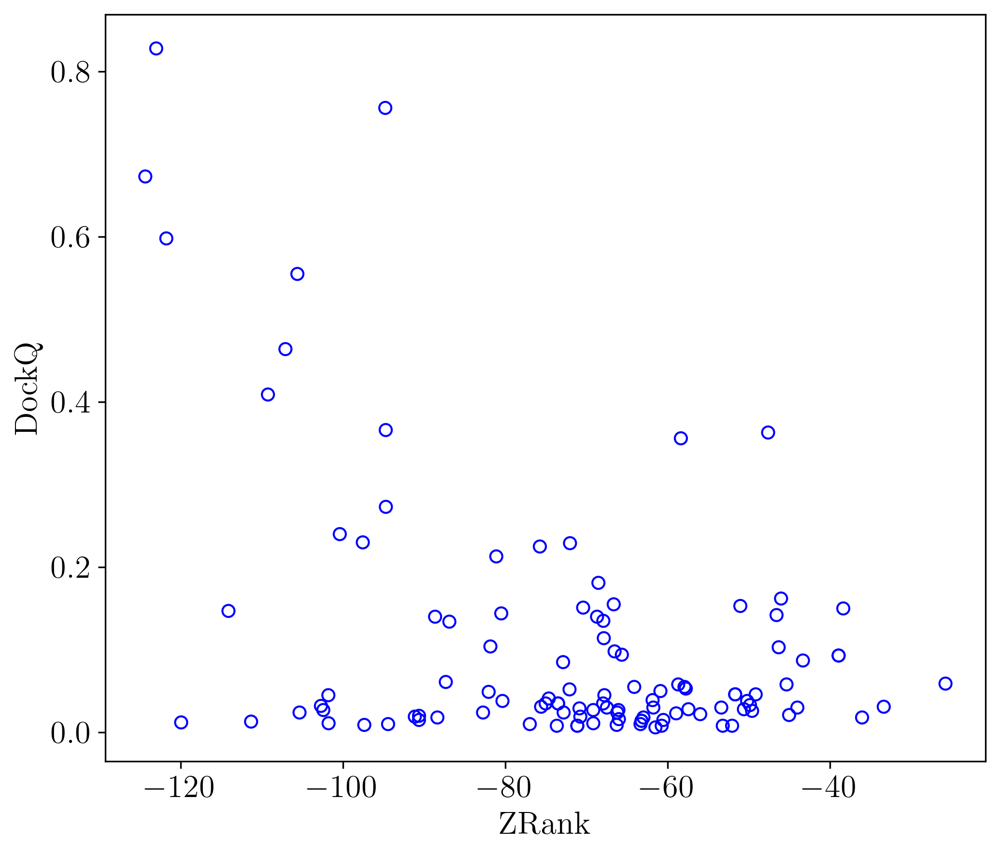

In [588]:
## Simple plot of score correlations

font_size = 16

fig, ax = plt.subplots(figsize = (7,6), dpi = 300)

pdb = "4dhi"

ax.scatter(dg1_score_dict[pdb]["ZRank"], dg1_score_dict[pdb]["DockQ"], color = "blue", label = "Dockground 1 Decoys", marker = "o", facecolor = "None")

plt.xticks(fontsize = font_size)
plt.yticks(fontsize = font_size)


ax.set_xlabel("ZRank", fontsize = font_size)
ax.set_ylabel("DockQ", fontsize = font_size)
fig.tight_layout()

In [621]:
## Create randomly subsampled data to replicate Dockground 2.0

np.random.seed(42069)

dg2_score_dict = {}

ITER_PER_INCORRECT = 99
ITER_PER_CORRECT = 1

for pdb in list(ss_score_dict.keys()):
    temp_df = ss_score_dict[pdb] 
    temp_inc = temp_df[temp_df["CAPRI"] == "Incorrect"]
    temp_cor = temp_df[temp_df["CAPRI"] == "High"]
    ## Ensures we preferentially get the highest quality structures, so they are as 'near-native' as possible
    if len(temp_cor) < 1:
        temp_cor = temp_df[temp_df["CAPRI"] == "Medium"]
    if len(temp_cor) < 1:
        temp_cor = temp_df[temp_df["CAPRI"] != "Incorrect"]
    
    ## Get all the incorrect decoys
    
    inc_inds = np.random.randint(0, len(temp_inc), size = (ITER_PER_INCORRECT,))
    
    dg2_score_dict[pdb] = temp_inc.iloc[inc_inds[:1],:] ## init dataframe with first incorrect decoy
    
    for i in inc_inds[1:]:
        dg2_score_dict[pdb] = pd.concat([dg2_score_dict[pdb], temp_inc.iloc[i:i+1,:]])
        
    ## Get all the ≥ Acceptable decoys
    
#     print(pdb, len(temp_cor))
    cor_inds = np.random.randint(0, len(temp_cor), size = (ITER_PER_CORRECT,))
    
    for i in cor_inds:
        dg2_score_dict[pdb] = pd.concat([dg2_score_dict[pdb], temp_cor.iloc[i:i+1,:]])
    


temp_spearman_corrs = get_spearman_corr(dg2_score_dict, original_data = True)
temp_pearson_corrs = get_pearson_corr(dg2_score_dict, original_data = True)

temp_spearman_corrs_dq = get_spearman_corr(dg2_score_dict, gt_score = "DockQ", original_data = True)
temp_pearson_corrs_dq = get_pearson_corr(dg2_score_dict, gt_score = "DockQ", original_data = True)

corr_master_list = [[temp_pearson_corrs, temp_pearson_corrs_dq], [temp_spearman_corrs, temp_spearman_corrs_dq]]


## Rewriting the correlation dictionary code so that it is more extensible

score_fxns = ["ZRank", "HDOCK", "Rosetta", "PyDock", "VoroMQA"]
gt_scores = ["iAlign", "DockQ"]
correlations = ["pearson", "spearman"]

dg2_corr_dict = {}
dg2_corr_dict["pdb"] = list(dg2_score_dict.keys())

for i,corr in enumerate(correlations):
    for j,gt_score in enumerate(gt_scores):
        for k,score_fxn in enumerate(score_fxns):
            col_name = f"{corr}_{gt_score.lower()}_{score_fxn.lower()}"
            dg2_corr_dict[col_name] = []
            for l,pdb in enumerate(list(dg2_score_dict.keys())):
                dg2_corr_dict[col_name].append(corr_master_list[i][j][k][l])

cutoff = 1000000

## AUC for all supersampled data using different scores
curves, auc_ss_z, temp_keys = get_indiv_ROC_curve(dg2_score_dict, cutoff = cutoff, col_name = "ZRank")
curves, auc_ss_h, temp_keys = get_indiv_ROC_curve(dg2_score_dict, cutoff = cutoff, col_name = "HDOCK")
curves, auc_ss_r, temp_keys = get_indiv_ROC_curve(dg2_score_dict, cutoff = cutoff, col_name = "Rosetta")
curves, auc_ss_p, temp_keys = get_indiv_ROC_curve(dg2_score_dict, cutoff = cutoff, col_name = "PyDock")
curves, auc_ss_v, temp_keys = get_indiv_ROC_curve(dg2_score_dict, cutoff = cutoff, col_name = "VoroMQA")
# curves, auc_ss_d, temp_keys = get_indiv_ROC_curve(ss_score_dict, cutoff = cutoff, col_name = "Dove")
# curves, auc_ss_d_5, temp_keys = get_indiv_ROC_curve(ss_score_dict, cutoff = cutoff, col_name = "Dove_5")
# curves, auc_ss_i, temp_keys = get_indiv_ROC_curve(ss_score_dict, cutoff = cutoff, col_name = "Intertwined")
# curves, auc_ss_dr, temp_keys = get_indiv_ROC_curve(ss_score_dict, cutoff = cutoff, col_name = "Deeprank_gnn_esm")

auc_master = [auc_ss_z, auc_ss_h, auc_ss_r, auc_ss_p, auc_ss_v]

for i in range(len(auc_master)):
    col_name = f"{score_fxns[i].lower()}_auc"
    dg2_corr_dict[col_name] = []
    for j, pdb in enumerate(list(dg2_score_dict.keys())):
        if "voromqa" in col_name:
            dg2_corr_dict[col_name].append(1 - auc_master[i][j])
        else:
            dg2_corr_dict[col_name].append(auc_master[i][j])


## Make df

dg2_corr_df = pd.DataFrame(dg2_corr_dict)

1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg
3whq
3ygs
4bi8
4ct6
4dbg
4dhi
4g6t
4gi3
4h5s
4hwi
4je3
4k12
4qjf
4qlp
4uzz
4yii
5by8
5dmb
5k7m
5maw
5mu7
5uq2
5zrz
6fud
6kp3
6wg4
6xod
6zbk
7bxh
7joe
7jxv
1acb
1ay7
1c3a
1euv
1f60
1ggp
1itb
1j7d
1kfu
1n1j
1pdk
1qav
1r8o
1spp
1tfo
1ugh
1ugq
1vet
1wmh
1wqj
1wrd
1xg2
2bkr
2d5r
2dvw
2fhz
2g2u
2grn
2h7z
2hla
2hsm
2hth
2oul
2pe6
2wmp
3dgp
3fpn
3gfk
3k9p
3ona
3qc8
3qhy
3rcz
3sgb
3vz9
3wdg


In [622]:
dg2_corr_df

,pdb,pearson_ialign_zrank,pearson_ialign_hdock,pearson_ialign_rosetta,pearson_ialign_pydock,pearson_ialign_voromqa,pearson_dockq_zrank,pearson_dockq_hdock,pearson_dockq_rosetta,pearson_dockq_pydock,...,spearman_dockq_zrank,spearman_dockq_hdock,spearman_dockq_rosetta,spearman_dockq_pydock,spearman_dockq_voromqa,zrank_auc,hdock_auc,rosetta_auc,pydock_auc,voromqa_auc
0,1acb,-0.313892,-0.014745,-0.506571,-0.329267,0.191414,-0.342373,-0.106173,-0.438283,-0.445011,...,-0.216901,-0.031806,-0.293158,-0.414020,0.025603,0.989899,0.878788,1.000000,0.929293,1.000000
1,1ay7,-0.345721,-0.220949,-0.102781,-0.186718,0.160465,-0.392557,-0.259327,-0.056677,-0.227069,...,-0.440524,-0.232941,-0.019339,-0.317499,0.255305,0.979798,0.797980,0.949495,0.636364,0.787879
2,1c3a,-0.762764,-0.717706,-0.608399,-0.649520,0.244235,-0.798064,-0.753566,-0.568719,-0.739501,...,-0.539813,-0.484019,-0.169093,-0.680814,-0.158730,1.000000,1.000000,1.000000,1.000000,1.000000
3,1euv,-0.515959,-0.153695,-0.055821,-0.507972,0.061625,-0.608644,-0.175993,-0.006538,-0.640701,...,-0.522599,0.158425,0.145520,-0.526943,0.203238,1.000000,1.000000,0.888889,1.000000,0.494949
4,1f60,-0.521906,-0.643168,-0.539050,-0.410024,0.365093,-0.495589,-0.609202,-0.579281,-0.429701,...,-0.342181,-0.397438,-0.364017,-0.415743,-0.068548,1.000000,1.000000,1.000000,0.989899,0.989899
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
72,6xod,-0.331300,-0.299587,-0.205267,0.094840,0.345718,-0.359165,-0.296345,-0.198908,0.194371,...,-0.591351,-0.592607,-0.283788,0.453225,0.519057,0.979798,0.959596,0.939394,0.393939,0.797980
73,6zbk,-0.402899,-0.356532,-0.434290,-0.227437,0.224619,-0.452878,-0.410570,-0.437507,-0.267002,...,-0.091978,-0.167548,-0.279063,-0.011321,0.383238,1.000000,1.000000,1.000000,0.949495,0.929293
74,7bxh,-0.582073,-0.626544,-0.325191,-0.652617,0.452847,-0.583478,-0.602793,-0.327142,-0.564117,...,-0.440426,-0.346433,-0.268650,-0.419563,0.259825,0.939394,0.959596,0.979798,0.838384,0.969697
75,7joe,-0.153534,-0.244346,-0.317855,-0.013745,0.217969,-0.249247,-0.381272,-0.388309,-0.161305,...,-0.181746,-0.389293,-0.314743,-0.330742,0.037611,0.959596,0.939394,1.000000,0.343434,0.959596


NameError: name 'dg2_score_dict' is not defined

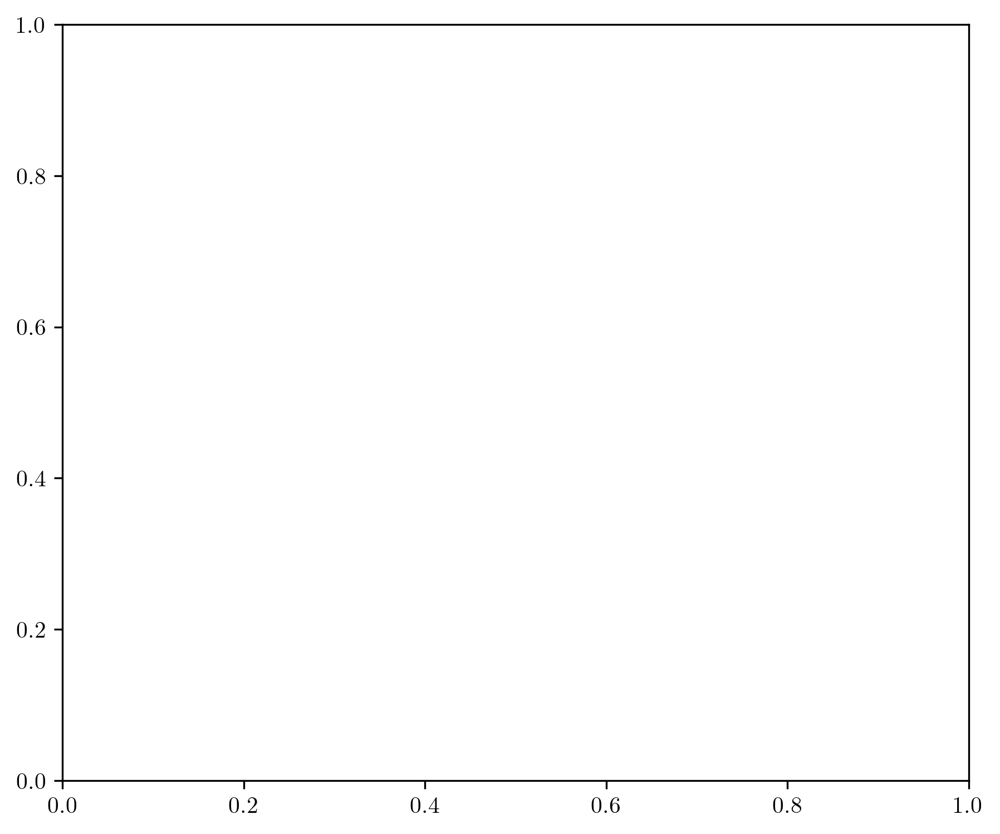

In [105]:
## Simple plot of score correlations

font_size = 16

fig, ax = plt.subplots(figsize = (7,6), dpi = 300)

pdb = "3rcz"

ax.scatter(dg2_score_dict[pdb]["ZRank"], dg2_score_dict[pdb]["DockQ"], color = "blue", label = "Dockground 1 Decoys", marker = "o", facecolor = "None")

plt.xticks(fontsize = font_size)
plt.yticks(fontsize = font_size)


ax.set_xlabel("ZRank", fontsize = font_size)
ax.set_ylabel("DockQ", fontsize = font_size)
fig.tight_layout()

# Moving Score Files for Final Manuscript Version

In [722]:
score_dir = "/Users/jakesumner/Desktop/PPI\ Project/supersampling/final_manuscript_dove_deeprank"
dest_dir = "/Users/jakesumner/Desktop/PPI\ Project/supersampling/final_manuscript_supersample_scores"


pdb_move_list = ['1acb', '1ay7', '1c3a', '1euv', '1f60', '1ggp', '1itb', '1j7d', '1kfu', '1n1j', '1pdk', '1qav', '1r8o', '1spp', '1tfo', '1ugh', '1ugq', '1vet', '1wmh', '1wqj', '1wrd', '1xg2', '2bkr', '2d5r', '2dvw', '2fhz', '2g2u', '2grn', '2h7z', '2hla', '2hsm', '2hth', '2oul', '2pe6', '2wmp', '3dgp', '3fpn', '3gfk', '3k9p', '3ona', '3qc8', '3qhy', '3rcz', '3sgb', '3vz9', '3wdg', '3whq', '3ygs', '4bi8', '4ct6', '4dbg', '4dhi', '4g6t', '4gi3', '4h5s', '4hwi', '4je3', '4k12', '4qjf', '4qlp', '4uzz', '4yii', '5by8', '5dmb', '5k7m', '5maw', '5mu7', '5uq2', '5zrz', '6fud', '6kp3', '6wg4', '6xod', '6zbk', '7bxh', '7joe', '7jxv']
pdb_move_list = pdb_move_list + ['1mbv', '1ry7', '3hw2', '3u82', '6yxj', '8enf', '4u1c']

## Move the interface surface area data

for pdb_name in pdb_move_list:
    
    dest_dir = f"/Users/jakesumner/Desktop/PPI\ Project/supersampling/final_manuscript_supersample_scores/scores_sampled_{pdb_name}"
    
    score_dir = "/Users/jakesumner/Desktop/PPI Project/supersampling/final_manuscript_dove_deeprank/interface_surface_area"
    os.chdir(score_dir)
    
    ## Copy the files
    
    os.system(f"cp interface_areas_random_{pdb_name}.txt {dest_dir}")
    os.system(f"cp interface_areas_sampled_{pdb_name}.txt {dest_dir}")
    
    

In [2]:
## Deeprank Data
import os
score_dir = "/Users/jakesumner/Desktop/PPI\ Project/supersampling/final_manuscript_dove_deeprank"
dest_dir = "/Users/jakesumner/Desktop/PPI\ Project/supersampling/final_manuscript_supersample_scores"


pdb_move_list = ['1acb', '1ay7', '1c3a', '1euv', '1f60', '1ggp', '1itb', '1j7d', '1kfu', '1n1j', '1pdk', '1qav', '1r8o', '1spp', '1tfo', '1ugh', '1ugq', '1vet', '1wmh', '1wqj', '1wrd', '1xg2', '2bkr', '2d5r', '2dvw', '2fhz', '2g2u', '2grn', '2h7z', '2hla', '2hsm', '2hth', '2oul', '2pe6', '2wmp', '3dgp', '3fpn', '3gfk', '3k9p', '3ona', '3qc8', '3qhy', '3rcz', '3sgb', '3vz9', '3wdg', '3whq', '3ygs', '4bi8', '4ct6', '4dbg', '4dhi', '4g6t', '4gi3', '4h5s', '4hwi', '4je3', '4k12', '4qjf', '4qlp', '4uzz', '4yii', '5by8', '5dmb', '5k7m', '5maw', '5mu7', '5uq2', '5zrz', '6fud', '6kp3', '6wg4', '6xod', '6zbk', '7bxh', '7joe', '7jxv']
pdb_move_list = pdb_move_list + ['1mbv', '1ry7', '3hw2', '3u82', '6yxj', '8enf', '4u1c']

for pdb_name in pdb_move_list:
    
    dest_dir = f"/Users/jakesumner/Desktop/PPI\ Project/supersampling/final_manuscript_supersample_scores/scores_sampled_{pdb_name}"
    
    ## Copy the sampled files
    
    score_dir = "/Users/jakesumner/Desktop/PPI Project/supersampling/final_manuscript_dove_deeprank/corrected_ss_sampled_deeprank"
    os.chdir(score_dir)
    
    os.system(f"cp {pdb_name}_output.csv {dest_dir}/{pdb_name}_deeprank_sampled_new.csv")
#     os.chdir(dest_dir)
#     os.system(f"rm dockq_scores_{pdb_name}_sampled.csv")
#     os.system(f"rm dockq_scores_{pdb_name}_random.csv")
    
    ## Copy the random files
    
    score_dir = "/Users/jakesumner/Desktop/PPI Project/supersampling/final_manuscript_dove_deeprank/corrected_ss_random_deeprank"
    os.chdir(score_dir)
    
    os.system(f"cp {pdb_name}_output.csv {dest_dir}/{pdb_name}_deeprank_random_new.csv")

In [726]:
## DOVE Data
for pdb_name in pdb_move_list:
    
    dest_dir = f"/Users/jakesumner/Desktop/PPI\ Project/supersampling/final_manuscript_supersample_scores/scores_sampled_{pdb_name}"
    
    ## Copy the sampled files
    
    score_dir = "/Users/jakesumner/Desktop/PPI Project/supersampling/final_manuscript_dove_deeprank/ss_dove_sampled"
    os.chdir(score_dir)
    
    os.system(f"cp Predict_{pdb_name}.txt {dest_dir}/dove_5_sampled_{pdb_name}.txt")
    
    ## Copy the random files
    
    score_dir = "/Users/jakesumner/Desktop/PPI Project/supersampling/final_manuscript_dove_deeprank/ss_dove_random"
    os.chdir(score_dir)
    
    os.system(f"cp Predict_{pdb_name}_rand.txt {dest_dir}/dove_5_random_{pdb_name}.txt")

In [728]:
## loop through and modify/improve the naming of the HDOCK score files so that they are all consistent

for pdb_name in pdb_move_list:
    
    dest_dir = f"/Users/jakesumner/Desktop/PPI Project/supersampling/final_manuscript_supersample_scores/scores_sampled_{pdb_name}"
    
    ## Copy the sampled files
    
    os.chdir(dest_dir)
    
    temp_decoys = sorted([f for f in listdir(dest_dir) if isfile(join(dest_dir, f)) and "hdock_scores" in f])
    
    if len(temp_decoys) == 4:
        
        ## Rename old files
        
        os.system(f"mv hdock_scores_sampled_{pdb_name}.txt old_hdock_data_sampled{pdb_name}")
        os.system(f"mv hdock_scores_random_{pdb_name}.txt old_hdock_data_random{pdb_name}")
        
        ## Rename new files
        
        os.system(f"mv hdock_scores_sampled_new_{pdb_name}.txt hdock_scores_sampled_{pdb_name}.txt")
        os.system(f"mv hdock_scores_random_new_{pdb_name}.txt hdock_scores_random_{pdb_name}.txt")

# Kd Analysis

In [291]:
print(list(ss_corr_df["pdb"]))

['1acb', '1ay7', '1c3a', '1euv', '1f60', '1ggp', '1itb', '1j7d', '1kfu', '1mbv', '1n1j', '1pdk', '1qav', '1r8o', '1ry7', '1spp', '1tfo', '1ugh', '1ugq', '1vet', '1wmh', '1wqj', '1wrd', '1xg2', '2bkr', '2d5r', '2dvw', '2fhz', '2g2u', '2grn', '2h7z', '2hla', '2hsm', '2hth', '2oul', '2pe6', '2wmp', '3dgp', '3fpn', '3gfk', '3hw2', '3k9p', '3ona', '3qc8', '3qhy', '3rcz', '3sgb', '3u82', '3vz9', '3wdg', '3whq', '3ygs', '4bi8', '4ct6', '4dbg', '4dhi', '4g6t', '4gi3', '4h5s', '4hwi', '4je3', '4k12', '4qjf', '4qlp', '4u1c', '4uzz', '4yii', '5by8', '5dmb', '5k7m', '5maw', '5mu7', '5uq2', '5zrz', '6fud', '6kp3', '6wg4', '6xod', '6yxj', '6zbk', '7bxh', '7joe', '7jxv', '8enf']


In [949]:
## Kd values from http://www.pdbbind.org.cn/quickpdb.php
kd_dict = {
    "1acb" : 2e-10,
    "1ay7": 6e-6,
    "1j7d" : 2e-6,
    "1ry7" : 2.3e-7,
    "1ugh" : 1.2e-11,
    "1vet" : 1.28e-8,
    "1wqj" : 8.65e-7,
    "1wrd" : 4.09e-4,
    "1xg2" : 5e-9,
    "2g2u" : 1.25e-6,
    "2hth" : 1.05e-4,
    "2oul" : 1.7e-9,
    "3ona" : 6.8e-7,
    "3qc8" : 1.12e-5,
    "3qhy" : 1.1e-12,
    "3sgb" : 1.79e-11,
    "3u82" : 1.71e-8,
    "3wdg" : 1.198e-9,
    "4dbg" : 5.2e-7,
    "4gi3" : 5.8e-10,
    "4h5s" : 1.25e-5,
    "4qlp" : 2.3e-10,
    "6fud" : 7.3e-8
}

In [716]:
print(len(kd_dict))

23


In [316]:
ss_corr_df.columns

Index(['pdb', 'pearson_ialign_zrank', 'pearson_ialign_hdock',
       'pearson_ialign_rosetta', 'pearson_ialign_pydock',
       'pearson_ialign_voromqa', 'pearson_ialign_voromqa_js',
       'pearson_ialign_dove_5', 'pearson_ialign_intertwined',
       'pearson_ialign_deeprank_gnn_esm', 'pearson_ialign_contact_42',
       'pearson_ialign_contact_43', 'pearson_ialign_contact_44',
       'pearson_ialign_contact_45', 'pearson_ialign_interface_rsa',
       'pearson_dockq_zrank', 'pearson_dockq_hdock', 'pearson_dockq_rosetta',
       'pearson_dockq_pydock', 'pearson_dockq_voromqa',
       'pearson_dockq_voromqa_js', 'pearson_dockq_dove_5',
       'pearson_dockq_intertwined', 'pearson_dockq_deeprank_gnn_esm',
       'pearson_dockq_contact_42', 'pearson_dockq_contact_43',
       'pearson_dockq_contact_44', 'pearson_dockq_contact_45',
       'pearson_dockq_interface_rsa', 'spearman_ialign_zrank',
       'spearman_ialign_hdock', 'spearman_ialign_rosetta',
       'spearman_ialign_pydock', 'spearma

(0.3175138718991069, 0.13985251643892224)
SpearmanrResult(correlation=0.37549407114624506, pvalue=0.07745523146339542)


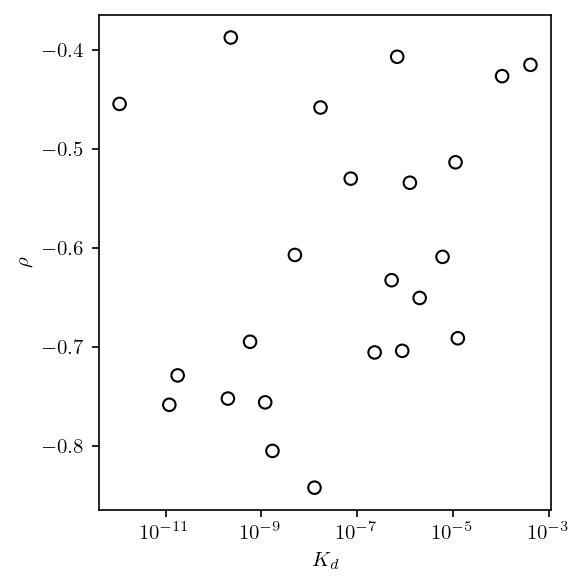

In [726]:
## Plotting the kd vs the average spearman correlation

fig,ax = plt.subplots(figsize = (4,4), dpi = 150)

spearman_data = []

for pdb_name in list(kd_dict.keys()):
    spearman_data.append(float(ss_corr_df[ss_corr_df["pdb"] == pdb_name]["spearman_dockq_rosetta"]))
    
# print(spearman_data)
ax.scatter(list(kd_dict.values()), spearman_data, marker = "o", facecolor = "None", color = "black")

plt.xscale("log")

print(pearsonr(np.log10(np.array(list(kd_dict.values()))), spearman_data))
print(spearmanr(np.log10(np.array(list(kd_dict.values()))), spearman_data))


ax.set_xlabel("$K_{d}$")
ax.set_ylabel(r"$\rho$")

fig.tight_layout()

(-0.15062532847012433, 0.49270080169068514)
SpearmanrResult(correlation=-0.15711462450592886, pvalue=0.47402784223966776)


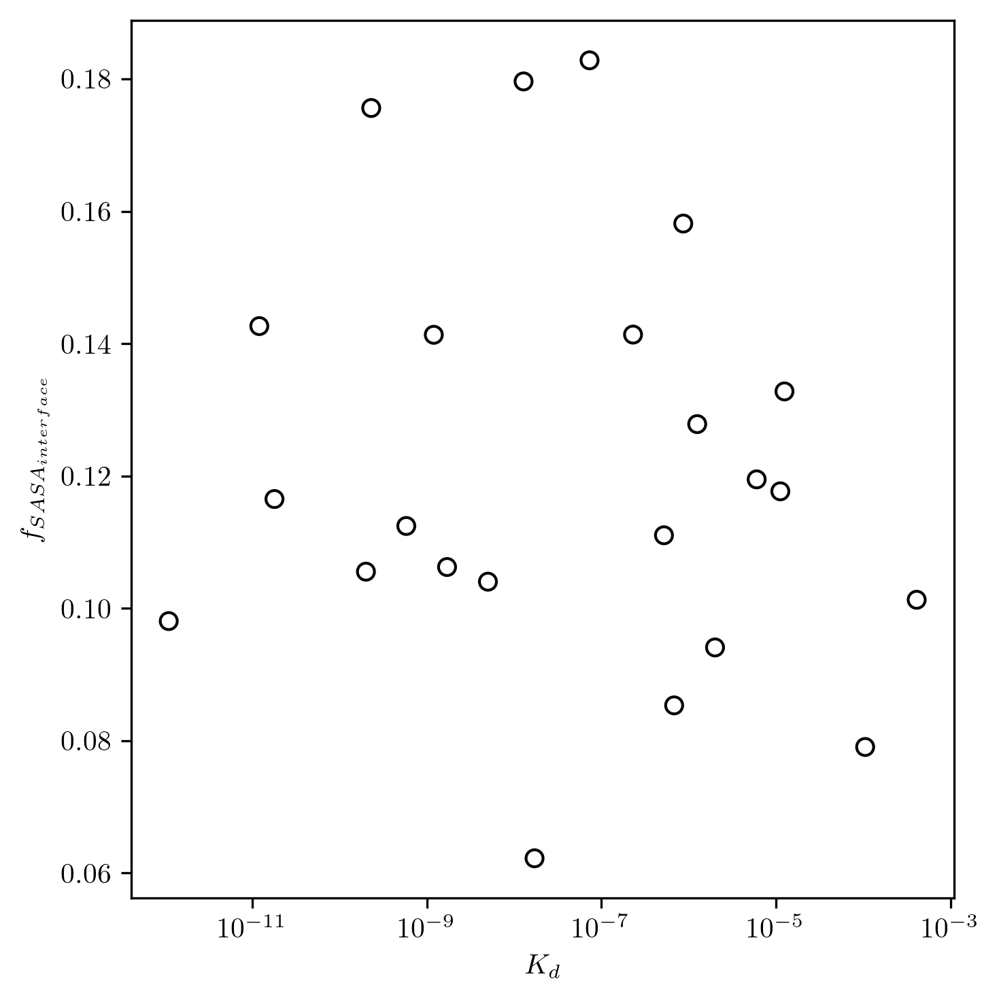

In [731]:
## Plotting the kd vs the average spearman correlation

fig,ax = plt.subplots(figsize = (5,5), dpi = 300)

spearman_data = []

for pdb_name in list(kd_dict.keys()):
    spearman_data.append(float(ss_corr_df[ss_corr_df["pdb"] == pdb_name]["relative_interface_sasa"]))
    
# print(spearman_data)
ax.scatter(list(kd_dict.values()), spearman_data, marker = "o", facecolor = "None", color = "black")

plt.xscale("log")

print(pearsonr(np.log10(np.array(list(kd_dict.values()))), spearman_data))
print(spearmanr(np.log10(np.array(list(kd_dict.values()))), spearman_data))


ax.set_xlabel("$K_{d}$")
ax.set_ylabel("$f_{SASA_{interface}}$")

fig.tight_layout()

In [828]:
## Average spearman correlations for unsupersampled data

print(np.mean(relaxed_corr_df["spearman_dockq_zrank"]))
print(np.mean(relaxed_corr_df["spearman_dockq_hdock"]))
print(np.mean(relaxed_corr_df["spearman_dockq_rosetta"]))
print(np.mean(relaxed_corr_df["spearman_dockq_pydock"]))
print(np.mean(relaxed_corr_df["spearman_dockq_voromqa"]))
print(np.mean(relaxed_corr_df["spearman_dockq_dove_5"]))
print(np.mean(relaxed_corr_df["spearman_dockq_deeprank_gnn_esm"]))

print(np.mean([
    relaxed_corr_df["spearman_dockq_zrank"],
    relaxed_corr_df["spearman_dockq_hdock"],
    relaxed_corr_df["spearman_dockq_rosetta"],
    relaxed_corr_df["spearman_dockq_pydock"],
    relaxed_corr_df["spearman_dockq_voromqa"]*-1,
    relaxed_corr_df["spearman_dockq_dove_5"],
    relaxed_corr_df["spearman_dockq_deeprank_gnn_esm"] *-1
]))

-0.4805333618078339
-0.4053175563128852
-0.32917797893609935
-0.39707011918570745
0.29254191930704276
-0.0327795164663039
0.28589285339432274
-0.3176161864871707


In [829]:
print(np.mean([
    ss_corr_df["spearman_dockq_zrank"],
    ss_corr_df["spearman_dockq_hdock"],
    ss_corr_df["spearman_dockq_rosetta"],
    ss_corr_df["spearman_dockq_pydock"],
    ss_corr_df["spearman_dockq_voromqa"]*-1,
    ss_corr_df["spearman_dockq_dove_5"],
    ss_corr_df["spearman_dockq_deeprank_gnn_esm"] *-1
]))

-0.5495650634202655


In [831]:
print(np.mean(ss_corr_df["spearman_dockq_zrank"]))

-0.7778638790471619


## Proving plots for my next project

12
[-0.648547537926018, -0.5121351345374899, -0.49863238437482754, -0.473852835156979, -0.5599757944802799, -0.3497722600614681]
[-0.7994166025673527, -0.772851941493108, -0.6760289649626985, -0.7579312876442196, -0.5631700411070707, -0.5498979443320402]
ZRank2 -0.7994166025673527 -0.648547537926018
VoroMQA -0.5631700411070707 -0.5599757944802799
ITScorePro -0.772851941493108 -0.5121351345374899
Rosetta -0.6760289649626985 -0.49863238437482754
PyDock -0.7579312876442196 -0.473852835156979
Deeprank-GNN -0.5498979443320402 -0.3497722600614681


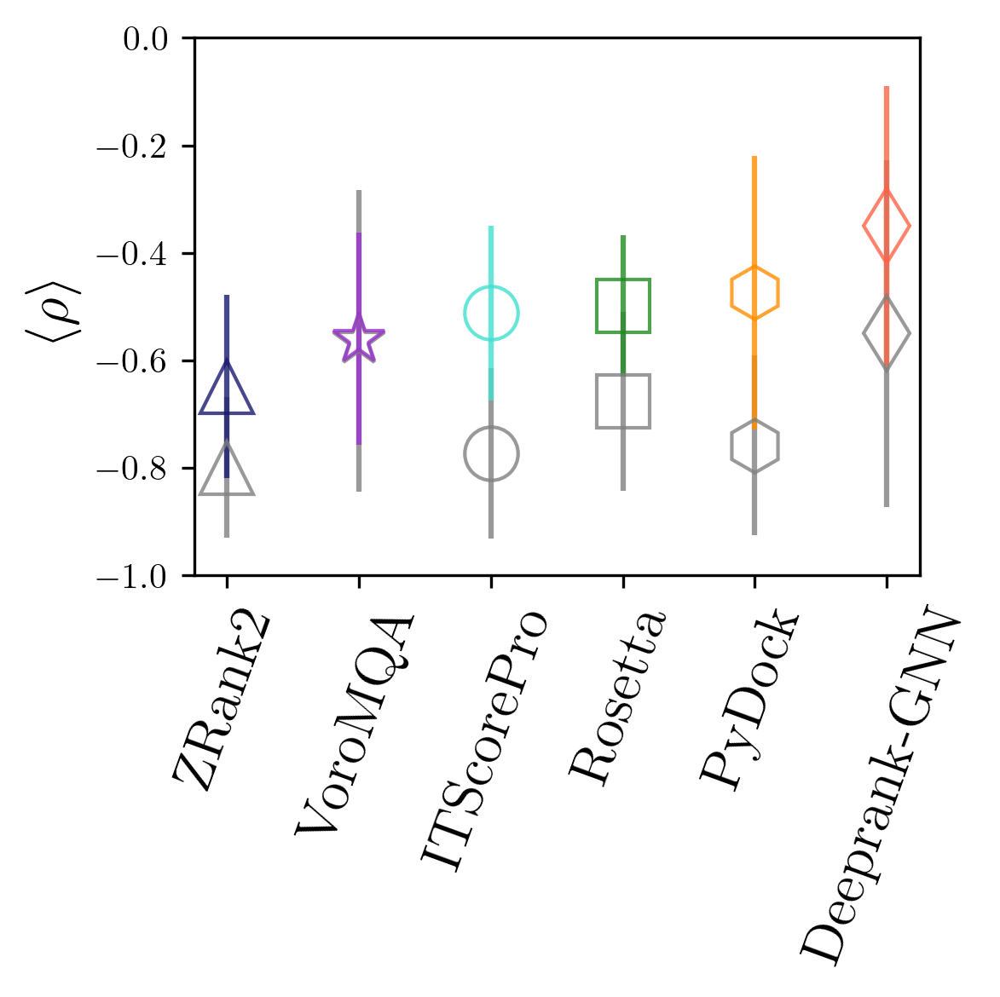

In [921]:
## Show a plot of the average spearman BUT NO DOVE

fig, ax = plt.subplots(figsize = (4,4), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid", "tomato",
         "deeppink", "dodgerblue", "darkgoldenrod", "brown", "limegreen"]

colors2 = ["blue", "magenta", "cyan", "green", "orange", "red"]

markers = ["^", "o", "s", "h", "*", "d", "3", "X", "D", ">", "o"]

flat_ss_df = ss_corr_df[ss_corr_df["flatness_p3"] >= 0.99]
print(len(flat_ss_df))

ss_plot_data = [np.mean(flat_ss_df["spearman_dockq_zrank"]), np.mean(flat_ss_df["spearman_dockq_hdock"]),
                    np.mean(flat_ss_df["spearman_dockq_rosetta"]), np.mean(flat_ss_df["spearman_dockq_pydock"]),
                    np.mean(flat_ss_df["spearman_dockq_voromqa"]*-1), 
                    np.mean(flat_ss_df["spearman_dockq_deeprank_gnn_esm"]*-1)
               ]
print(ss_plot_data)


ss_plot_std = [np.std(flat_ss_df["spearman_dockq_zrank"]), np.std(flat_ss_df["spearman_dockq_hdock"]),
                    np.std(flat_ss_df["spearman_dockq_rosetta"]), np.std(flat_ss_df["spearman_dockq_pydock"]),
                    np.std(flat_ss_df["spearman_dockq_voromqa"]*-1), 
                    np.std(flat_ss_df["spearman_dockq_deeprank_gnn_esm"]*-1)
              ]

nonflat_ss_df = ss_corr_df[ss_corr_df["flatness_p3"] < 0.99]

ss_alt_plot_data = [np.mean(nonflat_ss_df["spearman_dockq_zrank"]), np.mean(nonflat_ss_df["spearman_dockq_hdock"]),
                    np.mean(nonflat_ss_df["spearman_dockq_rosetta"]), np.mean(nonflat_ss_df["spearman_dockq_pydock"]),
                    np.mean(nonflat_ss_df["spearman_dockq_voromqa"]*-1), 
                    np.mean(nonflat_ss_df["spearman_dockq_deeprank_gnn_esm"]*-1)
               ]
print(ss_alt_plot_data)


ss_alt_plot_std = [np.std(nonflat_ss_df["spearman_dockq_zrank"]), np.std(nonflat_ss_df["spearman_dockq_hdock"]),
                    np.std(nonflat_ss_df["spearman_dockq_rosetta"]), np.std(nonflat_ss_df["spearman_dockq_pydock"]),
                    np.std(nonflat_ss_df["spearman_dockq_voromqa"]*-1), 
                    np.std(nonflat_ss_df["spearman_dockq_deeprank_gnn_esm"]*-1)
              ]

x_axis = range(len(ss_plot_data))


## Sort the data 
ss_plot_data = np.array(ss_plot_data)
ss_plot_std = np.array(ss_plot_std)
colors = np.array(colors)
markers = np.array(markers)
ss_alt_plot_data = np.array(ss_alt_plot_data)
ss_alt_plot_std = np.array(ss_alt_plot_std)
colors2 = np.array(colors2)

sort_inds = np.argsort(ss_plot_data)
ss_plot_data = ss_plot_data[sort_inds]
ss_plot_std = ss_plot_std[sort_inds]
ss_alt_plot_data = ss_alt_plot_data[sort_inds]
ss_alt_plot_std = ss_alt_plot_std[sort_inds]
colors = colors[sort_inds]
colors2 = colors2[sort_inds]
markers = markers[sort_inds]

score_list = np.array(score_list)
score_list = score_list[sort_inds]
plt.xticks(x_axis, score_list, fontsize = 16, rotation = 70)
plt.ylim([-1,0])

for i in range(len(ss_plot_data)):
    print(score_list[i], ss_alt_plot_data[i], ss_plot_data[i])
    plt.errorbar(x_axis[i], ss_alt_plot_data[i], yerr = ss_alt_plot_std[i], color = "gray", marker = markers[i], markerfacecolor = "None", markersize = 15, alpha = 0.8)
    plt.errorbar(x_axis[i], ss_plot_data[i], yerr = ss_plot_std[i], color = colors[i], marker = markers[i], markerfacecolor = "None", markersize = 15, alpha = 0.8)

score_list = ["ZRank2", "ITScorePro", "Rosetta",  "PyDock", "VoroMQA",  "Deeprank-GNN"]



ax.set_ylabel(r"$\langle \rho \rangle$", fontsize = 16)
fig.tight_layout()


In [922]:
print(np.mean(nonflat_ss_df["spearman_dockq_voromqa"]*-1))
print(np.mean(flat_ss_df["spearman_dockq_voromqa"]*-1))

-0.5631700411070707
-0.5599757944802799


25
59
[-0.6459783346035867, -0.565866172413917, -0.5313223602466224, -0.5462715247663164, -0.5113577382362002, -0.3544087061810492]
[-0.8337475843198632, -0.8075306286712836, -0.701264662434689, -0.7898389595442313, -0.5844747294502955, -0.5920288382731912]


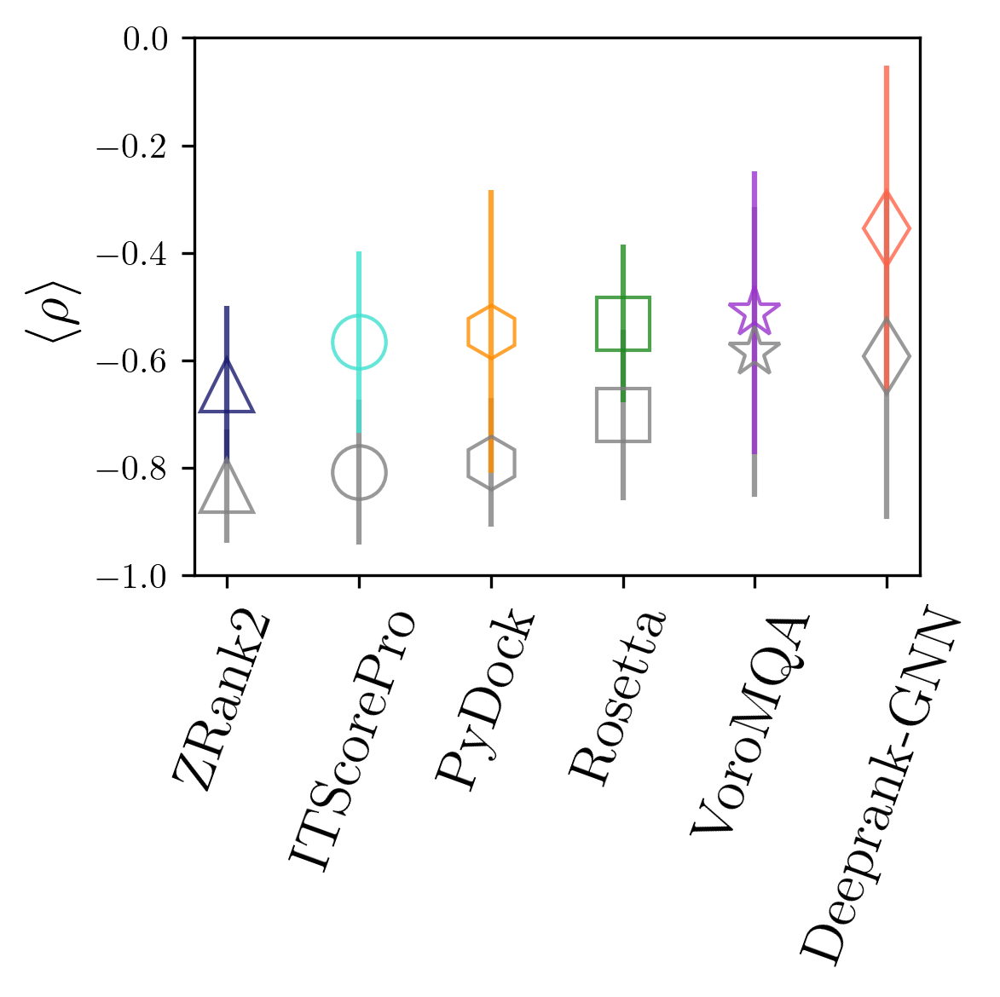

In [916]:
## Show a plot of the average spearman BUT NO DOVE

fig, ax = plt.subplots(figsize = (4,4), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid", "tomato",
         "deeppink", "dodgerblue", "darkgoldenrod", "brown", "limegreen"]

colors2 = ["blue", "magenta", "cyan", "green", "orange", "red"]

markers = ["^", "o", "s", "h", "*", "d", "3", "X", "D", ">", "o"]

flat_ss_df = ss_corr_df[ss_corr_df["relative_interface_sasa"] < 0.1]
print(len(flat_ss_df))

ss_plot_data = [np.mean(flat_ss_df["spearman_dockq_zrank"]), np.mean(flat_ss_df["spearman_dockq_hdock"]),
                    np.mean(flat_ss_df["spearman_dockq_rosetta"]), np.mean(flat_ss_df["spearman_dockq_pydock"]),
                    np.mean(flat_ss_df["spearman_dockq_voromqa"]*-1), 
                    np.mean(flat_ss_df["spearman_dockq_deeprank_gnn_esm"]*-1)
               ]


ss_plot_std = [np.std(flat_ss_df["spearman_dockq_zrank"]), np.std(flat_ss_df["spearman_dockq_hdock"]),
                    np.std(flat_ss_df["spearman_dockq_rosetta"]), np.std(flat_ss_df["spearman_dockq_pydock"]),
                    np.std(flat_ss_df["spearman_dockq_voromqa"]*-1), 
                    np.std(flat_ss_df["spearman_dockq_deeprank_gnn_esm"]*-1)
              ]

nonflat_ss_df = ss_corr_df[ss_corr_df["relative_interface_sasa"] >= 0.1]
print(len(nonflat_ss_df))


ss_alt_plot_data = [np.mean(nonflat_ss_df["spearman_dockq_zrank"]), np.mean(nonflat_ss_df["spearman_dockq_hdock"]),
                    np.mean(nonflat_ss_df["spearman_dockq_rosetta"]), np.mean(nonflat_ss_df["spearman_dockq_pydock"]),
                    np.mean(nonflat_ss_df["spearman_dockq_voromqa"]*-1), 
                    np.mean(nonflat_ss_df["spearman_dockq_deeprank_gnn_esm"]*-1)
               ]


ss_alt_plot_std = [np.std(nonflat_ss_df["spearman_dockq_zrank"]), np.std(nonflat_ss_df["spearman_dockq_hdock"]),
                    np.std(nonflat_ss_df["spearman_dockq_rosetta"]), np.std(nonflat_ss_df["spearman_dockq_pydock"]),
                    np.std(nonflat_ss_df["spearman_dockq_voromqa"]*-1), 
                    np.std(nonflat_ss_df["spearman_dockq_deeprank_gnn_esm"]*-1)
              ]

x_axis = range(len(ss_plot_data))
print(ss_plot_data)
print(ss_alt_plot_data)


## Sort the data 
ss_plot_data = np.array(ss_plot_data)
ss_plot_std = np.array(ss_plot_std)
colors = np.array(colors)
markers = np.array(markers)
ss_alt_plot_data = np.array(ss_alt_plot_data)
ss_alt_plot_std = np.array(ss_alt_plot_std)
colors2 = np.array(colors2)

sort_inds = np.argsort(ss_plot_data)
ss_plot_data = ss_plot_data[sort_inds]
ss_plot_std = ss_plot_std[sort_inds]
ss_alt_plot_data = ss_alt_plot_data[sort_inds]
ss_alt_plot_std = ss_alt_plot_std[sort_inds]
colors = colors[sort_inds]
colors2 = colors2[sort_inds]
markers = markers[sort_inds]

for i in range(len(ss_plot_data)):
    plt.errorbar(x_axis[i], ss_alt_plot_data[i], yerr = ss_alt_plot_std[i], color = "gray", marker = markers[i], markerfacecolor = "None", markersize = 15, alpha = 0.8)
    plt.errorbar(x_axis[i], ss_plot_data[i], yerr = ss_plot_std[i], color = colors[i], marker = markers[i], markerfacecolor = "None", markersize = 15, alpha = 0.8)

score_list = ["ZRank2", "ITScorePro", "Rosetta",  "PyDock", "VoroMQA",  "Deeprank-GNN"]

score_list = np.array(score_list)
score_list = score_list[sort_inds]
plt.xticks(x_axis, score_list, fontsize = 16, rotation = 70)
plt.ylim([-1,0])

ax.set_ylabel(r"$\langle \rho \rangle$", fontsize = 16)
fig.tight_layout()


10
72


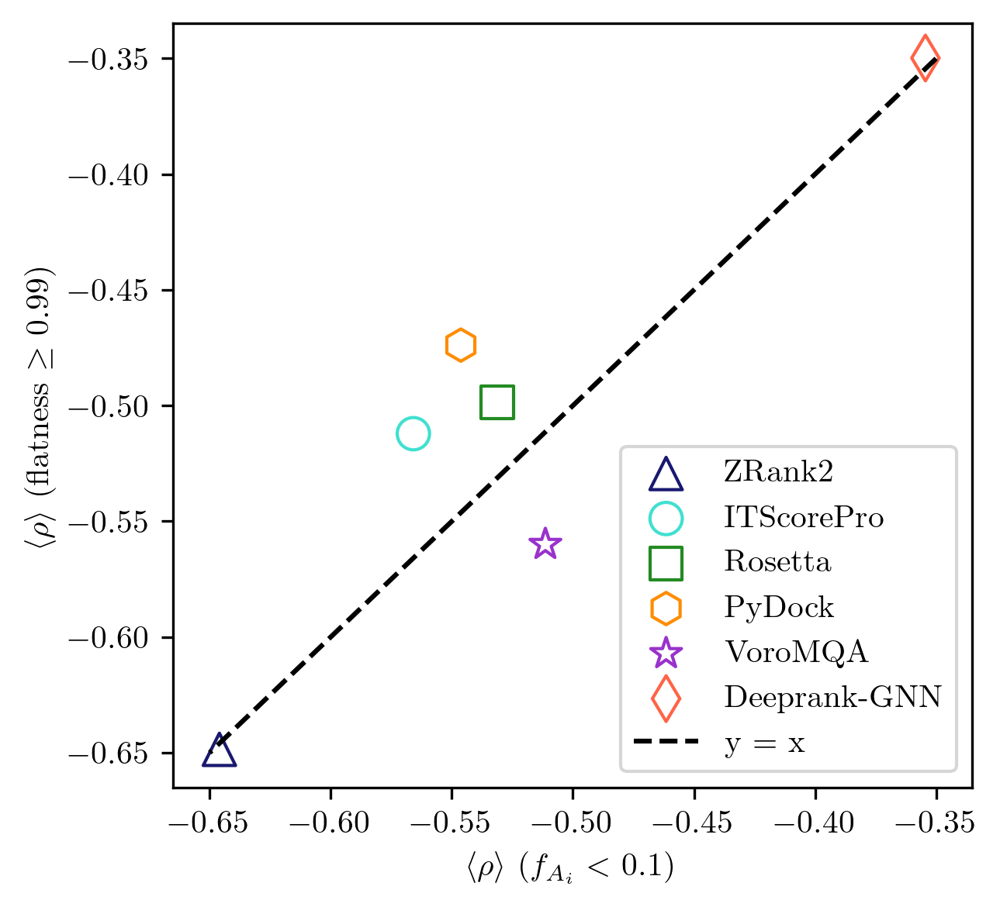

In [956]:
## Show a plot of the average spearman BUT NO DOVE

fig, ax = plt.subplots(figsize = (4.4,4), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid", "tomato",
         "deeppink", "dodgerblue", "darkgoldenrod", "brown", "limegreen"]

colors2 = ["blue", "magenta", "cyan", "green", "orange", "red"]

markers = ["^", "o", "s", "h", "*", "d", "3", "X", "D", ">", "o"]

small_ss_df = ss_corr_df[ss_corr_df["relative_interface_sasa"] < 0.1]
print(len(flat_ss_df))

ss_plot_data = [np.mean(small_ss_df["spearman_dockq_zrank"]), np.mean(small_ss_df["spearman_dockq_hdock"]),
                    np.mean(small_ss_df["spearman_dockq_rosetta"]), np.mean(small_ss_df["spearman_dockq_pydock"]),
                    np.mean(small_ss_df["spearman_dockq_voromqa"]*-1), 
                    np.mean(small_ss_df["spearman_dockq_deeprank_gnn_esm"]*-1)
               ]


ss_plot_std = [np.std(flat_ss_df["spearman_dockq_zrank"]), np.std(flat_ss_df["spearman_dockq_hdock"]),
                    np.std(flat_ss_df["spearman_dockq_rosetta"]), np.std(flat_ss_df["spearman_dockq_pydock"]),
                    np.std(flat_ss_df["spearman_dockq_voromqa"]*-1), 
                    np.std(flat_ss_df["spearman_dockq_deeprank_gnn_esm"]*-1)
              ]

flat_ss_df = ss_corr_df[ss_corr_df["flatness_p3"] >= 0.99]
print(len(nonflat_ss_df))


ss_alt_plot_data = [np.mean(flat_ss_df["spearman_dockq_zrank"]), np.mean(flat_ss_df["spearman_dockq_hdock"]),
                    np.mean(flat_ss_df["spearman_dockq_rosetta"]), np.mean(flat_ss_df["spearman_dockq_pydock"]),
                    np.mean(flat_ss_df["spearman_dockq_voromqa"]*-1), 
                    np.mean(flat_ss_df["spearman_dockq_deeprank_gnn_esm"]*-1)
               ]


ss_alt_plot_std = [np.std(flat_ss_df["spearman_dockq_zrank"]), np.std(flat_ss_df["spearman_dockq_hdock"]),
                    np.std(flat_ss_df["spearman_dockq_rosetta"]), np.std(flat_ss_df["spearman_dockq_pydock"]),
                    np.std(flat_ss_df["spearman_dockq_voromqa"]*-1), 
                    np.std(flat_ss_df["spearman_dockq_deeprank_gnn_esm"]*-1)
              ]

score_list = ["ZRank2", "ITScorePro", "Rosetta",  "PyDock", "VoroMQA",  "Deeprank-GNN"]

for i in range(len(ss_plot_data)):
    ax.scatter(ss_plot_data[i], ss_alt_plot_data[i], marker = markers[i], color = colors[i], facecolor = "None", s = 100, label = score_list[i])
    
ax.set_xlabel(r"$\langle \rho \rangle$ ($f_{A_{i}}<$  0.1)")
ax.set_ylabel(r"$\langle \rho \rangle$ (flatness $\geq$ 0.99)")

ax.plot([-0.35, -0.65],[-0.35, -0.65], "k--", label = 'y = x')
    
    
plt.legend()
fig.tight_layout()

72
72


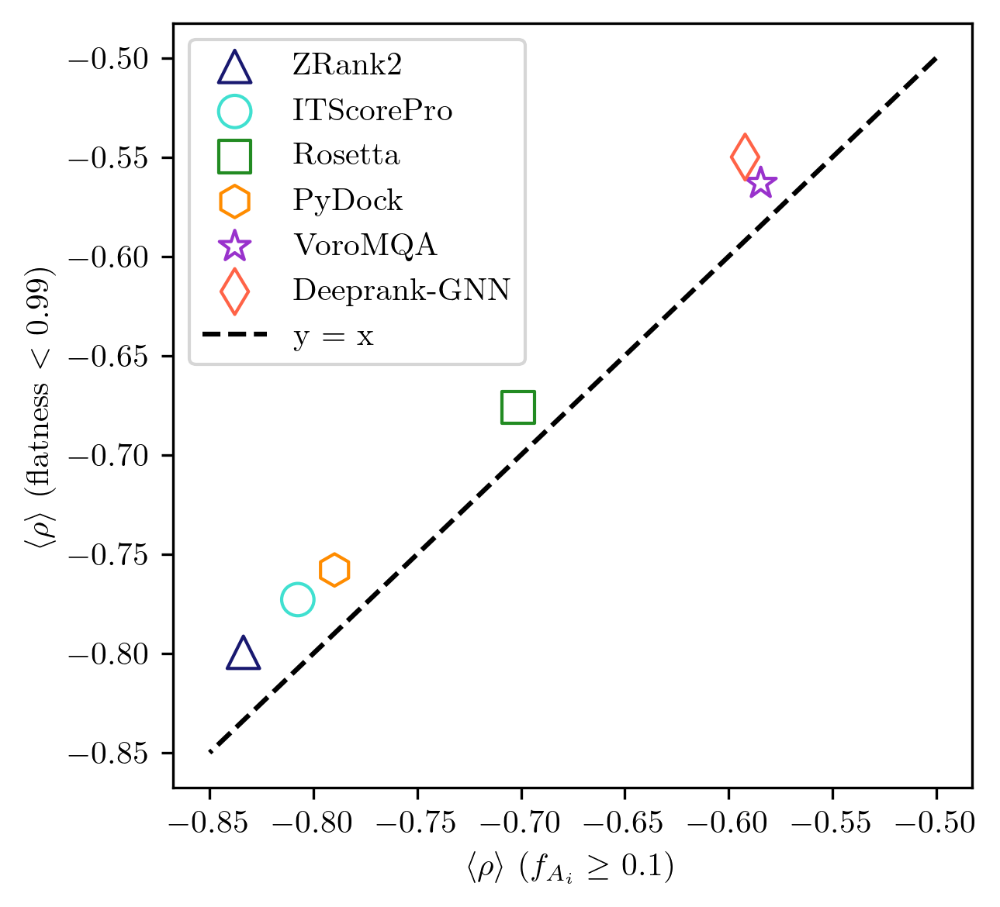

In [948]:
## Show a plot of the average spearman BUT NO DOVE

fig, ax = plt.subplots(figsize = (4.4,4), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid", "tomato",
         "deeppink", "dodgerblue", "darkgoldenrod", "brown", "limegreen"]

colors2 = ["blue", "magenta", "cyan", "green", "orange", "red"]

markers = ["^", "o", "s", "h", "*", "d", "3", "X", "D", ">", "o"]

small_ss_df = ss_corr_df[ss_corr_df["relative_interface_sasa"] >= 0.1]
print(len(flat_ss_df))

ss_plot_data = [np.mean(small_ss_df["spearman_dockq_zrank"]), np.mean(small_ss_df["spearman_dockq_hdock"]),
                    np.mean(small_ss_df["spearman_dockq_rosetta"]), np.mean(small_ss_df["spearman_dockq_pydock"]),
                    np.mean(small_ss_df["spearman_dockq_voromqa"]*-1), 
                    np.mean(small_ss_df["spearman_dockq_deeprank_gnn_esm"]*-1)
               ]


ss_plot_std = [np.std(flat_ss_df["spearman_dockq_zrank"]), np.std(flat_ss_df["spearman_dockq_hdock"]),
                    np.std(flat_ss_df["spearman_dockq_rosetta"]), np.std(flat_ss_df["spearman_dockq_pydock"]),
                    np.std(flat_ss_df["spearman_dockq_voromqa"]*-1), 
                    np.std(flat_ss_df["spearman_dockq_deeprank_gnn_esm"]*-1)
              ]

flat_ss_df = ss_corr_df[ss_corr_df["flatness_p3"] < 0.99]
print(len(nonflat_ss_df))


ss_alt_plot_data = [np.mean(flat_ss_df["spearman_dockq_zrank"]), np.mean(flat_ss_df["spearman_dockq_hdock"]),
                    np.mean(flat_ss_df["spearman_dockq_rosetta"]), np.mean(flat_ss_df["spearman_dockq_pydock"]),
                    np.mean(flat_ss_df["spearman_dockq_voromqa"]*-1), 
                    np.mean(flat_ss_df["spearman_dockq_deeprank_gnn_esm"]*-1)
               ]


ss_alt_plot_std = [np.std(flat_ss_df["spearman_dockq_zrank"]), np.std(flat_ss_df["spearman_dockq_hdock"]),
                    np.std(flat_ss_df["spearman_dockq_rosetta"]), np.std(flat_ss_df["spearman_dockq_pydock"]),
                    np.std(flat_ss_df["spearman_dockq_voromqa"]*-1), 
                    np.std(flat_ss_df["spearman_dockq_deeprank_gnn_esm"]*-1)
              ]

score_list = ["ZRank2", "ITScorePro", "Rosetta",  "PyDock", "VoroMQA",  "Deeprank-GNN"]

for i in range(len(ss_plot_data)):
    ax.scatter(ss_plot_data[i], ss_alt_plot_data[i], marker = markers[i], color = colors[i], facecolor = "None", s = 100, label = score_list[i])
    
ax.set_xlabel(r"$\langle \rho \rangle$ ($f_{A_{i}}\geq$  0.1)")
ax.set_ylabel(r"$\langle \rho \rangle$ (flatness $<$ 0.99)")

ax.plot([-0.5, -0.85],[-0.5, -0.85], "k--", label = 'y = x')
    
    
plt.legend()
fig.tight_layout()

12
10


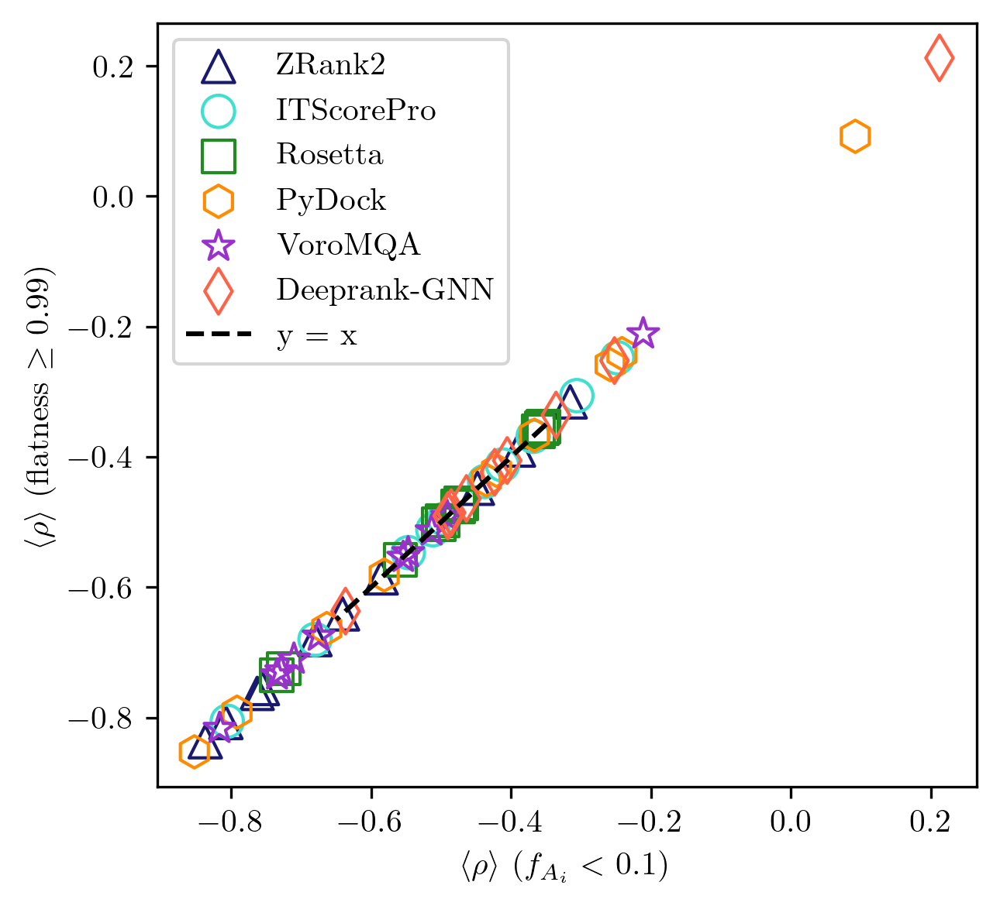

In [953]:
## Show a plot of the average spearman BUT NO DOVE

fig, ax = plt.subplots(figsize = (4.4,4), dpi = 300)

colors = ["midnightblue", "turquoise", "forestgreen", "darkorange", "darkorchid", "tomato",
         "deeppink", "dodgerblue", "darkgoldenrod", "brown", "limegreen"]

colors2 = ["blue", "magenta", "cyan", "green", "orange", "red"]

markers = ["^", "o", "s", "h", "*", "d", "3", "X", "D", ">", "o"]

flat_ss_df = ss_corr_df[ss_corr_df["flatness_p3"] >= 0.99]
print(len(flat_ss_df))
flat_pdb_list = list(flat_ss_df["pdb"])
temp_corr_df = ss_corr_df[ss_corr_df["pdb"].isin(flat_pdb_list)]
small_ss_df = temp_corr_df[temp_corr_df["relative_interface_sasa"] < 0.1]
print(len(small_ss_df))
small_pdb_list = list(small_ss_df["pdb"])
flat_ss_df = flat_ss_df[flat_ss_df["pdb"].isin(small_pdb_list)]

ss_alt_plot_data = [np.array(flat_ss_df["spearman_dockq_zrank"]), np.array(flat_ss_df["spearman_dockq_hdock"]),
                    np.array(flat_ss_df["spearman_dockq_rosetta"]), np.array(flat_ss_df["spearman_dockq_pydock"]),
                    np.array(flat_ss_df["spearman_dockq_voromqa"]*-1), 
                    np.array(flat_ss_df["spearman_dockq_deeprank_gnn_esm"]*-1)
               ]



ss_plot_data = [np.array(small_ss_df["spearman_dockq_zrank"]), np.array(small_ss_df["spearman_dockq_hdock"]),
                    np.array(small_ss_df["spearman_dockq_rosetta"]), np.array(small_ss_df["spearman_dockq_pydock"]),
                    np.array(small_ss_df["spearman_dockq_voromqa"]*-1), 
                    np.array(small_ss_df["spearman_dockq_deeprank_gnn_esm"]*-1)
               ]




score_list = ["ZRank2", "ITScorePro", "Rosetta",  "PyDock", "VoroMQA",  "Deeprank-GNN"]

for i in range(len(ss_plot_data)):
    ax.scatter(ss_plot_data[i], ss_alt_plot_data[i], marker = markers[i], color = colors[i], facecolor = "None", s = 100, label = score_list[i])
    
ax.set_xlabel(r"$\langle \rho \rangle$ ($f_{A_{i}}<$  0.1)")
ax.set_ylabel(r"$\langle \rho \rangle$ (flatness $\geq$ 0.99)")

ax.plot([-0.35, -0.65],[-0.35, -0.65], "k--", label = 'y = x')
    
    
plt.legend()
fig.tight_layout()

In [957]:
## Looking at Kd a bit

kd_pdbs = list(kd_dict.keys())

kd_ss_df = flat_ss_df[flat_ss_df["pdb"].isin(kd_pdbs)]

In [958]:
kd_ss_df

,pdb,pearson_ialign_zrank,pearson_ialign_hdock,pearson_ialign_rosetta,pearson_ialign_pydock,pearson_ialign_voromqa,pearson_ialign_voromqa_js,pearson_ialign_dove_5,pearson_ialign_intertwined,pearson_ialign_deeprank_gnn_esm,...,contact_42_auc,contact_43_auc,contact_44_auc,contact_45_auc,interface_rsa_auc,flatness_p3,resolution,complex_sasa,monomer_sasa,relative_interface_sasa
23,1xg2,-0.704832,-0.697598,-0.712452,-0.699321,0.195057,0.442208,0.538115,-0.515231,-0.13603,...,0.810252,0.808489,0.805642,0.804909,0.864979,0.990112,1.9,18602.058067,20761.900061,0.104029


In [959]:
print(kd_dict["1xg2"])

5e-09


(-0.15062532847012433, 0.49270080169068514)
SpearmanrResult(correlation=-0.15711462450592886, pvalue=0.47402784223966776)


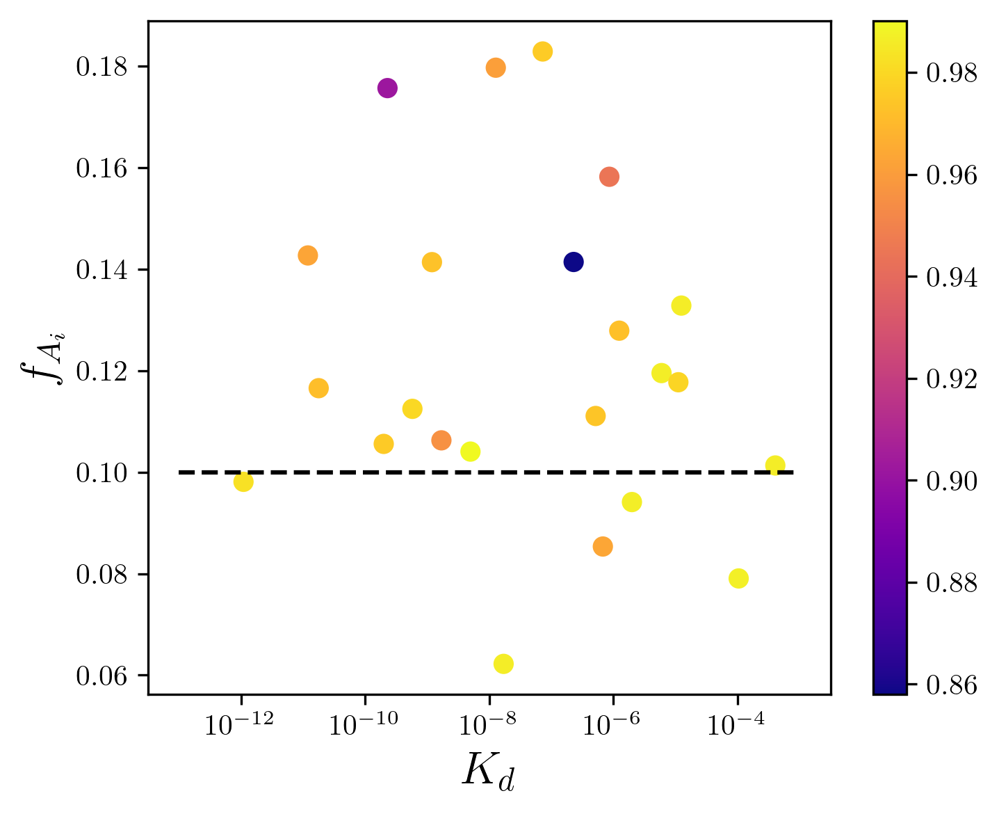

In [990]:
## Plotting the kd vs the average spearman correlation

fig,ax = plt.subplots(figsize = (5,4), dpi = 300)

spearman_data = []

for pdb_name in list(kd_dict.keys()):
    spearman_data.append(float(ss_corr_df[ss_corr_df["pdb"] == pdb_name]["relative_interface_sasa"]))
    
# print(spearman_data)
temp_cmap_vals = np.array(ss_corr_df[ss_corr_df["pdb"].isin(list(kd_dict.keys()))]["flatness_p3"])
cmap= plt.get_cmap('plasma')
scat = ax.scatter(list(kd_dict.values()), spearman_data, marker = "o",  c = temp_cmap_vals, cmap = cmap, facecolor = "None")

plt.xscale("log")

print(pearsonr(np.log10(np.array(list(kd_dict.values()))), spearman_data))
print(spearmanr(np.log10(np.array(list(kd_dict.values()))), spearman_data))

ax.plot([1e-13, 1e-3], [0.1, 0.1], "k--")


ax.set_xlabel("$K_{d}$", fontsize = 16)
ax.set_ylabel("$f_{A_{i}}$", fontsize = 16)

plt.colorbar(scat, ax = ax)
fig.tight_layout()

(0.3175138718991069, 0.13985251643892224)
SpearmanrResult(correlation=0.37549407114624506, pvalue=0.07745523146339542)


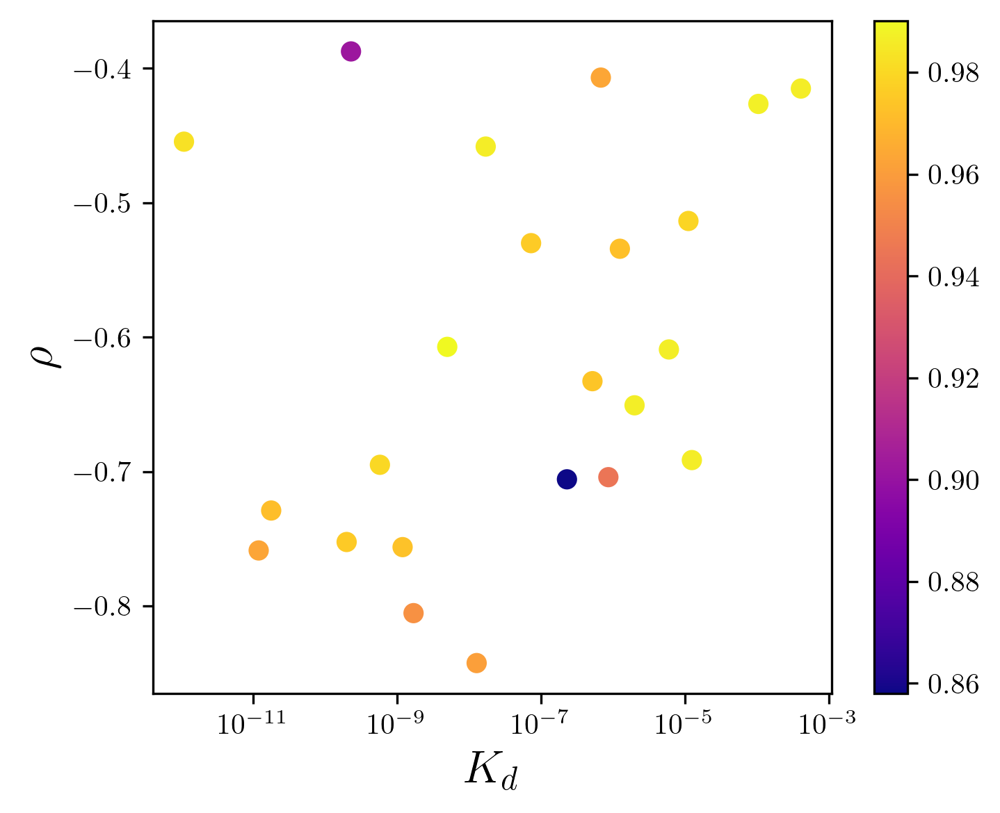

In [991]:
## Plotting the kd vs the average spearman correlation

fig,ax = plt.subplots(figsize = (5,4), dpi = 300)

spearman_data = []

for pdb_name in list(kd_dict.keys()):
    spearman_data.append(float(ss_corr_df[ss_corr_df["pdb"] == pdb_name]["spearman_dockq_rosetta"]))
    
# print(spearman_data)
temp_cmap_vals = np.array(ss_corr_df[ss_corr_df["pdb"].isin(list(kd_dict.keys()))]["flatness_p3"])
cmap= plt.get_cmap('plasma')
scat = ax.scatter(list(kd_dict.values()), spearman_data, marker = "o",  c = temp_cmap_vals, cmap = cmap, facecolor = "None")

plt.xscale("log")

print(pearsonr(np.log10(np.array(list(kd_dict.values()))), spearman_data))
print(spearmanr(np.log10(np.array(list(kd_dict.values()))), spearman_data))


ax.set_xlabel("$K_{d}$", fontsize = 16)
ax.set_ylabel(r"$\rho$", fontsize = 16)
plt.colorbar(scat)

fig.tight_layout()

In [997]:
ss_corr_df[ss_corr_df["pdb"] == "4gi3"]

,pdb,pearson_ialign_zrank,pearson_ialign_hdock,pearson_ialign_rosetta,pearson_ialign_pydock,pearson_ialign_voromqa,pearson_ialign_voromqa_js,pearson_ialign_dove_5,pearson_ialign_intertwined,pearson_ialign_deeprank_gnn_esm,...,contact_42_auc,contact_43_auc,contact_44_auc,contact_45_auc,interface_rsa_auc,flatness_p3,resolution,complex_sasa,monomer_sasa,relative_interface_sasa
57,4gi3,-0.844115,-0.849328,-0.754579,-0.758883,0.446806,0.753467,0.756497,-0.798287,0.437786,...,0.909185,0.913482,0.915771,0.916052,0.876897,0.980004,1.75,12369.959815,13937.12218,0.112445


In [993]:
kd_dict["1xg2"]

5e-09

In [994]:
for ele in kd_dict.items():
    print(ele)

('1acb', 2e-10)
('1ay7', 6e-06)
('1j7d', 2e-06)
('1ry7', 2.3e-07)
('1ugh', 1.2e-11)
('1vet', 1.28e-08)
('1wqj', 8.65e-07)
('1wrd', 0.000409)
('1xg2', 5e-09)
('2g2u', 1.25e-06)
('2hth', 0.000105)
('2oul', 1.7e-09)
('3ona', 6.8e-07)
('3qc8', 1.12e-05)
('3qhy', 1.1e-12)
('3sgb', 1.79e-11)
('3u82', 1.71e-08)
('3wdg', 1.198e-09)
('4dbg', 5.2e-07)
('4gi3', 5.8e-10)
('4h5s', 1.25e-05)
('4qlp', 2.3e-10)
('6fud', 7.3e-08)


# Getting more data for 3rcz to check how sampling more affects the top x ranks

In [3]:
def get_rosetta_score(rosetta_dir, file_indicator, grace = False):
    os.chdir(rosetta_dir)
    
    rosetta_score_files = sorted([f for f in listdir(rosetta_dir) if isfile(join(rosetta_dir, f)) and file_indicator in f])
    
    rosetta_dict = {}
    rosetta_dict["Decoy"] = []
    rosetta_dict["Rosetta"] = []
    
    for score_file in rosetta_score_files:
        with open(score_file, "r") as f:
            temp_num = 0
            for line in f:
                if temp_num < 2:
                    temp_num += 1
                    continue
                line = line.split()
                
                if grace:
                    temp_decoy = line[-1].split("_")
                    temp_decoy = "relaxed_" + "_".join(temp_decoy[:3])
                    if temp_decoy not in rosetta_dict["Decoy"]:
                        rosetta_dict["Decoy"].append(temp_decoy)
                    else:
                        continue
                else:
                    rosetta_dict["Decoy"].append(line[-1].split("_corrected_H_0001")[0])
                
                rosetta_dict["Rosetta"].append(float(line[1]))
                
                
    return pd.DataFrame(rosetta_dict)

def get_exhaustive_sampled_dfs(score_dir, pdb_name):
    
    comb_dir = score_dir
    dockq_fileind_s = f"dockq_scores_{pdb_name}_sampled"
    ialign_fileind_s = f"sampled_iAlign"
    zrank_fileind_s = f"zrank_files_sampled"
    hdock_fileind_s = f"hdock_scores_sampled"
    rosetta_fileind_s = "rosetta_scores_sampled"
    pydock_fileind_s = f"pydock_scores_{pdb_name}_sampled"

    dockq_temp_df_s = create_dockq_df_multi_file(comb_dir, file_indicator = dockq_fileind_s)
    ialign_temp_df_s = get_ialign_scores(comb_dir, file_indicator = ialign_fileind_s, ss = True)
    zrank_temp_df_s = get_zrank_score(comb_dir, file_indicator = zrank_fileind_s)
    hdock_temp_df_s = get_hdock_score(comb_dir, file_indicator = hdock_fileind_s)
    rosetta_temp_df_s = get_rosetta_score(comb_dir, rosetta_fileind_s)
    pydock_temp_df_s = get_pydock_score(comb_dir, pydock_fileind_s)
    
    comb_df_s = dockq_temp_df_s.merge(ialign_temp_df_s, on='Decoy')
    comb_df_s = comb_df_s.merge(zrank_temp_df_s, on='Decoy')
    comb_df_s = comb_df_s.merge(hdock_temp_df_s, on='Decoy')
    comb_df_s = comb_df_s.merge(rosetta_temp_df_s, on='Decoy')
    comb_df_s = comb_df_s.merge(pydock_temp_df_s, on='Decoy')
    
    return comb_df_s



In [101]:
home_score_dir = "/Users/jakesumner/Desktop/PPI Project/supersampling/3rcz_exhaustive_sampling_test"

combined_3rcz_list = []

for i in range(54):
    temp_dirname = join(home_score_dir, f"scores_sampled_3rcz_{i}")
    print(f"scores_sampled_3rcz_{i}")
    combined_3rcz_list.append(get_exhaustive_sampled_dfs(temp_dirname, "3rcz"))


scores_sampled_3rcz_0
scores_sampled_3rcz_1
scores_sampled_3rcz_2
scores_sampled_3rcz_3
scores_sampled_3rcz_4
scores_sampled_3rcz_5
scores_sampled_3rcz_6
scores_sampled_3rcz_7
scores_sampled_3rcz_8
scores_sampled_3rcz_9
scores_sampled_3rcz_10
scores_sampled_3rcz_11
scores_sampled_3rcz_12
scores_sampled_3rcz_13
scores_sampled_3rcz_14
scores_sampled_3rcz_15
scores_sampled_3rcz_16
scores_sampled_3rcz_17
scores_sampled_3rcz_18
scores_sampled_3rcz_19
scores_sampled_3rcz_20
scores_sampled_3rcz_21
scores_sampled_3rcz_22
scores_sampled_3rcz_23
scores_sampled_3rcz_24
scores_sampled_3rcz_25
scores_sampled_3rcz_26
scores_sampled_3rcz_27
scores_sampled_3rcz_28
scores_sampled_3rcz_29
scores_sampled_3rcz_30
scores_sampled_3rcz_31
scores_sampled_3rcz_32
scores_sampled_3rcz_33
scores_sampled_3rcz_34
scores_sampled_3rcz_35
scores_sampled_3rcz_36
scores_sampled_3rcz_37
scores_sampled_3rcz_38
scores_sampled_3rcz_39
scores_sampled_3rcz_40
scores_sampled_3rcz_41
scores_sampled_3rcz_42
scores_sampled_3rcz_4

In [102]:
combined_3rcz_df = pd.concat(combined_3rcz_list)

In [104]:
os.chdir(home_score_dir)

combined_3rcz_df.to_csv("exhaustively_sampled_3rcz.csv", index = False)

In [103]:
combined_3rcz_df

,Decoy,Model,Fnat,iRMSD,LRMSD,CAPRI,DockQ,IS-Score,ZRank,HDOCK,Rosetta,PyDock
0,complex.1000,1000,0.077,11.388,20.993,Incorrect,0.078,0.1161,-133.2880,-10980.07,-669.137,-45.730
1,complex.1001,1001,0.000,8.309,15.555,Incorrect,0.087,0.0629,-100.9200,-10859.16,-650.273,-44.038
2,complex.1002,1002,0.051,6.479,17.259,Incorrect,0.099,0.0951,-138.5180,-11006.07,-661.651,-45.553
3,complex.1003,1003,0.000,8.374,16.320,Incorrect,0.081,0.0629,-69.5485,-10974.45,-651.994,-43.436
4,complex.1004,1004,0.000,7.302,16.551,Incorrect,0.083,0.0629,-144.9440,-11126.57,-662.197,-38.999
...,...,...,...,...,...,...,...,...,...,...,...,...
1995,complex.53996,53996,0.000,9.731,23.237,Incorrect,0.047,0.0629,-69.6868,-10923.67,-657.310,-7.661
1996,complex.53997,53997,0.000,8.672,16.983,Incorrect,0.076,0.0629,-42.4812,-10828.45,-647.526,-20.507
1997,complex.53998,53998,0.000,20.272,55.234,Incorrect,0.010,0.0629,-54.8321,-10840.24,-658.284,-4.336
1998,complex.53999,53999,0.000,18.650,58.243,Incorrect,0.009,0.0629,-34.0900,-10849.02,-661.790,-12.971


## Do the same but for 3YGS

In [5]:
home_score_dir = "/Users/jakesumner/Desktop/PPI Project/supersampling/3ygs_exhaustive_sampling_test"

combined_3ygs_list = []

for i in range(10):
    temp_dirname = join(home_score_dir, f"scores_sampled_3ygs_{i}")
    print(f"scores_sampled_3ygs_{i}")
    combined_3ygs_list.append(get_exhaustive_sampled_dfs(temp_dirname, "3ygs"))


scores_sampled_3ygs_0
scores_sampled_3ygs_1
scores_sampled_3ygs_2
scores_sampled_3ygs_3
scores_sampled_3ygs_4
scores_sampled_3ygs_5
scores_sampled_3ygs_6
scores_sampled_3ygs_7
scores_sampled_3ygs_8
scores_sampled_3ygs_9


In [6]:
combined_3ygs_df = pd.concat(combined_3ygs_list)

In [7]:
combined_3ygs_df

,Decoy,Model,Fnat,iRMSD,LRMSD,CAPRI,DockQ,IS-Score,ZRank,HDOCK,Rosetta,PyDock
0,complex.1000,1000,0.000,15.297,49.724,Incorrect,0.013,0.0553,-80.4539,-9711.73,-512.009,-10.520
1,complex.1001,1001,0.000,11.443,32.861,Incorrect,0.027,0.0553,-113.8740,-9766.77,-508.487,-19.295
2,complex.1002,1002,0.000,8.640,37.086,Incorrect,0.026,0.0553,-55.0581,-9717.51,-519.842,-19.663
3,complex.1003,1003,0.185,10.671,29.542,Incorrect,0.094,0.1557,-87.9238,-9846.44,-517.993,-31.489
4,complex.1004,1004,0.000,11.263,50.708,Incorrect,0.015,0.0553,-45.6552,-9625.45,-509.516,-20.250
...,...,...,...,...,...,...,...,...,...,...,...,...
1995,complex.19996,19996,0.074,10.784,20.355,Incorrect,0.081,0.0877,-58.3965,-9701.13,-521.824,-20.472
1996,complex.19997,19997,0.000,12.068,20.024,Incorrect,0.056,0.0553,-48.0326,-9671.09,-513.775,-10.027
1997,complex.19998,19998,0.111,11.198,20.021,Incorrect,0.094,0.1768,-55.5854,-9640.19,-509.502,-17.516
1998,complex.19999,19999,0.074,11.987,30.230,Incorrect,0.054,0.1108,-57.4896,-9646.54,-518.974,-16.054


In [9]:
os.chdir(home_score_dir)

combined_3ygs_df.to_csv("exhaustively_sampled_3ygs.csv", index = False)

In [10]:
## Quickly moving files

pdb_list = ['1acb', '1ay7', '1c3a', '1euv', '1f60', '1ggp', '1itb', '1j7d', '1kfu', '1n1j', '1pdk', '1qav', '1r8o', '1spp', '1tfo', '1ugh', '1ugq', '1vet', '1wmh', '1wqj', '1wrd', '1xg2', '2bkr', '2d5r', '2dvw', '2fhz', '2g2u', '2grn', '2h7z', '2hla', '2hsm', '2hth', '2oul', '2pe6', '2wmp', '3dgp', '3fpn', '3gfk', '3k9p', '3ona', '3qc8', '3qhy', '3rcz', '3sgb', '3vz9', '3wdg', '3whq', '3ygs', '4bi8', '4ct6', '4dbg', '4dhi', '4g6t', '4gi3', '4h5s', '4hwi', '4je3', '4k12', '4qjf', '4qlp', '4uzz', '4yii', '5by8', '5dmb', '5k7m', '5maw', '5mu7', '5uq2', '5zrz', '6fud', '6kp3', '6wg4', '6xod', '6zbk', '7bxh', '7joe', '7jxv']
pdb_list = pdb_list + ['1mbv', '1ry7', '3hw2', '3u82', '6yxj', '8enf', '4u1c']
base_dir = "/Users/jakesumner/Desktop/PPI\ Project/supersampling/final_manuscript_supersample_scores"
itscorepp_dir = "/Users/jakesumner/Desktop/PPI Project/supersampling/itscorepp_files"

os.chdir(itscorepp_dir)
for pdb_name in pdb_list:
    move_dir = join(base_dir, f"scores_sampled_{pdb_name}")
    os.system(f"cp {pdb_name}* {move_dir}")

In [44]:
print(len(pdb_list))

84


In [47]:
grace_pdbs = ['1spp', '3qc8', '2d5r', '1ka9', '3ona', '2wmp', '1itb', '2hth', '2hsm', '1kfu', '1ggp', '1pdk', '2hla', '2pe6', '1c3a', '2dvw', '3gfk', '2oul', '1tfo', '2nts', '1brb', '3k9p']
print(len(grace_pdbs))

22


In [48]:
jake_pdbs = list(set(pdb_list) - set(grace_pdbs))
print(len(jake_pdbs))

65


In [49]:
print(jake_pdbs)

['3hw2', '6zbk', '6wg4', '8enf', '1ry7', '1xg2', '3rcz', '6yxj', '5k7m', '5dmb', '2g2u', '1vet', '1euv', '1wmh', '2grn', '4bi8', '4qlp', '3qhy', '4gi3', '5uq2', '3ygs', '1wqj', '7bxh', '3fpn', '5zrz', '4h5s', '4dhi', '3dgp', '3vz9', '2h7z', '1acb', '2bkr', '2fhz', '5by8', '5maw', '1qav', '4yii', '1ay7', '1n1j', '7jxv', '6kp3', '6fud', '1f60', '1j7d', '4je3', '1mbv', '1ugh', '1r8o', '5mu7', '1ugq', '7joe', '4hwi', '4g6t', '3u82', '4qjf', '3sgb', '4uzz', '4ct6', '4k12', '4dbg', '3whq', '3wdg', '4u1c', '1wrd', '6xod']


## Testing naomi shit

In [12]:
def get_deeprank_score_alt(deeprank_dir, file_indicator = "intertwined", grace = False):
    
    deep_files = sorted([f for f in listdir(deeprank_dir) if isfile(join(deeprank_dir, f)) and file_indicator in f])
    
    deep_data = {}
    
    colname = "Deeprank_gnn_esm"
    
    for score_file in deep_files:
        temp_df = pd.read_csv(score_file)
        for i in range(len(temp_df)):
            
            score = float(temp_df.iloc[i,:]["predicted_fnat"])
            decoy = temp_df.iloc[i,:]["pdb_id"]
            if grace:
                decoy = decoy.split("_")
                decoy = "_".join(decoy[2:5])
                decoy = "relaxed_" + decoy
            else:
                decoy = decoy.split("_corrected_H")[0]
            
            if "Decoy" not in deep_data:
                deep_data["Decoy"] = []
            if colname not in deep_data:
                deep_data[colname] = []
            if decoy not in deep_data["Decoy"]:
                deep_data["Decoy"].append(decoy)
                deep_data[colname].append(score)
    return pd.DataFrame(deep_data)

In [13]:
score_dir = "/Users/jakesumner/Desktop/PPI Project/supersampling/naomi_alt_deeprank_targs/"

In [16]:
pdb_alt_list = ["1mbv", "3whq", "4dbg"]

alt_dict = {}

os.chdir(score_dir)
for pdb_name in pdb_alt_list:
    new_dir = join(score_dir, f"{pdb_name}_score")
    os.chdir(new_dir)
    
    sampled_df = get_deeprank_score_alt(new_dir, file_indicator = "_sampled")
    
    random_df = get_deeprank_score_alt(new_dir, file_indicator = "output.csv")
    
    final_df = pd.concat([sampled_df, random_df])
    
    alt_dict[pdb_name] = final_df

In [20]:
alt_dict["4dbg"]

,Decoy,Deeprank_gnn_esm
0,complex.0_0_27,0.083
1,complex.0_0_2,0.048
2,complex.0_0_38,0.089
3,complex.0_0_44,0.134
4,complex.0_10_10,0.817
...,...,...
995,complex.9805_7,0.506
996,complex.9821_7,0.158
997,complex.9871_8,0.406
998,complex.9952_2,0.277


In [22]:
os.chdir("/Users/jakesumner/Desktop/PPI Project/supersampling/final_manuscript_datasets")

ss_corr_df = pd.read_csv("supersampled_correlation_dataset_final_manuscript.csv")
# relaxed_corr_df = pd.read_csv("non_supersampled_correlation_dataset_final_manuscript.csv")

In [23]:
## Load in the supersampled balanced dataset for each target

ss_balanced_dir = "/Users/jakesumner/Desktop/PPI Project/supersampling/all_supersampled_balanced_datasets"
os.chdir(ss_balanced_dir)

pdb_list = list(ss_corr_df["pdb"])

all_csv_files = sorted([f for f in listdir(ss_balanced_dir) if isfile(join(ss_balanced_dir, f)) and ".csv" in f and f[:4] in pdb_list])

ss_score_dict = {}
for csv_file in all_csv_files:
    pdb_name = csv_file[:4]
    ss_score_dict[pdb_name] = pd.read_csv(csv_file)

In [24]:
comb_dict = {}
for pdb_name in pdb_alt_list:
    temp_df = ss_score_dict[pdb_name]
    deep_df = alt_dict[pdb_name]
    
    merge_df = temp_df.merge(deep_df, on = "Decoy")
    
    comb_dict[pdb_name] = merge_df

In [25]:
comb_dict["1mbv"]

,Decoy,Model,Fnat,iRMSD,LRMSD,CAPRI,DockQ,IS-Score,ZRank,HDOCK,...,ZRank Z-score,HDOCK Z-score,Rosetta Z-score,PyDock Z-score,VoroMQA Z-score,VoroMQA_js Z-score,Dove_5 Z-score,Deeprank_gnn_esm Z-score,itscorepp Z-score,Deeprank_gnn_esm_y
0,complex.0_0_16,0,0.0,14.493,38.536,Incorrect,0.019,0.0669,-79.1721,-11303.85,...,-0.559270,-1.208936,-0.699778,0.444950,1.016880,2.811748,0.622082,-0.623298,-2.174731,0.115
1,complex.0_0_17,0,0.0,19.384,43.019,Incorrect,0.015,0.0669,-62.0148,-11061.03,...,0.356133,1.320133,1.612827,0.693117,-0.066294,0.391778,-0.247428,0.767281,0.593255,0.477
2,complex.0_0_18,0,0.0,15.504,24.210,Incorrect,0.040,0.0669,-10.1628,-10918.73,...,3.122621,2.802245,1.496763,2.564704,-1.155390,-2.374616,-1.641292,-1.482185,2.454590,0.003
3,complex.0_0_35,0,0.0,18.208,42.908,Incorrect,0.015,0.0669,-84.0906,-11126.55,...,-0.821689,0.637716,1.402235,1.052400,0.489618,0.218566,-0.704583,-1.262351,-0.648318,0.051
4,complex.0_0_48,0,0.0,16.712,24.050,Incorrect,0.040,0.0669,-49.4938,-11108.57,...,1.024173,0.824985,0.645057,0.684955,0.311532,-0.740761,-1.534385,-1.436173,1.610387,0.008
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
889,complex.20017_6,20017,0.0,16.812,39.941,Incorrect,0.017,0.0669,-60.4365,-11159.45,...,0.440341,0.295049,-0.525111,0.113052,2.409130,1.607592,-0.189393,-0.669310,-0.632981,0.208
890,complex.20018_8,20018,0.0,15.018,49.646,Incorrect,0.013,0.0669,-44.8541,-11029.03,...,1.271717,1.653426,0.625427,1.361785,0.891938,0.624948,-1.412205,-1.441285,1.524220,0.003
891,complex.20033_0,20033,0.0,19.234,39.404,Incorrect,0.017,0.0669,-41.5013,-10984.67,...,1.450601,2.115453,0.274567,0.613599,-0.112774,-0.096213,-1.161737,-0.117168,1.404760,0.296
892,complex.20036_1,20036,0.0,13.691,33.315,Incorrect,0.024,0.0669,-43.8660,-11110.16,...,1.324436,0.808424,-1.580262,-0.282962,0.326551,-0.056241,-1.471259,-1.425948,1.573090,0.010


SpearmanrResult(correlation=0.6007728583227359, pvalue=8.361182965474675e-89)
SpearmanrResult(correlation=0.6772866998332963, pvalue=5.040468024590303e-121)


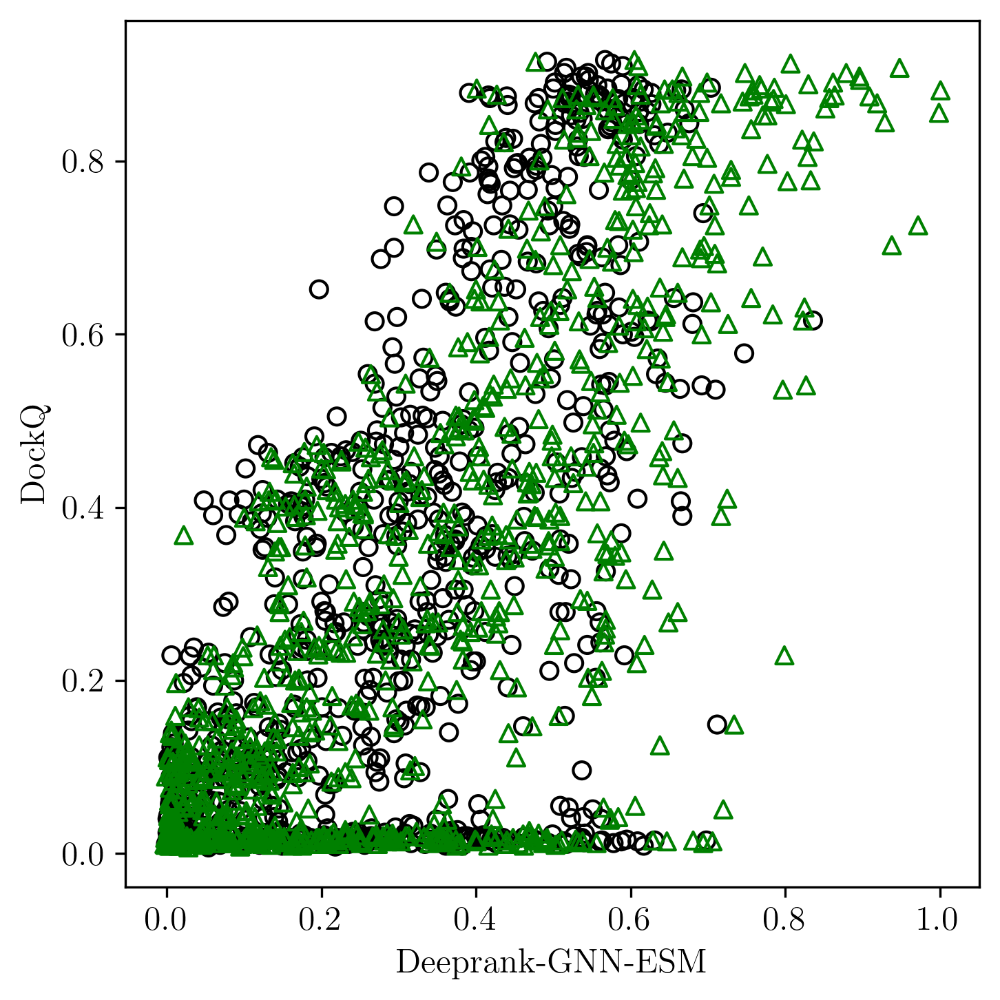

In [32]:
## Plotting the kd vs the average spearman correlation

fig,ax = plt.subplots(figsize = (5,5), dpi = 300)

pdb_name = "1mbv"
temp_df = comb_dict[pdb_name]

ax.scatter(temp_df["Deeprank_gnn_esm_x"], temp_df["DockQ"], marker = "o", facecolor = "None", color = "black")
ax.scatter(temp_df["Deeprank_gnn_esm_y"], temp_df["DockQ"], marker = "^", facecolor = "None", color = "green")


print(spearmanr(temp_df["Deeprank_gnn_esm_x"], temp_df["DockQ"]))
print(spearmanr(temp_df["Deeprank_gnn_esm_y"], temp_df["DockQ"]))


ax.set_xlabel("Deeprank-GNN-ESM")
ax.set_ylabel("DockQ")

fig.tight_layout()